ChatGPT was used to generate any docstrings and many comments for my code to keep it readable for others. I state (in comments or in Markdown) when ChatGPT helped me generate actual code.

In [ ]:
import pandas as pd
import pickle
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.patches import Circle
from pybaseball import pitching_stats, playerid_reverse_lookup, statcast, cache
import statsapi
from scipy.stats import zscore
from itertools import combinations
from sklearn.preprocessing import StandardScaler
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
import hdbscan
from sklearn.metrics import silhouette_score
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import TensorDataset, DataLoader
from sklearn.model_selection import train_test_split
from itertools import product
import copy
import math
import warnings
from pandas.errors import ParserError
from collections import defaultdict
from torch.utils.data import Dataset, DataLoader
import random
from torch.optim import AdamW

Download 2017-2024 data below

In [ ]:
# Fetching data could take ~ 20 minutes
# Define MLB season ranges (approx Opening Day to end of October)
season_dates = {
    2017: ("2017-04-02", "2017-10-30"),
    2018: ("2018-03-29", "2018-10-30"),
    2019: ("2019-03-28", "2019-10-30"),
    2020: ("2020-07-23", "2020-10-30"),  # shortened season
    2021: ("2021-04-01", "2021-10-30"),
    2022: ("2022-04-07", "2022-10-30"),
    2023: ("2023-03-30", "2023-10-30"),
    2024: ("2024-03-28", "2024-10-30"),
}

for year, (start_date, end_date) in season_dates.items():
    print(f"Fetching season {year}...")
    try:
        data = statcast(start_dt=start_date, end_dt=end_date)

        # Save to pickle
        filename = f"statcast_{year}.pkl"
        with open(filename, "wb") as f:
            pickle.dump(data, f)

        print(f"Saved {year} to {filename} with {len(data)} rows.")
    except Exception as e:
        print(f"Failed to fetch {year}: {e}")

Fetching season 2017...
This is a large query, it may take a moment to complete


  0%|          | 0/212 [00:00<?, ?it/s]/opt/miniconda3/envs/iw/lib/python3.13/site-packages/pybaseball/datahelpers/postprocessing.py:59: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_datetime without passing `errors` and catch exceptions explicitly instead
  data_copy[column] = data_copy[column].apply(pd.to_datetime, errors='ignore', format=date_format)
  0%|          | 1/212 [00:04<14:41,  4.18s/it]/opt/miniconda3/envs/iw/lib/python3.13/site-packages/pybaseball/datahelpers/postprocessing.py:59: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_datetime without passing `errors` and catch exceptions explicitly instead
  data_copy[column] = data_copy[column].apply(pd.to_datetime, errors='ignore', format=date_format)
  1%|          | 2/212 [00:06<10:49,  3.09s/it]/opt/miniconda3/envs/iw/lib/python3.13/site-packages/pybaseball/datahelpers/postprocessing.py:59: FutureWarning: errors='ignore' is deprecated and wi

Saved 2017 to statcast_2017.pkl with 735406 rows.
Fetching season 2018...
This is a large query, it may take a moment to complete
Skipping offseason dates


  0%|          | 0/214 [00:00<?, ?it/s]/opt/miniconda3/envs/iw/lib/python3.13/site-packages/pybaseball/datahelpers/postprocessing.py:59: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_datetime without passing `errors` and catch exceptions explicitly instead
  data_copy[column] = data_copy[column].apply(pd.to_datetime, errors='ignore', format=date_format)
  0%|          | 1/214 [00:05<17:46,  5.01s/it]/opt/miniconda3/envs/iw/lib/python3.13/site-packages/pybaseball/datahelpers/postprocessing.py:59: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_datetime without passing `errors` and catch exceptions explicitly instead
  data_copy[column] = data_copy[column].apply(pd.to_datetime, errors='ignore', format=date_format)
  1%|          | 2/214 [00:06<09:38,  2.73s/it]/opt/miniconda3/envs/iw/lib/python3.13/site-packages/pybaseball/datahelpers/postprocessing.py:59: FutureWarning: errors='ignore' is deprecated and wi

Saved 2018 to statcast_2018.pkl with 734567 rows.
Fetching season 2019...
This is a large query, it may take a moment to complete


  0%|          | 0/217 [00:00<?, ?it/s]/opt/miniconda3/envs/iw/lib/python3.13/site-packages/pybaseball/datahelpers/postprocessing.py:59: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_datetime without passing `errors` and catch exceptions explicitly instead
  data_copy[column] = data_copy[column].apply(pd.to_datetime, errors='ignore', format=date_format)
  0%|          | 1/217 [00:03<14:23,  4.00s/it]/opt/miniconda3/envs/iw/lib/python3.13/site-packages/pybaseball/datahelpers/postprocessing.py:59: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_datetime without passing `errors` and catch exceptions explicitly instead
  data_copy[column] = data_copy[column].apply(pd.to_datetime, errors='ignore', format=date_format)
/opt/miniconda3/envs/iw/lib/python3.13/site-packages/pybaseball/datahelpers/postprocessing.py:59: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_datetime w

Saved 2019 to statcast_2019.pkl with 745583 rows.
Fetching season 2020...
This is a large query, it may take a moment to complete
Skipping offseason dates


  0%|          | 0/97 [00:00<?, ?it/s]/opt/miniconda3/envs/iw/lib/python3.13/site-packages/pybaseball/datahelpers/postprocessing.py:59: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_datetime without passing `errors` and catch exceptions explicitly instead
  data_copy[column] = data_copy[column].apply(pd.to_datetime, errors='ignore', format=date_format)
  1%|          | 1/97 [00:02<04:27,  2.79s/it]/opt/miniconda3/envs/iw/lib/python3.13/site-packages/pybaseball/datahelpers/postprocessing.py:59: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_datetime without passing `errors` and catch exceptions explicitly instead
  data_copy[column] = data_copy[column].apply(pd.to_datetime, errors='ignore', format=date_format)
  2%|▏         | 2/97 [00:07<05:49,  3.68s/it]/opt/miniconda3/envs/iw/lib/python3.13/site-packages/pybaseball/datahelpers/postprocessing.py:59: FutureWarning: errors='ignore' is deprecated and will 

Saved 2020 to statcast_2020.pkl with 280398 rows.
Fetching season 2021...
This is a large query, it may take a moment to complete


  0%|          | 0/213 [00:00<?, ?it/s]/opt/miniconda3/envs/iw/lib/python3.13/site-packages/pybaseball/datahelpers/postprocessing.py:59: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_datetime without passing `errors` and catch exceptions explicitly instead
  data_copy[column] = data_copy[column].apply(pd.to_datetime, errors='ignore', format=date_format)
  0%|          | 1/213 [00:06<23:39,  6.70s/it]/opt/miniconda3/envs/iw/lib/python3.13/site-packages/pybaseball/datahelpers/postprocessing.py:59: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_datetime without passing `errors` and catch exceptions explicitly instead
  data_copy[column] = data_copy[column].apply(pd.to_datetime, errors='ignore', format=date_format)
  1%|          | 2/213 [00:07<10:35,  3.01s/it]/opt/miniconda3/envs/iw/lib/python3.13/site-packages/pybaseball/datahelpers/postprocessing.py:59: FutureWarning: errors='ignore' is deprecated and wi

Failed to fetch 2021: Error tokenizing data. C error: Expected 1 fields in line 13, saw 2

Fetching season 2022...
This is a large query, it may take a moment to complete



  0%|          | 0/207 [00:00<?, ?it/s]/opt/miniconda3/envs/iw/lib/python3.13/site-packages/pybaseball/datahelpers/postprocessing.py:59: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_datetime without passing `errors` and catch exceptions explicitly instead
  data_copy[column] = data_copy[column].apply(pd.to_datetime, errors='ignore', format=date_format)
  0%|          | 1/207 [00:05<19:27,  5.67s/it]/opt/miniconda3/envs/iw/lib/python3.13/site-packages/pybaseball/datahelpers/postprocessing.py:59: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_datetime without passing `errors` and catch exceptions explicitly instead
  data_copy[column] = data_copy[column].apply(pd.to_datetime, errors='ignore', format=date_format)
  1%|          | 2/207 [00:06<09:33,  2.80s/it]/opt/miniconda3/envs/iw/lib/python3.13/site-packages/pybaseball/datahelpers/postprocessing.py:59: FutureWarning: errors='ignore' is deprecated and w

Saved 2022 to statcast_2022.pkl with 720864 rows.
Fetching season 2023...
This is a large query, it may take a moment to complete


  0%|          | 0/215 [00:00<?, ?it/s]/opt/miniconda3/envs/iw/lib/python3.13/site-packages/pybaseball/datahelpers/postprocessing.py:59: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_datetime without passing `errors` and catch exceptions explicitly instead
  data_copy[column] = data_copy[column].apply(pd.to_datetime, errors='ignore', format=date_format)
  0%|          | 1/215 [00:03<13:01,  3.65s/it]/opt/miniconda3/envs/iw/lib/python3.13/site-packages/pybaseball/datahelpers/postprocessing.py:59: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_datetime without passing `errors` and catch exceptions explicitly instead
  data_copy[column] = data_copy[column].apply(pd.to_datetime, errors='ignore', format=date_format)
/opt/miniconda3/envs/iw/lib/python3.13/site-packages/pybaseball/datahelpers/postprocessing.py:59: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_datetime w

Saved 2023 to statcast_2023.pkl with 731971 rows.
Fetching season 2024...
This is a large query, it may take a moment to complete


  0%|          | 0/217 [00:00<?, ?it/s]/opt/miniconda3/envs/iw/lib/python3.13/site-packages/pybaseball/datahelpers/postprocessing.py:59: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_datetime without passing `errors` and catch exceptions explicitly instead
  data_copy[column] = data_copy[column].apply(pd.to_datetime, errors='ignore', format=date_format)
  0%|          | 1/217 [00:03<11:20,  3.15s/it]/opt/miniconda3/envs/iw/lib/python3.13/site-packages/pybaseball/datahelpers/postprocessing.py:59: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_datetime without passing `errors` and catch exceptions explicitly instead
  data_copy[column] = data_copy[column].apply(pd.to_datetime, errors='ignore', format=date_format)
  1%|          | 2/217 [00:03<05:08,  1.44s/it]/opt/miniconda3/envs/iw/lib/python3.13/site-packages/pybaseball/datahelpers/postprocessing.py:59: FutureWarning: errors='ignore' is deprecated and wi

Failed to fetch 2024: ('Connection broken: IncompleteRead(182428 bytes read, 2449140 more expected)', IncompleteRead(182428 bytes read, 2449140 more expected))


In [4]:
# Load 2017-2024 data into a single df
dfs = []
for year in range(2017, 2025):
    print(f"Loading {year}...")
    with open(f"datasets/statcast_{year}.pkl", "rb") as f:
        df = pickle.load(f)
    
    # Downcast numeric types to save memory
    df = df.apply(pd.to_numeric, errors="ignore", downcast="integer")
    df = df.apply(pd.to_numeric, errors="ignore", downcast="float")
    
    # Convert object columns with few unique values to category
    for col in df.select_dtypes(include="object").columns:
        if df[col].nunique() < 50:  
            df[col] = df[col].astype("category")
    
    dfs.append(df)

print("Concatenating all years...")
full_df = pd.concat(dfs, ignore_index=True)

Loading 2017...


/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/527534998.py:9: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_numeric without passing `errors` and catch exceptions explicitly instead
  df = df.apply(pd.to_numeric, errors="ignore", downcast="integer")
/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/527534998.py:10: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_numeric without passing `errors` and catch exceptions explicitly instead
  df = df.apply(pd.to_numeric, errors="ignore", downcast="float")
/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/527534998.py:10: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_numeric without passing `errors` and catch exceptions explicitly instead
  df = df.apply(pd.to_numeric, errors="ignore", downcast="float")
/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/5275349

Loading 2018...


/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/527534998.py:9: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_numeric without passing `errors` and catch exceptions explicitly instead
  df = df.apply(pd.to_numeric, errors="ignore", downcast="integer")
/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/527534998.py:10: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_numeric without passing `errors` and catch exceptions explicitly instead
  df = df.apply(pd.to_numeric, errors="ignore", downcast="float")
/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/527534998.py:10: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_numeric without passing `errors` and catch exceptions explicitly instead
  df = df.apply(pd.to_numeric, errors="ignore", downcast="float")
/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/5275349

Loading 2019...


/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/527534998.py:9: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_numeric without passing `errors` and catch exceptions explicitly instead
  df = df.apply(pd.to_numeric, errors="ignore", downcast="integer")
/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/527534998.py:10: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_numeric without passing `errors` and catch exceptions explicitly instead
  df = df.apply(pd.to_numeric, errors="ignore", downcast="float")
/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/527534998.py:10: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_numeric without passing `errors` and catch exceptions explicitly instead
  df = df.apply(pd.to_numeric, errors="ignore", downcast="float")
/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/5275349

Loading 2020...


/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/527534998.py:9: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_numeric without passing `errors` and catch exceptions explicitly instead
  df = df.apply(pd.to_numeric, errors="ignore", downcast="integer")
/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/527534998.py:10: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_numeric without passing `errors` and catch exceptions explicitly instead
  df = df.apply(pd.to_numeric, errors="ignore", downcast="float")
/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/527534998.py:10: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_numeric without passing `errors` and catch exceptions explicitly instead
  df = df.apply(pd.to_numeric, errors="ignore", downcast="float")
/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/5275349

Loading 2021...


/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/527534998.py:9: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_numeric without passing `errors` and catch exceptions explicitly instead
  df = df.apply(pd.to_numeric, errors="ignore", downcast="integer")
/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/527534998.py:10: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_numeric without passing `errors` and catch exceptions explicitly instead
  df = df.apply(pd.to_numeric, errors="ignore", downcast="float")
/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/527534998.py:10: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_numeric without passing `errors` and catch exceptions explicitly instead
  df = df.apply(pd.to_numeric, errors="ignore", downcast="float")
/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/5275349

Loading 2022...


/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/527534998.py:9: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_numeric without passing `errors` and catch exceptions explicitly instead
  df = df.apply(pd.to_numeric, errors="ignore", downcast="integer")
/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/527534998.py:10: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_numeric without passing `errors` and catch exceptions explicitly instead
  df = df.apply(pd.to_numeric, errors="ignore", downcast="float")
/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/527534998.py:10: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_numeric without passing `errors` and catch exceptions explicitly instead
  df = df.apply(pd.to_numeric, errors="ignore", downcast="float")
/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/5275349

Loading 2023...


/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/527534998.py:9: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_numeric without passing `errors` and catch exceptions explicitly instead
  df = df.apply(pd.to_numeric, errors="ignore", downcast="integer")
/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/527534998.py:10: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_numeric without passing `errors` and catch exceptions explicitly instead
  df = df.apply(pd.to_numeric, errors="ignore", downcast="float")
/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/527534998.py:10: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_numeric without passing `errors` and catch exceptions explicitly instead
  df = df.apply(pd.to_numeric, errors="ignore", downcast="float")
/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/5275349

Loading 2024...


/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/527534998.py:9: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_numeric without passing `errors` and catch exceptions explicitly instead
  df = df.apply(pd.to_numeric, errors="ignore", downcast="integer")
/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/527534998.py:10: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_numeric without passing `errors` and catch exceptions explicitly instead
  df = df.apply(pd.to_numeric, errors="ignore", downcast="float")
/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/527534998.py:10: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_numeric without passing `errors` and catch exceptions explicitly instead
  df = df.apply(pd.to_numeric, errors="ignore", downcast="float")
/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/5275349

Concatenating all years...


Now start EDA and clean dataframe

In [6]:
print(list(full_df.columns))
df = full_df[['pitch_type', 'release_speed', 'release_pos_x', 'release_pos_z', 'pitcher', 'p_throws', 'game_year', 'game_type', 'pfx_x', 'pfx_z', 'vx0', 'vy0', 'vz0', 'ax', 'ay', 'az', 'effective_speed', 'release_spin_rate', 'release_extension', 'release_pos_y', 'game_pk', 'spin_axis', 'pitcher_days_since_prev_game', 'arm_angle']]

# only regular season
df = df[df['game_type']=='R']

def fetch_position(id):
    """Fetch primary positions for a list of MLBAM IDs in batches."""
    player_data = statsapi.get("person", {"personId": id})
    player_info = player_data["people"][0]
    pos = player_info["primaryPosition"]["abbreviation"]
    return pos

# Example: get all unique pitcher IDs from dataset
unique_pitchers = df["pitcher"].unique().tolist()

# Fetch positions in bulk
positions = {}
for id in unique_pitchers:
    pos = fetch_position(int(id))
    positions[id] = pos
# Filter only pitchers
pitcher_ids = [pid for pid, pos in positions.items() if pos == "P" or pos == "TWP"]

df = df[df["pitcher"].isin(pitcher_ids)]

# drop some unnecessary features
df = df.drop(['vx0', 'vy0', 'vz0', 'ax', 'ay', 'az', 'pitcher_days_since_prev_game', 'arm_angle', 'game_pk', 'game_type', 'effective_speed'], axis=1)


num_pitcher_seasons = df.groupby(["pitcher", "game_year"]).ngroups
print("Number of pitcher-seasons:", num_pitcher_seasons)
print(list(df.columns))
pitcher_seasons = df.groupby(["pitcher", "game_year"])
pitcher_seasons_pitches = df.groupby(["pitcher", "game_year", "pitch_type"])
print(pitcher_seasons_pitches.head())

['pitch_type', 'game_date', 'release_speed', 'release_pos_x', 'release_pos_z', 'player_name', 'batter', 'pitcher', 'events', 'description', 'spin_dir', 'spin_rate_deprecated', 'break_angle_deprecated', 'break_length_deprecated', 'zone', 'des', 'game_type', 'stand', 'p_throws', 'home_team', 'away_team', 'type', 'hit_location', 'bb_type', 'balls', 'strikes', 'game_year', 'pfx_x', 'pfx_z', 'plate_x', 'plate_z', 'on_3b', 'on_2b', 'on_1b', 'outs_when_up', 'inning', 'inning_topbot', 'hc_x', 'hc_y', 'tfs_deprecated', 'tfs_zulu_deprecated', 'umpire', 'sv_id', 'vx0', 'vy0', 'vz0', 'ax', 'ay', 'az', 'sz_top', 'sz_bot', 'hit_distance_sc', 'launch_speed', 'launch_angle', 'effective_speed', 'release_spin_rate', 'release_extension', 'game_pk', 'fielder_2', 'fielder_3', 'fielder_4', 'fielder_5', 'fielder_6', 'fielder_7', 'fielder_8', 'fielder_9', 'release_pos_y', 'estimated_ba_using_speedangle', 'estimated_woba_using_speedangle', 'woba_value', 'woba_denom', 'babip_value', 'iso_value', 'launch_speed_a

In [ ]:
# save df file (not necessary to run)
filename = f"pitch_df_17-24.pkl"
with open(filename, "wb") as f:
    pickle.dump(df, f)

In [ ]:
# only run if restarting and have saved df
# open df file and save it to df. drop some unnecessary features
with open(f"datasets/pitch_df_17-24.pkl", "rb") as f:
        df = pickle.load(f)
print(df.columns)

In [7]:
pitcher_seasons.size().describe()
df.isna().mean().sort_values()

pitcher              0.000000
p_throws             0.000000
game_year            0.000000
release_speed        0.002054
pfx_z                0.002077
pfx_x                0.002079
release_pos_x        0.002106
release_pos_z        0.002106
release_pos_y        0.002106
pitch_type           0.002193
release_extension    0.002906
spin_axis            0.004564
release_spin_rate    0.011728
dtype: float64

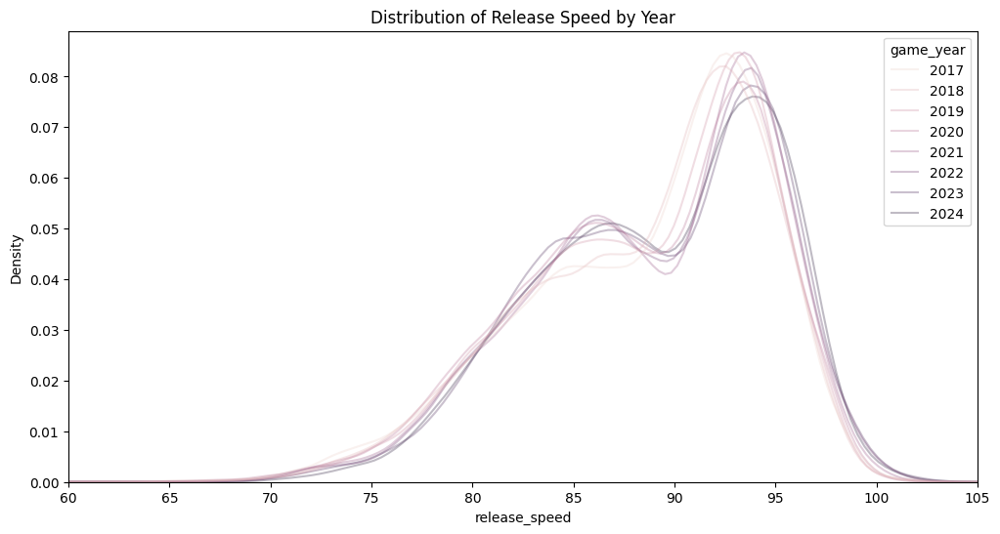

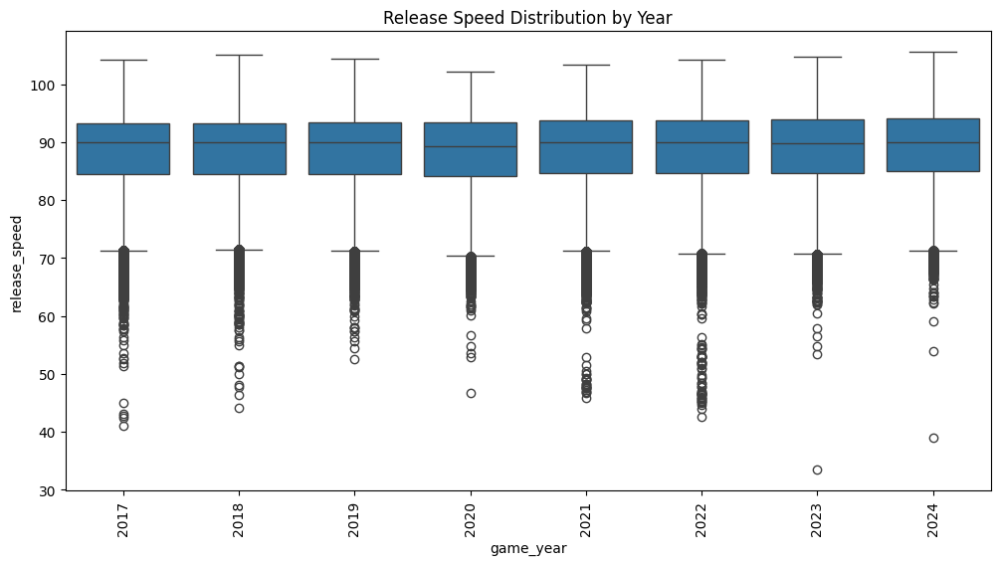

In [8]:
plt.figure(figsize=(12,6))
sns.kdeplot(data=df, x="release_speed", hue="game_year", common_norm=False, alpha=0.3)
plt.xlim(60, 105)
plt.title("Distribution of Release Speed by Year")
plt.show()

plt.figure(figsize=(12,6))
sns.boxplot(data=df, x="game_year", y="release_speed")
plt.xticks(rotation=90)
plt.title("Release Speed Distribution by Year")
plt.show()

In [9]:
missing_by_year = (
    df.groupby("game_year")
      .apply(lambda g: g.isna().mean())
)

# Now columns are features, rows are years
print(missing_by_year)

           pitch_type  release_speed  release_pos_x  release_pos_z  pitcher  \
game_year                                                                     
2017         0.004485       0.003705       0.003730       0.003730      0.0   
2018         0.004230       0.003995       0.004031       0.004031      0.0   
2019         0.005432       0.005372       0.005401       0.005401      0.0   
2020         0.000087       0.000087       0.000087       0.000087      0.0   
2021         0.000516       0.000516       0.000813       0.000813      0.0   
2022         0.000529       0.000584       0.000584       0.000584      0.0   
2023         0.000380       0.000383       0.000381       0.000381      0.0   
2024         0.000404       0.000406       0.000404       0.000404      0.0   

           p_throws  game_year     pfx_x     pfx_z  release_spin_rate  \
game_year                                                               
2017            0.0        0.0  0.003798  0.003798           0.

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/830041501.py:3: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(lambda g: g.isna().mean())


   game_year pitch_type  proportion
0       2017         FF    0.346618
1       2017         SI    0.209588
2       2017         SL    0.153166
3       2017         CH    0.098427
4       2017         CU    0.076283


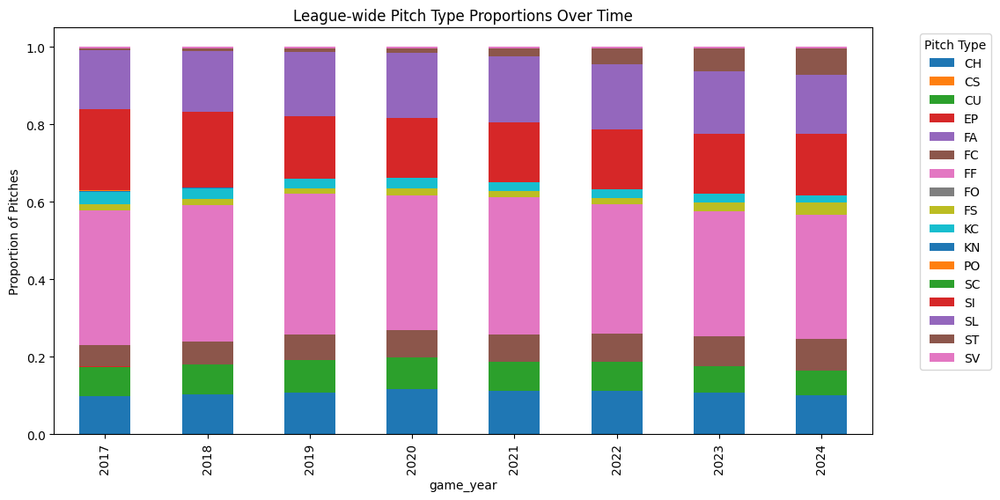

In [10]:
# Count pitches by type per year
pitch_counts = df.groupby('game_year')['pitch_type'].value_counts(normalize=True).rename('proportion').reset_index()

# Now 'pitch_counts' has columns: game_year, pitch_type, proportion
print(pitch_counts.head())

# Plot stacked bar chart
pivot = pitch_counts.pivot(index='game_year', columns='pitch_type', values='proportion')
pivot.plot(kind='bar', stacked=True, figsize=(12,6))
plt.ylabel('Proportion of Pitches')
plt.title('League-wide Pitch Type Proportions Over Time')
plt.legend(title='Pitch Type', bbox_to_anchor=(1.05, 1))
plt.show()

                mean     median       std   count
game_year                                        
2017       92.214134       92.5  3.332577  451417
2018       92.230392  92.400002  3.243758  445849
2019       92.418716  92.800003  3.268029  439769
2020       92.311081  92.800003  3.487582  155988
2021        92.70079  93.199997  3.407075  421537
2022       92.954842  93.300003  3.333812  407769
2023       92.987427  93.400002  3.451821  414289
2024       92.953506  93.400002  3.470579  417506


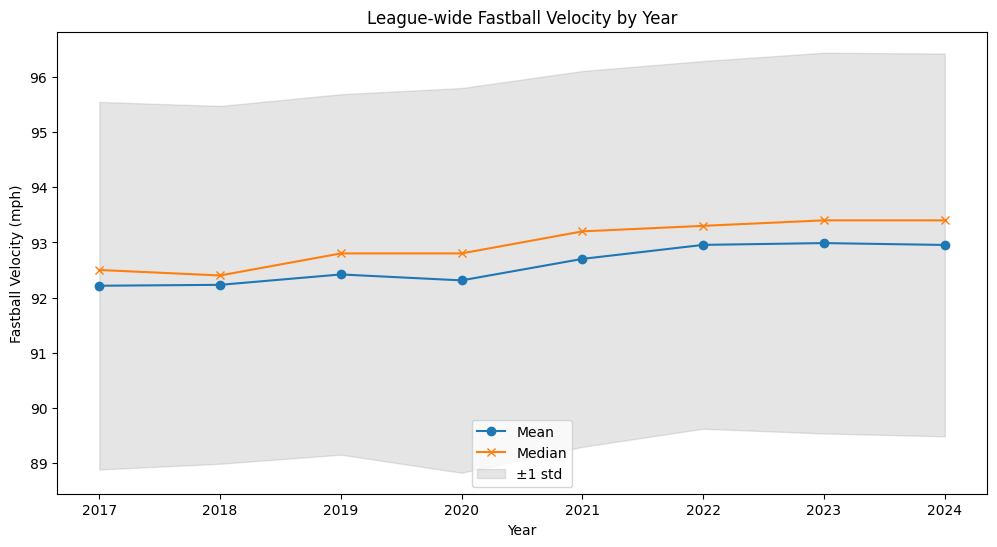

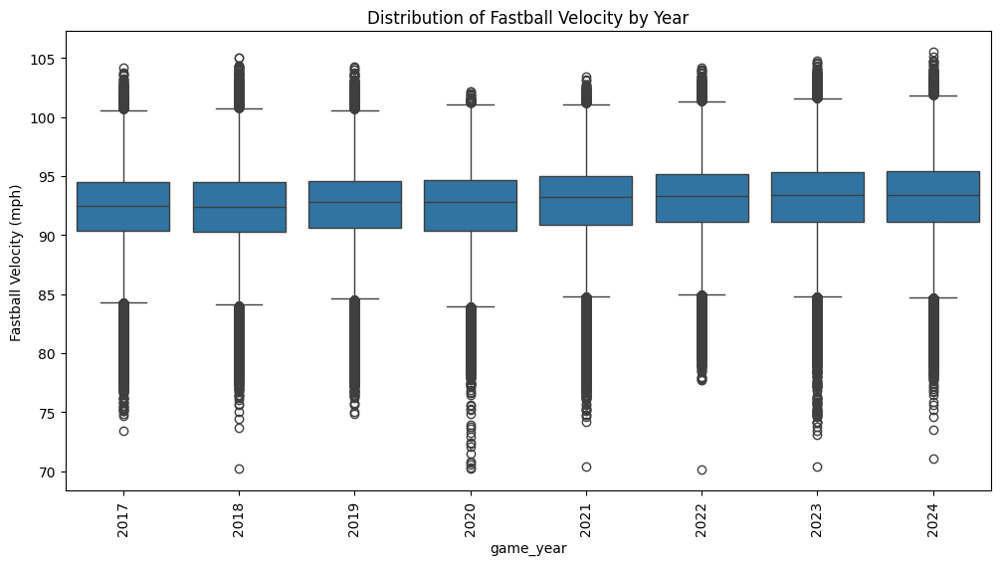

In [11]:
fastball_types = ['FA', 'FC', 'FF', 'FS', 'SI']

fastballs = df[df['pitch_type'].isin(fastball_types)]
fastballs = fastballs[fastballs['release_speed']>=70]
fb_stats = fastballs.groupby("game_year")['release_speed'].agg(['mean', 'median', 'std', 'count'])
print(fb_stats)
plt.figure(figsize=(12,6))
plt.plot(fb_stats.index, fb_stats['mean'], marker='o', label='Mean')
plt.plot(fb_stats.index, fb_stats['median'], marker='x', label='Median')
plt.fill_between(fb_stats.index, 
                 fb_stats['mean'] - fb_stats['std'], 
                 fb_stats['mean'] + fb_stats['std'], 
                 color='gray', alpha=0.2, label='±1 std')
plt.xlabel('Year')
plt.ylabel('Fastball Velocity (mph)')
plt.title('League-wide Fastball Velocity by Year')
plt.legend()
plt.show()

plt.figure(figsize=(12,6))
sns.boxplot(data=fastballs, x='game_year', y='release_speed')
plt.xticks(rotation=90)
plt.title('Distribution of Fastball Velocity by Year')
plt.ylabel('Fastball Velocity (mph)')
plt.show()

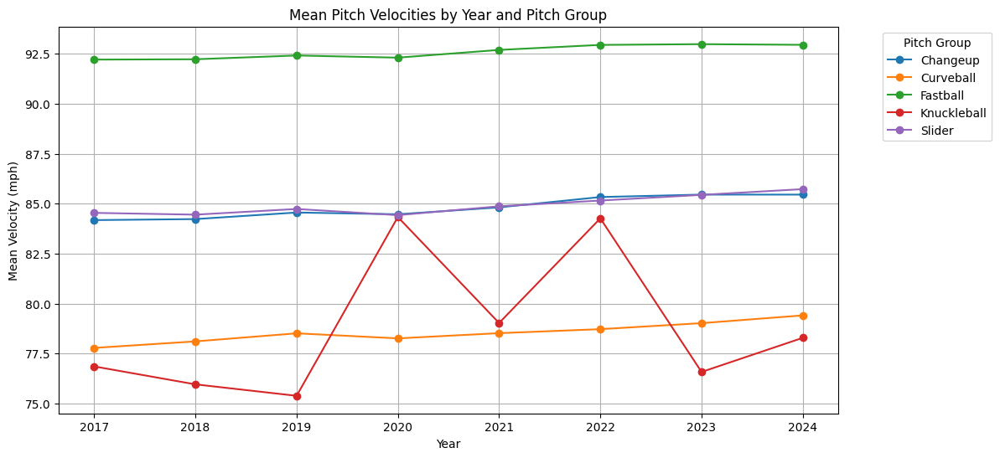

In [44]:
# Map each pitch_type to a broader group
pitch_group_map = {
    'FA': 'Fastball', 'FF': 'Fastball', 'FC': 'Fastball', 'FS': 'Fastball',
    'SL': 'Slider', 'CU': 'Curveball', 'CH': 'Changeup', 'SI': 'Fastball', 'KN': 'Knuckleball'
}

# Create a new column with the group
df['pitch_group'] = df['pitch_type'].map(pitch_group_map)

# Drop any pitch types not mapped
subset = df.dropna(subset=['pitch_group'])

# Group by year and pitch group
mean_vel_group = subset.groupby(['game_year', 'pitch_group'])['release_speed'].mean().unstack()
plt.figure(figsize=(12,6))

for group in mean_vel_group.columns:
    plt.plot(mean_vel_group.index, mean_vel_group[group], marker='o', label=group)

plt.xlabel('Year')
plt.ylabel('Mean Velocity (mph)')
plt.title('Mean Pitch Velocities by Year and Pitch Group')
plt.legend(title='Pitch Group', bbox_to_anchor=(1.05, 1))
plt.grid(True)
plt.show()

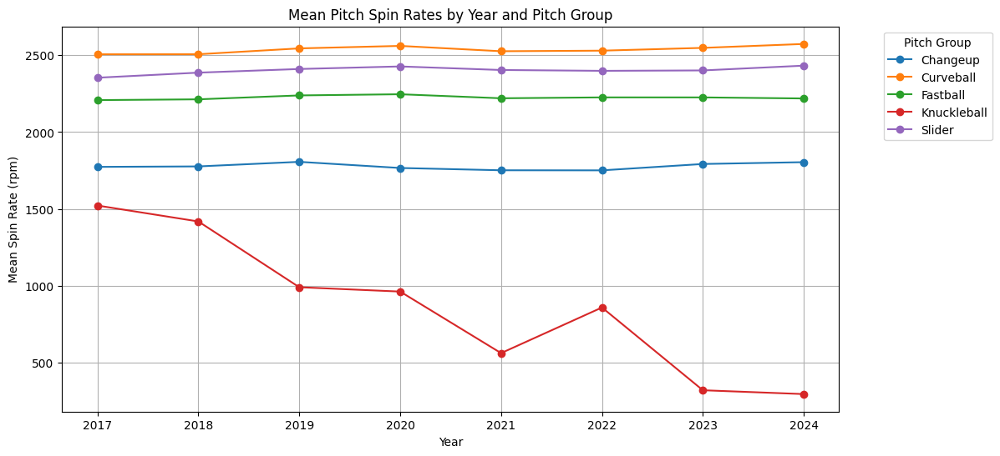

In [45]:
# Same plot for spin rate
# Group by year and pitch group
mean_spin_group = subset.groupby(['game_year', 'pitch_group'])['release_spin_rate'].mean().unstack()
plt.figure(figsize=(12,6))

for group in mean_spin_group.columns:
    plt.plot(mean_spin_group.index, mean_spin_group[group], marker='o', label=group)

plt.xlabel('Year')
plt.ylabel('Mean Spin Rate (rpm)')
plt.title('Mean Pitch Spin Rates by Year and Pitch Group')
plt.legend(title='Pitch Group', bbox_to_anchor=(1.05, 1))
plt.grid(True)
plt.show()

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1493832723.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  fastballs.groupby(["pitcher", "game_year", "p_throws"])
/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1493832723.py:52: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


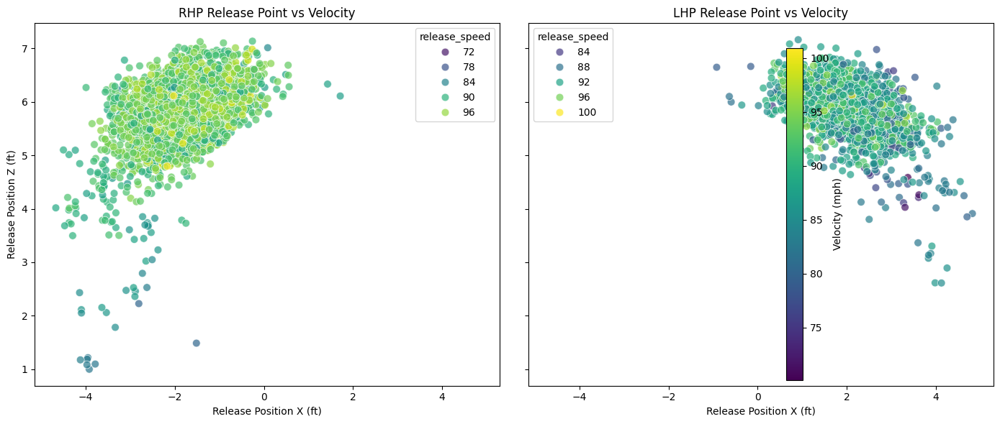

In [14]:
# Release point vs. velocity plot
avg_release = (
    fastballs.groupby(["pitcher", "game_year", "p_throws"])
             .agg({
                 "release_pos_x":"mean",
                 "release_pos_z":"mean",
                 "release_speed":"mean"
             })
             .reset_index()
)

# Convert to standard floats
avg_release = avg_release.astype({
    "release_pos_x": float,
    "release_pos_z": float,
    "release_speed": float
})

lefties = avg_release[avg_release["p_throws"] == "L"]
righties = avg_release[avg_release["p_throws"] == "R"]

fig, axes = plt.subplots(1, 2, figsize=(14,6), sharey=True, sharex=True)

# Righties
sns.scatterplot(
    data=righties,
    x="release_pos_x", y="release_pos_z",
    hue="release_speed", palette="viridis", s=60, alpha=0.7,
    ax=axes[0]
)
axes[0].set_title("RHP Release Point vs Velocity")
axes[0].set_xlabel("Release Position X (ft)")
axes[0].set_ylabel("Release Position Z (ft)")

# Lefties
sns.scatterplot(
    data=lefties,
    x="release_pos_x", y="release_pos_z",
    hue="release_speed", palette="viridis", s=60, alpha=0.7,
    ax=axes[1]
)
axes[1].set_title("LHP Release Point vs Velocity")
axes[1].set_xlabel("Release Position X (ft)")
axes[1].set_ylabel("Release Position Z (ft)")

# Shared colorbar
norm = plt.Normalize(avg_release["release_speed"].min(), avg_release["release_speed"].max())
sm = plt.cm.ScalarMappable(cmap="viridis", norm=norm)
sm.set_array([])
fig.colorbar(sm, ax=axes, orientation="vertical", label="Velocity (mph)")

plt.tight_layout()
plt.show()

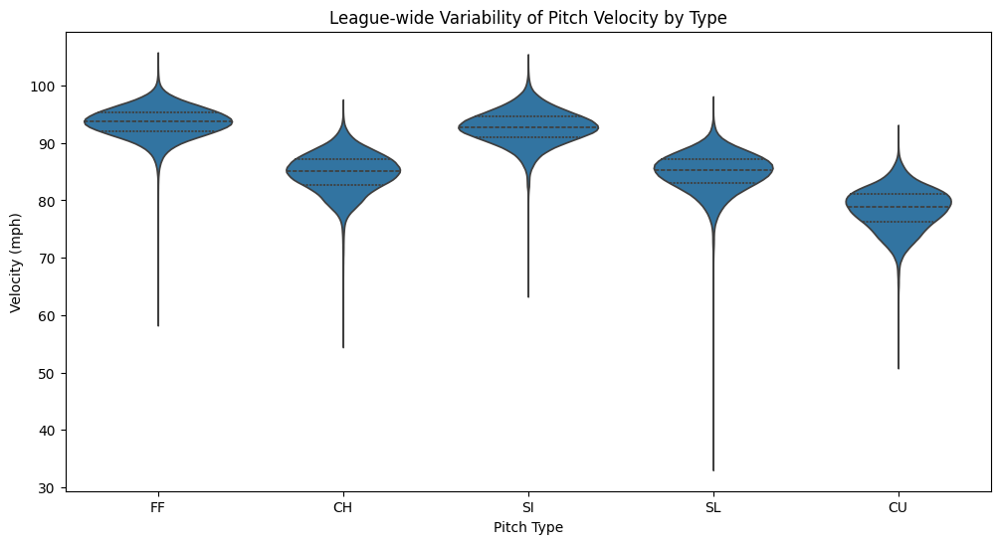

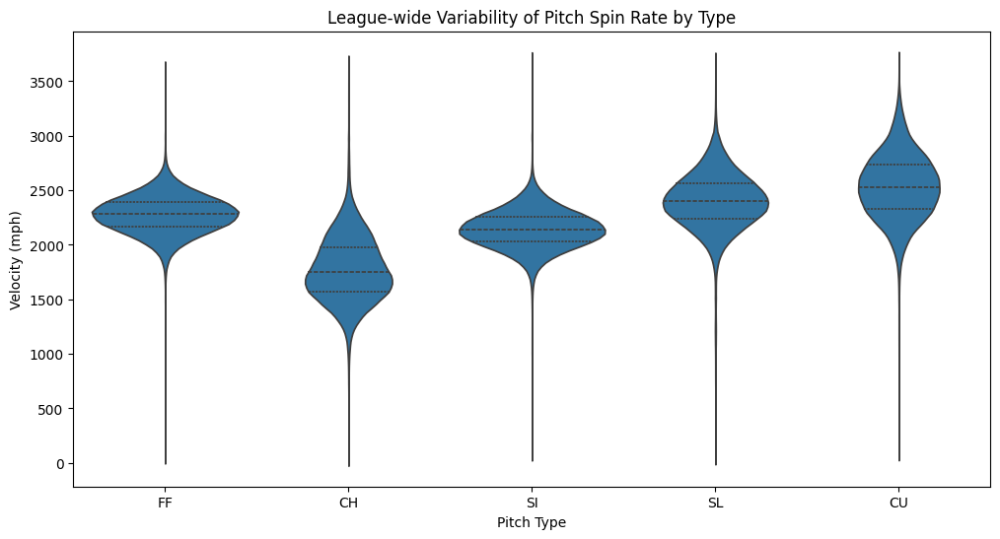

In [15]:
plt.figure(figsize=(12,6))
sns.violinplot(
    data=df[df['pitch_type'].isin(['FF','SL','CU','CH','SI'])],
    x='pitch_type', y='release_speed', inner='quartile'
)
plt.title("League-wide Variability of Pitch Velocity by Type")
plt.xlabel("Pitch Type")
plt.ylabel("Velocity (mph)")
plt.show()

plt.figure(figsize=(12,6))
sns.violinplot(
    data=df[df['pitch_type'].isin(['FF','SL','CU','CH','SI'])],
    x='pitch_type', y='release_spin_rate', inner='quartile'
)
plt.title("League-wide Variability of Pitch Spin Rate by Type")
plt.xlabel("Pitch Type")
plt.ylabel("Velocity (mph)")
plt.show()

<Axes: xlabel='release_speed', ylabel='release_spin_rate'>

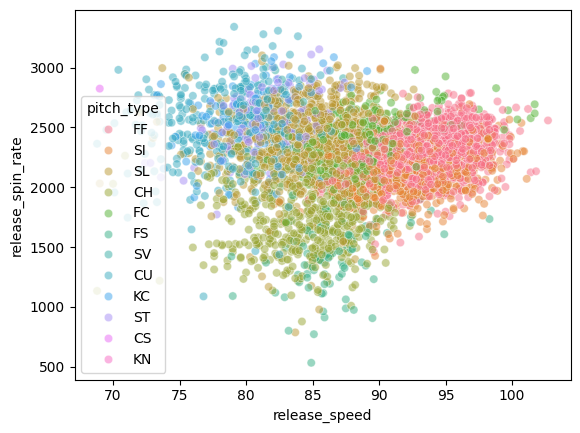

In [16]:
sns.scatterplot(
    data=df.sample(5000), 
    x="release_speed", y="release_spin_rate", 
    hue="pitch_type", alpha=0.5
)

In [93]:
def get_qualified_pitchers(year):
    df = pitching_stats(year, qual=1)
    
    # role classification: starter if majority of games are starts
    df['role'] = df.apply(lambda row: 'starter' if row['GS'] / row['G'] >= 0.5 else 'reliever', axis=1)
    
    # filter by innings
    if year != 2020:
        qualified = df[
            ((df['role'] == 'starter') & (df['IP'] >= 108)) |
            ((df['role'] == 'reliever') & (df['IP'] >= 54))
        ].copy()
    else:
        qualified = df[
            ((df['role'] == 'starter') & (df['IP'] >= 40)) |
            ((df['role'] == 'reliever') & (df['IP'] >= 20))
        ].copy()
    
    qualified['year'] = year
    return qualified

# Loop over seasons
qualified_all = pd.concat([get_qualified_pitchers(y) for y in range(2017, 2025)], ignore_index=True)

# Get unique FanGraphs IDs
fg_ids = qualified_all['IDfg'].unique().tolist()

# Map to MLBAM IDs
id_map = playerid_reverse_lookup(fg_ids, key_type='fangraphs')

# Merge the IDs onto your qualified pitcher list
qualified_all = qualified_all.merge(id_map[['key_fangraphs', 'key_mlbam']], 
                                    left_on='IDfg', right_on='key_fangraphs', 
                                    how='left')

# Clean up
qualified_all.rename(columns={'key_mlbam': 'mlbam_id'}, inplace=True)
qualified_all.drop(columns=['key_fangraphs'], inplace=True)

# Merge season by season
statcast_qualified = df.merge(
    qualified_all[['mlbam_id', 'year', 'role']],
    left_on=['pitcher', 'game_year'], 
    right_on=['mlbam_id', 'year'], 
    how='inner'
)

In [94]:
for col in statcast_qualified.columns:
    if pd.api.types.is_numeric_dtype(statcast_qualified[col]) and col in df:
        print(f"{col} min: {df[col].min()}")
        print(f"{col} mean: {df[col].mean()}")
        print(f"{col} max: {df[col].max()}")
        print(f"{col} missing: {df[col].isnull().sum()}")
        print(f"{col} total: {len(df[col])}")
        

print((df['release_pos_z']<0).sum())

release_speed min: 33.400001525878906
release_speed mean: 88.84990692138672
release_speed max: 105.5
release_speed missing: 10833
release_speed total: 5273035
release_pos_x min: -6.090000152587891
release_pos_x mean: -0.7969615459442139
release_pos_x max: 11.630000114440918
release_pos_x missing: 11106
release_pos_x total: 5273035
release_pos_z min: -0.029999999329447746
release_pos_z mean: 5.8346452713012695
release_pos_z max: 10.539999961853027
release_pos_z missing: 11106
release_pos_z total: 5273035
pitcher min: 112526.0
pitcher mean: 591054.3125
pitcher max: 814005.0
pitcher missing: 0
pitcher total: 5273035
game_year min: 2017
game_year mean: 2020.5248965728465
game_year max: 2024
game_year missing: 0
game_year total: 5273035
pfx_x min: -3.0
pfx_x mean: -0.13778693974018097
pfx_x max: 2.930000066757202
pfx_x missing: 10965
pfx_x total: 5273035
pfx_z min: -2.7899999618530273
pfx_z mean: 0.648885190486908
pfx_z max: 2.990000009536743
pfx_z missing: 10954
pfx_z total: 5273035
releas

In [95]:
# Checking how many NaNs and dropping them

# Make sure the column can store floats
statcast_qualified['release_spin_rate'] = statcast_qualified['release_spin_rate'].astype(float)
statcast_qualified['spin_axis'] = statcast_qualified['release_spin_rate'].astype(float)

# Many knuckleballs had NaN as spin rate (since they don't spin much), replace with mean spin rate
print((statcast_qualified['pitch_type']=='KN').sum())
knuckleball_mean_spin_rate = statcast_qualified.loc[
    statcast_qualified['pitch_type'] == 'KN', 'release_spin_rate'
].mean()

statcast_qualified.loc[
    (statcast_qualified['pitch_type'] == 'KN') & (statcast_qualified['release_spin_rate'].isna()),
    'release_spin_rate'
] = knuckleball_mean_spin_rate

knuckleball_mean_spin_axis = statcast_qualified.loc[
    statcast_qualified['pitch_type'] == 'KN', 'spin_axis'
].mean()

statcast_qualified.loc[
    (statcast_qualified['pitch_type'] == 'KN') & (statcast_qualified['spin_axis'].isna()),
    'spin_axis'
] = knuckleball_mean_spin_axis

num_pitcher_seasons = statcast_qualified.groupby(["pitcher", "game_year"]).ngroups
print("Number of pitcher-seasons:", num_pitcher_seasons)
# Total number of rows with at least one NaN in any column
num_rows_with_nans = statcast_qualified.isna().any(axis=1).sum()
print(f"Number of pitch rows with at least one NaN: {num_rows_with_nans}")

# Percentage of rows
total_rows = len(statcast_qualified)
print(f"Percentage: {num_rows_with_nans / total_rows * 100:.2f}%")

# Optional: see how many NaNs per column
print(statcast_qualified.isna().sum())

# Drop all pitch rows with any NaN
statcast_clean = statcast_qualified.dropna(axis=0, how='any').copy()

print(f"Rows after dropping NaNs: {len(statcast_clean)}")
print((statcast_clean['pitch_type']=='KN').sum())


3351
Number of pitcher-seasons: 2111
Number of pitch rows with at least one NaN: 248302
Percentage: 7.31%
pitch_type             8054
release_speed          7669
release_pos_x          7839
release_pos_z          7839
pitcher                   0
p_throws                  0
game_year                 0
pfx_x                  7762
pfx_z                  7756
release_spin_rate     36214
release_extension     10315
release_pos_y          7839
spin_axis             36214
pitch_group          220741
mlbam_id                  0
year                      0
role                      0
dtype: int64
Rows after dropping NaNs: 3148416
3351


In [96]:
# Make normalized features for outlier detection
def add_normalized_features(df):
    """Flip x-direction features for lefties (batter-perspective)."""
    df = df.copy()
    flip_cols = ['release_pos_x', 'pfx_x']
    for col in flip_cols:
        if col in df.columns:
            df[col + '_norm'] = df.apply(
                lambda row: -row[col] if row['p_throws'] == 'L' else row[col],
                axis=1
            )
    return df

statcast_clean_norm = add_normalized_features(statcast_clean)

# Build list of numerical columns for outlier detection
numerical_cols = statcast_clean_norm.select_dtypes(include='number').columns.tolist()

# Replace raw x-direction features with normalized versions
cols_for_outlier_check = [
    c if c not in ['release_pos_x', 'pfx_x']
    else c + '_norm'
    for c in numerical_cols
]

# Compute z-scores per pitch type
def zscore_per_group(group):
    return group[cols_for_outlier_check].apply(zscore)

z_scores_by_pitch = statcast_clean_norm.groupby('pitch_type', group_keys=False).apply(zscore_per_group)

# Identify outliers (abs z-score > 4)
outliers_bool = z_scores_by_pitch.abs() > 4

# Create long-form table of outliers
outlier_long = outliers_bool.stack()
outlier_long = outlier_long[outlier_long]  # keep only True
outlier_long = outlier_long.reset_index()
outlier_long.columns = ['row_index', 'feature', 'is_outlier']

# Merge with pitcher info and get actual values
cols_to_use = ['pitcher', 'pitch_type'] + cols_for_outlier_check
statcast_subset = statcast_clean_norm[cols_to_use].reset_index()

outlier_details = outlier_long.merge(
    statcast_subset,
    left_on='row_index',
    right_on='index'
)

outlier_details['value'] = outlier_details.apply(
    lambda x: statcast_clean_norm.loc[x['row_index'], x['feature']],
    axis=1
)

print(outlier_details.head(20))


/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/408159016.py:30: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  z_scores_by_pitch = statcast_clean_norm.groupby('pitch_type', group_keys=False).apply(zscore_per_group)


    row_index            feature  is_outlier  index   pitcher pitch_type  \
0         407  release_extension        True    407  621389.0         CH   
1         407      release_pos_y        True    407  621389.0         CH   
2         735  release_spin_rate        True    735  461829.0         CH   
3         735          spin_axis        True    735  461829.0         CH   
4        1184  release_spin_rate        True   1184  607536.0         FC   
5        1184          spin_axis        True   1184  607536.0         FC   
6        1288            pitcher        True   1288  112526.0         SI   
7        1288           mlbam_id        True   1288  112526.0         SI   
8        1289            pitcher        True   1289  112526.0         SI   
9        1289           mlbam_id        True   1289  112526.0         SI   
10       1290            pitcher        True   1290  112526.0         FF   
11       1290           mlbam_id        True   1290  112526.0         FF   
12       129

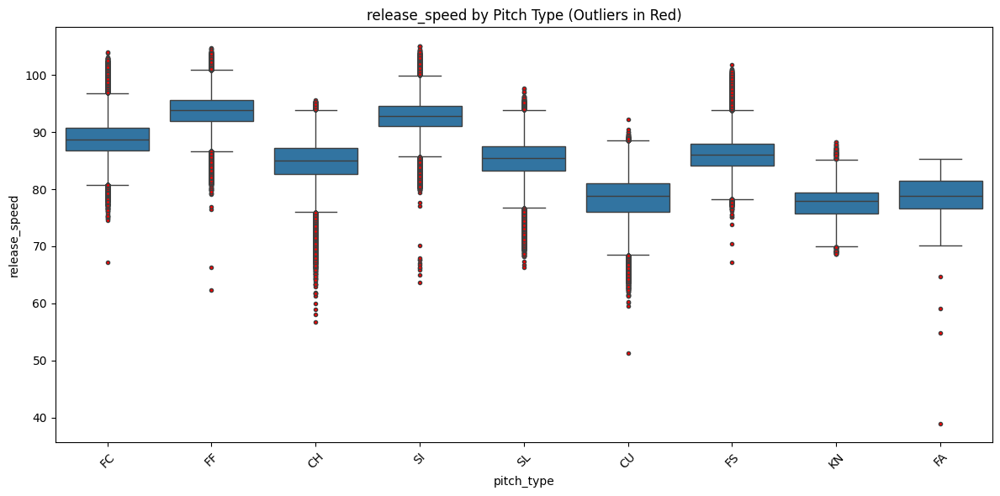

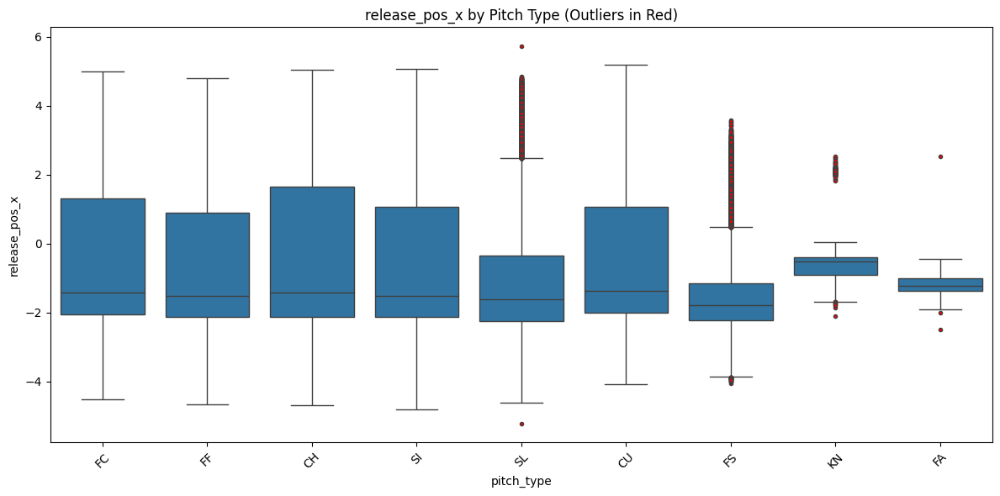

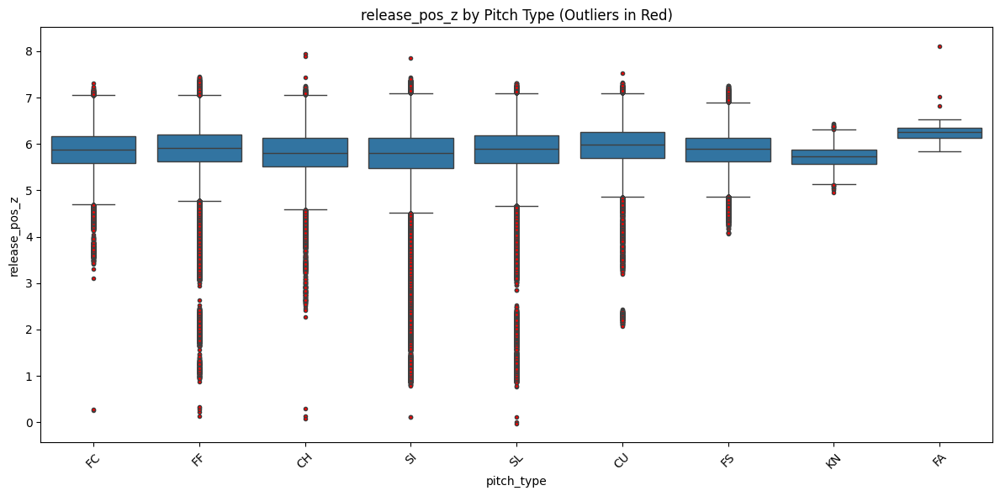

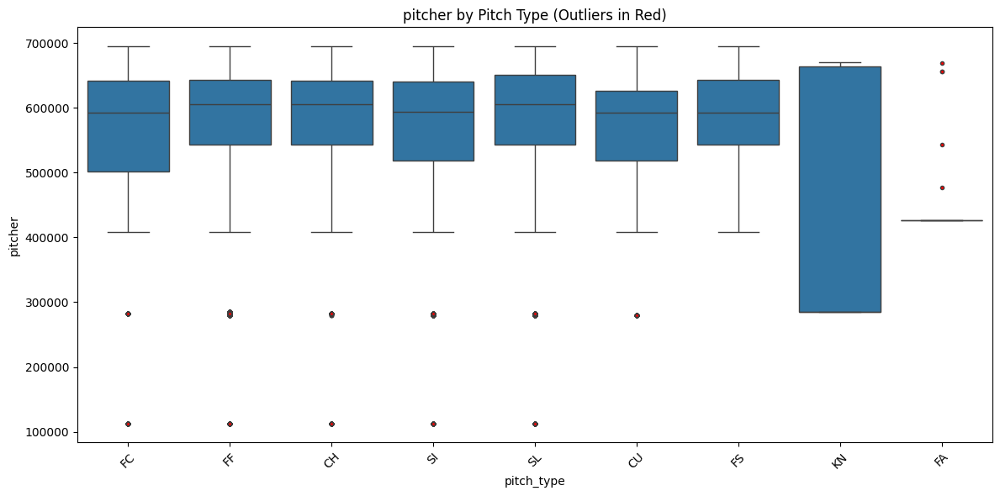

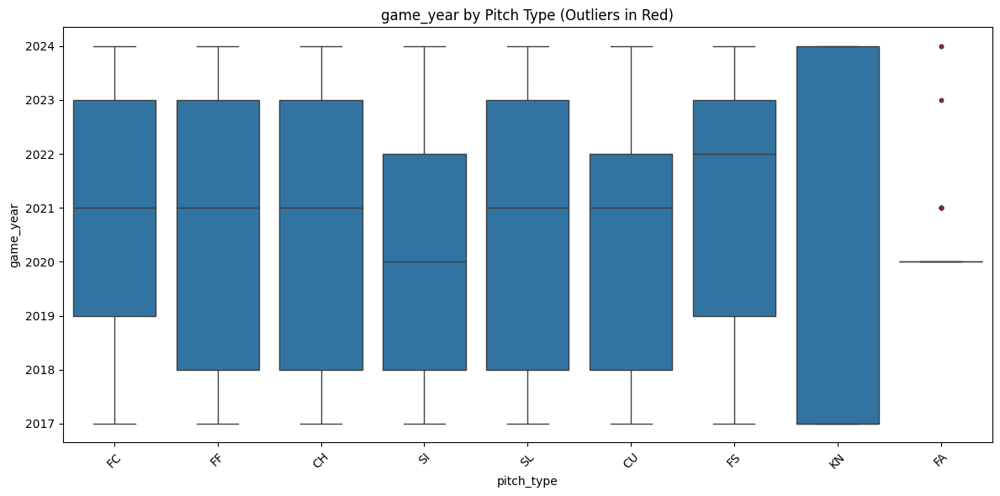

...

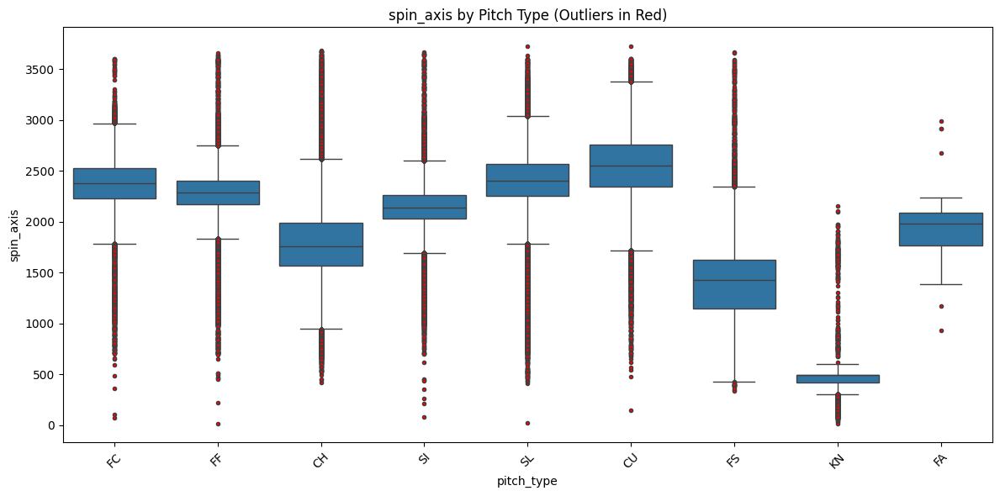

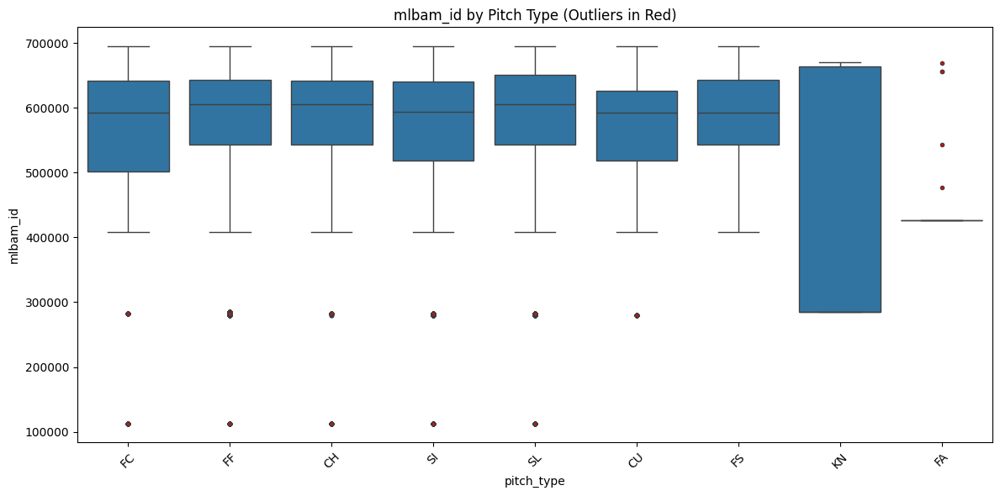

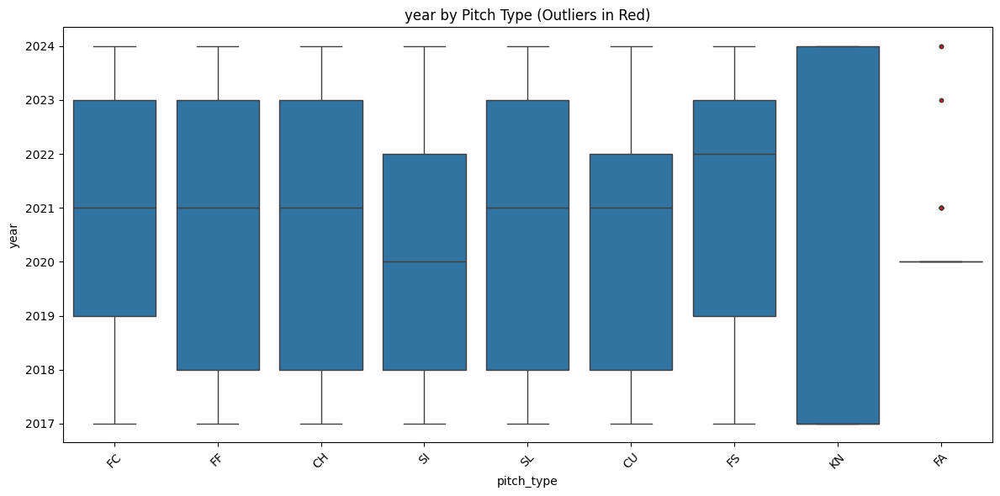

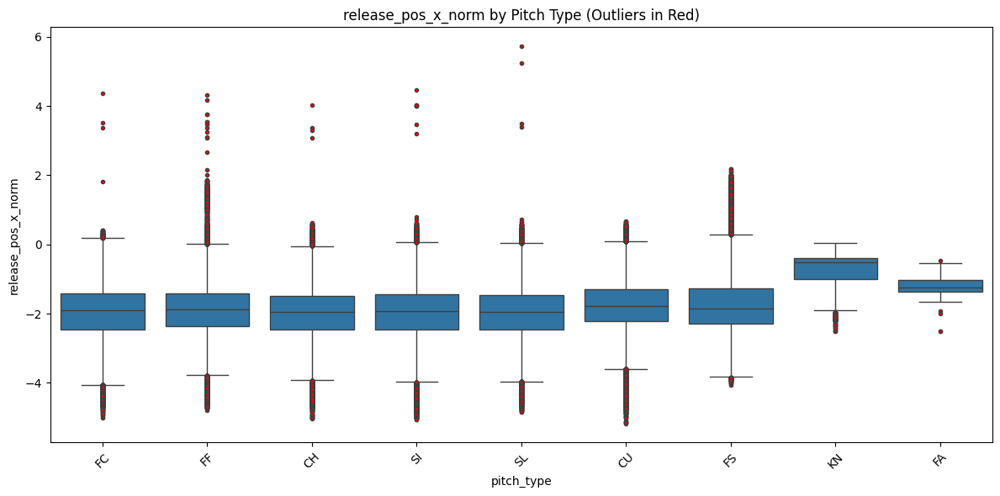

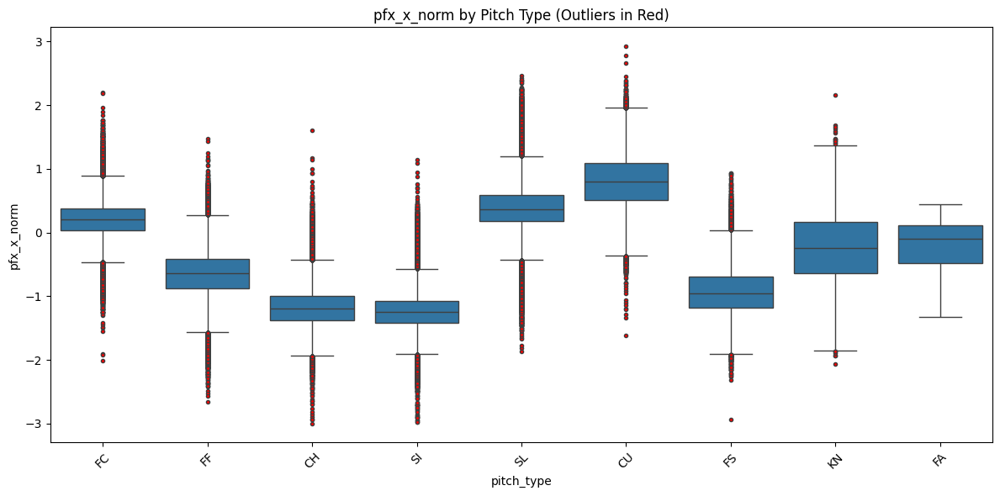

In [97]:
# Make sure only looking at numerical features
numerical_cols = statcast_clean_norm.select_dtypes(include='number').columns

# Loop through each numerical feature
for feature in numerical_cols:
    plt.figure(figsize=(12, 6))
    sns.boxplot(
        data=statcast_clean_norm,
        x='pitch_type',
        y=feature,
        showfliers=True,   # explicitly show outliers
        flierprops={'marker': 'o', 'markerfacecolor': 'red', 'markersize': 3}
    )
    plt.title(f'{feature} by Pitch Type (Outliers in Red)')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

In [98]:
# Count original pitch types
pitch_counts = statcast_clean['pitch_type'].value_counts()
print(pitch_counts)

# Define mapping
pitch_map = {
    # Fastballs
    'FF': 'FF',   # Four-seam
    'FA': 'FF',   # Map FA to FF
    'FC': 'FC',   # Cutter
    'SI': 'SI',   # Sinker
    'FS': 'FS',   # Splitter
    'FO': 'FS',   # Occasionally FO is logged, treat as Splitter
    'SV': 'SL',   # Slurve -> Sliders
    'ST': 'SL',   # Sweeper -> Sliders

    # Offspeed / Breaking
    'SL': 'SL',   # Slider
    'CU': 'CU',   # Curveball
    'KC': 'CU',   # Knuckle curve -> Curveball
    'CS': 'CU',   # Slow curve
    'CH': 'CH',   # Changeup
    'SC': 'CH',   # Screwball -> Changeup
    'KN': 'KN',   # Knuckleball
    'EP': 'DROP', # Eephus, dropping

    # Rare / to drop
    'PO': 'DROP',   # Pitch out, dropping
}

# Apply mapping
statcast_clean['pitch_grouped'] = statcast_clean['pitch_type'].map(pitch_map)

# Drop unwanted pitches
statcast_clean = statcast_clean[statcast_clean['pitch_grouped'] != 'DROP']

# New grouped counts
grouped_counts = statcast_clean['pitch_grouped'].value_counts()
print(grouped_counts)

pitch_type
FF    1132274
SI     582769
SL     498800
CH     362940
FC     253717
CU     246027
FS      68467
KN       3351
FA         71
Name: count, dtype: int64
pitch_grouped
FF    1132345
SI     582769
SL     498800
CH     362940
FC     253717
CU     246027
FS      68467
KN       3351
Name: count, dtype: int64


In [99]:
print(list(statcast_clean_norm.columns))
# Sort by normalized release_pos_x from largest (most positive) to smallest
suspect_releases = (
    statcast_clean_norm
    .sort_values(by='release_pos_x_norm', ascending=False)
    [['pitcher', 'p_throws', 'pitch_type', 'release_pos_x', 'release_pos_x_norm',
      'game_year']]
    .head(50)
)

print(suspect_releases)
righties = statcast_clean_norm[statcast_clean_norm['p_throws']=='R']
print(righties['release_pos_x'].mean())
lefties = statcast_clean_norm[statcast_clean_norm['p_throws']=='L']
print(lefties['release_pos_x'].mean())

release_means = (
    statcast_clean
    .groupby(['game_year', 'p_throws'])['release_pos_x']
    .mean()
    .reset_index()
    .pivot(index='game_year', columns='p_throws', values='release_pos_x')
)

print(release_means)
kershaw = statcast_clean_norm[statcast_clean_norm['pitcher']==477132.0]
print(kershaw['release_pos_x'].mean())
kershaw['release_pos_x_sign'] = np.where(kershaw['release_pos_x'] >= 0, 'positive', 'negative')

counts = kershaw['release_pos_x_sign'].value_counts()
print(counts)


['pitch_type', 'release_speed', 'release_pos_x', 'release_pos_z', 'pitcher', 'p_throws', 'game_year', 'pfx_x', 'pfx_z', 'release_spin_rate', 'release_extension', 'release_pos_y', 'spin_axis', 'pitch_group', 'mlbam_id', 'year', 'role', 'release_pos_x_norm', 'pfx_x_norm']
          pitcher p_throws pitch_type  release_pos_x  release_pos_x_norm  \
249510   570632.0        R         SL           5.73                5.73   
985956   477132.0        L         SL          -5.23                5.23   
211879   502171.0        R         SI           4.47                4.47   
214007   446372.0        R         FC           4.37                4.37   
208675   502042.0        R         FF           4.32                4.32   
214001   446372.0        R         FF           4.16                4.16   
161178   450306.0        L         SI          -4.03                4.03   
161182   450306.0        L         CH          -4.02                4.02   
161152   450306.0        L         SI        

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/3887480424.py:19: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby(['game_year', 'p_throws'])['release_pos_x']
/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/3887480424.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  kershaw['release_pos_x_sign'] = np.where(kershaw['release_pos_x'] >= 0, 'positive', 'negative')


In [100]:
# Group by handedness + year to normalize within context
def flag_release_outliers(df):
    df['release_pos_x_z'] = df.groupby(['p_throws','game_year'])['release_pos_x'].transform(zscore)
    return df

statcast_clean = flag_release_outliers(statcast_clean)

# Filter out extreme outliers (e.g. |z| > 4)
statcast_clean = statcast_clean[statcast_clean['release_pos_x_z'].abs() <= 4]

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/2539225547.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df['release_pos_x_z'] = df.groupby(['p_throws','game_year'])['release_pos_x'].transform(zscore)


In [101]:
suspect_releases = (
    statcast_clean_norm
    .sort_values(by='release_pos_x_norm', ascending=False)
    [['pitcher', 'p_throws', 'pitch_type', 'release_pos_x', 'release_pos_x_norm',
      'game_year']]
    .head(50)
)

print(suspect_releases)

          pitcher p_throws pitch_type  release_pos_x  release_pos_x_norm  \
249510   570632.0        R         SL           5.73                5.73   
985956   477132.0        L         SL          -5.23                5.23   
211879   502171.0        R         SI           4.47                4.47   
214007   446372.0        R         FC           4.37                4.37   
208675   502042.0        R         FF           4.32                4.32   
214001   446372.0        R         FF           4.16                4.16   
161178   450306.0        L         SI          -4.03                4.03   
161182   450306.0        L         CH          -4.02                4.02   
161152   450306.0        L         SI          -4.02                4.02   
161171   450306.0        L         SI          -4.01                4.01   
161150   450306.0        L         SI           -4.0                4.00   
468899   543557.0        L         FF          -3.75                3.75   
4873     502

In [102]:
fastball_types = ['FF', 'SI', 'FC']

# Filter out any fastball slower than 70 mph
statcast_clean = statcast_clean[~((statcast_clean['pitch_type'].isin(fastball_types)) &
                                  (statcast_clean['release_speed'] < 70))]
print(list(statcast_clean.columns))
print(statcast_clean['pitch_type'].unique())
print(statcast_clean['pitch_grouped'].unique())

['pitch_type', 'release_speed', 'release_pos_x', 'release_pos_z', 'pitcher', 'p_throws', 'game_year', 'pfx_x', 'pfx_z', 'release_spin_rate', 'release_extension', 'release_pos_y', 'spin_axis', 'pitch_group', 'mlbam_id', 'year', 'role', 'pitch_grouped', 'release_pos_x_z']
['FC' 'FF' 'CH' 'SI' 'SL' 'CU' 'FS' 'KN' 'FA']
['FC' 'FF' 'CH' 'SI' 'SL' 'CU' 'FS' 'KN']


In [203]:
def create_pitcher_season_df(statcast_clean):
    """
    Converts pitch-level Statcast data into a pitcher-season level dataframe
    with averaged pitch metrics per pitch type, pitch usage fractions,
    and overall release position metrics.
    """
    statcast_clean = statcast_clean.copy()
    statcast_clean['p_throws_num'] = statcast_clean['p_throws'].map({'R': 1, 'L': 0})

    numeric_cols = [
        'release_speed', 'release_pos_x', 'release_pos_z', 
        'pfx_x', 'pfx_z', 'release_extension'
    ]

    pitch_agg = (
        statcast_clean
        .groupby(['pitcher', 'game_year', 'pitch_grouped'])[numeric_cols]
        .mean()
        .reset_index()
    )

    pitch_specific_cols = ['release_speed', 'pfx_x', 'pfx_z']

    pitcher_season_df = pitch_agg.pivot_table(
        index=['pitcher', 'game_year'],
        columns='pitch_grouped',
        values=pitch_specific_cols,
        fill_value=0
    )

    pitcher_season_df.columns = ['_'.join(col).strip() for col in pitcher_season_df.columns.values]
    pitcher_season_df = pitcher_season_df.reset_index()

    # --- pitch fractions (your existing code) ---
    pitch_counts = (
        statcast_clean
        .groupby(['pitcher', 'game_year', 'pitch_grouped'])
        .size()
        .reset_index(name='pitch_count')
    )

    pitch_counts['pitch_frac'] = (
        pitch_counts.groupby(['pitcher', 'game_year'])['pitch_count']
        .transform(lambda x: x / x.sum())
    )

    pitch_frac_pivot = pitch_counts.pivot_table(
        index=['pitcher', 'game_year'],
        columns='pitch_grouped',
        values='pitch_frac',
        fill_value=0
    )
    pitch_frac_pivot.columns = [f"{col}_frac" for col in pitch_frac_pivot.columns]
    pitch_frac_pivot = pitch_frac_pivot.reset_index()

    pitcher_season_df = pitcher_season_df.merge(pitch_frac_pivot, on=['pitcher', 'game_year'])

    # --- overall release position metrics (existing) ---
    release_means = (
        statcast_clean
        .groupby(['pitcher', 'game_year'])[['release_pos_x', 'release_pos_z', 'release_extension']]
        .mean()
        .reset_index()
    )
    pitcher_season_df = pitcher_season_df.merge(release_means, on=['pitcher', 'game_year'], how='left')

    # --- NEW: handedness and role at pitcher-season level ---
    hand_role = (
        statcast_clean[['pitcher', 'game_year', 'p_throws', 'p_throws_num', 'role']]
        .drop_duplicates(subset=['pitcher', 'game_year'])
    )
    pitcher_season_df = pitcher_season_df.merge(hand_role, on=['pitcher', 'game_year'], how='left')

    return pitcher_season_df


# Rebuild after editing
pitcher_season_df = create_pitcher_season_df(statcast_clean)
print(pitcher_season_df[['pitcher', 'game_year', 'p_throws', 'p_throws_num', 'role']].head())


    pitcher  game_year p_throws p_throws_num      role
0  112526.0       2017        R            1   starter
1  112526.0       2018        R            1   starter
2  279571.0       2017        R            1  reliever
3  282332.0       2017        L            0   starter
4  282332.0       2018        L            0   starter


['pitcher', 'game_year', 'pfx_x_CH', 'pfx_x_CU', 'pfx_x_FC', 'pfx_x_FF', 'pfx_x_FS', 'pfx_x_KN', 'pfx_x_SI', 'pfx_x_SL', 'pfx_z_CH', 'pfx_z_CU', 'pfx_z_FC', 'pfx_z_FF', 'pfx_z_FS', 'pfx_z_KN', 'pfx_z_SI', 'pfx_z_SL', 'release_speed_CH', 'release_speed_CU', 'release_speed_FC', 'release_speed_FF', 'release_speed_FS', 'release_speed_KN', 'release_speed_SI', 'release_speed_SL', 'CH_frac', 'CU_frac', 'FC_frac', 'FF_frac', 'FS_frac', 'KN_frac', 'SI_frac', 'SL_frac', 'release_pos_x', 'release_pos_z', 'release_extension', 'p_throws', 'p_throws_num', 'role']


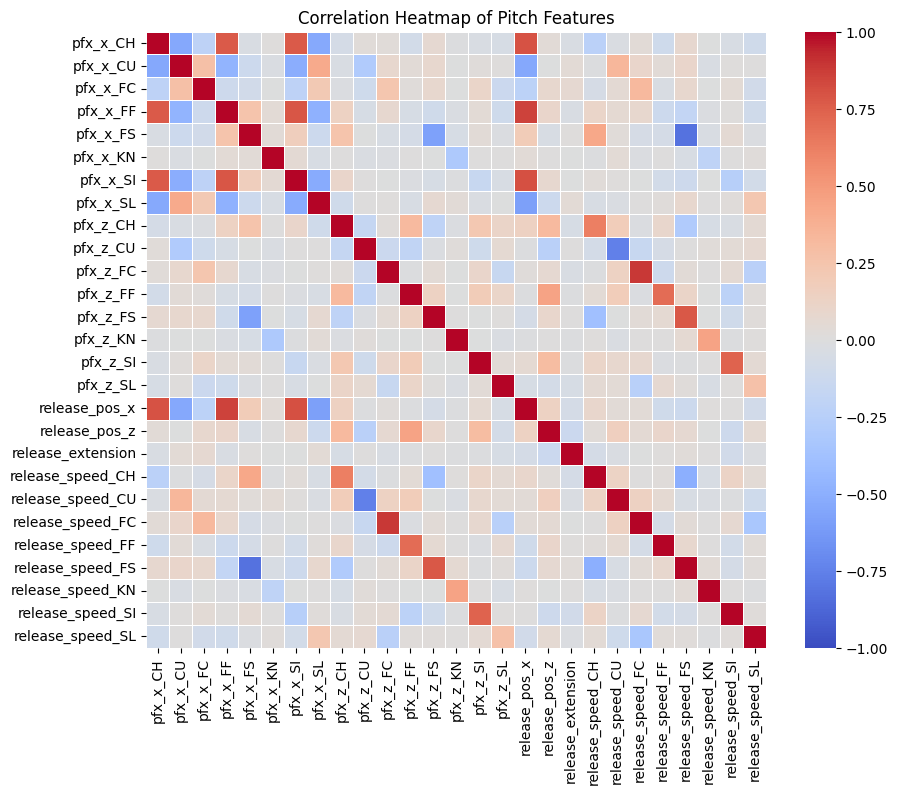

In [204]:
print(list(pitcher_season_df.columns))
#features = ['pitcher', 'game_year', 'ax_CH', 'ax_CU', 'ax_FC', 'ax_FF', 'ax_FS', 'ax_KN', 'ax_SI', 'ax_SL', 'ay_CH', 'ay_CU', 'ay_FC', 'ay_FF', 'ay_FS', 'ay_KN', 'ay_SI', 'ay_SL', 'az_CH', 'az_CU', 'az_FC', 'az_FF', 'az_FS', 'az_KN', 'az_SI', 'az_SL', 'pfx_x_CH', 'pfx_x_CU', 'pfx_x_FC', 'pfx_x_FF', 'pfx_x_FS', 'pfx_x_KN', 'pfx_x_SI', 'pfx_x_SL', 'pfx_z_CH', 'pfx_z_CU', 'pfx_z_FC', 'pfx_z_FF', 'pfx_z_FS', 'pfx_z_KN', 'pfx_z_SI', 'pfx_z_SL', 'release_extension_CH', 'release_extension_CU', 'release_extension_FC', 'release_extension_FF', 'release_extension_FS', 'release_extension_KN', 'release_extension_SI', 'release_extension_SL', 'release_pos_x_CH', 'release_pos_x_CU', 'release_pos_x_FC', 'release_pos_x_FF', 'release_pos_x_FS', 'release_pos_x_KN', 'release_pos_x_SI', 'release_pos_x_SL', 'release_pos_z_CH', 'release_pos_z_CU', 'release_pos_z_FC', 'release_pos_z_FF', 'release_pos_z_FS', 'release_pos_z_KN', 'release_pos_z_SI', 'release_pos_z_SL', 'release_speed_CH', 'release_speed_CU', 'release_speed_FC', 'release_speed_FF', 'release_speed_FS', 'release_speed_KN', 'release_speed_SI', 'release_speed_SL', 'release_spin_rate_CH', 'release_spin_rate_CU', 'release_spin_rate_FC', 'release_spin_rate_FF', 'release_spin_rate_FS', 'release_spin_rate_KN', 'release_spin_rate_SI', 'release_spin_rate_SL', 'spin_axis_CH', 'spin_axis_CU', 'spin_axis_FC', 'spin_axis_FF', 'spin_axis_FS', 'spin_axis_KN', 'spin_axis_SI', 'spin_axis_SL', 'vx0_CH', 'vx0_CU', 'vx0_FC', 'vx0_FF', 'vx0_FS', 'vx0_KN', 'vx0_SI', 'vx0_SL', 'vy0_CH', 'vy0_CU', 'vy0_FC', 'vy0_FF', 'vy0_FS', 'vy0_KN', 'vy0_SI', 'vy0_SL', 'vz0_CH', 'vz0_CU', 'vz0_FC', 'vz0_FF', 'vz0_FS', 'vz0_KN', 'vz0_SI', 'vz0_SL', 'p_throws_num', 'CH_frac', 'CU_frac', 'FC_frac', 'FF_frac', 'FS_frac', 'KN_frac', 'SI_frac', 'SL_frac']
features = ['pfx_x_CH', 'pfx_x_CU', 'pfx_x_FC', 'pfx_x_FF', 'pfx_x_FS', 'pfx_x_KN', 'pfx_x_SI', 'pfx_x_SL', 'pfx_z_CH', 'pfx_z_CU', 'pfx_z_FC', 'pfx_z_FF', 'pfx_z_FS', 'pfx_z_KN', 'pfx_z_SI', 'pfx_z_SL', 'release_pos_x', 'release_pos_z', 'release_extension', 'release_speed_CH', 'release_speed_CU', 'release_speed_FC', 'release_speed_FF', 'release_speed_FS', 'release_speed_KN', 'release_speed_SI', 'release_speed_SL']
corr = pitcher_season_df[features].corr()

plt.figure(figsize=(10,8))
sns.heatmap(corr, annot=False, cmap='coolwarm', vmin=-1, vmax=1, linewidths=0.5)
plt.title("Correlation Heatmap of Pitch Features")
plt.show()

In [205]:
# Dropping any pitches a pitcher-season throws <2% of the time
pitch_types = ['FF', 'SL', 'CH', 'CU', 'SI', 'FC', 'FS', 'KN']
# Define cutoff (<2%)
cutoff = 0.02

# Find all pitch fraction columns
frac_cols = [col for col in pitcher_season_df.columns if col.endswith('_frac')]

# Apply threshold: set any pitch fraction < 1% to 0
for col in frac_cols:
    pitcher_season_df.loc[pitcher_season_df[col] < cutoff, col] = 0

for pitch in pitch_types:
    frac_col = f'{pitch}_frac'
    bin_col = f'throws_{pitch}'
    pitcher_season_df[bin_col] = (pitcher_season_df[frac_col] > 0).astype(int)

Empty DataFrame
Columns: [pitcher, pitch_type, frequency]
Index: []


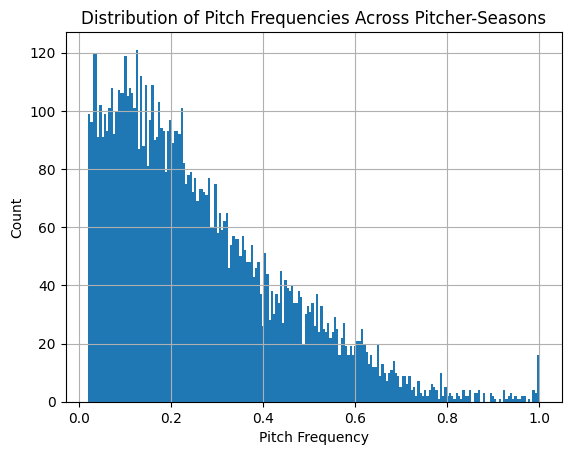

In [206]:
# Melt to have one row per pitcher-pitch combo
pitch_freqs = pitcher_season_df.melt(
    id_vars=['pitcher'],
    value_vars=[col for col in pitcher_season_df.columns if col.endswith('_frac')],
    var_name='pitch_type',
    value_name='frequency'
)

pitch_freqs = pitch_freqs[pitch_freqs['frequency'] > 0]

# Sort to see lowest frequencies
lowest_freqs = pitch_freqs.sort_values('frequency').head(20)

low_freq_threshold = 0.02
rare_pitches = pitch_freqs[pitch_freqs['frequency'] < low_freq_threshold]
print(rare_pitches.sort_values('frequency'))

pitch_freqs['frequency'].hist(bins=200)
plt.xlabel('Pitch Frequency')
plt.ylabel('Count')
plt.title('Distribution of Pitch Frequencies Across Pitcher-Seasons')
plt.show()



In [ ]:
# impute league averages
league_avg = {}

for pitch in pitch_types:
    # columns for this pitch's metrics
    metric_cols = [
        col for col in pitcher_season_df.columns
        if col.endswith(f'_{pitch}')
        and not col.endswith('_frac')
        and not col.startswith('throws_')
    ]
    throws_col = f'throws_{pitch}'

    if not metric_cols or throws_col not in pitcher_season_df.columns:
        continue

    mask_has_pitch = pitcher_season_df[throws_col] == 1

    # League avg only among pitchers who actually throw this pitch (after 2% cutoff)
    league_avg[pitch] = pitcher_season_df.loc[mask_has_pitch, metric_cols].mean()


In [208]:
for pitch in pitch_types:
    metric_cols = [
        col for col in pitcher_season_df.columns
        if col.endswith(f'_{pitch}')
        and not col.endswith('_frac')
        and not col.startswith('throws_')
    ]
    throws_col = f'throws_{pitch}'

    # Skip if we don't have this pitch, or no league average
    if pitch not in league_avg or not metric_cols or throws_col not in pitcher_season_df.columns:
        continue

    mask_no_pitch = pitcher_season_df[throws_col] == 0

    # For each metric column, fill non-throwers with the league-average value
    for col in metric_cols:
        fill_value = league_avg[pitch][col]  # scalar
        pitcher_season_df.loc[mask_no_pitch, col] = fill_value


I started playing around with feature engineering, but ultimately decided against using these features, so the code to create them is here but is not applied to any dfs.

In [108]:
def compute_pitch_metric_spread(df, metric_prefix):
    """
    Compute the spread (max - min) across all pitches for a given metric.

    Parameters
    ----------
    df : pd.DataFrame
        Pitcher-season dataframe
    metric_prefix : str
        Prefix for the metric columns (e.g., 'release_speed_', 'release_spin_rate_', 'pfx_x_')

    Returns
    -------
    pd.Series
        Spread values for each pitcher-season
    """
    # Select all columns that belong to this metric
    metric_cols = [col for col in df.columns if col.startswith(metric_prefix) and "_spread" not in col]
    
    def spread_func(row):
        values = [v for v in row[metric_cols].fillna(0) if v!=0]
        if len(values) <= 1:
            return 0
        return max(values) - min(values)
    
    return df.apply(spread_func, axis=1)


In [109]:
# tunneling is when two (or more) pitches move differently but are nearly impossible to tell apart when they leave the pitcher's hand
PITCH_TYPES = ['FF', 'SL', 'CH', 'CU', 'SI', 'FC', 'FS', 'KN']

def compute_pitcher_tunneling(pitcher_row: pd.Series) -> tuple[pd.DataFrame, float]:
    """
    Compute tunneling scores for a single pitcher-season.
    
    Returns:
        pair_df (pd.DataFrame): Per-pitch-pair tunneling scores.
        overall_score (float): Weighted average tunneling score for the pitcher-season.
    """
    results = []
    
    # Determine which pitches this pitcher throws
    thrown_pitches = [p for p in PITCH_TYPES if pitcher_row.get(f"throws_{p}", 0) == 1]
    if len(thrown_pitches) < 2:
        # Can't compute tunneling with fewer than two pitch types
        return pd.DataFrame(), np.nan

    # Iterate through all unique pitch pairs
    for p1, p2 in combinations(thrown_pitches, 2):
        # Build field names for relevant features
        def feat(pitch, feat_name):
            return pitcher_row.get(f"{feat_name}_{pitch}", np.nan)

        # --- Compute release similarity ---
        release_dist = np.linalg.norm([
            feat(p1, "release_pos_x") - feat(p2, "release_pos_x"),
            feat(p1, "release_pos_z") - feat(p2, "release_pos_z"),
            feat(p1, "release_extension") - feat(p2, "release_extension")
        ])
        release_similarity = 1 / (1 + release_dist)

        # --- Compute initial trajectory similarity (velocity cosine) ---
        v1 = np.array([feat(p1, "vx0"), feat(p1, "vy0"), feat(p1, "vz0")])
        v2 = np.array([feat(p2, "vx0"), feat(p2, "vy0"), feat(p2, "vz0")])
        if np.any(np.isnan(v1)) or np.any(np.isnan(v2)):
            continue  # skip invalid data
        dir_cos = np.dot(v1, v2) / (np.linalg.norm(v1) * np.linalg.norm(v2))

        # --- Compute movement separation ---
        move_sep = np.linalg.norm([
            feat(p1, "pfx_x") - feat(p2, "pfx_x"),
            feat(p1, "pfx_z") - feat(p2, "pfx_z")
        ])

        # --- Compute tunneling index ---
        tunneling_index = (dir_cos / (1 + release_dist)) * (1 + move_sep)

        # --- Weight based on usage fractions ---
        w1 = feat(p1, "frac")
        w2 = feat(p2, "frac")
        weight = w1 * w2 if not (np.isnan(w1) or np.isnan(w2)) else 1

        results.append({
            "pitch_pair": f"{p1}-{p2}",
            "tunneling_index": tunneling_index,
            "release_dist": release_dist,
            "dir_cos": dir_cos,
            "move_sep": move_sep,
            "weight": weight
        })
    
    pair_df = pd.DataFrame(results)
    if pair_df.empty:
        return pair_df, np.nan

    # Weighted mean tunneling score (overall for this pitcher-season)
    overall_score = np.average(pair_df["tunneling_index"], weights=pair_df["weight"])
    
    return pair_df, overall_score

In [ ]:
# spin efficiency, another feature not used
# THIS CODE WILL NOT RUN SUCCESSFULLY SINCE WE HAVE DROPPED SPIN ALREADY
# In original experiments, spin features were included
for pitch in PITCH_TYPES:
    pfx_x = f'pfx_x_{pitch}'
    pfx_z = f'pfx_z_{pitch}'
    spin_axis = f'spin_axis_{pitch}'
    throws_col = f'throws_{pitch}'  # must exist in your df (0 if not thrown)
    
    # Mask for pitches actually thrown
    mask = pitcher_season_df[throws_col] > 0
    
    # Compute movement direction and spin axis angle (only where thrown)
    move_dir = np.arctan2(pitcher_season_df.loc[mask, pfx_x], pitcher_season_df.loc[mask, pfx_z])
    spin_axis_rad = np.deg2rad(pitcher_season_df.loc[mask, spin_axis])
    
    # Angular difference and spin efficiency
    delta = np.abs(move_dir - spin_axis_rad)

    # would add this to pitcher_season_df for masked pitches if this feature was used
    spin_eff = np.abs(np.cos(delta))

KeyError: 'spin_axis_FF'

Following code will be used for plots to compare pitchers

In [209]:
# Adding pitcher names to df rather than just mlbam ids
# Get unique MLBAM IDs
mlbam_ids = pitcher_season_df["pitcher"].unique()

# Look up player info
id_lookup = playerid_reverse_lookup(mlbam_ids)

# Merge with pitcher-season df
pitcher_season_df = pitcher_season_df.merge(
    id_lookup[['key_mlbam', 'name_first', 'name_last']],
    how='left',
    left_on='pitcher',
    right_on='key_mlbam'
)

# Create a full name column
pitcher_season_df['name'] = pitcher_season_df['name_first'] + ' ' + pitcher_season_df['name_last']
pitcher_season_df = pitcher_season_df.drop('key_mlbam', axis=1)

In [210]:
print(pitcher_season_df['name'].unique())

['bartolo colón' 'matt belisle' 'cc sabathia' 'r. a. dickey' 'john lackey'
 'jorge de la rosa' 'fernando rodney' 'ryan madson' 'adam wainwright'
 'zack greinke' 'ervin santana' 'dustin mcgowan' 'matt cain' 'cole hamels'
 'santiago casilla' 'félix hernández' 'yusmeiro petit' 'justin verlander'
 'francisco liriano' 'ubaldo jiménez' 'jason hammel' 'aníbal sánchez'
 'héctor rondón' 'scott feldman' 'ricky nolasco' 'brandon kintzler'
 'kenley jansen' 'jesse chavez' 'john axford' 'corey kluber' 'brett cecil'
 'brad ziegler' 'rich hill' 'sean doolittle' 'james shields'
 'carlos torres' 'jaime garcía' 'junior guerra' 'charlie morton'
 'pat neshek' 'jason vargas' 'wade davis' 'yovani gallardo' 'josh fields'
 'jon lester' 'jared hughes' 'ian kennedy' 'andrew miller' 'tony watson'
 'daniel bard' 'wade leblanc' 'blake parker' 'max scherzer'
 'mark melancon' 'clayton richard' 'jake arrieta' 'chris martin'
 'david price' 'miguel gonzález' 'johnny cueto' 'david hernandez'
 'homer bailey' 'matt bush' '

In [113]:
def draw_reference_circles(ax, radii=[6, 12, 18, 24]):
    for r in radii:
        circle = Circle((0, 0), r, edgecolor="lightgray", facecolor="none", lw=0.8, ls="--", zorder=0)
        ax.add_patch(circle)
    # Keep equal aspect ratio so circles look round
    ax.set_aspect("equal", adjustable="datalim")

In [118]:
def reshape_pitcher_season_df(pitcher_season_df):
    pitch_types = ["CH", "CU", "EP", "FC", "FF", "FS", "KN", "SI", "SL"]

    long_df = []
    for pitch in pitch_types:
        if f"pfx_x_{pitch}" not in pitcher_season_df.columns:
            continue
        temp = pitcher_season_df[["pitcher", "name", "game_year"]].copy()
        temp["pitch_type"] = pitch
        temp["pfx_x"] = pitcher_season_df[f"pfx_x_{pitch}"]
        temp["pfx_z"] = pitcher_season_df[f"pfx_z_{pitch}"]
        temp["release_speed"] = pitcher_season_df[f"release_speed_{pitch}"]
        temp["pitch_frac"] = pitcher_season_df.get(f"{pitch}_frac", None)
        long_df.append(temp)

    movement_long = pd.concat(long_df)
    # FIX: Filter out pitches not thrown (pfx, speed, or usage is NaN/0)
    movement_long = movement_long.dropna(subset=["pfx_x", "pfx_z", "release_speed", "pitch_frac"])
    movement_long = movement_long[movement_long["pitch_frac"] > 0.02]  # Remove pitches with <2% usage
    
    return movement_long

In [115]:
def plot_pitcher_movement(df, pitcher_name, year):
    p_df = df[(df["name"] == pitcher_name) & (df["game_year"] == year)]
    if p_df.empty:
        print(f"No data for {pitcher_name} ({year})")
        return

    plt.figure(figsize=(8, 8))
    sc = plt.scatter(
        p_df["pfx_x"],
        p_df["pfx_z"],
        c=p_df["release_speed"],
        s=p_df["pitch_frac"] * 2000 if "pitch_frac" in p_df else 200,
        cmap="coolwarm",
        edgecolors="black",
    )

    for _, row in p_df.iterrows():
        plt.text(row["pfx_x"], row["pfx_z"], row["pitch_type"], fontsize=9, ha="center", va="center")

    plt.axhline(0, color="gray", lw=1)
    plt.axvline(0, color="gray", lw=1)
    plt.xlabel("Horizontal Movement (inches)")
    plt.ylabel("Vertical Movement (inches)")
    plt.title(f"{pitcher_name} ({year}) Pitch Movement")
    plt.gca().invert_yaxis()
    cbar = plt.colorbar(sc)
    cbar.set_label("Velocity (mph)")
    plt.show()

In [ ]:
def compare_pitchers_overlay(df, nameA, yearA, nameB, yearB, lim_inches=25, size_scale=5000):
    fig, ax = plt.subplots(figsize=(8, 8))
    colors = ["blue", "red"]

    summary_tables = {}

    for color, (pname, pyear) in zip(colors, [(nameA, yearA), (nameB, yearB)]):
        p_df = df[(df["name"] == pname) & (df["game_year"] == pyear)]
        if p_df.empty:
            print(f"No data for {pname} ({pyear})")
            continue

        # Convert feet to inches and flip horizontal direction
        p_df = p_df.copy()
        p_df["pfx_x"] = -p_df["pfx_x"] * 12
        p_df["pfx_z"] = p_df["pfx_z"] * 12

        # Scale circle size by pitch usage
        sizes = p_df["pitch_frac"] * size_scale

        ax.scatter(
            p_df["pfx_x"], p_df["pfx_z"],
            s=sizes,
            color=color, alpha=0.5, label=f"{pname} ({pyear})",
            edgecolors="black", zorder=3
        )

        for _, row in p_df.iterrows():
            ax.text(
            row["pfx_x"],
            row["pfx_z"],
            row["pitch_type"],
            fontsize=11,
            ha="center",
            va="center",
            zorder=4,
        )


        # Store summary info for table, use pitch_type directly as key
        summary_tables[f"{pname} ({pyear})"] = {
            row["pitch_type"]: (f"{row['release_speed']:.1f}", f"{row['pitch_frac']*100:.1f}%")
            for _, row in p_df.iterrows()
        }

    # Reference lines and circles
    ax.axhline(0, color="gray", lw=1, zorder=1)
    ax.axvline(0, color="gray", lw=1, zorder=1)
    draw_reference_circles(ax)

    # Keep consistent framing
    ax.set_xlim(-lim_inches, lim_inches)
    ax.set_ylim(-lim_inches, lim_inches)
    ax.set_aspect("equal")

    ax.set_xlabel("Horizontal Movement (inches, arm-side → right)")
    ax.set_ylabel("Vertical Movement (inches, rise → up)")
    ax.set_title("Pitch Movement Comparison (Overlay)")
    ax.legend(markerscale=0.3)

    pitch_order = ["FF", "SI", "FC", "SL", "CU", "CH", "FS", "KN", "EP"]

    for i, (label, pdata) in enumerate(summary_tables.items()):
        # Only include pitches that the pitcher actually throws
        pitches_thrown = [p for p in pitch_order if p in pdata]
        
        # Build table using only pitches thrown by this pitcher
        velo_row = [pdata[p][0] for p in pitches_thrown]
        usage_row = [pdata[p][1] for p in pitches_thrown]
        summary_df = pd.DataFrame([velo_row, usage_row], index=["Velo (mph)", "Usage %"], columns=pitches_thrown)

        # Table placement
        y_offset = -0.25 - (i * 0.18)
        table_ax = fig.add_axes([0.1, y_offset, 0.8, 0.15])
        table_ax.axis("off")
        table = table_ax.table(
            cellText=summary_df.values,
            rowLabels=summary_df.index,
            colLabels=summary_df.columns,
            cellLoc="center",
            rowLoc="center",
            loc="center"
        )
        table.scale(1.2, 1.3)      # slightly larger cells
        table.auto_set_font_size(False)
        table.set_fontsize(10)     # <- was 8


        # Add pitcher label above table
        table_ax.text(
            0.5, 1.15,
            label,
            ha="center",
            va="bottom",
            fontsize=12,           # <- was 10
            color=colors[i],
            transform=table_ax.transAxes
        )

    plt.tight_layout()
    plt.show()

In [119]:
def find_similar_pitchers_by_name(
    pitcher_name: str,
    year: int,
    X_df: pd.DataFrame,
    meta_df: pd.DataFrame,
    n_neighbors: int = 10,
    overlay_df: pd.DataFrame | None = None,
    plot_overlays: bool = False,
    overlay_kwargs: dict | None = None,
):
    """
    Find the n_neighbors most similar pitcher-seasons to
    (pitcher_name, year) using cosine similarity in X_df.

    If plot_overlays is True and overlay_df is provided, also call
    compare_pitchers_overlay for (input pitcher, each neighbor).
    """

    # 1. Find the row index for this pitcher-season
    name_lower = meta_df['name'].str.lower()
    mask = (name_lower == pitcher_name.lower()) & (meta_df['game_year'] == year)
    idx = meta_df.index[mask]

    if len(idx) == 0:
        raise ValueError(f"No row found for name='{pitcher_name}', year={year}")
    if len(idx) > 1:
        raise ValueError(f"Multiple rows found for name='{pitcher_name}', year={year}")

    target_idx = idx[0]
    # Use name from meta_df
    base_name = meta_df.loc[target_idx, "name"]
    base_year = meta_df.loc[target_idx, "game_year"]

    # Compute cosine similarity between this row and everyone
    sims = cosine_similarity(X_df.loc[[target_idx]], X_df)[0]
    sims_series = pd.Series(sims, index=X_df.index)

    # Drop self and take top-k
    sims_series = sims_series.drop(index=target_idx)
    top_idx = sims_series.nlargest(n_neighbors).index
    top_sims = sims_series.loc[top_idx]

    # Attach metadata
    result = meta_df.loc[top_idx, ['pitcher', 'game_year', 'name',
                                   'name_first', 'name_last']].copy()
    result['cosine_similarity'] = top_sims.values
    result = result.sort_values('cosine_similarity', ascending=False)

    # Optionally generate overlays
    if plot_overlays and overlay_df is not None:
        if overlay_kwargs is None:
            overlay_kwargs = {}
        for _, row in result.iterrows():
            compare_pitchers_overlay(
                df=overlay_df,
                nameA=base_name,
                yearA=base_year,
                nameB=row["name"],
                yearB=row["game_year"],
                **overlay_kwargs
            )

    return result


Now it's time to make similarity engines

In [211]:
id_cols = ['pitcher', 'game_year', 'name', 'name_first', 'name_last']
meta_cols = ['p_throws', 'role', 'p_throws_num']  # keep but don't scale/use as features
exclude_cols = [c for c in pitcher_season_df.columns if c.endswith('_frac') or c.startswith('throws_') or c in meta_cols]
feature_cols = [c for c in pitcher_season_df.columns if c not in id_cols + exclude_cols]

scaler = StandardScaler()
X_scaled = scaler.fit_transform(pitcher_season_df[feature_cols])

# Turn back into a DataFrame for readability
X_scaled_df = pd.DataFrame(X_scaled, columns=feature_cols, index=pitcher_season_df.index)


In [212]:
print(X_scaled_df)

          pfx_x_CH      pfx_x_CU      pfx_x_FC      pfx_x_FF      pfx_x_FS  \
0    -7.880959e-01  1.687901e-09  8.795492e-09 -6.609434e-01 -4.578632e-08   
1    -7.413064e-01  1.687901e-09 -1.129605e+00 -6.122774e-01 -4.578632e-08   
2    -8.362861e-09  1.362524e+00  8.795492e-09 -4.420530e-01 -4.578632e-08   
3     1.509301e+00  1.687901e-09 -3.869346e-01 -3.494755e-08 -4.578632e-08   
4     1.432948e+00  1.687901e-09 -1.504476e+00 -3.494755e-08 -4.578632e-08   
...            ...           ...           ...           ...           ...   
2106 -4.951054e-01  1.687901e-09  8.795492e-09 -1.002283e-02 -4.578632e-08   
2107 -9.036233e-01  1.373321e+00  8.795492e-09 -2.534563e-01 -4.578632e-08   
2108  1.786904e+00  1.687901e-09  8.795492e-09  1.982422e+00 -4.578632e-08   
2109 -7.476848e-01 -3.295242e-01 -1.687385e+00 -6.706637e-01 -4.578632e-08   
2110 -8.362861e-09  1.687901e-09  8.795492e-09 -8.186899e-01 -4.578632e-08   

          pfx_x_KN      pfx_x_SI      pfx_x_SL      pfx_z_CH   

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


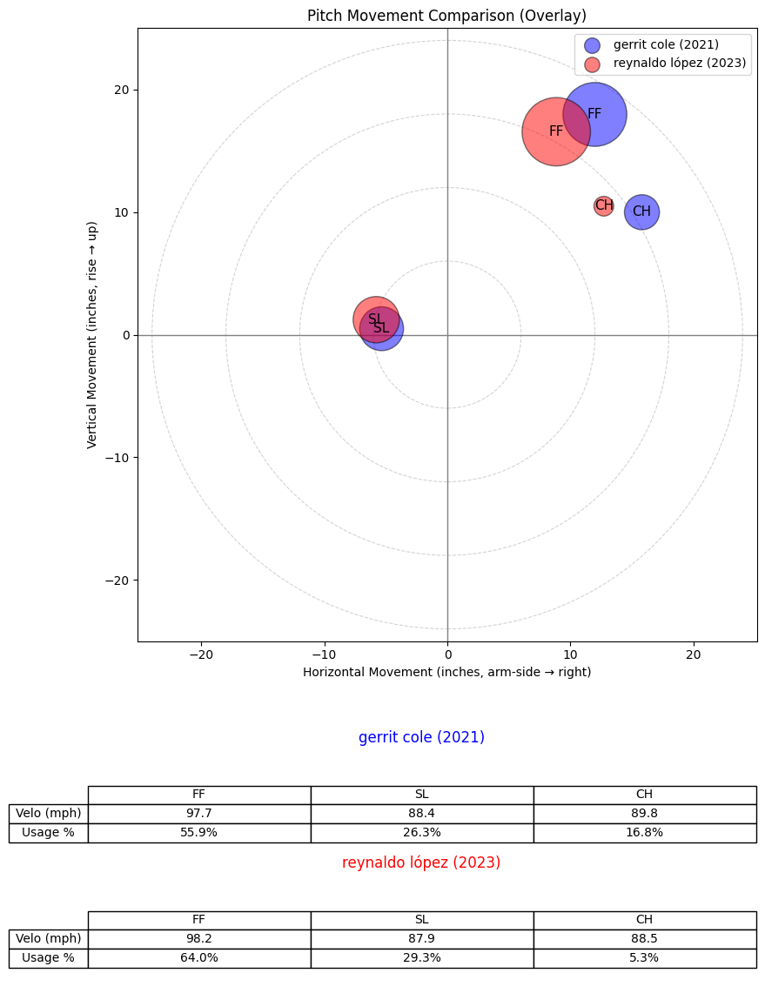

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


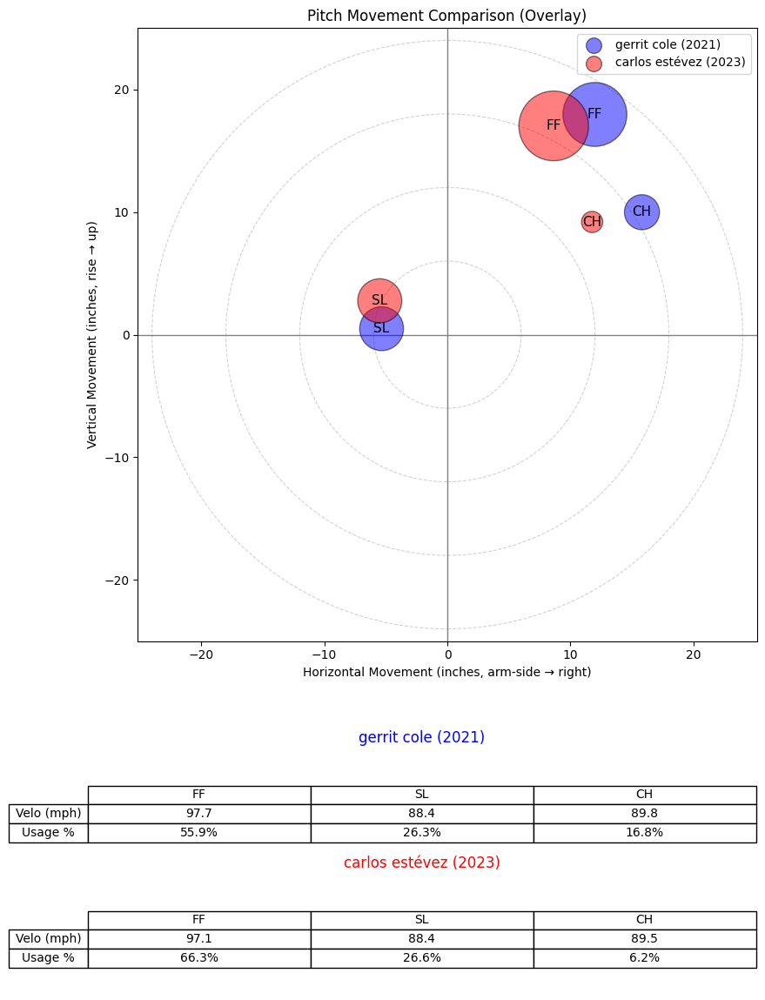

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


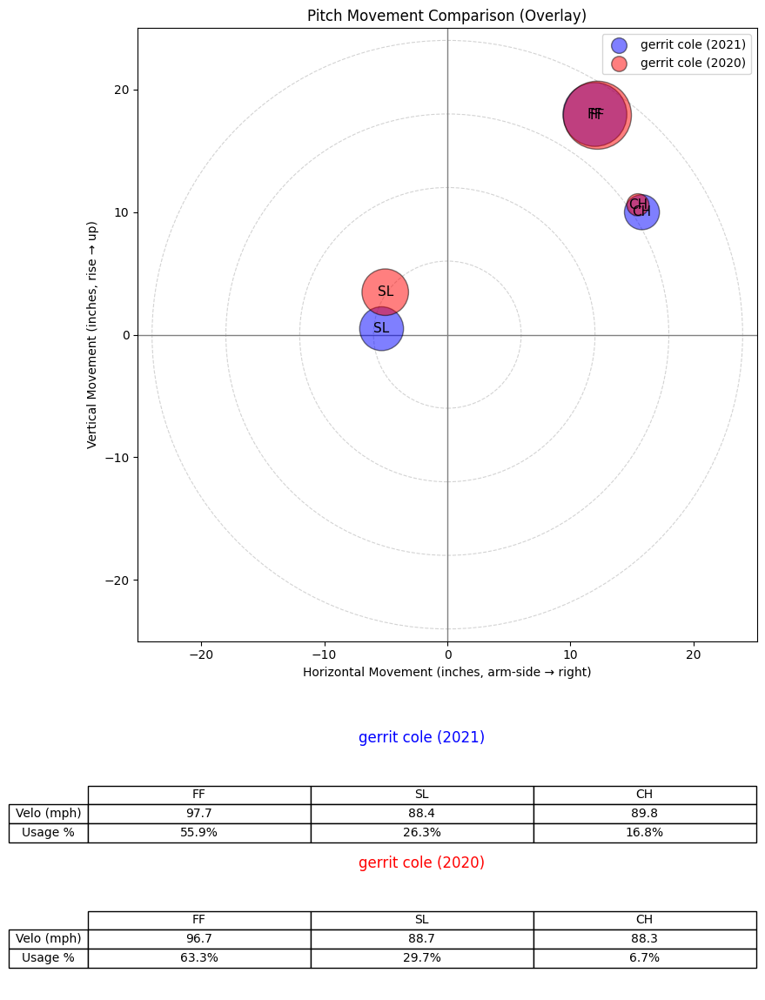

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


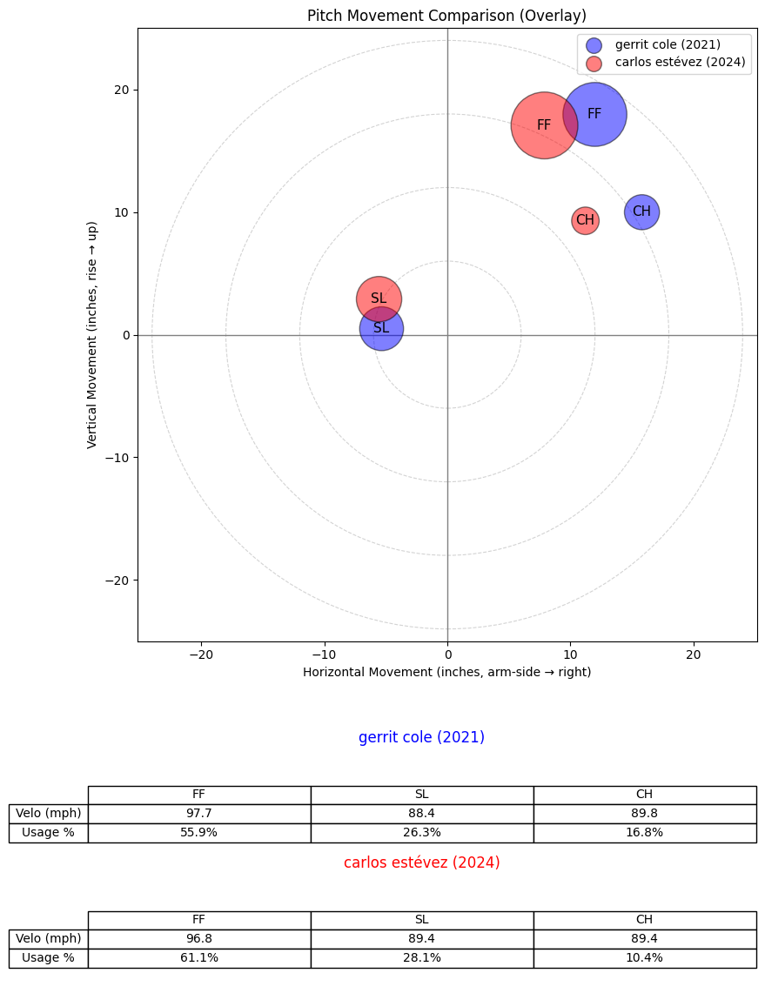

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


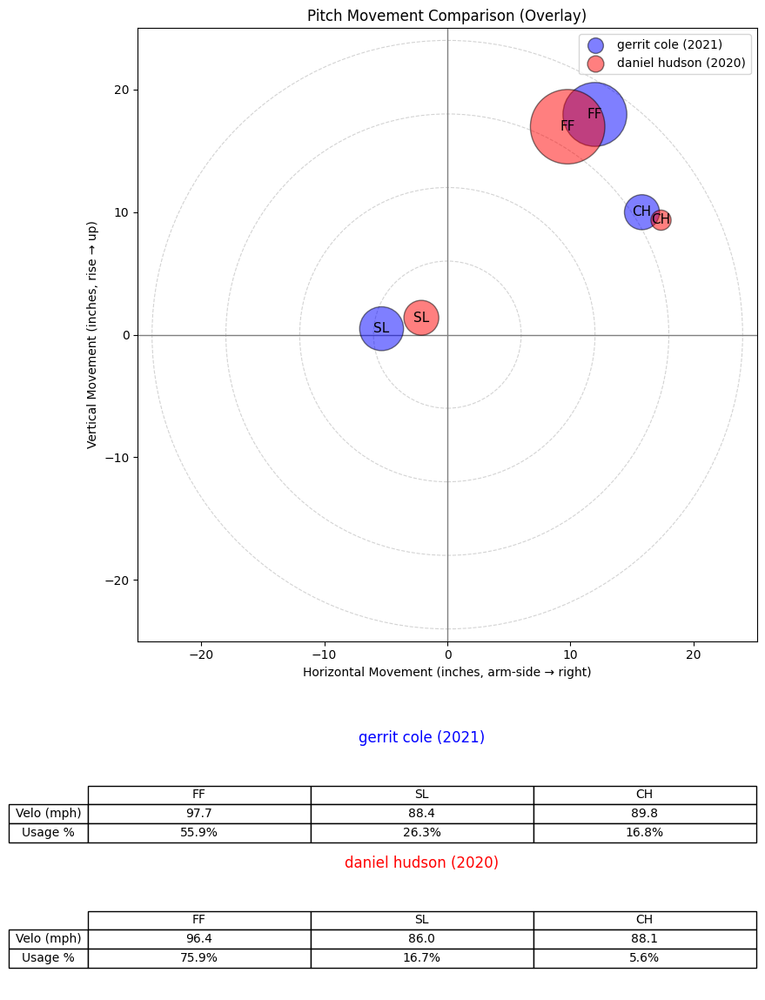

       pitcher  game_year            name name_first name_last  \
1429  625643.0       2023  reynaldo lópez   reynaldo     lópez   
1218  608032.0       2023  carlos estévez     carlos   estévez   
535   543037.0       2020     gerrit cole     gerrit      cole   
1219  608032.0       2024  carlos estévez     carlos   estévez   
577   543339.0       2020   daniel hudson     daniel    hudson   

      cosine_similarity  
1429           0.959693  
1218           0.949557  
535            0.938030  
1219           0.908298  
577            0.904342  


In [213]:
# Testing comparisons for Cole with KNN
movement_long = reshape_pitcher_season_df(pitcher_season_df)

neighbors = find_similar_pitchers_by_name(
    pitcher_name="gerrit cole",
    year=2021,
    X_df=X_scaled_df,
    meta_df=pitcher_season_df,
    n_neighbors=5,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
print(neighbors)


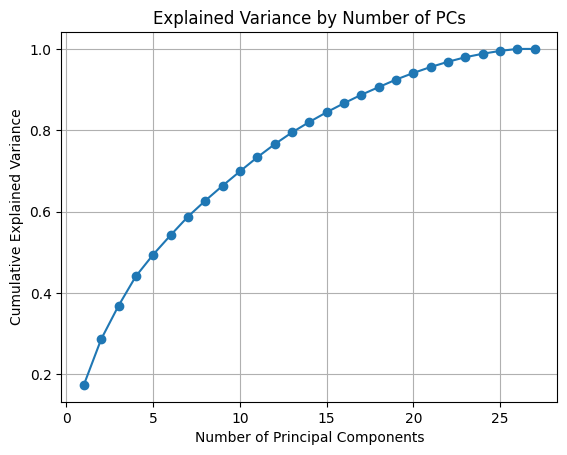

Number of components to explain 90% variance: 18


In [ ]:
# Now use PCA then KNN
# Fit PCA
pca = PCA()
pca.fit(X_scaled_df)

# Explained variance ratio for each component
explained_variance = pca.explained_variance_ratio_

# Cumulative variance explained
cumulative_variance = np.cumsum(explained_variance)

# Plot
plt.plot(range(1, len(cumulative_variance)+1), cumulative_variance, marker='o')
plt.xlabel('Number of Principal Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Explained Variance by Number of PCs')
plt.grid(True)
plt.show()

target_variance = 0.90  # e.g. keep 90% of total variance

n_components = np.argmax(cumulative_variance >= target_variance) + 1

# When I originally did this experiment, n_components was 18
print(f"Number of components to explain {target_variance*100:.0f}% variance: {n_components}")

In [215]:
pca = PCA(n_components=n_components)
X_pca = pca.fit_transform(X_scaled_df)

# Turn into a df with identical index
X_pca_df = pd.DataFrame(
    X_pca,
    index=X_scaled_df.index,
    columns=[f"PC{i+1}" for i in range(X_pca.shape[1])]
)

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


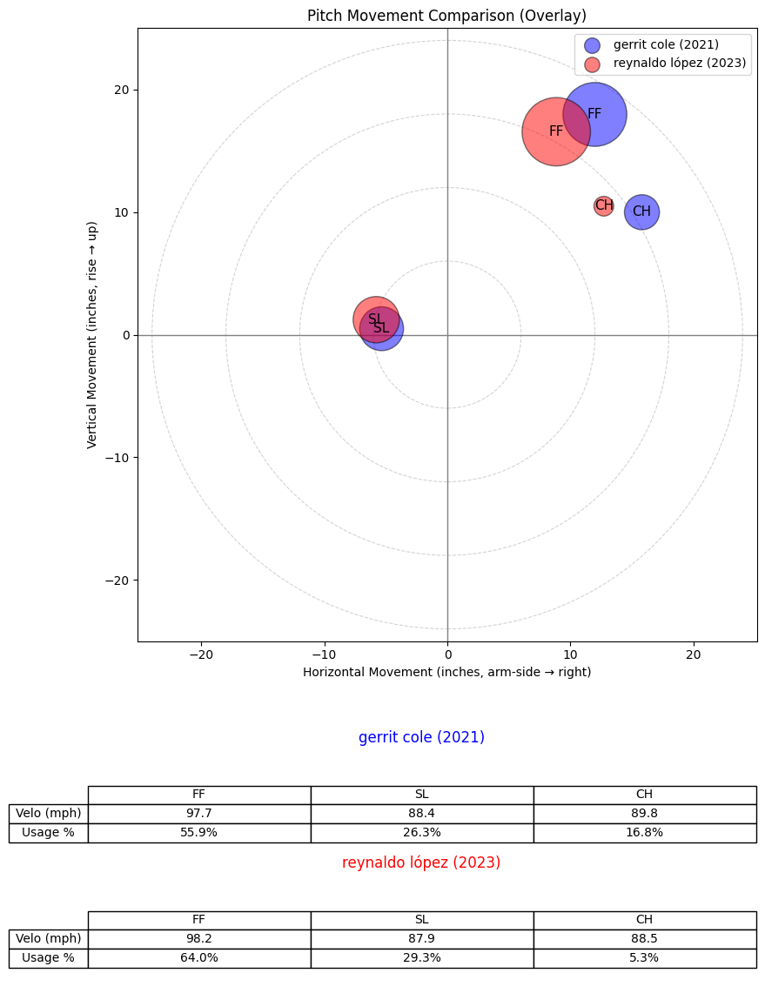

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


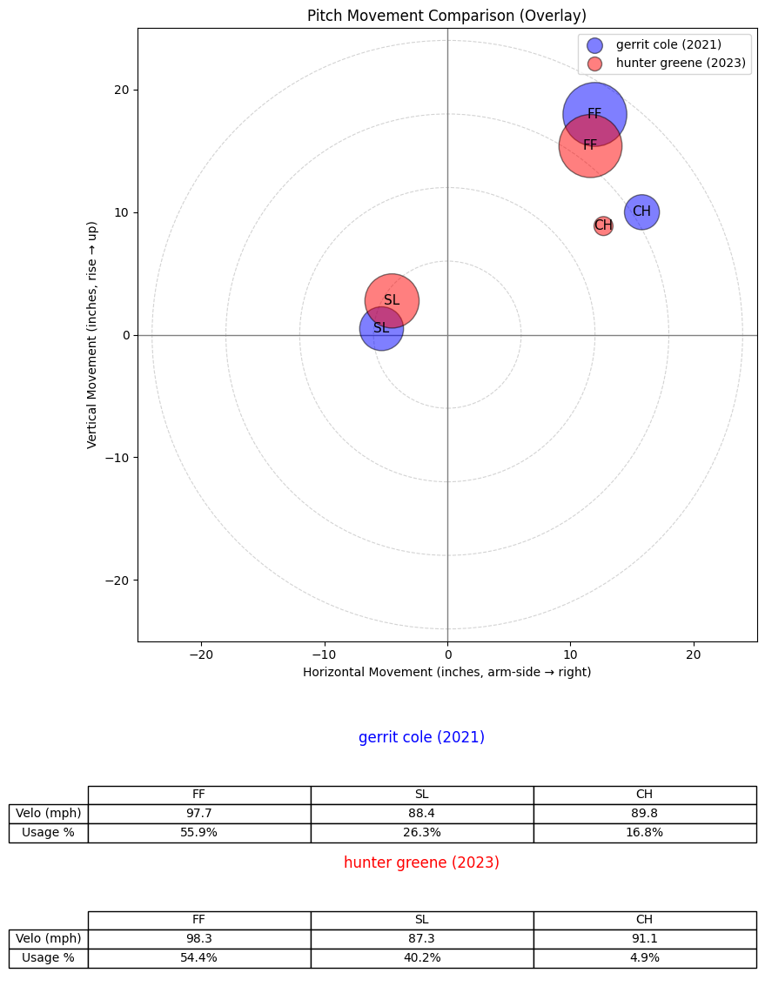

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


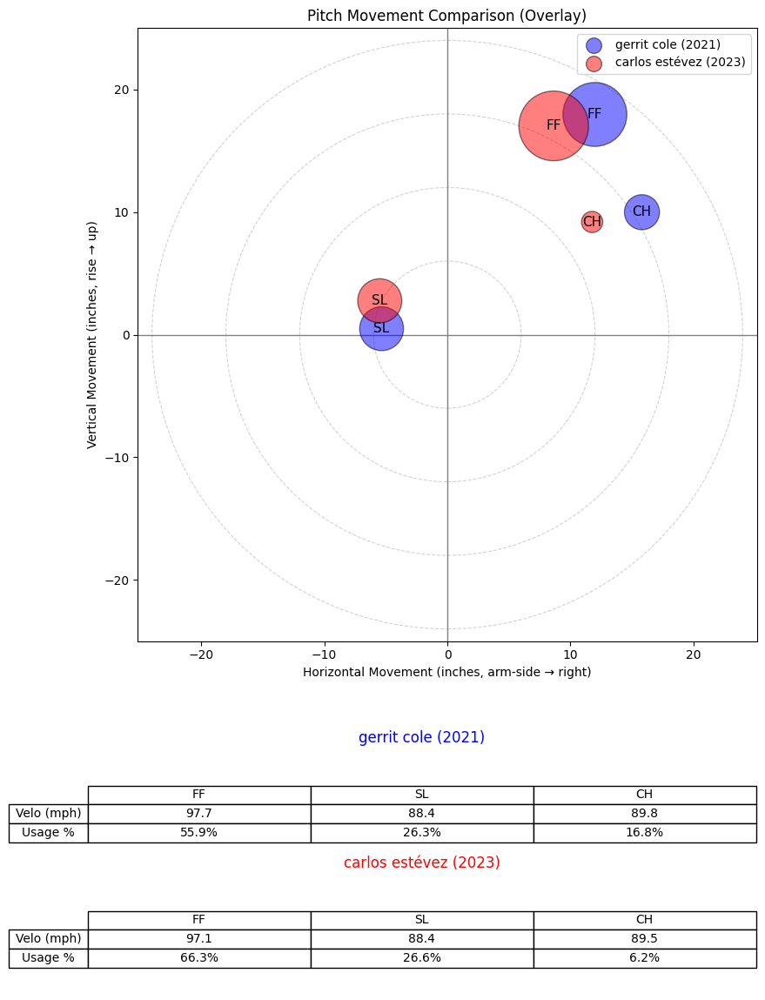

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


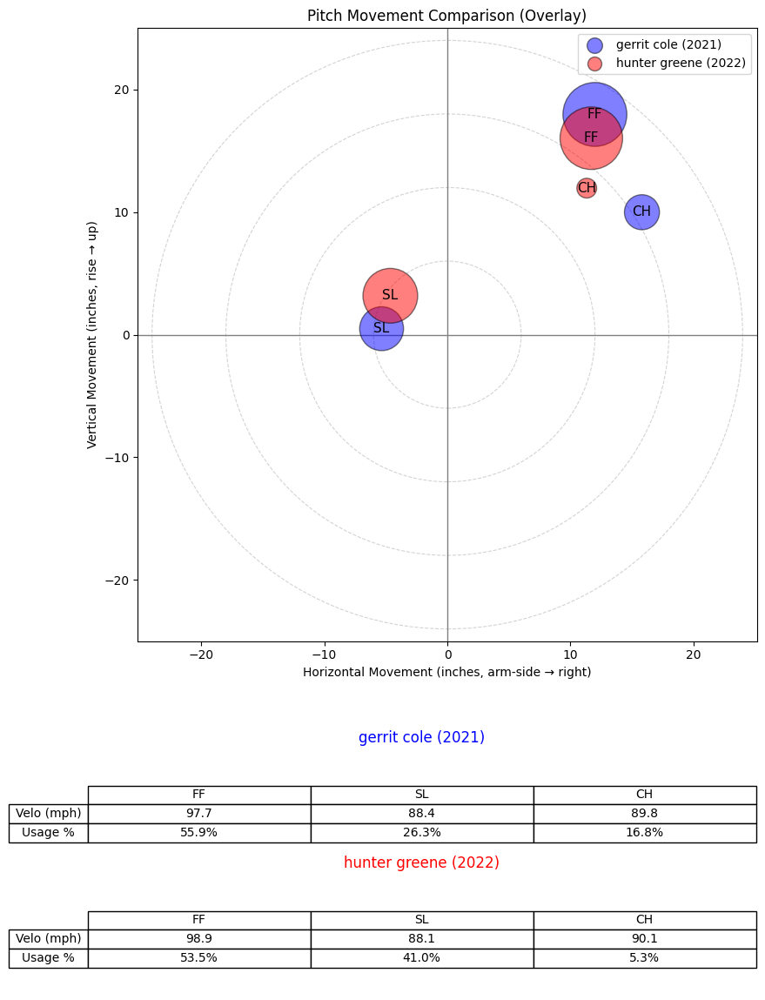

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


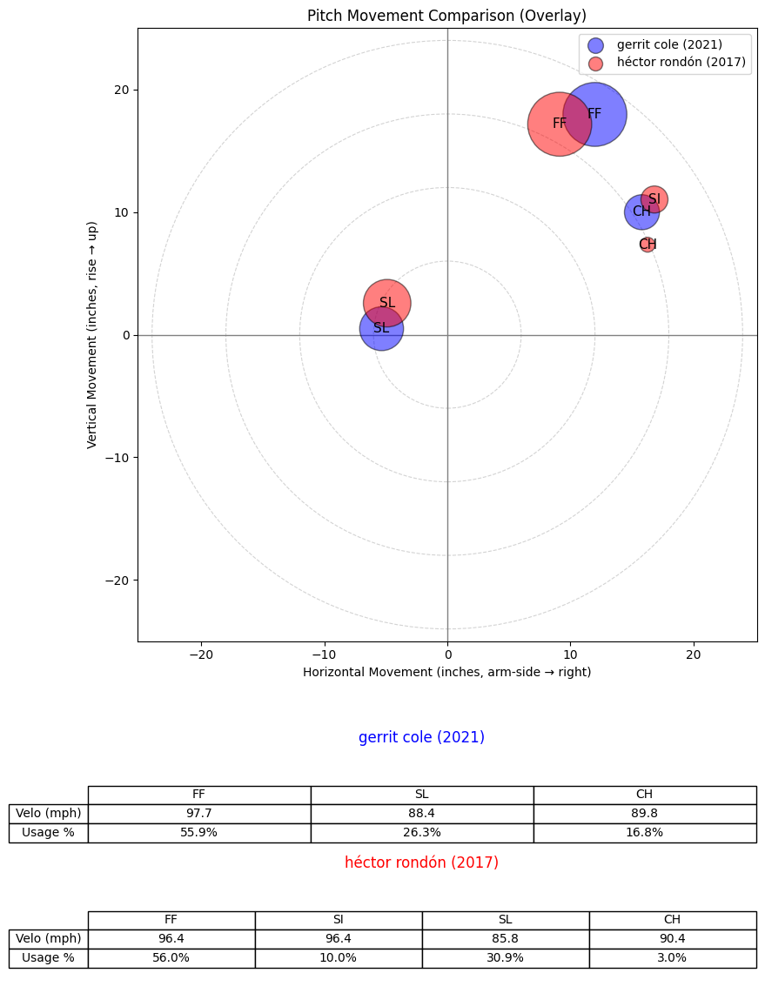

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


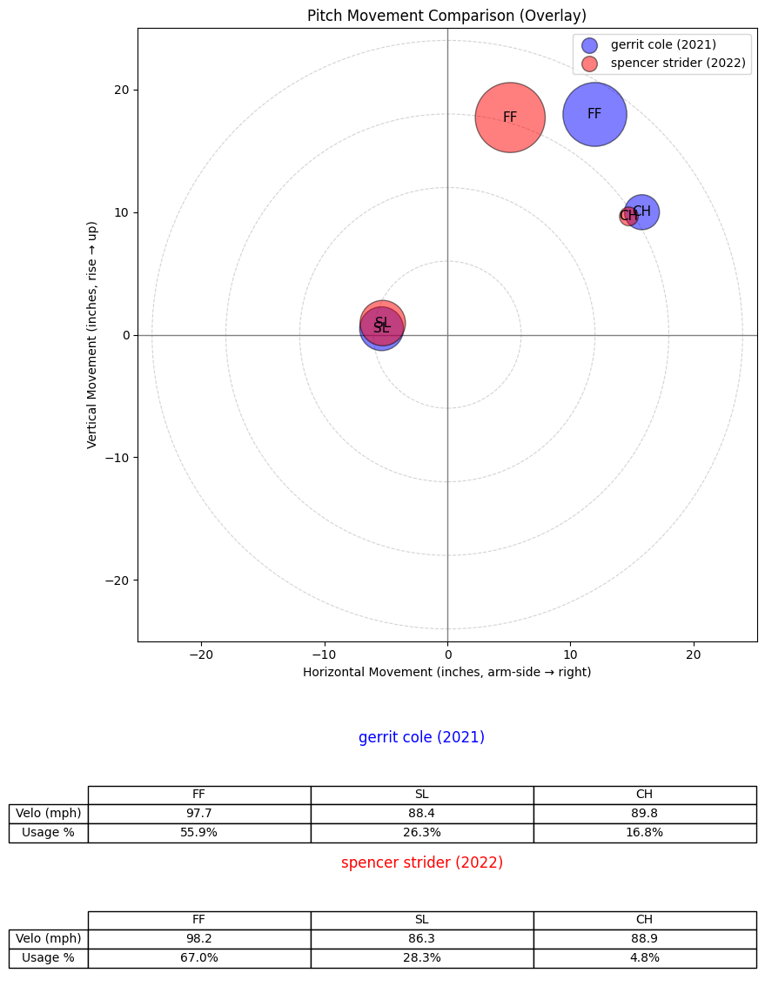

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


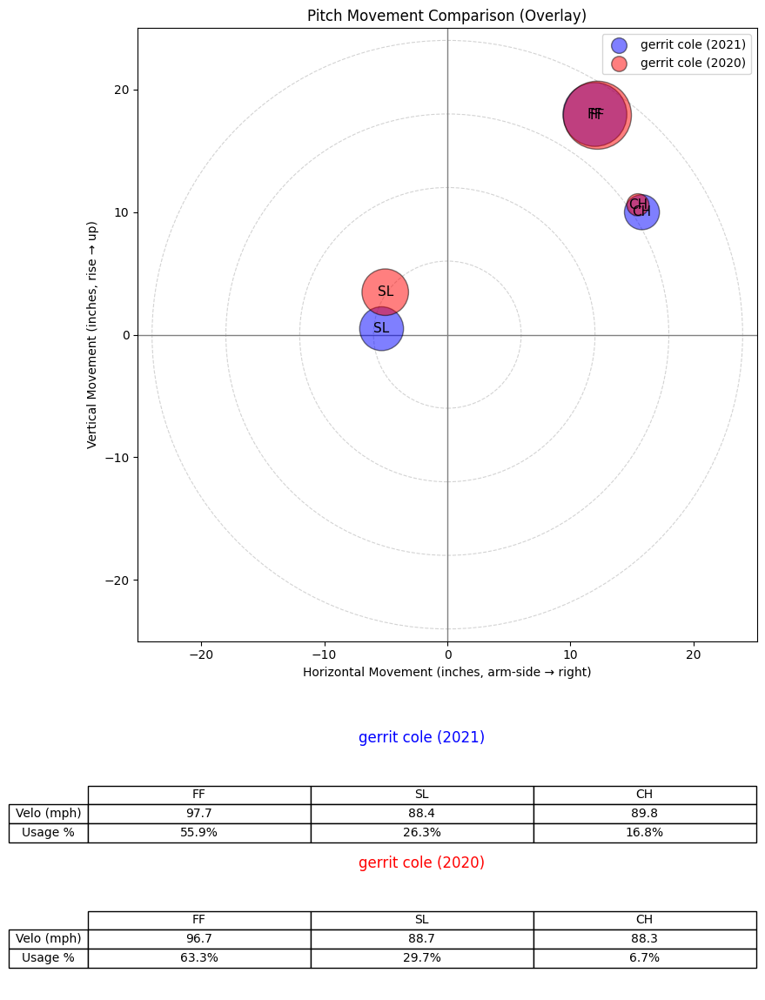

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


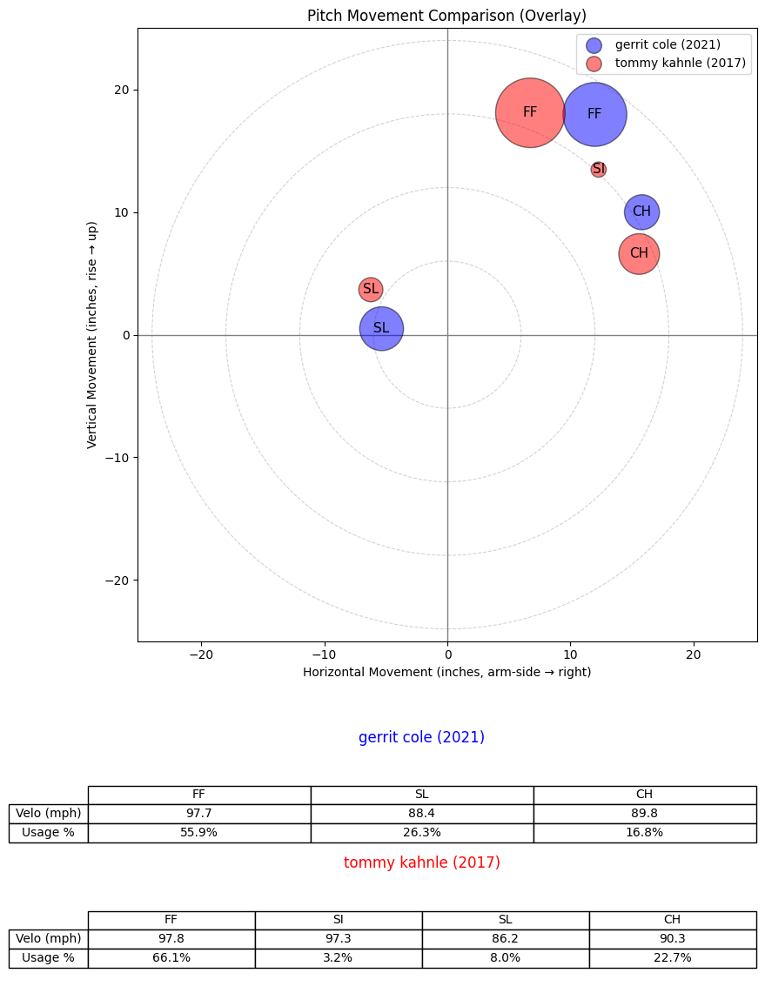

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


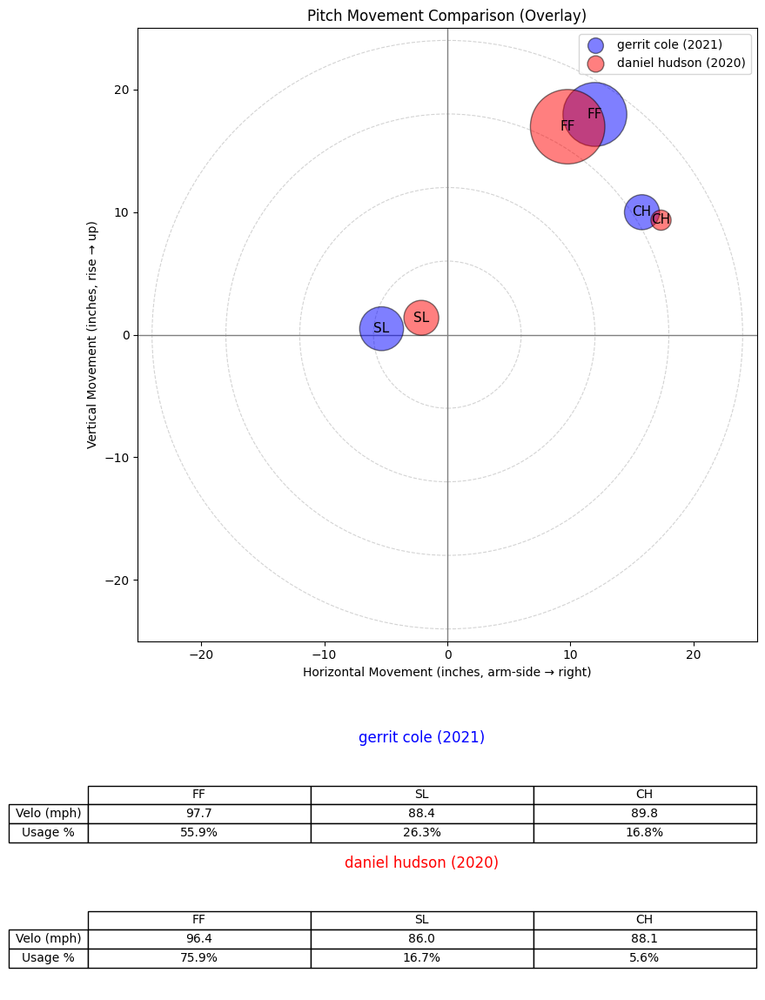

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


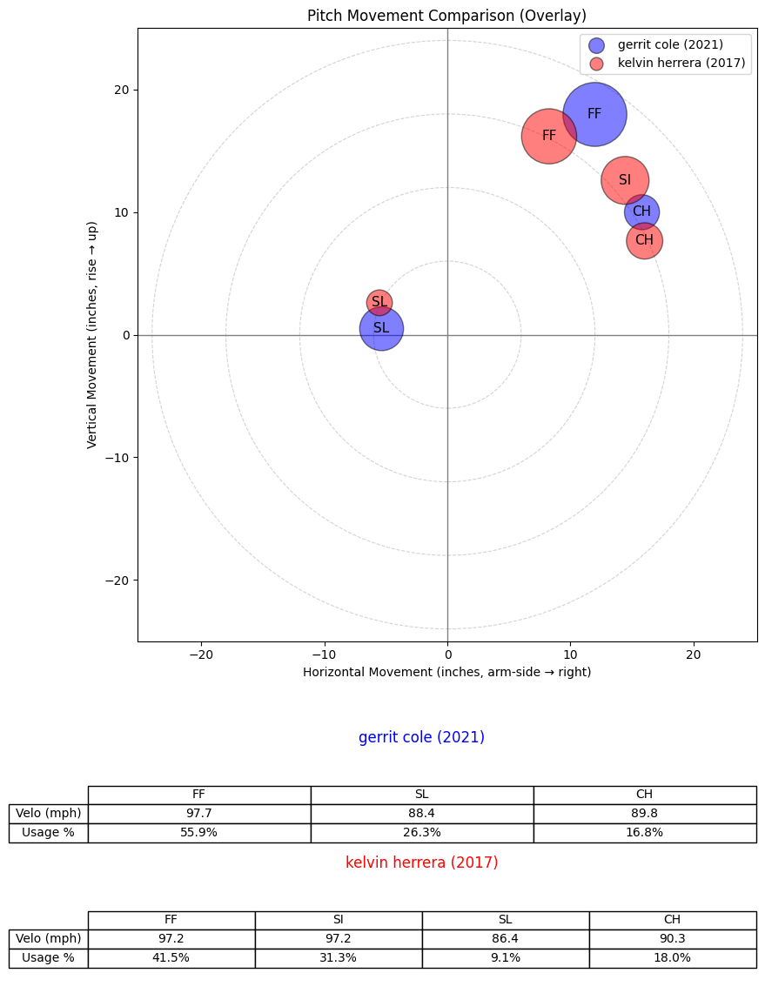

       pitcher  game_year             name name_first name_last  \
1429  625643.0       2023   reynaldo lópez   reynaldo     lópez   
1926  668881.0       2023    hunter greene     hunter    greene   
1218  608032.0       2023   carlos estévez     carlos   estévez   
1925  668881.0       2022    hunter greene     hunter    greene   
51    444468.0       2017    héctor rondón     héctor    rondón   
2024  675911.0       2022  spencer strider    spencer   strider   
535   543037.0       2020      gerrit cole     gerrit      cole   
859   592454.0       2017     tommy kahnle      tommy    kahnle   
577   543339.0       2020    daniel hudson     daniel    hudson   
376   516969.0       2017   kelvin herrera     kelvin   herrera   

      cosine_similarity  
1429           0.976413  
1926           0.940836  
1218           0.939999  
1925           0.938147  
51             0.932917  
2024           0.929988  
535            0.924633  
859            0.920399  
577            0.915680  
37

In [216]:
# Now reuse the exact same function, just change to X_pca_df to test PCA+KNN
neighbors = find_similar_pitchers_by_name(
    pitcher_name="gerrit cole",
    year=2021,
    X_df=X_pca_df,
    meta_df=pitcher_season_df,
    n_neighbors=10,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
print(neighbors)

In [217]:
# Used ChatGPT to change function to only look for pitchers of same handedness and role
def find_similar_pitchers_by_name_same_hand_role(
    pitcher_name: str,
    year: int,
    X_df: pd.DataFrame,
    meta_df: pd.DataFrame,
    n_neighbors: int = 10,
    overlay_df: pd.DataFrame | None = None,
    plot_overlays: bool = False,
    overlay_kwargs: dict | None = None,
):
    """
    Same as find_similar_pitchers_by_name, but restricts neighbors to
    the same handedness (p_throws) and role ('starter'/'reliever') as
    the input pitcher.
    """

    # 1. Find the row index for this pitcher-season
    name_lower = meta_df['name'].str.lower()
    mask = (name_lower == pitcher_name.lower()) & (meta_df['game_year'] == year)
    idx = meta_df.index[mask]

    if len(idx) == 0:
        raise ValueError(f"No row found for name='{pitcher_name}', year={year}")
    if len(idx) > 1:
        raise ValueError(f"Multiple rows found for name='{pitcher_name}', year={year}")

    target_idx = idx[0]

    # canonical info for this pitcher-season
    base_name = meta_df.loc[target_idx, "name"]
    base_year = meta_df.loc[target_idx, "game_year"]
    base_hand = meta_df.loc[target_idx, "p_throws"]    # "R" / "L"
    base_role = meta_df.loc[target_idx, "role"]        # "starter" / "reliever"

    # 2. Cosine similarity to everyone
    sims = cosine_similarity(X_df.loc[[target_idx]], X_df)[0]
    sims_series = pd.Series(sims, index=X_df.index)

    # 3. Restrict to same hand + same role, and drop self
    same_group_mask = (
        (meta_df['p_throws'] == base_hand) &
        (meta_df['role'] == base_role) &
        (meta_df.index != target_idx)
    )
    sims_series = sims_series[same_group_mask]

    # 4. Take top-k
    top_idx = sims_series.nlargest(n_neighbors).index
    top_sims = sims_series.loc[top_idx]

    # 5. Attach metadata
    result = meta_df.loc[top_idx, ['pitcher', 'game_year', 'name',
                                   'name_first', 'name_last',
                                   'p_throws', 'role']].copy()
    result['cosine_similarity'] = top_sims.values
    result = result.sort_values('cosine_similarity', ascending=False)

    # 6. Optional overlays
    if plot_overlays and overlay_df is not None:
        if overlay_kwargs is None:
            overlay_kwargs = {}
        for _, row in result.iterrows():
            compare_pitchers_overlay(
                df=overlay_df,
                nameA=base_name,
                yearA=base_year,
                nameB=row["name"],
                yearB=row["game_year"],
                **overlay_kwargs
            )

    return result


/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


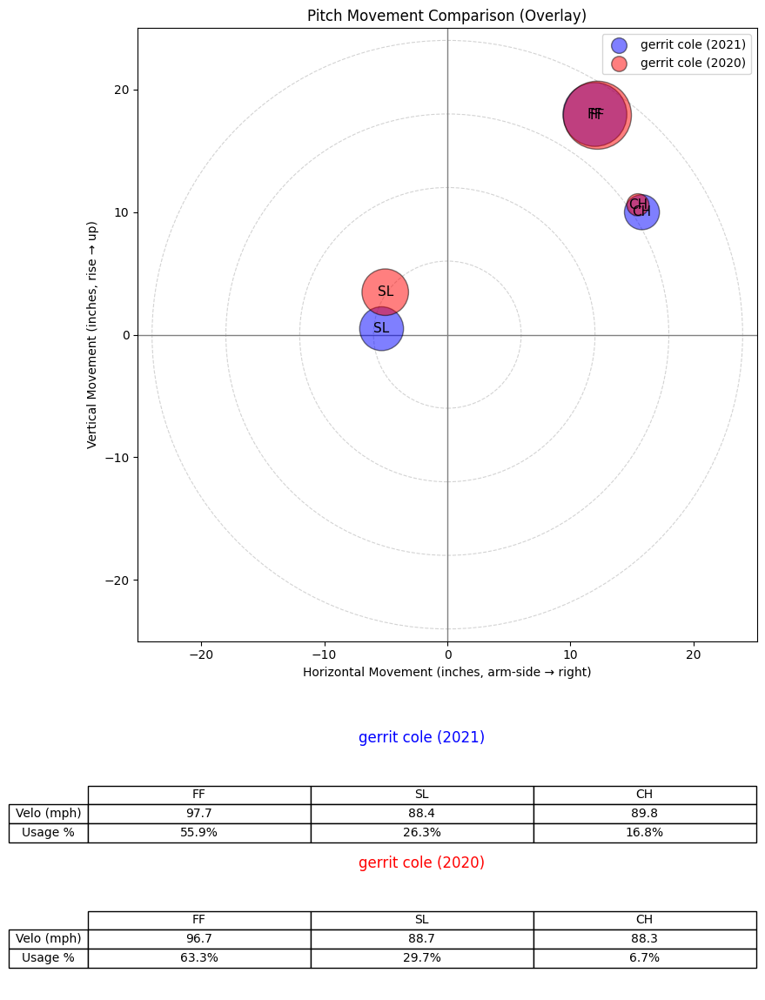

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


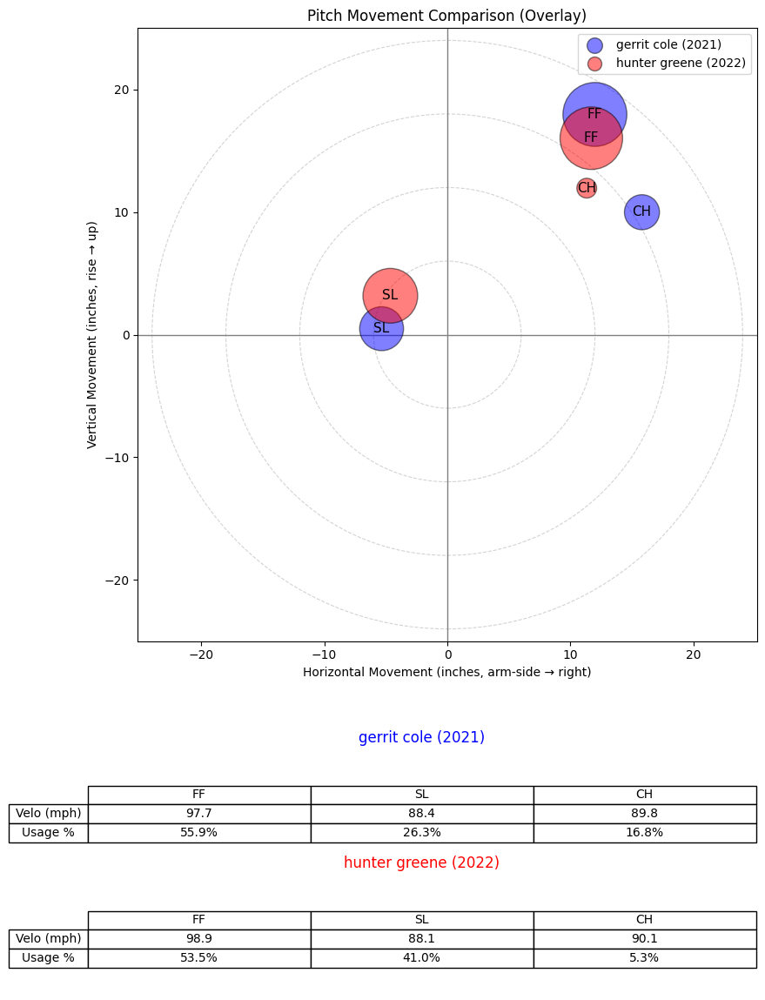

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


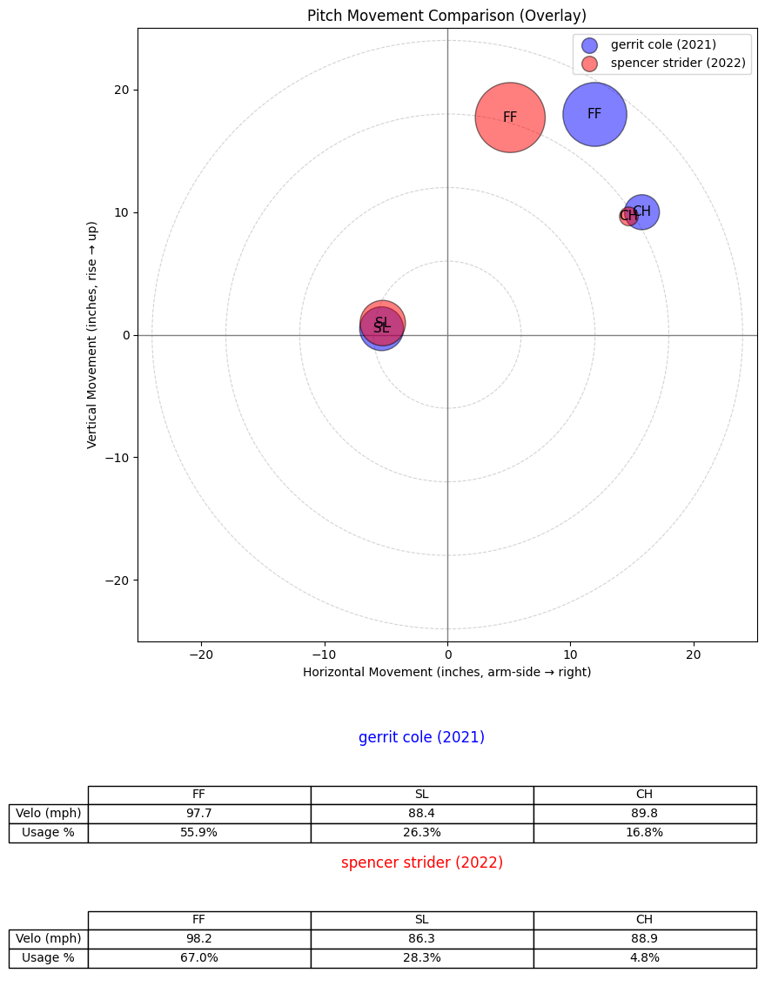

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


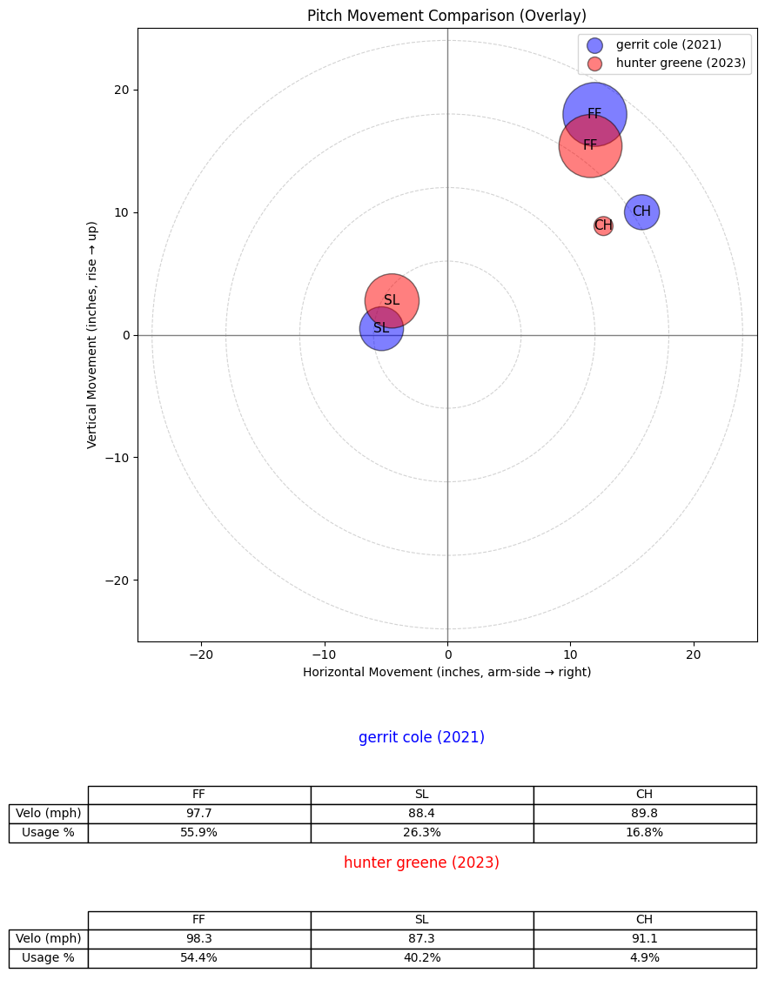

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


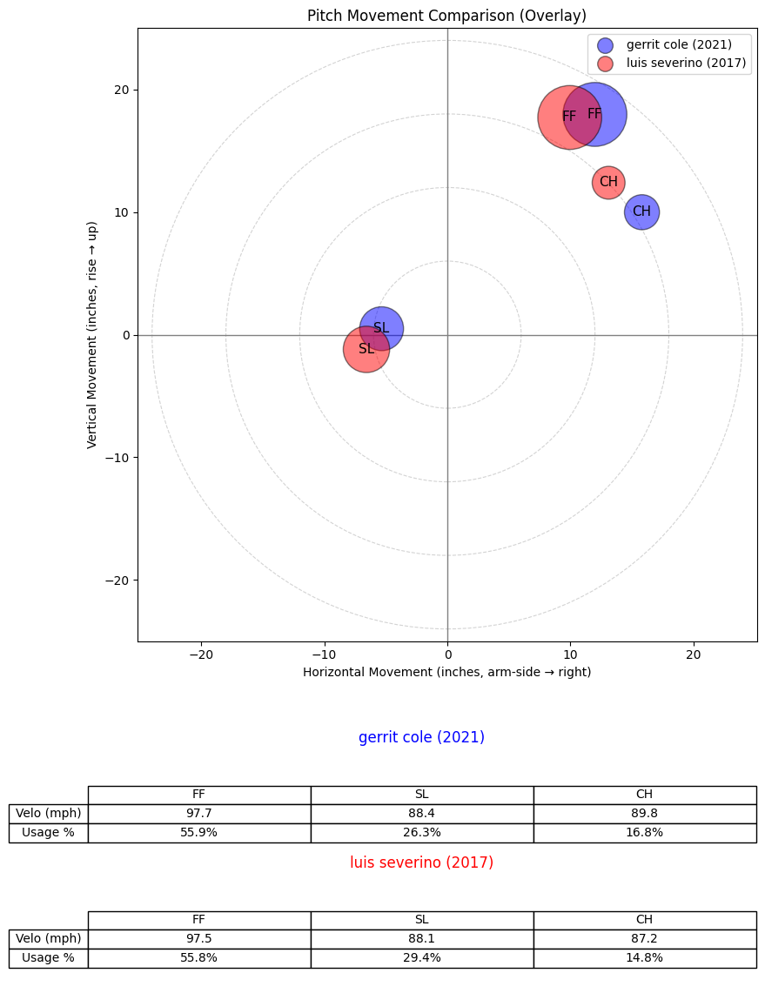

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


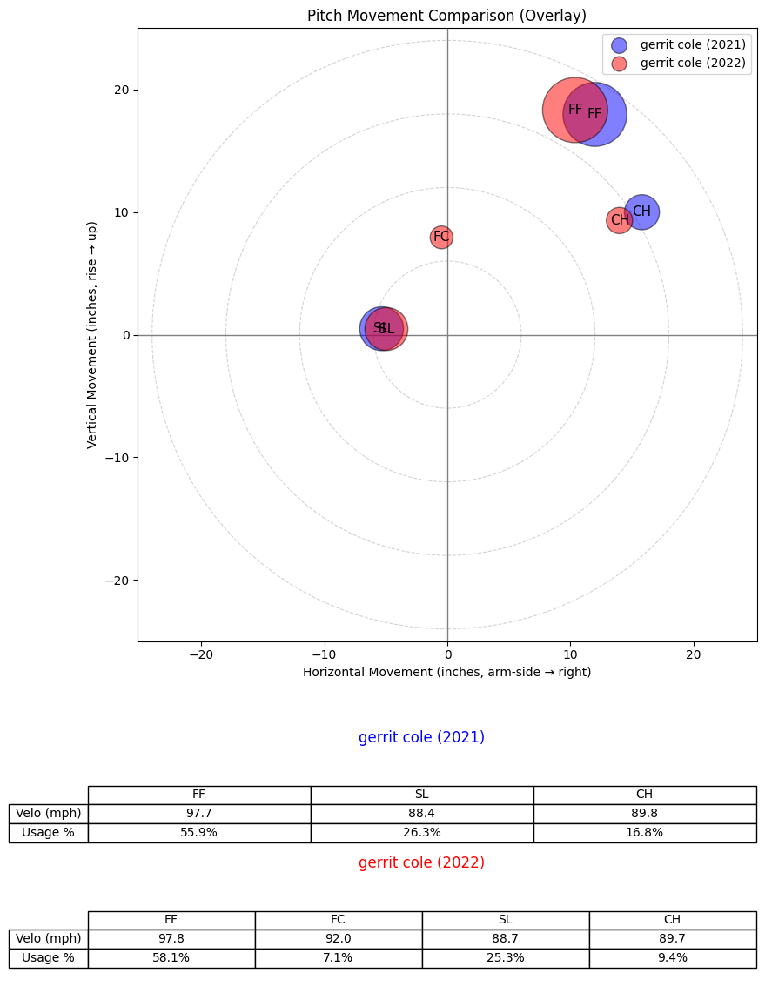

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


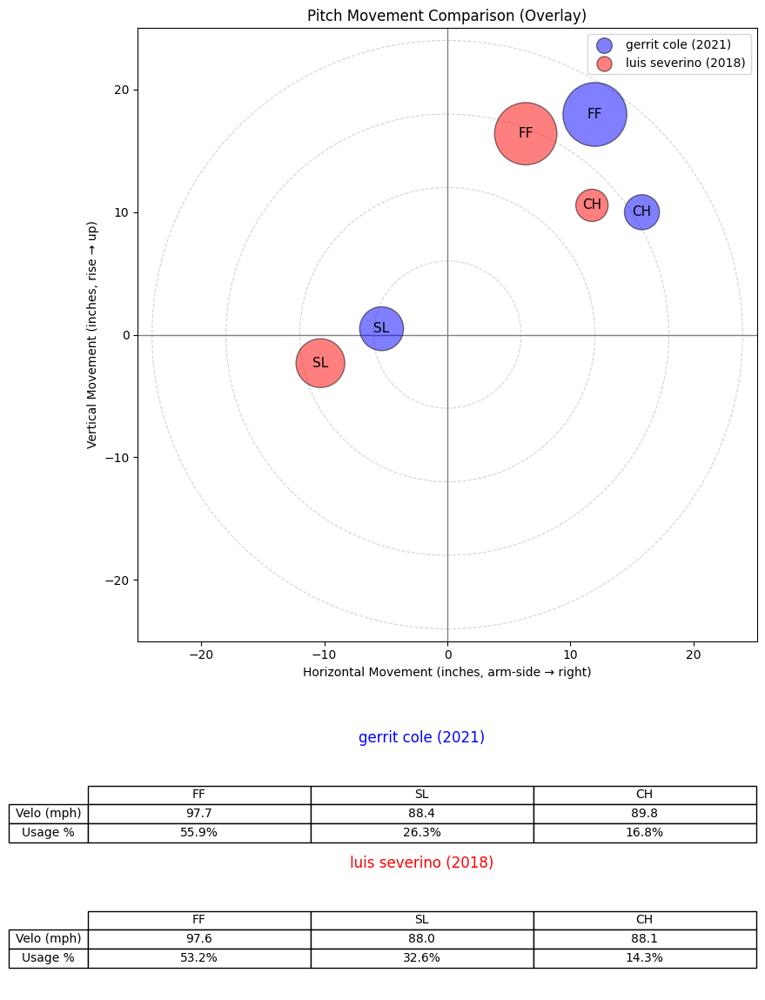

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


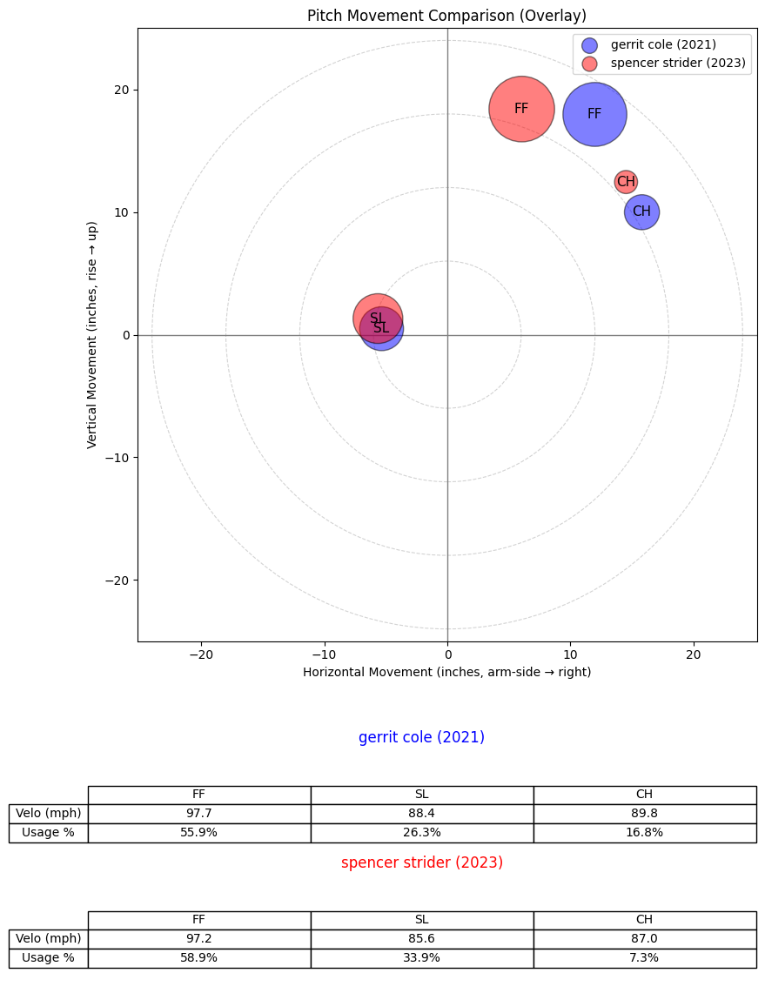

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


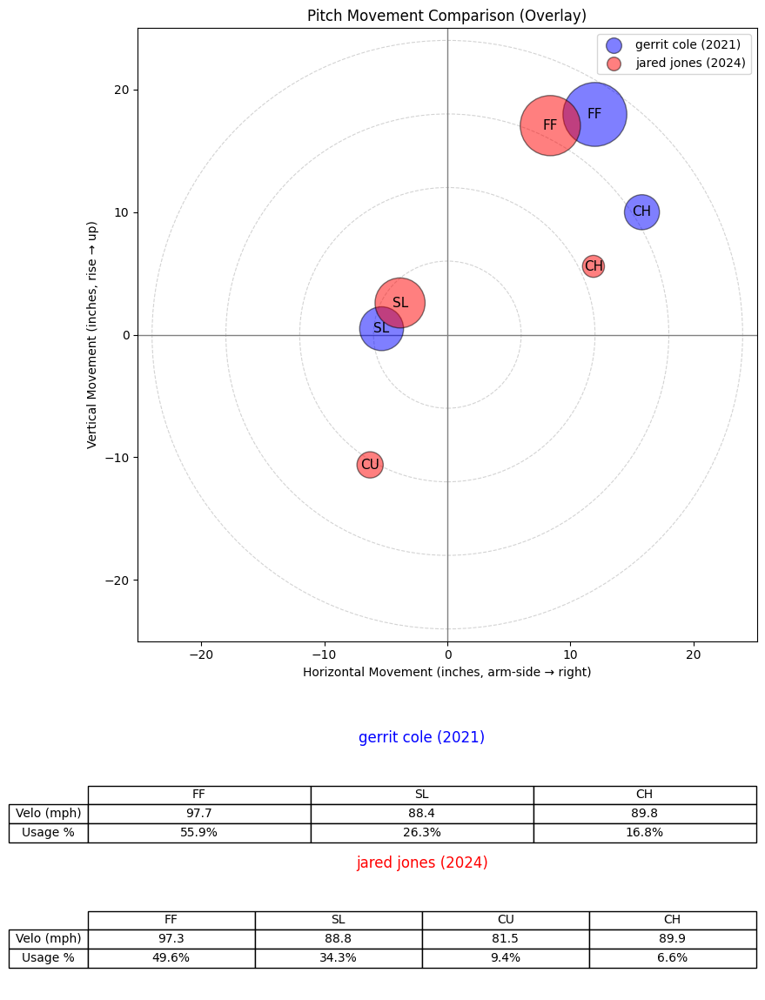

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


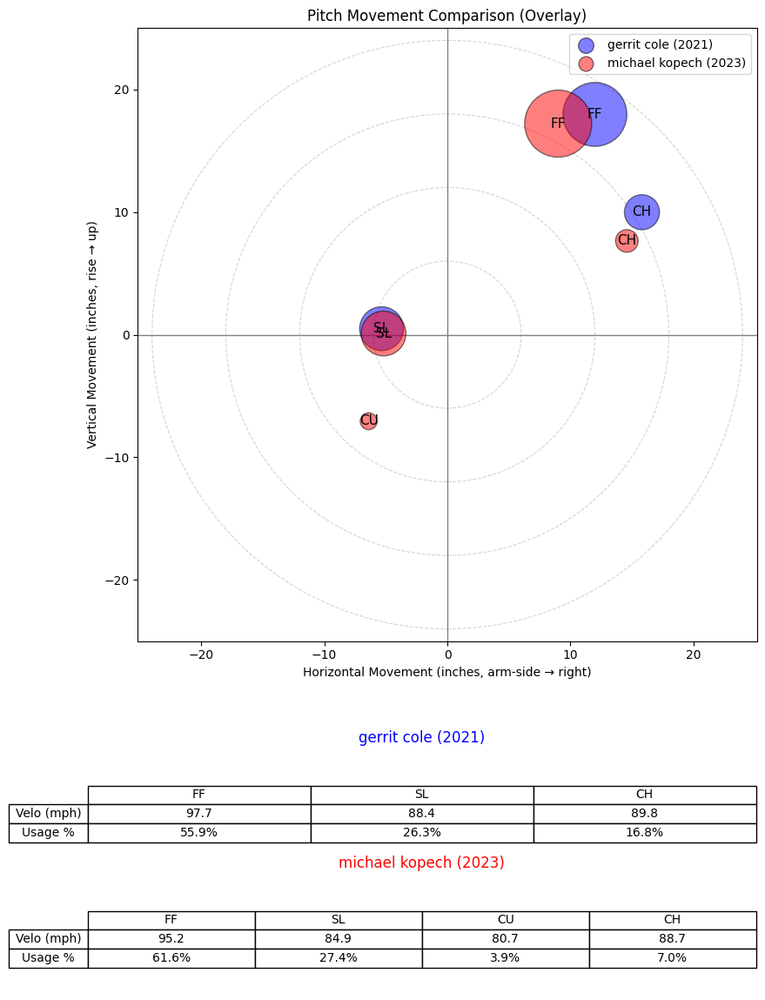

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
535,543037.0,2020,gerrit cole,gerrit,cole,R,starter,0.938030
1925,668881.0,2022,hunter greene,hunter,greene,R,starter,0.904077
2024,675911.0,2022,spencer strider,spencer,strider,R,starter,0.894468
1926,668881.0,2023,hunter greene,hunter,greene,R,starter,0.883887
1388,622663.0,2017,luis severino,luis,severino,R,starter,0.869186
537,543037.0,2022,gerrit cole,gerrit,cole,R,starter,0.838062
1389,622663.0,2018,luis severino,luis,severino,R,starter,0.801776
2025,675911.0,2023,spencer strider,spencer,strider,R,starter,0.787881
2083,683003.0,2024,jared jones,jared,jones,R,starter,0.785746
1696,656629.0,2023,michael kopech,michael,kopech,R,starter,0.727413


In [218]:
# Testing KNN while filtering for handedness+role
neighbors_same = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="gerrit cole",
    year=2021,
    X_df=X_scaled_df,
    meta_df=pitcher_season_df,
    n_neighbors=10,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same)


/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


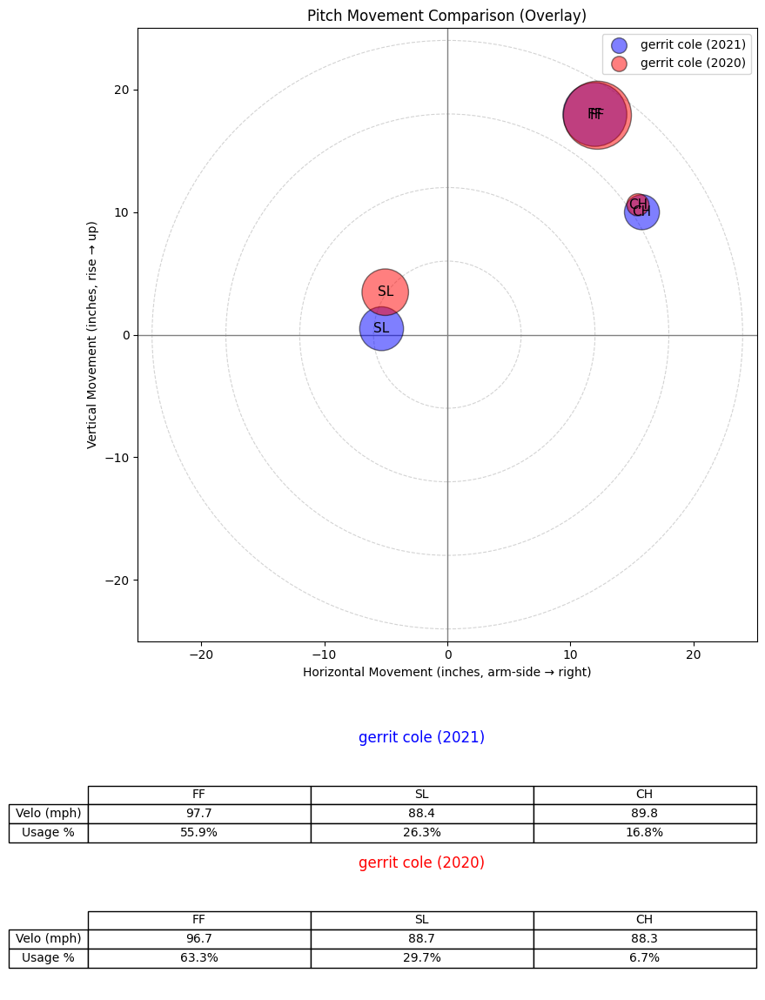

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


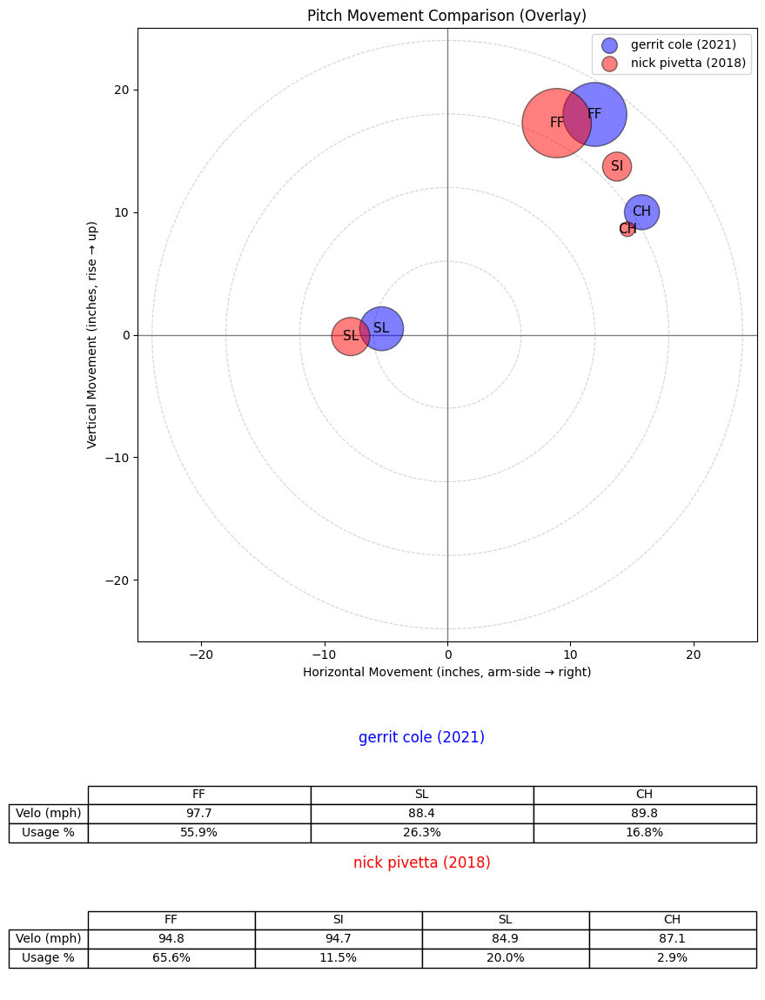

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


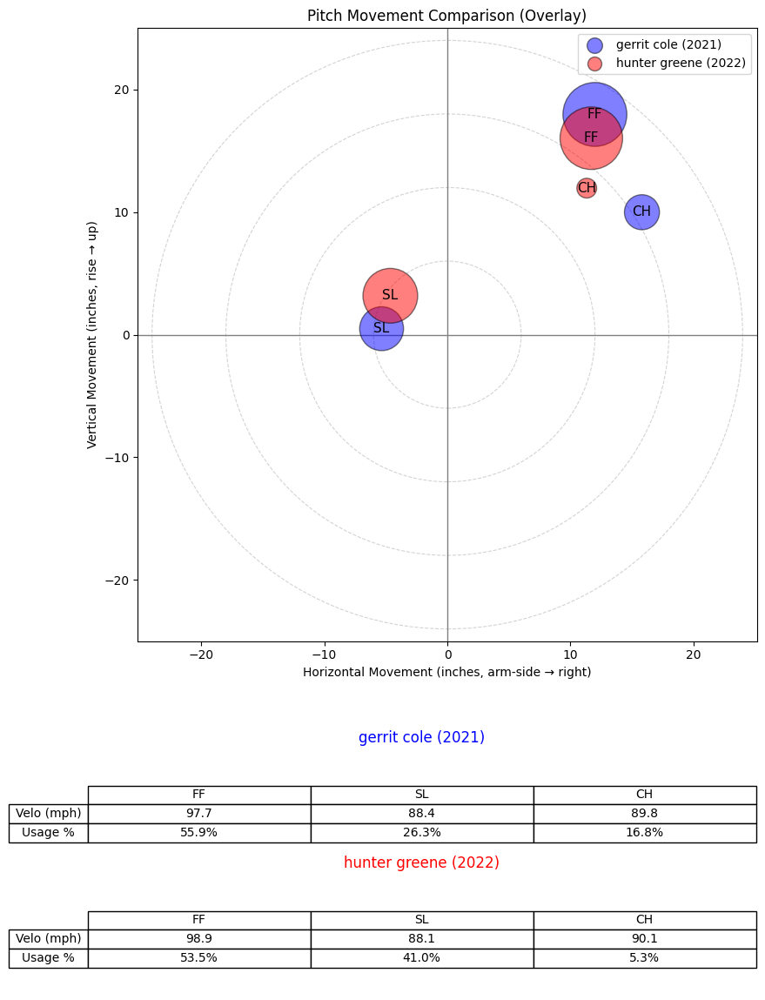

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


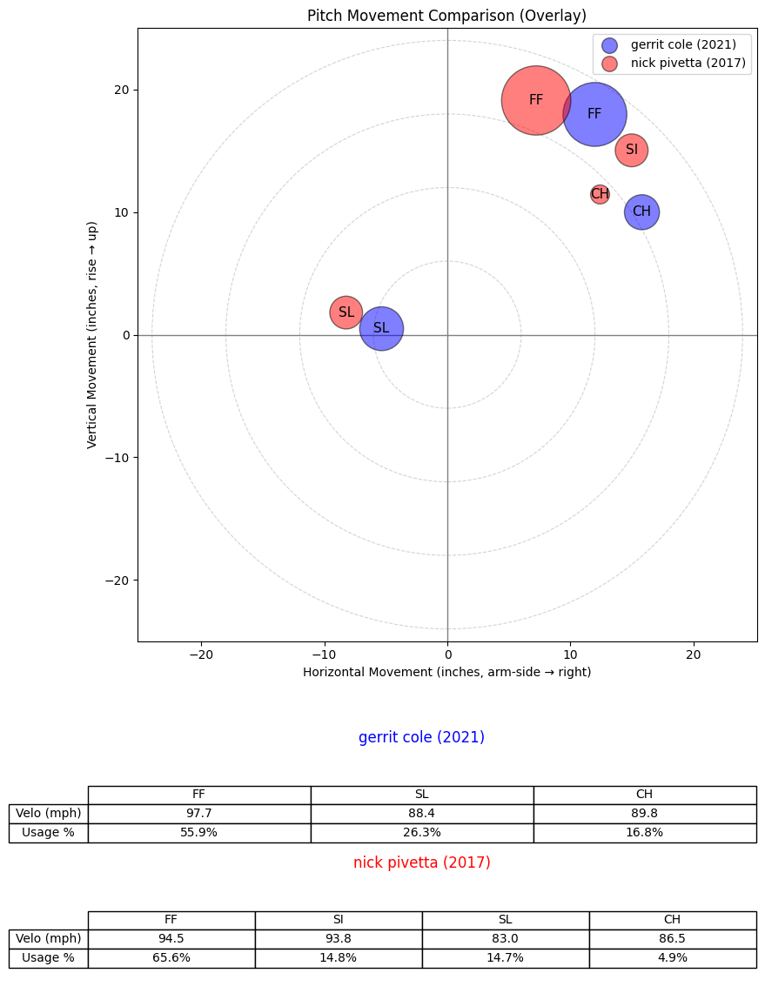

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


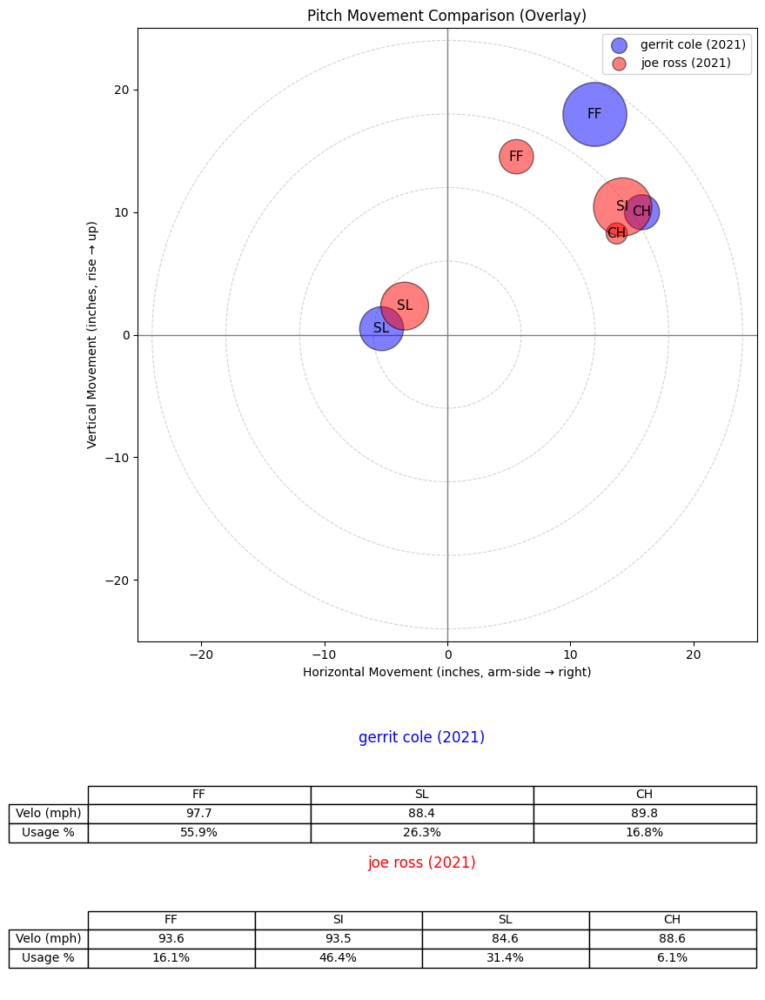

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


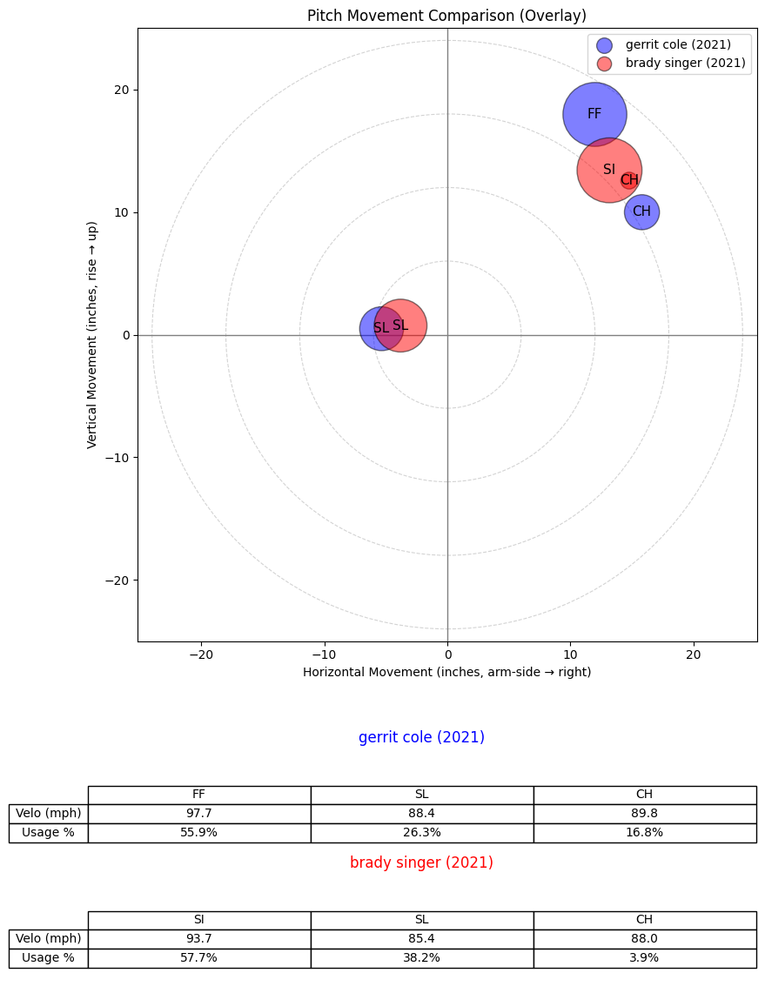

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


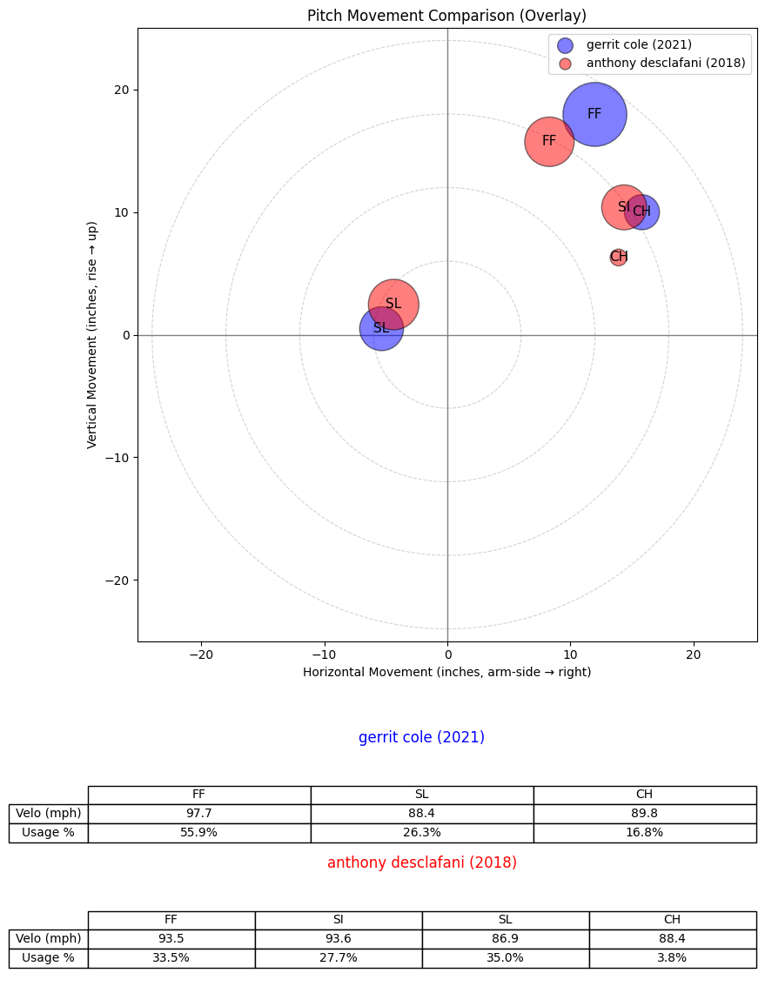

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


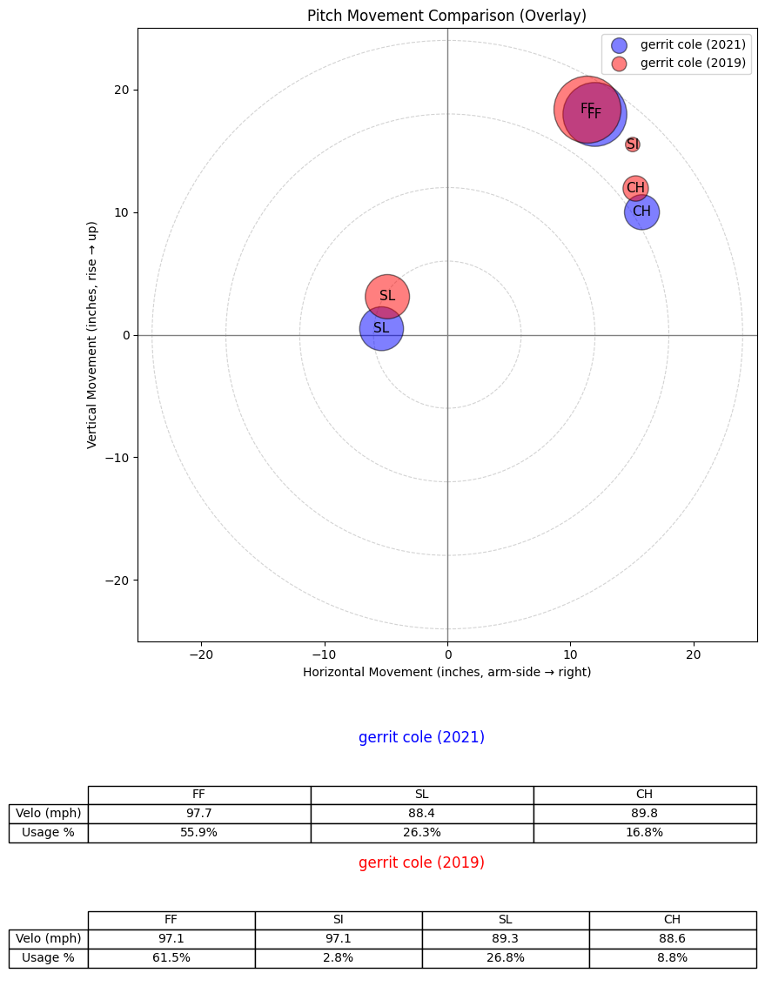

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


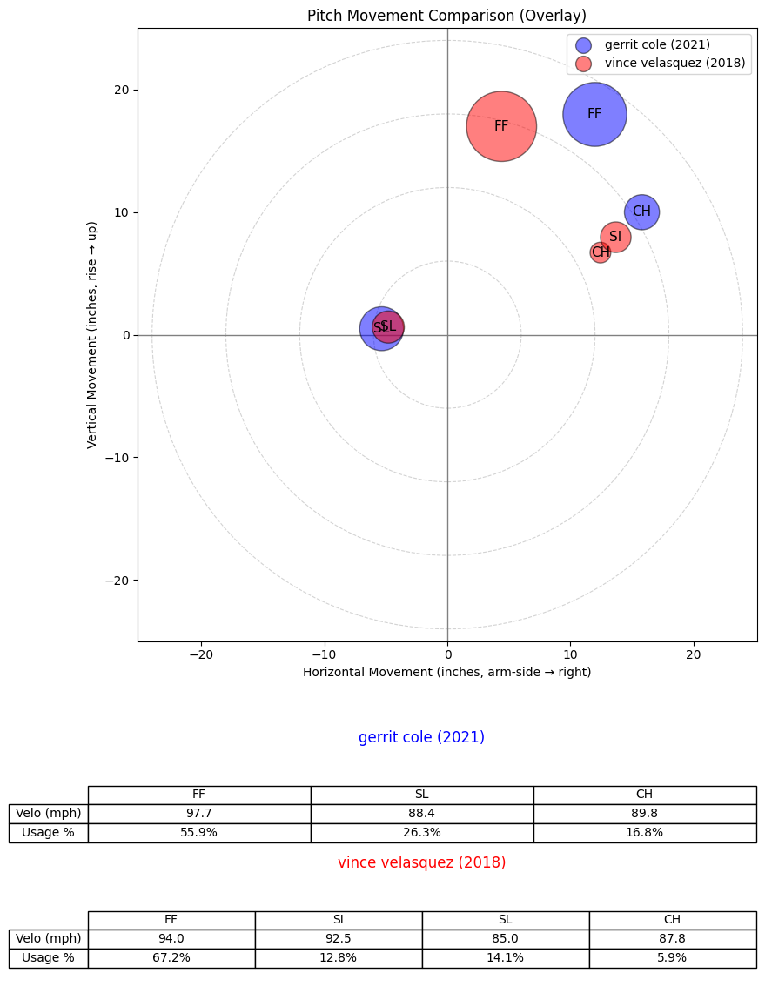

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


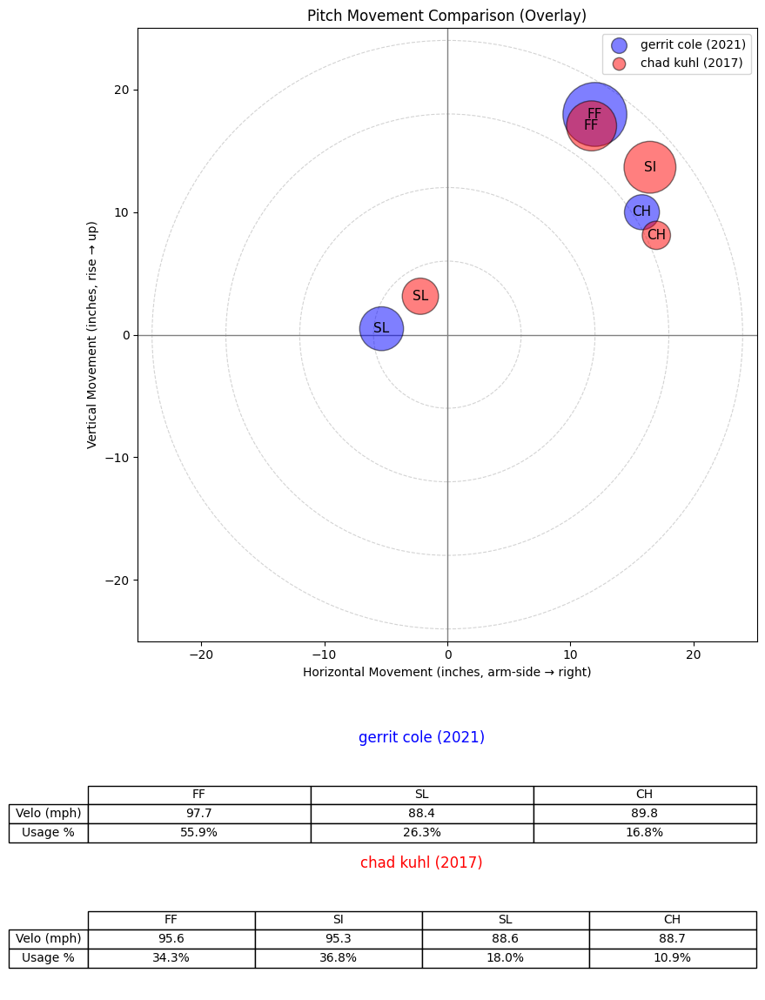

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
535,543037.0,2020,gerrit cole,gerrit,cole,R,starter,0.965467
1022,601713.0,2018,nick pivetta,nick,pivetta,R,starter,0.959374
1925,668881.0,2022,hunter greene,hunter,greene,R,starter,0.956913
1021,601713.0,2017,nick pivetta,nick,pivetta,R,starter,0.947983
1113,605452.0,2021,joe ross,joe,ross,R,starter,0.945473
1825,663903.0,2021,brady singer,brady,singer,R,starter,0.944855
540,543101.0,2018,anthony desclafani,anthony,desclafani,R,starter,0.937665
534,543037.0,2019,gerrit cole,gerrit,cole,R,starter,0.935590
900,592826.0,2018,vince velasquez,vince,velasquez,R,starter,0.932588
1515,641771.0,2017,chad kuhl,chad,kuhl,R,starter,0.925312


In [130]:
# Now checking PCA + KNN
neighbors_same = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="gerrit cole",
    year=2021,
    X_df=X_pca_df,
    meta_df=pitcher_season_df,
    n_neighbors=10,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same)


/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


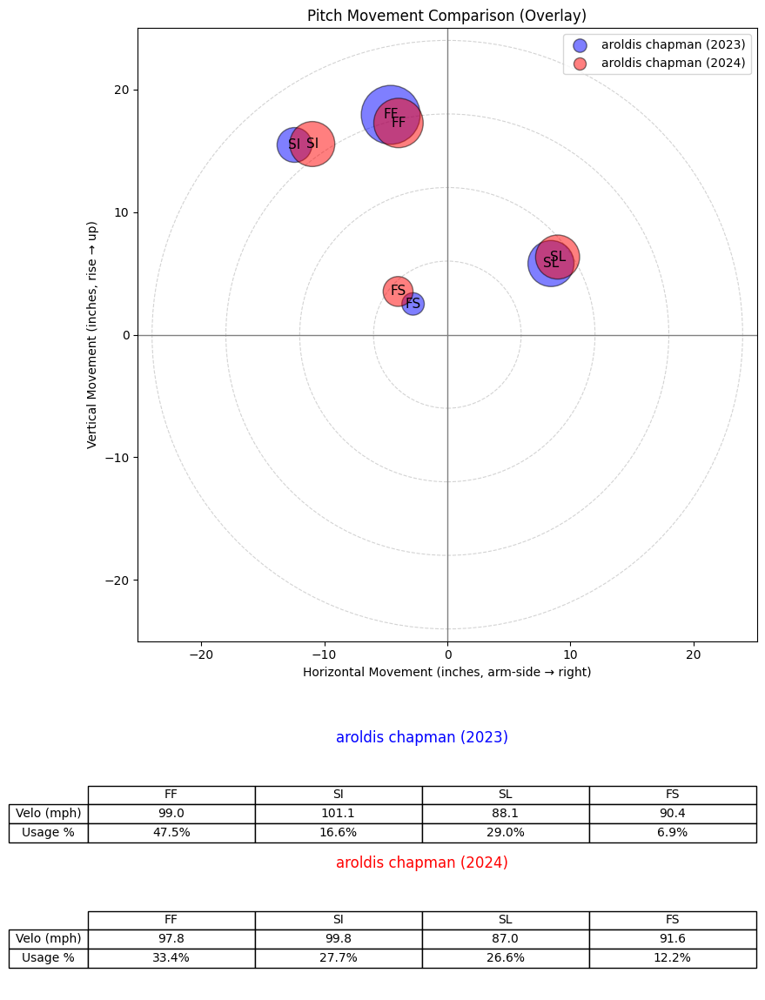

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


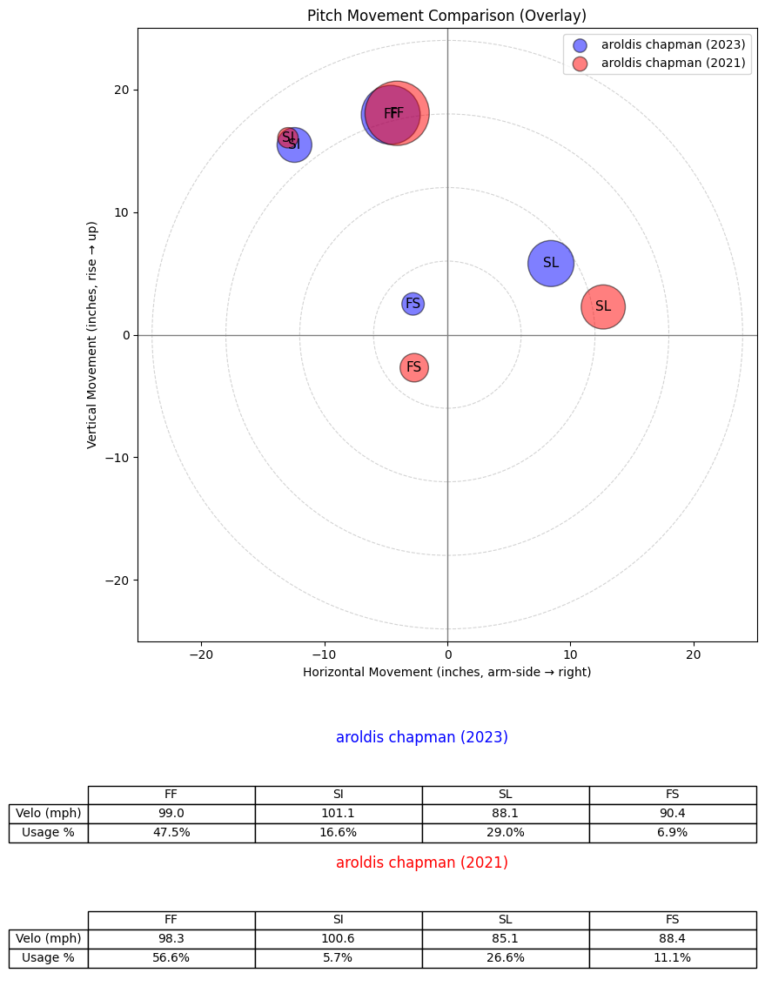

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


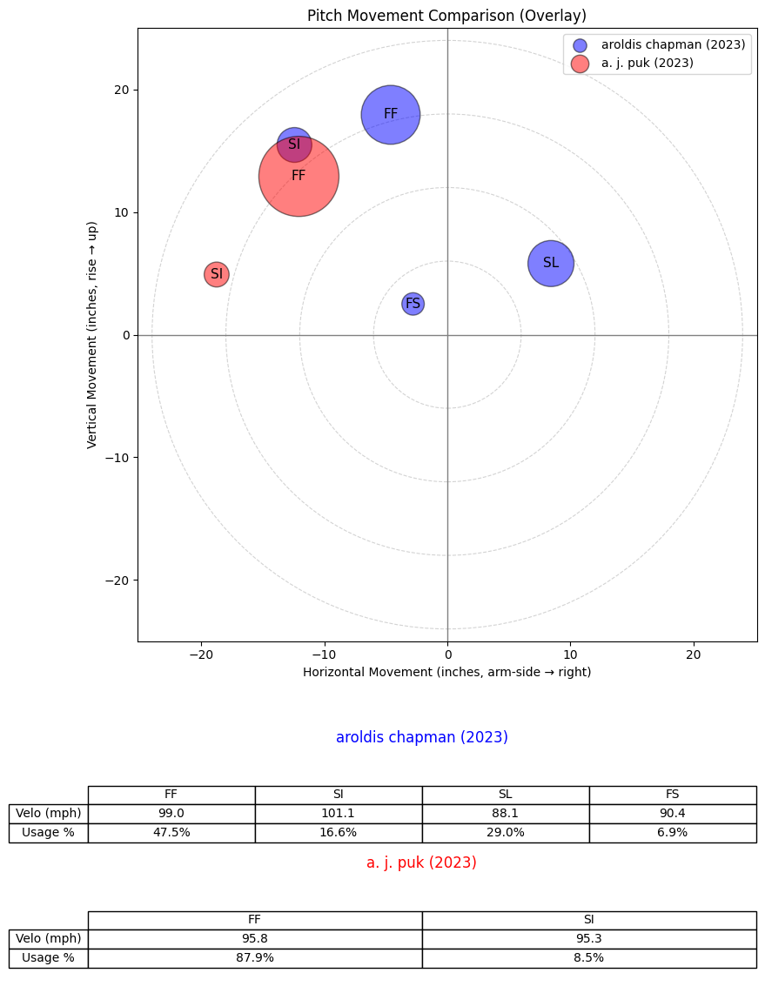

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


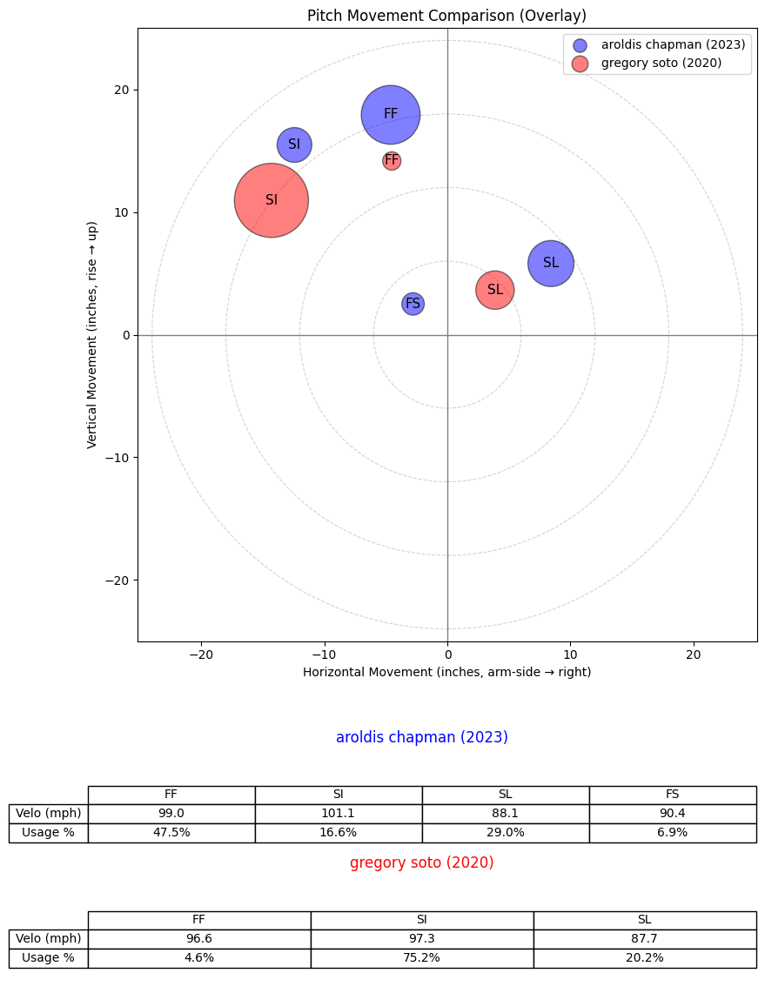

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


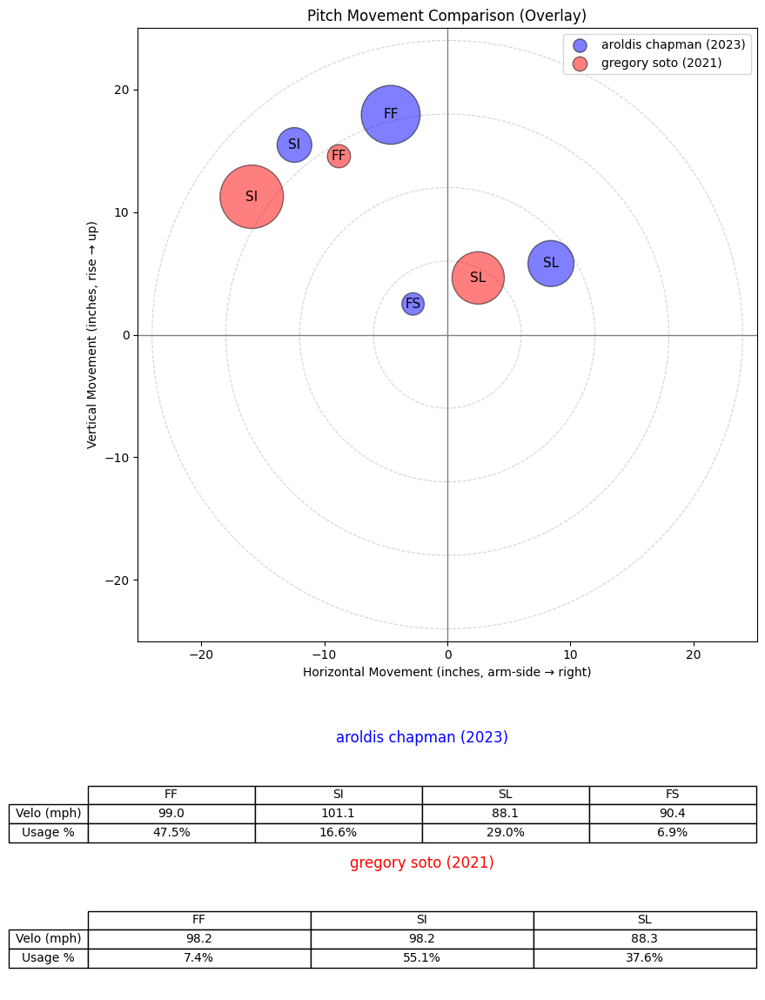

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


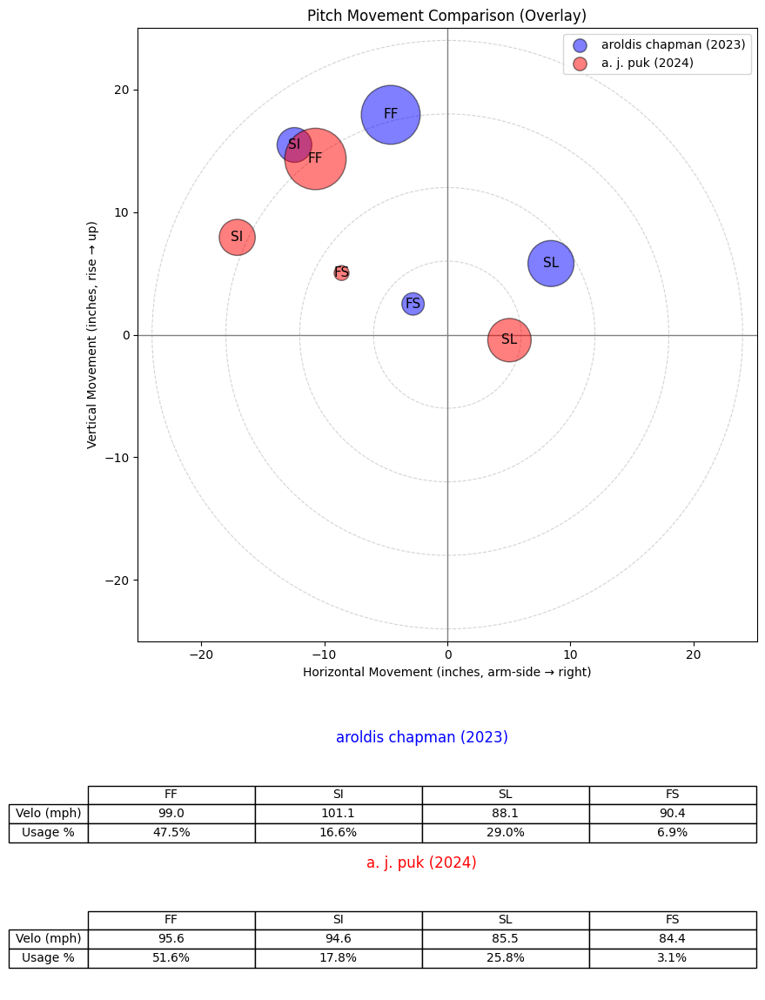

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


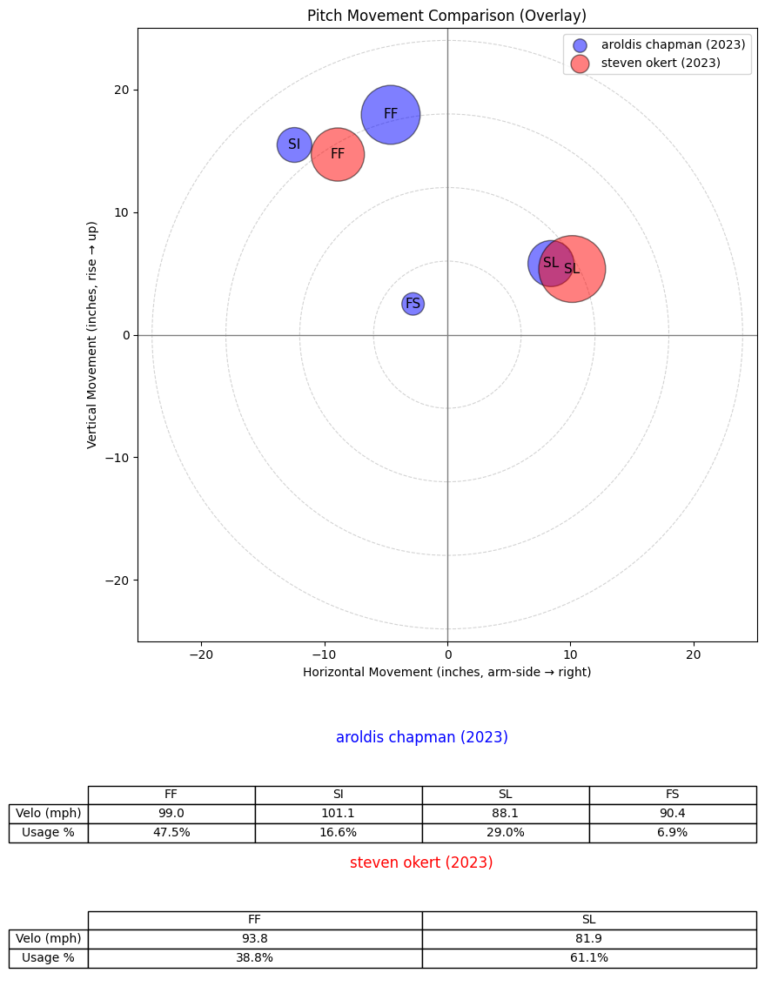

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


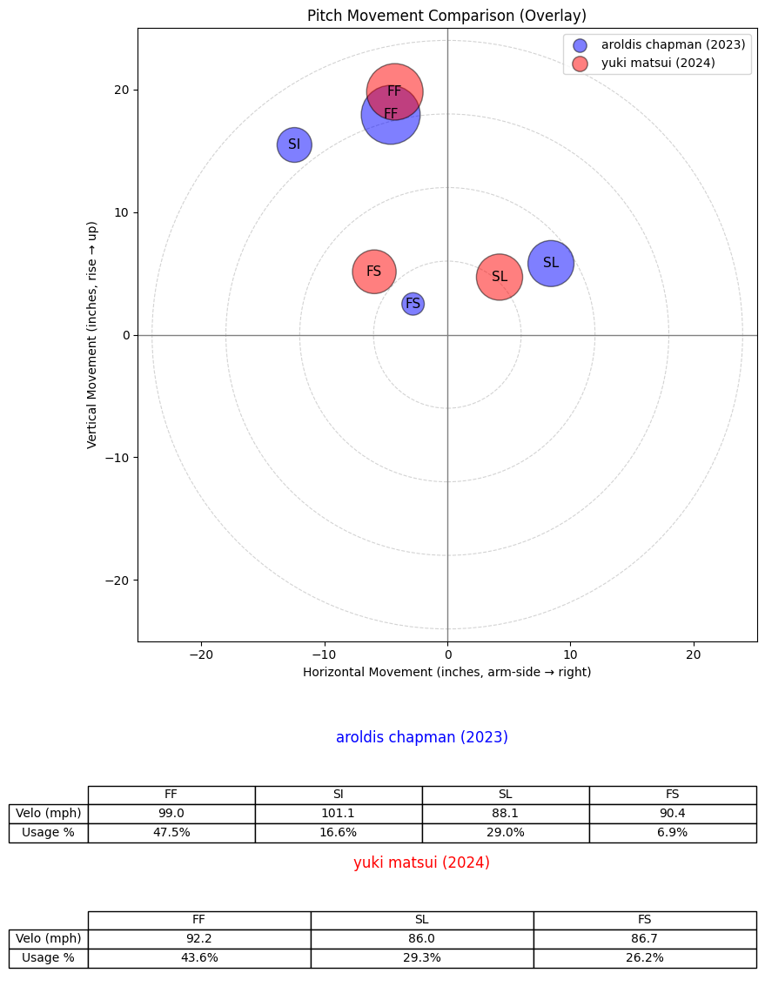

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


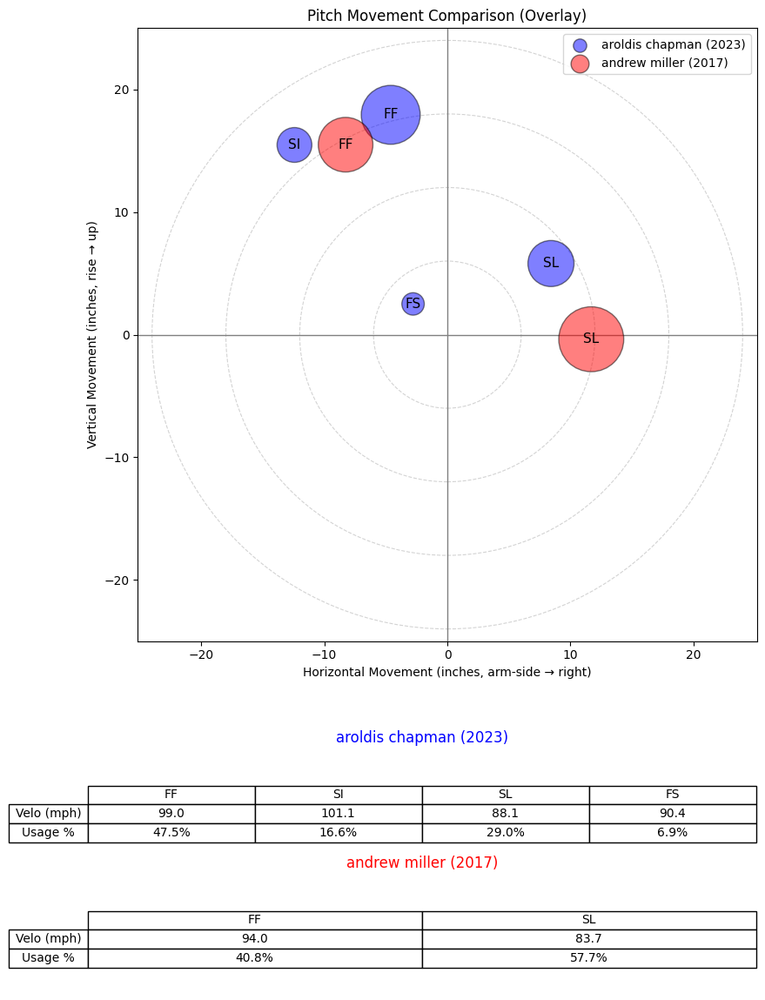

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


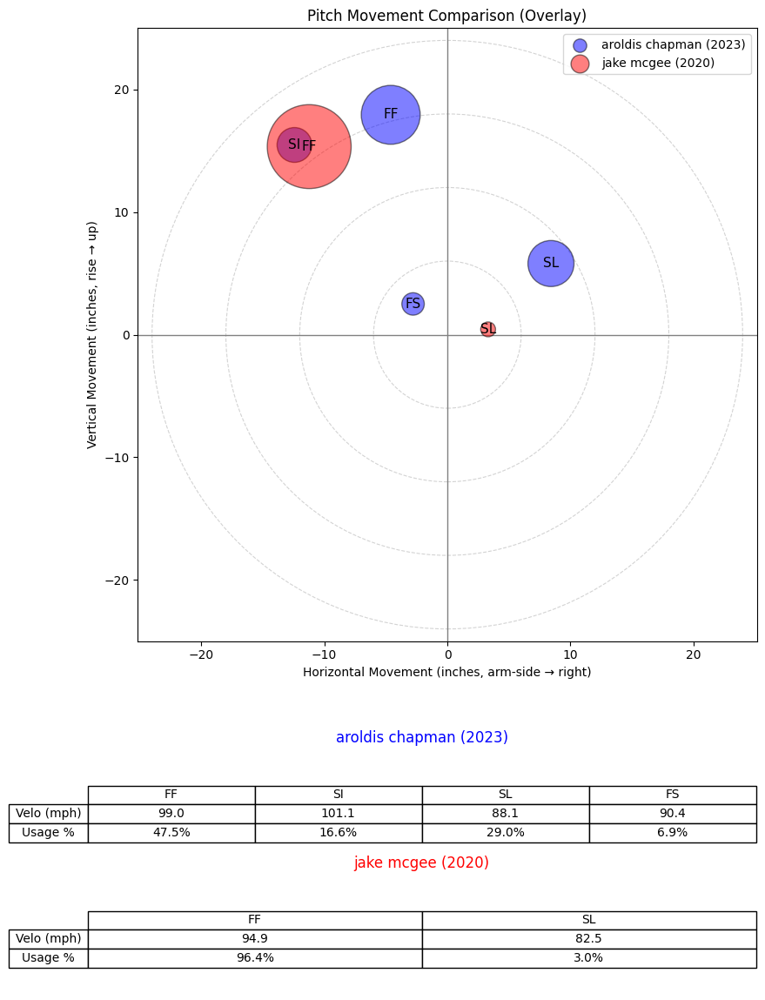

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
661,547973.0,2024,aroldis chapman,aroldis,chapman,L,reliever,0.992466
659,547973.0,2021,aroldis chapman,aroldis,chapman,L,reliever,0.898298
1469,640462.0,2023,a. j. puk,a. j.,puk,L,reliever,0.752218
1565,642397.0,2020,gregory soto,gregory,soto,L,reliever,0.736135
1566,642397.0,2021,gregory soto,gregory,soto,L,reliever,0.724101
1470,640462.0,2024,a. j. puk,a. j.,puk,L,reliever,0.697259
974,595345.0,2023,steven okert,steven,okert,L,reliever,0.688085
2019,673513.0,2024,yuki matsui,yuki,matsui,L,reliever,0.683900
121,453192.0,2017,andrew miller,andrew,miller,L,reliever,0.676890
190,459429.0,2020,jake mcgee,jake,mcgee,L,reliever,0.625959


In [131]:
neighbors_same = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="aroldis chapman",
    year=2023,
    X_df=X_scaled_df,
    meta_df=pitcher_season_df,
    n_neighbors=10,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same)


/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


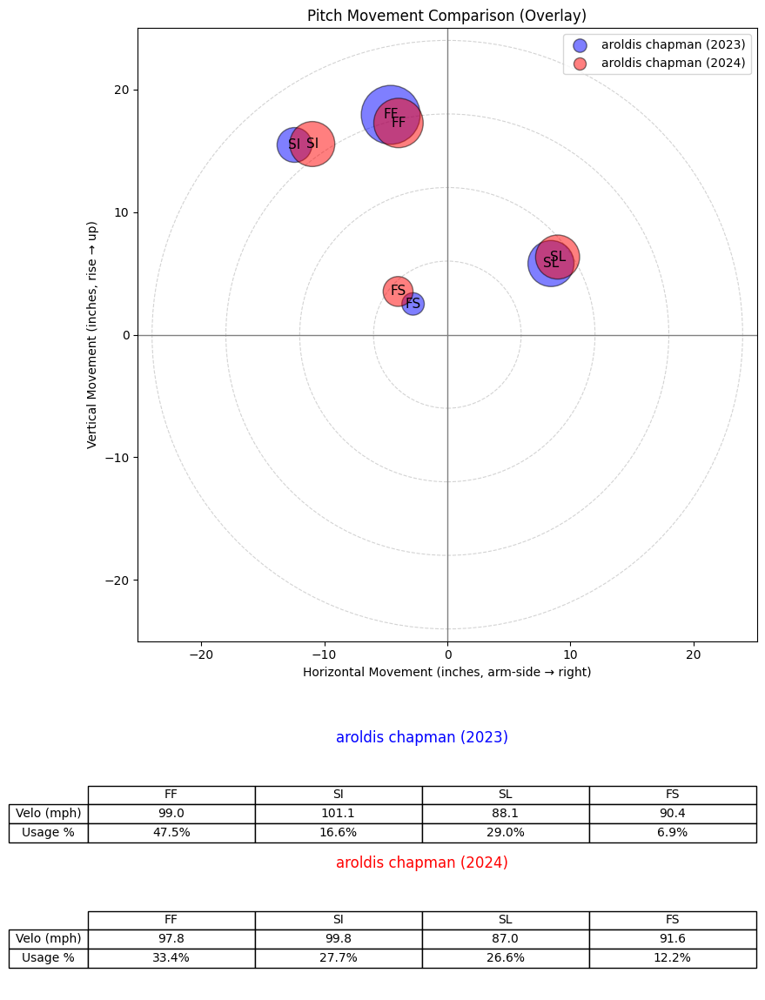

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


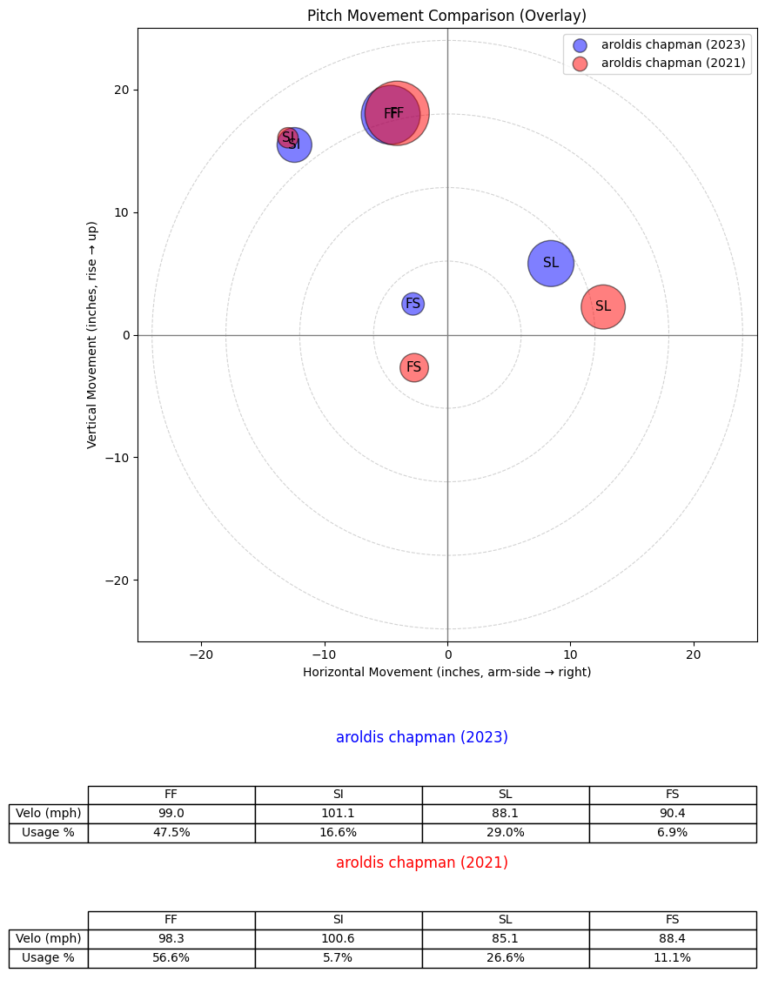

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


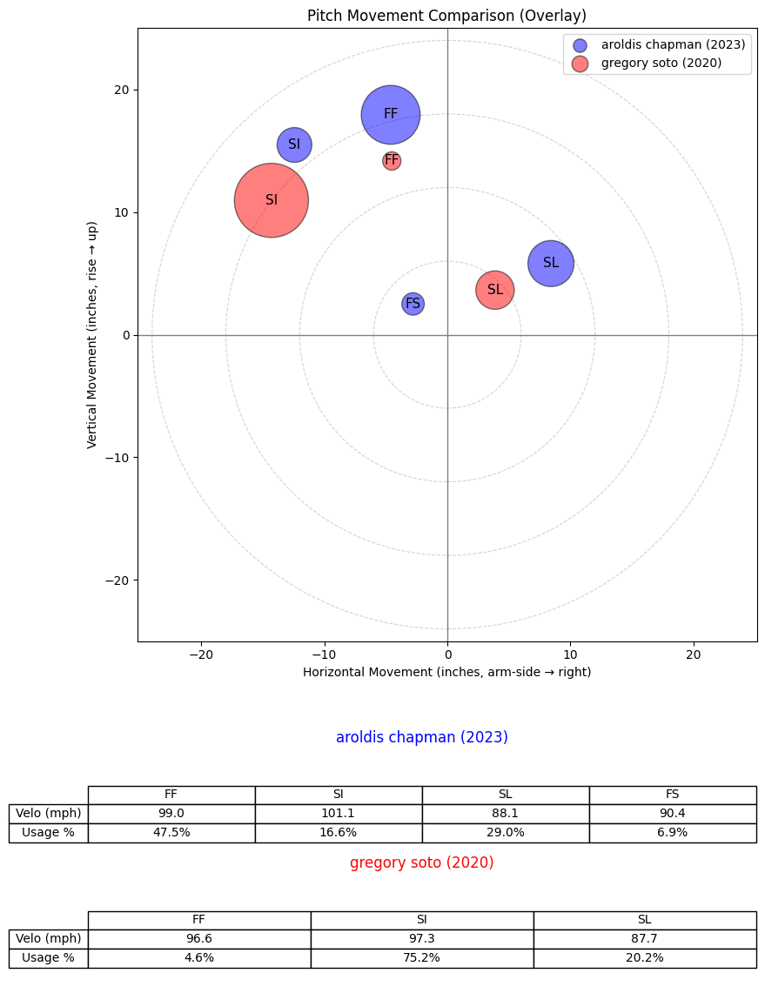

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


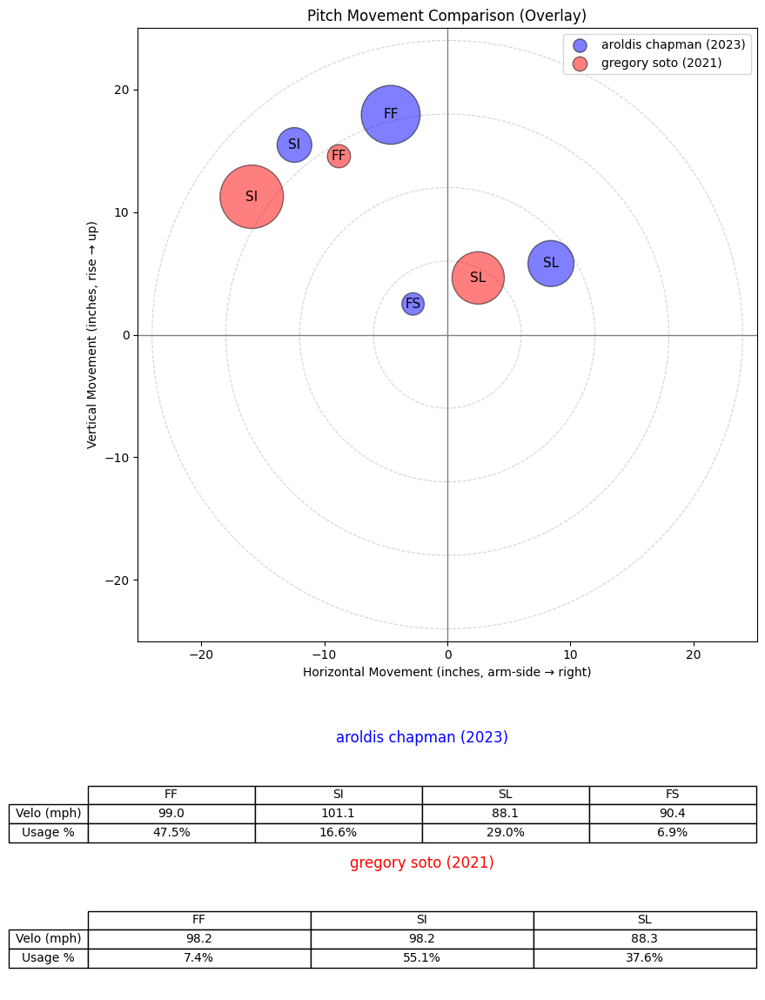

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


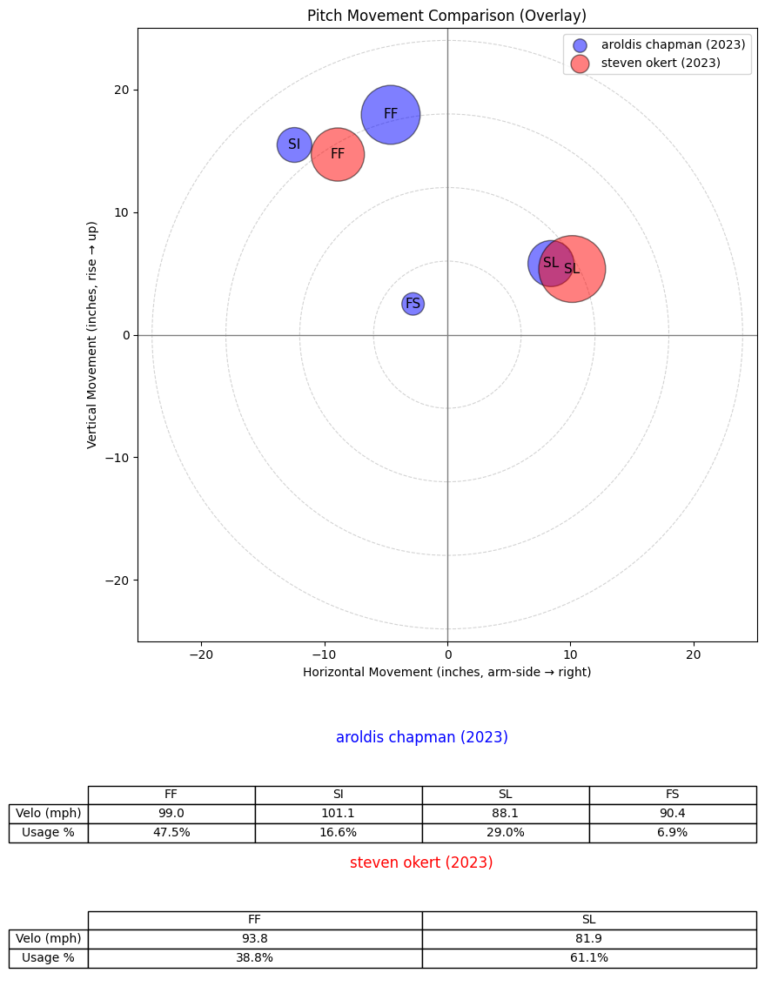

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


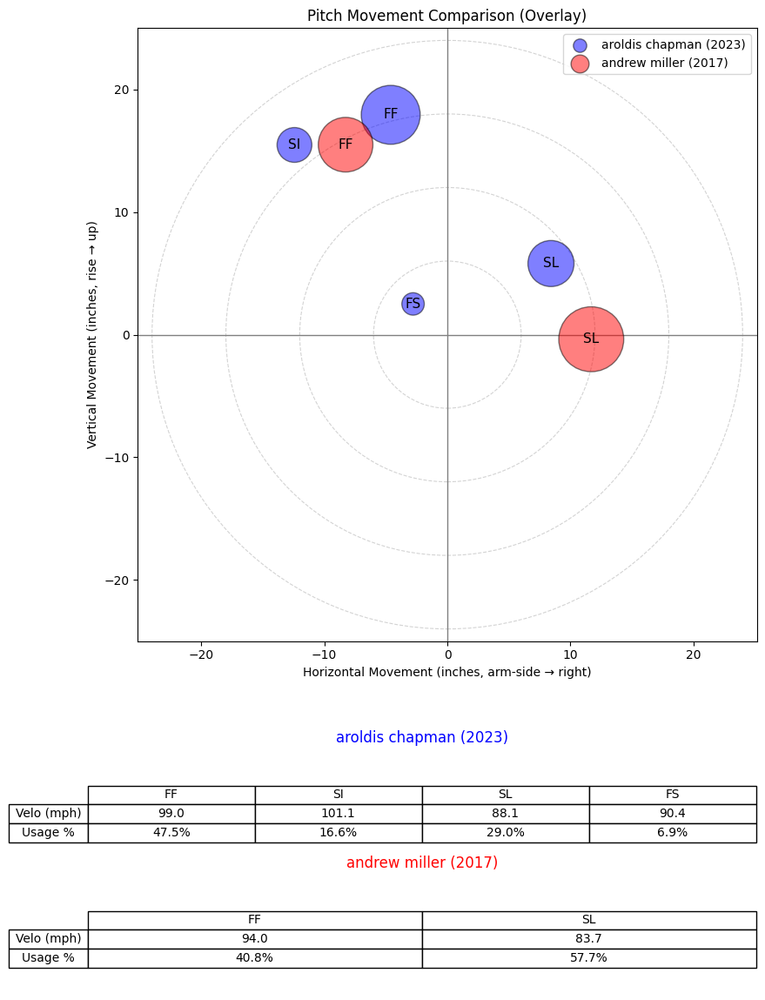

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


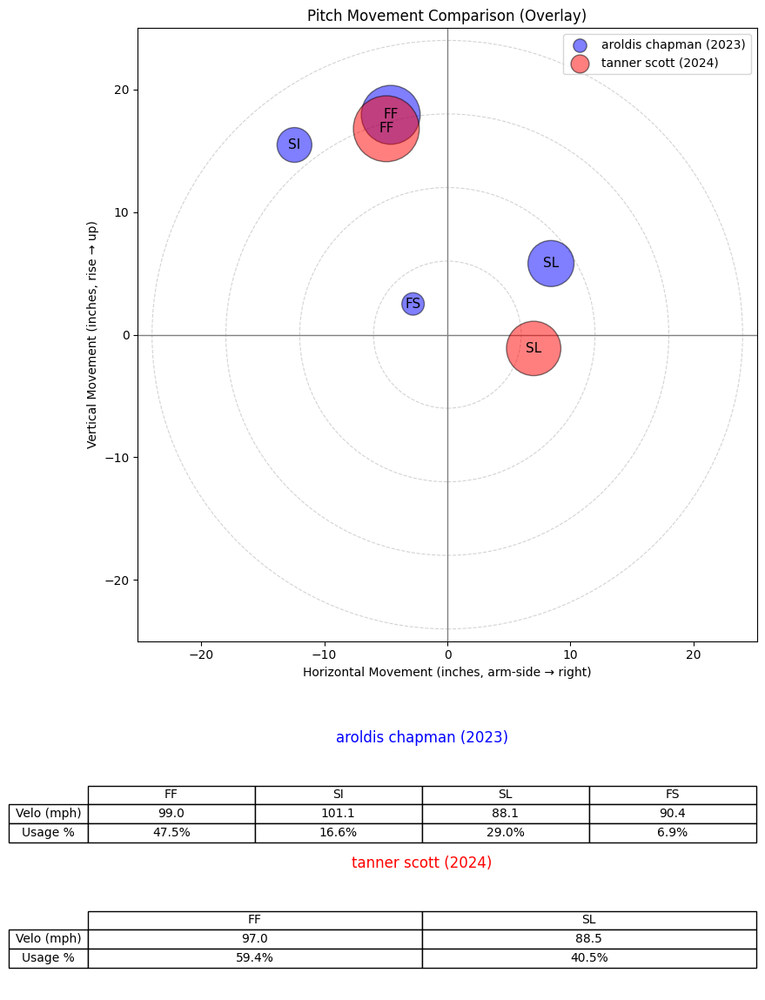

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


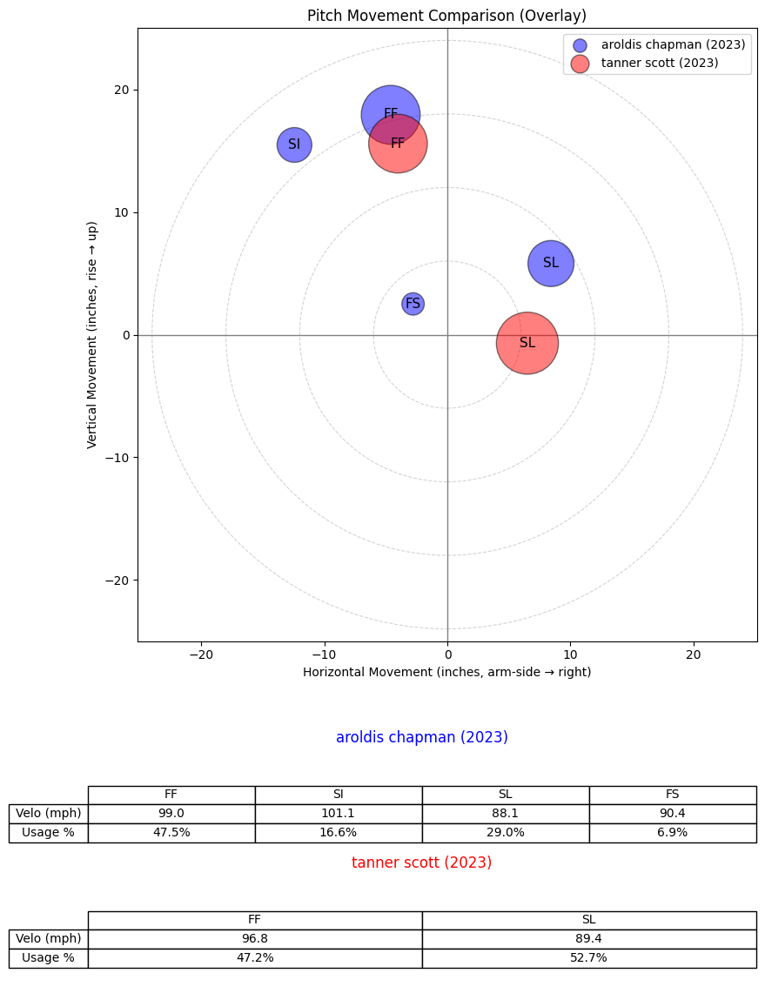

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


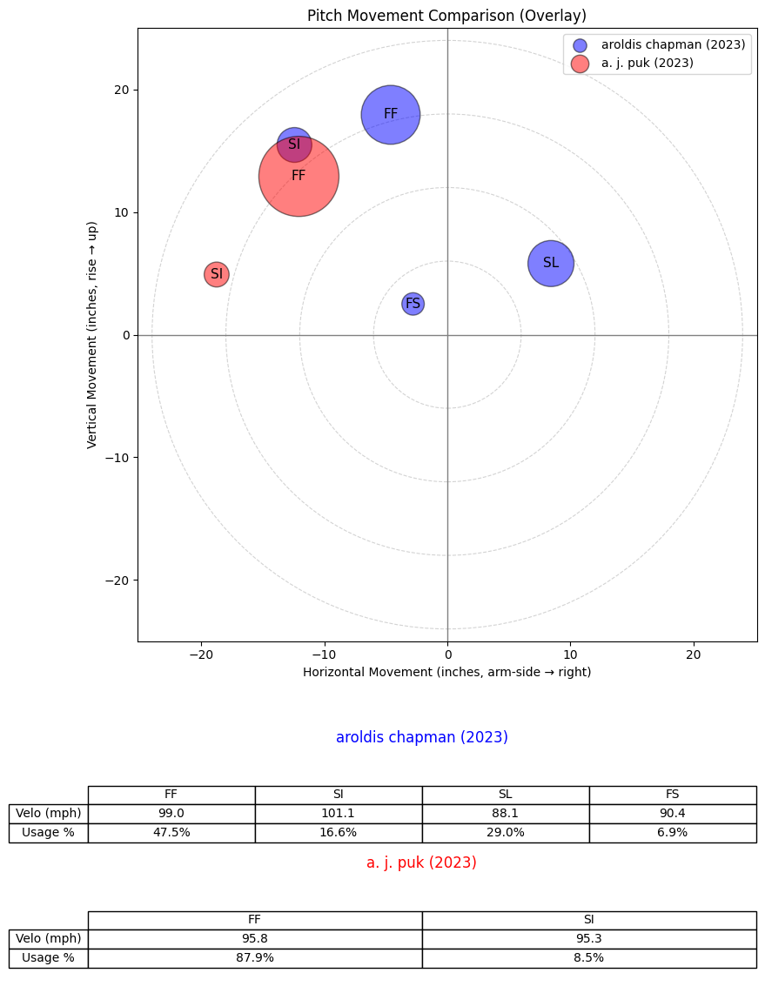

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


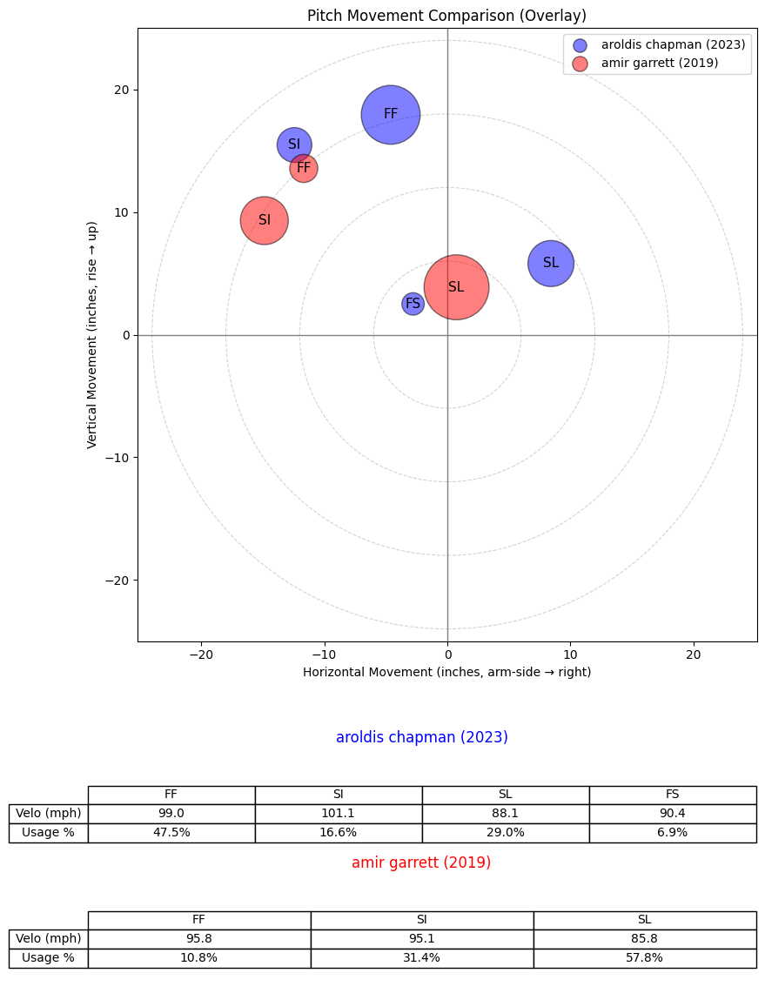

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
661,547973.0,2024,aroldis chapman,aroldis,chapman,L,reliever,0.995206
659,547973.0,2021,aroldis chapman,aroldis,chapman,L,reliever,0.917341
1565,642397.0,2020,gregory soto,gregory,soto,L,reliever,0.833397
1566,642397.0,2021,gregory soto,gregory,soto,L,reliever,0.812091
974,595345.0,2023,steven okert,steven,okert,L,reliever,0.774516
121,453192.0,2017,andrew miller,andrew,miller,L,reliever,0.738602
1722,656945.0,2024,tanner scott,tanner,scott,L,reliever,0.731852
1721,656945.0,2023,tanner scott,tanner,scott,L,reliever,0.725975
1469,640462.0,2023,a. j. puk,a. j.,puk,L,reliever,0.702740
1181,607237.0,2019,amir garrett,amir,garrett,L,reliever,0.697395


In [133]:
neighbors_same = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="aroldis chapman",
    year=2023,
    X_df=X_pca_df,
    meta_df=pitcher_season_df,
    n_neighbors=10,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same)


/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


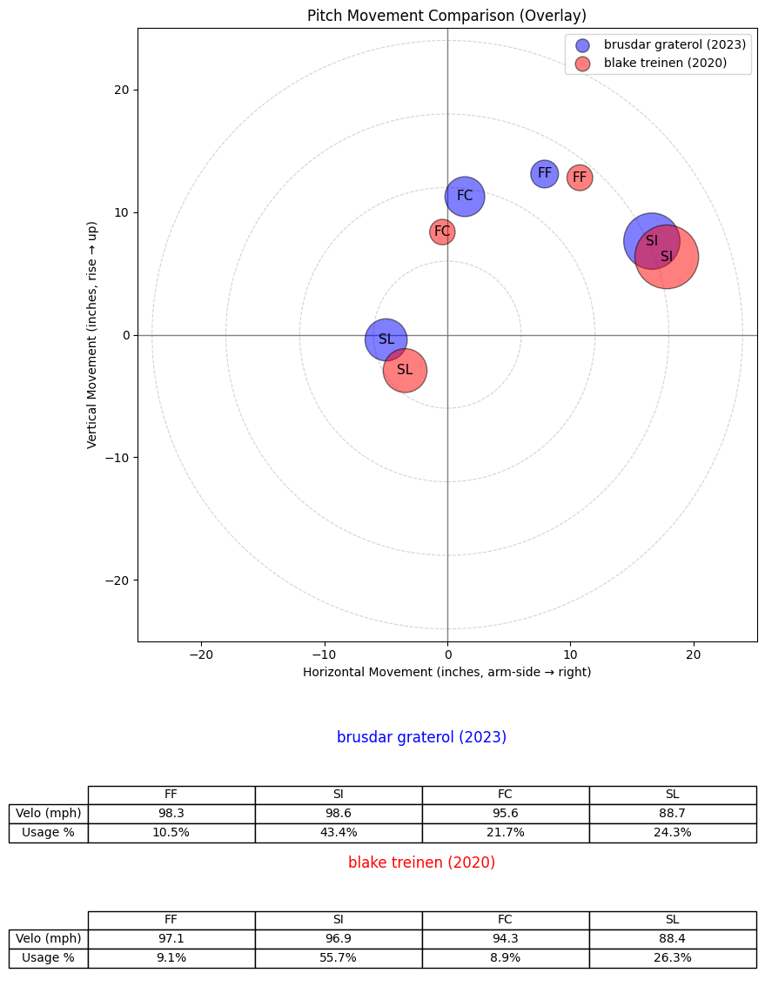

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


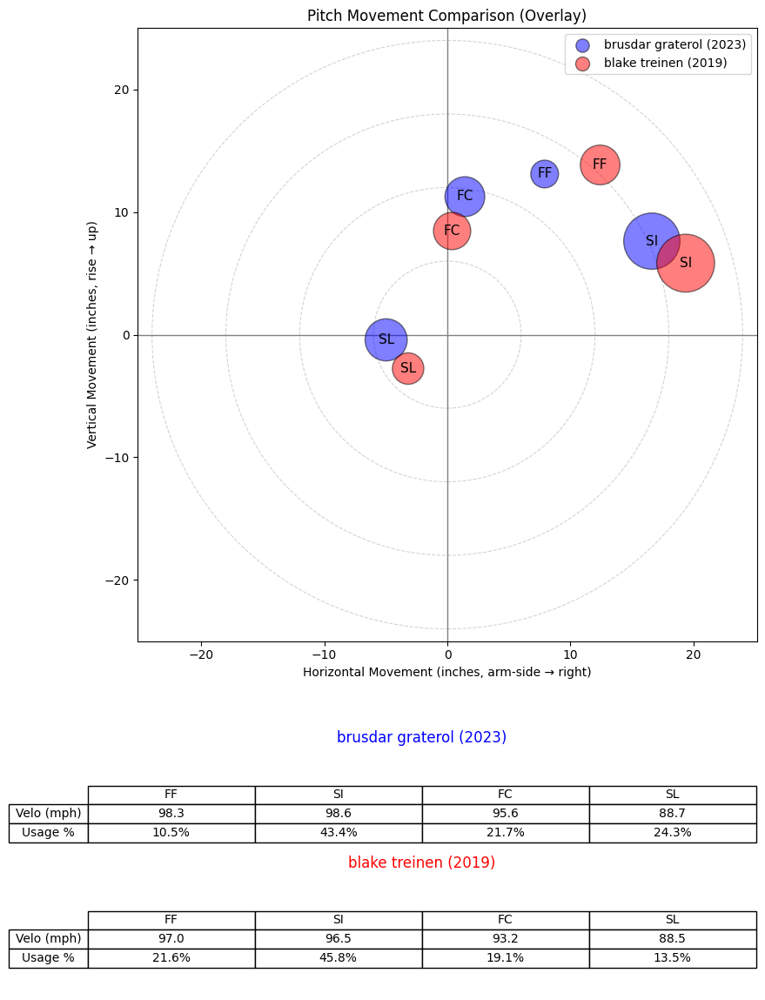

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


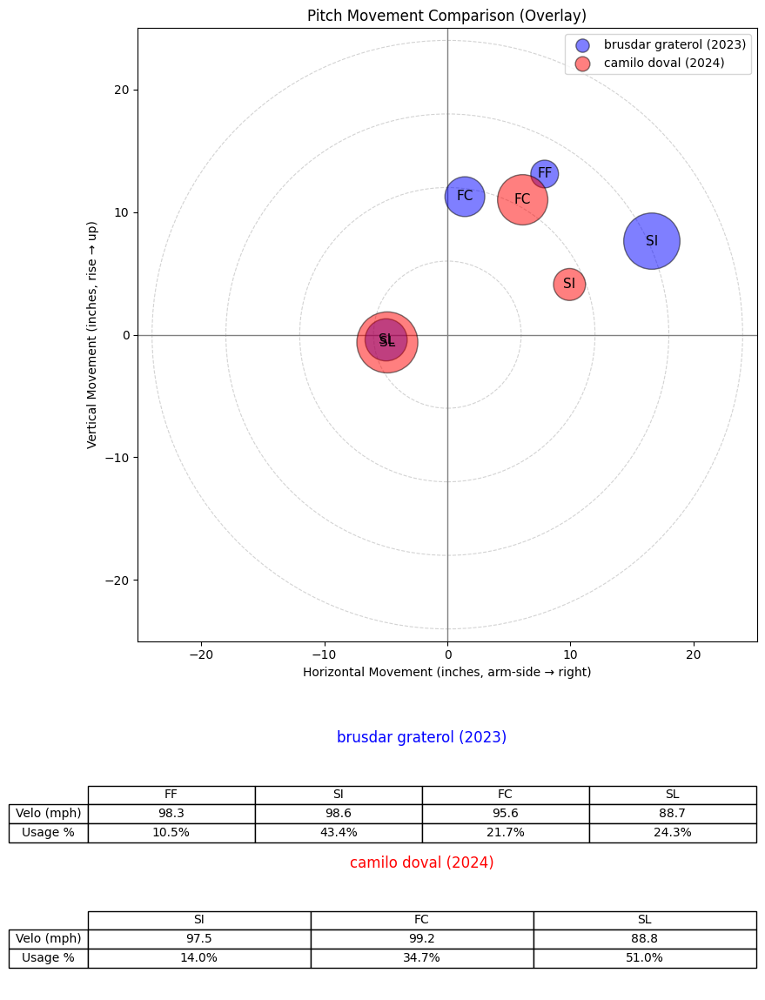

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


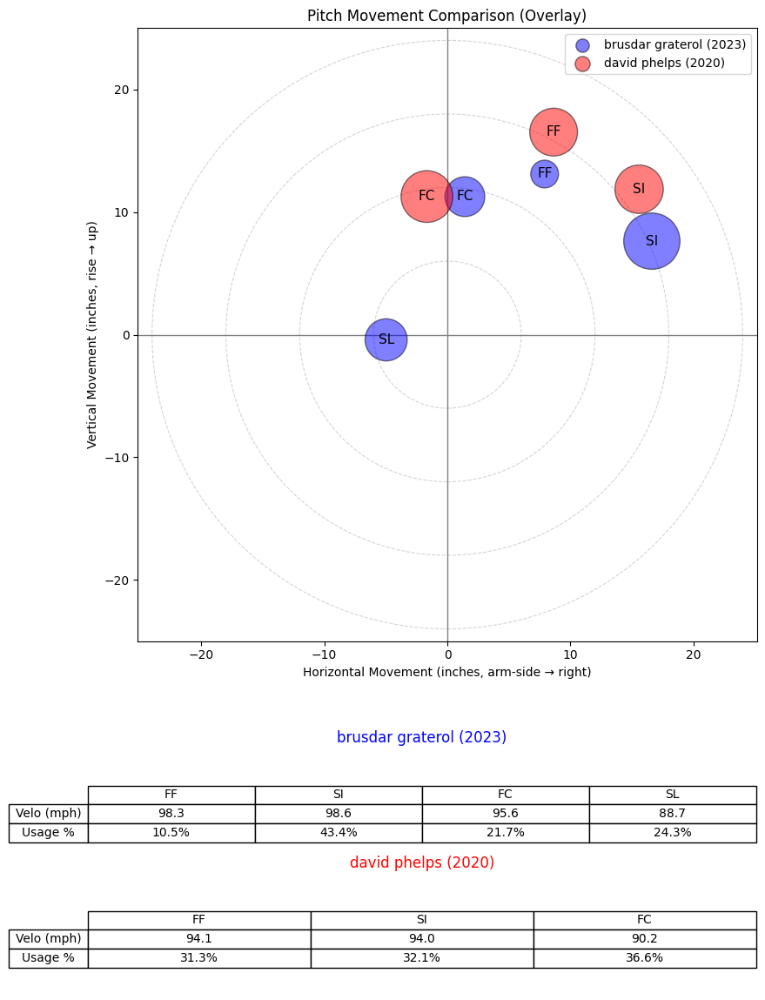

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


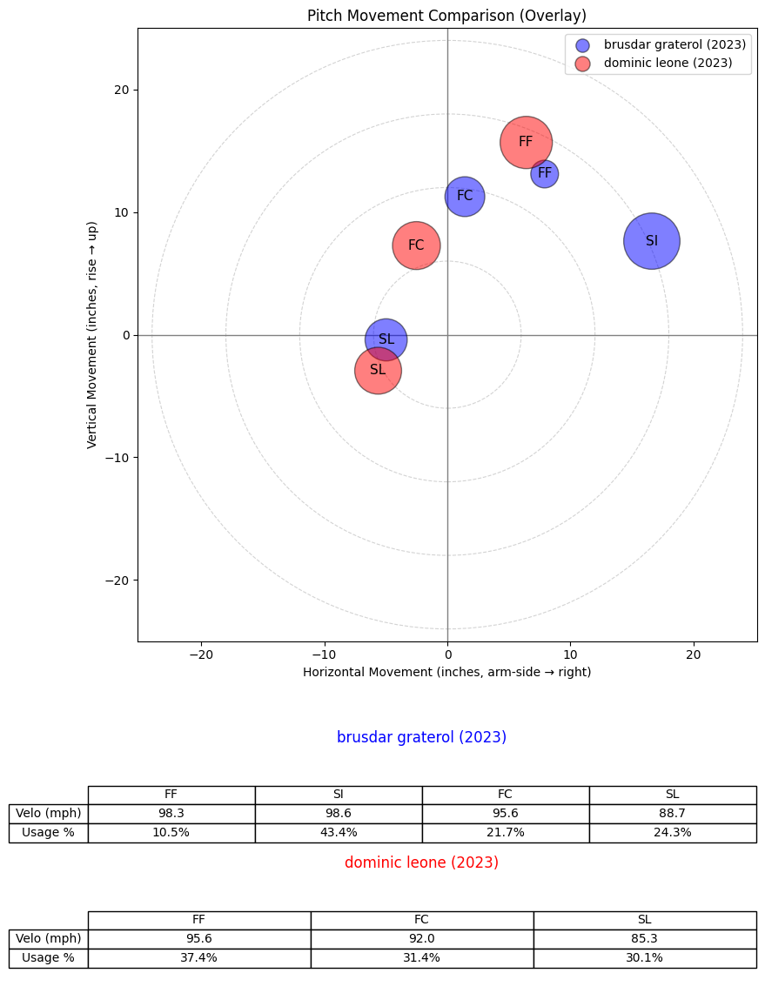

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


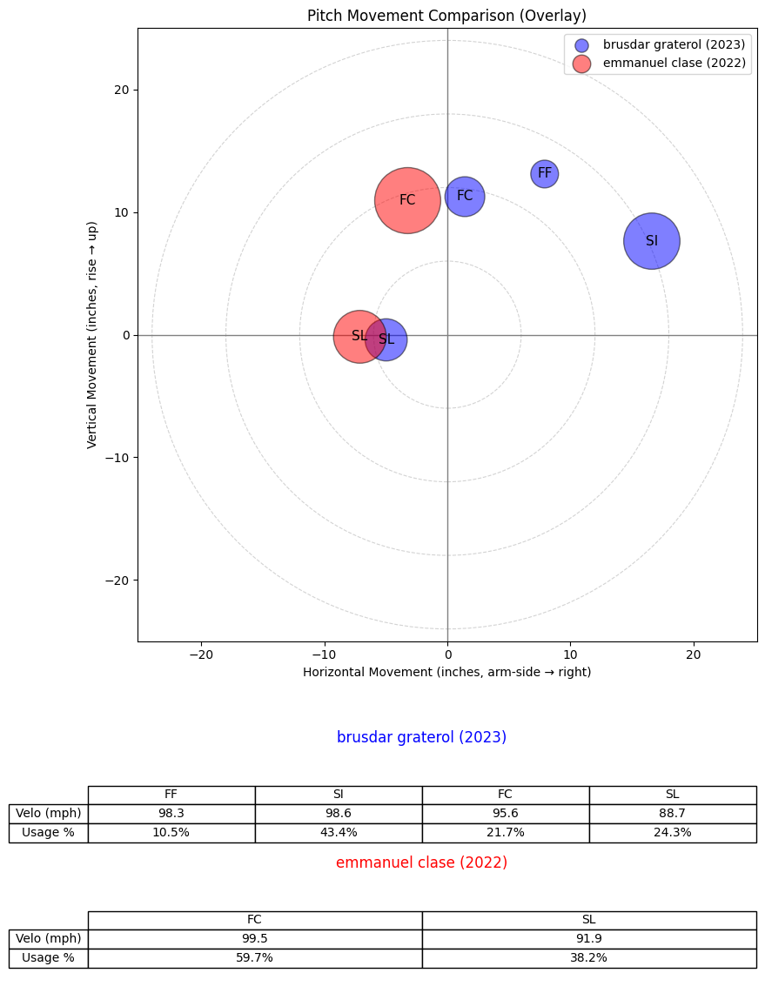

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


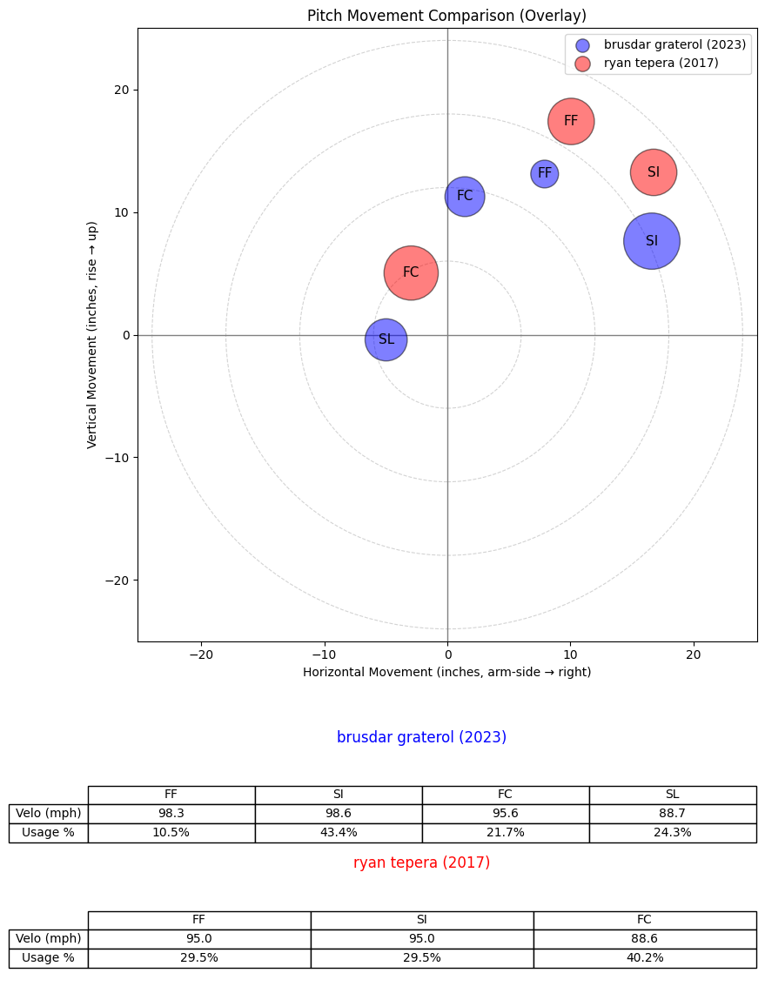

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


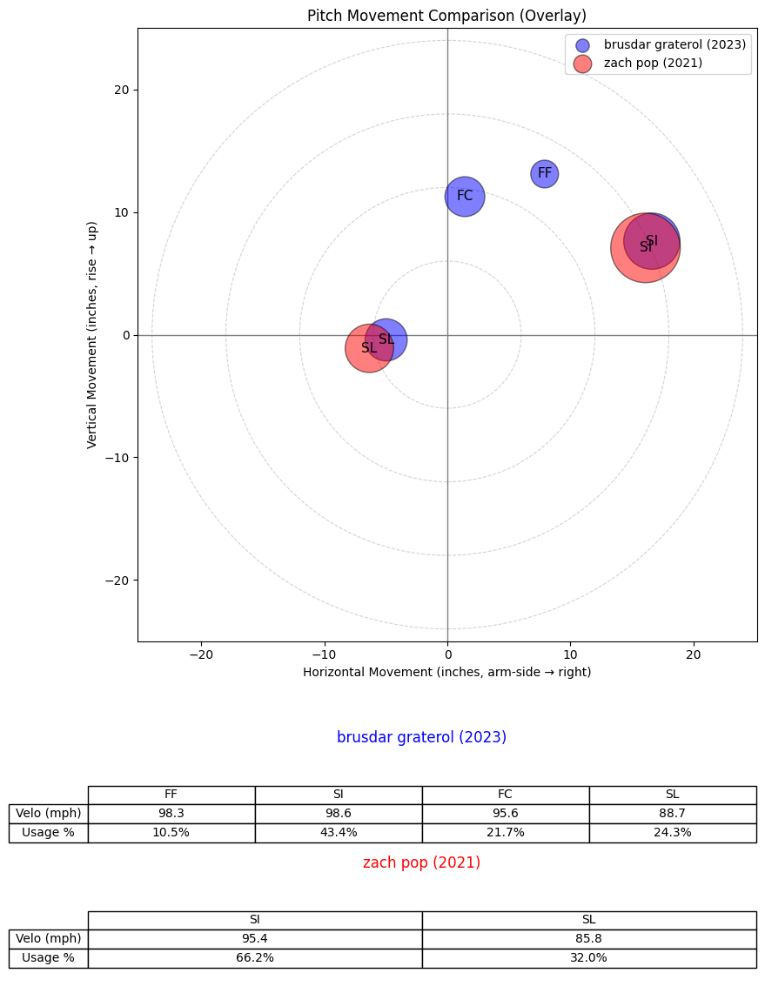

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


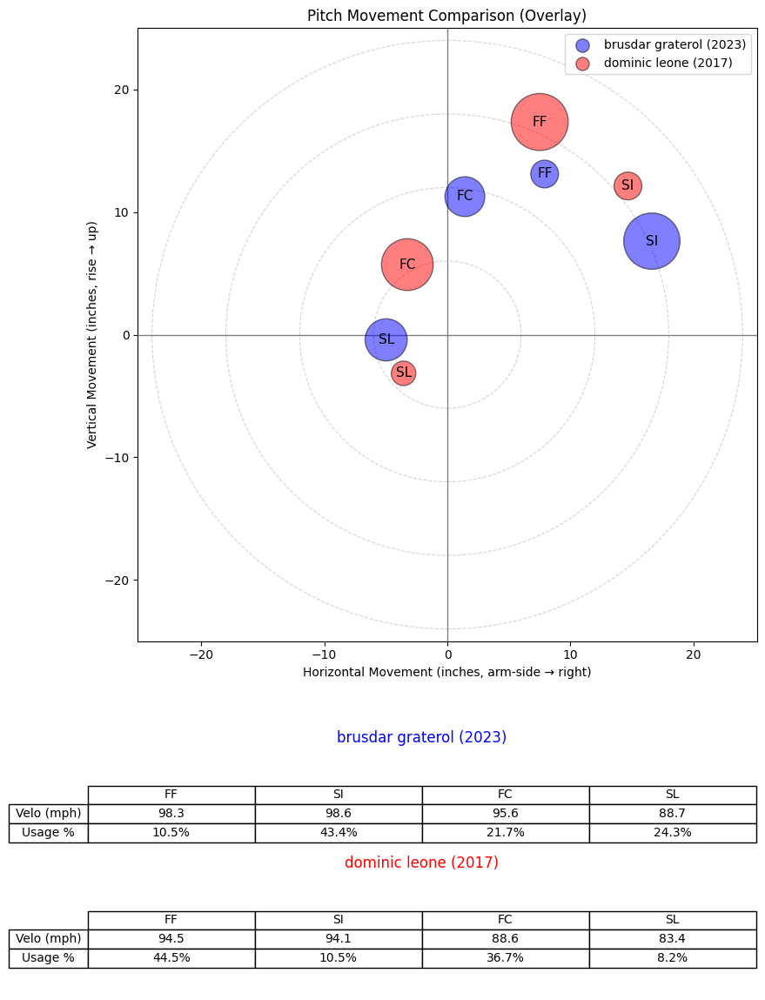

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


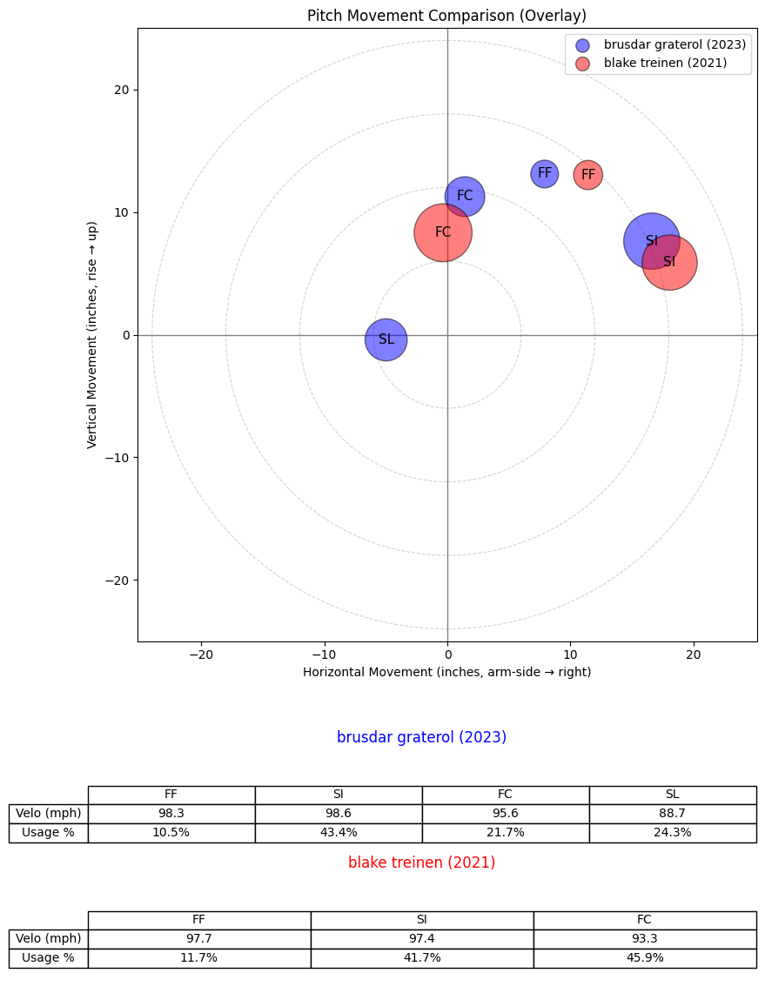

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
970,595014.0,2020,blake treinen,blake,treinen,R,reliever,0.931233
969,595014.0,2019,blake treinen,blake,treinen,R,reliever,0.926664
1906,666808.0,2024,camilo doval,camilo,doval,R,reliever,0.756065
234,475479.0,2020,david phelps,david,phelps,R,reliever,0.722415
1261,608678.0,2023,dominic leone,dominic,leone,R,reliever,0.708990
1780,661403.0,2022,emmanuel clase,emmanuel,clase,R,reliever,0.707219
769,572193.0,2017,ryan tepera,ryan,tepera,R,reliever,0.701958
1629,647315.0,2021,zach pop,zach,pop,R,reliever,0.680365
1260,608678.0,2017,dominic leone,dominic,leone,R,reliever,0.671102
971,595014.0,2021,blake treinen,blake,treinen,R,reliever,0.652935


In [134]:
neighbors_same = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="brusdar graterol",
    year=2023,
    X_df=X_scaled_df,
    meta_df=pitcher_season_df,
    n_neighbors=10,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same)


/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


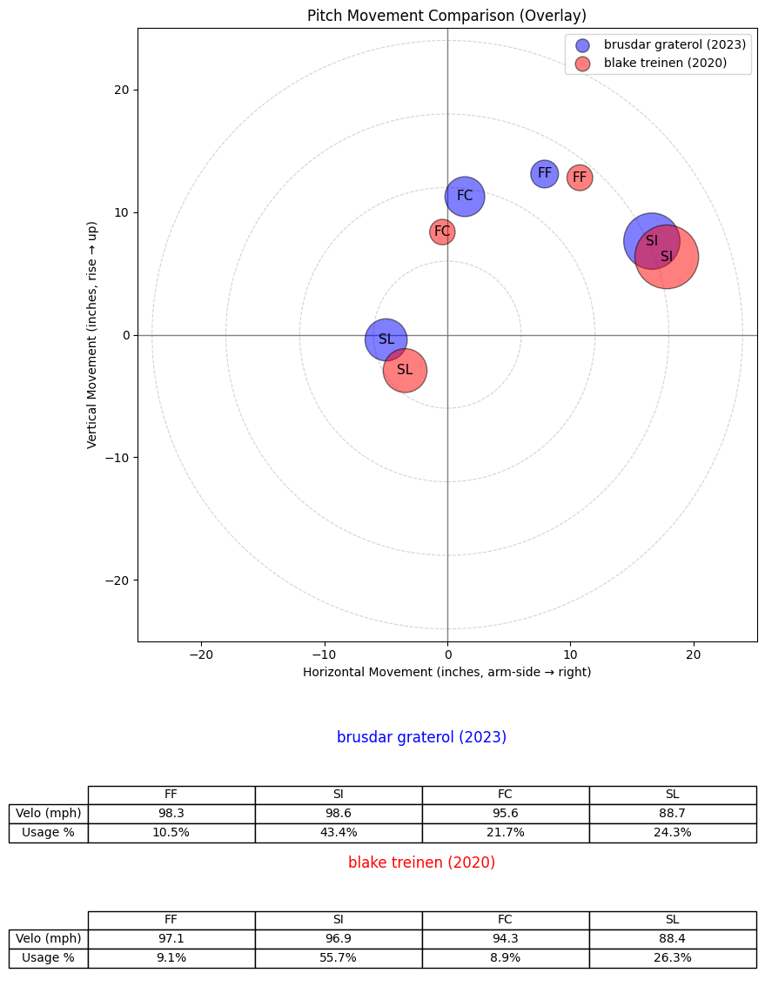

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


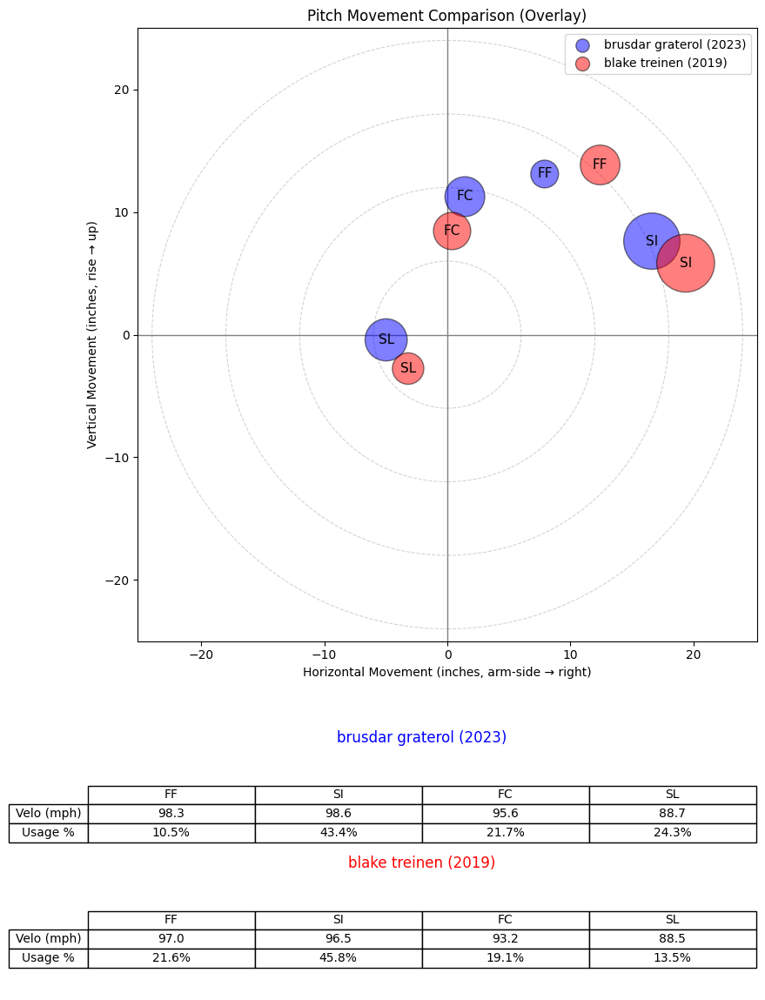

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


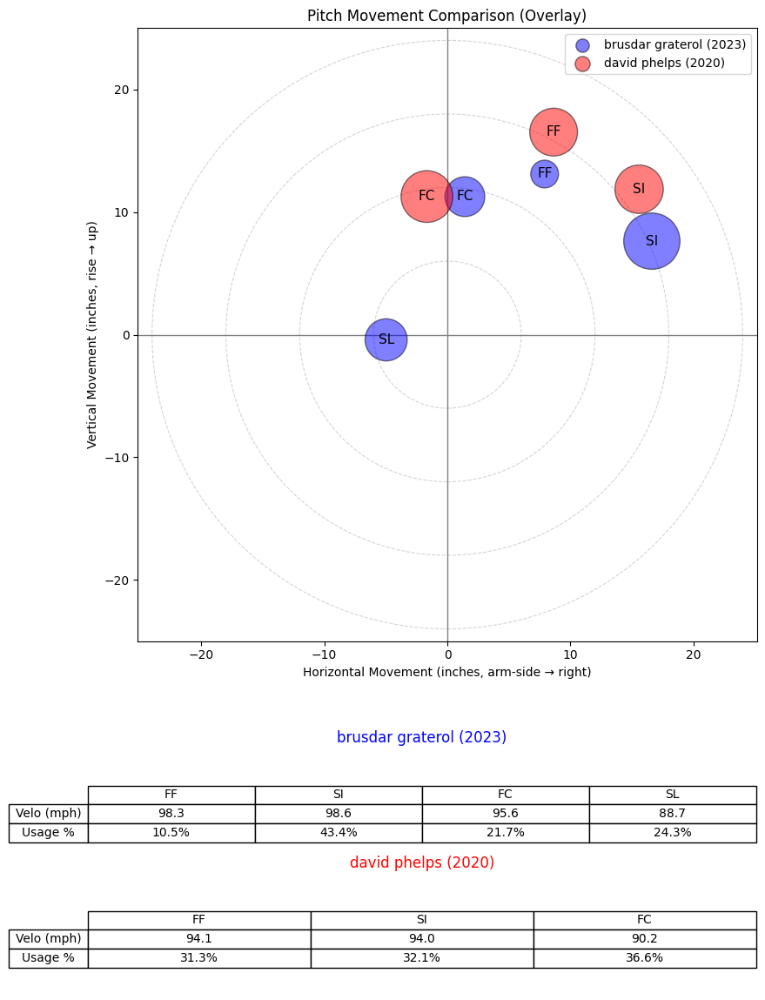

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


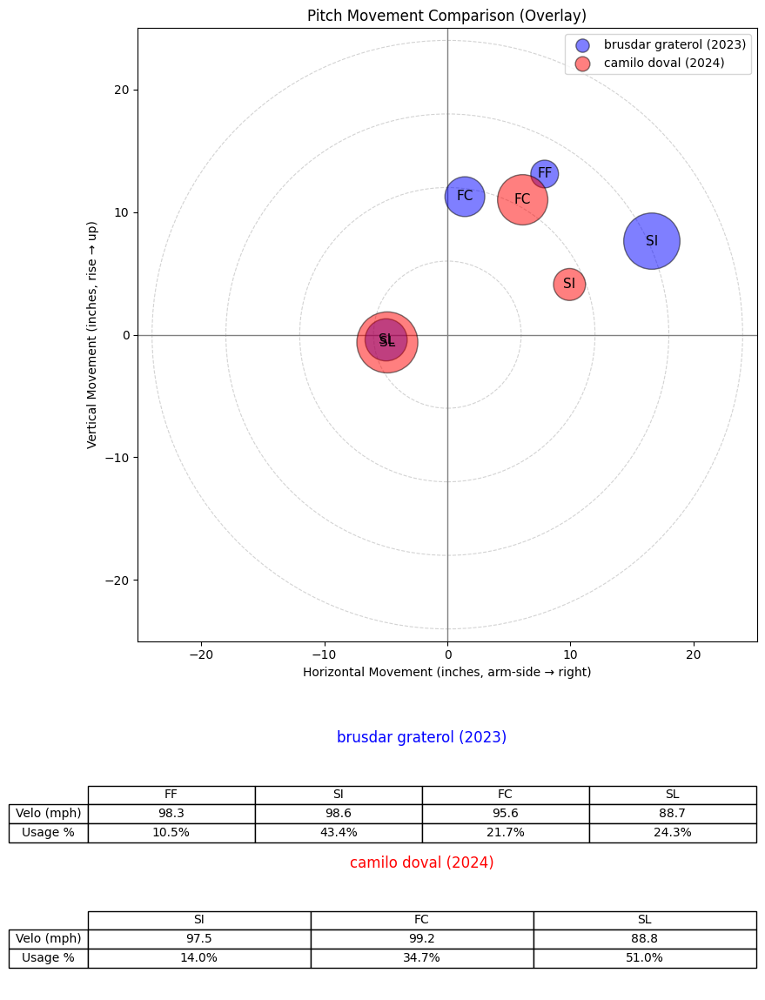

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


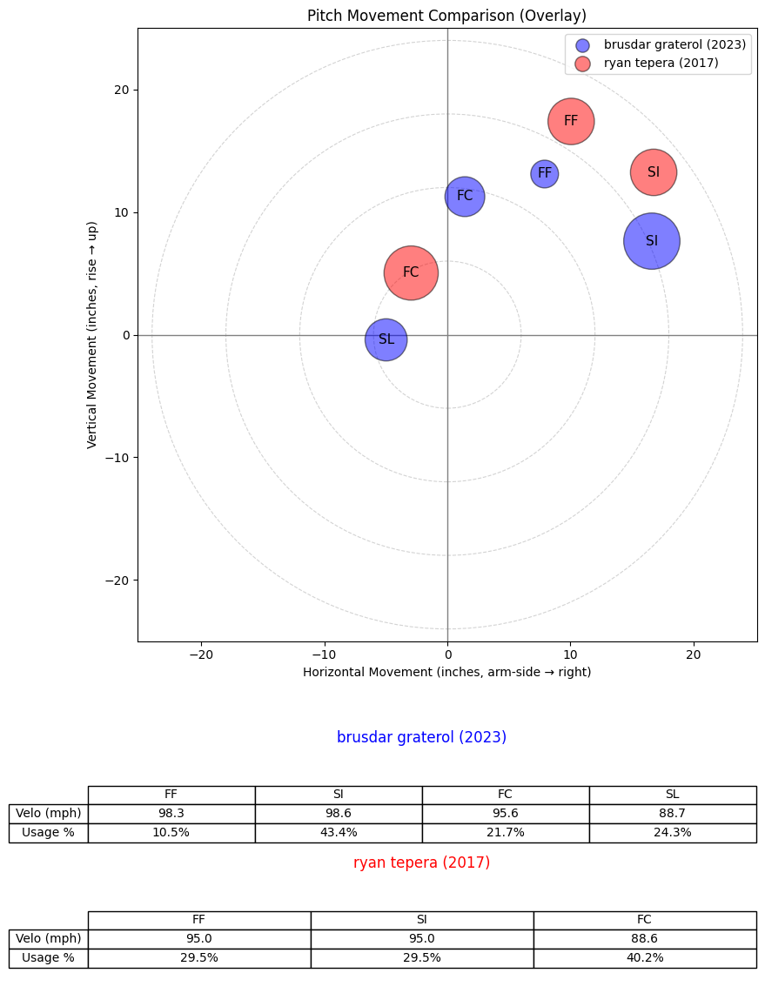

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


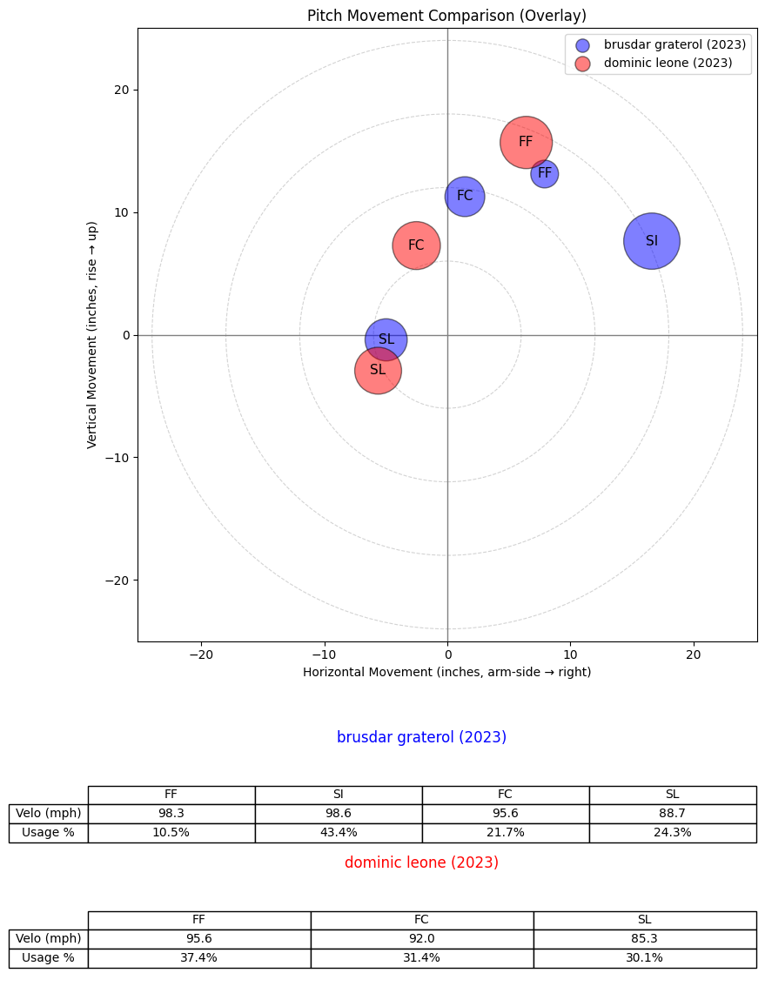

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


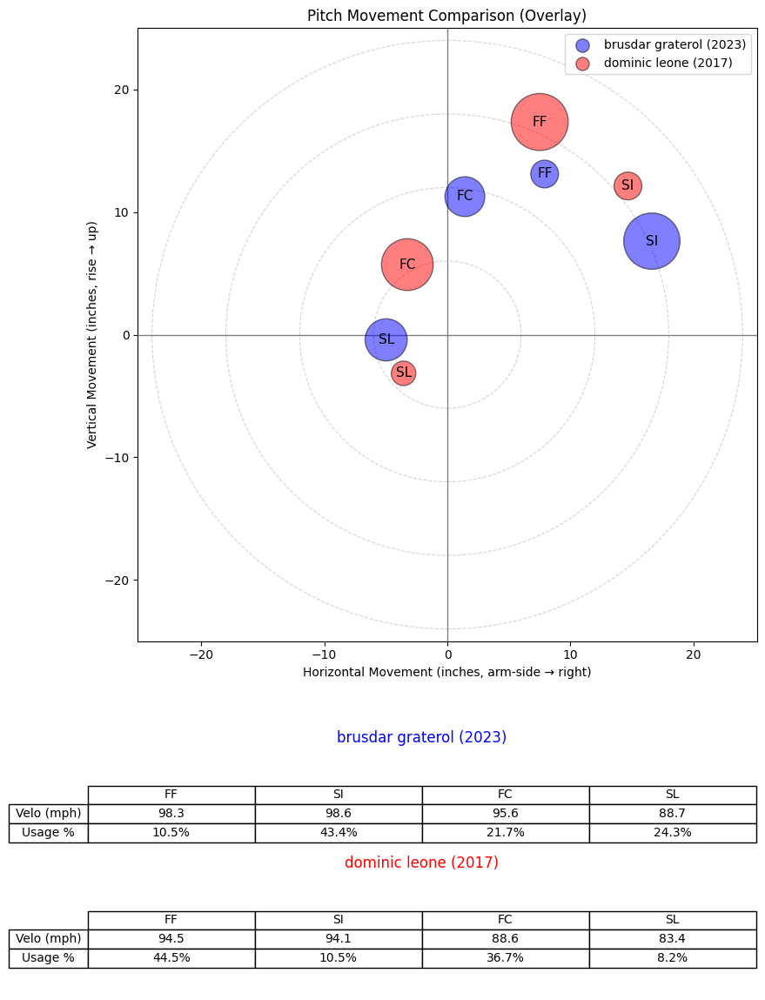

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


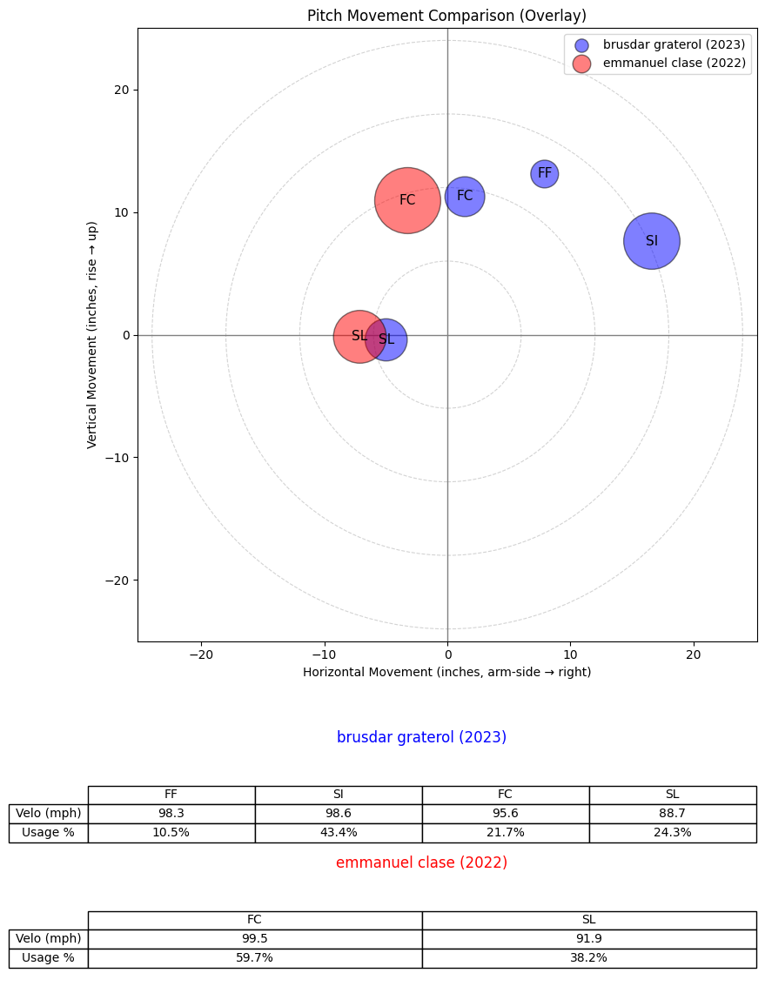

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


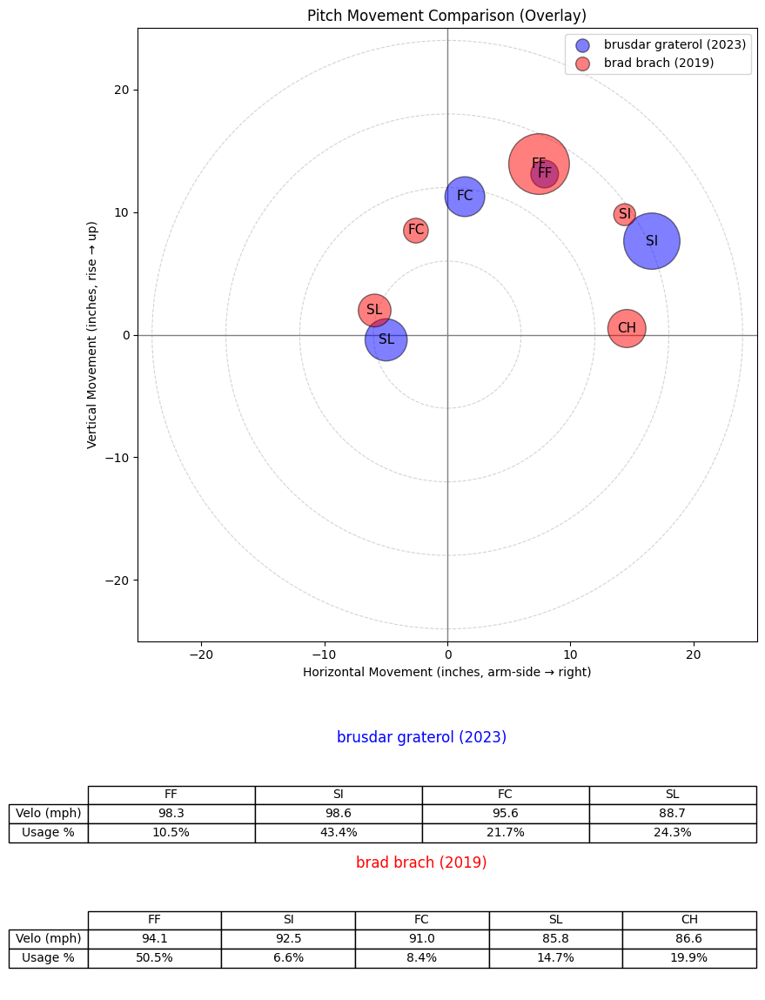

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


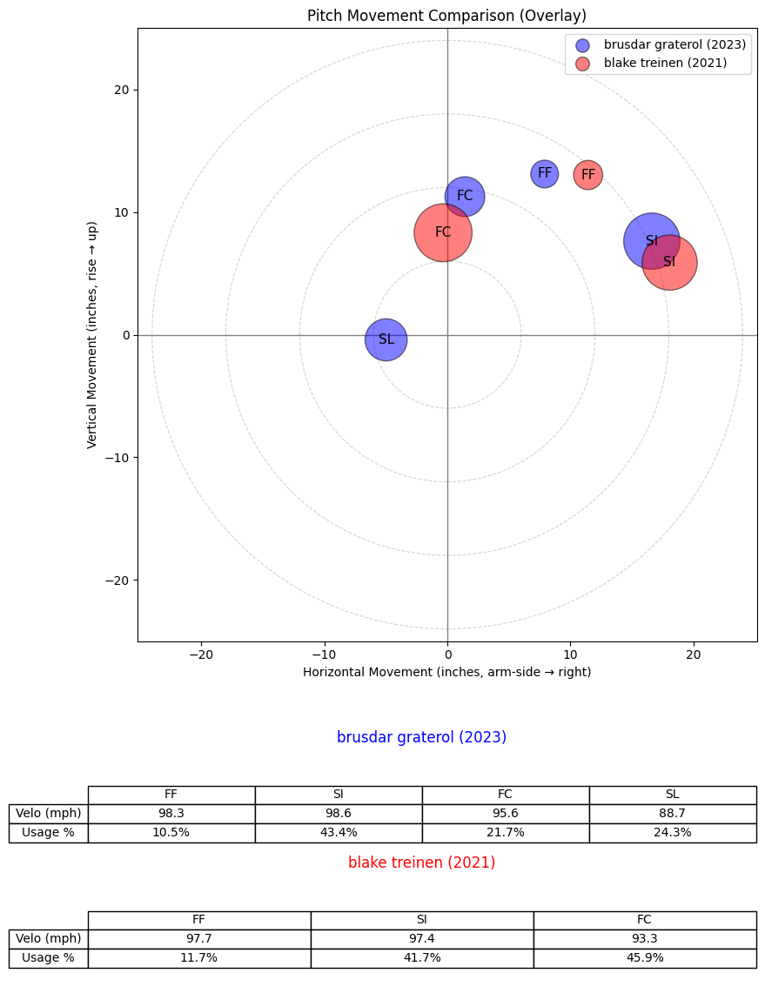

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
970,595014.0,2020,blake treinen,blake,treinen,R,reliever,0.941067
969,595014.0,2019,blake treinen,blake,treinen,R,reliever,0.937893
234,475479.0,2020,david phelps,david,phelps,R,reliever,0.757018
1906,666808.0,2024,camilo doval,camilo,doval,R,reliever,0.751602
769,572193.0,2017,ryan tepera,ryan,tepera,R,reliever,0.751117
1261,608678.0,2023,dominic leone,dominic,leone,R,reliever,0.730816
1260,608678.0,2017,dominic leone,dominic,leone,R,reliever,0.717844
1780,661403.0,2022,emmanuel clase,emmanuel,clase,R,reliever,0.715652
529,542960.0,2019,brad brach,brad,brach,R,reliever,0.693219
971,595014.0,2021,blake treinen,blake,treinen,R,reliever,0.685534


In [135]:
neighbors_same = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="brusdar graterol",
    year=2023,
    X_df=X_pca_df,
    meta_df=pitcher_season_df,
    n_neighbors=10,
    overlay_df=movement_long,  # or whatever df your compare_pitchers_overlay expects
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same)


Below I will begin clustering, starting with K-Means in the raw, standardized space.

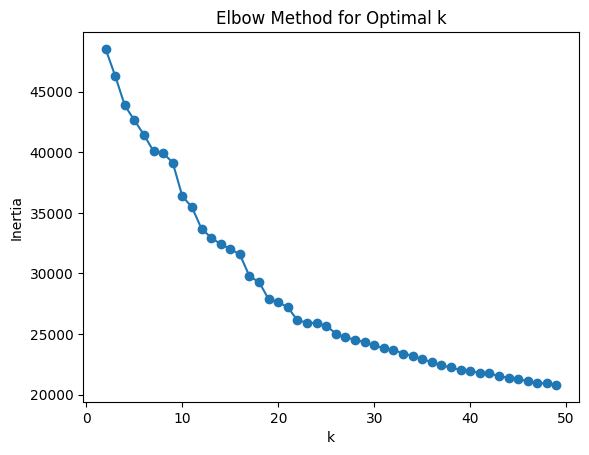

In [219]:
inertias = []
K = range(2, 50)
for k in K:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X_scaled_df)
    inertias.append(kmeans.inertia_)

plt.plot(K, inertias, 'o-')
plt.xlabel('k')
plt.ylabel('Inertia')
plt.title('Elbow Method for Optimal k')
plt.show()

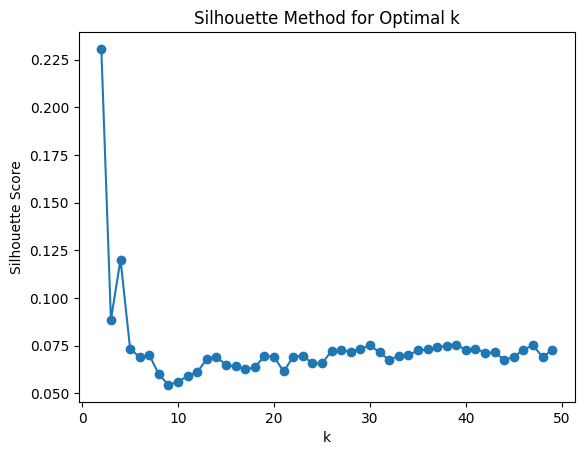

In [220]:
sil_scores = []
for k in K:
    kmeans = KMeans(n_clusters=k, random_state=42)
    labels = kmeans.fit_predict(X_scaled_df)
    sil_scores.append(silhouette_score(X_scaled_df, labels))

plt.plot(K, sil_scores, 'o-')
plt.xlabel('k')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Method for Optimal k')
plt.show()

Now K-Means with PCA

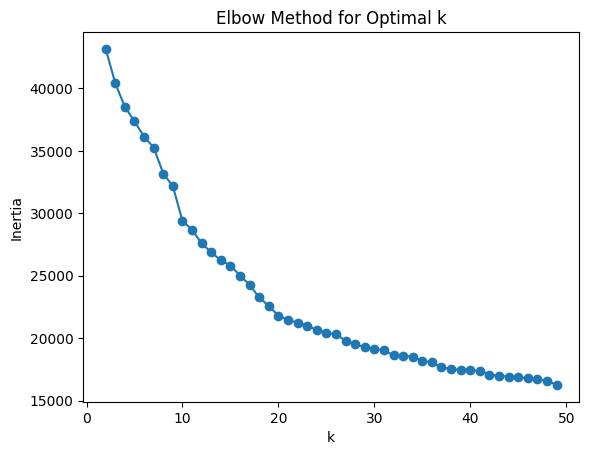

In [221]:
inertias = []
K = range(2, 50)
for k in K:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X_pca_df)
    inertias.append(kmeans.inertia_)

plt.plot(K, inertias, 'o-')
plt.xlabel('k')
plt.ylabel('Inertia')
plt.title('Elbow Method for Optimal k')
plt.show()

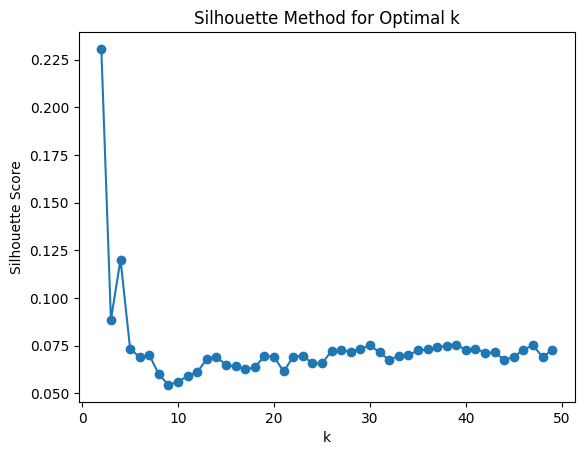

In [222]:
sil_scores = []
for k in K:
    kmeans = KMeans(n_clusters=k, random_state=42)
    labels = kmeans.fit_predict(X_scaled_df)
    sil_scores.append(silhouette_score(X_scaled_df, labels))

plt.plot(K, sil_scores, 'o-')
plt.xlabel('k')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Method for Optimal k')
plt.show()

Now HDBSCAN

In [223]:
clusterer = hdbscan.HDBSCAN(min_cluster_size=5, metric='euclidean')
labels_on_raw = clusterer.fit_predict(X_scaled_df)

/opt/miniconda3/envs/iw/lib/python3.13/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/miniconda3/envs/iw/lib/python3.13/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


In [224]:
# basic counts, including noise as -1
label_counts_raw = pd.Series(labels_on_raw).value_counts().sort_index()
print(label_counts_raw)

# number of non-noise clusters
cluster_ids = np.unique(labels_on_raw[labels_on_raw != -1])
n_clusters = len(cluster_ids)
print(f"Number of clusters (excluding noise): {n_clusters}")

# noise fraction
noise_frac = (labels_on_raw == -1).mean()
print(f"Noise fraction: {noise_frac:.2%}")

-1     226
 0       7
 1    1878
Name: count, dtype: int64
Number of clusters (excluding noise): 2
Noise fraction: 10.71%


HDBSCAN on PCA space

In [225]:
clusterer = hdbscan.HDBSCAN(min_cluster_size=5, metric='euclidean')
labels_on_pca = clusterer.fit_predict(X_pca_df)

/opt/miniconda3/envs/iw/lib/python3.13/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/miniconda3/envs/iw/lib/python3.13/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


In [226]:
labels = labels_on_pca

# basic counts, including noise as -1
label_counts = pd.Series(labels).value_counts().sort_index()
print(label_counts)

# number of non-noise clusters
cluster_ids = np.unique(labels[labels != -1])
n_clusters = len(cluster_ids)
print(f"Number of clusters (excluding noise): {n_clusters}")

# noise fraction
noise_frac = (labels == -1).mean()
print(f"Noise fraction: {noise_frac:.2%}")

-1     239
 0       7
 1    1865
Name: count, dtype: int64
Number of clusters (excluding noise): 2
Noise fraction: 11.32%


Now GMM on raw, standardized space

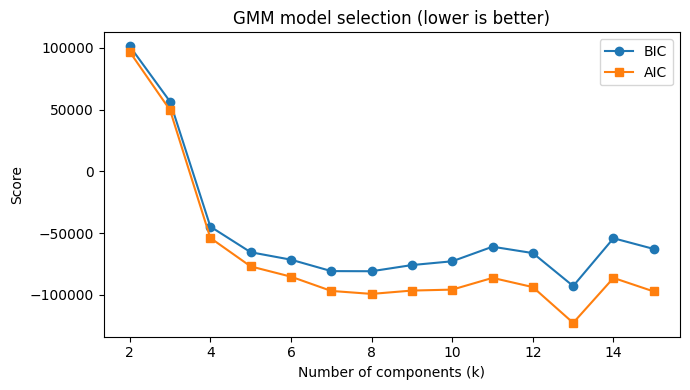

Best k by BIC: 13
Silhouette score (GMM on raw): 0.001418616135082288


In [227]:
n_components_range = range(2, 16)  # try 2–15 clusters
bics = []
aics = []

for k in n_components_range:
    gmm = GaussianMixture(
        n_components=k,
        covariance_type='full',
        random_state=42
    )
    gmm.fit(X_scaled_df)
    bics.append(gmm.bic(X_scaled_df))
    aics.append(gmm.aic(X_scaled_df))

# Plot BIC/AIC vs k
plt.figure(figsize=(7, 4))
plt.plot(n_components_range, bics, marker='o', label='BIC')
plt.plot(n_components_range, aics, marker='s', label='AIC')
plt.xlabel("Number of components (k)")
plt.ylabel("Score")
plt.title("GMM model selection (lower is better)")
plt.legend()
plt.tight_layout()
plt.show()

# Choose best_k by minimum BIC (could also use AIC)
best_k = list(n_components_range)[np.argmin(bics)]
print("Best k by BIC:", best_k)

gmm = GaussianMixture(
    n_components=best_k,
    covariance_type='full',
    n_init=5,        # multiple initializations for stability
    random_state=42
).fit(X_scaled_df)

cluster_labels = gmm.predict(X_scaled_df)        # hard assignments
cluster_probs = gmm.predict_proba(X_scaled_df)   # soft memberships

if len(np.unique(cluster_labels)) > 1:
    sil = silhouette_score(X_scaled_df, cluster_labels)
    print("Silhouette score (GMM on raw):", sil)
else:
    print("Only one cluster found; silhouette undefined.")

Now GMM on PCA space

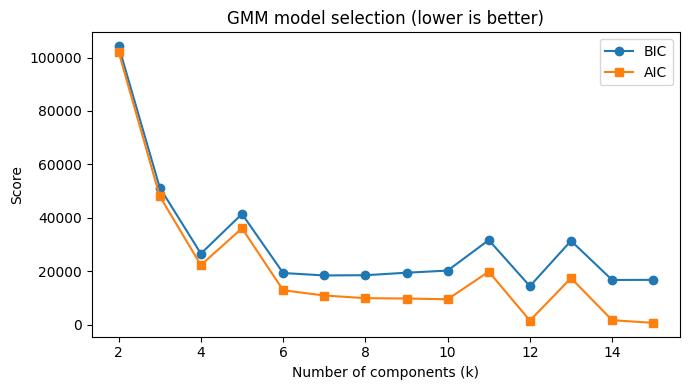

Best k by BIC: 12
Silhouette score (GMM on PCA): 0.01189552190075535


In [228]:
n_components_range = range(2, 16)  # try 2–15 clusters
bics = []
aics = []

for k in n_components_range:
    gmm = GaussianMixture(
        n_components=k,
        covariance_type='full',
        random_state=42
    )
    gmm.fit(X_pca_df)
    bics.append(gmm.bic(X_pca_df))
    aics.append(gmm.aic(X_pca_df))

# Plot BIC/AIC vs k
plt.figure(figsize=(7, 4))
plt.plot(n_components_range, bics, marker='o', label='BIC')
plt.plot(n_components_range, aics, marker='s', label='AIC')
plt.xlabel("Number of components (k)")
plt.ylabel("Score")
plt.title("GMM model selection (lower is better)")
plt.legend()
plt.tight_layout()
plt.show()

# Choose best_k by minimum BIC (could also use AIC)
best_k = list(n_components_range)[np.argmin(bics)]
print("Best k by BIC:", best_k)

gmm = GaussianMixture(
    n_components=best_k,
    covariance_type='full',
    n_init=5,        # multiple initializations for stability
    random_state=42
).fit(X_pca_df)

cluster_labels = gmm.predict(X_pca_df)        # hard assignments
cluster_probs = gmm.predict_proba(X_pca_df)   # soft memberships

if len(np.unique(cluster_labels)) > 1:
    sil = silhouette_score(X_pca_df, cluster_labels)
    print("Silhouette score (GMM on PCA):", sil)
else:
    print("Only one cluster found; silhouette undefined.")

Try clustering in subgroups now (righty starters, righty relievers, lefty starters, lefty relievers). ChatGPT was used to create functions here.

In [229]:
# masks for groups

meta_df = pitcher_season_df  # just for shorter code

mask_RS = (meta_df["role"] == "starter")  & (meta_df["p_throws"] == "R")
mask_LS = (meta_df["role"] == "starter")  & (meta_df["p_throws"] == "L")
mask_RR = (meta_df["role"] == "reliever") & (meta_df["p_throws"] == "R")
mask_LR = (meta_df["role"] == "reliever") & (meta_df["p_throws"] == "L")

print("RHP starters:",  mask_RS.sum())
print("LHP starters:",  mask_LS.sum())
print("RHP relievers:", mask_RR.sum())
print("LHP relievers:", mask_LR.sum())


RHP starters: 652
LHP starters: 267
RHP relievers: 913
LHP relievers: 279


In [230]:
def kmeans_cluster_group(
    X_df,
    meta_df,
    mask,
    label_col_name,
    n_clusters=4,
    random_state=42,
):
    """
    Run K-Means on a subset of rows defined by mask.
    - X_df: feature DataFrame (X_pca_df or X_scaled_df)
    - meta_df: pitcher_season_df (labels written here)
    - mask: boolean mask selecting one group (e.g. RHP starters)
    - label_col_name: new column in meta_df to hold labels
    """

    idx_group = meta_df.index[mask]
    X_group = X_df.loc[idx_group]

    if len(X_group) < n_clusters:
        print(f"{label_col_name}: not enough points (n={len(X_group)}) for k={n_clusters}. Skipping.")
        meta_df.loc[idx_group, label_col_name] = -1
        return None

    kmeans = KMeans(
        n_clusters=n_clusters,
        n_init=20,
        random_state=random_state,
    )
    labels = kmeans.fit_predict(X_group.values)

    meta_df.loc[idx_group, label_col_name] = labels

    # Optional: silhouette for this group
    if len(np.unique(labels)) > 1:
        sil = silhouette_score(X_group.values, labels)
        print(f"{label_col_name}: silhouette = {sil:.3f}")
    else:
        print(f"{label_col_name}: only one cluster found.")

    return kmeans


In [231]:
def hdbscan_cluster_group(
    X_df,
    meta_df,
    mask,
    label_col_name,
    min_cluster_size=5,
    metric="euclidean",
):
    """
    Run HDBSCAN on a subset of rows defined by mask.
    - X_df: feature DataFrame (X_pca_df or X_scaled_df)
    - meta_df: pitcher_season_df
    - mask: boolean mask selecting one group
    - label_col_name: new column for labels (HDBSCAN uses -1 for noise)
    """

    idx_group = meta_df.index[mask]
    X_group = X_df.loc[idx_group]

    if len(X_group) < min_cluster_size:
        print(f"{label_col_name}: not enough points (n={len(X_group)}) for min_cluster_size={min_cluster_size}. Skipping.")
        meta_df.loc[idx_group, label_col_name] = -1
        return None

    clusterer = hdbscan.HDBSCAN(
        min_cluster_size=min_cluster_size,
        metric=metric,
    )
    labels = clusterer.fit_predict(X_group.values)

    meta_df.loc[idx_group, label_col_name] = labels
    meta_df.loc[idx_group, label_col_name + "_prob"] = clusterer.probabilities_

    print(
        f"{label_col_name}: "
        f"{(labels != -1).sum()} clustered, "
        f"{(labels == -1).sum()} noise, "
        f"{len(np.unique(labels[labels != -1]))} clusters"
    )

    return clusterer


In [232]:
def gmm_cluster_group(
    X_df,
    meta_df,
    mask,
    label_col_name,
    n_components_range=range(2, 10),
    covariance_type="full",
    random_state=42,
):
    """
    Run GMM clustering on a subset of rows defined by mask.
    - X_df: feature DataFrame (X_pca_df or X_scaled_df)
    - meta_df: pitcher_season_df (will get a new column with labels)
    - mask: boolean mask selecting one group (e.g. RHP starters)
    - label_col_name: where to store cluster labels in meta_df
    """

    idx_group = meta_df.index[mask]
    X_group = X_df.loc[idx_group]

    n_samples = len(X_group)
    if n_samples < 2:
        print(f"Group {label_col_name} too small ({n_samples} rows). Skipping.")
        meta_df.loc[idx_group, label_col_name] = -1
        return None

    # Ensure k < n_samples
    k_range = [k for k in n_components_range if k < n_samples]
    if not k_range:
        print(f"No valid k for group {label_col_name} (n={n_samples}). Skipping.")
        meta_df.loc[idx_group, label_col_name] = -1
        return None

    X = X_group.values

    # Model selection via BIC
    bics = []
    for k in k_range:
        gmm = GaussianMixture(
            n_components=k,
            covariance_type=covariance_type,
            random_state=random_state,
        )
        gmm.fit(X)
        bics.append(gmm.bic(X))

    best_k = k_range[int(np.argmin(bics))]
    print(f"{label_col_name}: best k by BIC = {best_k}")

    gmm = GaussianMixture(
        n_components=best_k,
        covariance_type=covariance_type,
        n_init=5,
        random_state=random_state,
    ).fit(X)

    labels = gmm.predict(X)
    probs = gmm.predict_proba(X)
    conf = probs.max(axis=1)

    # Write back to meta_df
    meta_df.loc[idx_group, label_col_name] = labels
    meta_df.loc[idx_group, label_col_name + "_conf"] = conf

    # Optional: silhouette within this group
    if len(np.unique(labels)) > 1:
        sil = silhouette_score(X, labels)
        print(f"{label_col_name}: silhouette = {sil:.3f}")
    else:
        print(f"{label_col_name}: only one cluster found (k={best_k}).")

    return gmm

Raw, standardized space

In [233]:
X_features_raw = X_scaled_df

# K-MEANS (raw space)
kmeans_RS_pca = kmeans_cluster_group(
    X_df=X_features_raw,
    meta_df=pitcher_season_df,
    mask=mask_RS,
    label_col_name="cluster_kmeans_RS_raw",
    n_clusters=4,   # pick a starting k, tweak later
)

kmeans_LS_pca = kmeans_cluster_group(
    X_df=X_features_raw,
    meta_df=pitcher_season_df,
    mask=mask_LS,
    label_col_name="cluster_kmeans_LS_raw",
    n_clusters=4,
)

kmeans_RR_pca = kmeans_cluster_group(
    X_df=X_features_raw,
    meta_df=pitcher_season_df,
    mask=mask_RR,
    label_col_name="cluster_kmeans_RR_raw",
    n_clusters=4,
)

kmeans_LR_pca = kmeans_cluster_group(
    X_df=X_features_raw,
    meta_df=pitcher_season_df,
    mask=mask_LR,
    label_col_name="cluster_kmeans_LR_raw",
    n_clusters=4,
)

# HDBSCAN (raw space)
hdb_RS_pca = hdbscan_cluster_group(
    X_df=X_features_raw,
    meta_df=pitcher_season_df,
    mask=mask_RS,
    label_col_name="cluster_hdbscan_RS_raw",
    min_cluster_size=5,
)

hdb_LS_pca = hdbscan_cluster_group(
    X_df=X_features_raw,
    meta_df=pitcher_season_df,
    mask=mask_LS,
    label_col_name="cluster_hdbscan_LS_raw",
    min_cluster_size=5,
)

hdb_RR_pca = hdbscan_cluster_group(
    X_df=X_features_raw,
    meta_df=pitcher_season_df,
    mask=mask_RR,
    label_col_name="cluster_hdbscan_RR_raw",
    min_cluster_size=5,
)

hdb_LR_pca = hdbscan_cluster_group(
    X_df=X_features_raw,
    meta_df=pitcher_season_df,
    mask=mask_LR,
    label_col_name="cluster_hdbscan_LR_raw",
    min_cluster_size=5,
)


cluster_kmeans_RS_raw: silhouette = 0.154
cluster_kmeans_LS_raw: silhouette = 0.114
cluster_kmeans_RR_raw: silhouette = 0.097
cluster_kmeans_LR_raw: silhouette = 0.183
cluster_hdbscan_RS_raw: 262 clustered, 390 noise, 2 clusters
cluster_hdbscan_LS_raw: 49 clustered, 218 noise, 3 clusters
cluster_hdbscan_RR_raw: 641 clustered, 272 noise, 5 clusters
cluster_hdbscan_LR_raw: 274 clustered, 5 noise, 2 clusters


/opt/miniconda3/envs/iw/lib/python3.13/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/miniconda3/envs/iw/lib/python3.13/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/miniconda3/envs/iw/lib/python3.13/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/miniconda3/envs/iw/lib/python3.13/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/miniconda3/envs/iw/lib/python3.13/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and w

PCA space

In [234]:
X_features_pca = X_pca_df  # 19 PCs (in original experiment), same index as pitcher_season_df

# K-MEANS (PCA space)
kmeans_RS_pca = kmeans_cluster_group(
    X_df=X_features_pca,
    meta_df=pitcher_season_df,
    mask=mask_RS,
    label_col_name="cluster_kmeans_RS_pca",
    n_clusters=4,   # pick a starting k, tweak later
)

kmeans_LS_pca = kmeans_cluster_group(
    X_df=X_features_pca,
    meta_df=pitcher_season_df,
    mask=mask_LS,
    label_col_name="cluster_kmeans_LS_pca",
    n_clusters=4,
)

kmeans_RR_pca = kmeans_cluster_group(
    X_df=X_features_pca,
    meta_df=pitcher_season_df,
    mask=mask_RR,
    label_col_name="cluster_kmeans_RR_pca",
    n_clusters=4,
)

kmeans_LR_pca = kmeans_cluster_group(
    X_df=X_features_pca,
    meta_df=pitcher_season_df,
    mask=mask_LR,
    label_col_name="cluster_kmeans_LR_pca",
    n_clusters=4,
)

# HDBSCAN (PCA space)
hdb_RS_pca = hdbscan_cluster_group(
    X_df=X_features_pca,
    meta_df=pitcher_season_df,
    mask=mask_RS,
    label_col_name="cluster_hdbscan_RS_pca",
    min_cluster_size=5,
)

hdb_LS_pca = hdbscan_cluster_group(
    X_df=X_features_pca,
    meta_df=pitcher_season_df,
    mask=mask_LS,
    label_col_name="cluster_hdbscan_LS_pca",
    min_cluster_size=5,
)

hdb_RR_pca = hdbscan_cluster_group(
    X_df=X_features_pca,
    meta_df=pitcher_season_df,
    mask=mask_RR,
    label_col_name="cluster_hdbscan_RR_pca",
    min_cluster_size=5,
)

hdb_LR_pca = hdbscan_cluster_group(
    X_df=X_features_pca,
    meta_df=pitcher_season_df,
    mask=mask_LR,
    label_col_name="cluster_hdbscan_LR_pca",
    min_cluster_size=5,
)


# GMM (PCA space)
gmm_RS = gmm_cluster_group(
    X_df=X_features_pca,
    meta_df=pitcher_season_df,
    mask=mask_RS,
    label_col_name="cluster_gmm_RS_pca",
)

gmm_LS = gmm_cluster_group(
    X_df=X_features_pca,
    meta_df=pitcher_season_df,
    mask=mask_LS,
    label_col_name="cluster_gmm_LS_pca",
)

gmm_RR = gmm_cluster_group(
    X_df=X_features_pca,
    meta_df=pitcher_season_df,
    mask=mask_RR,
    label_col_name="cluster_gmm_RR_pca",
)

gmm_LR = gmm_cluster_group(
    X_df=X_features_pca,
    meta_df=pitcher_season_df,
    mask=mask_LR,
    label_col_name="cluster_gmm_LR_pca",
)



cluster_kmeans_RS_pca: silhouette = 0.168
cluster_kmeans_LS_pca: silhouette = 0.141
cluster_kmeans_RR_pca: silhouette = 0.097
cluster_kmeans_LR_pca: silhouette = 0.225
cluster_hdbscan_RS_pca: 274 clustered, 378 noise, 2 clusters
cluster_hdbscan_LS_pca: 83 clustered, 184 noise, 3 clusters
cluster_hdbscan_RR_pca: 682 clustered, 231 noise, 4 clusters
cluster_hdbscan_LR_pca: 274 clustered, 5 noise, 2 clusters


/opt/miniconda3/envs/iw/lib/python3.13/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/miniconda3/envs/iw/lib/python3.13/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/miniconda3/envs/iw/lib/python3.13/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/miniconda3/envs/iw/lib/python3.13/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/miniconda3/envs/iw/lib/python3.13/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and w

cluster_gmm_RS_pca: best k by BIC = 5
cluster_gmm_RS_pca: silhouette = 0.015
cluster_gmm_LS_pca: best k by BIC = 4
cluster_gmm_LS_pca: silhouette = 0.077
cluster_gmm_RR_pca: best k by BIC = 4
cluster_gmm_RR_pca: silhouette = 0.011
cluster_gmm_LR_pca: best k by BIC = 6
cluster_gmm_LR_pca: silhouette = 0.059


Now it's time to train an autoencoder to make a new similarity engine

In [235]:
# ChatGPT helped make this function
def self_season_retrieval_score(
    Z_df,
    meta_df,
    k=5,                      # you’re using 5 now
    max_year_diff=3,
    name_col="pitcher_name",
    year_col="year",
):
    """
    For each *eligible* pitcher-season (one that has at least one other
    season of the same pitcher within max_year_diff years), look at its
    top-k neighbors (excluding itself) and see if any neighbor is another
    season of the same pitcher (respecting max_year_diff).

    Returns:
        hit_rate:  hits / num_eligible
        mrr:       mean reciprocal rank over eligible rows
        num_eligible: number of pitcher-seasons that could possibly have a hit
    """
    Z = Z_df.values
    # L2 normalize for cosine similarity
    Z_norm = Z / np.linalg.norm(Z, axis=1, keepdims=True)
    sims = Z_norm @ Z_norm.T  # n x n cosine similarity matrix

    names = meta_df[name_col].values
    years = meta_df[year_col].values

    n = Z.shape[0]

    # ---- 1. Compute which rows are eligible ----
    eligible = np.zeros(n, dtype=bool)
    for i in range(n):
        same_name = (names == names[i])
        same_name[i] = False  # exclude self
        if max_year_diff is not None:
            same_name = same_name & (np.abs(years - years[i]) <= max_year_diff)
        if same_name.any():
            eligible[i] = True

    eligible_idx = np.where(eligible)[0]
    num_eligible = len(eligible_idx)

    if num_eligible == 0:
        # No one has multiple seasons; metric isn't defined
        return float("nan"), float("nan"), 0

    # ---- 2. Compute hit@k and MRR over *eligible* only ----
    hits = 0
    rr_sum = 0.0

    for i in eligible_idx:
        sim_row = sims[i].copy()
        sim_row[i] = -np.inf  # exclude self
        nn_idx = np.argsort(-sim_row)[:k]  # top-k neighbors

        found_rank = None
        for rank, j in enumerate(nn_idx, start=1):
            if names[j] != names[i]:
                continue
            if max_year_diff is not None:
                if abs(years[j] - years[i]) > max_year_diff:
                    continue
            found_rank = rank
            break

        if found_rank is not None:
            hits += 1
            rr_sum += 1.0 / found_rank

    hit_rate = hits / num_eligible
    mrr = rr_sum / num_eligible

    return hit_rate, mrr, num_eligible


In [236]:
# Convert to tensor
X_np = X_scaled_df.values.astype("float32")
X_train, X_val = train_test_split(X_np, test_size=0.1, random_state=42)

X_train_t = torch.tensor(X_train, dtype=torch.float32)
X_val_t   = torch.tensor(X_val,   dtype=torch.float32)

train_ds = TensorDataset(X_train_t)
val_ds   = TensorDataset(X_val_t)

train_loader = DataLoader(train_ds, batch_size=64, shuffle=True)
val_loader   = DataLoader(val_ds,   batch_size=64, shuffle=False)

input_dim = X_scaled_df.shape[1]

In [237]:
# ChatGPT gave recommendations for architecture (testing dropout and batch normalization)
class Autoencoder(nn.Module):
    def __init__(self, input_dim, latent_dim=15, hidden_dims=(128, 64), dropout=0.1):
        super().__init__()
        h1, h2 = hidden_dims
        self.encoder = nn.Sequential(
            nn.Linear(input_dim, h1),
            nn.BatchNorm1d(h1),
            nn.ReLU(),
            nn.Dropout(dropout),
            nn.Linear(h1, h2),
            nn.BatchNorm1d(h2),
            nn.ReLU(),
            nn.Dropout(dropout),
            nn.Linear(h2, latent_dim),
        )
        self.decoder = nn.Sequential(
            nn.Linear(latent_dim, h2),
            nn.BatchNorm1d(h2),
            nn.ReLU(),
            nn.Dropout(dropout),
            nn.Linear(h2, h1),
            nn.BatchNorm1d(h1),
            nn.ReLU(),
            nn.Dropout(dropout),
            nn.Linear(h1, input_dim),
        )

    def encode(self, x):
        z = self.encoder(x)
        z_norm = F.normalize(z, dim=-1)
        return z_norm

    def forward(self, x):
        z = self.encoder(x)
        z_norm = F.normalize(z, dim=-1)
        x_hat = self.decoder(z)     # decode from unnormalized z
        return x_hat, z_norm


In [238]:
model = Autoencoder(input_dim, latent_dim=15, hidden_dims=(128, 64), dropout=0.1)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3, weight_decay=1e-5)

In [239]:
# training for hyperparameter tuning
def train_autoencoder_once(
    input_dim,
    train_ds,
    val_ds,
    latent_dim=15,
    hidden_dims=(128, 64),
    dropout=0.1,
    lr=1e-3,
    weight_decay=1e-5,
    batch_size=64,
    n_epochs=50,
    patience=8,
    device=device,
):
    train_loader = DataLoader(train_ds, batch_size=batch_size, shuffle=True)
    val_loader   = DataLoader(val_ds,   batch_size=batch_size, shuffle=False)

    model = Autoencoder(
        input_dim=input_dim,
        latent_dim=latent_dim,
        hidden_dims=hidden_dims,
        dropout=dropout,
    ).to(device)

    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(
        model.parameters(),
        lr=lr,
        weight_decay=weight_decay,
    )

    best_val_loss = math.inf
    best_state = None
    no_improve_epochs = 0

    for epoch in range(1, n_epochs + 1):
        # ---- Train ----
        model.train()
        train_loss = 0.0
        for (batch,) in train_loader:
            batch = batch.to(device)
            optimizer.zero_grad()
            recon, _ = model(batch)
            loss = criterion(recon, batch)
            loss.backward()
            optimizer.step()
            train_loss += loss.item() * batch.size(0)

        train_loss /= len(train_ds)

        # ---- Validation ----
        model.eval()
        val_loss = 0.0
        with torch.no_grad():
            for (batch,) in val_loader:
                batch = batch.to(device)
                recon, _ = model(batch)
                loss = criterion(recon, batch)
                val_loss += loss.item() * batch.size(0)
        val_loss /= len(val_ds)

        # early stopping bookkeeping
        if val_loss < best_val_loss - 1e-5:
            best_val_loss = val_loss
            best_state = copy.deepcopy(model.state_dict())
            no_improve_epochs = 0
        else:
            no_improve_epochs += 1

        # print some progress
        print(
            f"[latent={latent_dim}, hidden={hidden_dims}, drop={dropout:.2f}] "
            f"Epoch {epoch:02d} | train={train_loss:.6f} | val={val_loss:.6f}"
        )

        if no_improve_epochs >= patience:
            print("  Early stopping.")
            break

    if best_state is not None:
        model.load_state_dict(best_state)

    return best_val_loss, model


In [240]:
# ChatGPT helped with hyperparameter grid search
latent_dims   = [8, 10, 12, 15, 20]
hidden_options = [(128, 64), (256, 128)]
dropouts      = [0.0, 0.1]
weight_decays = [1e-5, 1e-4]

results = []

for ld, hd, d, wd in product(latent_dims, hidden_options, dropouts, weight_decays):
    print("=" * 80)
    print(f"Config: latent_dim={ld}, hidden_dims={hd}, dropout={d}, weight_decay={wd}")
    
    # 1) Train AE for this config
    val_loss, model = train_autoencoder_once(
        input_dim=input_dim,
        train_ds=train_ds,
        val_ds=val_ds,
        latent_dim=ld,
        hidden_dims=hd,
        dropout=d,
        weight_decay=wd,
        lr=1e-3,
        n_epochs=50,
        batch_size=64,
        patience=8,
        device=device,
    )

    # 2) Get latent embeddings for *all* pitcher-seasons
    model.eval()
    with torch.no_grad():
        X_all_t = torch.tensor(
            X_scaled_df.values.astype("float32"),
            device=device,
        )
        # use encode() to get normalized embeddings
        Z = model.encode(X_all_t)
        Z_np = Z.cpu().numpy()

    X_ae_df = pd.DataFrame(
        Z_np,
        index=X_scaled_df.index,
        columns=[f"AE{i+1}" for i in range(ld)],
    )

    # 3) Compute self-season retrieval scores
    hit5, mrr5, n_elig = self_season_retrieval_score(
        X_ae_df,
        pitcher_season_df,
        k=5,
        max_year_diff=3,
        name_col="name",
        year_col="game_year",
    )

    print(
    f"  val_loss={val_loss:.6f} | self_hit@5={hit5:.3f} | "
    f"self_MRR={mrr5:.3f} | eligible={n_elig}"
    )

    results.append({
        "latent_dim": ld,
        "hidden_dims": hd,
        "dropout": d,
        "weight_decay": wd,
        "val_loss": val_loss,
        "self_hit@5": hit5,
        "self_MRR": mrr5,
        "num_eligible": n_elig,
    })

results_df = pd.DataFrame(results)


Config: latent_dim=8, hidden_dims=(128, 64), dropout=0.0, weight_decay=1e-05
[latent=8, hidden=(128, 64), drop=0.00] Epoch 01 | train=0.816163 | val=0.621288
[latent=8, hidden=(128, 64), drop=0.00] Epoch 02 | train=0.581209 | val=0.446298
[latent=8, hidden=(128, 64), drop=0.00] Epoch 03 | train=0.501603 | val=0.390365
[latent=8, hidden=(128, 64), drop=0.00] Epoch 04 | train=0.457966 | val=0.359571
[latent=8, hidden=(128, 64), drop=0.00] Epoch 05 | train=0.427374 | val=0.335924
[latent=8, hidden=(128, 64), drop=0.00] Epoch 06 | train=0.407539 | val=0.321403
[latent=8, hidden=(128, 64), drop=0.00] Epoch 07 | train=0.378451 | val=0.304594
[latent=8, hidden=(128, 64), drop=0.00] Epoch 08 | train=0.359917 | val=0.286782
[latent=8, hidden=(128, 64), drop=0.00] Epoch 09 | train=0.351318 | val=0.280714
[latent=8, hidden=(128, 64), drop=0.00] Epoch 10 | train=0.332383 | val=0.273503
[latent=8, hidden=(128, 64), drop=0.00] Epoch 11 | train=0.326664 | val=0.275142
[latent=8, hidden=(128, 64), dro

In [241]:
# sort by val_loss ascending, then MRR descending
display(
    results_df.sort_values(
        by=["val_loss", "self_MRR"],
        ascending=[True, False],
    )
)

,latent_dim,hidden_dims,dropout,weight_decay,val_loss,self_hit@5,self_MRR,num_eligible
36,20,"(256, 128)",0.0,0.00001,0.050666,0.812754,0.731990,1725
37,20,"(256, 128)",0.0,0.00010,0.055009,0.818551,0.735923,1725
38,20,"(256, 128)",0.1,0.00001,0.076067,0.812174,0.723430,1725
29,15,"(256, 128)",0.0,0.00010,0.076736,0.791884,0.700329,1725
39,20,"(256, 128)",0.1,0.00010,0.077276,0.806957,0.722522,1725
28,15,"(256, 128)",0.0,0.00001,0.078827,0.800580,0.711072,1725
33,20,"(128, 64)",0.0,0.00010,0.079376,0.804058,0.712106,1725
32,20,"(128, 64)",0.0,0.00001,0.080264,0.801739,0.704889,1725
25,15,"(128, 64)",0.0,0.00010,0.099190,0.765217,0.673884,1725
24,15,"(128, 64)",0.0,0.00001,0.103749,0.764638,0.670222,1725


In [242]:
best_row = results_df.sort_values(
        by=["val_loss", "self_MRR"],
        ascending=[True, False],
    ).iloc[0]
ld = best_row['latent_dim']
hd = best_row['hidden_dims']
d = best_row['dropout']
wd = best_row['weight_decay']

val_loss, model = train_autoencoder_once(
        input_dim=input_dim,
        train_ds=train_ds,
        val_ds=val_ds,
        latent_dim=ld,
        hidden_dims=hd,
        dropout=d,
        weight_decay=wd,
        lr=1e-3,
        n_epochs=50,
        batch_size=64,
        patience=8,
        device=device,
)


[latent=20, hidden=(256, 128), drop=0.00] Epoch 01 | train=0.641849 | val=0.388668
[latent=20, hidden=(256, 128), drop=0.00] Epoch 02 | train=0.390744 | val=0.225410
[latent=20, hidden=(256, 128), drop=0.00] Epoch 03 | train=0.306990 | val=0.182714
[latent=20, hidden=(256, 128), drop=0.00] Epoch 04 | train=0.265201 | val=0.157072
[latent=20, hidden=(256, 128), drop=0.00] Epoch 05 | train=0.225358 | val=0.138305
[latent=20, hidden=(256, 128), drop=0.00] Epoch 06 | train=0.193173 | val=0.115830
[latent=20, hidden=(256, 128), drop=0.00] Epoch 07 | train=0.171582 | val=0.116122
[latent=20, hidden=(256, 128), drop=0.00] Epoch 08 | train=0.158515 | val=0.100306
[latent=20, hidden=(256, 128), drop=0.00] Epoch 09 | train=0.140310 | val=0.095496
[latent=20, hidden=(256, 128), drop=0.00] Epoch 10 | train=0.127139 | val=0.089824
[latent=20, hidden=(256, 128), drop=0.00] Epoch 11 | train=0.119653 | val=0.091544
[latent=20, hidden=(256, 128), drop=0.00] Epoch 12 | train=0.112031 | val=0.078004
[lat

In [243]:
model.eval()
with torch.no_grad():
    X_all_t = torch.tensor(
        X_scaled_df.values.astype("float32"),
        device=device
    )
    _, Z = model(X_all_t)
    Z_np = Z.cpu().numpy()

latent_dim = Z_np.shape[1]
X_ae_df = pd.DataFrame(
    Z_np,
    index=X_scaled_df.index,
    columns=[f"AE{i+1}" for i in range(latent_dim)],
)


/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


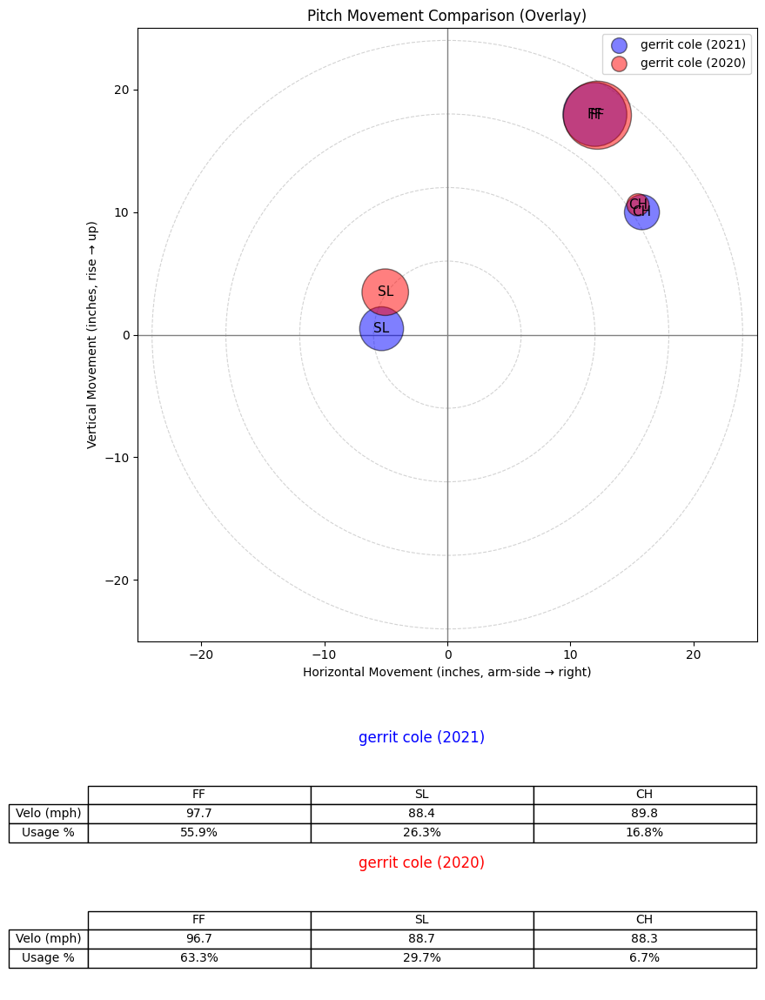

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


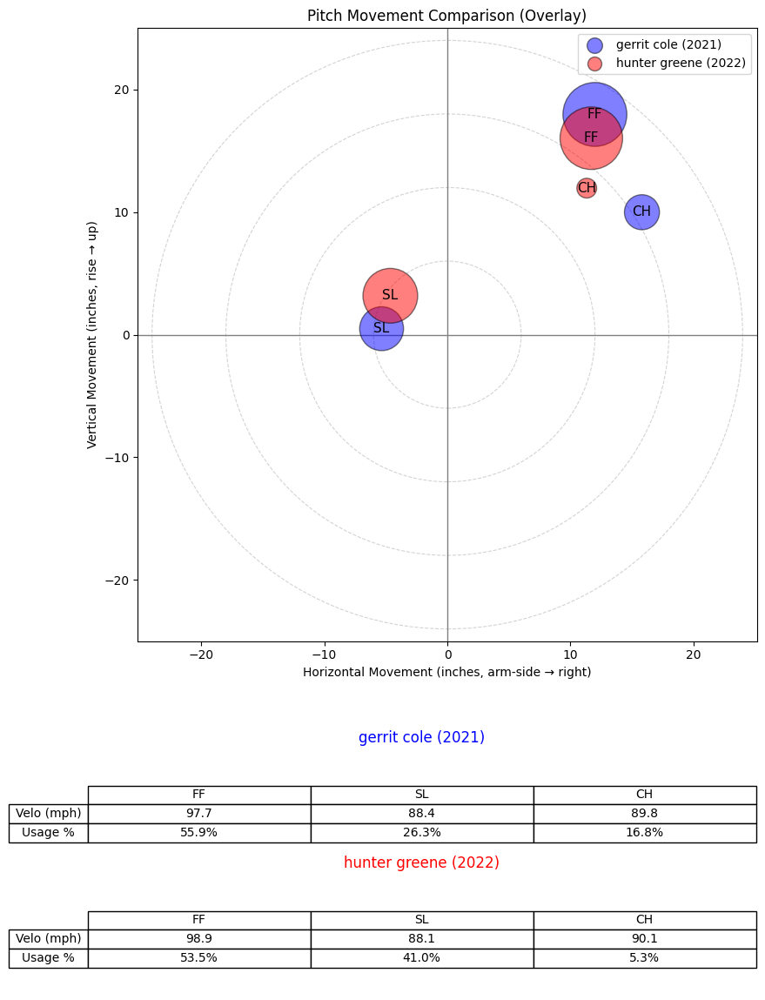

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


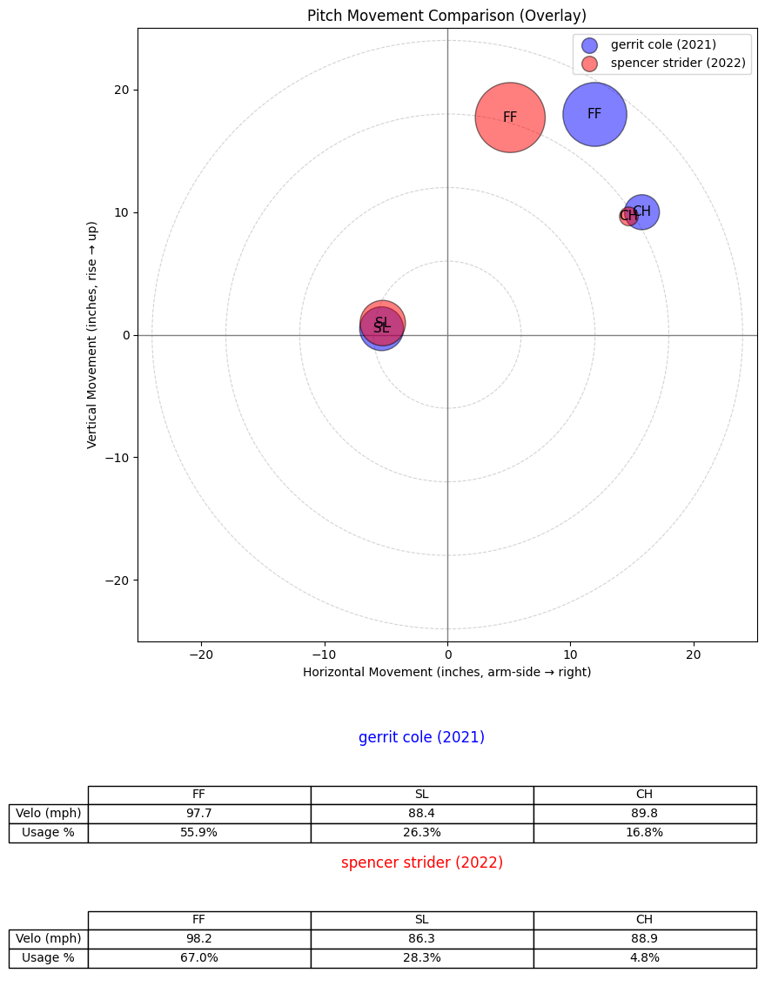

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


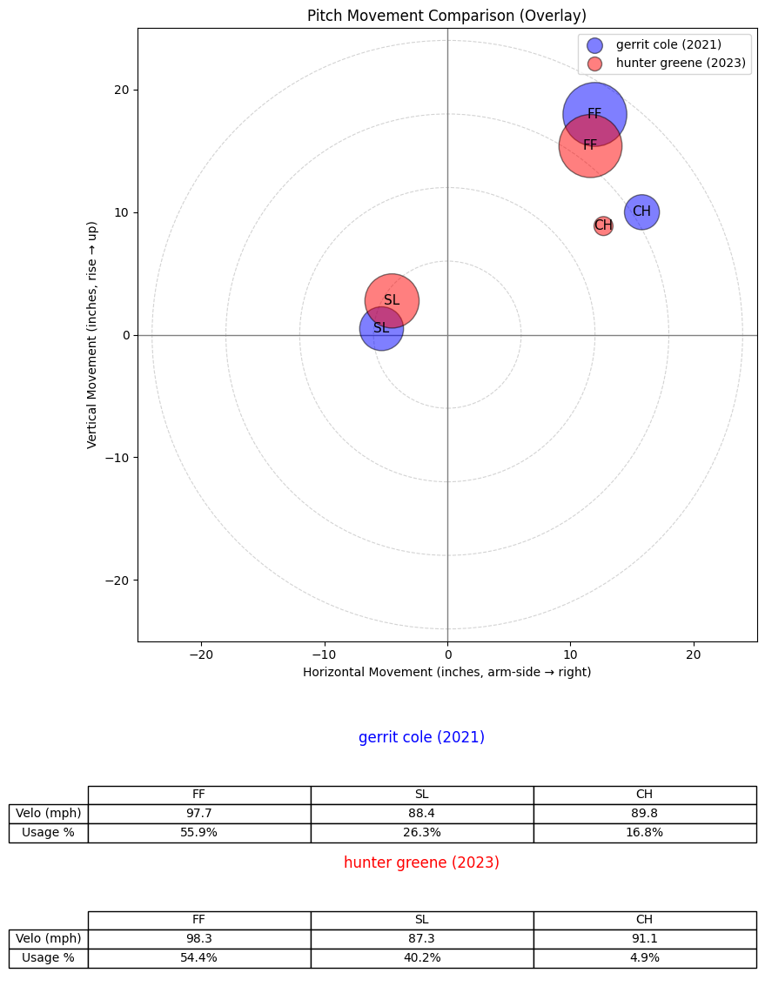

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


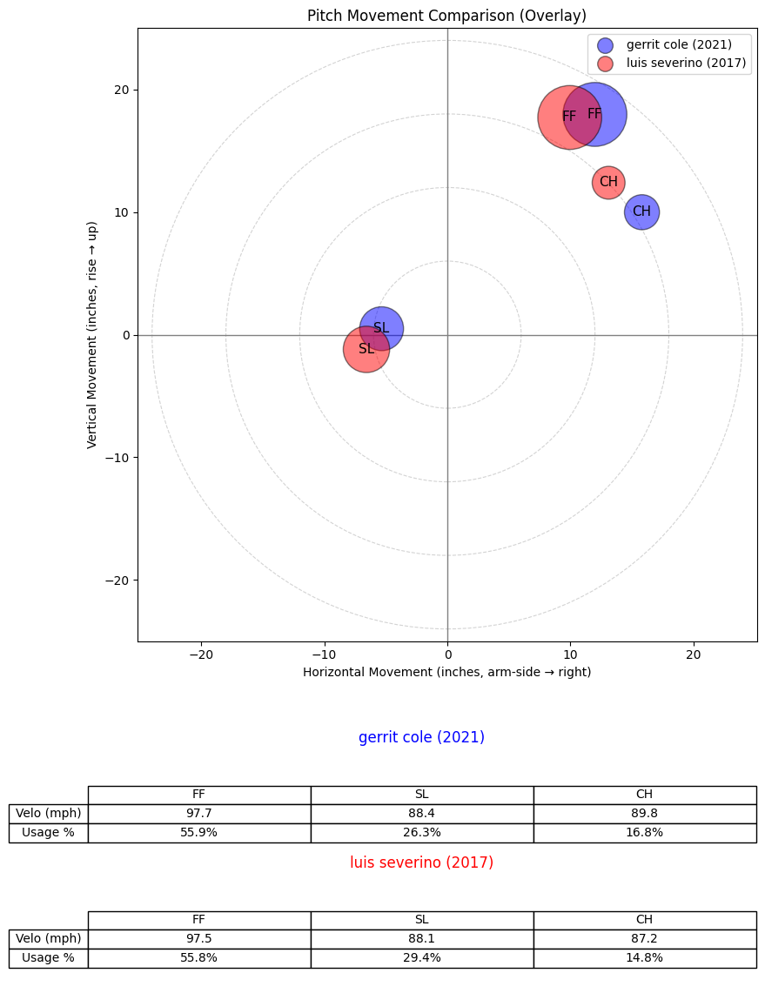

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
535,543037.0,2020,gerrit cole,gerrit,cole,R,starter,0.932545
1925,668881.0,2022,hunter greene,hunter,greene,R,starter,0.924923
2024,675911.0,2022,spencer strider,spencer,strider,R,starter,0.917694
1926,668881.0,2023,hunter greene,hunter,greene,R,starter,0.904683
1388,622663.0,2017,luis severino,luis,severino,R,starter,0.876928


In [244]:
# Checking autoencoder
neighbors_same_ae = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="gerrit cole",
    year=2021,
    X_df=X_ae_df,               # <- autoencoder space
    meta_df=pitcher_season_df,
    n_neighbors=5,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same_ae)

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


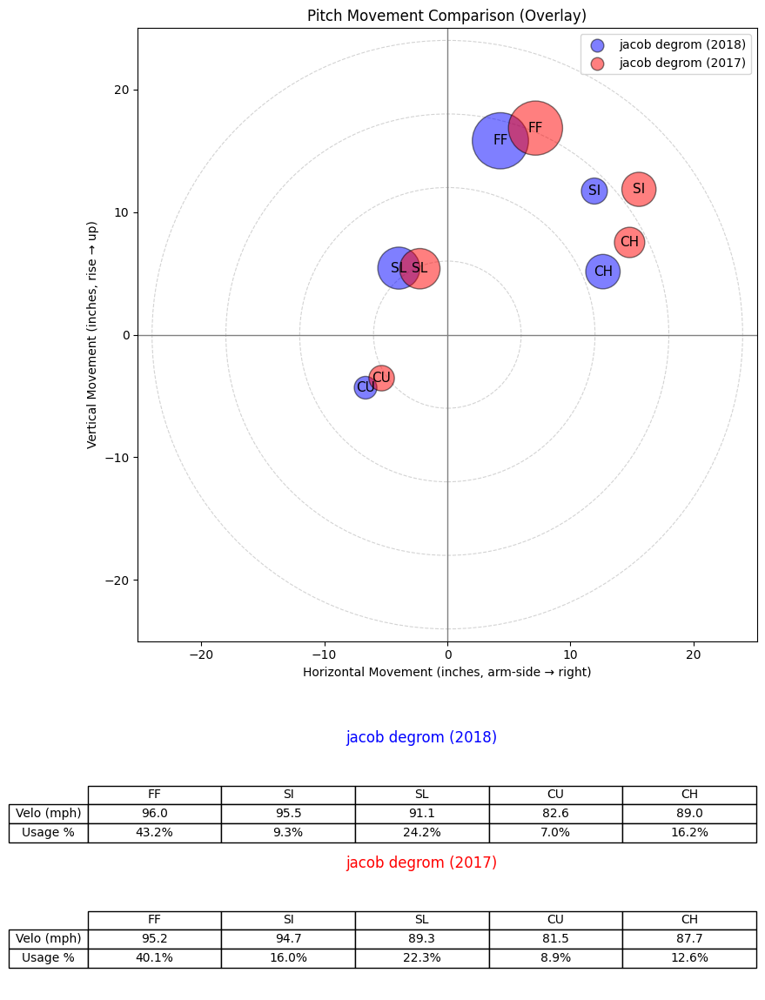

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


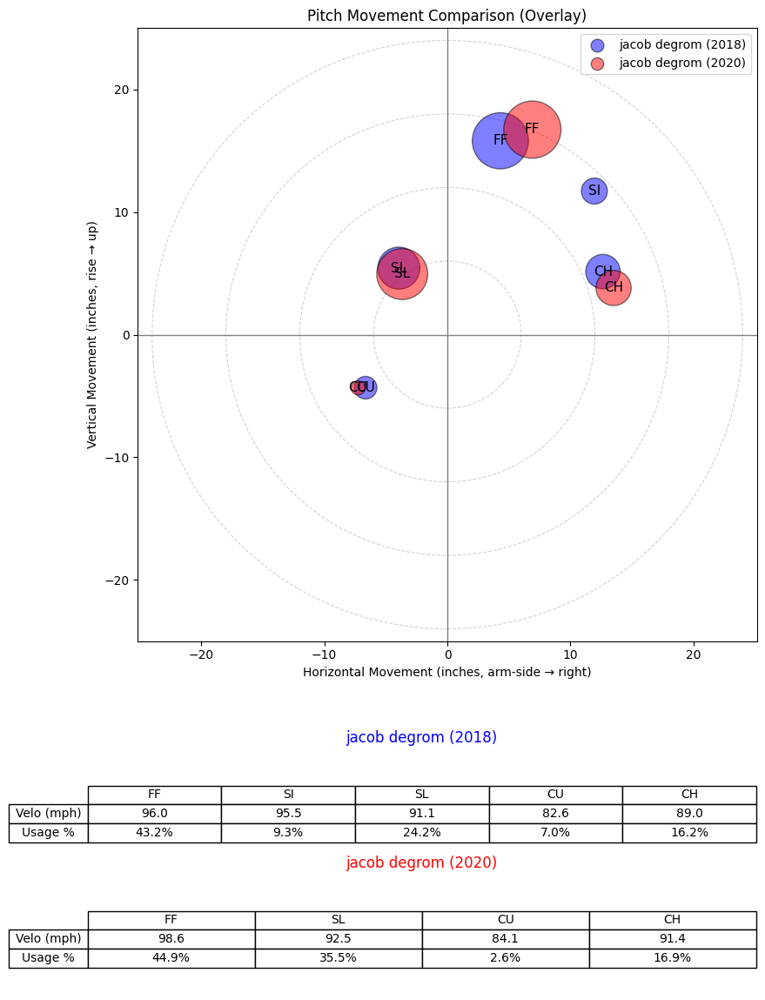

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


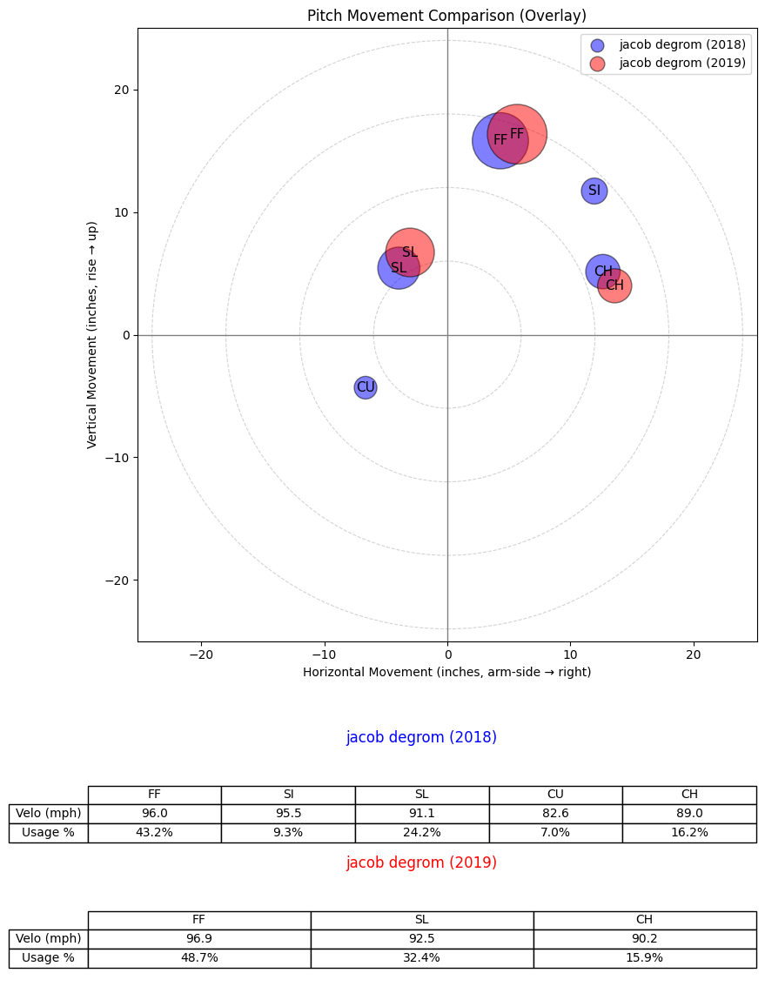

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


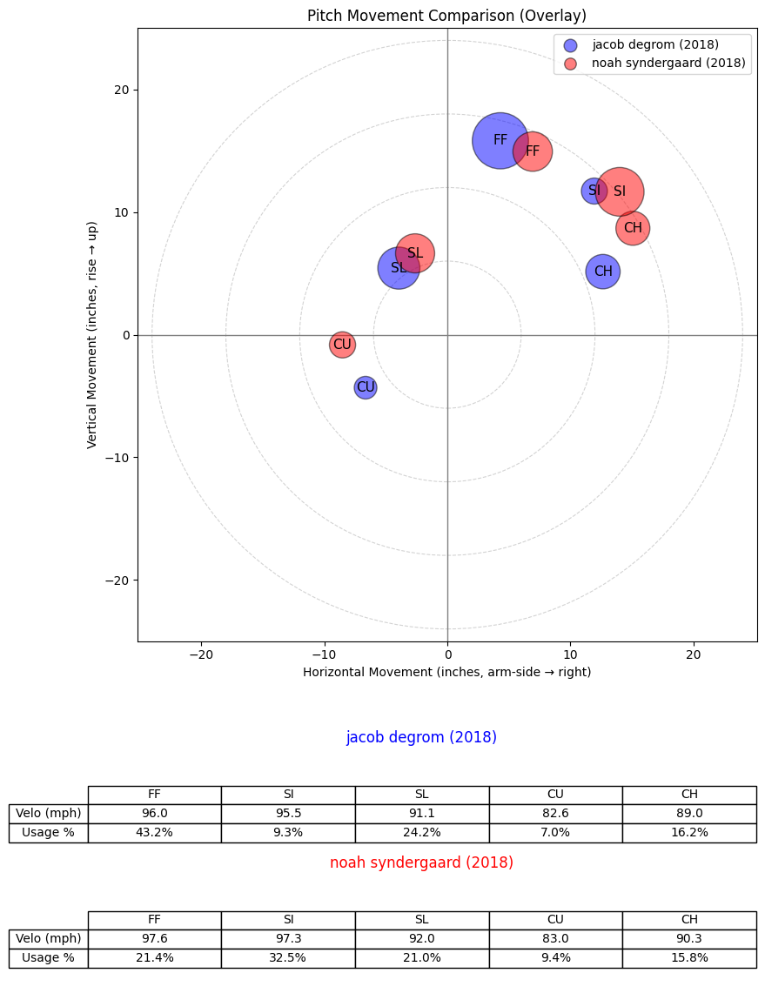

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


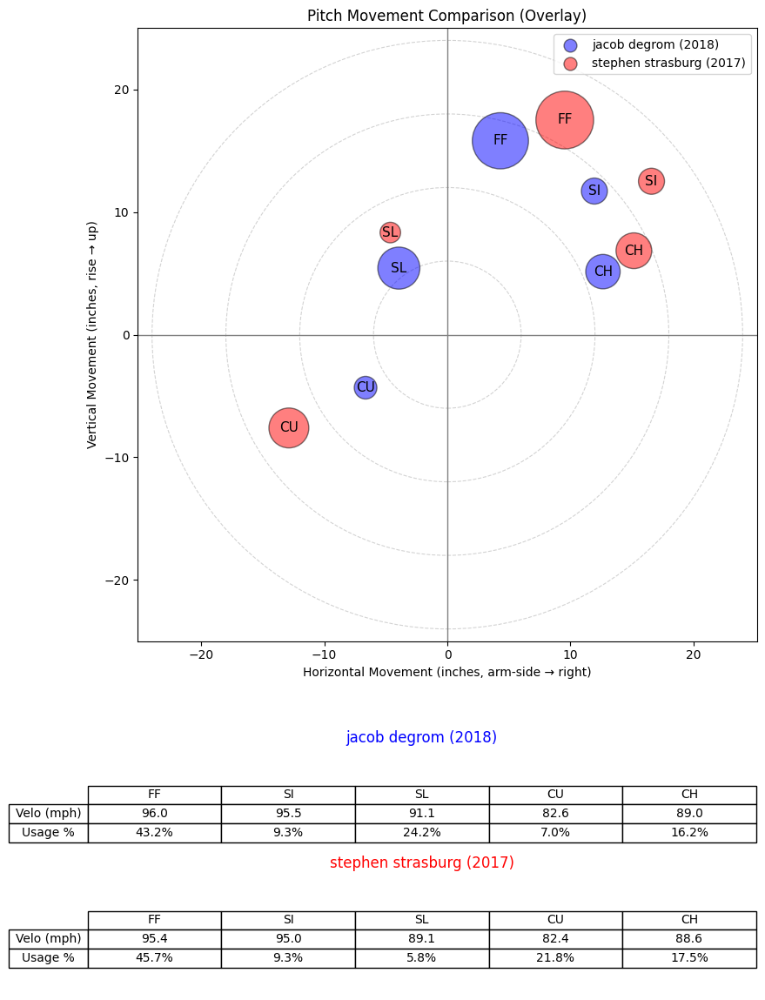

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
954,594798.0,2017,jacob degrom,jacob,degrom,R,starter,0.925936
957,594798.0,2020,jacob degrom,jacob,degrom,R,starter,0.887104
956,594798.0,2019,jacob degrom,jacob,degrom,R,starter,0.785998
891,592789.0,2018,noah syndergaard,noah,syndergaard,R,starter,0.741728
634,544931.0,2017,stephen strasburg,stephen,strasburg,R,starter,0.722422


In [245]:
neighbors_same_ae = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="jacob degrom",
    year=2018,
    X_df=X_ae_df,               # <- autoencoder space
    meta_df=pitcher_season_df,
    n_neighbors=5,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same_ae)

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


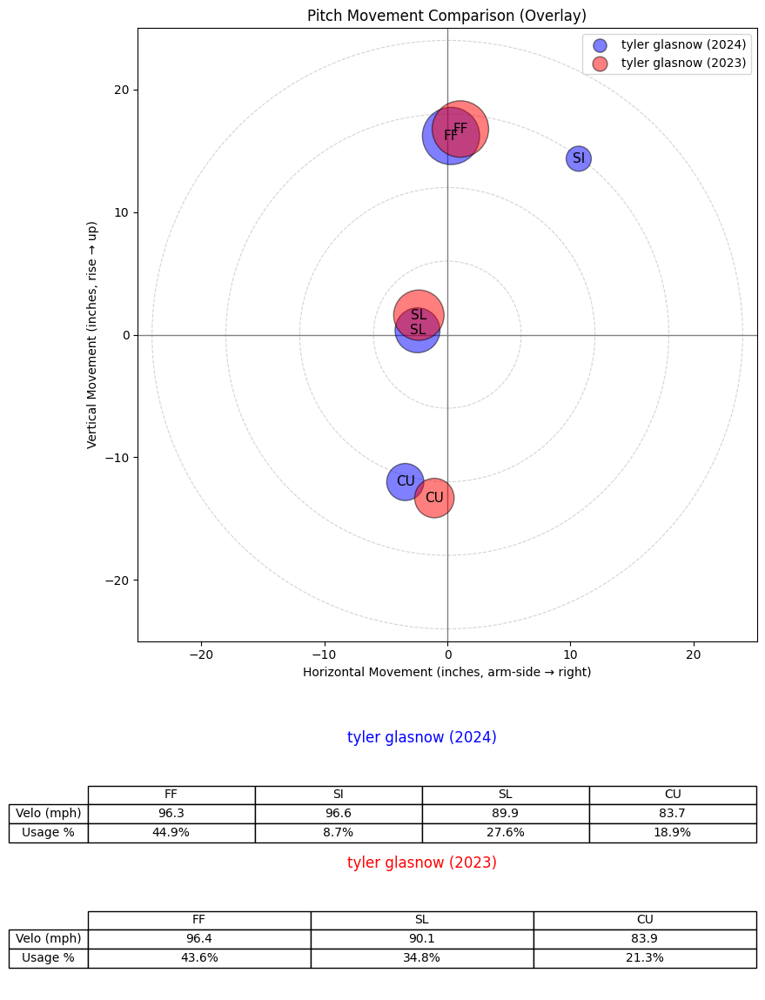

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


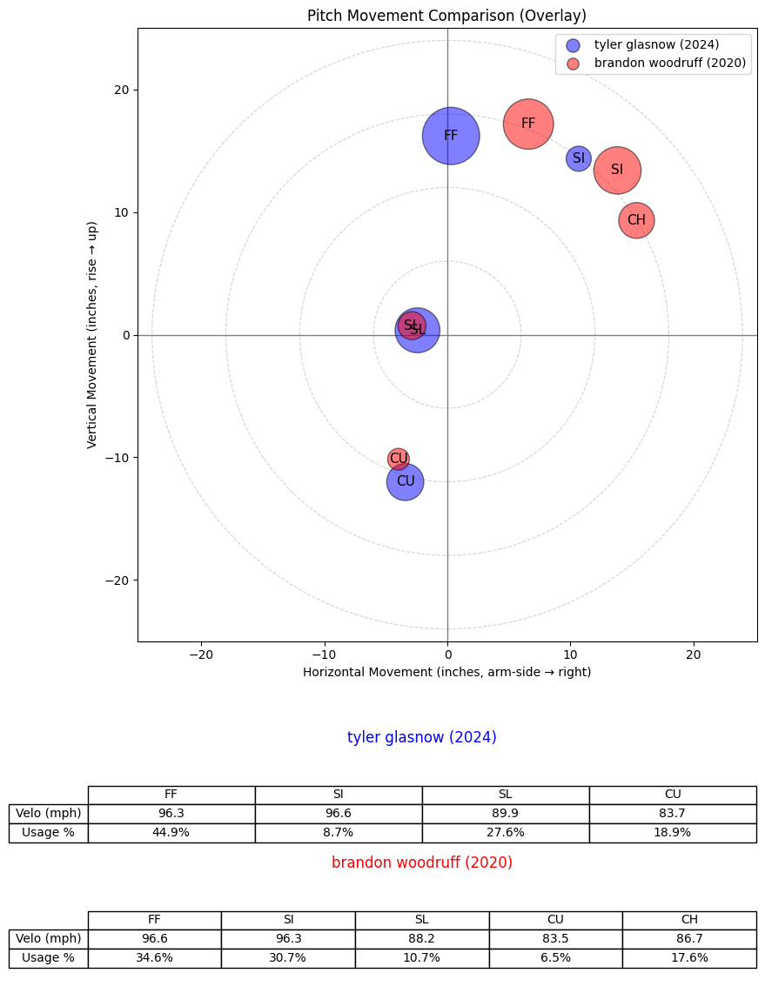

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


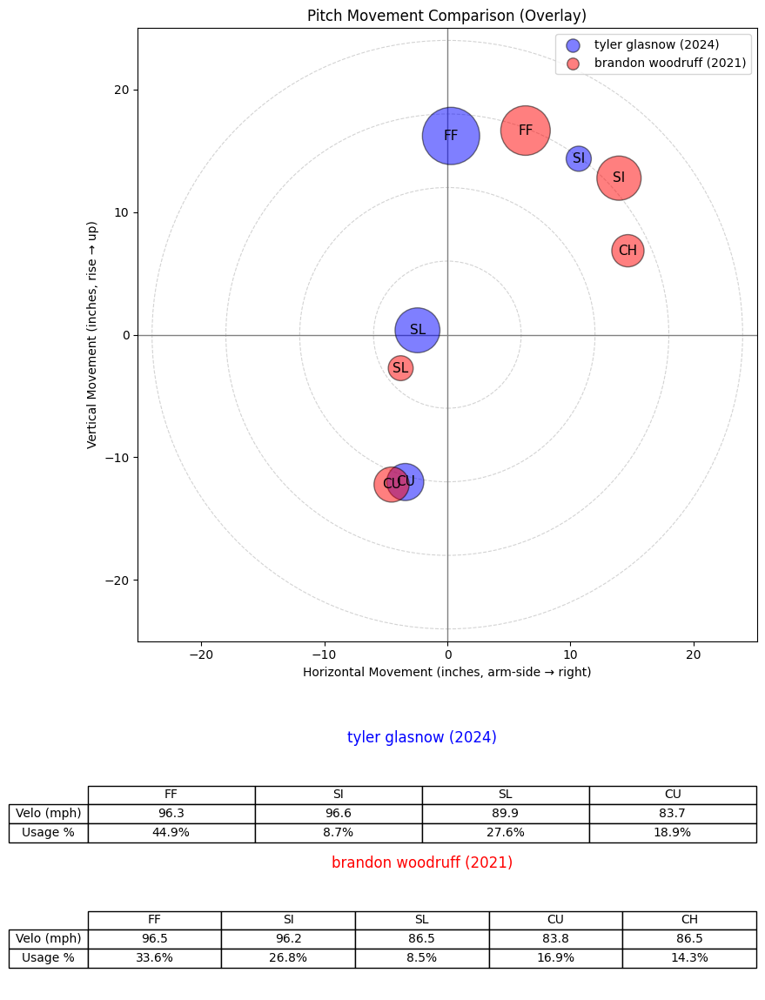

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


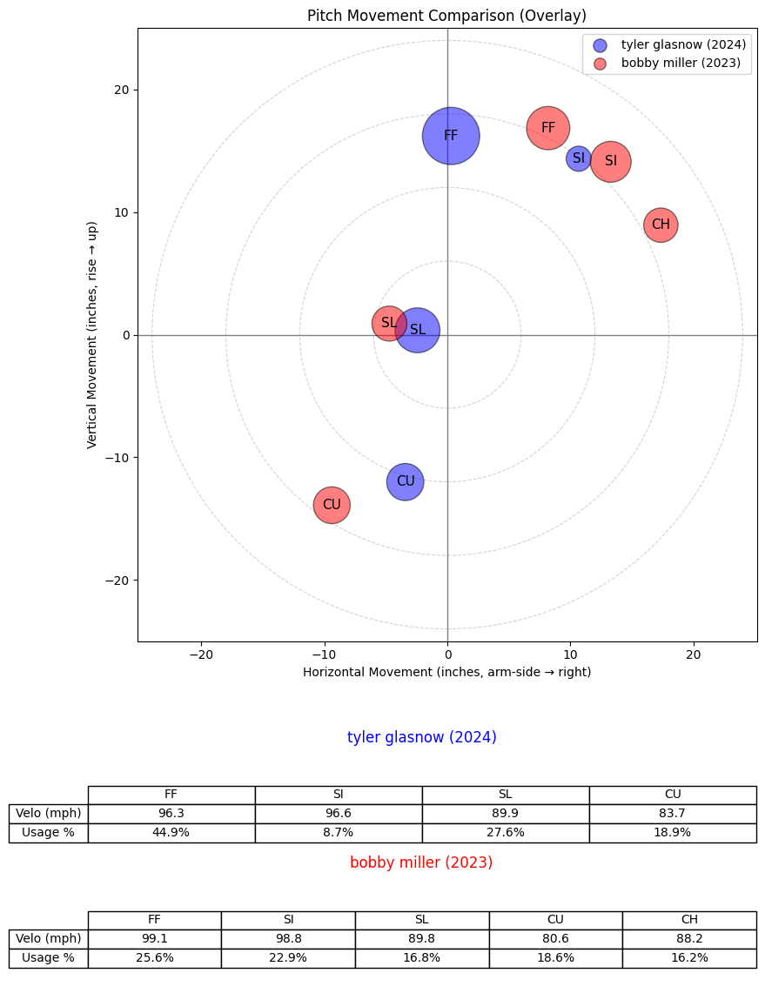

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


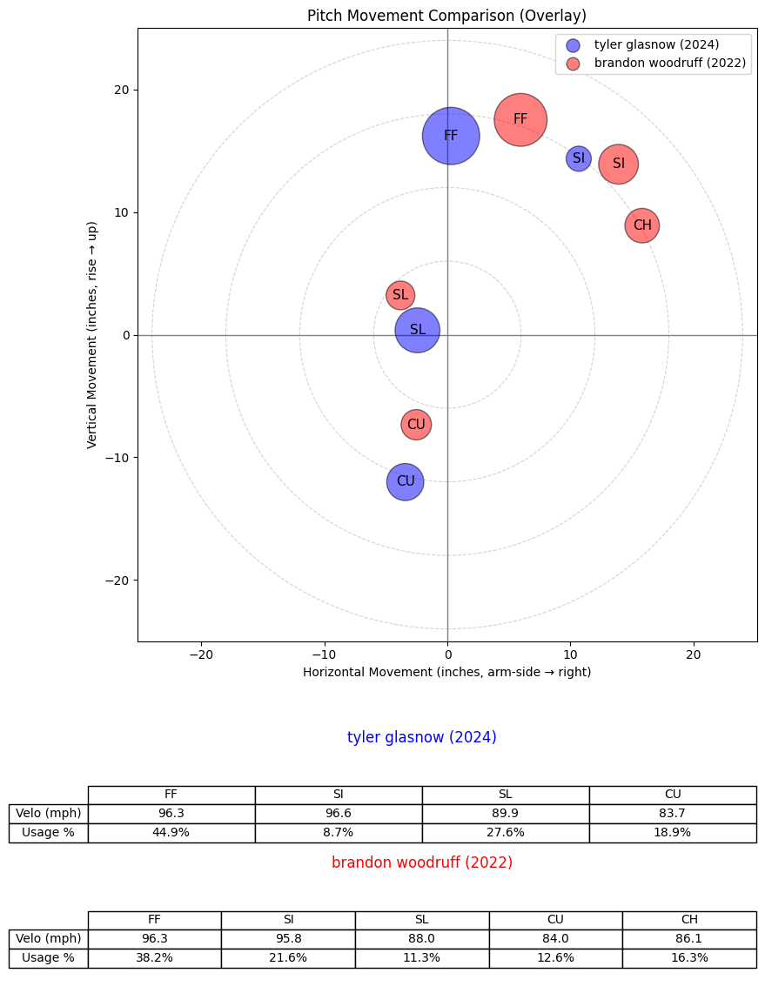

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
1166,607192.0,2023,tyler glasnow,tyler,glasnow,R,starter,0.903934
1132,605540.0,2020,brandon woodruff,brandon,woodruff,R,starter,0.869781
1133,605540.0,2021,brandon woodruff,brandon,woodruff,R,starter,0.766225
2033,676272.0,2023,bobby miller,bobby,miller,R,starter,0.761906
1134,605540.0,2022,brandon woodruff,brandon,woodruff,R,starter,0.735312


In [246]:
neighbors_same_ae = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="tyler glasnow",
    year=2024,
    X_df=X_ae_df,               # <- autoencoder space
    meta_df=pitcher_season_df,
    n_neighbors=5,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same_ae)

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


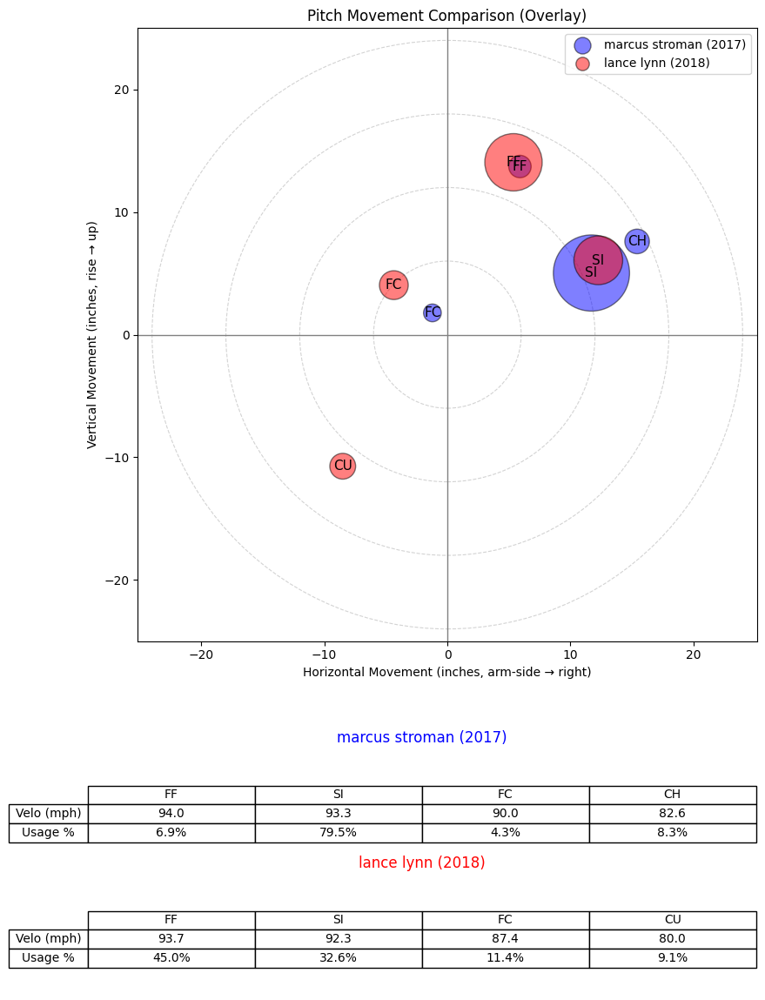

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


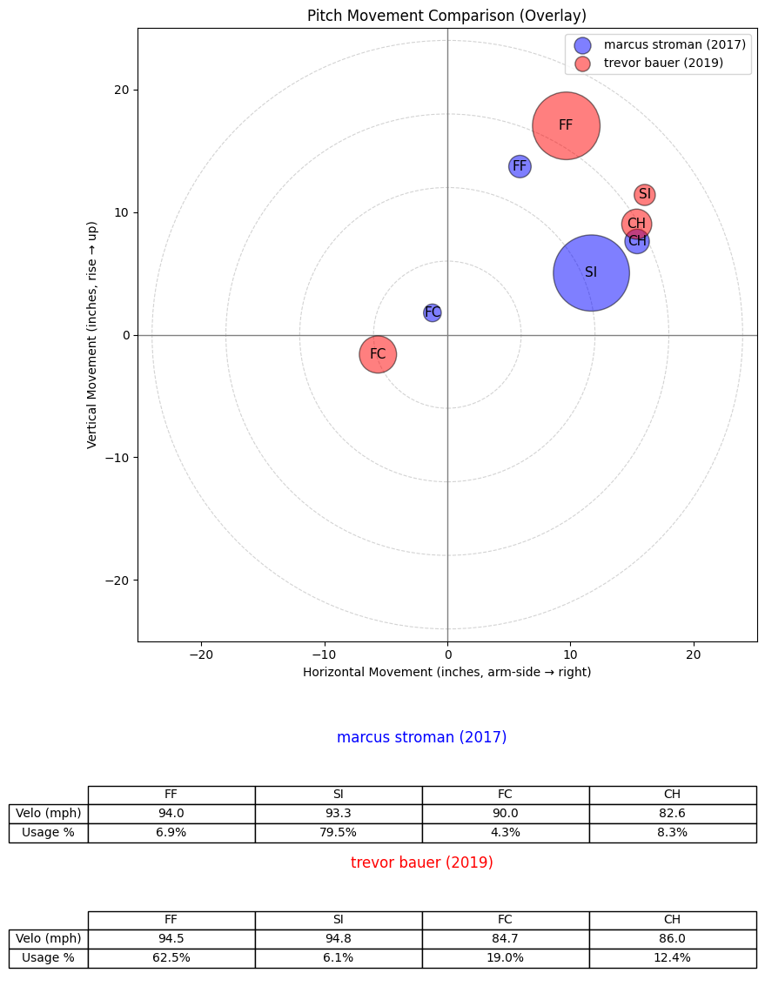

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


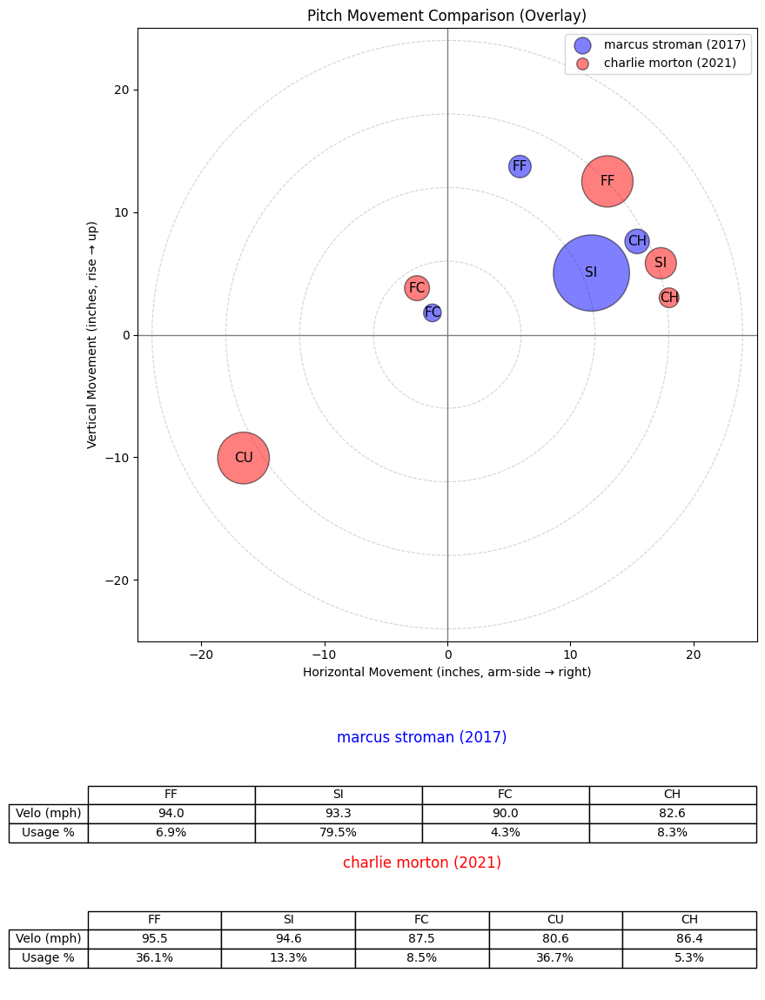

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


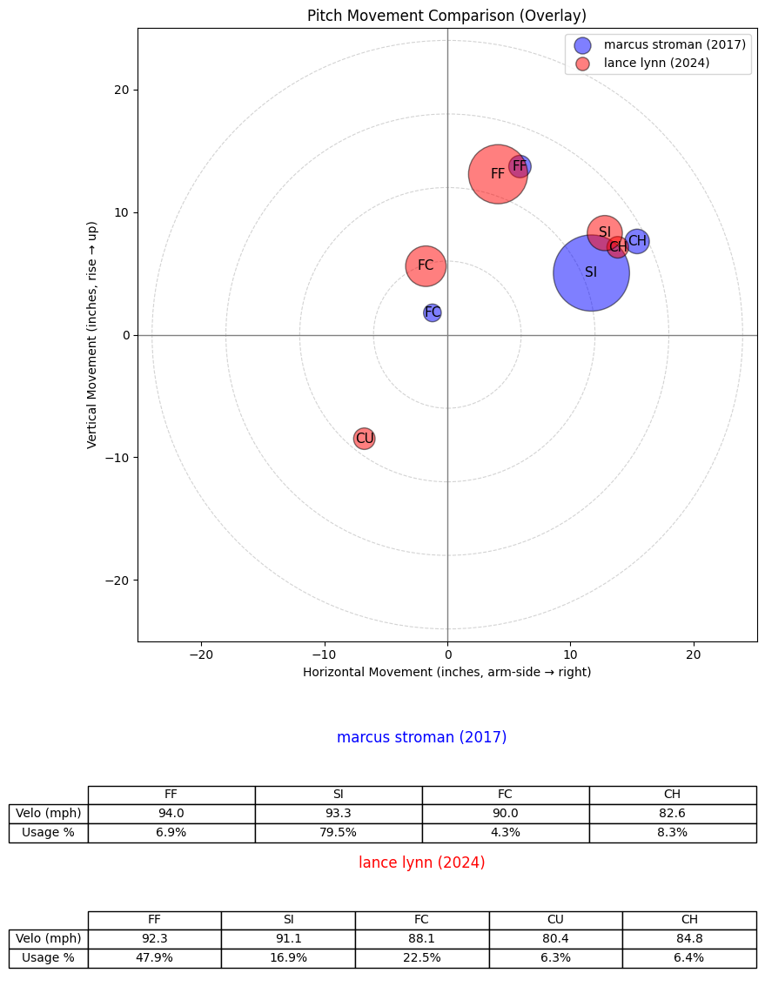

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


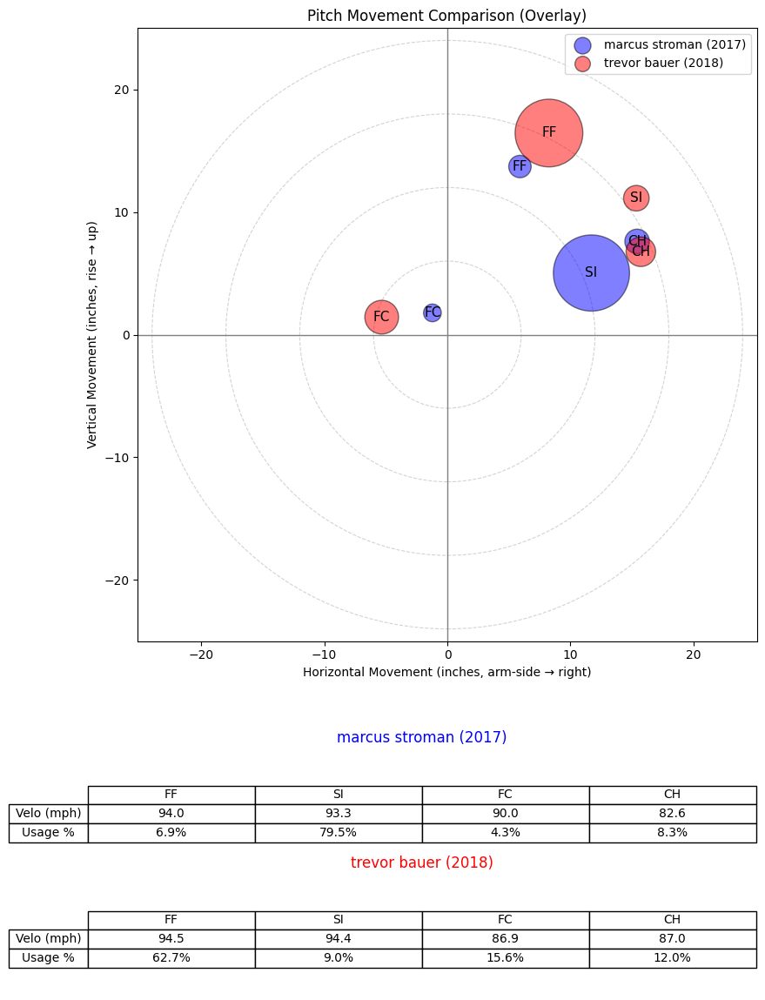

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
178,458681.0,2018,lance lynn,lance,lynn,R,starter,0.721464
641,545333.0,2019,trevor bauer,trevor,bauer,R,starter,0.654789
97,450203.0,2021,charlie morton,charlie,morton,R,starter,0.648636
184,458681.0,2024,lance lynn,lance,lynn,R,starter,0.618220
640,545333.0,2018,trevor bauer,trevor,bauer,R,starter,0.610134


In [247]:
neighbors_same_ae = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="marcus stroman",
    year=2017,
    X_df=X_ae_df,               # <- autoencoder space
    meta_df=pitcher_season_df,
    n_neighbors=5,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same_ae)

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


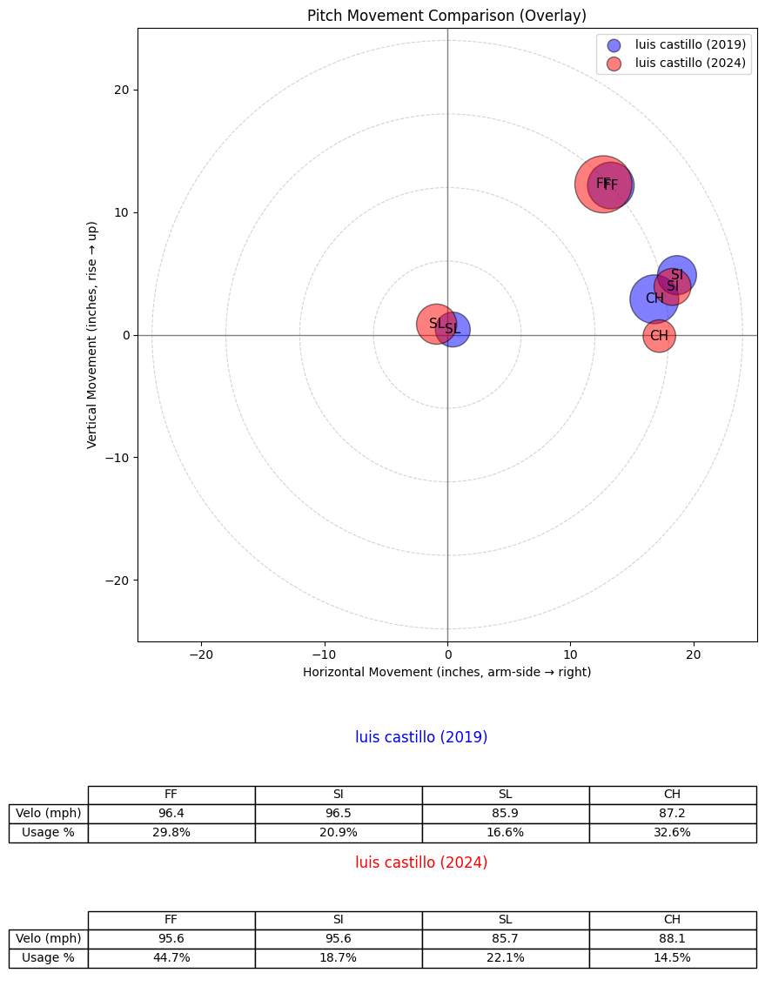

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


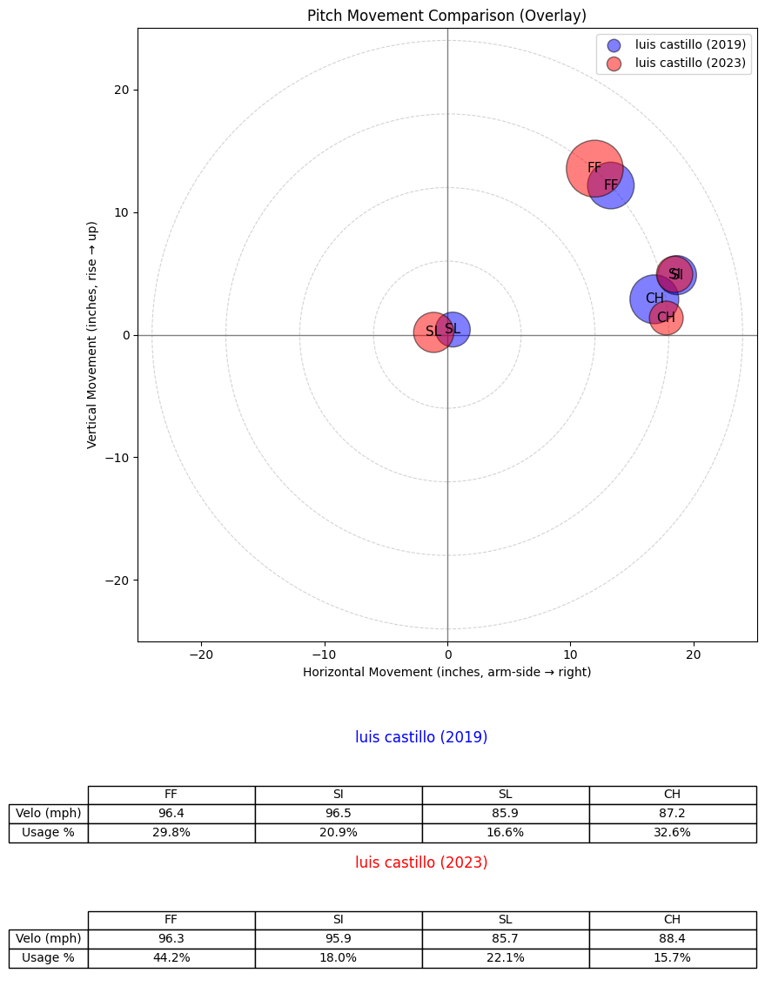

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


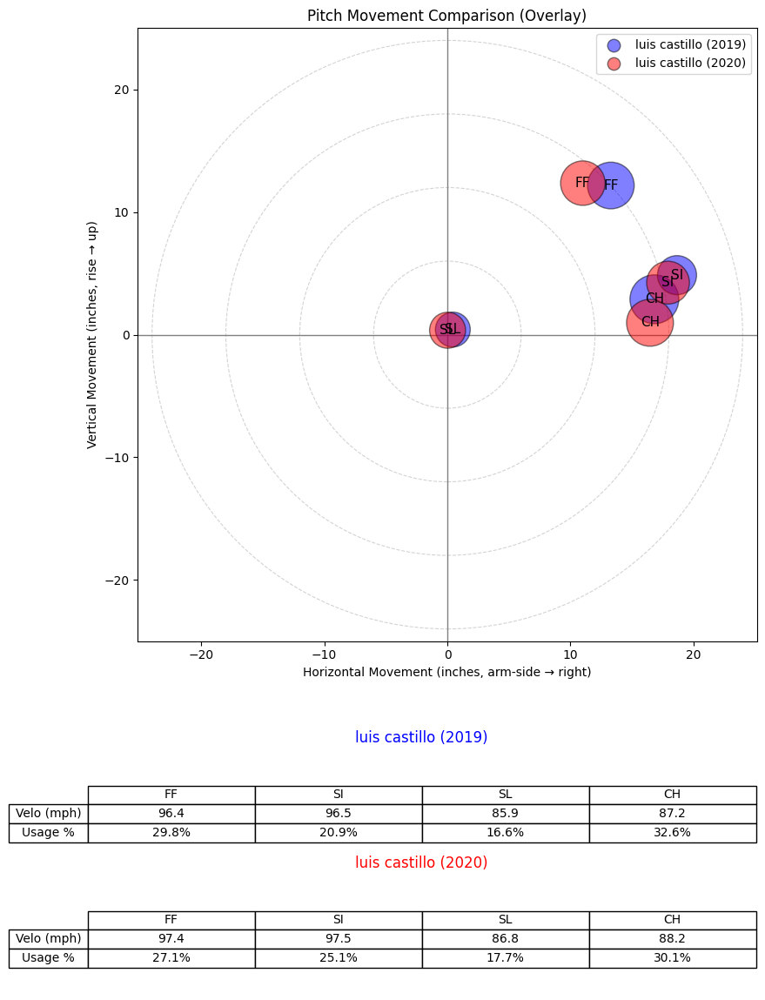

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


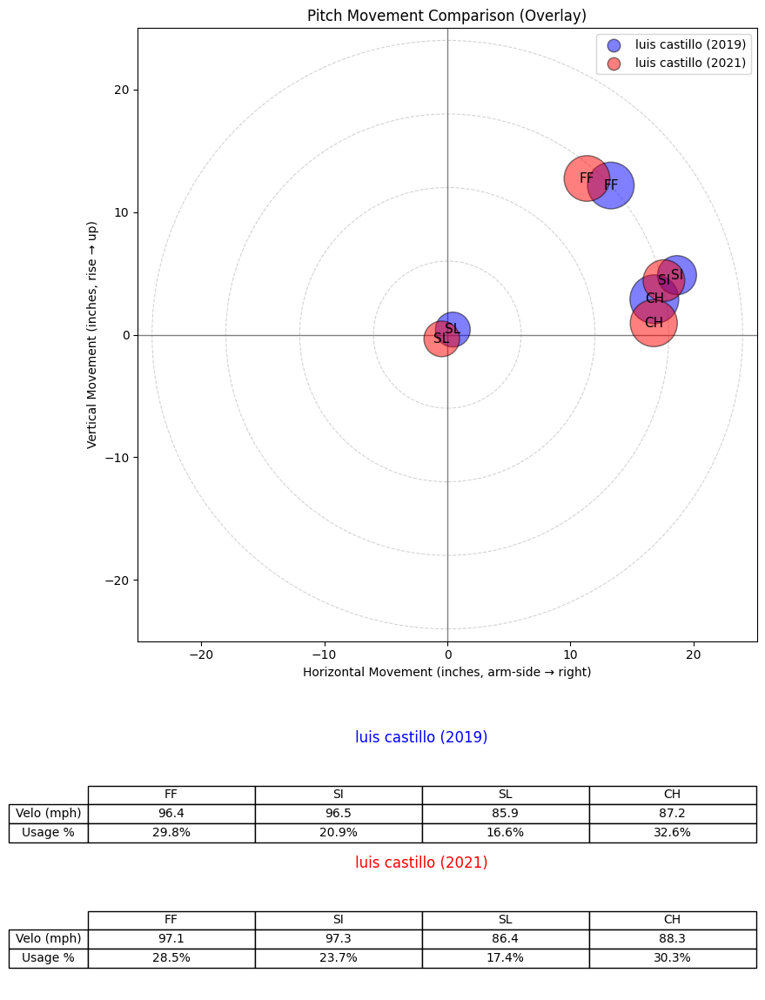

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


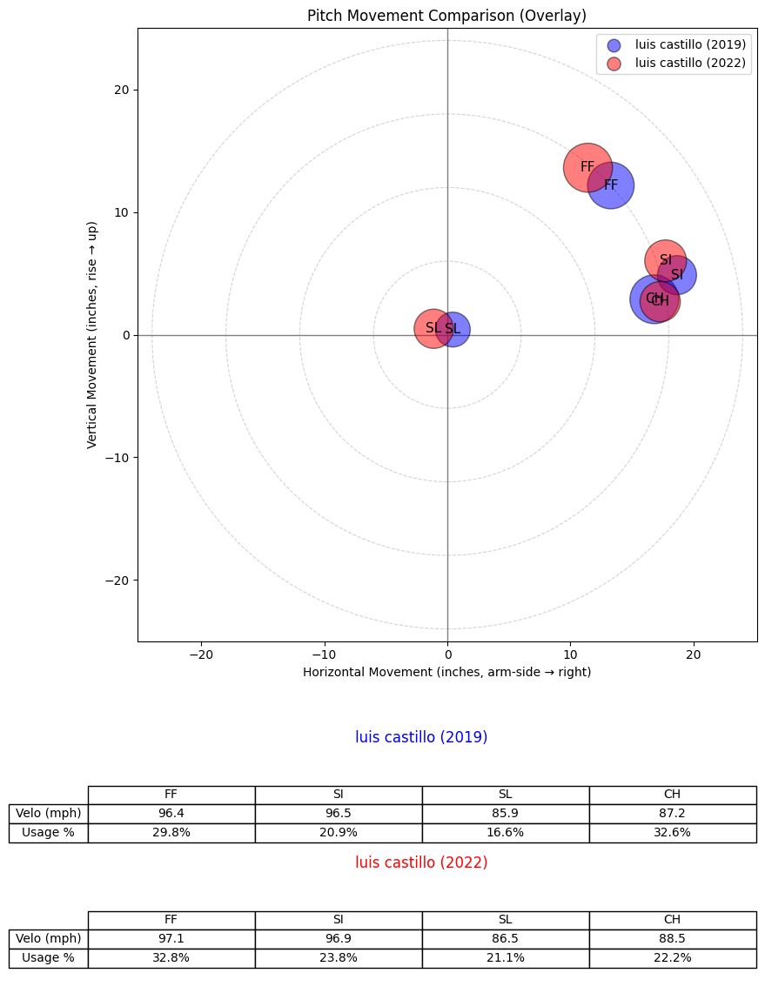

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


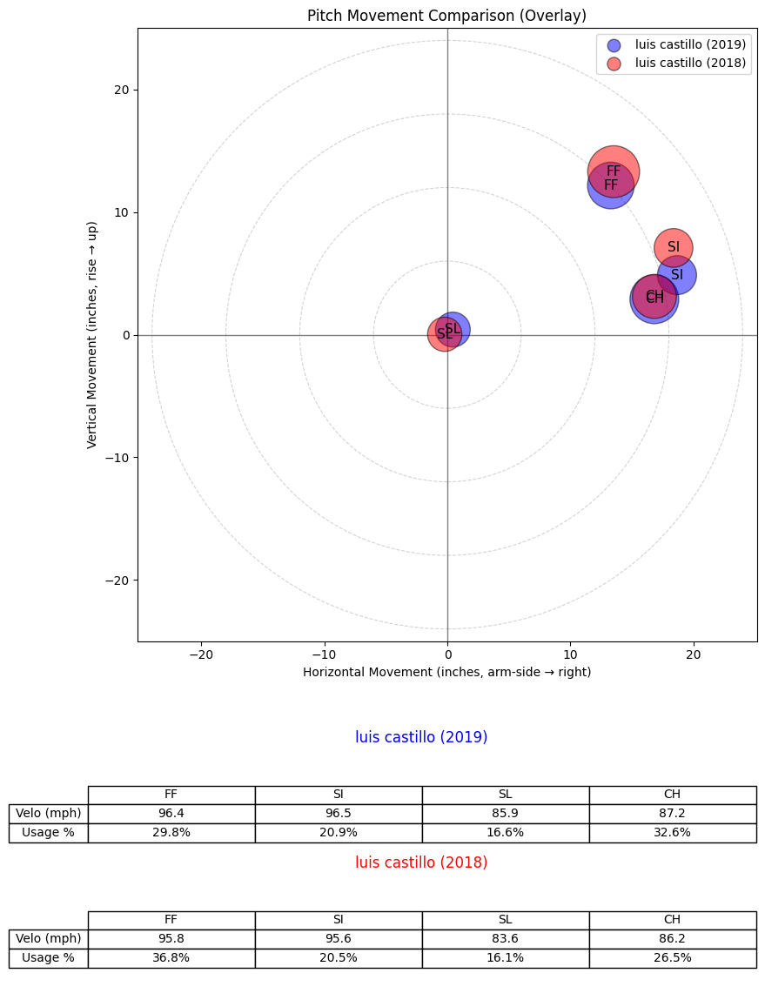

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


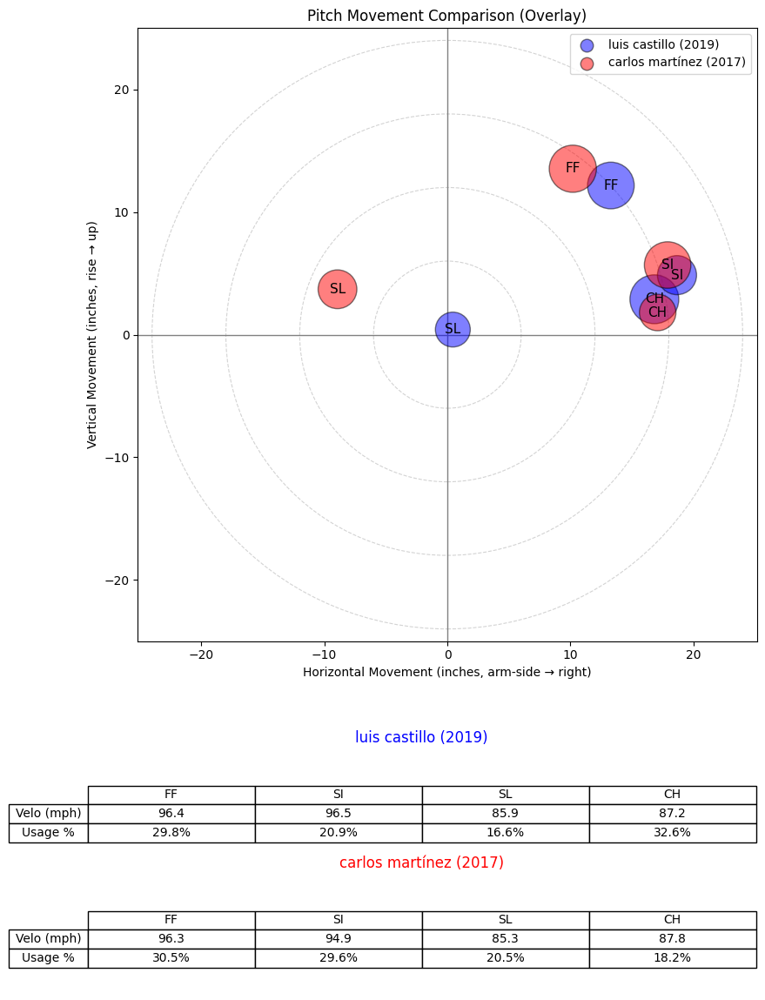

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


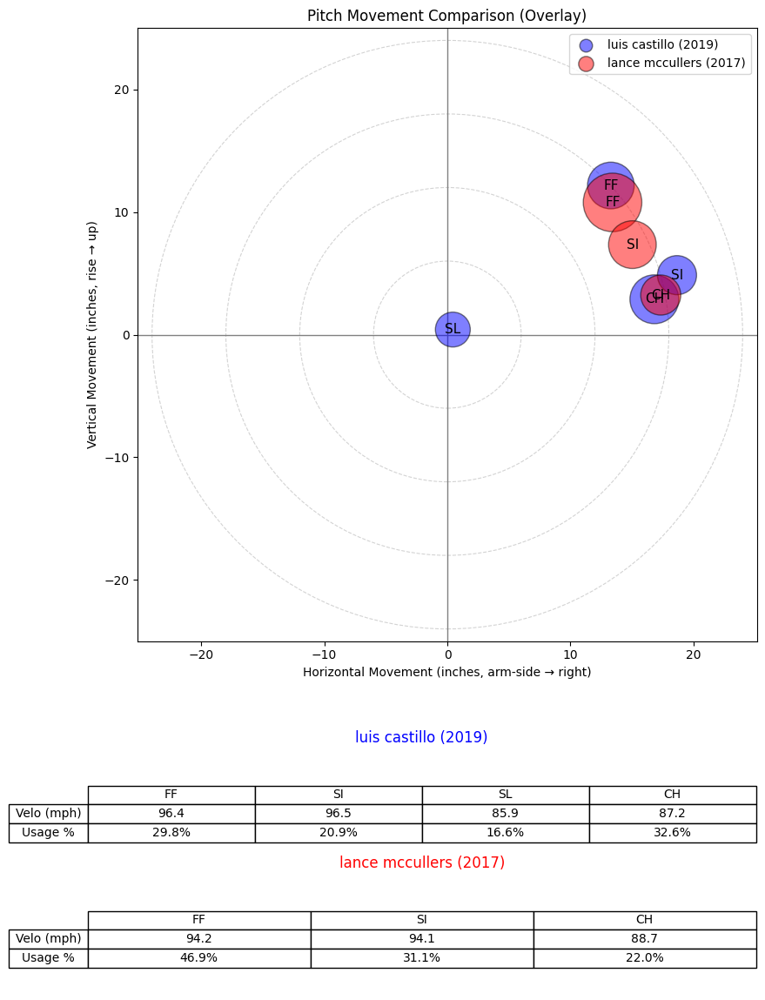

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


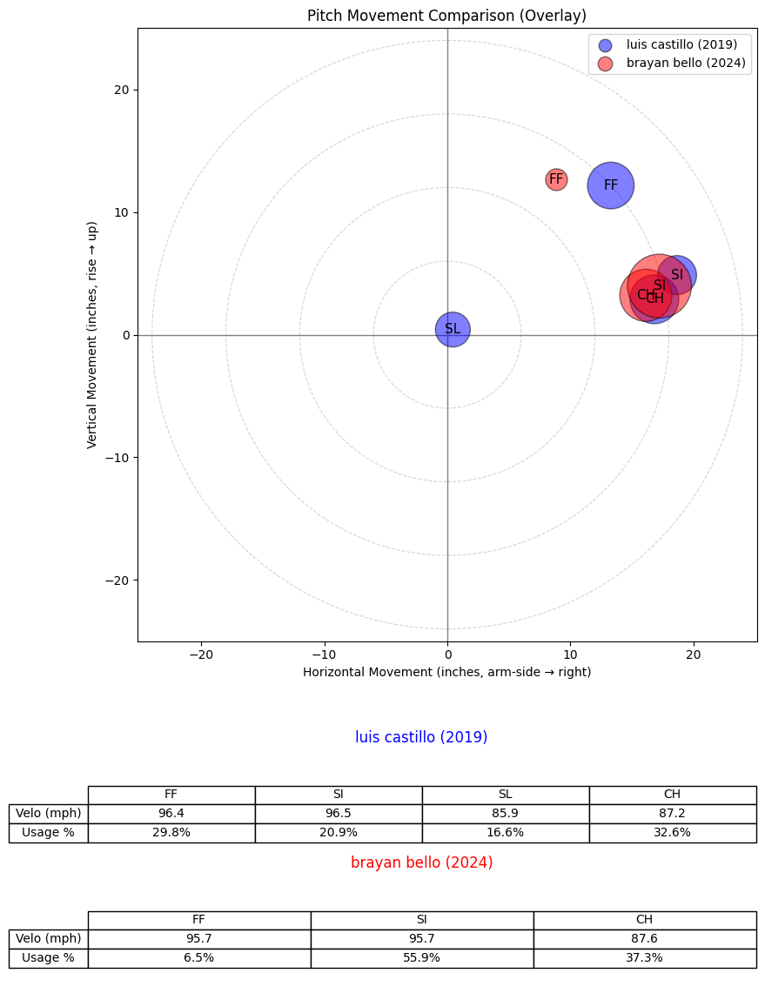

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


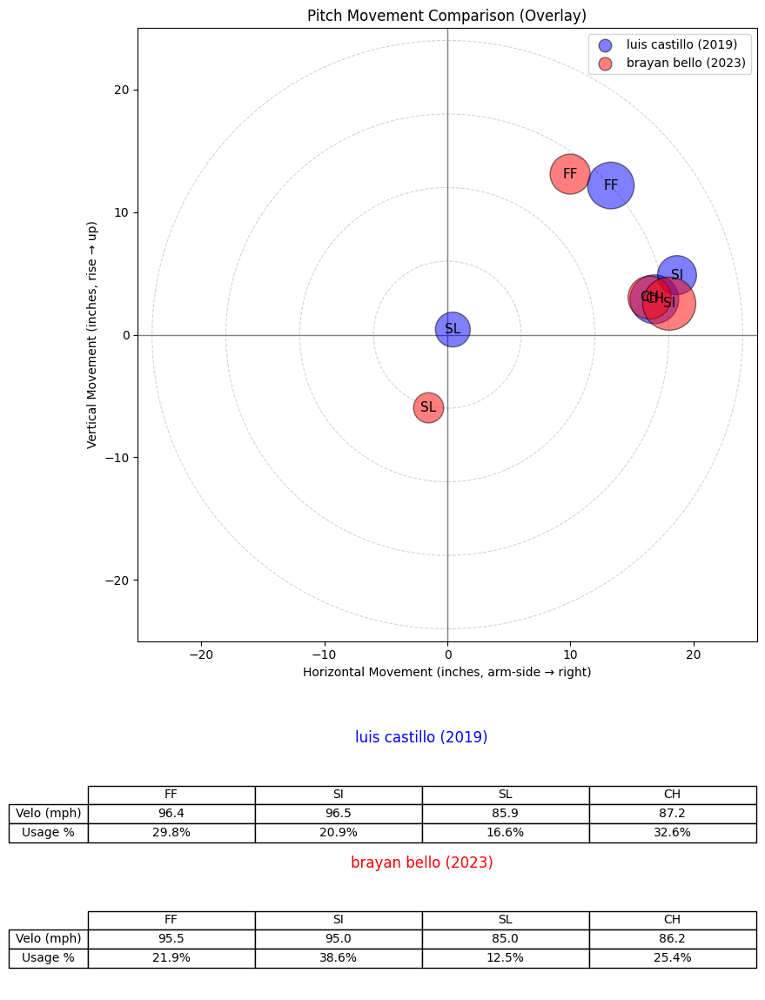

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
1379,622491.0,2024,luis castillo,luis,castillo,R,starter,0.972894
1378,622491.0,2023,luis castillo,luis,castillo,R,starter,0.968131
1375,622491.0,2020,luis castillo,luis,castillo,R,starter,0.967759
1376,622491.0,2021,luis castillo,luis,castillo,R,starter,0.960115
1377,622491.0,2022,luis castillo,luis,castillo,R,starter,0.958695
1373,622491.0,2018,luis castillo,luis,castillo,R,starter,0.936178
923,593372.0,2017,carlos martínez,carlos,martínez,R,starter,0.835403
1308,621121.0,2017,lance mccullers,lance,mccullers,R,starter,0.761064
2059,678394.0,2024,brayan bello,brayan,bello,R,starter,0.754606
2058,678394.0,2023,brayan bello,brayan,bello,R,starter,0.754253


In [248]:
neighbors_same_ae = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="luis castillo",
    year=2019,
    X_df=X_ae_df,               # <- autoencoder space
    meta_df=pitcher_season_df,
    n_neighbors=10,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same_ae)

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


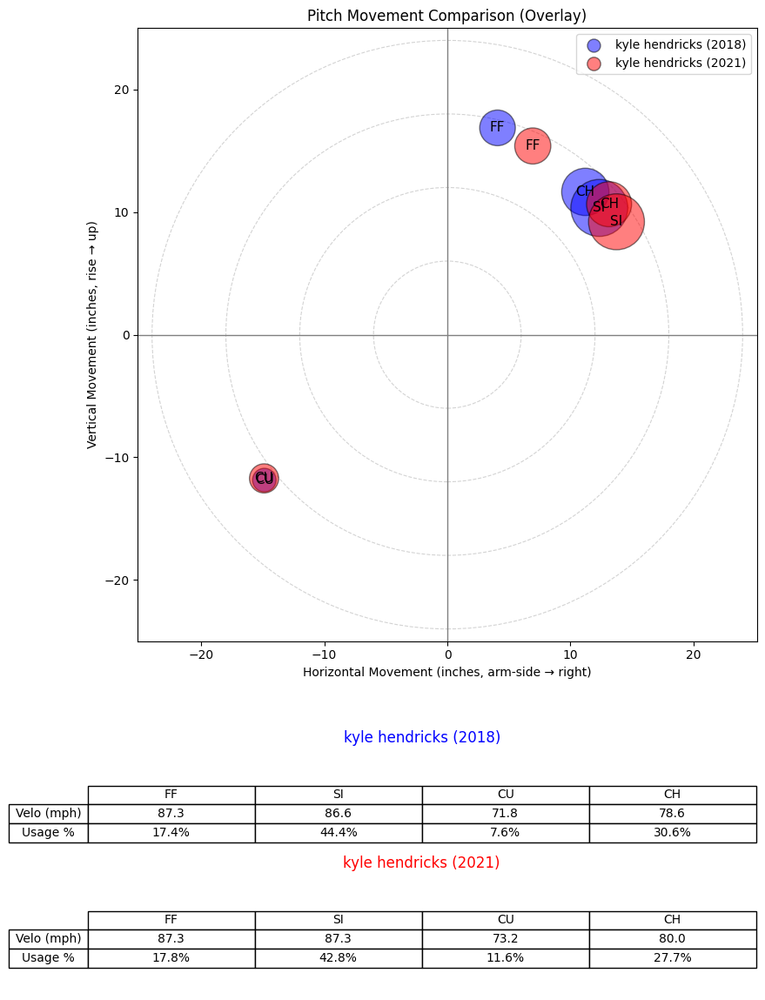

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


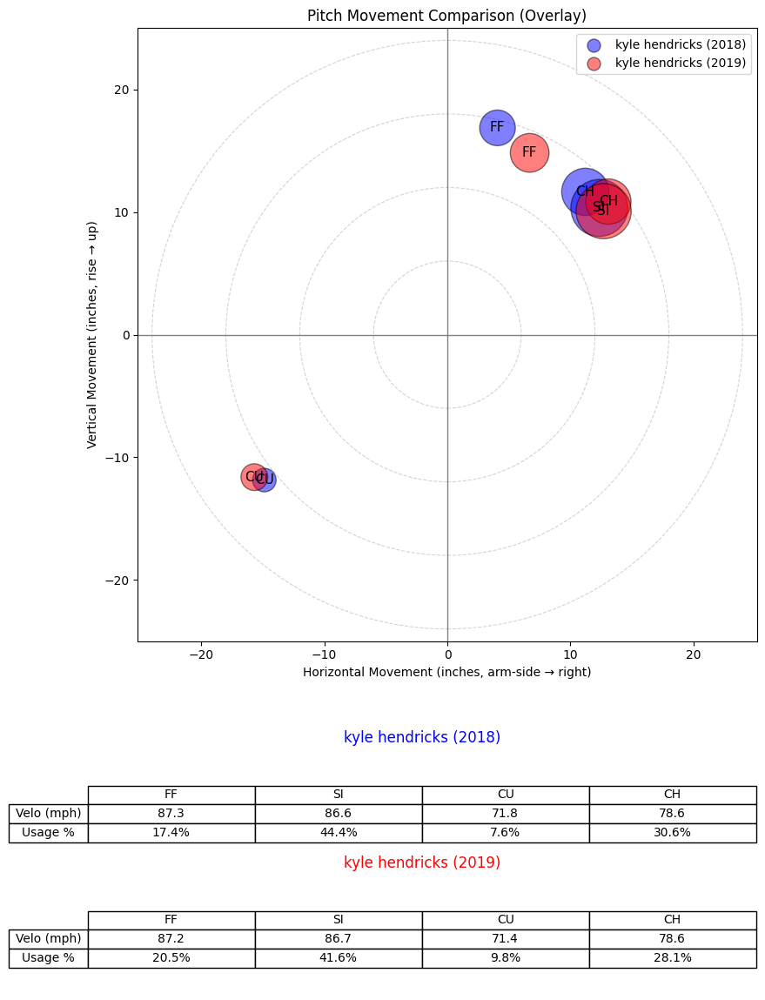

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


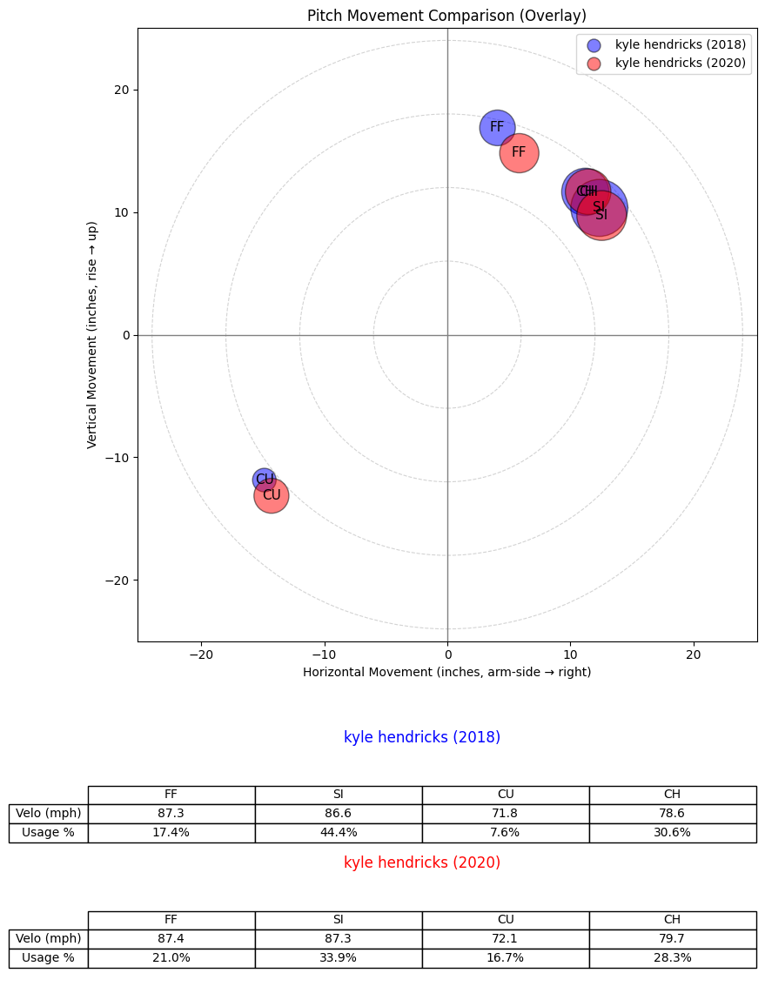

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


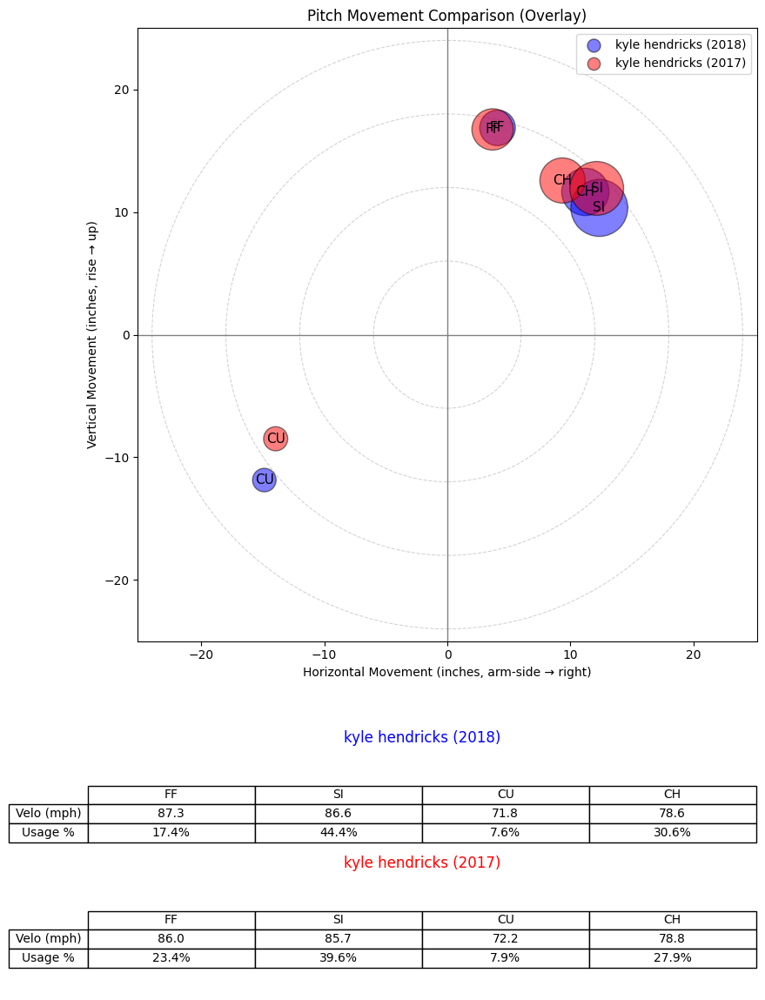

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


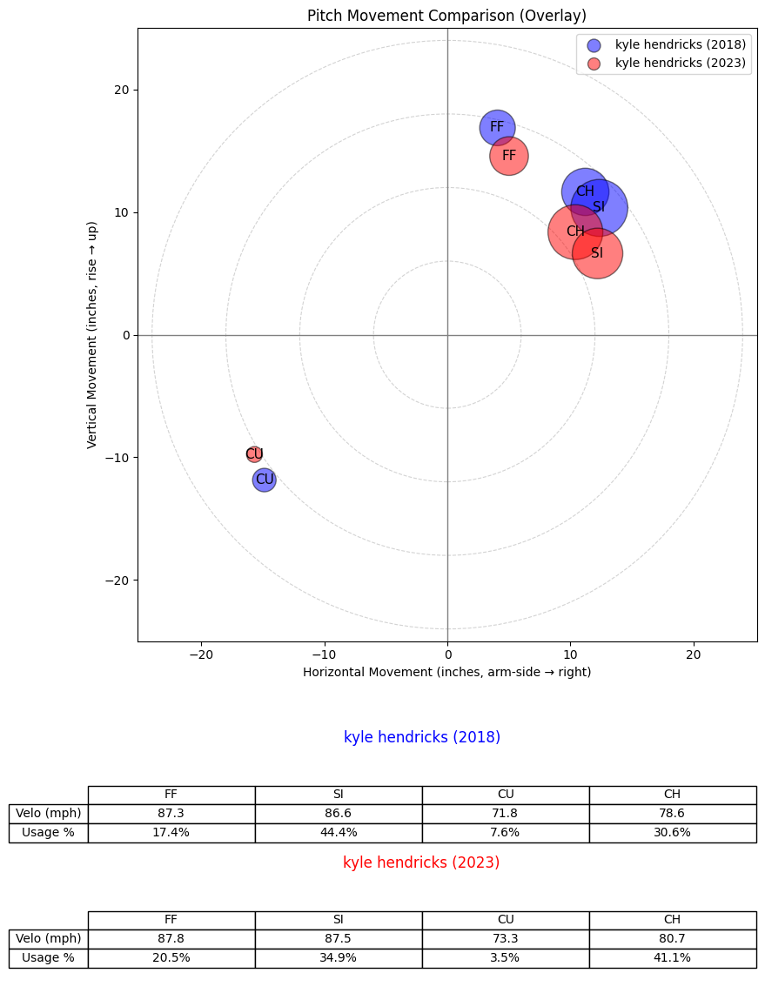

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


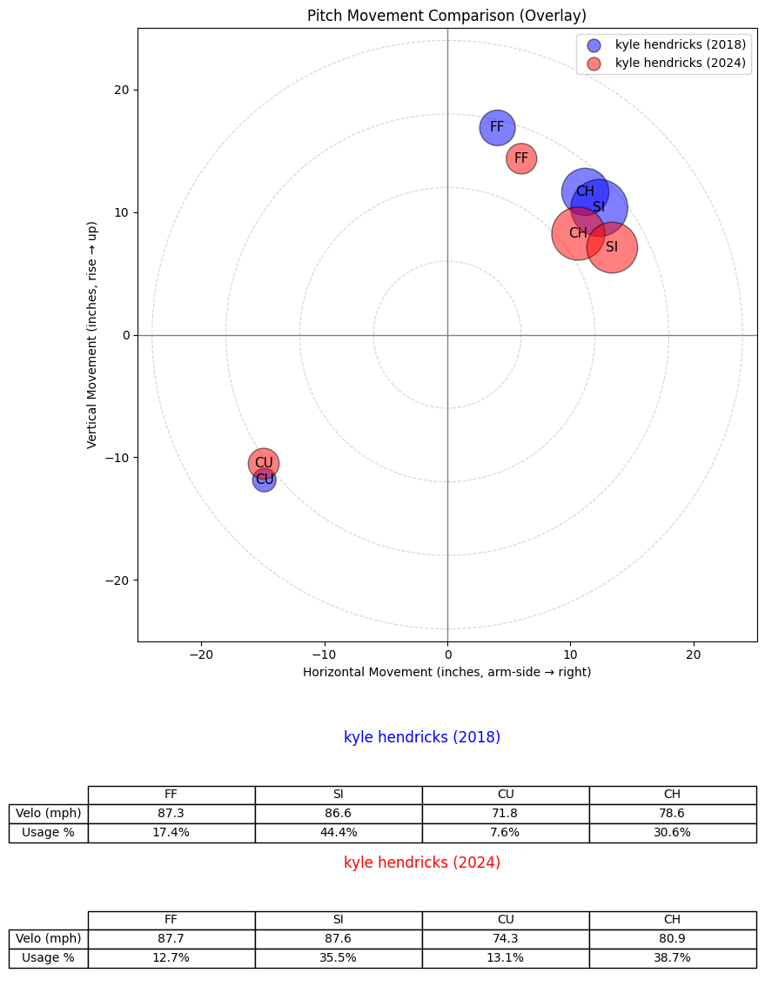

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


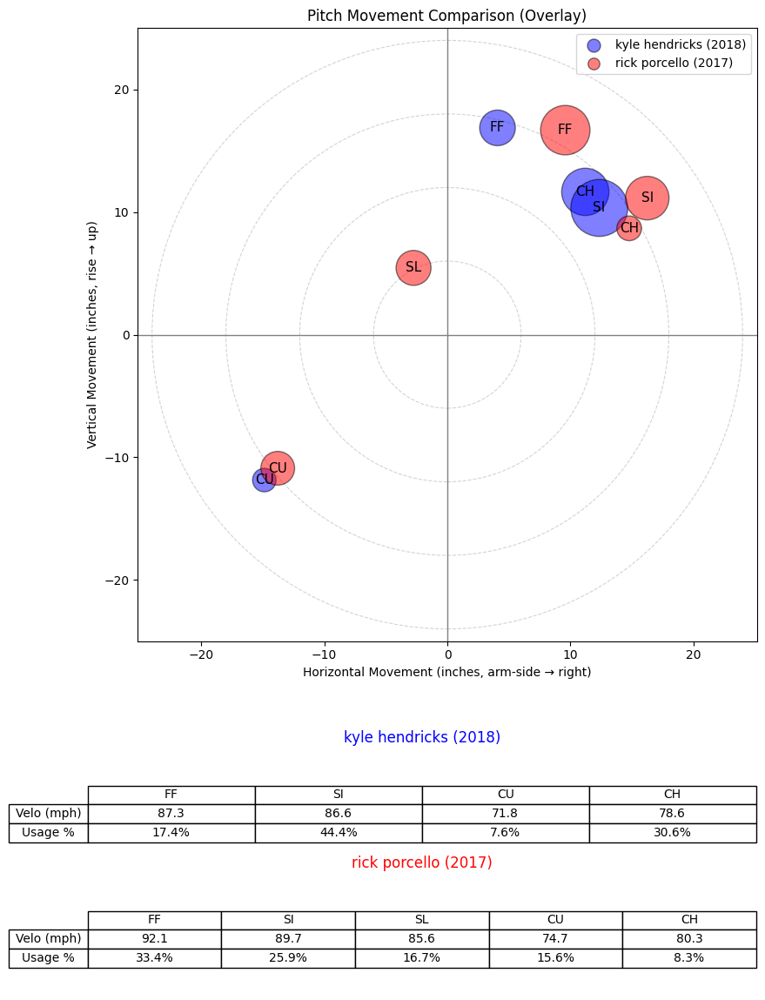

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


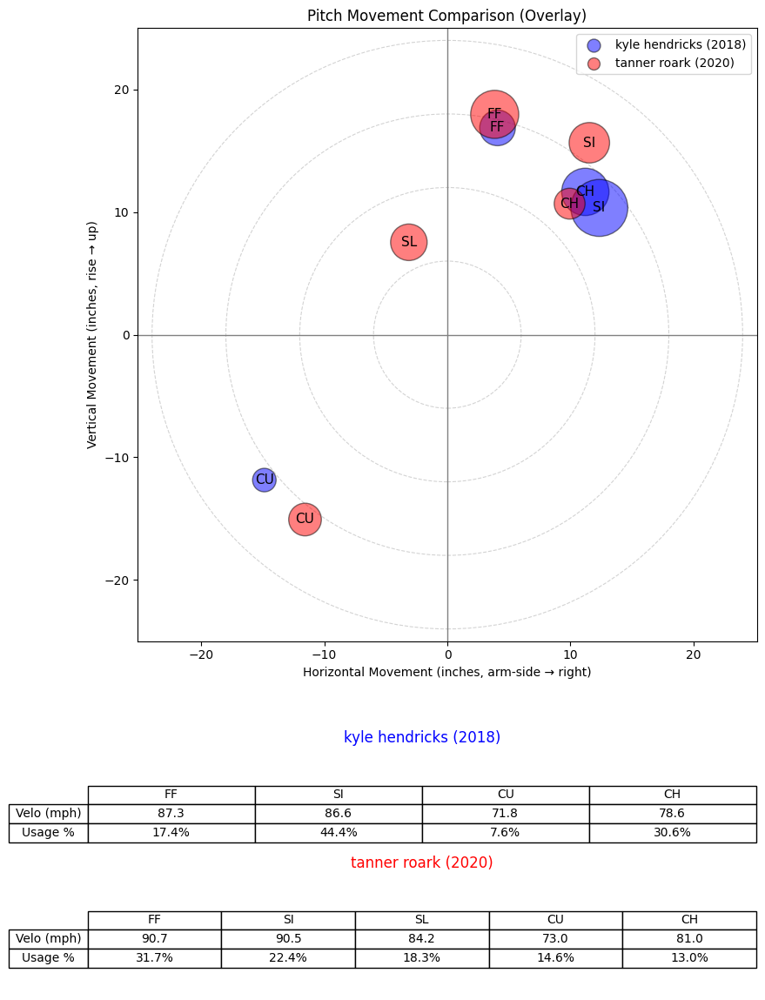

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


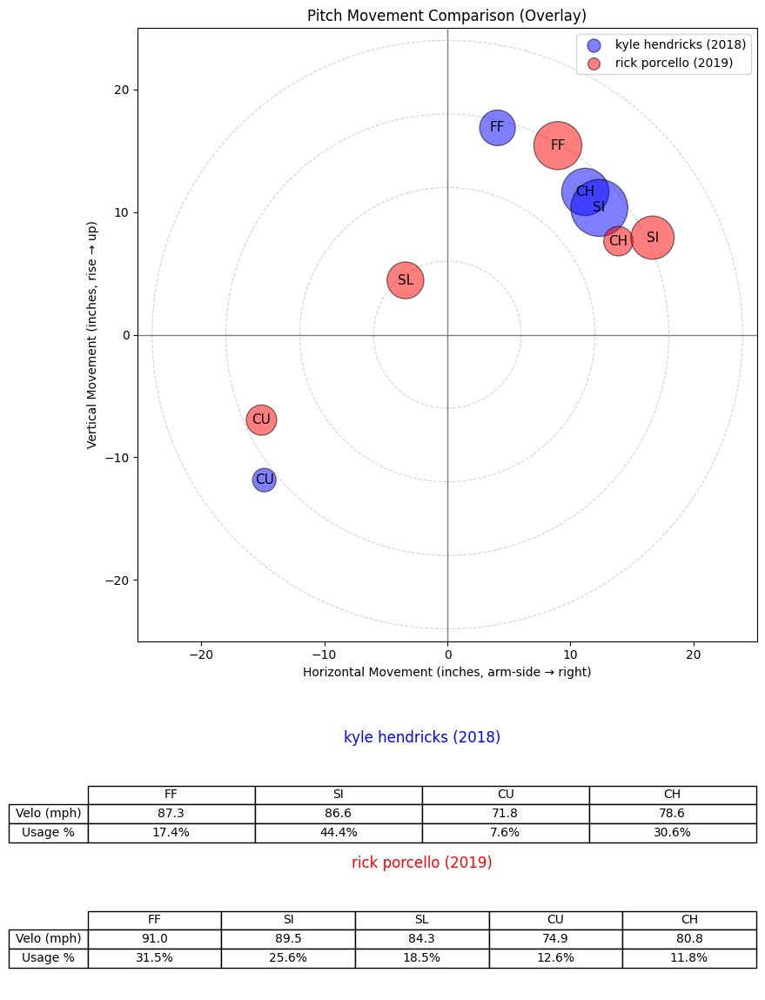

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


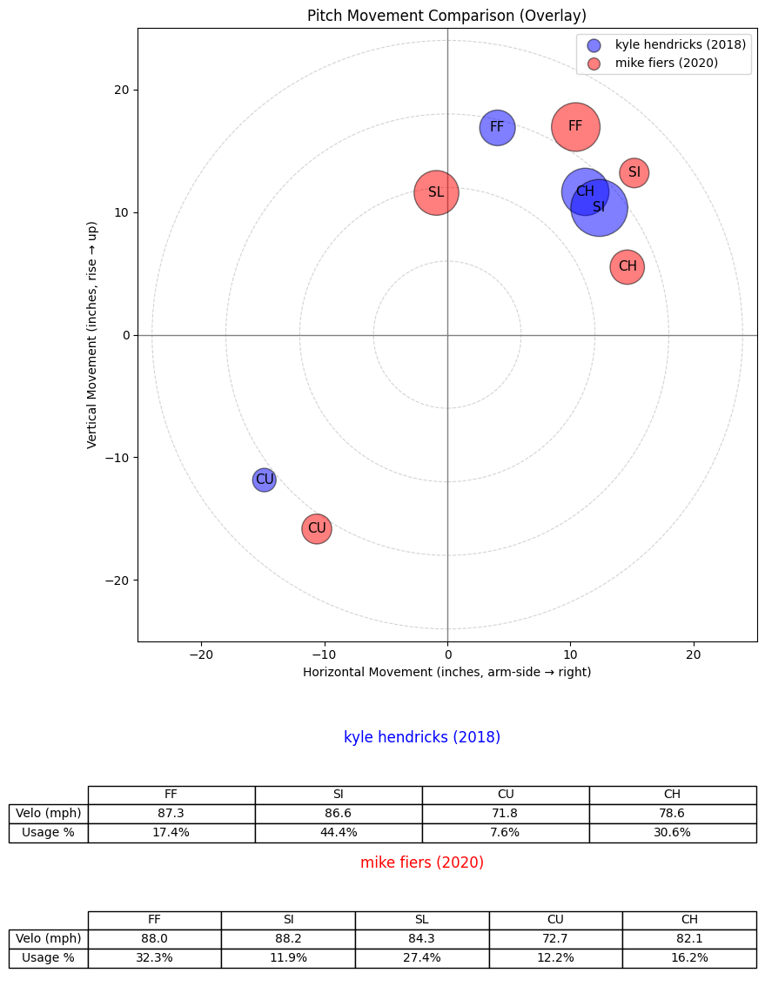

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
572,543294.0,2021,kyle hendricks,kyle,hendricks,R,starter,0.986837
570,543294.0,2019,kyle hendricks,kyle,hendricks,R,starter,0.984425
571,543294.0,2020,kyle hendricks,kyle,hendricks,R,starter,0.981008
568,543294.0,2017,kyle hendricks,kyle,hendricks,R,starter,0.956366
573,543294.0,2023,kyle hendricks,kyle,hendricks,R,starter,0.941849
574,543294.0,2024,kyle hendricks,kyle,hendricks,R,starter,0.936998
447,519144.0,2017,rick porcello,rick,porcello,R,starter,0.813298
610,543699.0,2020,tanner roark,tanner,roark,R,starter,0.802349
449,519144.0,2019,rick porcello,rick,porcello,R,starter,0.745265
723,571666.0,2020,mike fiers,mike,fiers,R,starter,0.723406


In [249]:
neighbors_same_ae = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="kyle hendricks",
    year=2018,
    X_df=X_ae_df,               # <- autoencoder space
    meta_df=pitcher_season_df,
    n_neighbors=10,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same_ae)

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


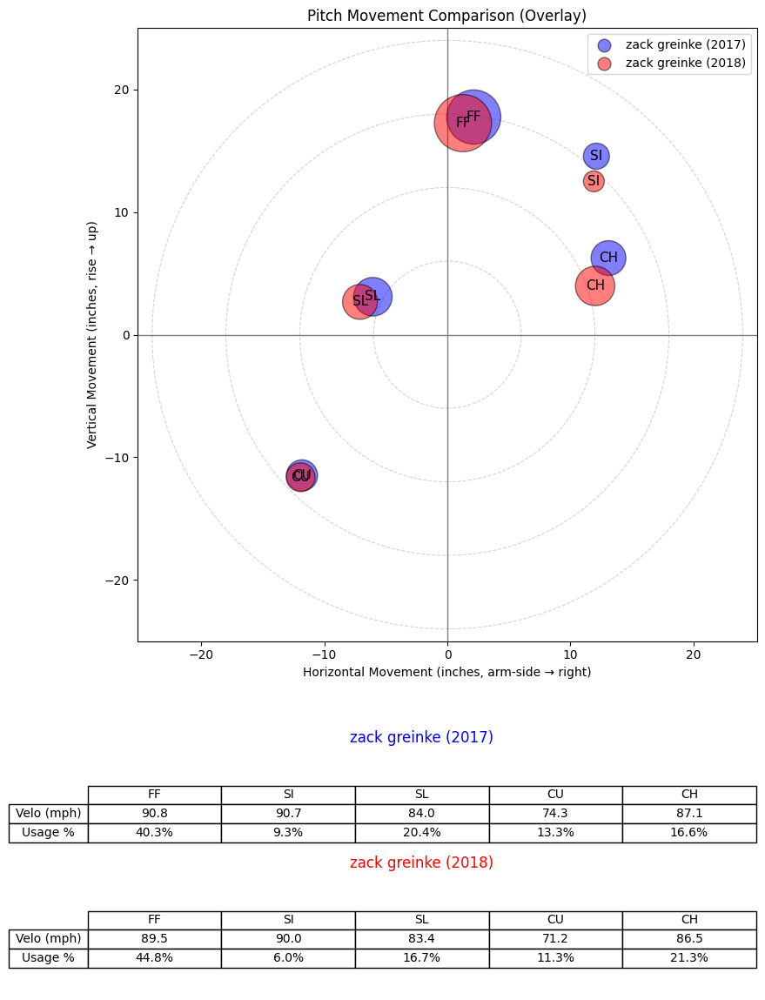

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


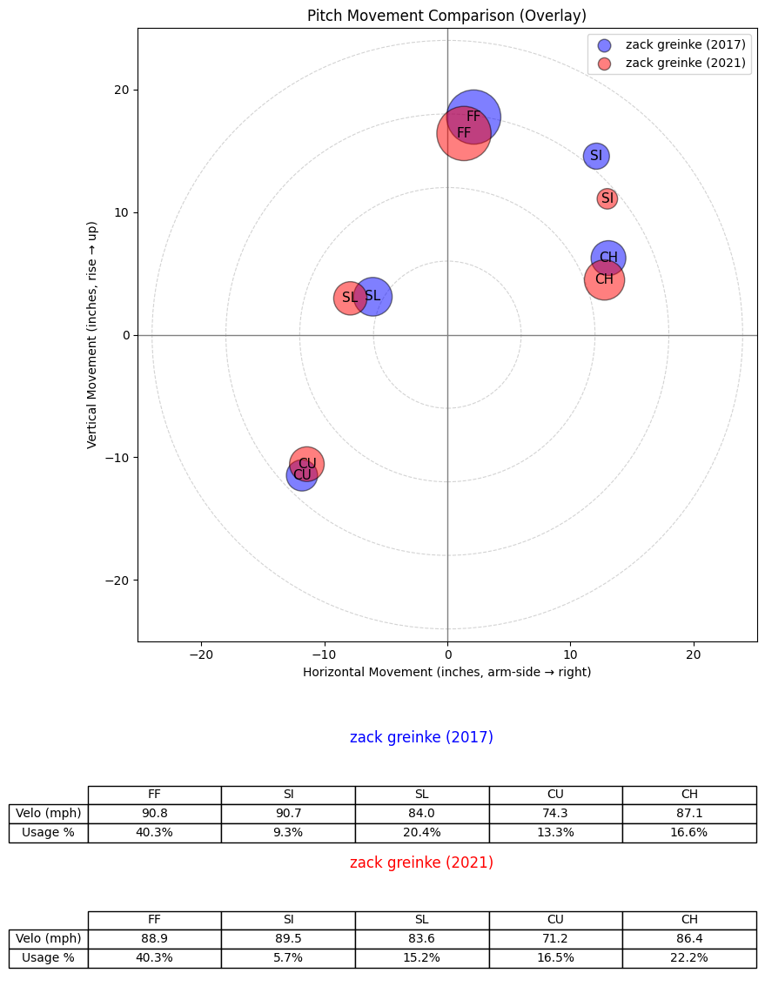

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


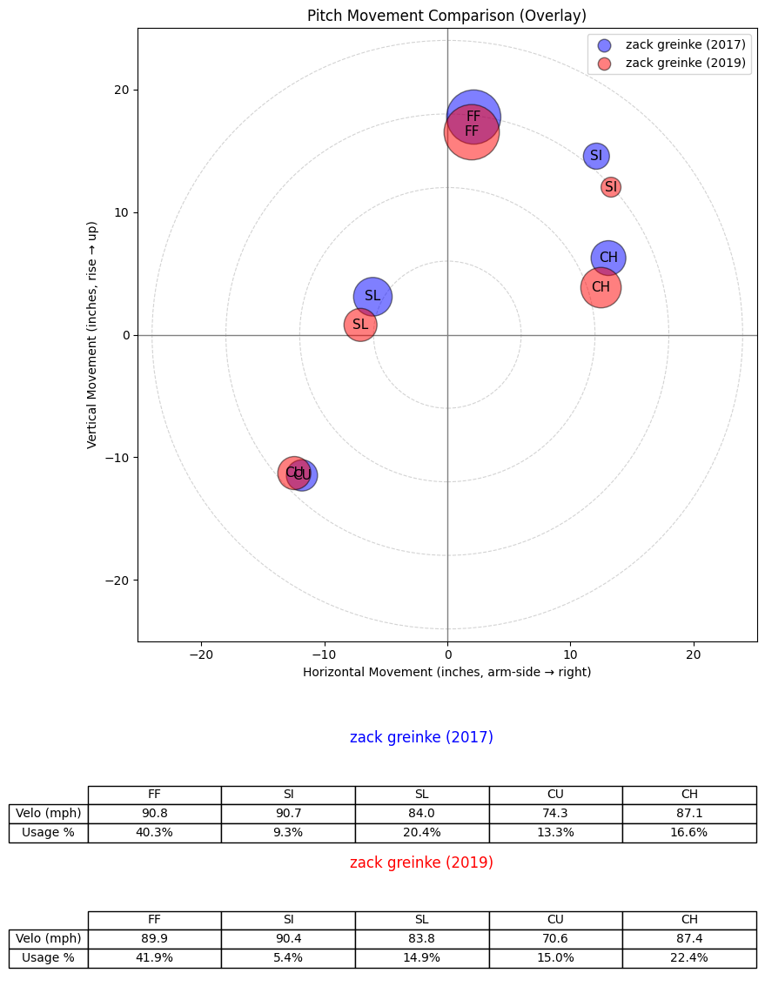

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


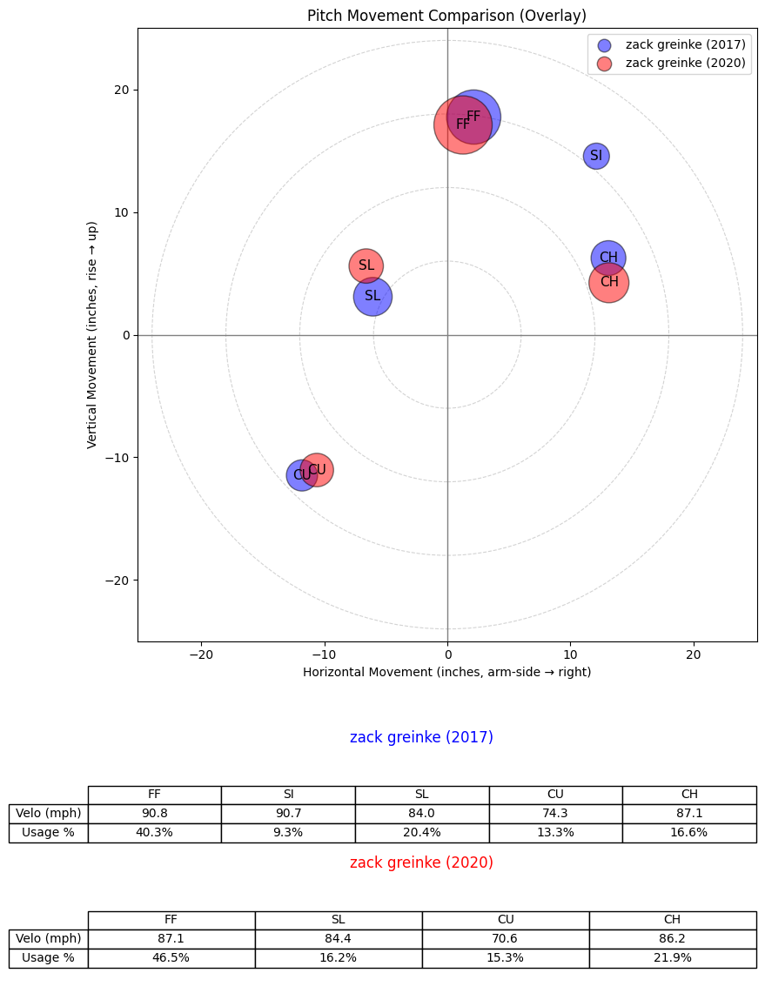

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


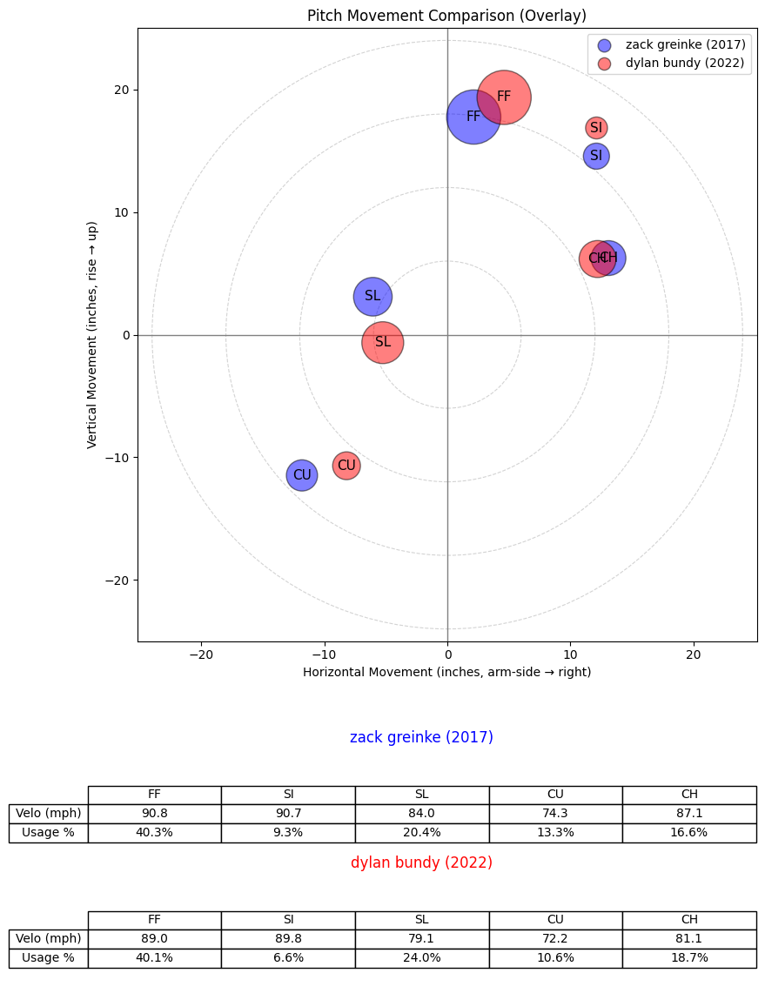

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


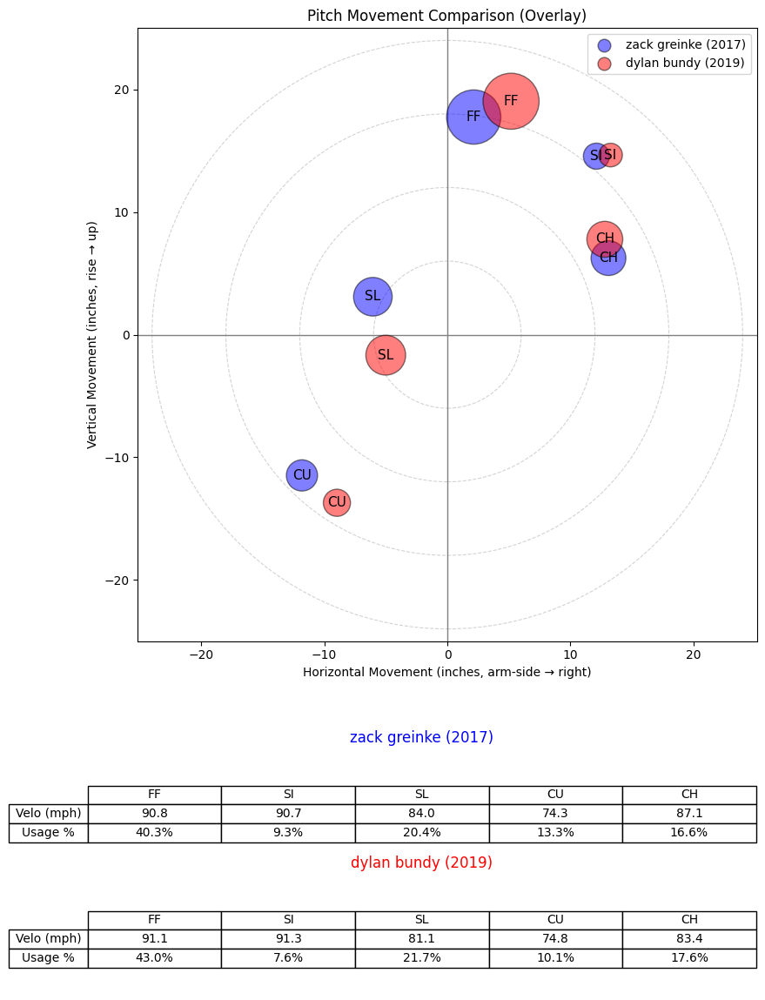

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


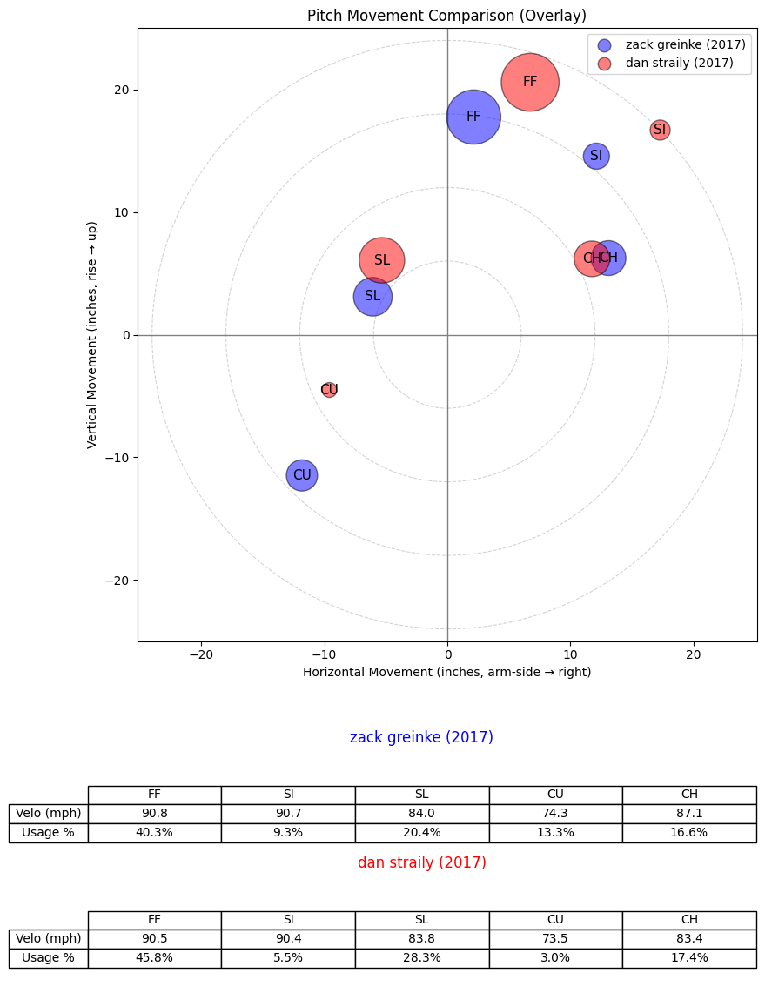

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


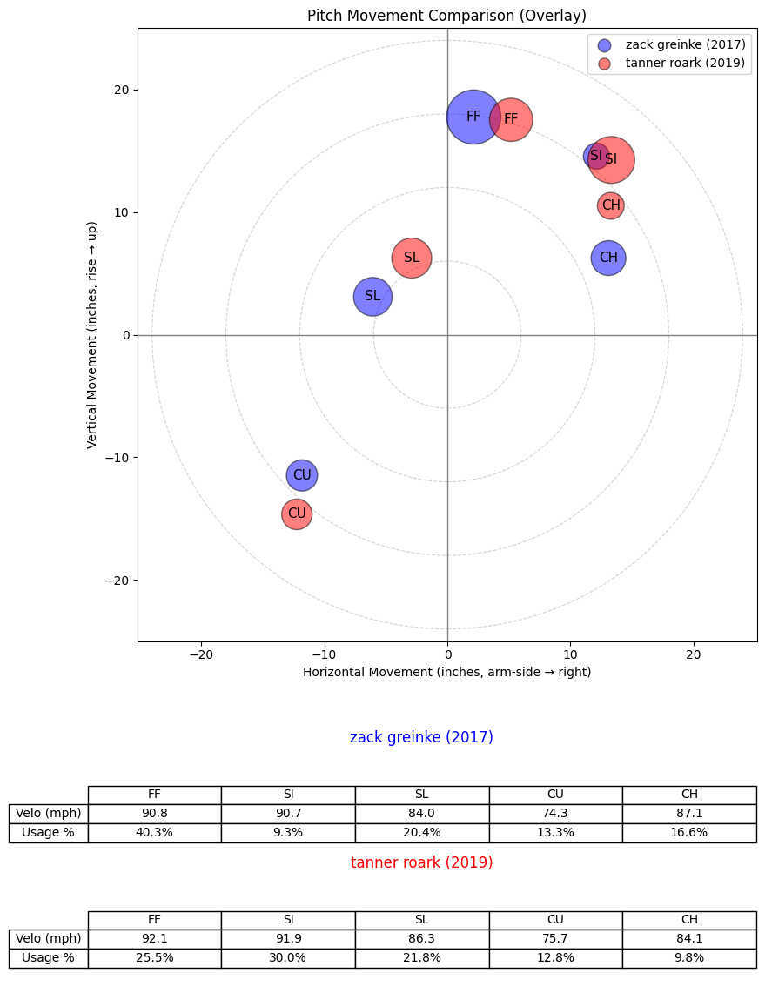

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


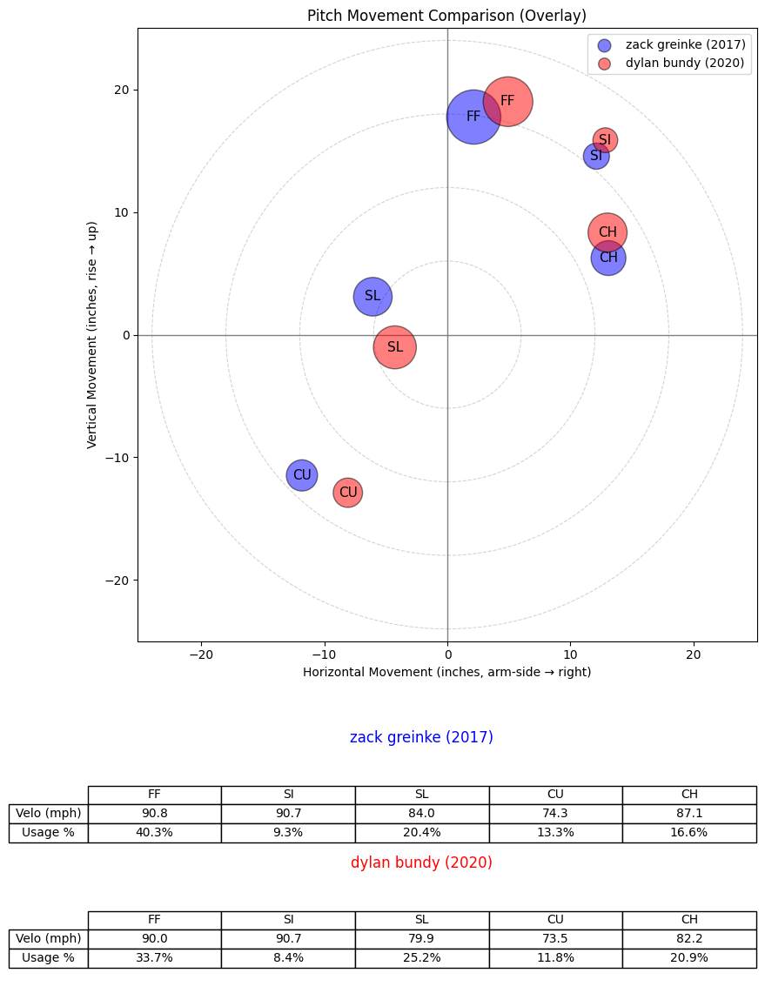

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


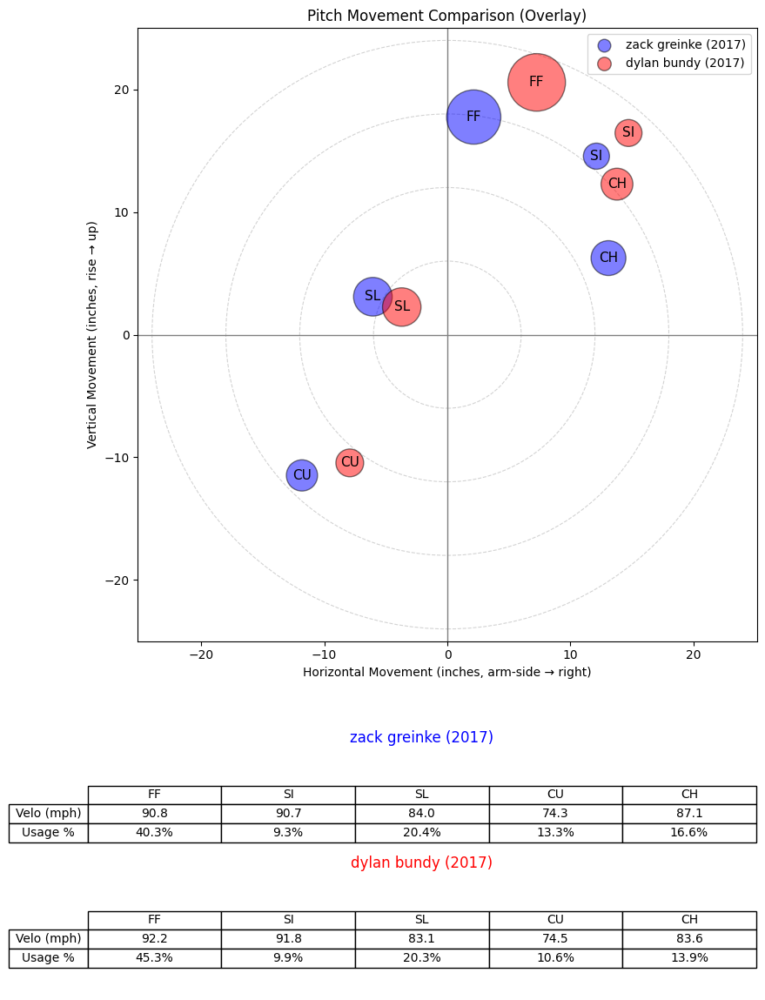

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
17,425844.0,2018,zack greinke,zack,greinke,R,starter,0.954797
20,425844.0,2021,zack greinke,zack,greinke,R,starter,0.931901
18,425844.0,2019,zack greinke,zack,greinke,R,starter,0.927123
19,425844.0,2020,zack greinke,zack,greinke,R,starter,0.848033
1055,605164.0,2022,dylan bundy,dylan,bundy,R,starter,0.740805
1053,605164.0,2019,dylan bundy,dylan,bundy,R,starter,0.728447
801,573185.0,2017,dan straily,dan,straily,R,starter,0.725556
609,543699.0,2019,tanner roark,tanner,roark,R,starter,0.725157
1054,605164.0,2020,dylan bundy,dylan,bundy,R,starter,0.720000
1051,605164.0,2017,dylan bundy,dylan,bundy,R,starter,0.717529


In [250]:
neighbors_same_ae = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="zack greinke",
    year=2017,
    X_df=X_ae_df,               # <- autoencoder space
    meta_df=pitcher_season_df,
    n_neighbors=10,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same_ae)

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


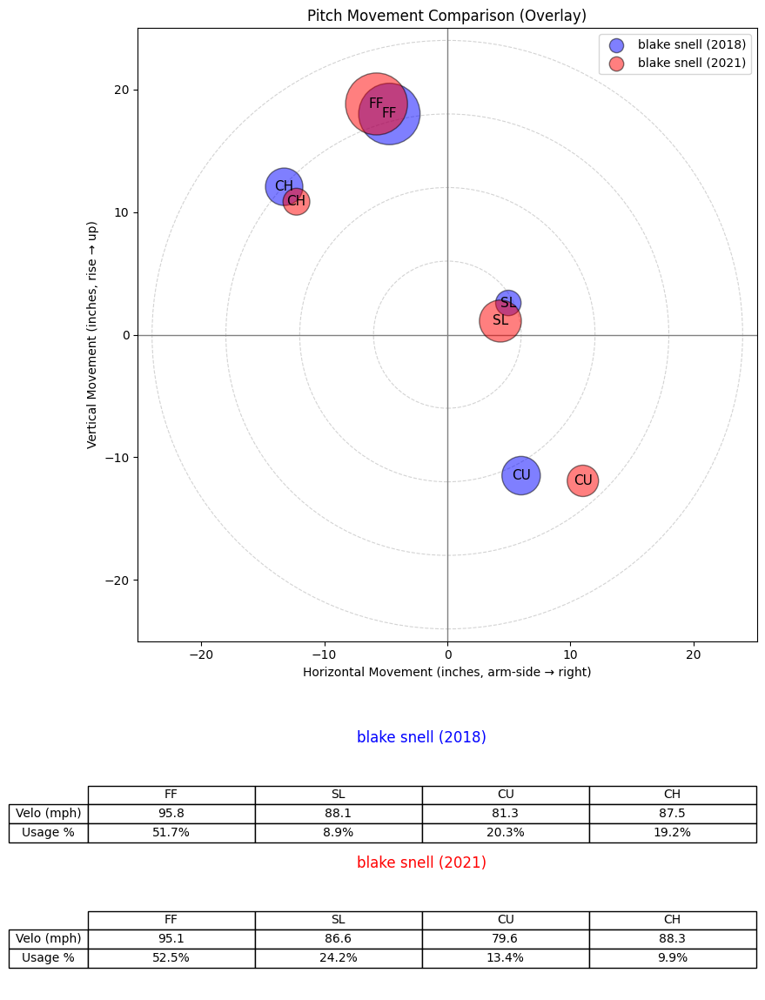

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


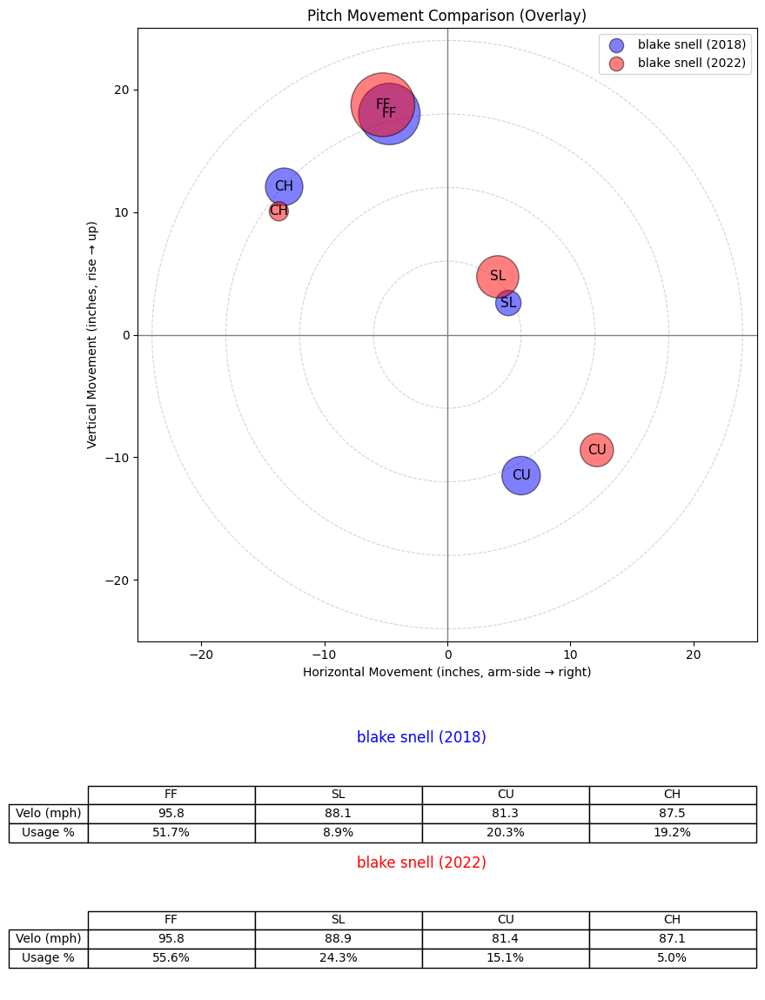

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


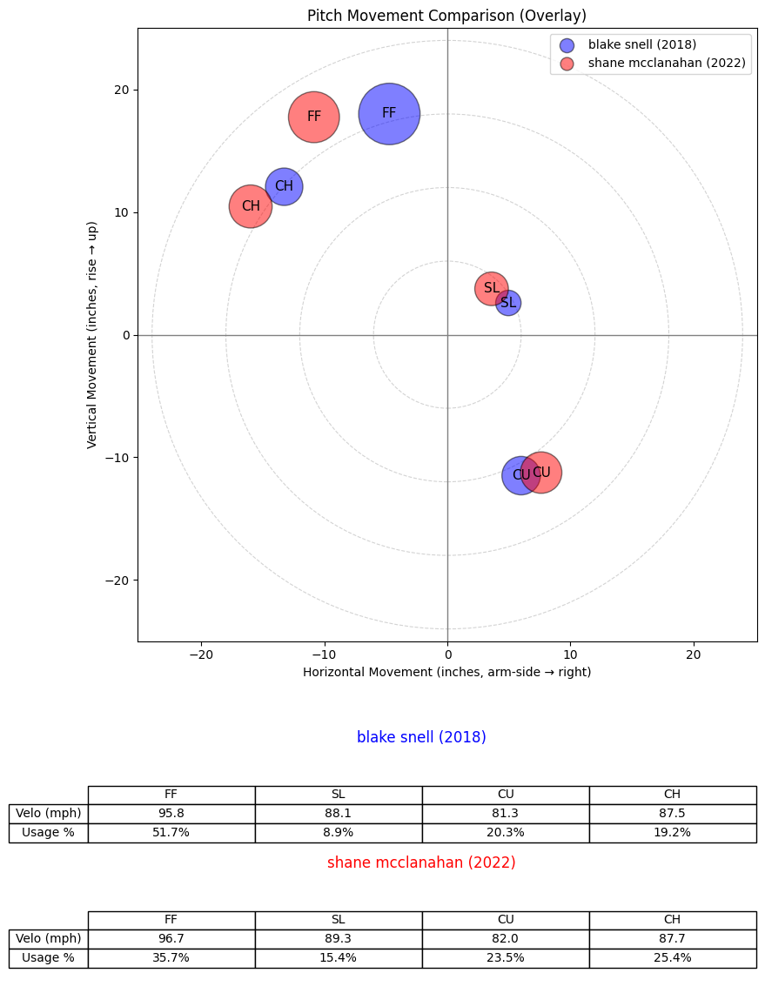

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


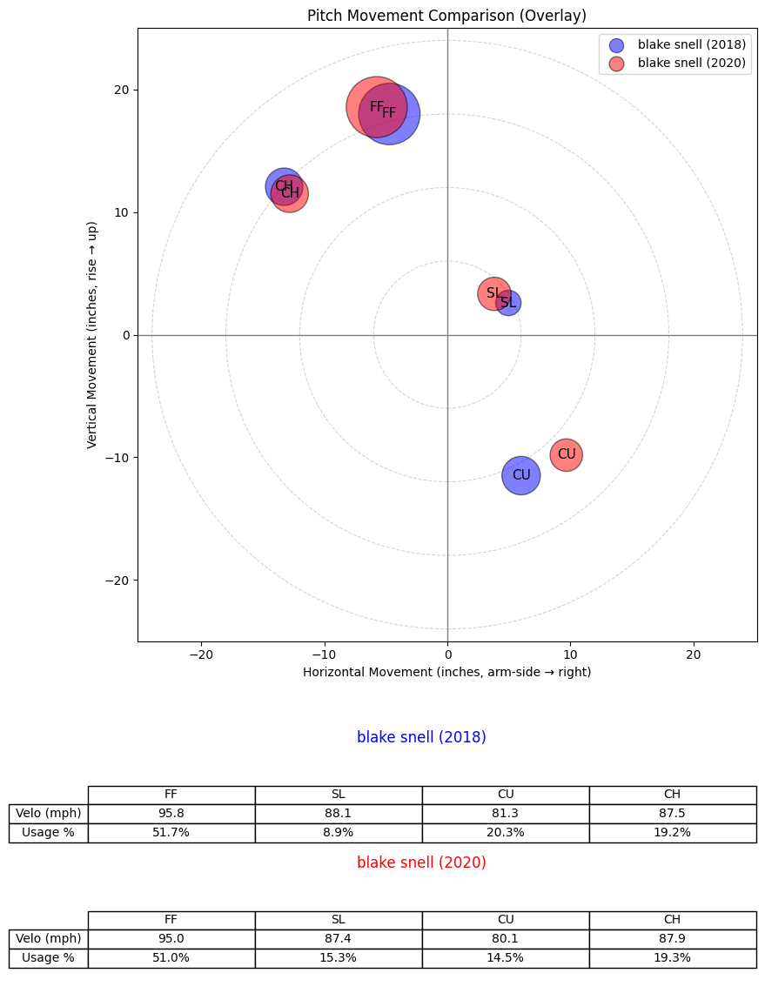

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


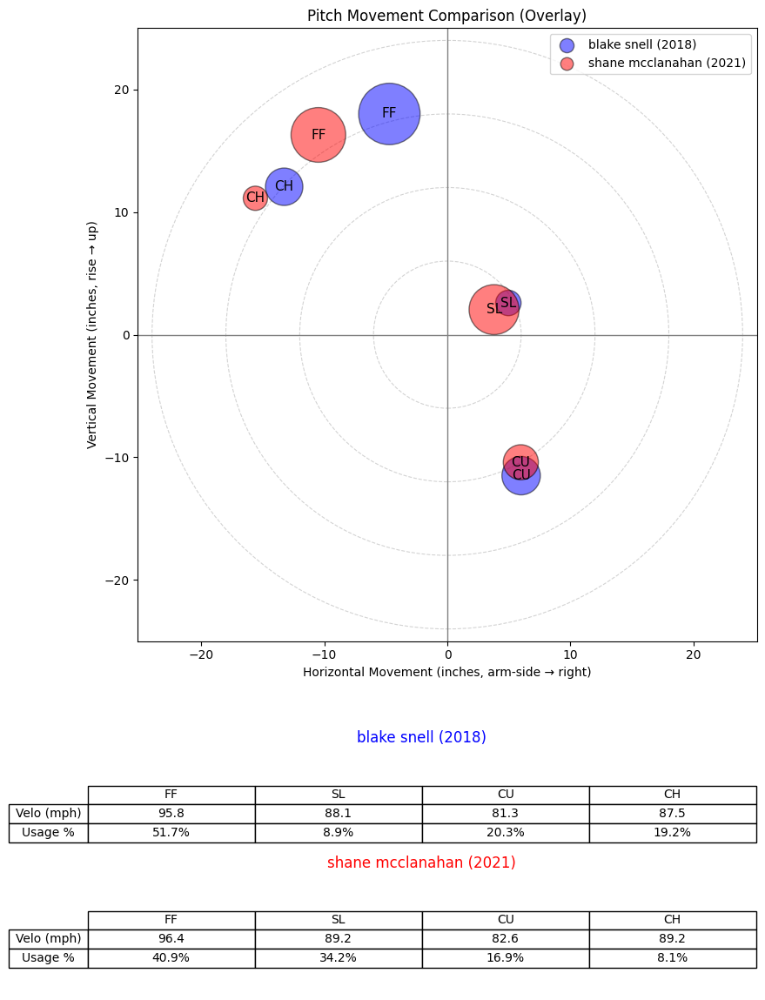

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


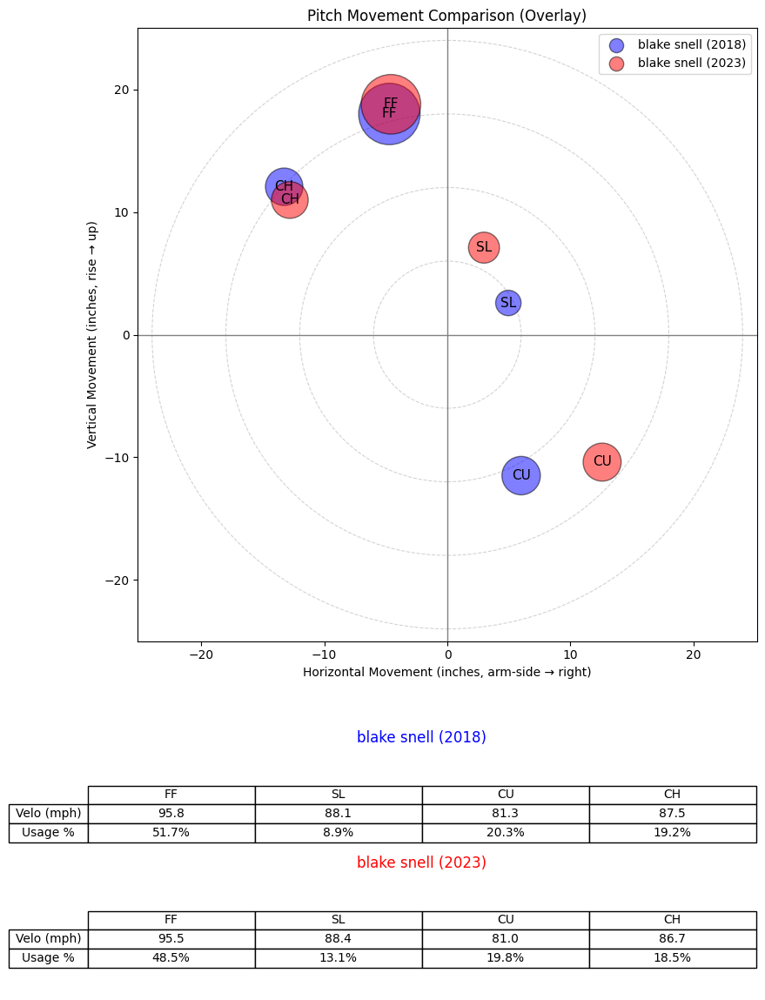

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


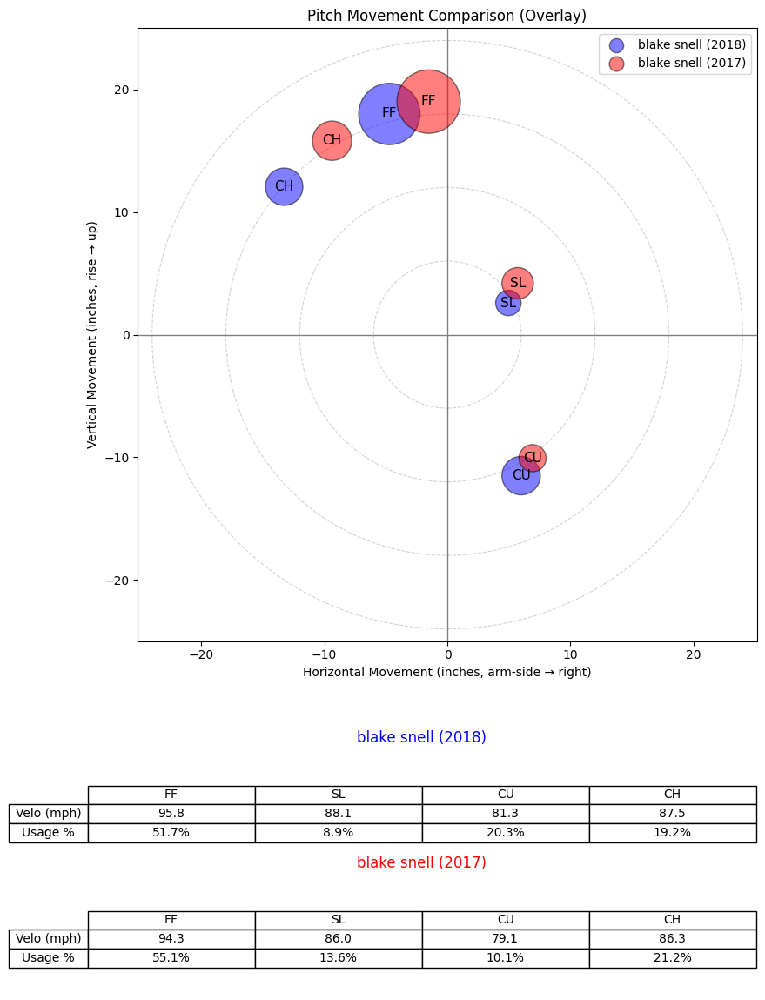

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


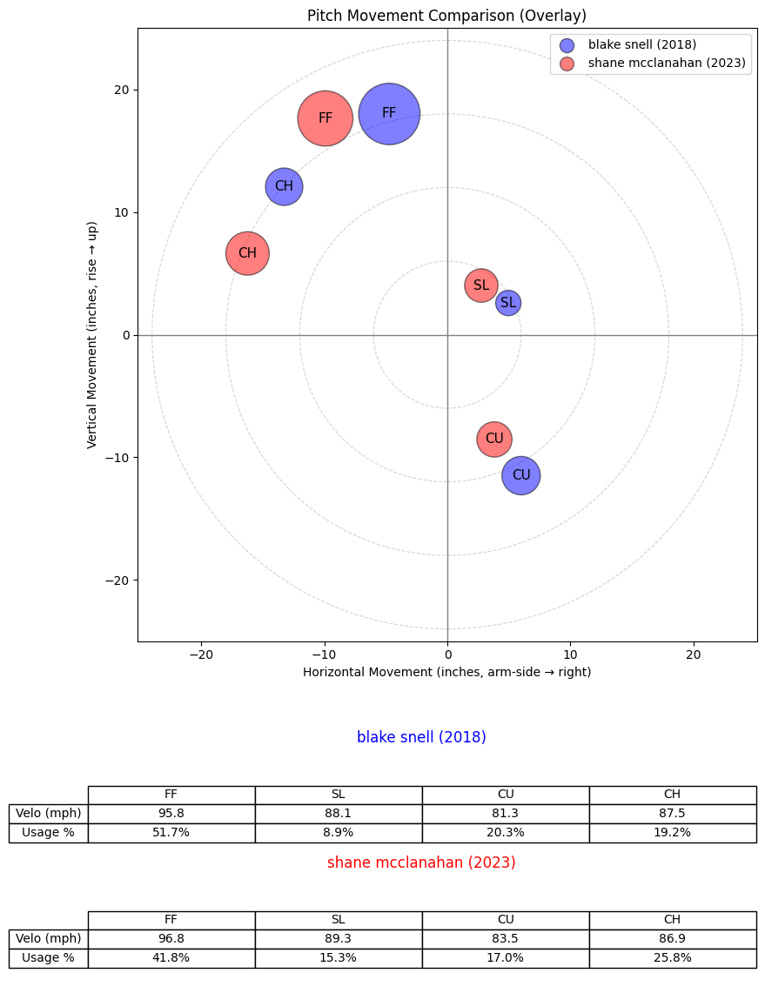

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


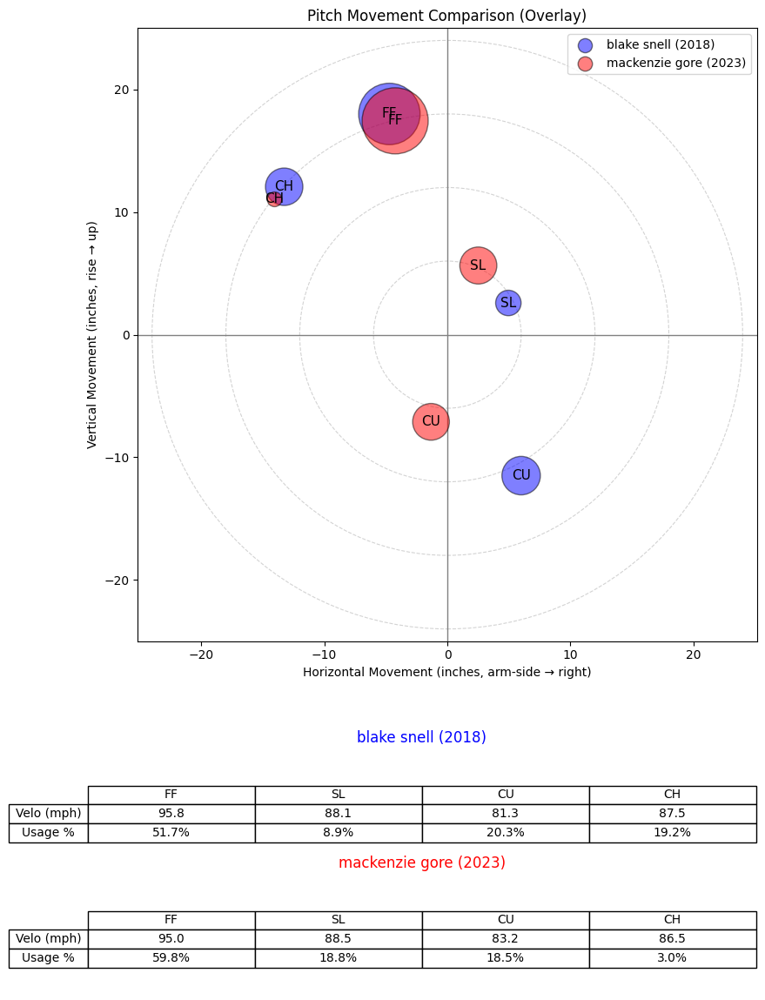

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


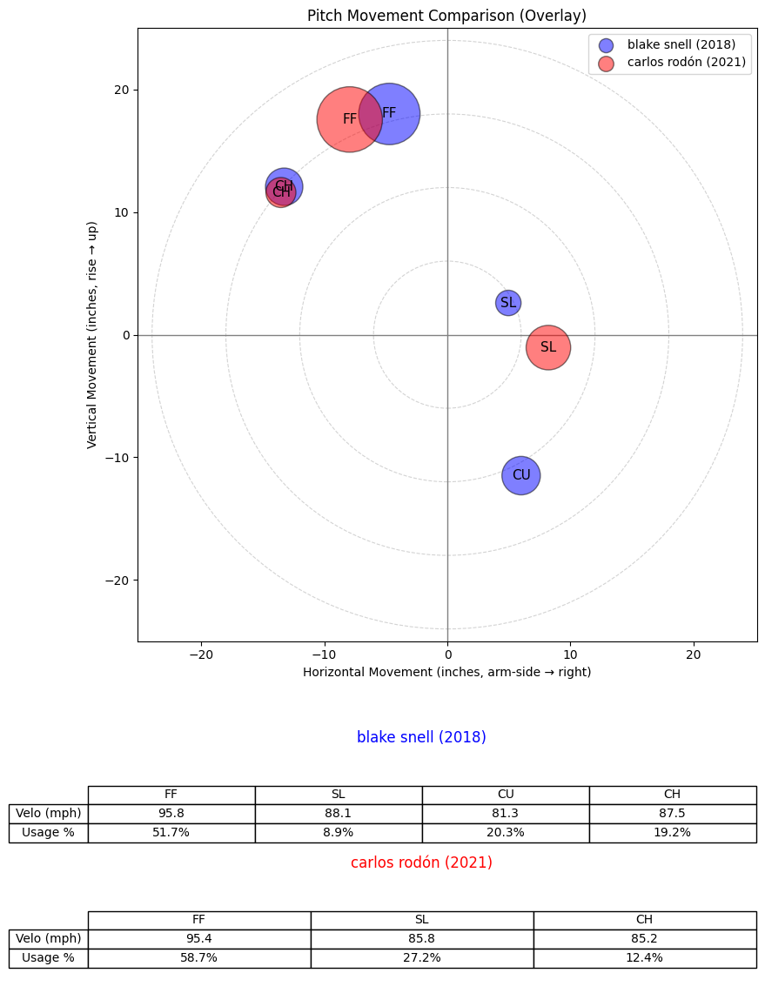

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
1119,605483.0,2021,blake snell,blake,snell,L,starter,0.955532
1120,605483.0,2022,blake snell,blake,snell,L,starter,0.952153
1803,663556.0,2022,shane mcclanahan,shane,mcclanahan,L,starter,0.950539
1118,605483.0,2020,blake snell,blake,snell,L,starter,0.946115
1802,663556.0,2021,shane mcclanahan,shane,mcclanahan,L,starter,0.941962
1121,605483.0,2023,blake snell,blake,snell,L,starter,0.934647
1116,605483.0,2017,blake snell,blake,snell,L,starter,0.925401
1804,663556.0,2023,shane mcclanahan,shane,mcclanahan,L,starter,0.884124
1930,669022.0,2023,mackenzie gore,mackenzie,gore,L,starter,0.841221
1160,607074.0,2021,carlos rodón,carlos,rodón,L,starter,0.821940


In [251]:
neighbors_same_ae = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="blake snell",
    year=2018,
    X_df=X_ae_df,               # <- autoencoder space
    meta_df=pitcher_season_df,
    n_neighbors=10,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same_ae)

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


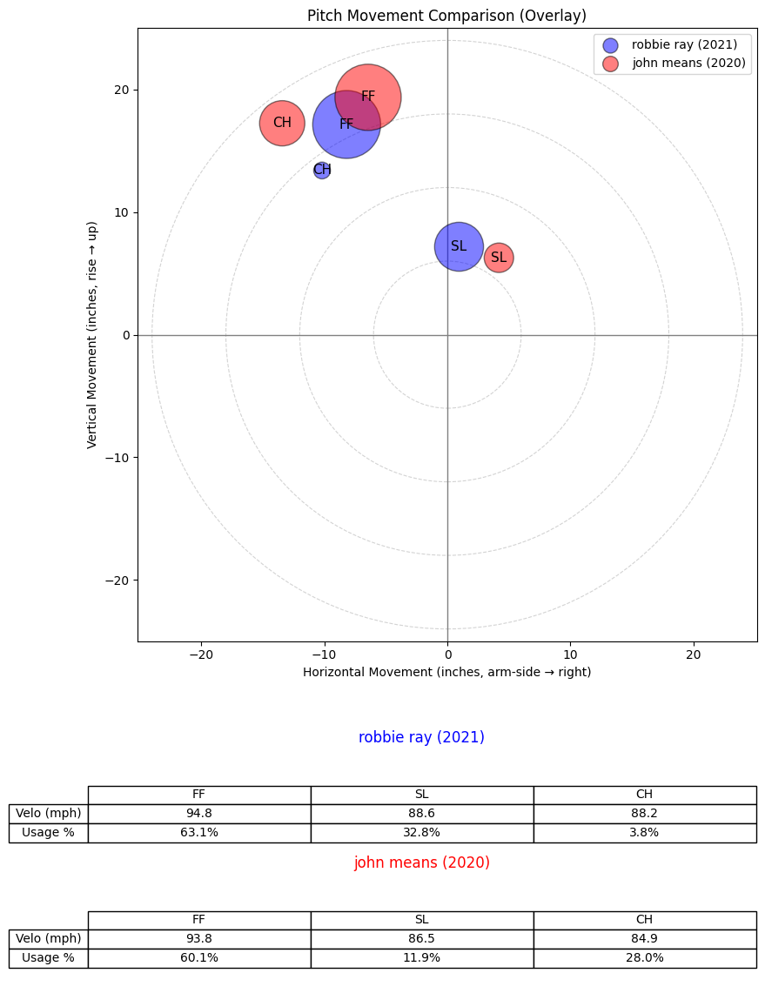

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


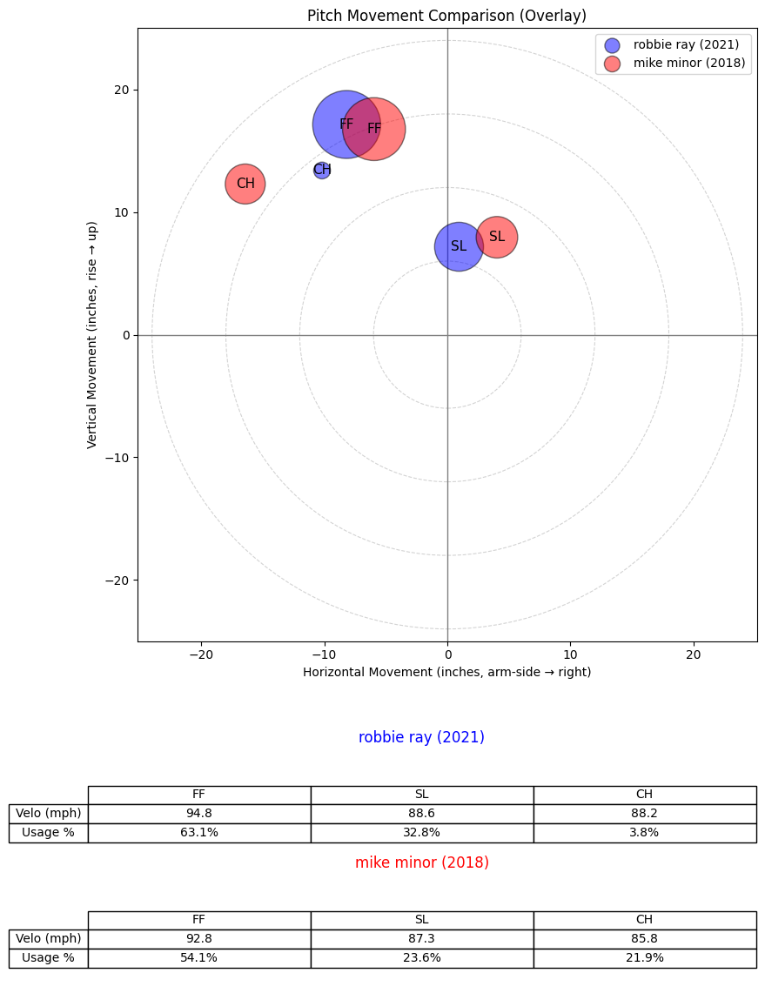

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


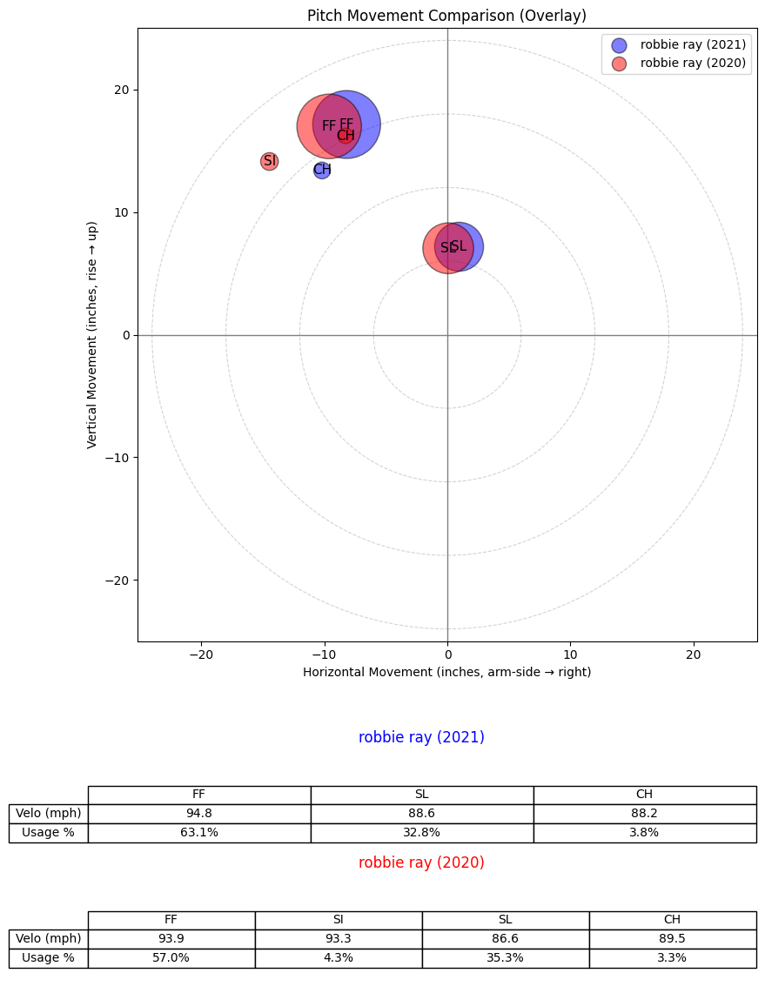

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


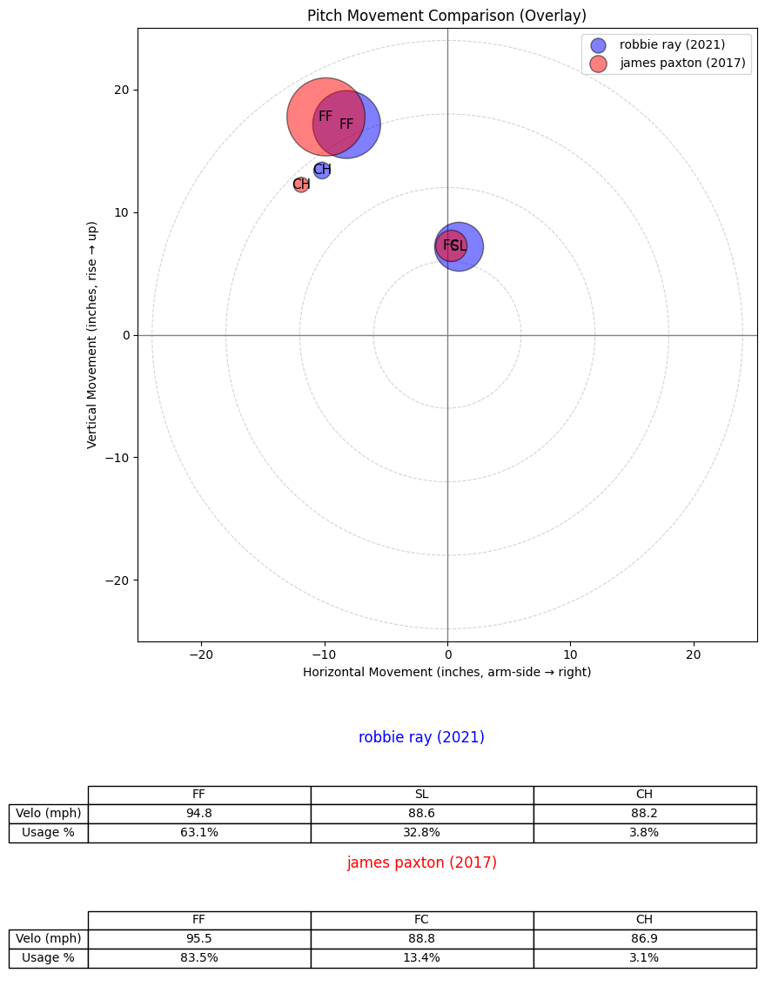

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


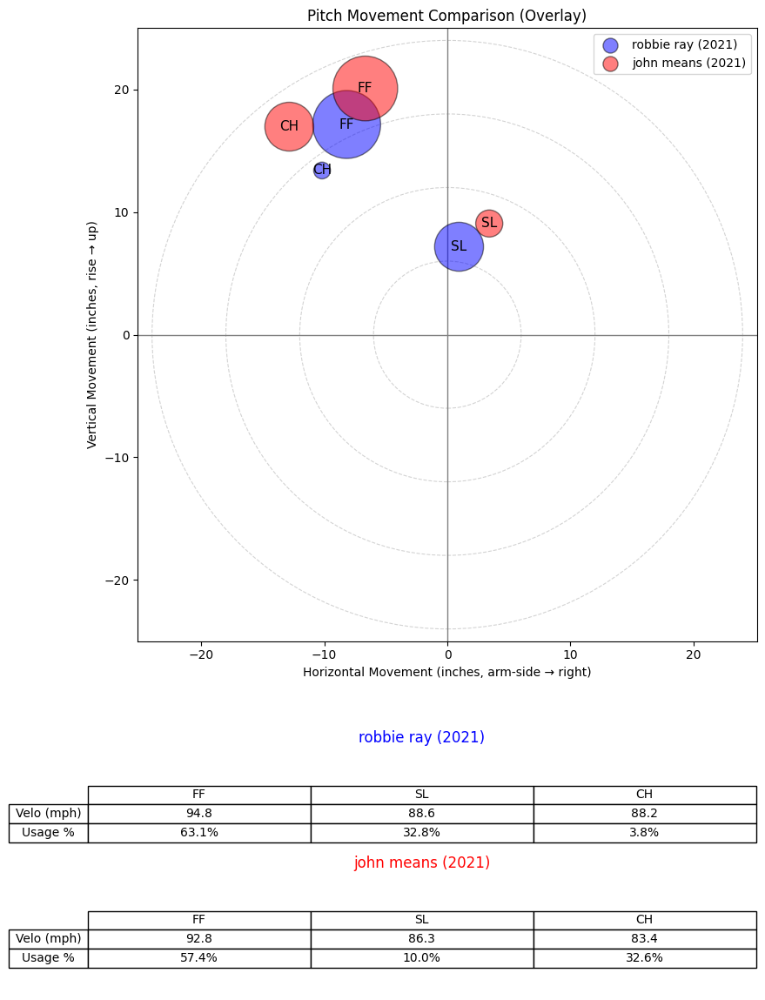

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


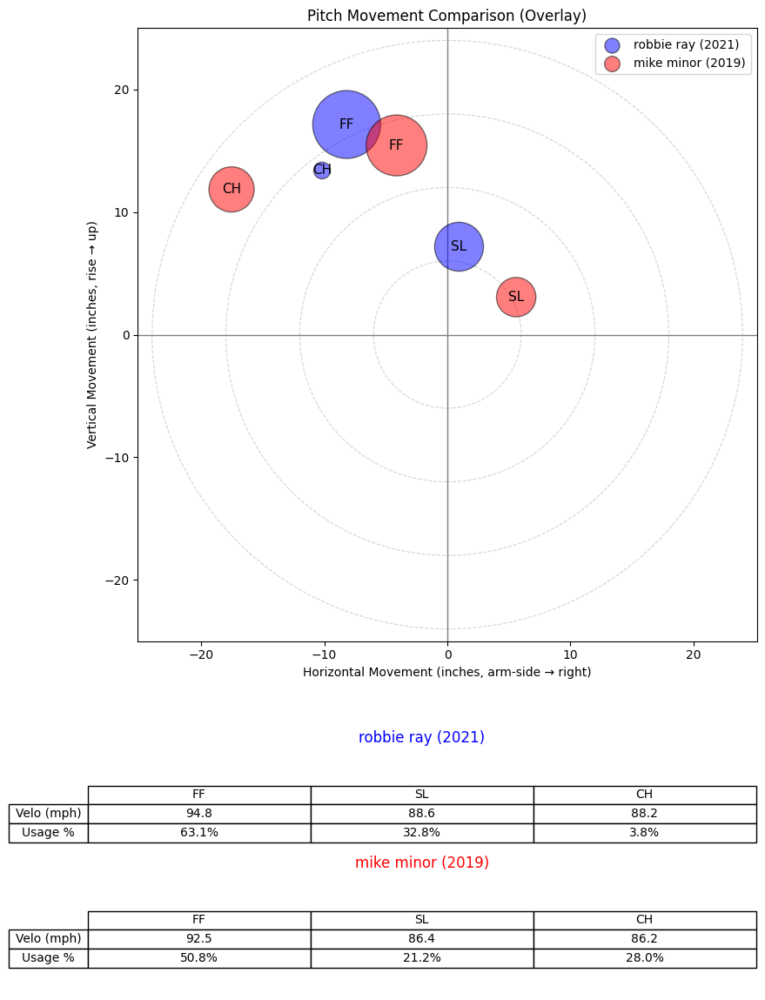

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


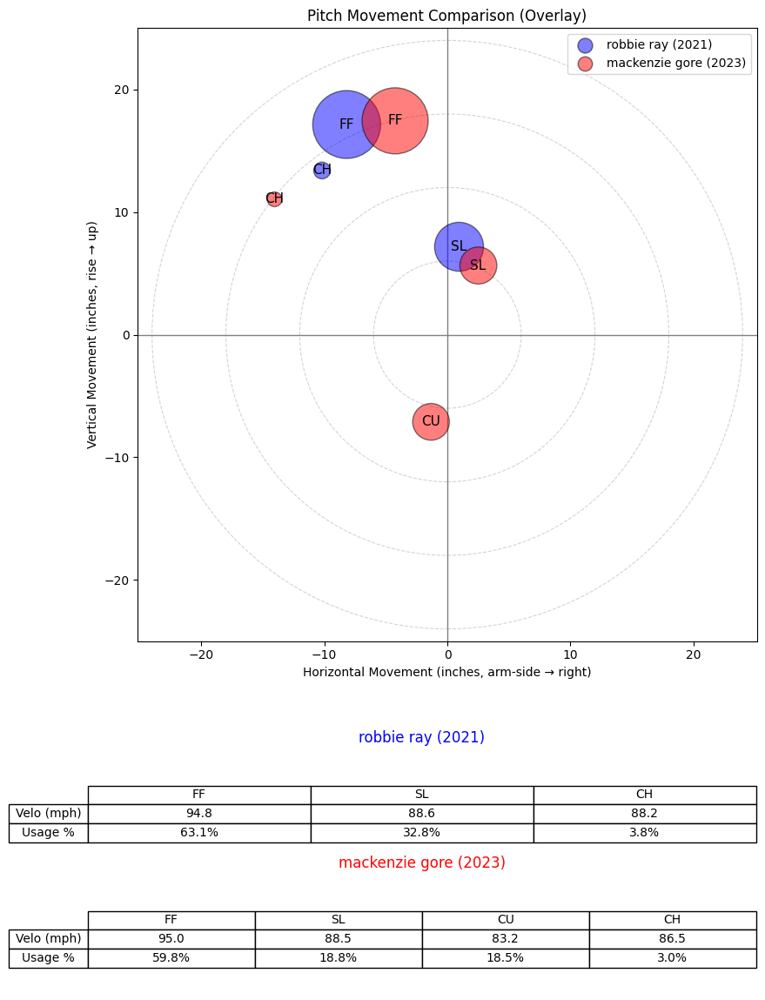

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


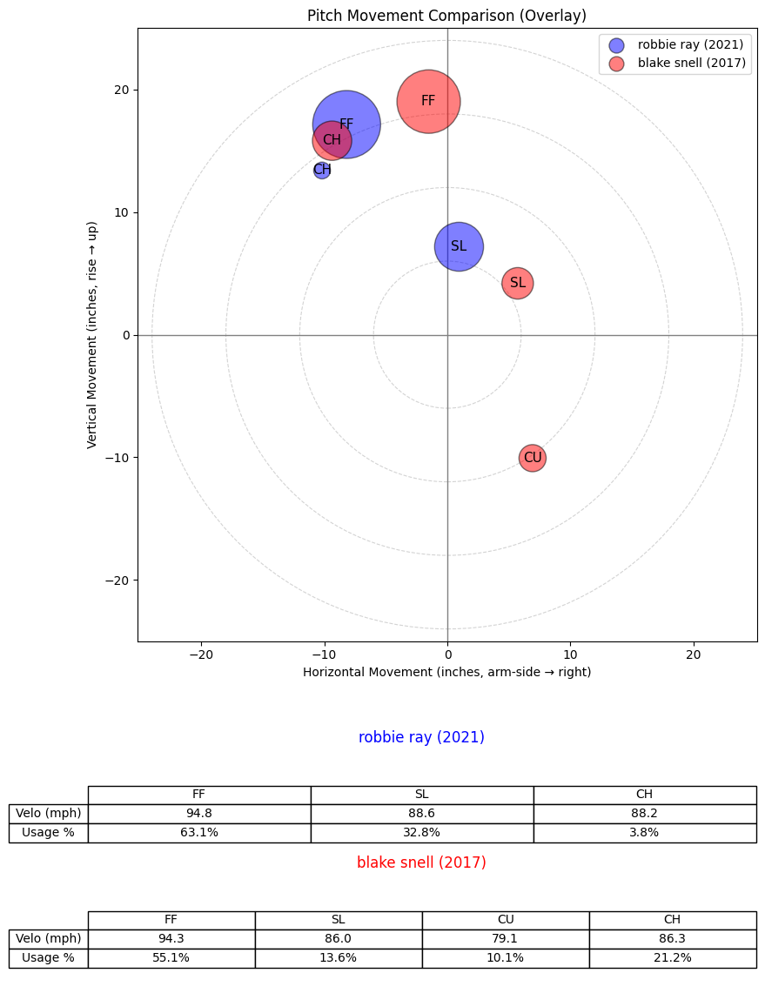

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


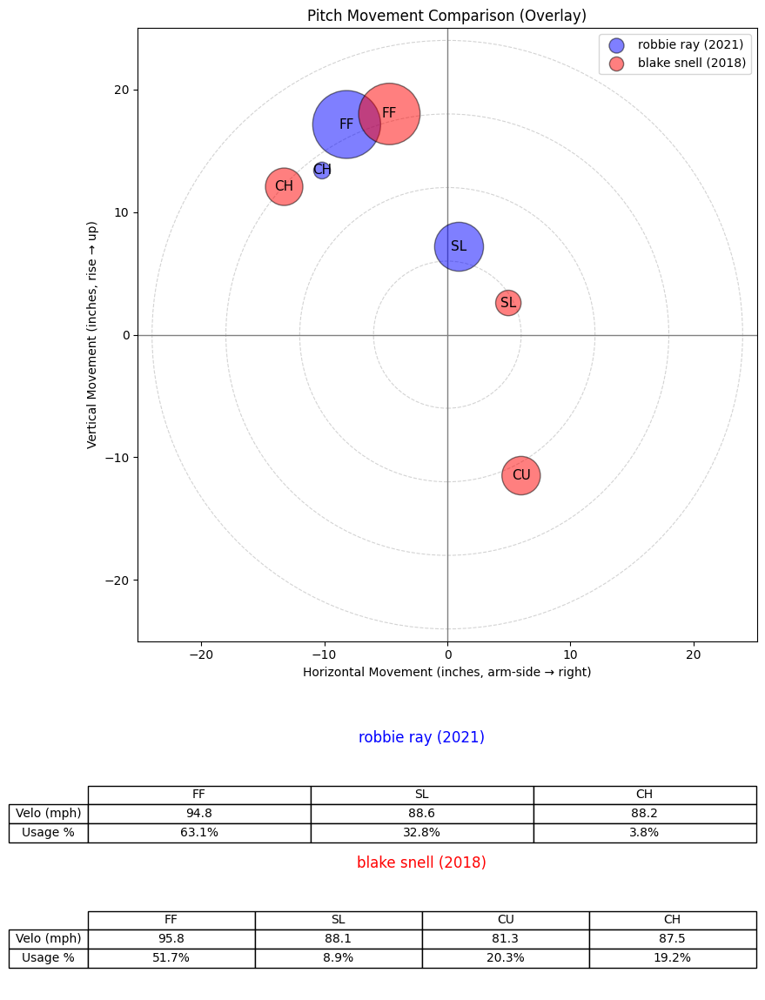

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


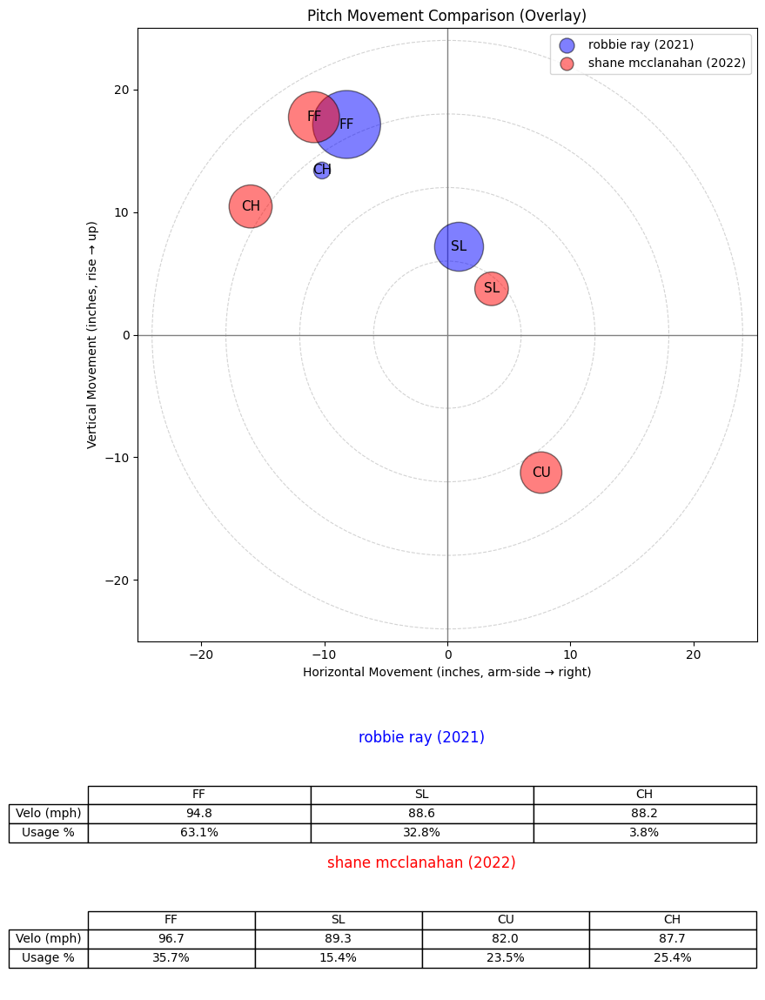

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
1212,607644.0,2020,john means,john,means,L,starter,0.866530
308,501985.0,2018,mike minor,mike,minor,L,starter,0.860242
870,592662.0,2020,robbie ray,robbie,ray,L,starter,0.812811
760,572020.0,2017,james paxton,james,paxton,L,starter,0.788791
1213,607644.0,2021,john means,john,means,L,starter,0.787237
309,501985.0,2019,mike minor,mike,minor,L,starter,0.782443
1930,669022.0,2023,mackenzie gore,mackenzie,gore,L,starter,0.771787
1116,605483.0,2017,blake snell,blake,snell,L,starter,0.767112
1117,605483.0,2018,blake snell,blake,snell,L,starter,0.764218
1803,663556.0,2022,shane mcclanahan,shane,mcclanahan,L,starter,0.757717


In [252]:
neighbors_same_ae = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="robbie ray",
    year=2021,
    X_df=X_ae_df,               # <- autoencoder space
    meta_df=pitcher_season_df,
    n_neighbors=10,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same_ae)

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


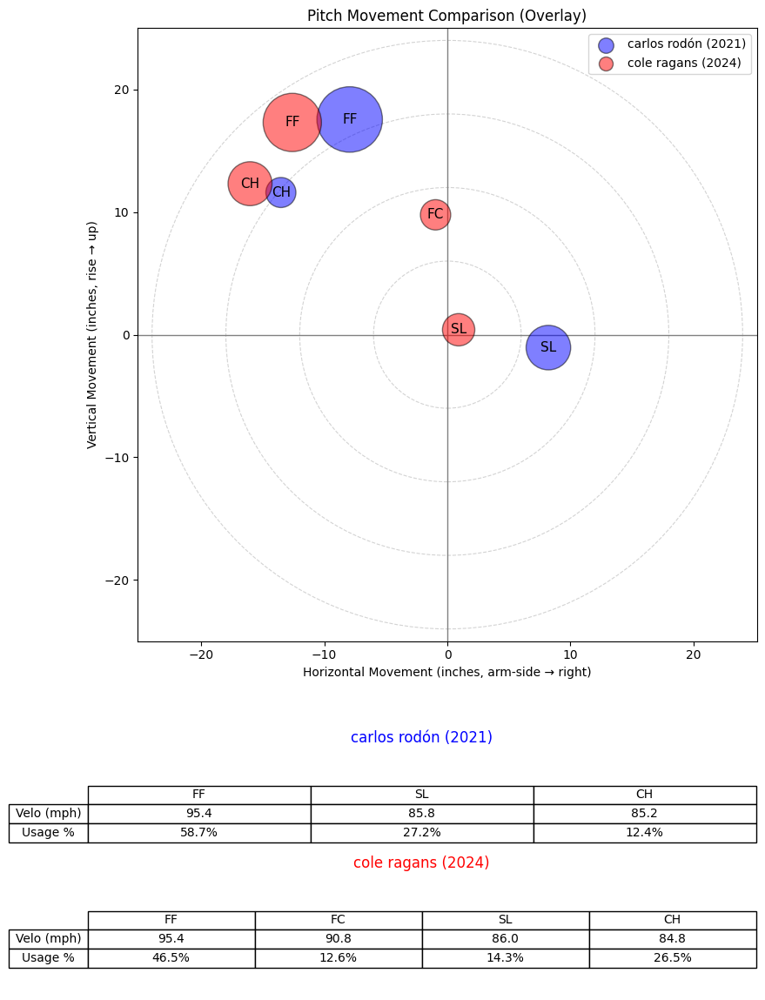

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


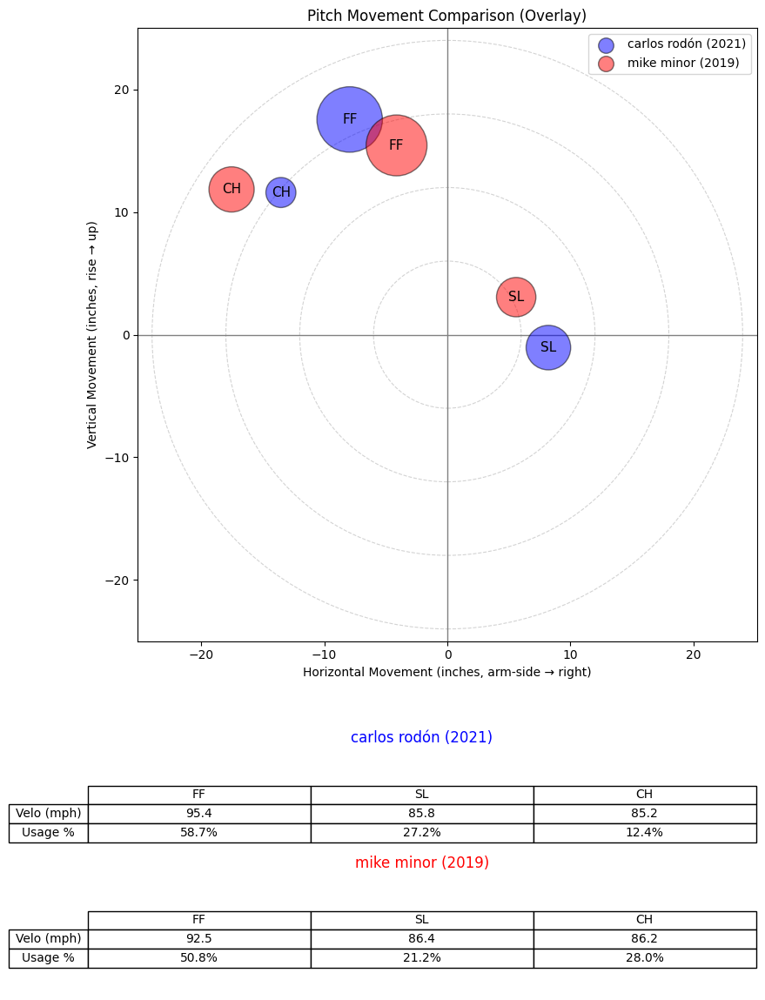

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


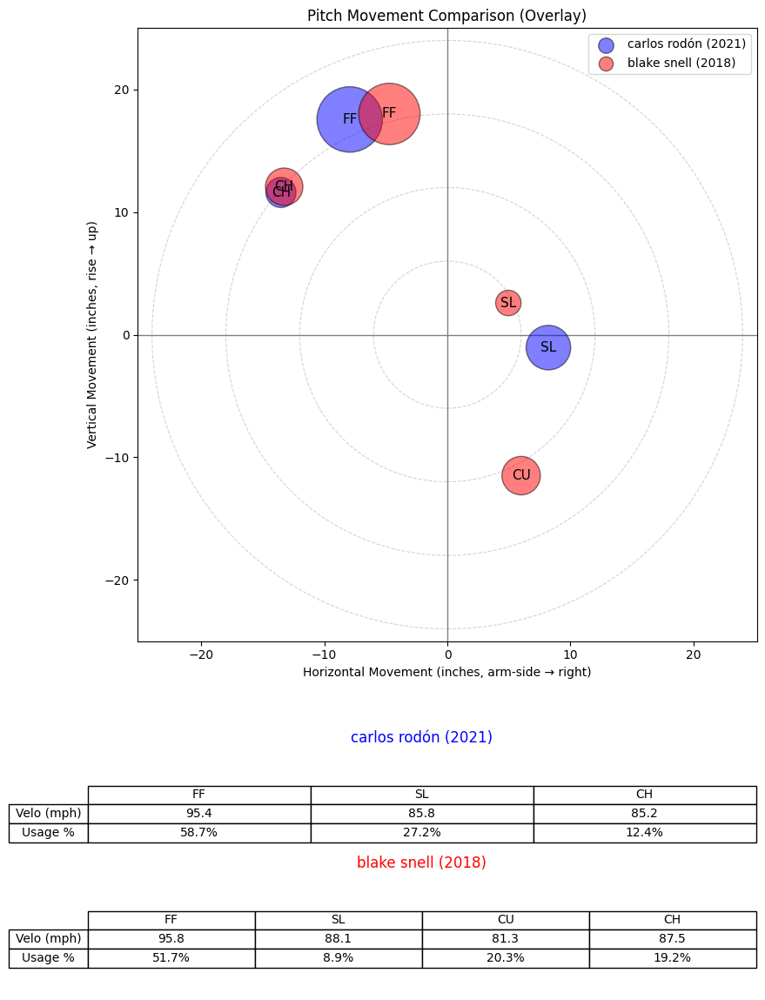

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


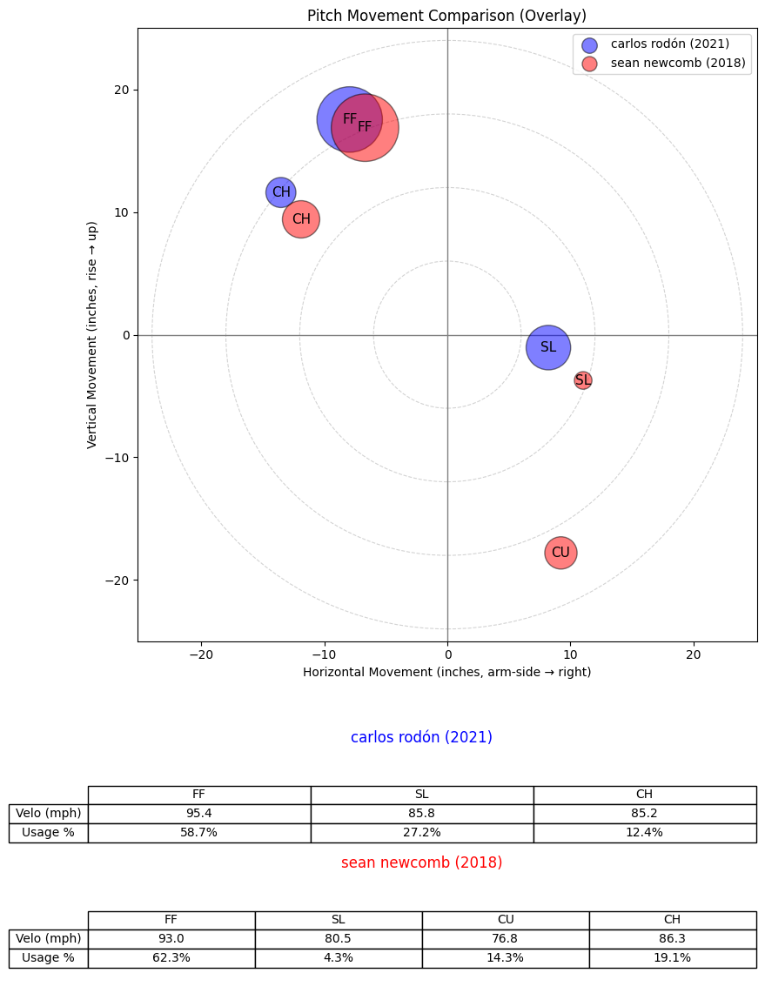

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


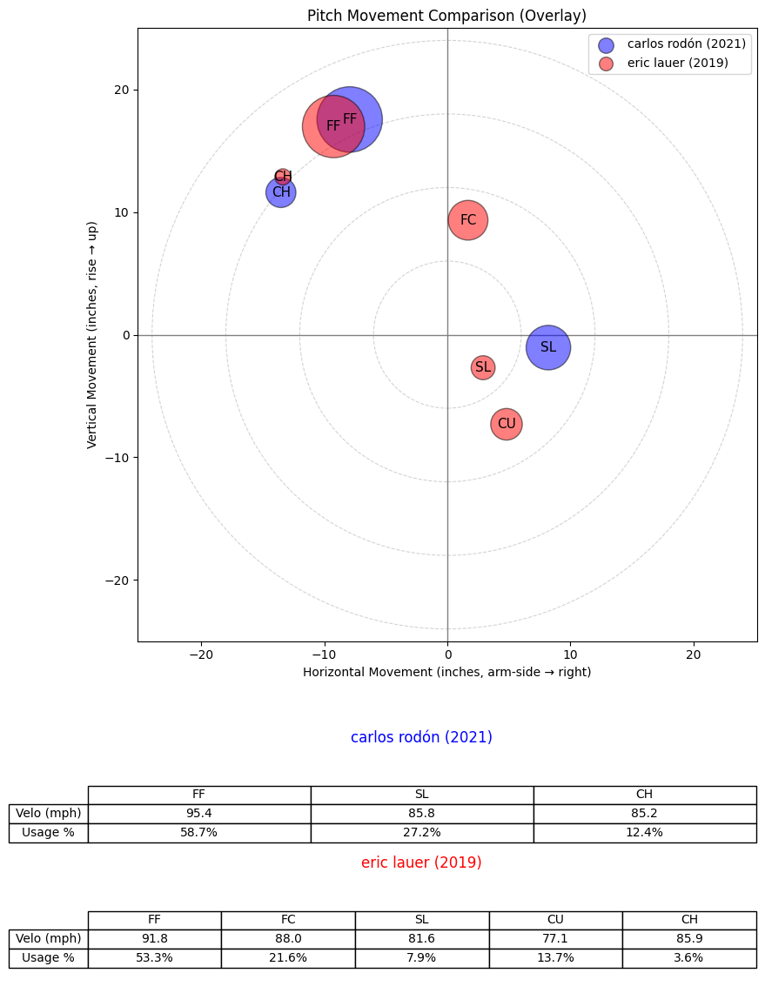

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
1894,666142.0,2024,cole ragans,cole,ragans,L,starter,0.847235
309,501985.0,2019,mike minor,mike,minor,L,starter,0.839127
1117,605483.0,2018,blake snell,blake,snell,L,starter,0.821940
1711,656794.0,2018,sean newcomb,sean,newcomb,L,starter,0.811467
1519,641778.0,2019,eric lauer,eric,lauer,L,starter,0.805580


In [253]:
neighbors_same_ae = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="carlos rodón",
    year=2021,
    X_df=X_ae_df,               # <- autoencoder space
    meta_df=pitcher_season_df,
    n_neighbors=5,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same_ae)

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


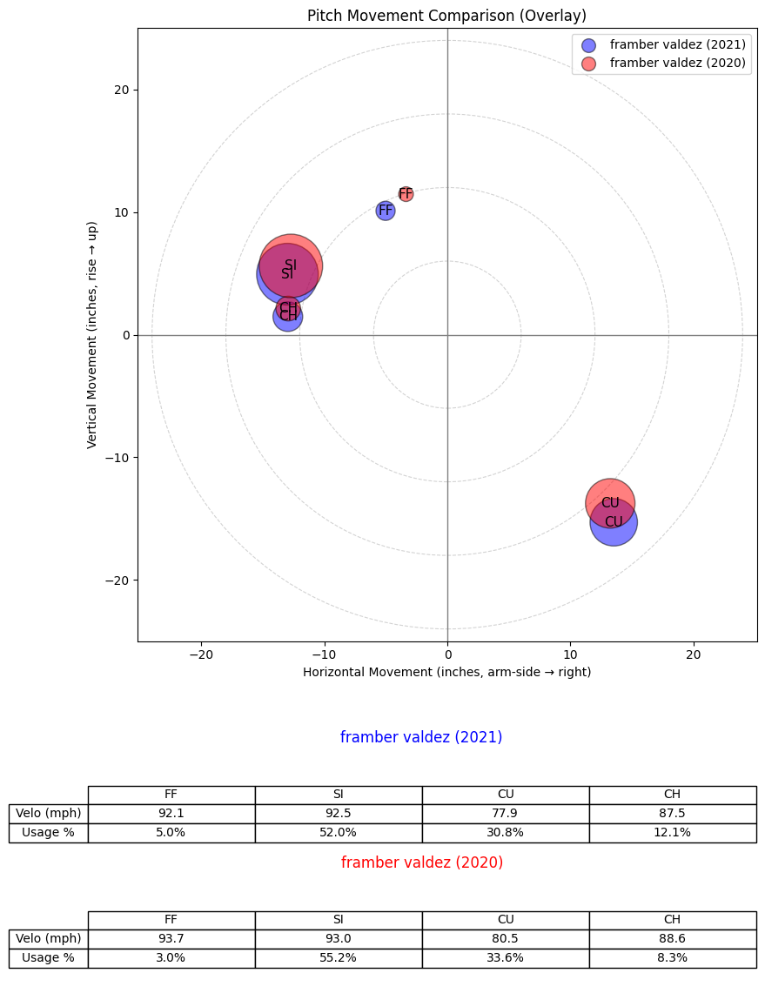

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


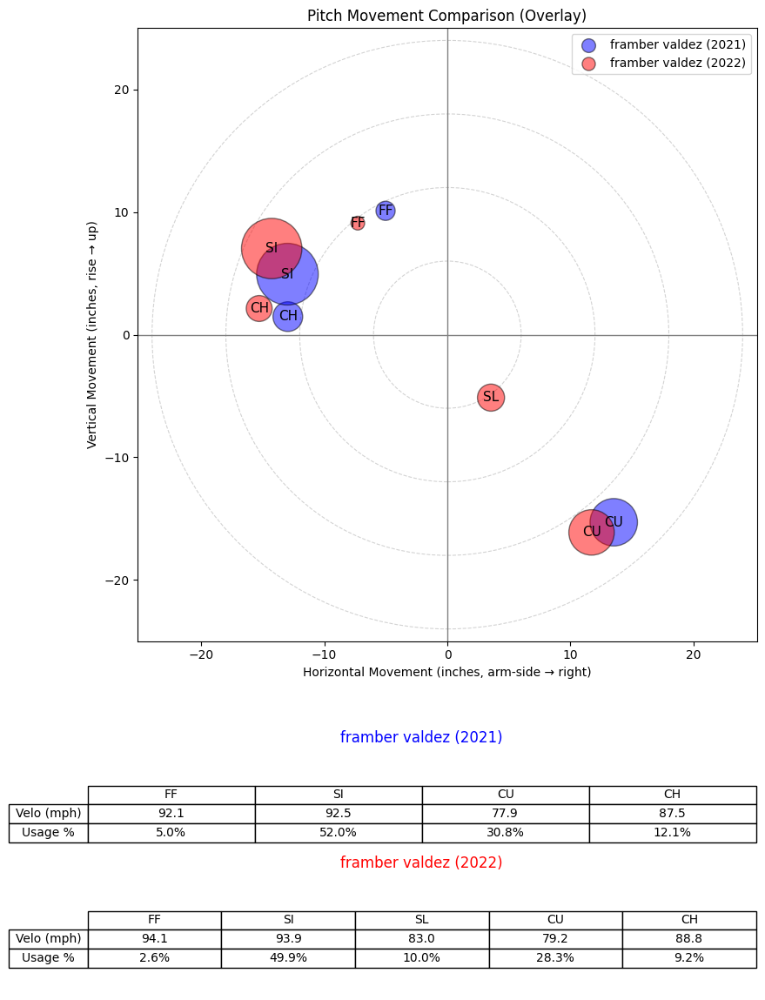

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


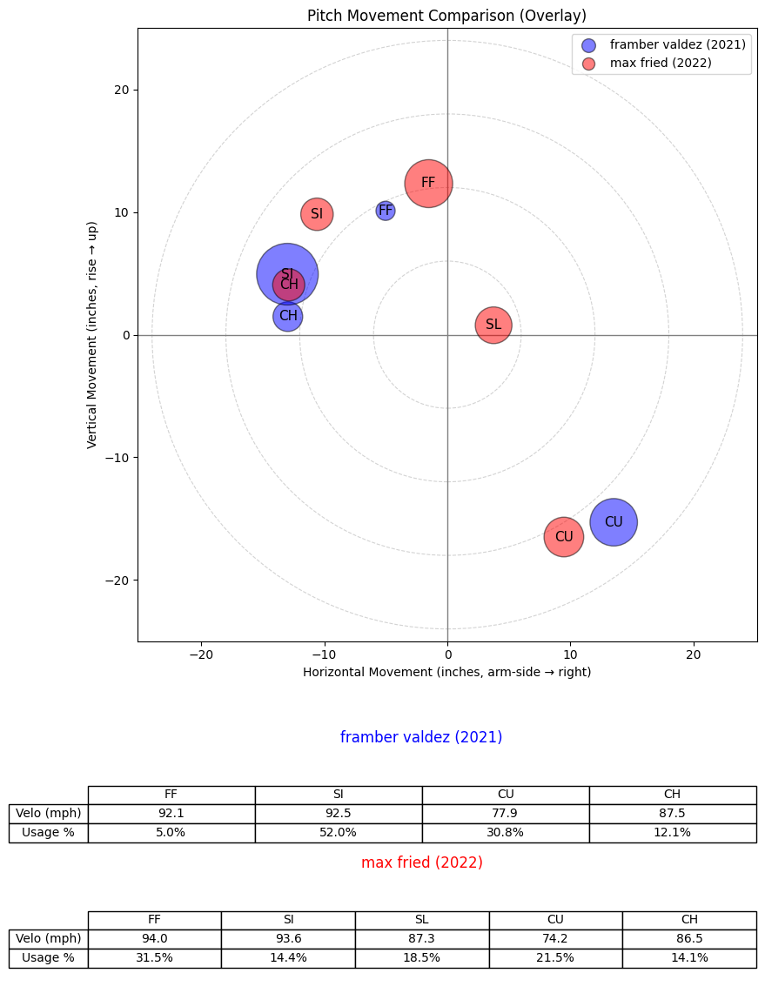

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


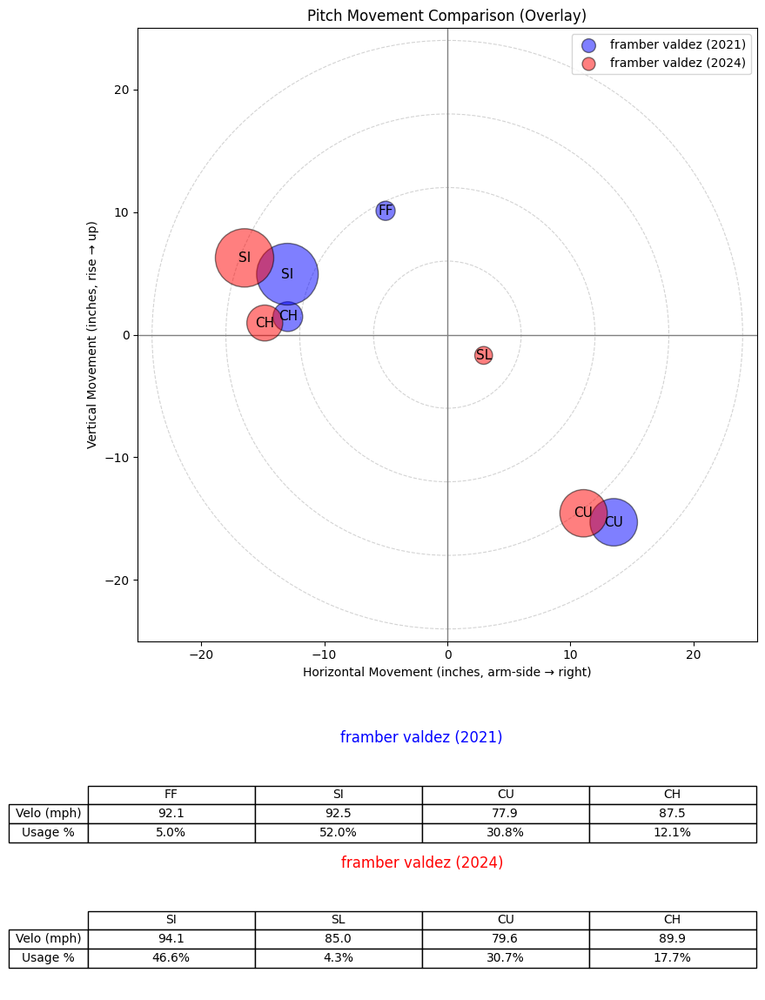

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


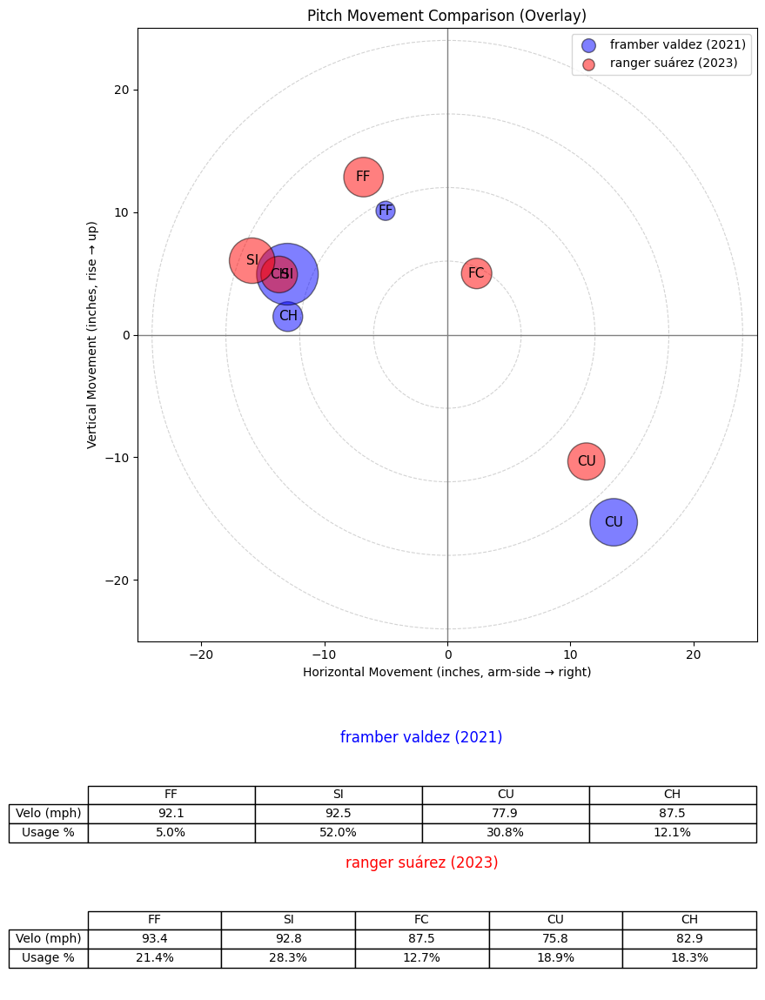

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
1860,664285.0,2020,framber valdez,framber,valdez,L,starter,0.978124
1862,664285.0,2022,framber valdez,framber,valdez,L,starter,0.939447
1224,608331.0,2022,max fried,max,fried,L,starter,0.910210
1864,664285.0,2024,framber valdez,framber,valdez,L,starter,0.904323
1420,624133.0,2023,ranger suárez,ranger,suárez,L,starter,0.875527


In [254]:
neighbors_same_ae = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="framber valdez",
    year=2021,
    X_df=X_ae_df,               # <- autoencoder space
    meta_df=pitcher_season_df,
    n_neighbors=5,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same_ae)

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


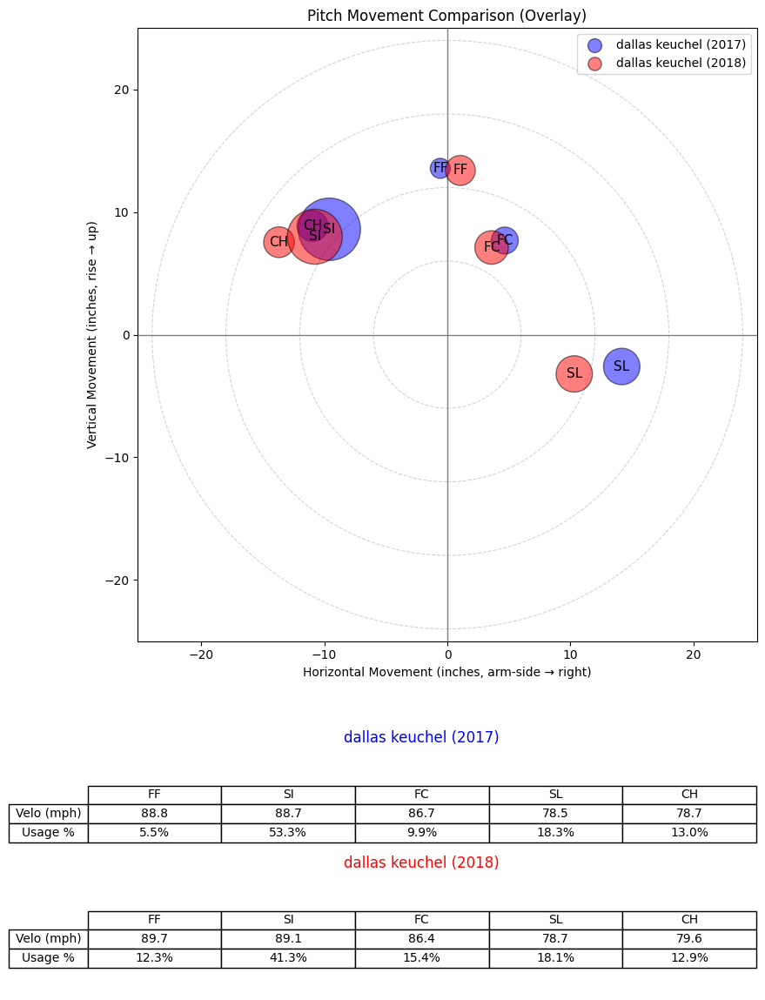

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


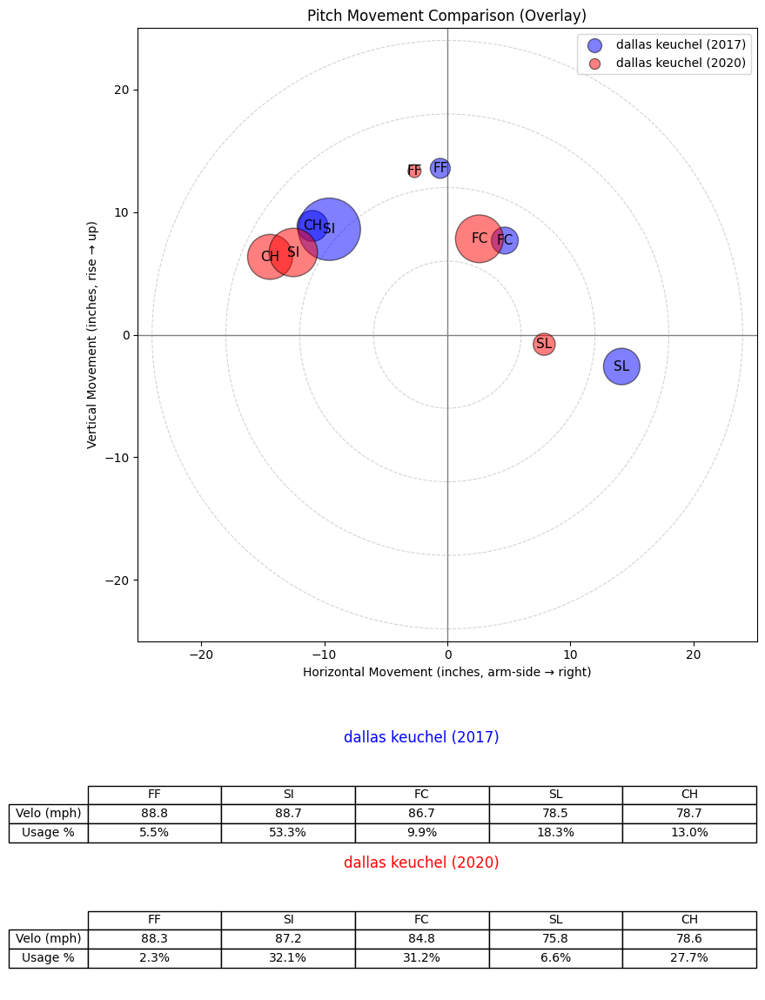

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


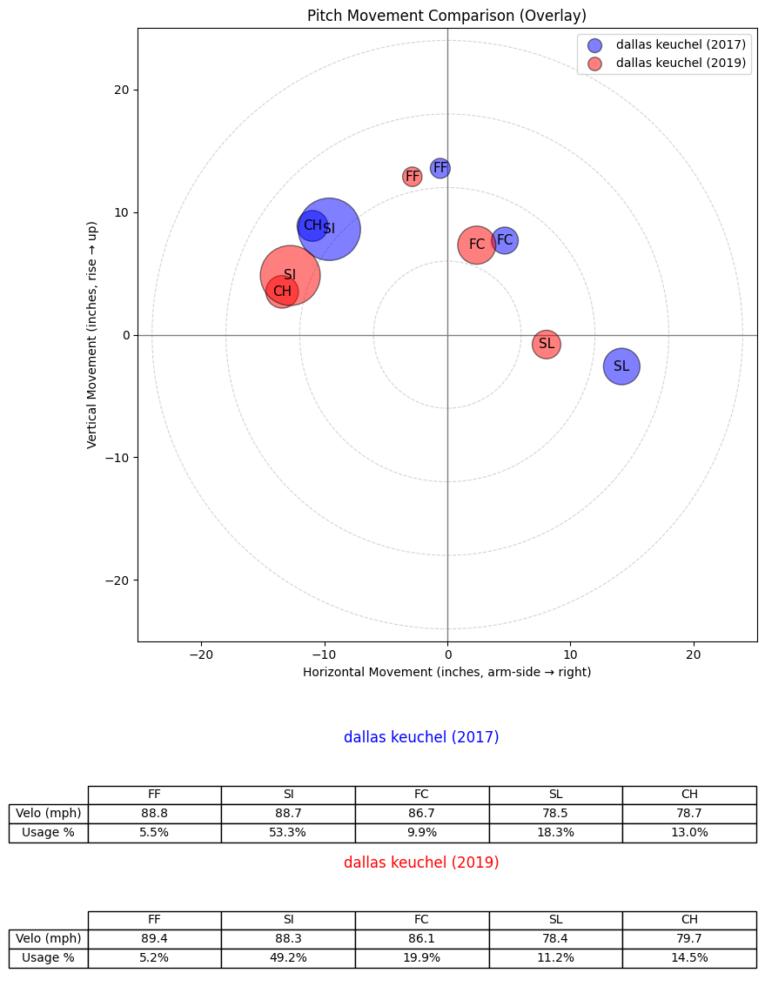

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


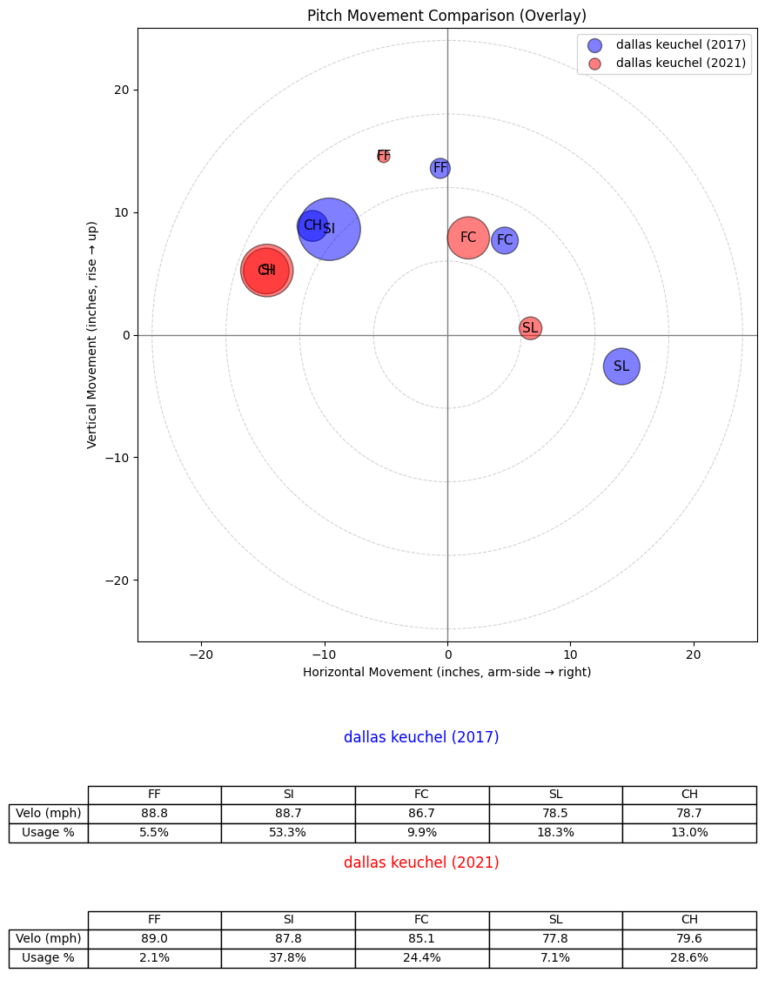

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


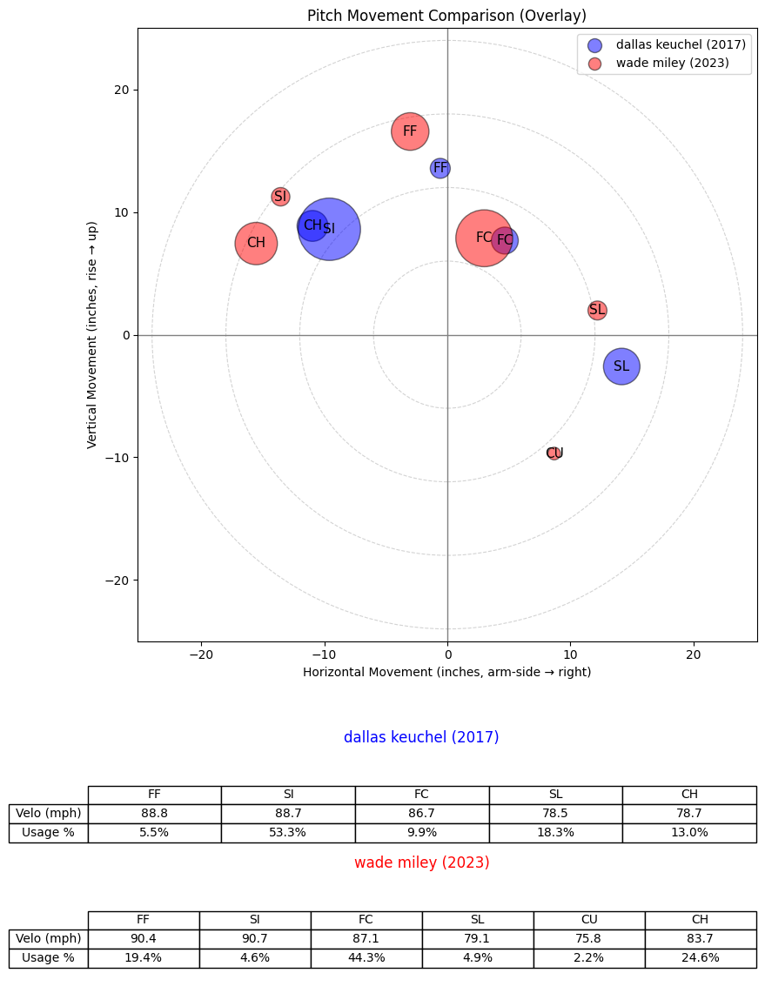

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


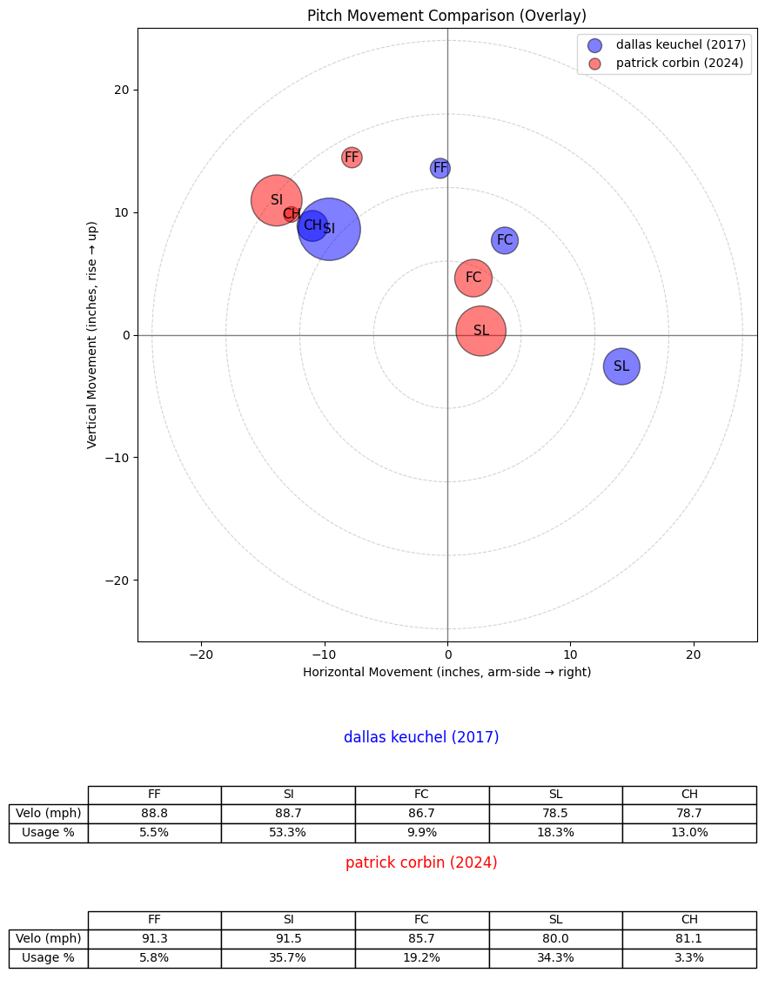

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


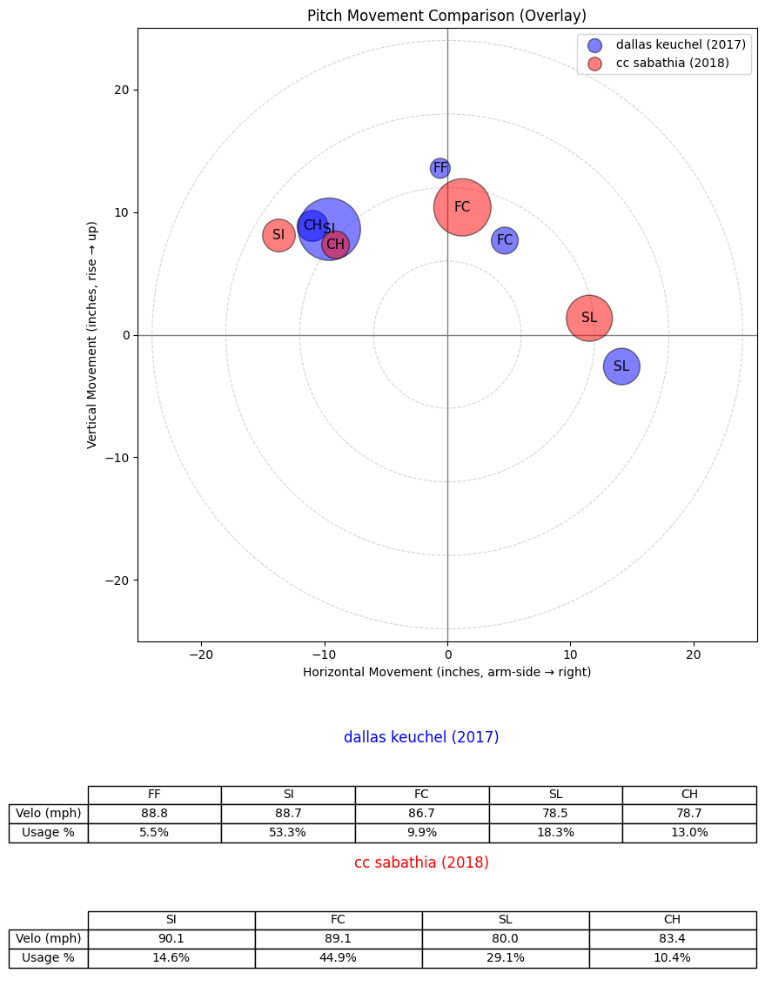

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


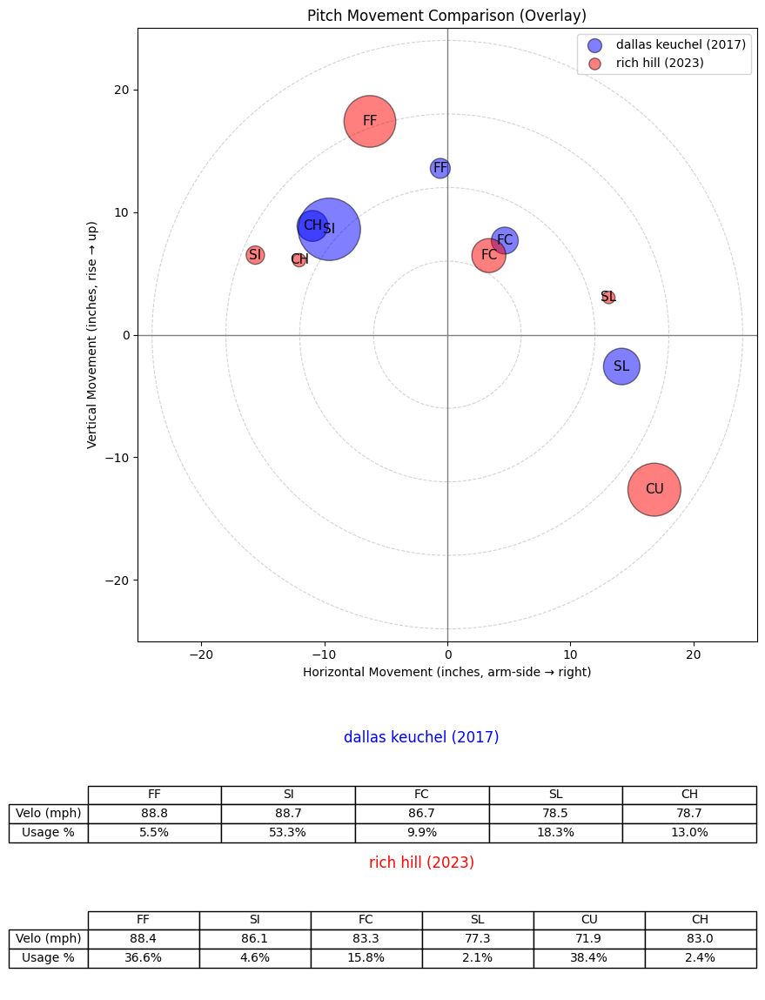

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


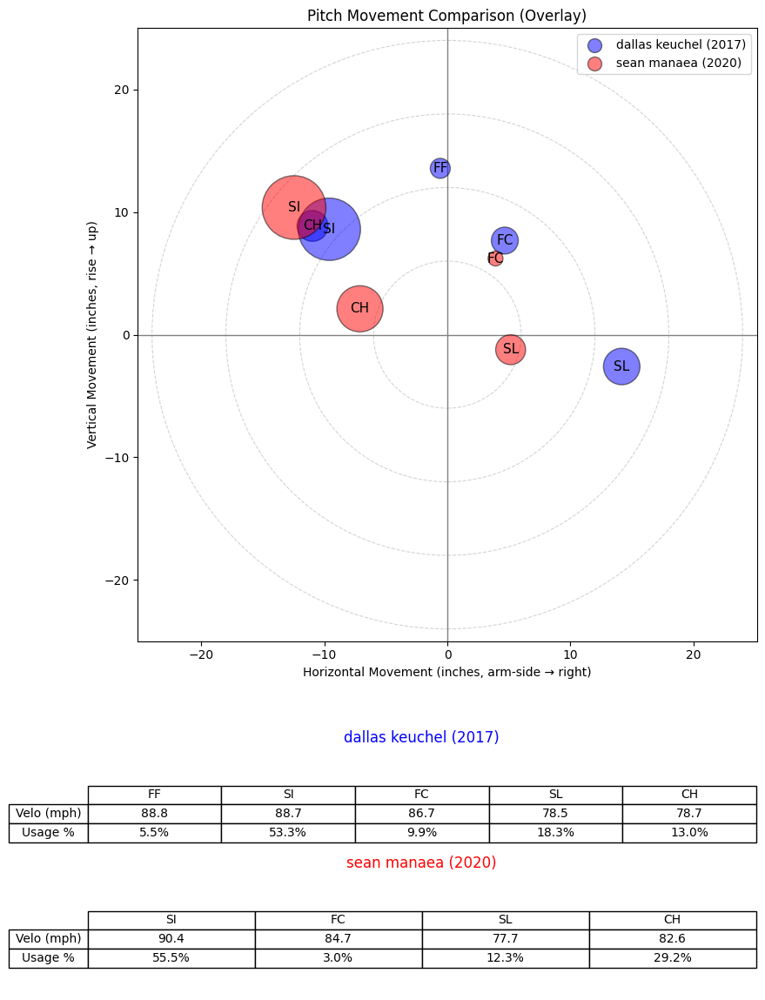

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


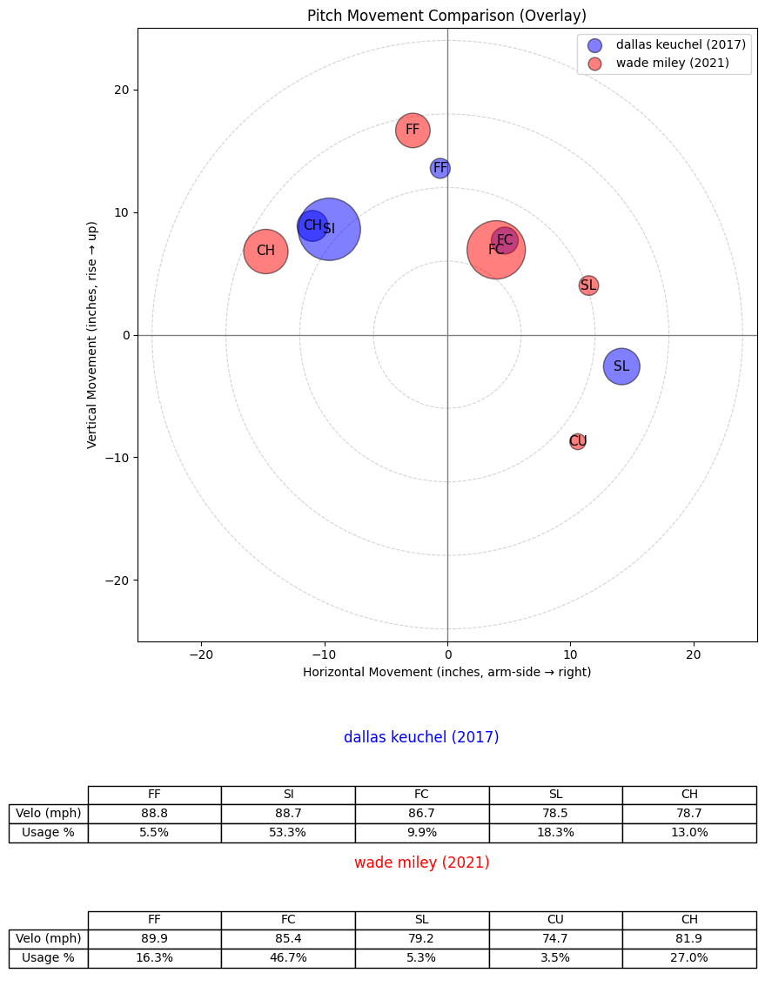

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
788,572971.0,2018,dallas keuchel,dallas,keuchel,L,starter,0.987128
790,572971.0,2020,dallas keuchel,dallas,keuchel,L,starter,0.955251
789,572971.0,2019,dallas keuchel,dallas,keuchel,L,starter,0.947387
791,572971.0,2021,dallas keuchel,dallas,keuchel,L,starter,0.926206
261,489119.0,2023,wade miley,wade,miley,L,starter,0.884854
714,571578.0,2024,patrick corbin,patrick,corbin,L,starter,0.854583
4,282332.0,2018,cc sabathia,cc,sabathia,L,starter,0.841939
83,448179.0,2023,rich hill,rich,hill,L,starter,0.835077
1463,640455.0,2020,sean manaea,sean,manaea,L,starter,0.818345
260,489119.0,2021,wade miley,wade,miley,L,starter,0.801676


In [255]:
neighbors_same_ae = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="dallas keuchel",
    year=2017,
    X_df=X_ae_df,               # <- autoencoder space
    meta_df=pitcher_season_df,
    n_neighbors=10,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same_ae)

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


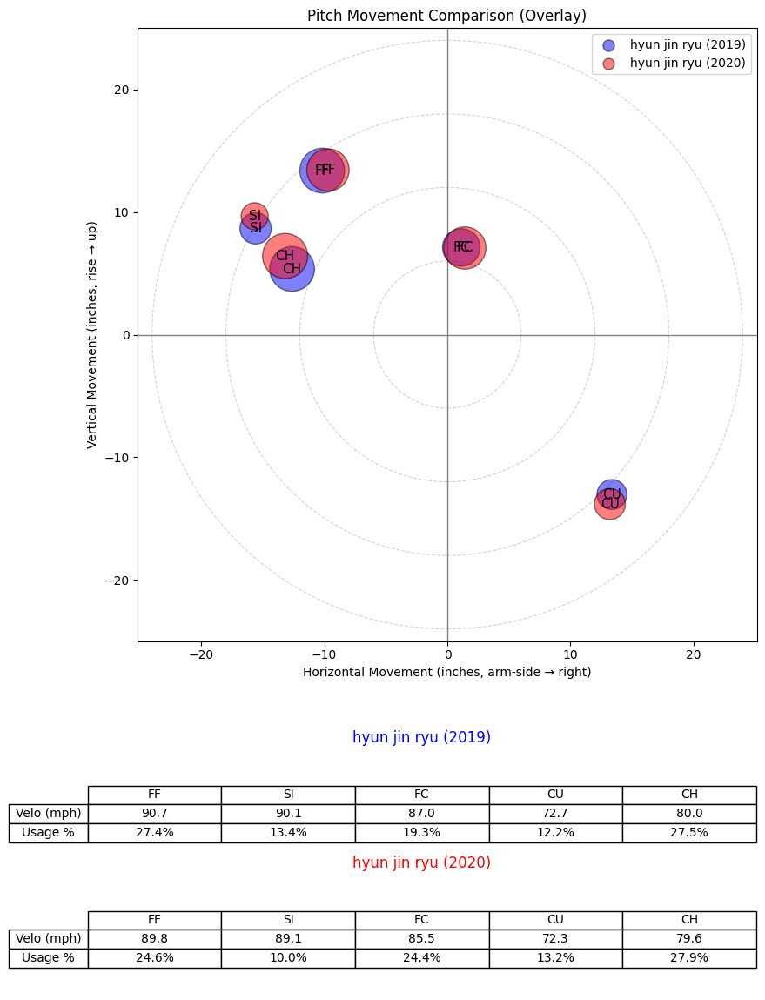

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


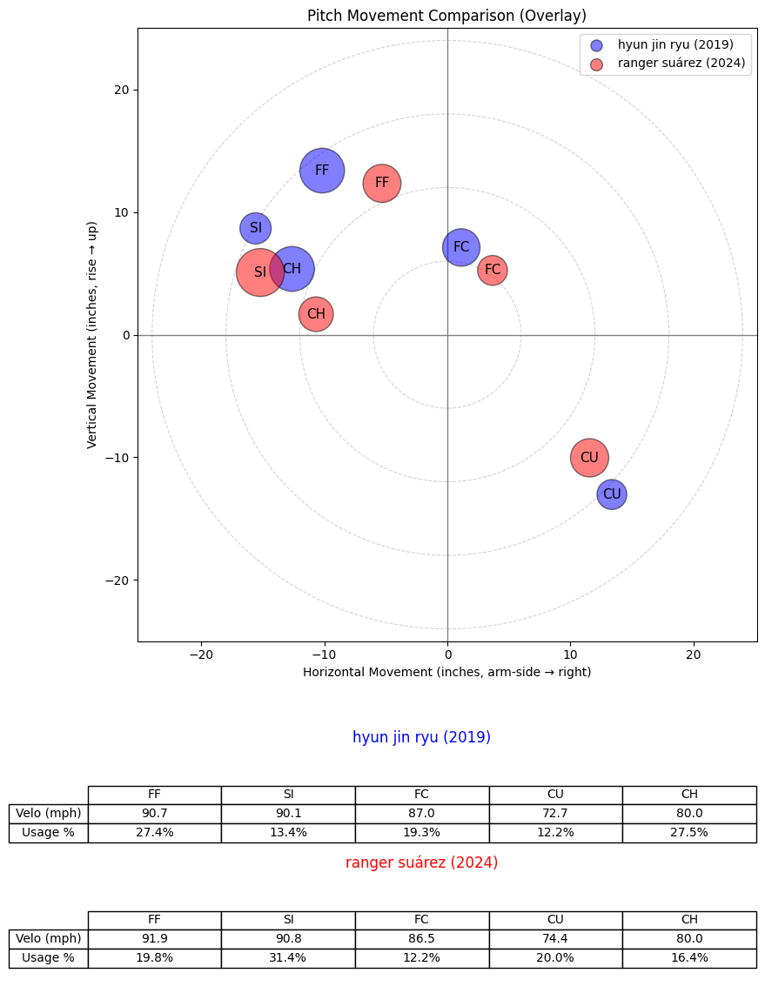

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


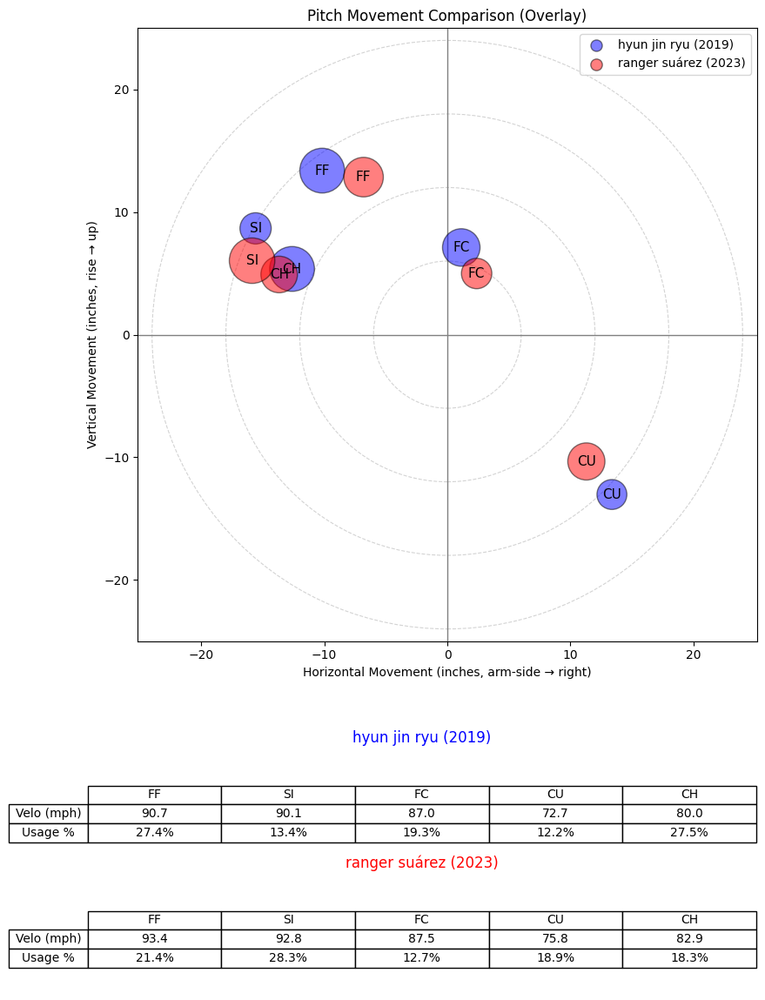

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


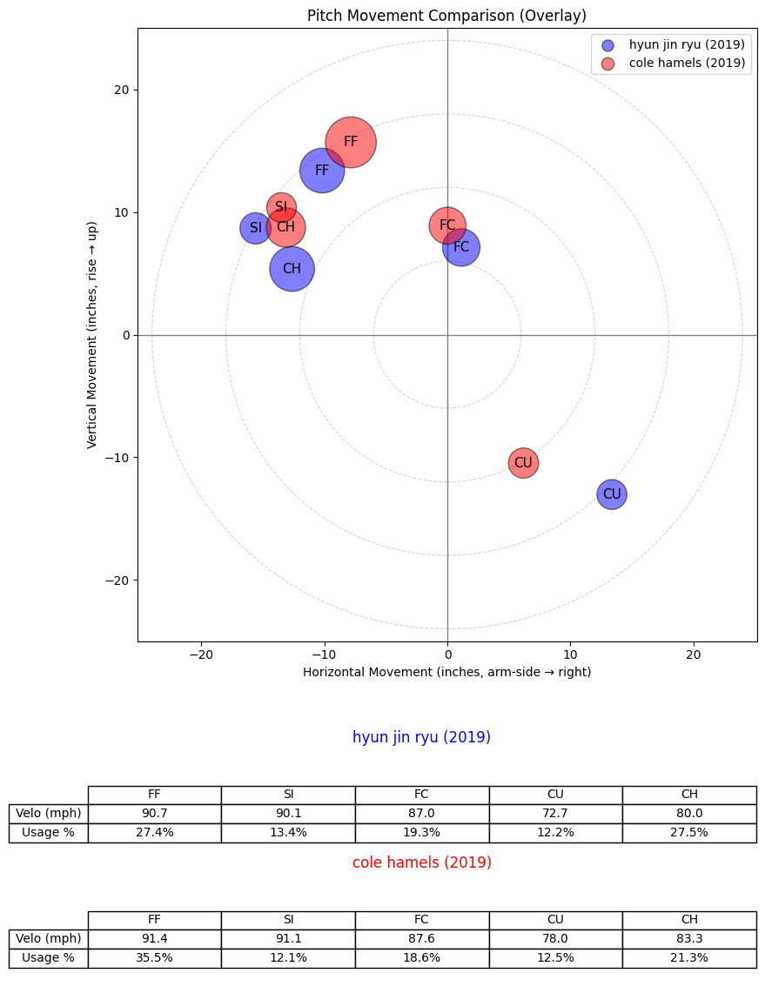

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


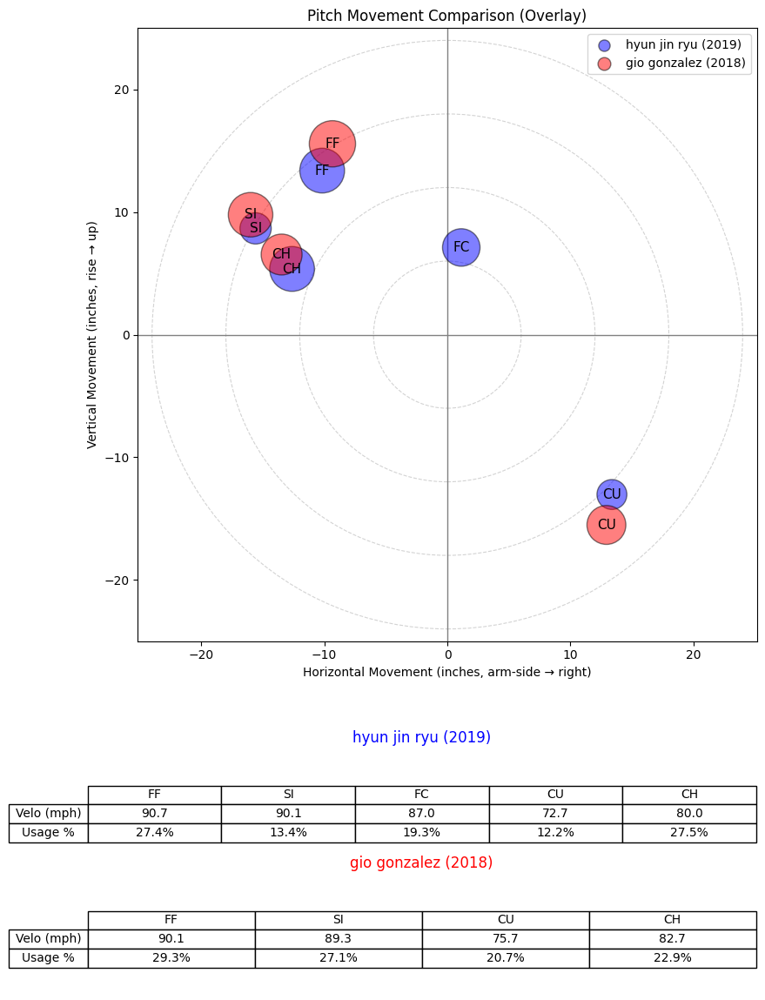

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
656,547943.0,2020,hyun jin ryu,hyun jin,ryu,L,starter,0.988494
1421,624133.0,2024,ranger suárez,ranger,suárez,L,starter,0.936501
1420,624133.0,2023,ranger suárez,ranger,suárez,L,starter,0.932621
29,430935.0,2019,cole hamels,cole,hamels,L,starter,0.932099
198,461829.0,2018,gio gonzalez,gio,gonzalez,L,starter,0.928023


In [256]:
neighbors_same_ae = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="hyun jin ryu",
    year=2019,
    X_df=X_ae_df,               # <- autoencoder space
    meta_df=pitcher_season_df,
    n_neighbors=5,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same_ae)

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


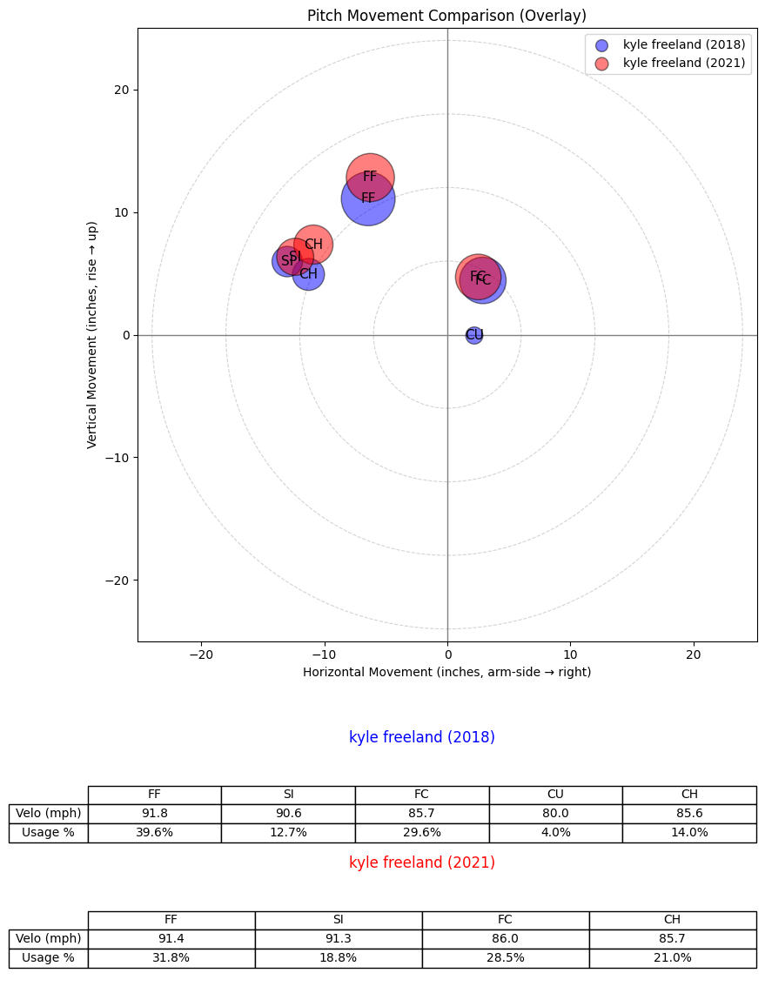

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


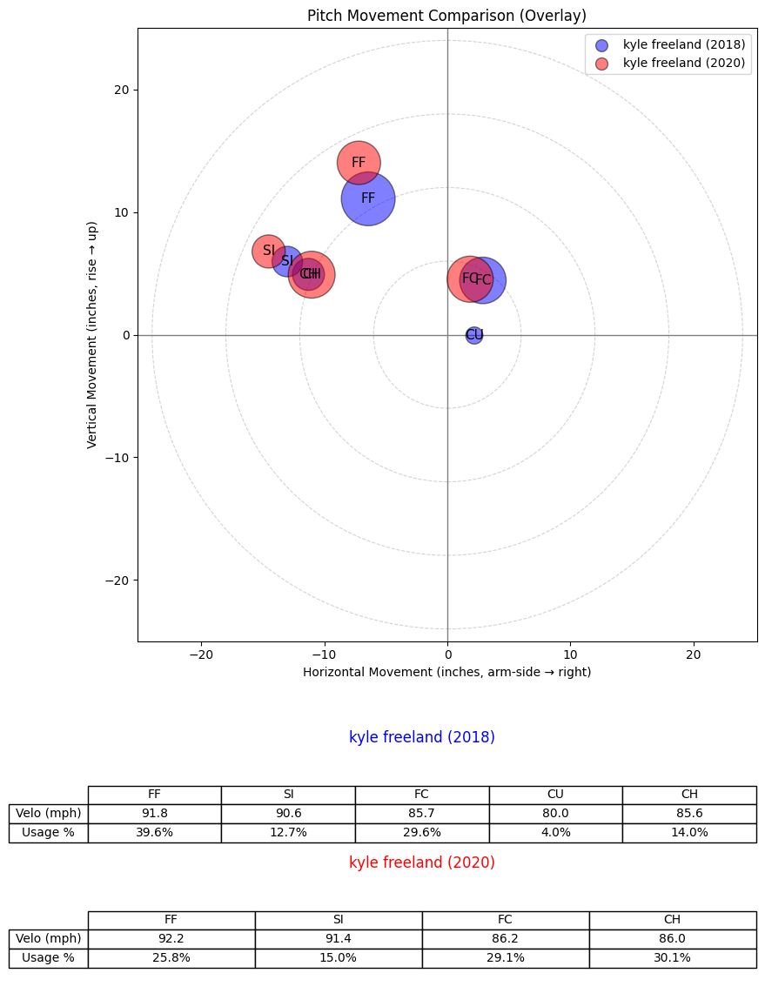

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


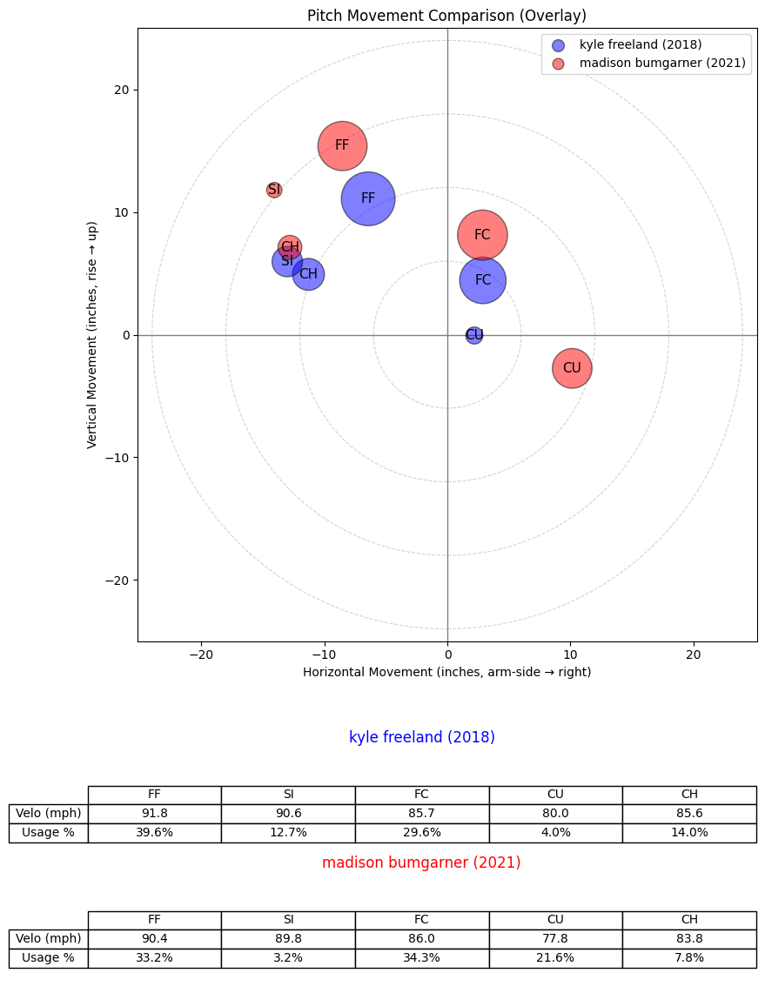

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


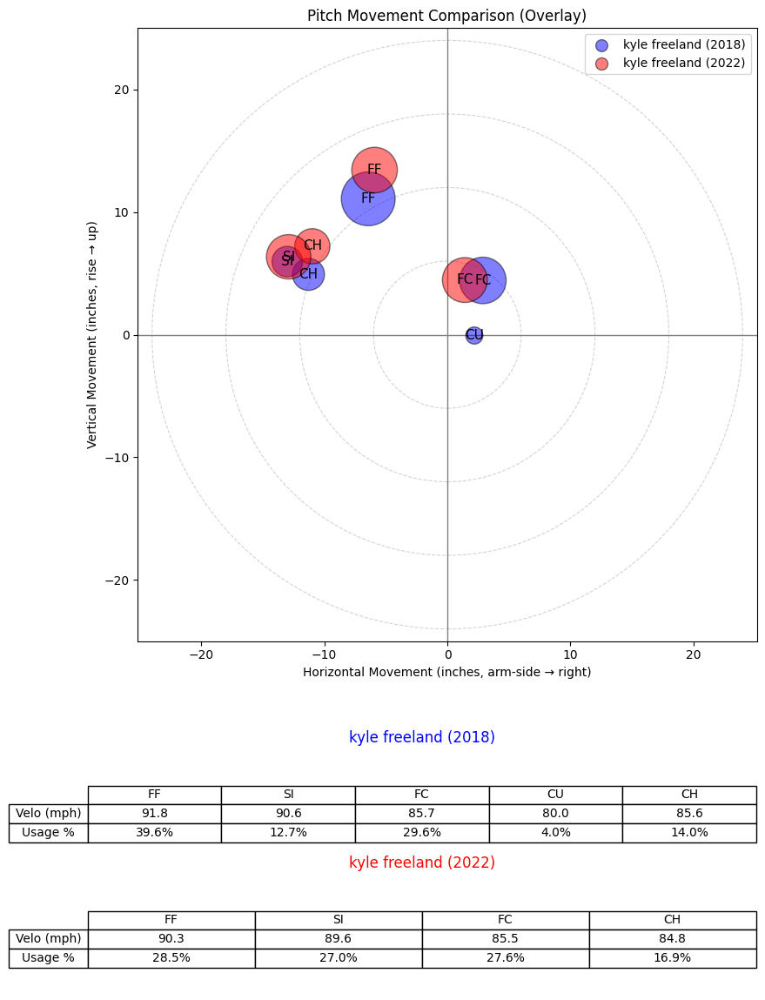

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


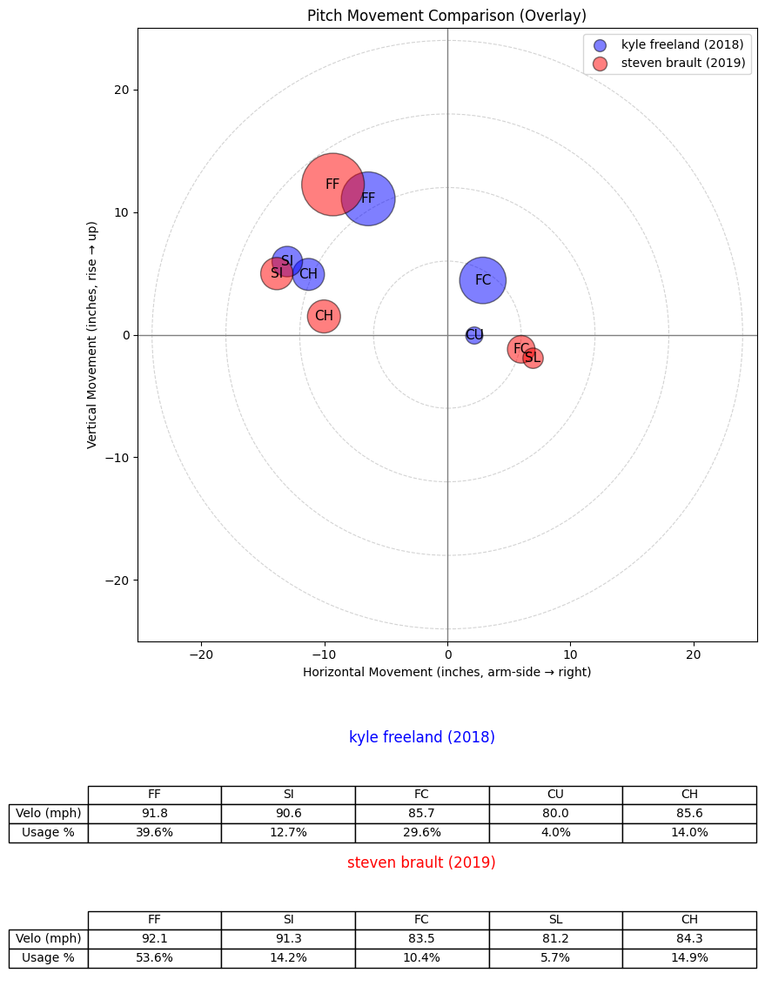

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


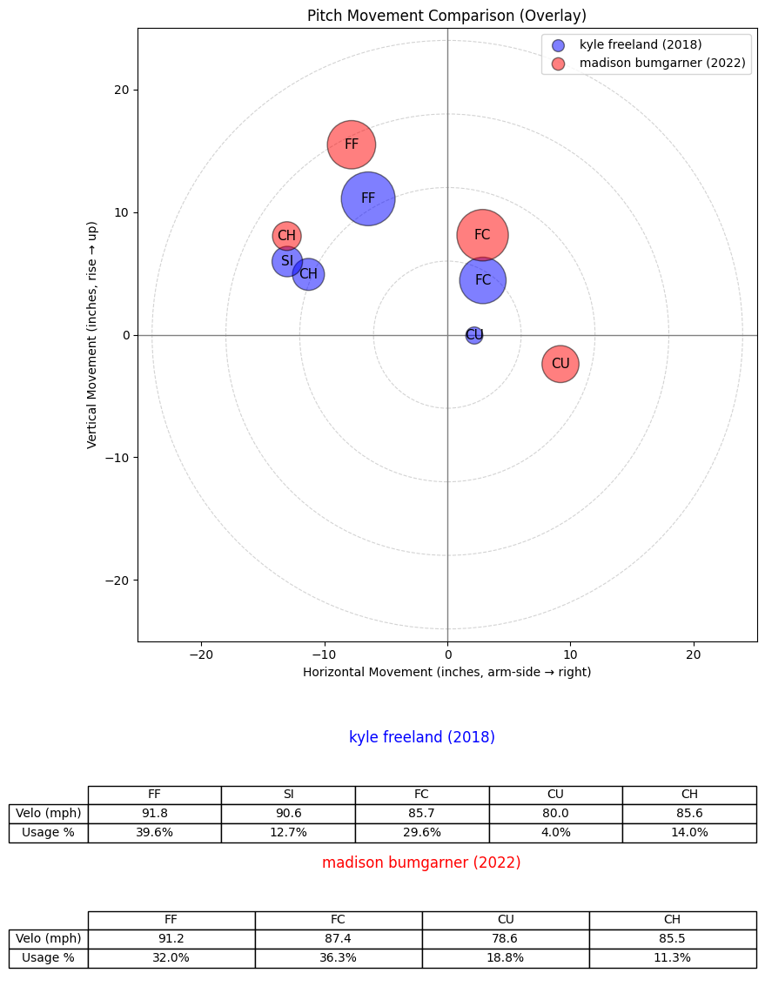

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


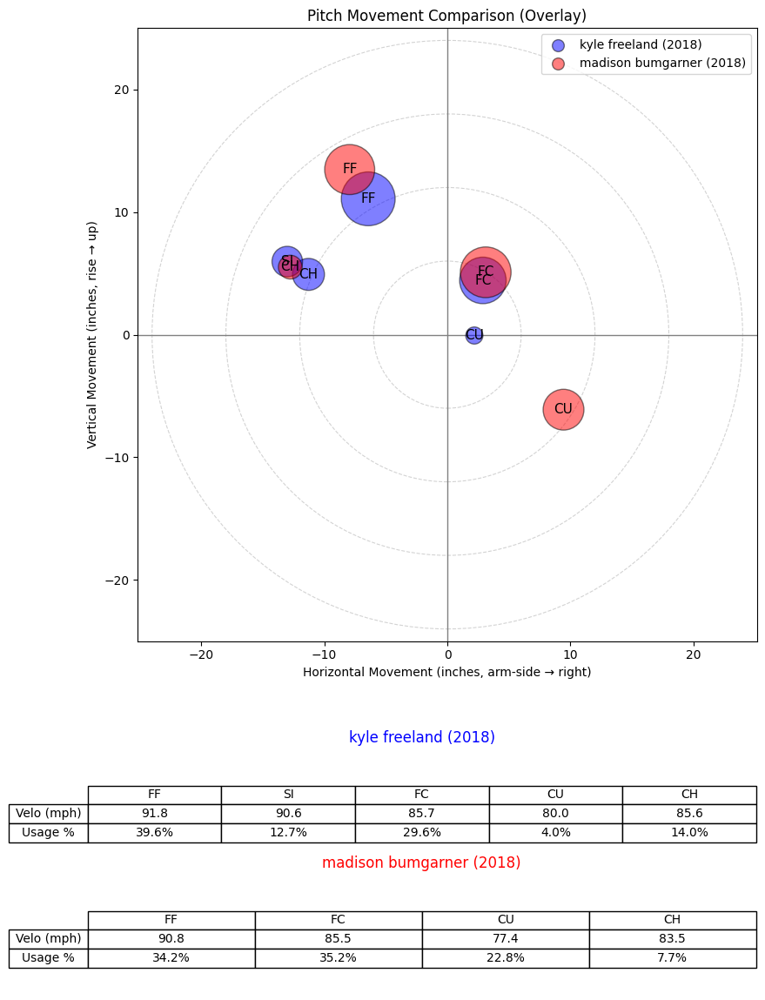

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


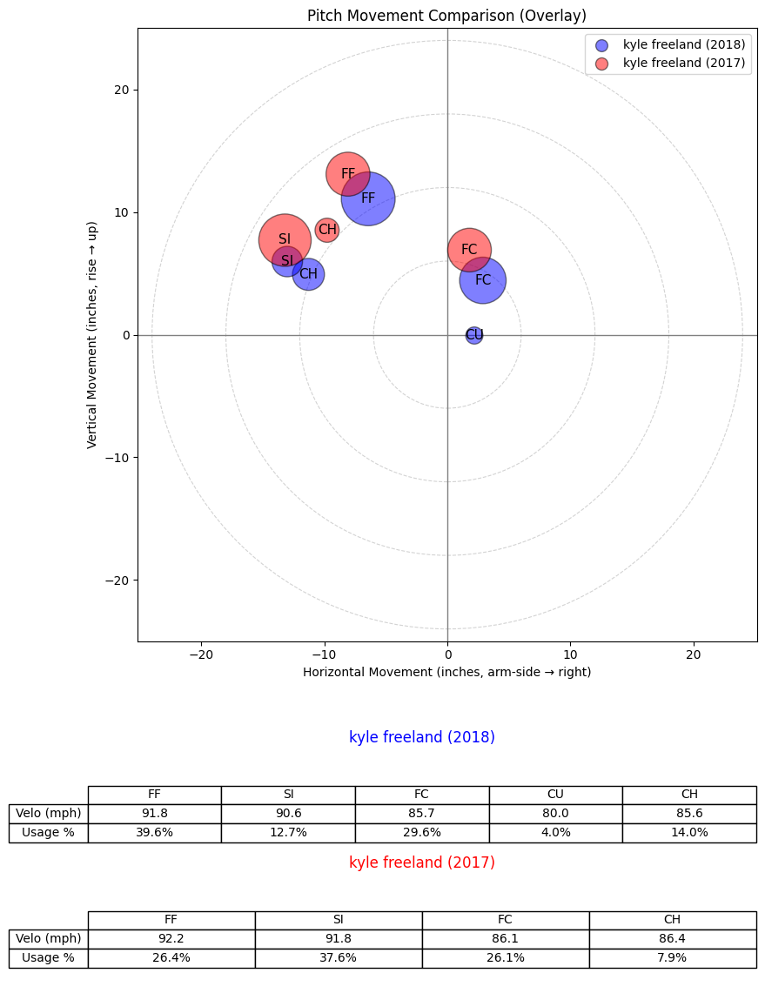

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


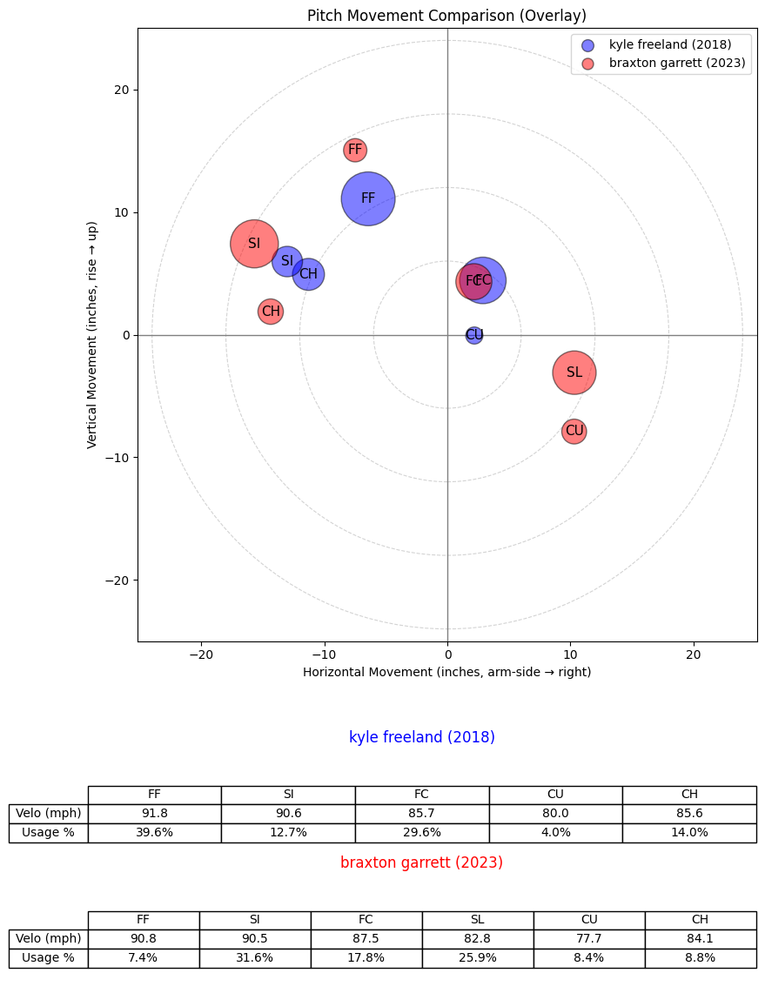

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


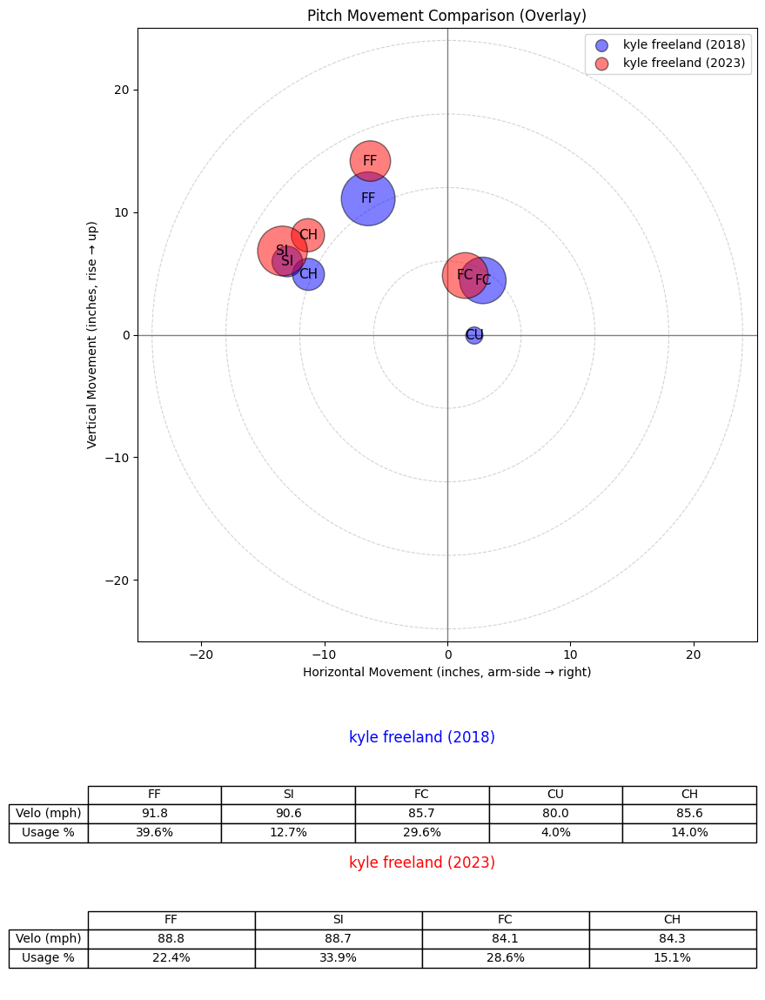

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
1198,607536.0,2021,kyle freeland,kyle,freeland,L,starter,0.881130
1197,607536.0,2020,kyle freeland,kyle,freeland,L,starter,0.876218
396,518516.0,2021,madison bumgarner,madison,bumgarner,L,starter,0.871886
1199,607536.0,2022,kyle freeland,kyle,freeland,L,starter,0.850561
1589,643230.0,2019,steven brault,steven,brault,L,starter,0.837912
397,518516.0,2022,madison bumgarner,madison,bumgarner,L,starter,0.825301
393,518516.0,2018,madison bumgarner,madison,bumgarner,L,starter,0.823172
1195,607536.0,2017,kyle freeland,kyle,freeland,L,starter,0.818698
1892,666129.0,2023,braxton garrett,braxton,garrett,L,starter,0.818042
1200,607536.0,2023,kyle freeland,kyle,freeland,L,starter,0.814887


In [257]:
neighbors_same_ae = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="kyle freeland",
    year=2018,
    X_df=X_ae_df,               # <- autoencoder space
    meta_df=pitcher_season_df,
    n_neighbors=10,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same_ae)

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


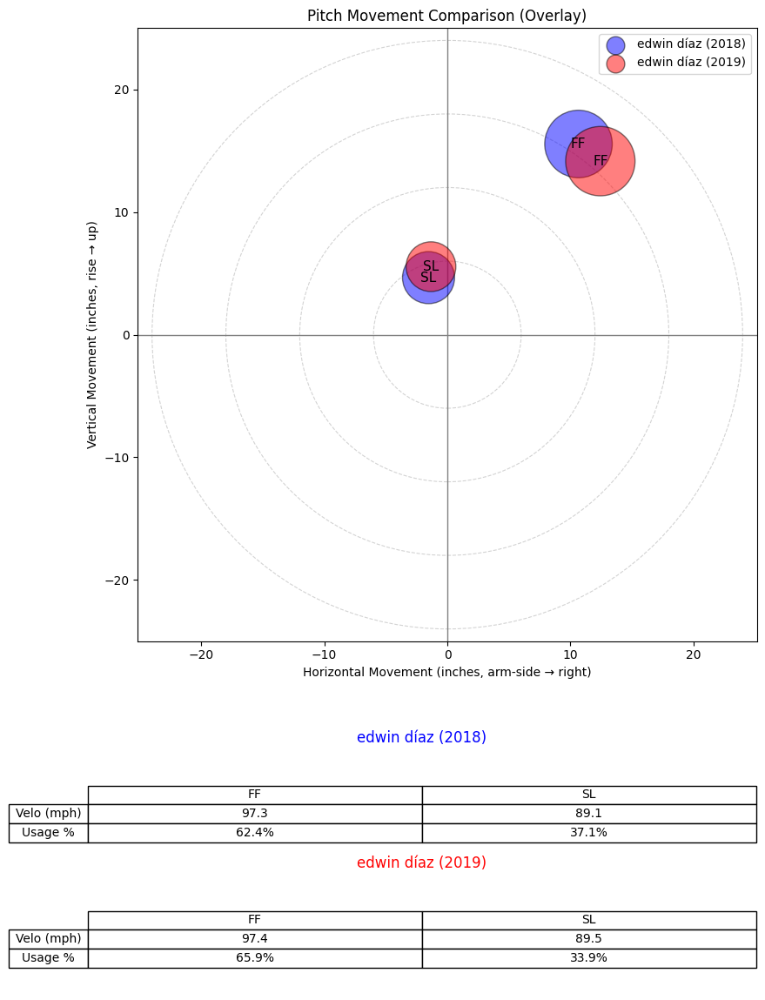

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


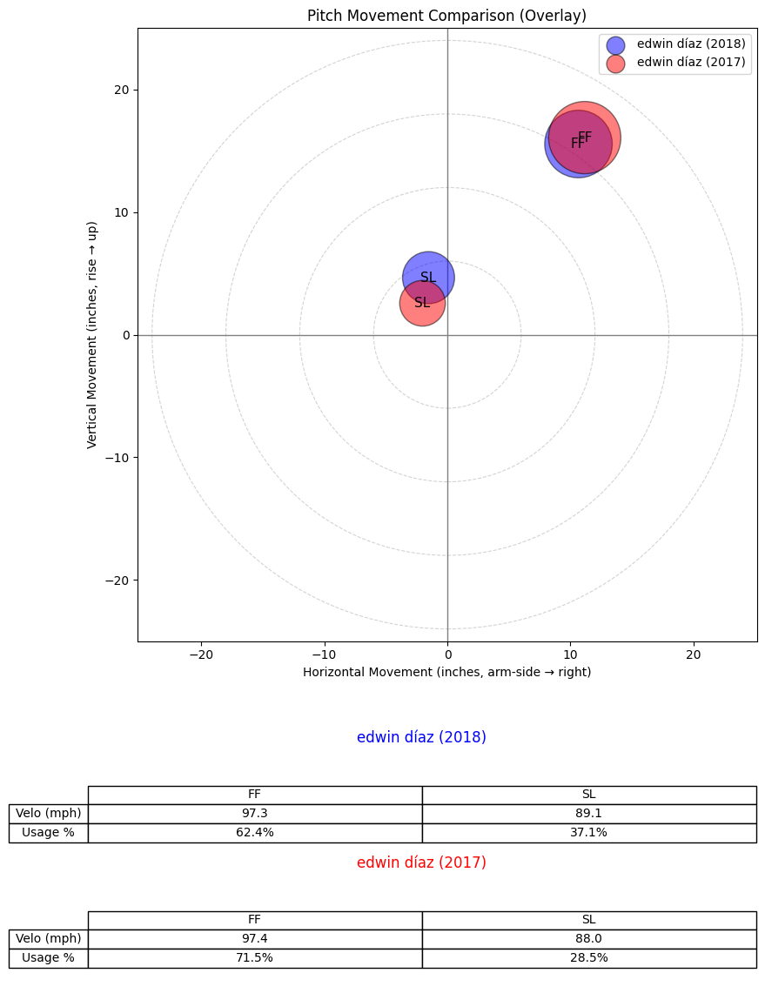

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


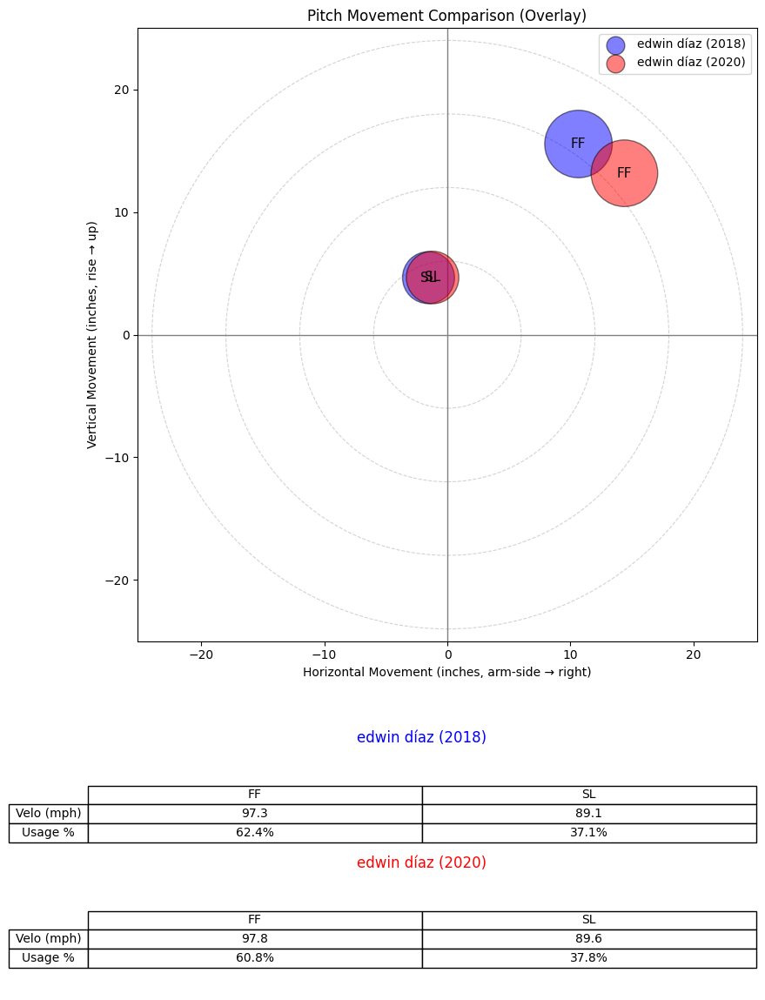

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


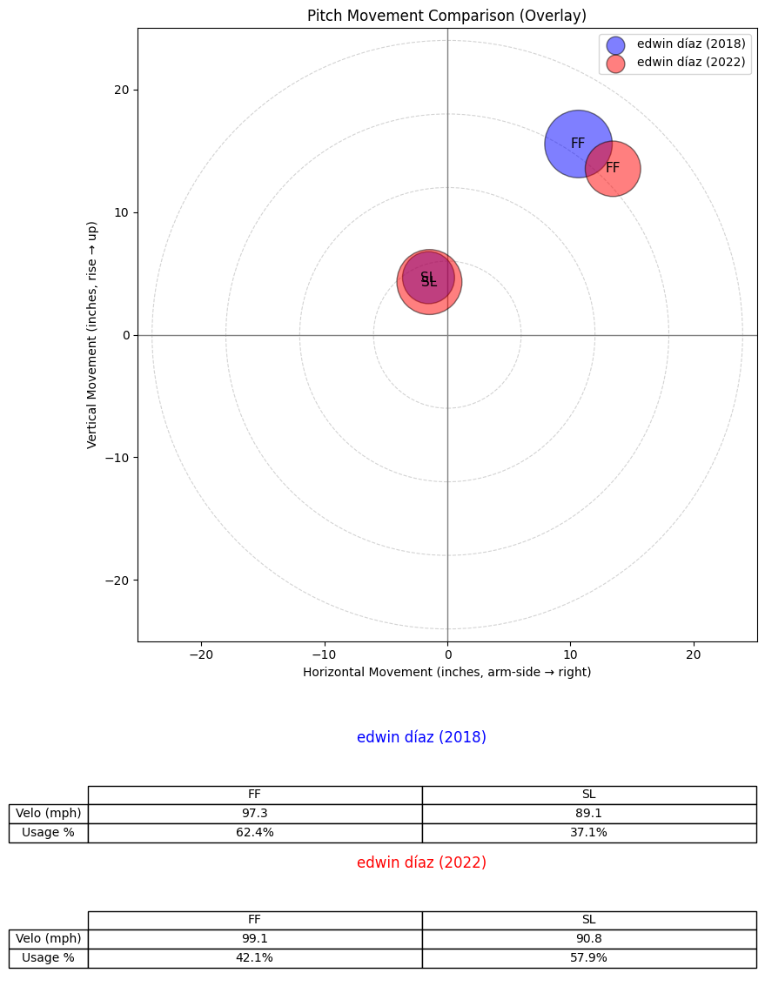

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


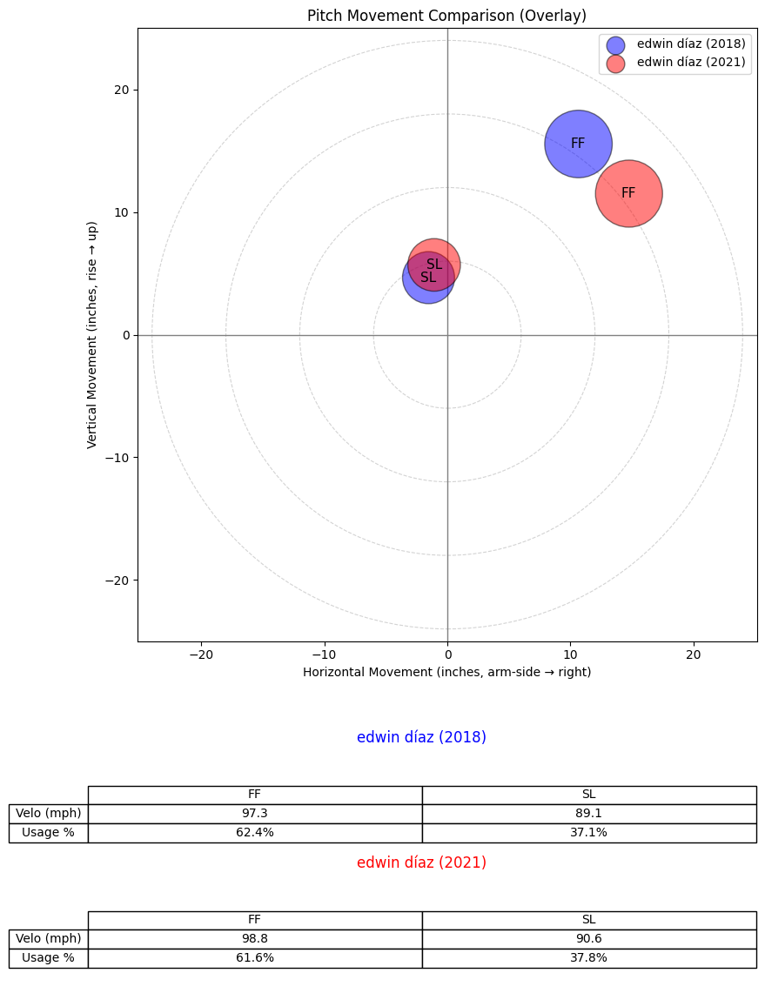

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


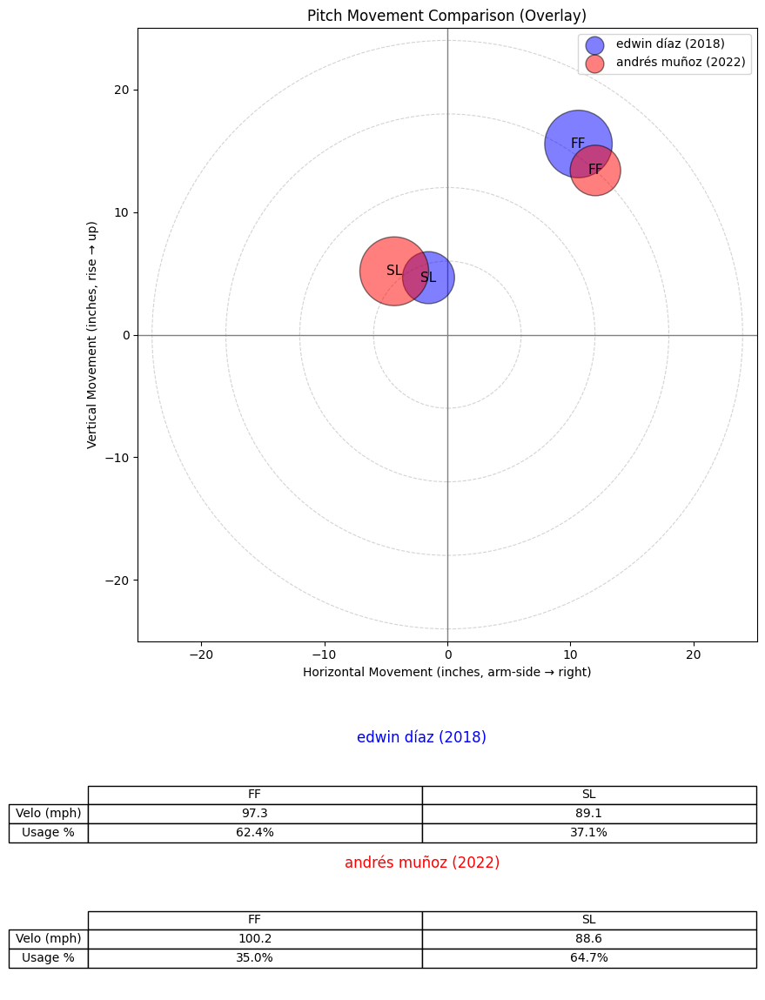

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


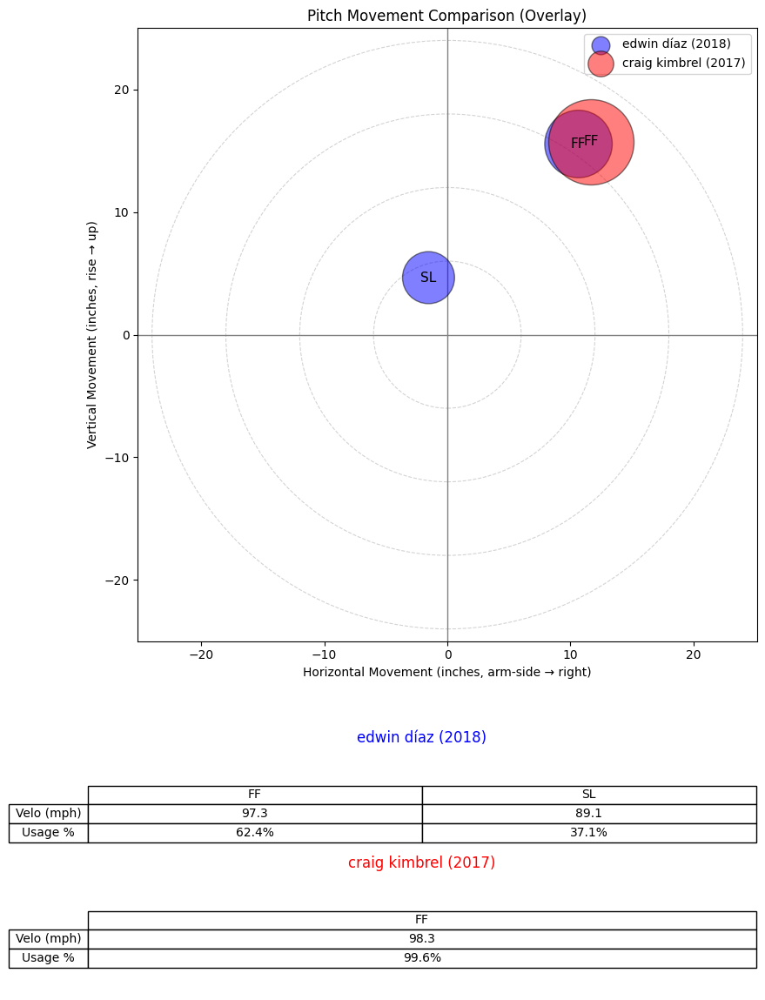

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


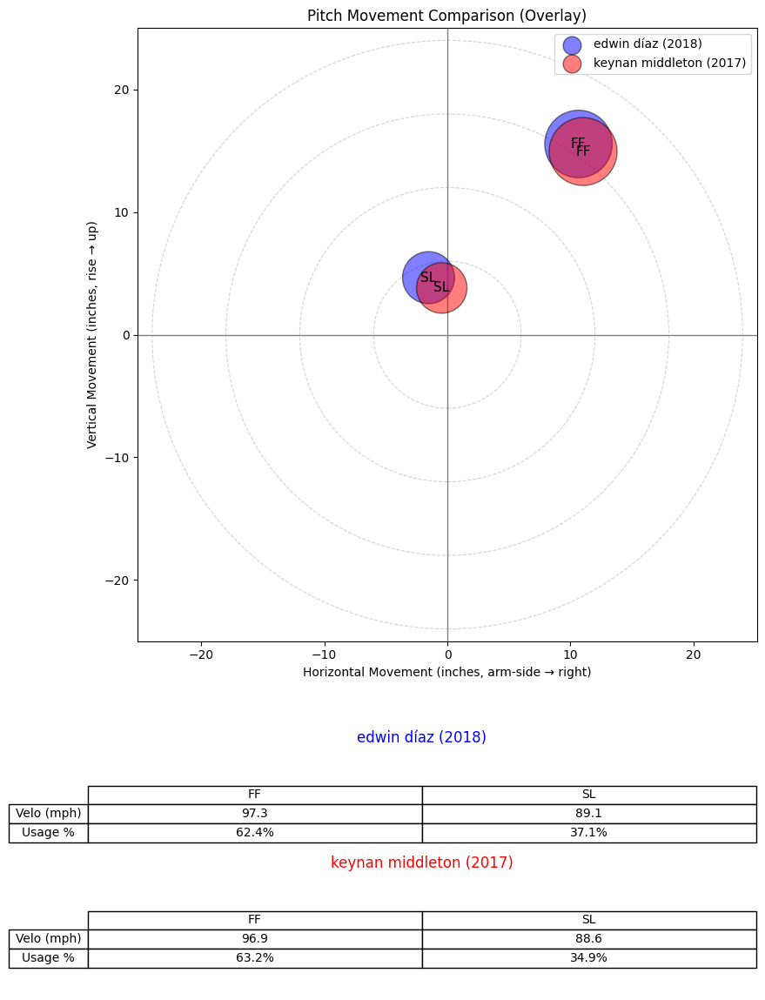

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


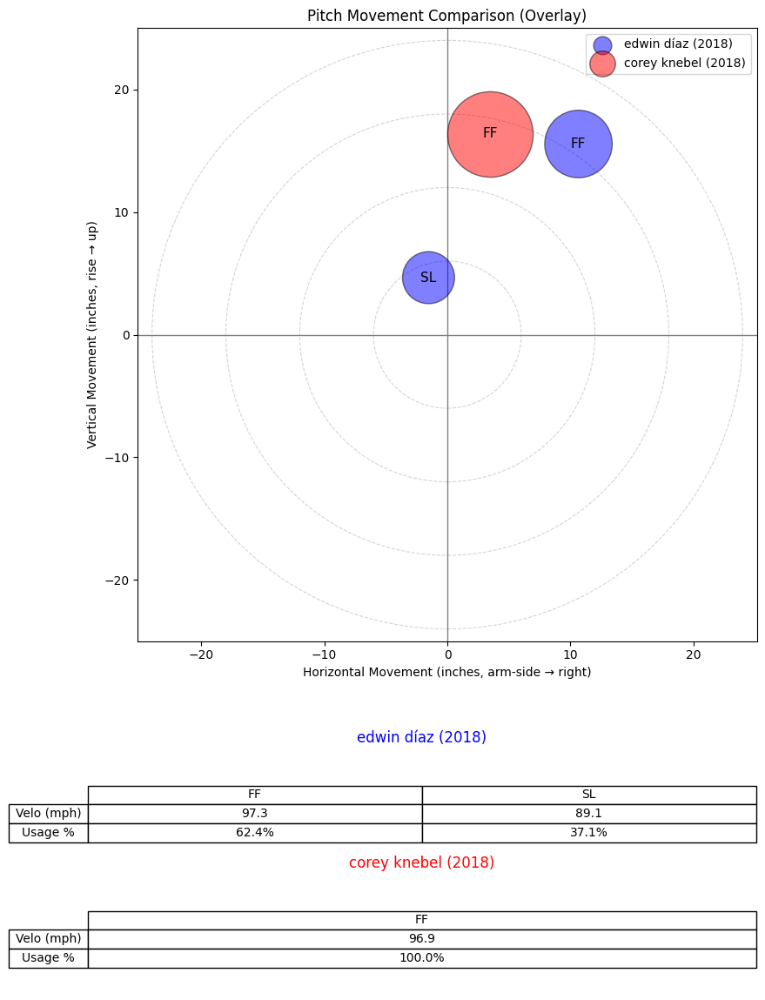

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


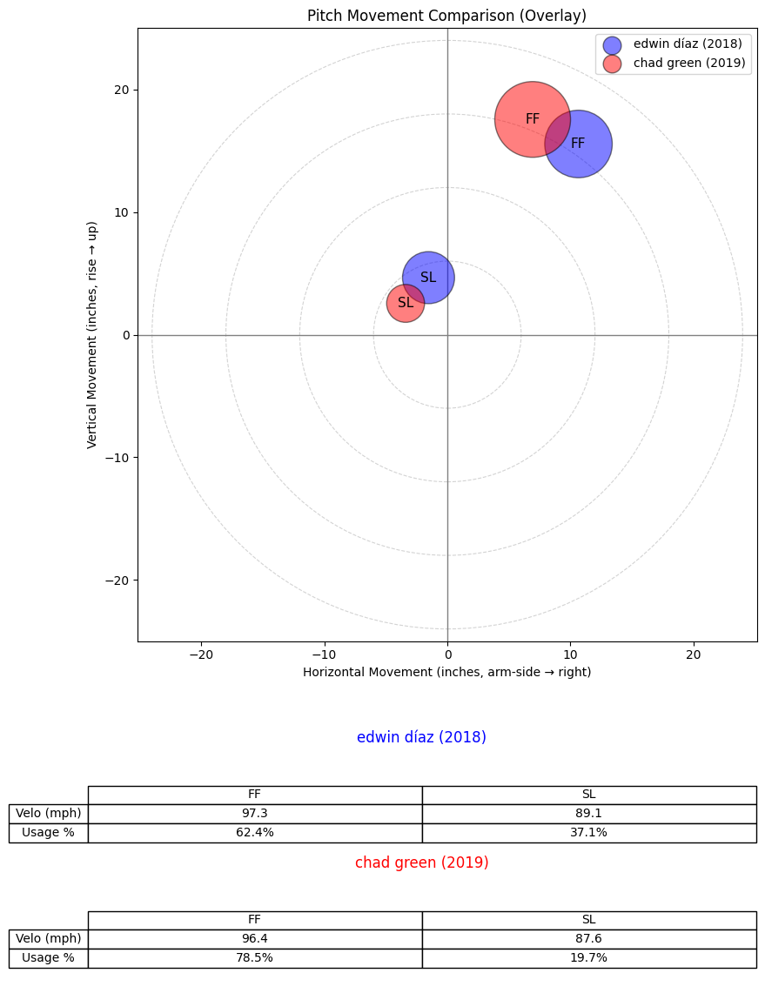

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
1322,621242.0,2019,edwin díaz,edwin,díaz,R,reliever,0.980871
1320,621242.0,2017,edwin díaz,edwin,díaz,R,reliever,0.959564
1323,621242.0,2020,edwin díaz,edwin,díaz,R,reliever,0.936796
1325,621242.0,2022,edwin díaz,edwin,díaz,R,reliever,0.932534
1324,621242.0,2021,edwin díaz,edwin,díaz,R,reliever,0.908295
1784,662253.0,2022,andrés muñoz,andrés,muñoz,R,reliever,0.898690
428,518886.0,2017,craig kimbrel,craig,kimbrel,R,reliever,0.802308
1531,641871.0,2017,keynan middleton,keynan,middleton,R,reliever,0.794895
1238,608349.0,2018,corey knebel,corey,knebel,R,reliever,0.790397
1603,643338.0,2019,chad green,chad,green,R,reliever,0.783365


In [258]:
neighbors_same_ae = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="edwin díaz",
    year=2018,
    X_df=X_ae_df,               # <- autoencoder space
    meta_df=pitcher_season_df,
    n_neighbors=10,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same_ae)

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


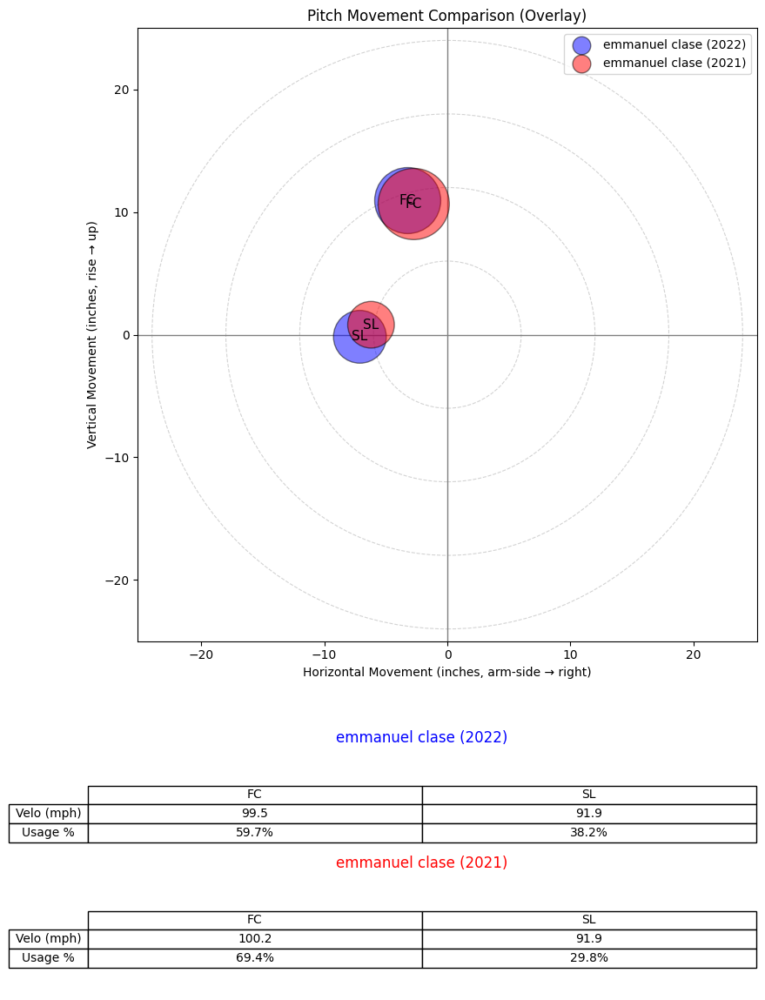

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


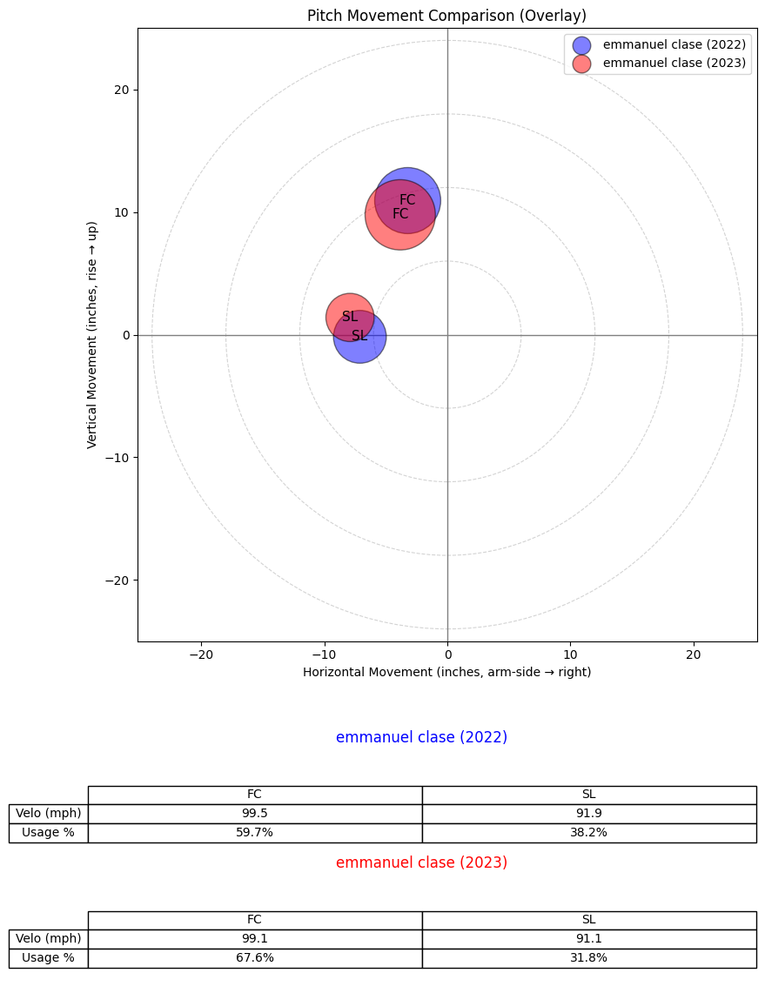

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


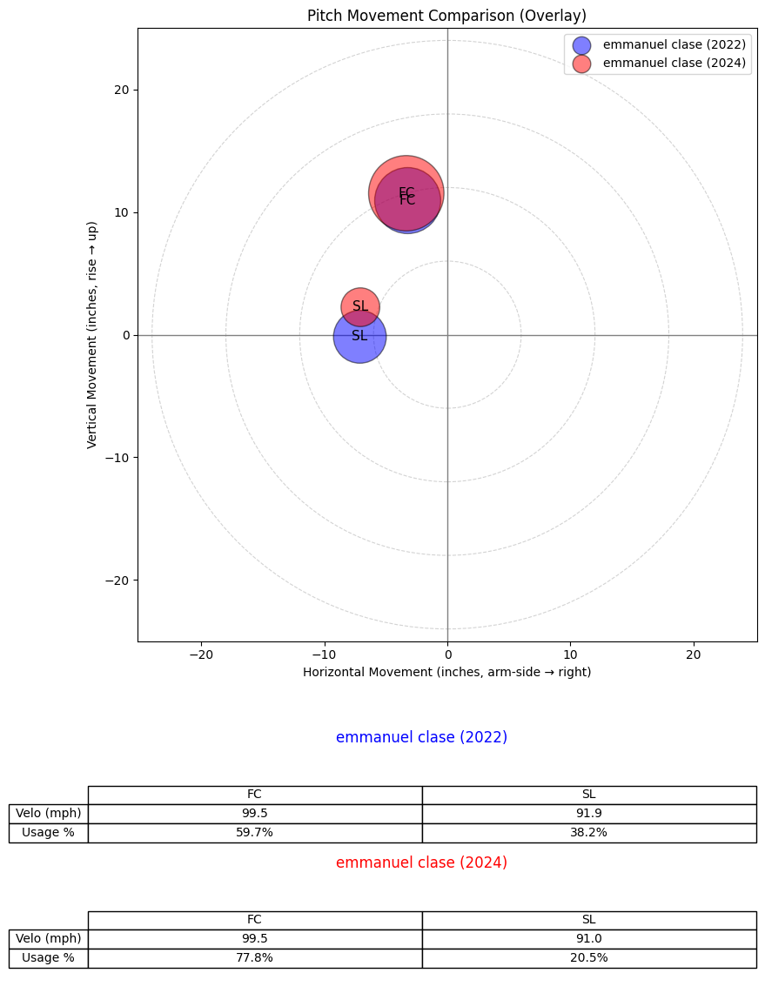

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


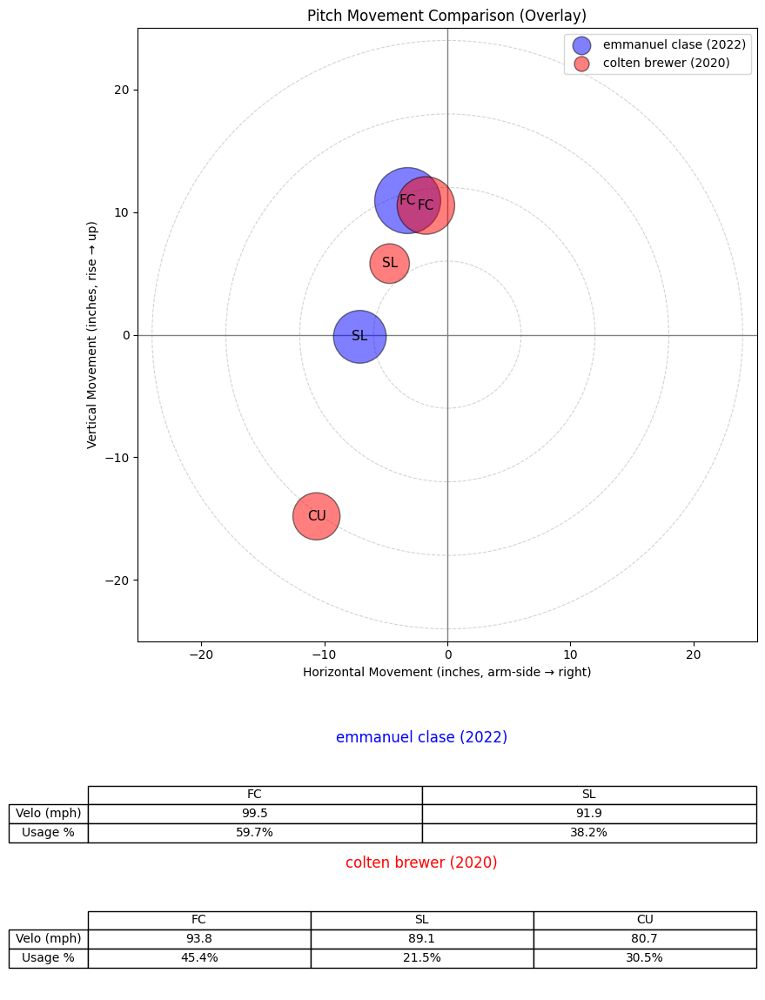

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


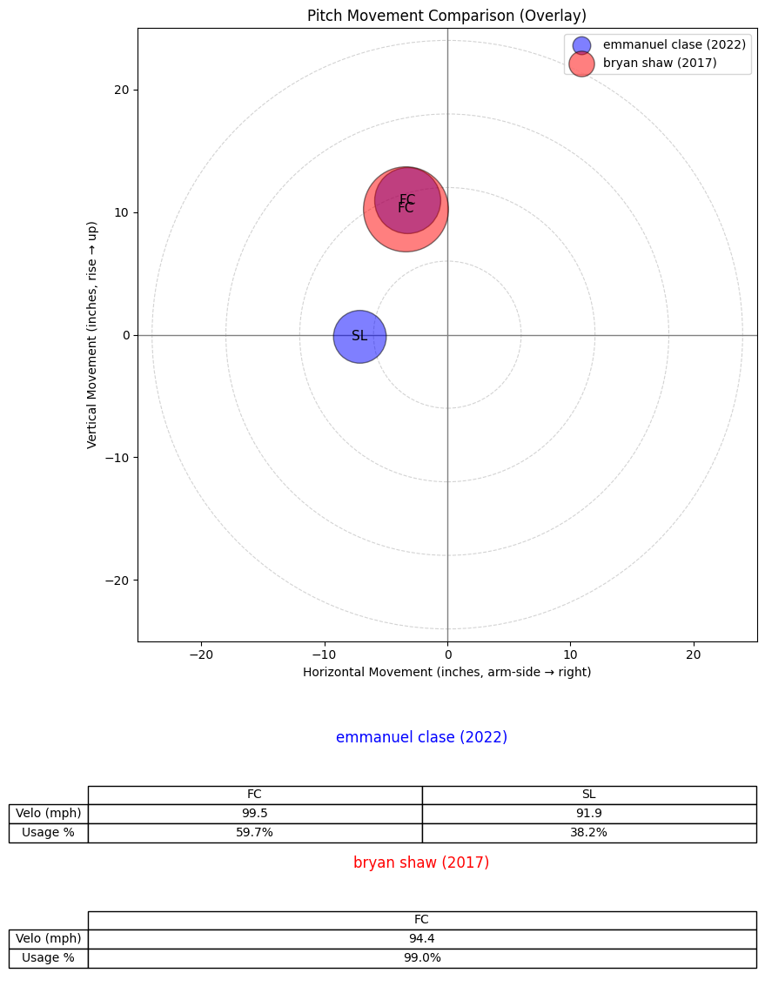

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


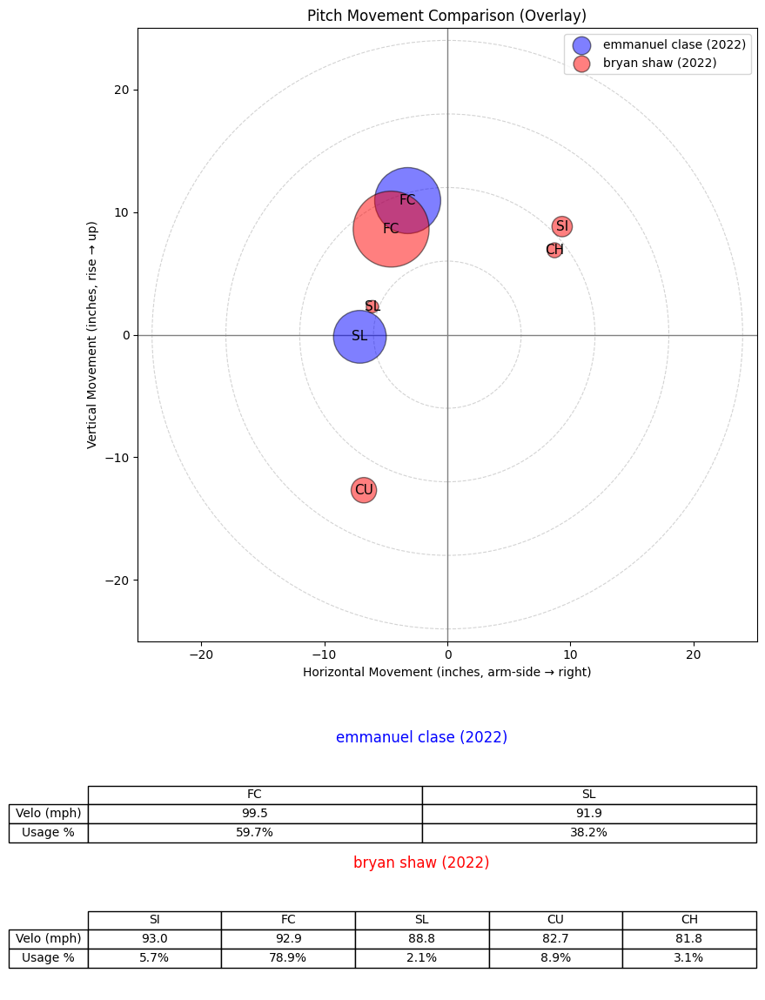

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


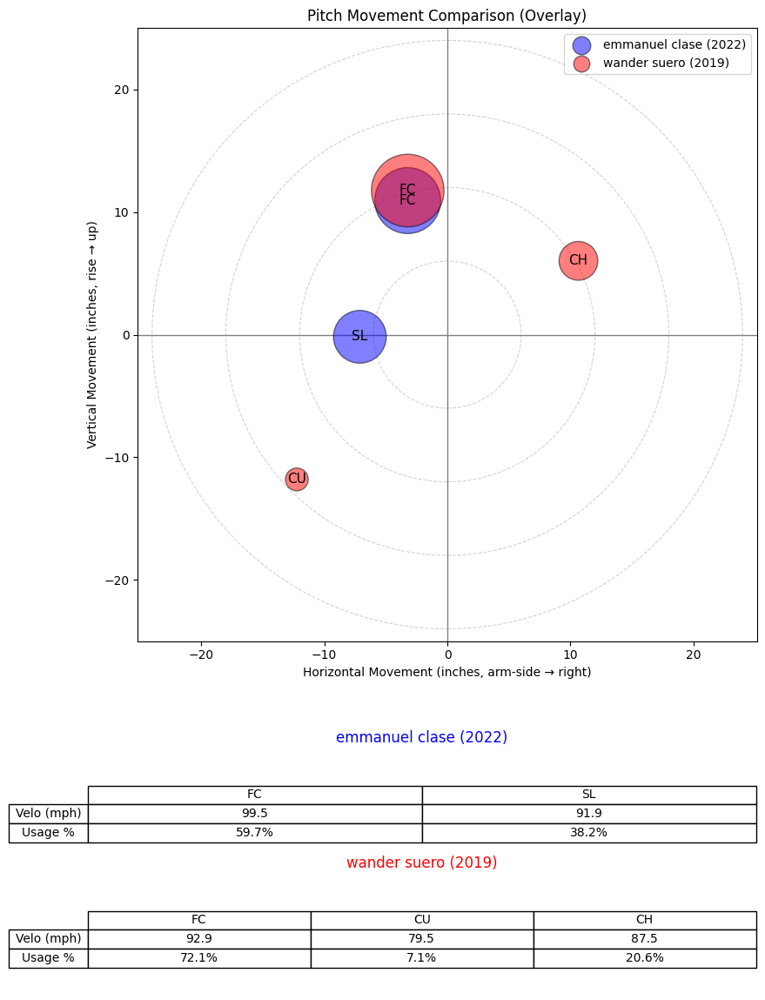

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


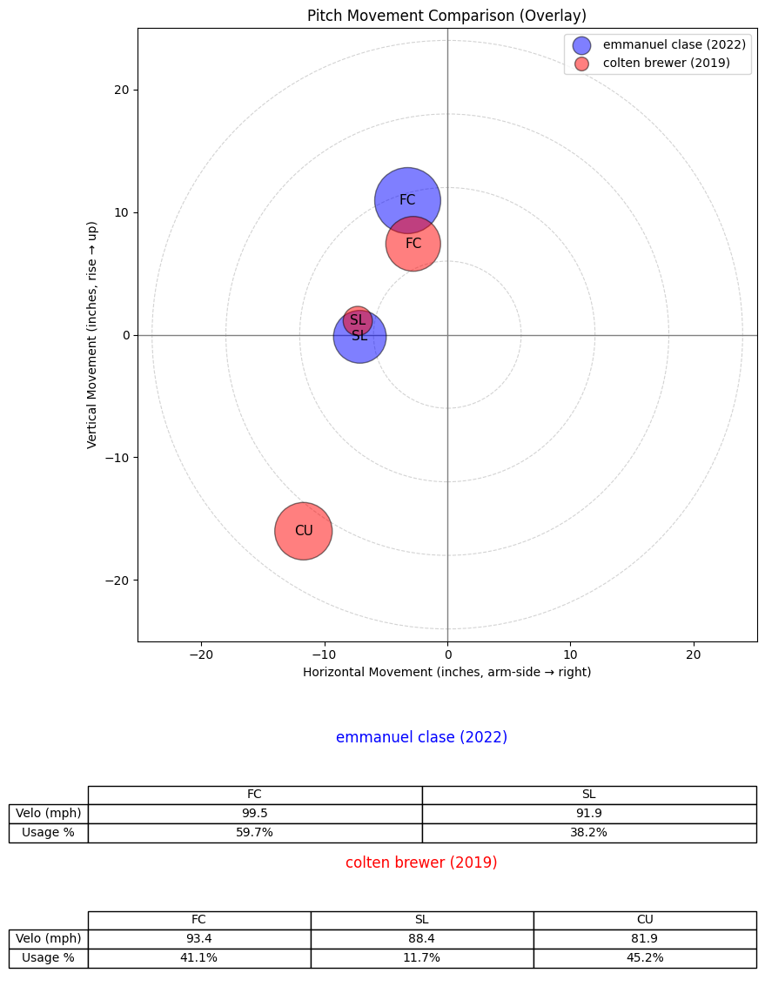

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


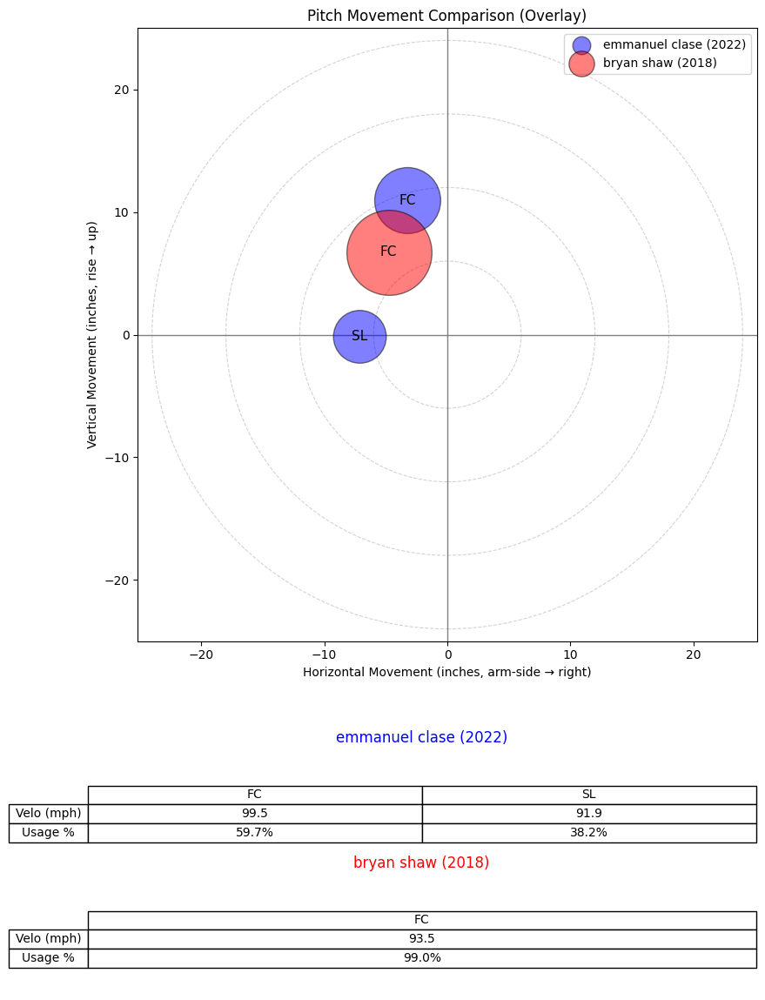

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


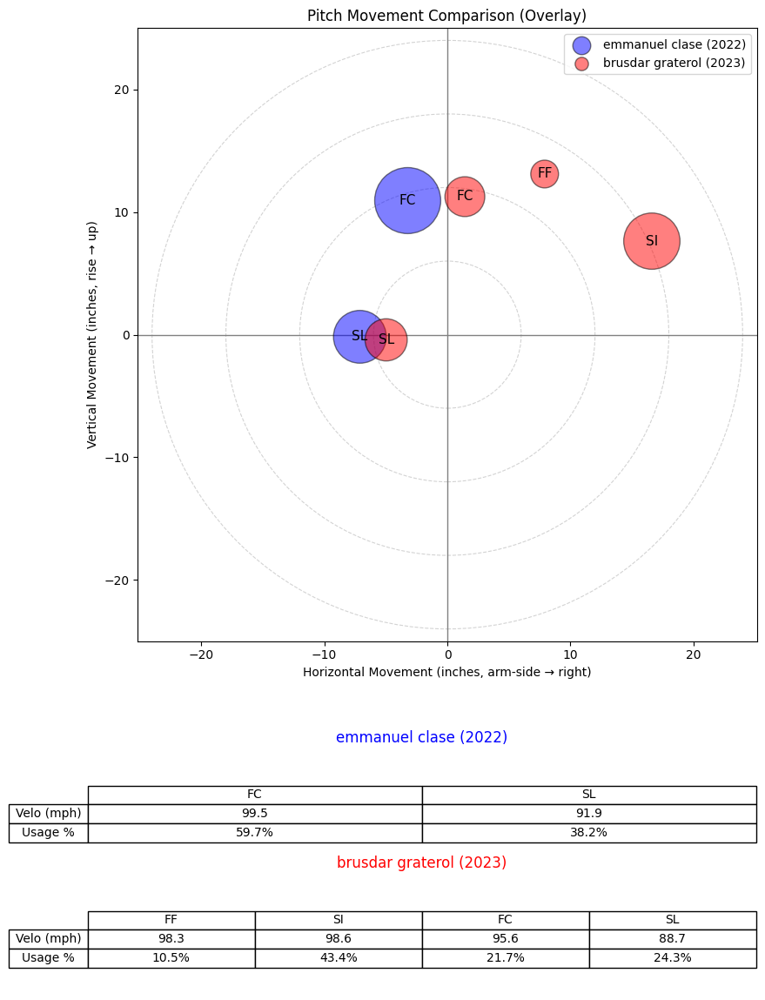

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
1779,661403.0,2021,emmanuel clase,emmanuel,clase,R,reliever,0.998490
1781,661403.0,2023,emmanuel clase,emmanuel,clase,R,reliever,0.995323
1782,661403.0,2024,emmanuel clase,emmanuel,clase,R,reliever,0.993623
1049,605155.0,2020,colten brewer,colten,brewer,R,reliever,0.865705
613,543766.0,2017,bryan shaw,bryan,shaw,R,reliever,0.850500
617,543766.0,2022,bryan shaw,bryan,shaw,R,reliever,0.812946
937,593833.0,2019,wander suero,wander,suero,R,reliever,0.799339
1048,605155.0,2019,colten brewer,colten,brewer,R,reliever,0.788039
614,543766.0,2018,bryan shaw,bryan,shaw,R,reliever,0.762988
1767,660813.0,2023,brusdar graterol,brusdar,graterol,R,reliever,0.761380


In [259]:
neighbors_same_ae = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="emmanuel clase",
    year=2022,
    X_df=X_ae_df,               # <- autoencoder space
    meta_df=pitcher_season_df,
    n_neighbors=10,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same_ae)

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


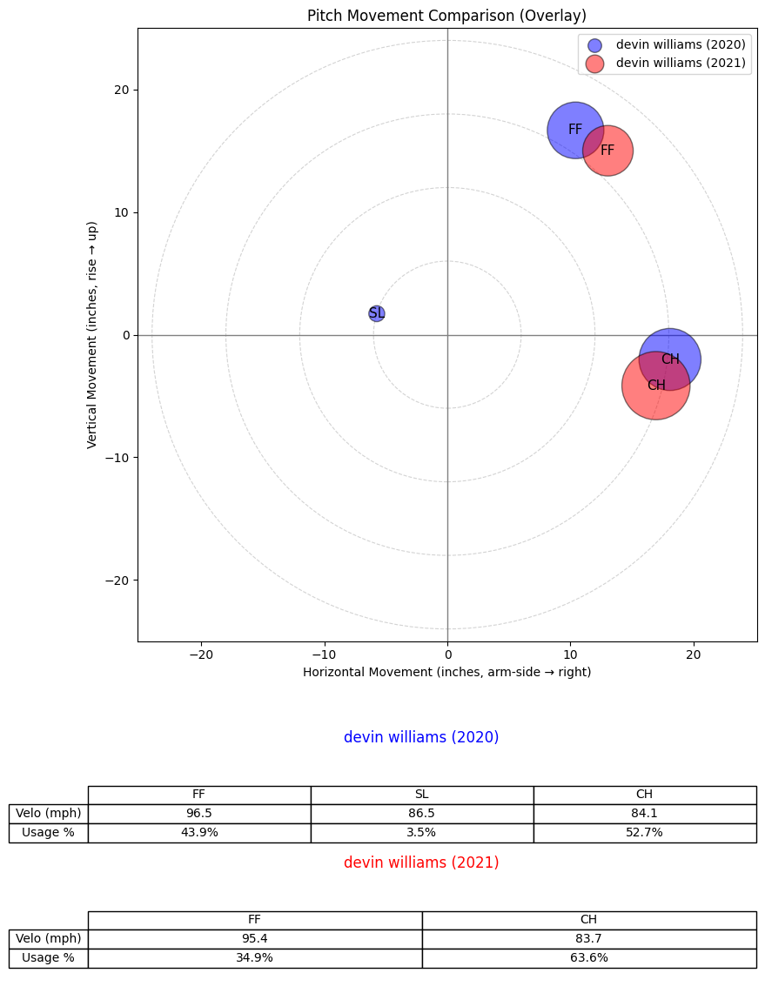

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


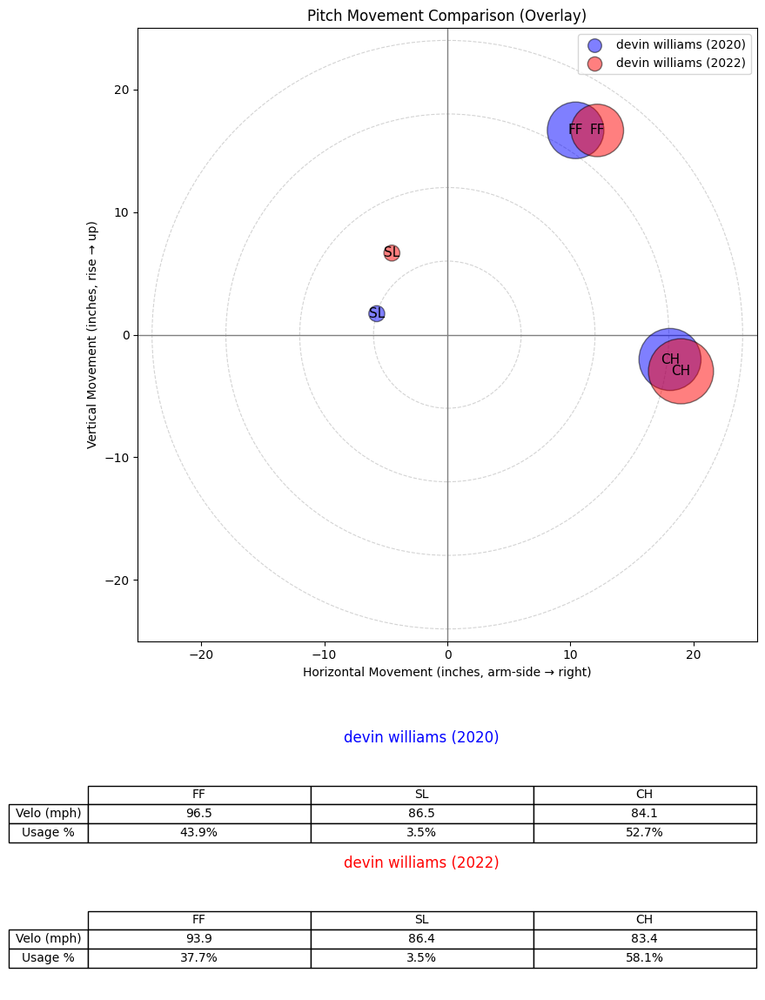

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


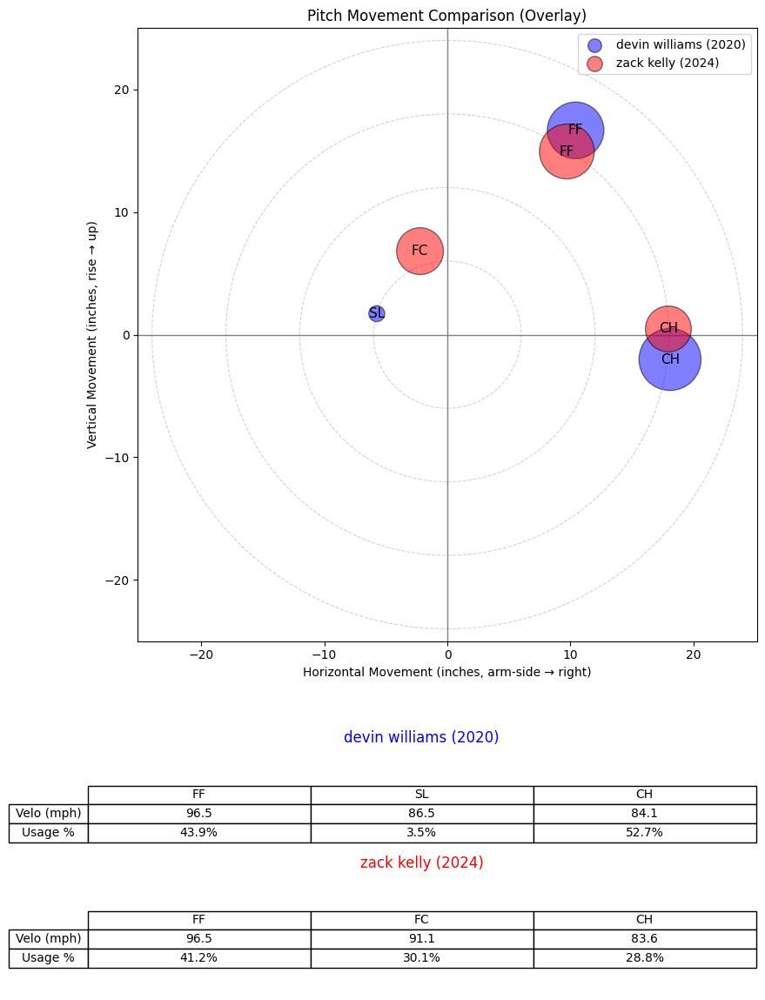

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


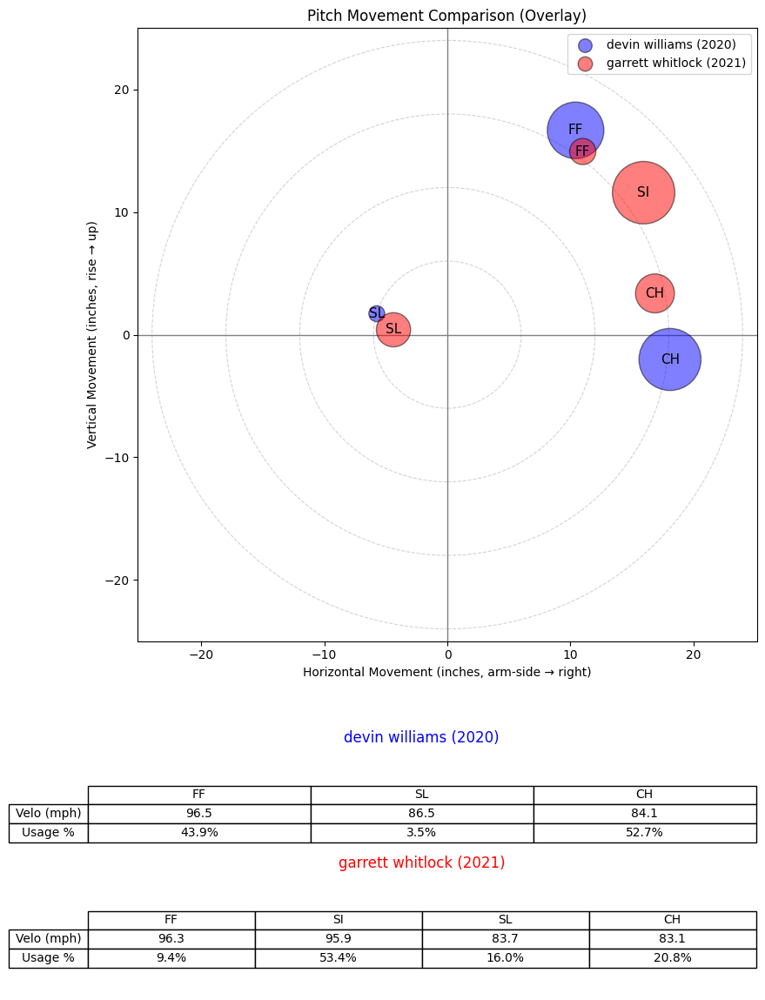

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


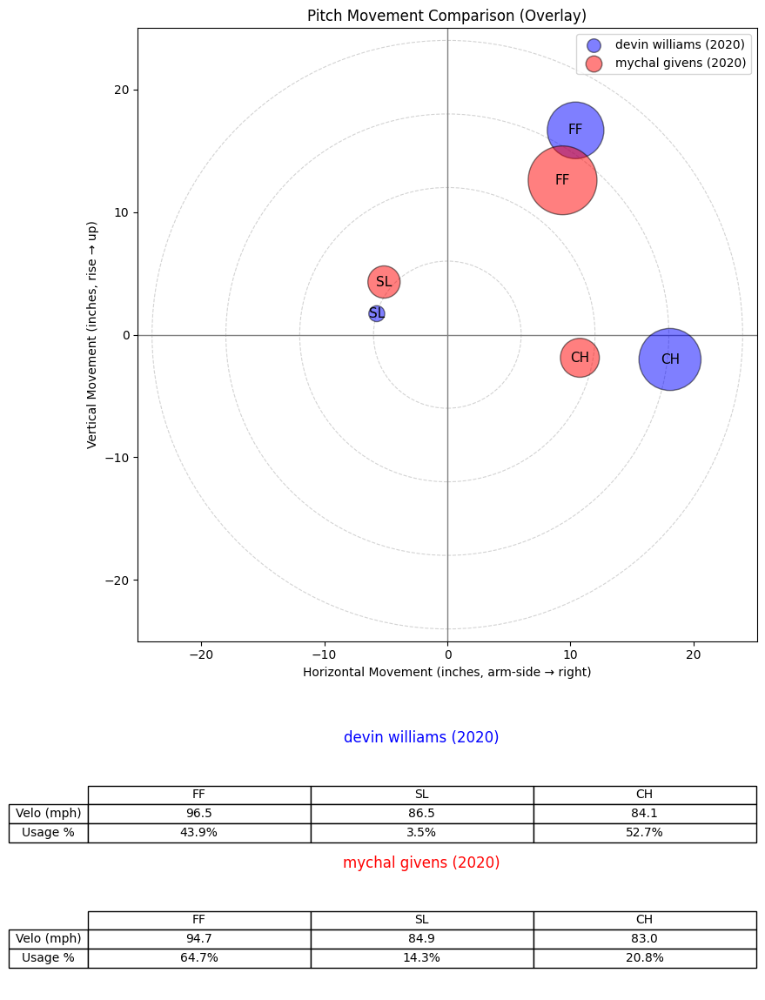

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


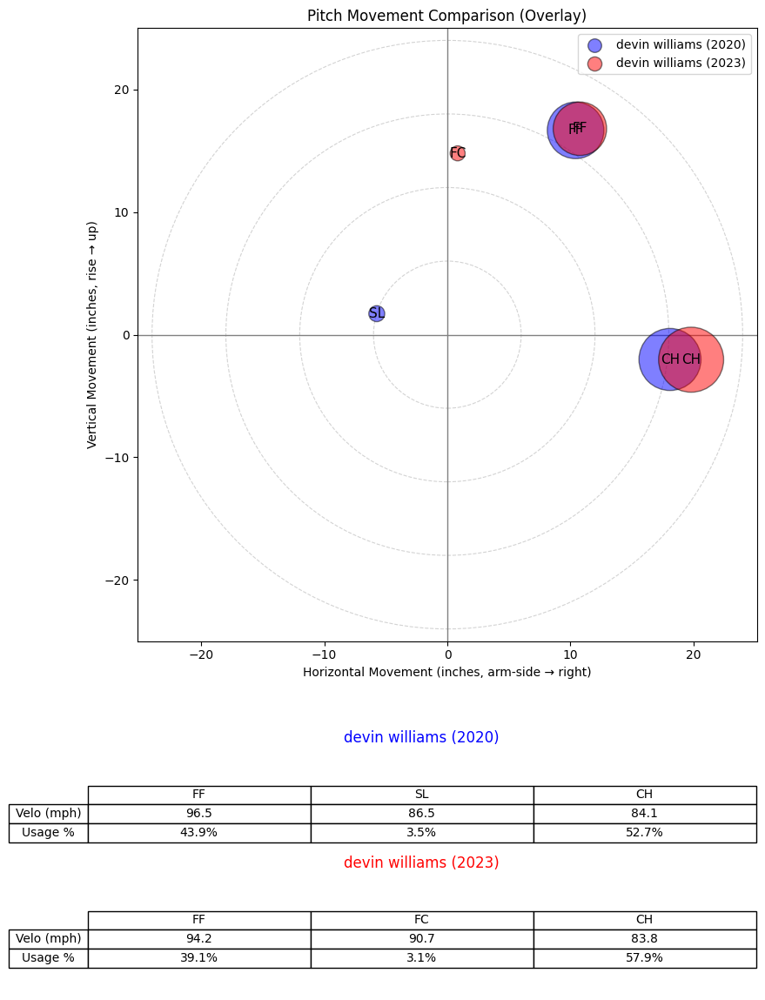

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


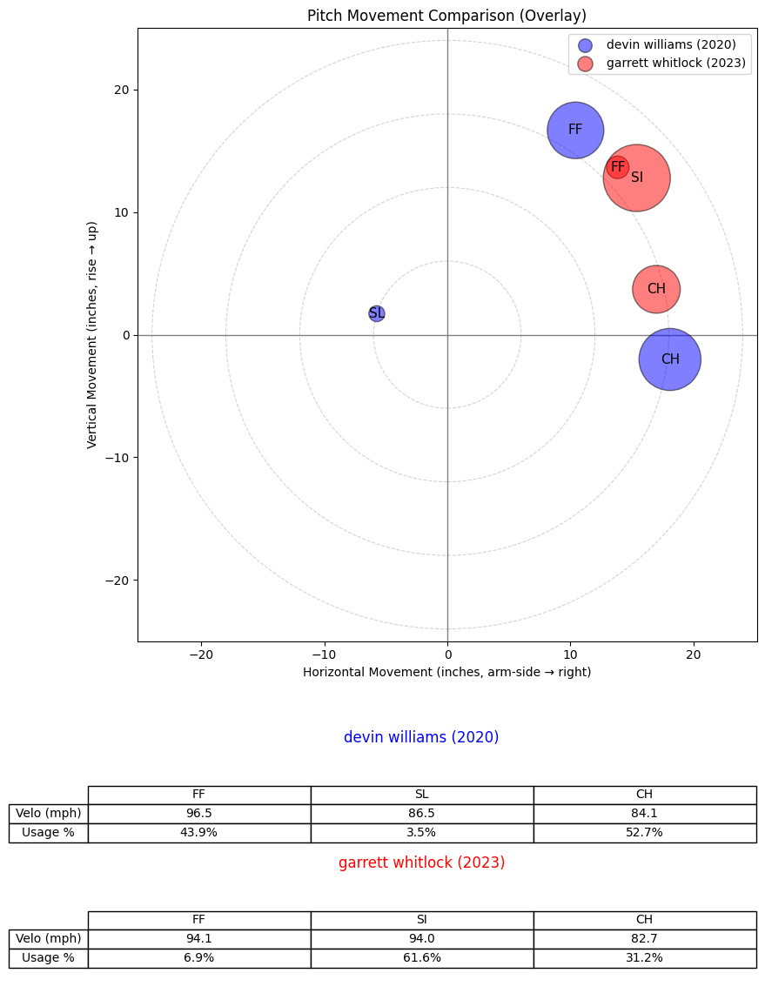

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


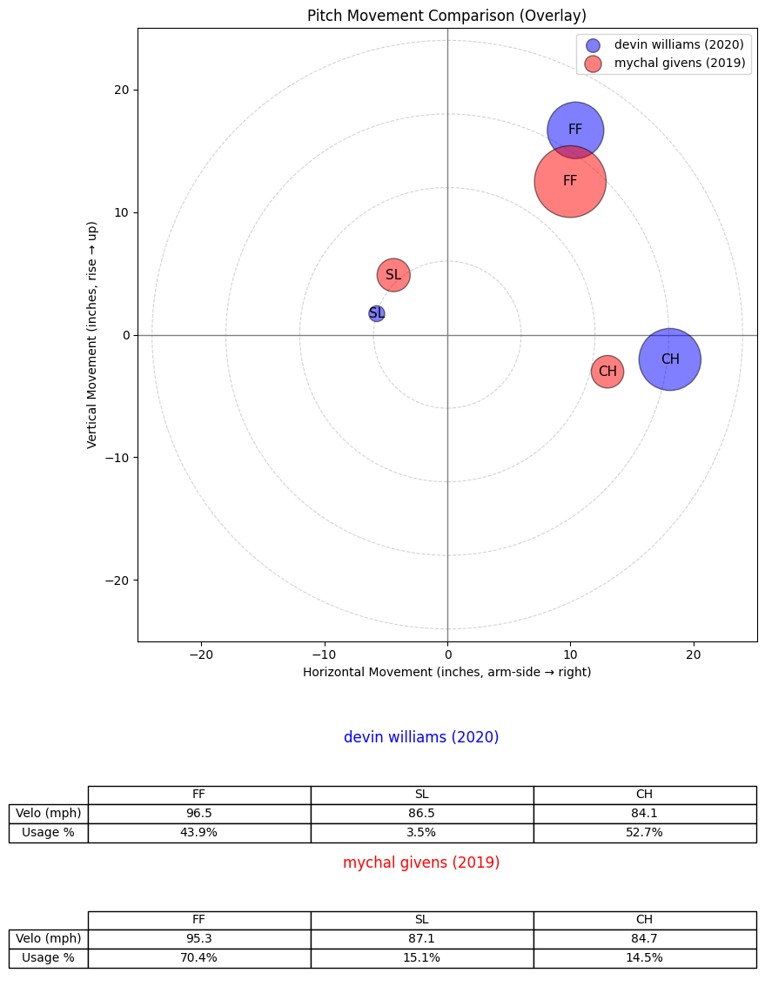

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


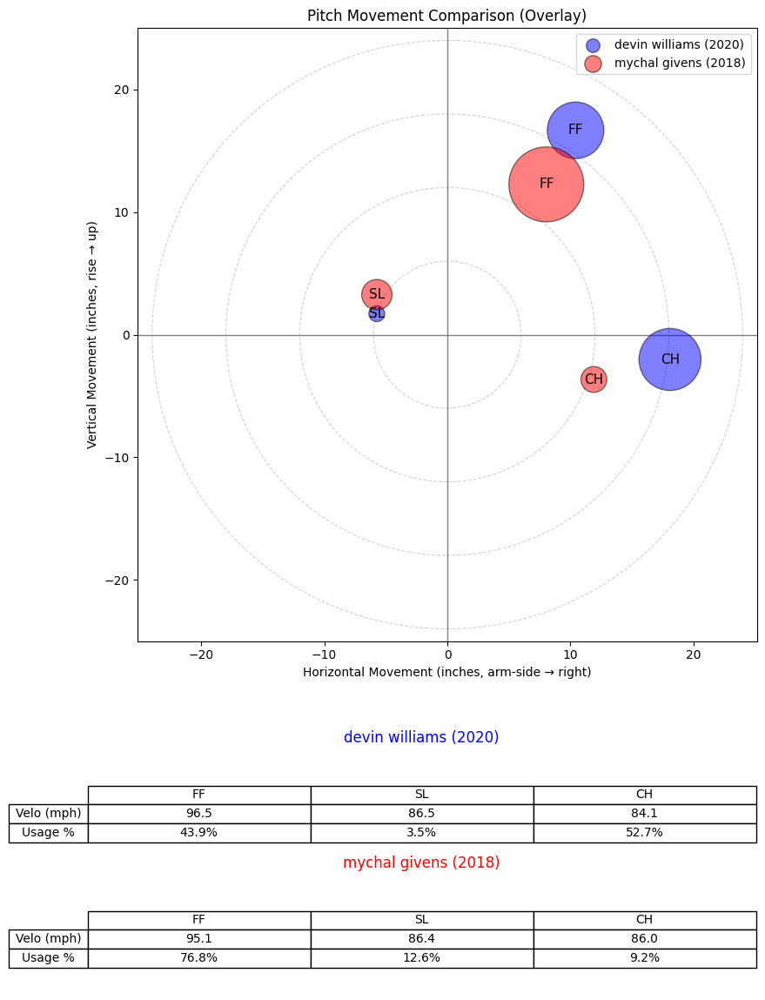

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


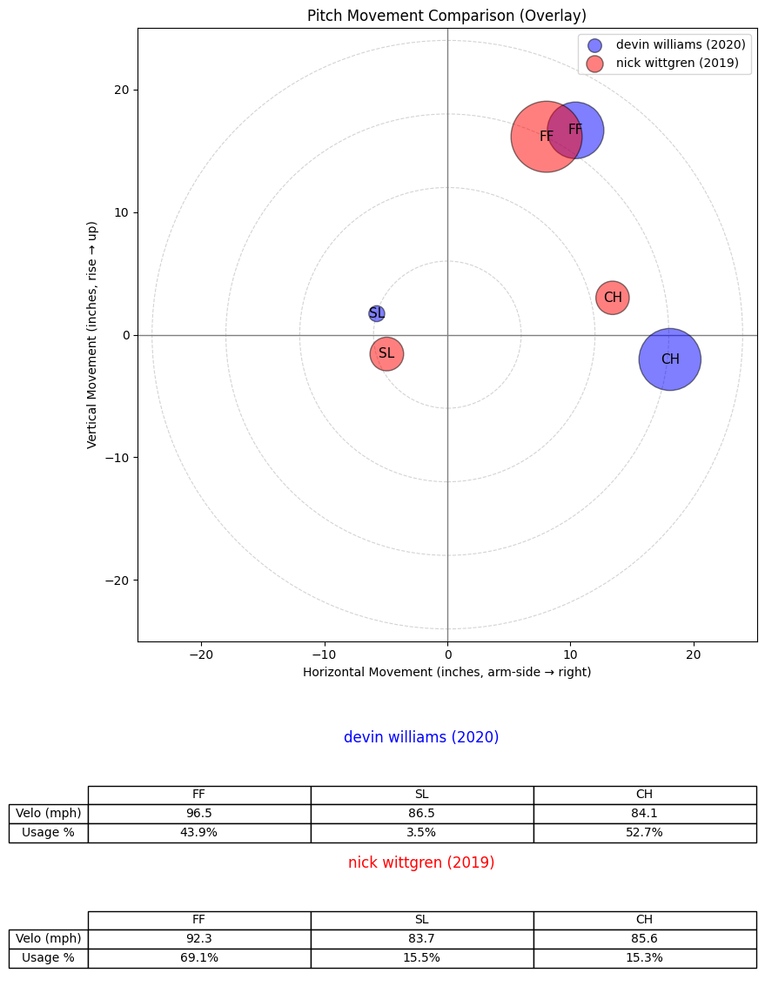

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
1553,642207.0,2021,devin williams,devin,williams,R,reliever,0.961461
1554,642207.0,2022,devin williams,devin,williams,R,reliever,0.895300
2054,677161.0,2024,zack kelly,zack,kelly,R,reliever,0.815889
2037,676477.0,2021,garrett whitlock,garrett,whitlock,R,reliever,0.796142
733,571710.0,2020,mychal givens,mychal,givens,R,reliever,0.767242
1555,642207.0,2023,devin williams,devin,williams,R,reliever,0.763539
2039,676477.0,2023,garrett whitlock,garrett,whitlock,R,reliever,0.760710
732,571710.0,2019,mychal givens,mychal,givens,R,reliever,0.760558
731,571710.0,2018,mychal givens,mychal,givens,R,reliever,0.751742
1337,621295.0,2019,nick wittgren,nick,wittgren,R,reliever,0.716745


In [260]:
neighbors_same_ae = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="devin williams",
    year=2020,
    X_df=X_ae_df,               # <- autoencoder space
    meta_df=pitcher_season_df,
    n_neighbors=10,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same_ae)

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


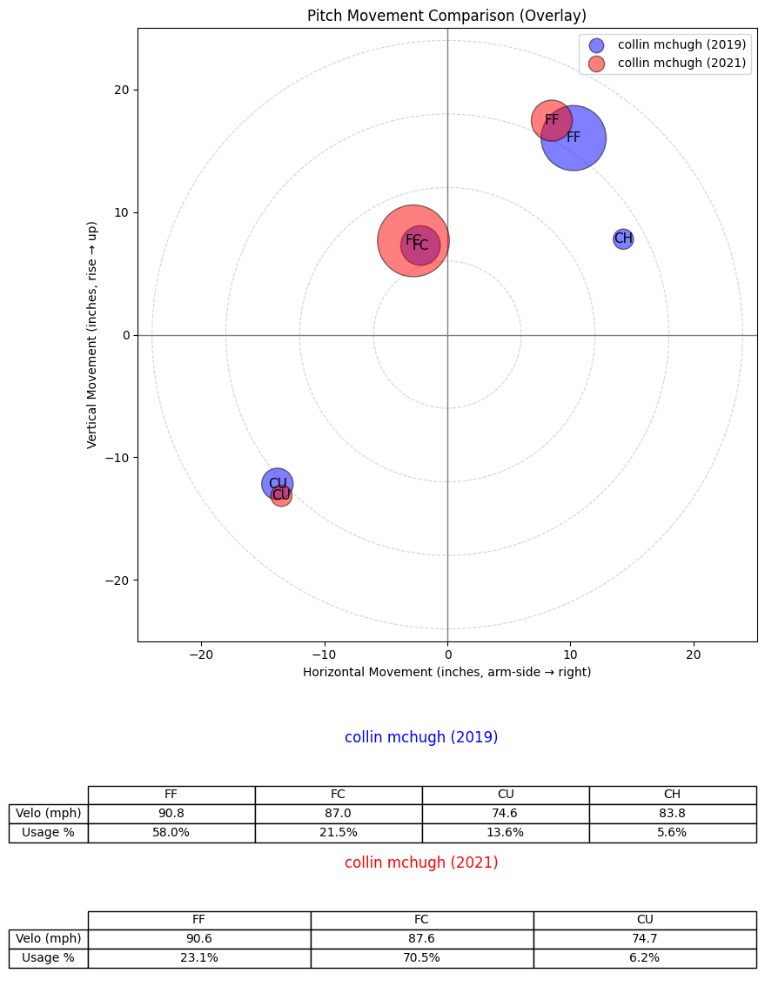

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


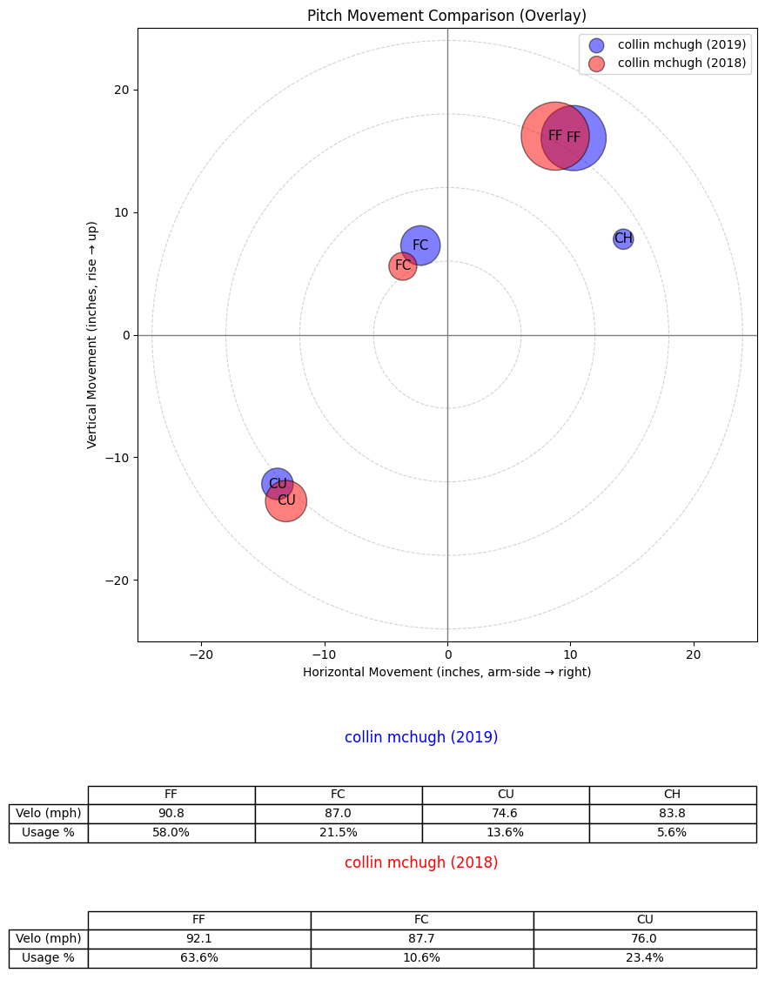

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


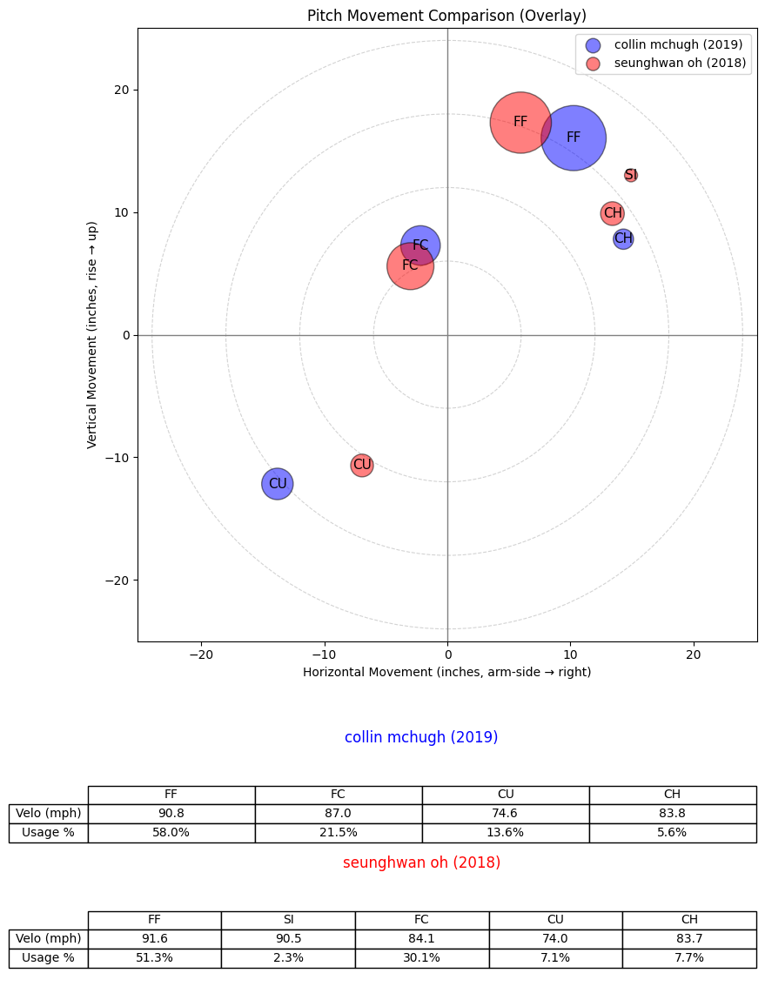

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


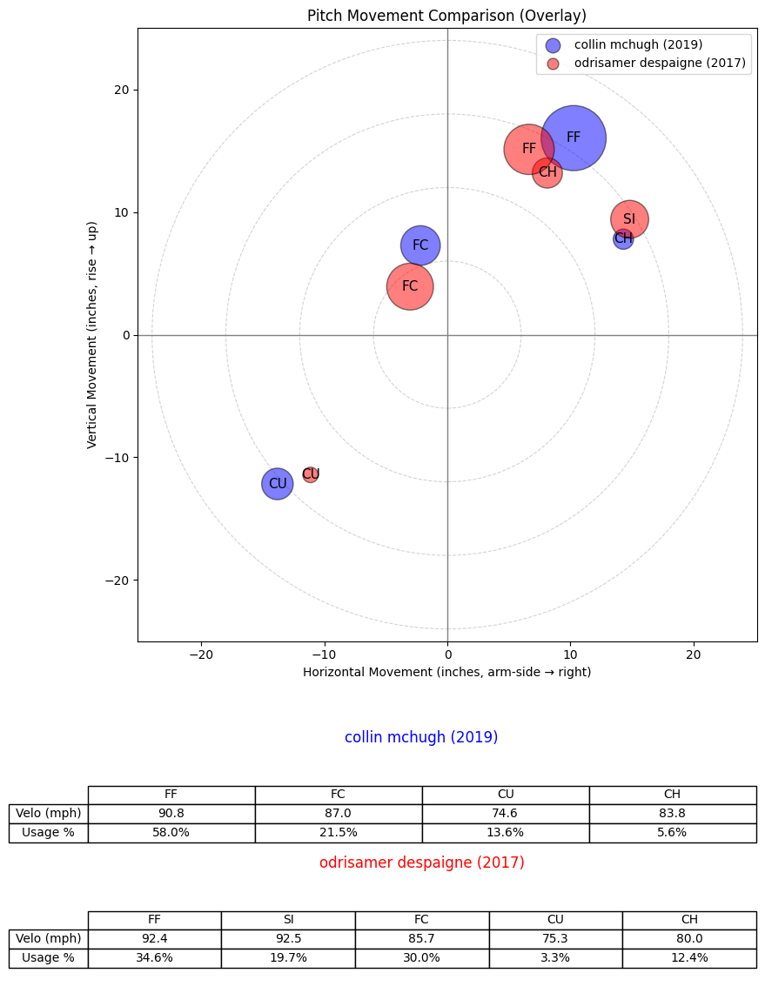

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


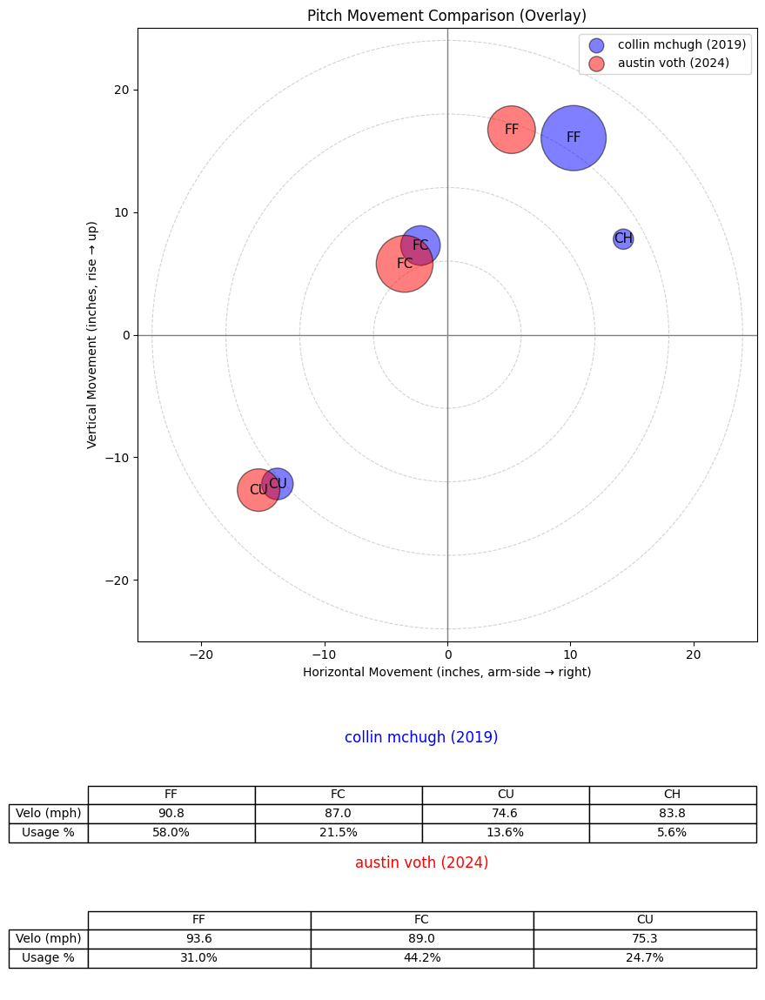

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
597,543521.0,2021,collin mchugh,collin,mchugh,R,reliever,0.869777
595,543521.0,2018,collin mchugh,collin,mchugh,R,reliever,0.825749
279,493200.0,2018,seunghwan oh,seunghwan,oh,R,reliever,0.757394
1436,628333.0,2017,odrisamer despaigne,odrisamer,despaigne,R,reliever,0.724177
1279,608723.0,2024,austin voth,austin,voth,R,reliever,0.719382


In [261]:
neighbors_same_ae = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="collin mchugh",
    year=2019,
    X_df=X_ae_df,               # <- autoencoder space
    meta_df=pitcher_season_df,
    n_neighbors=5,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same_ae)

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


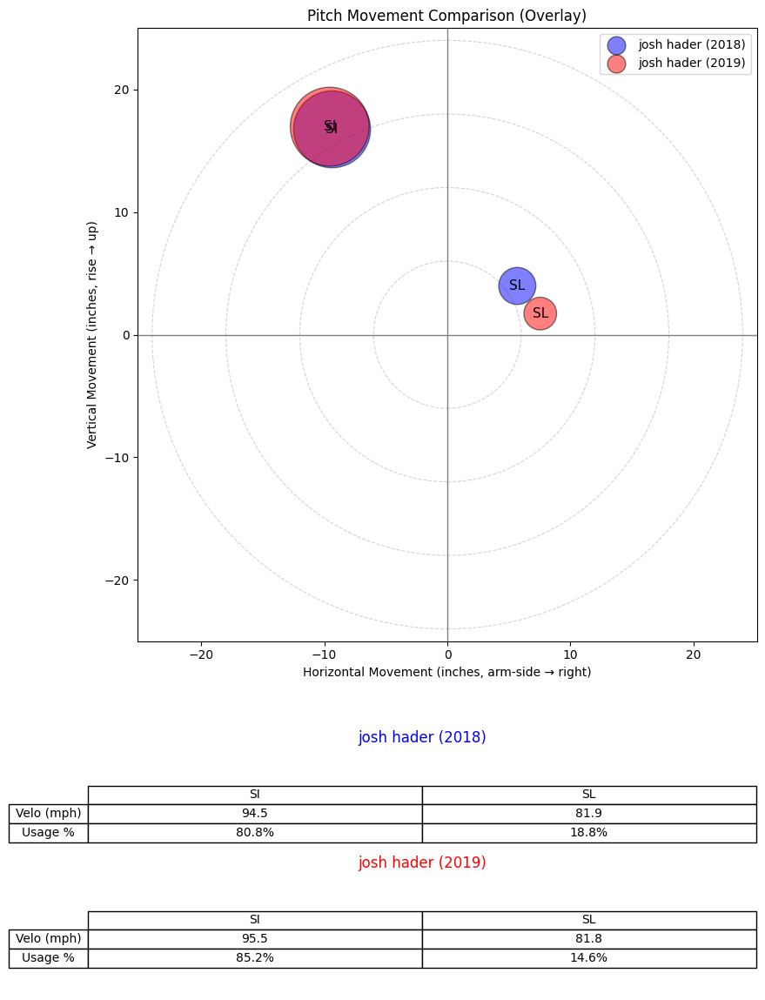

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


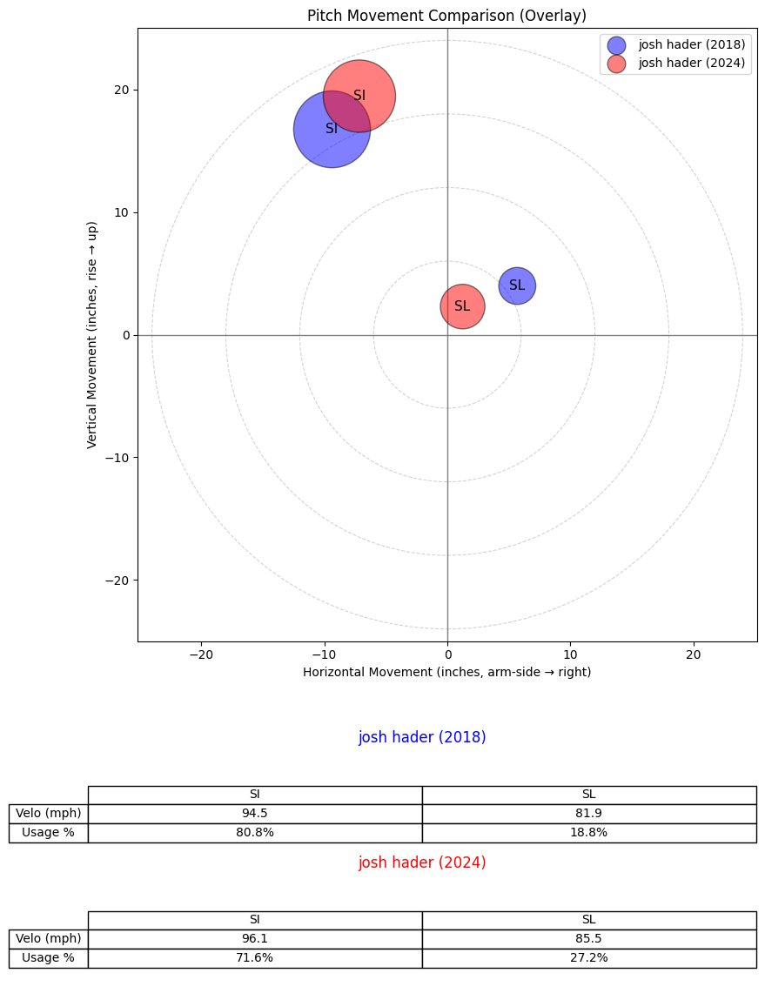

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


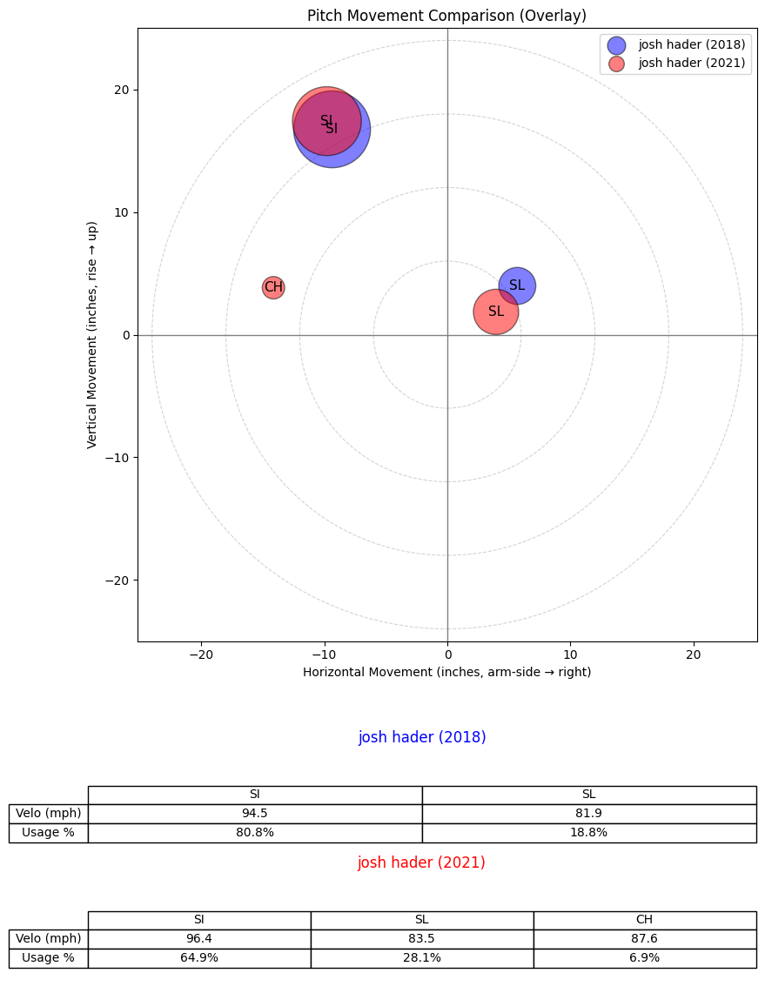

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


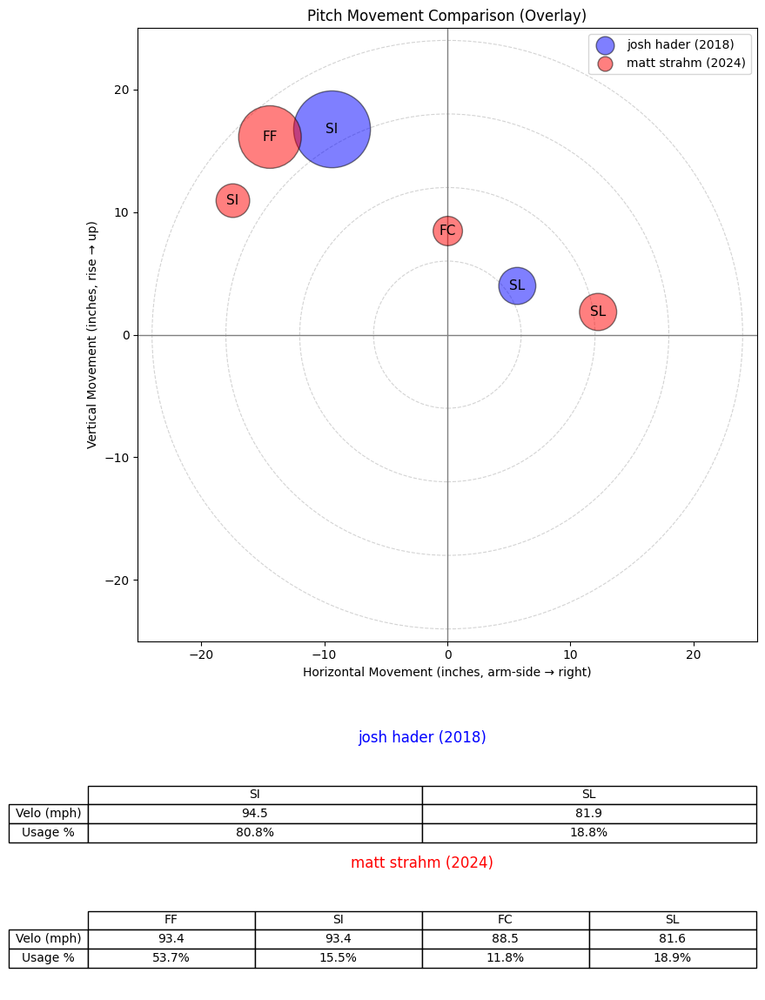

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


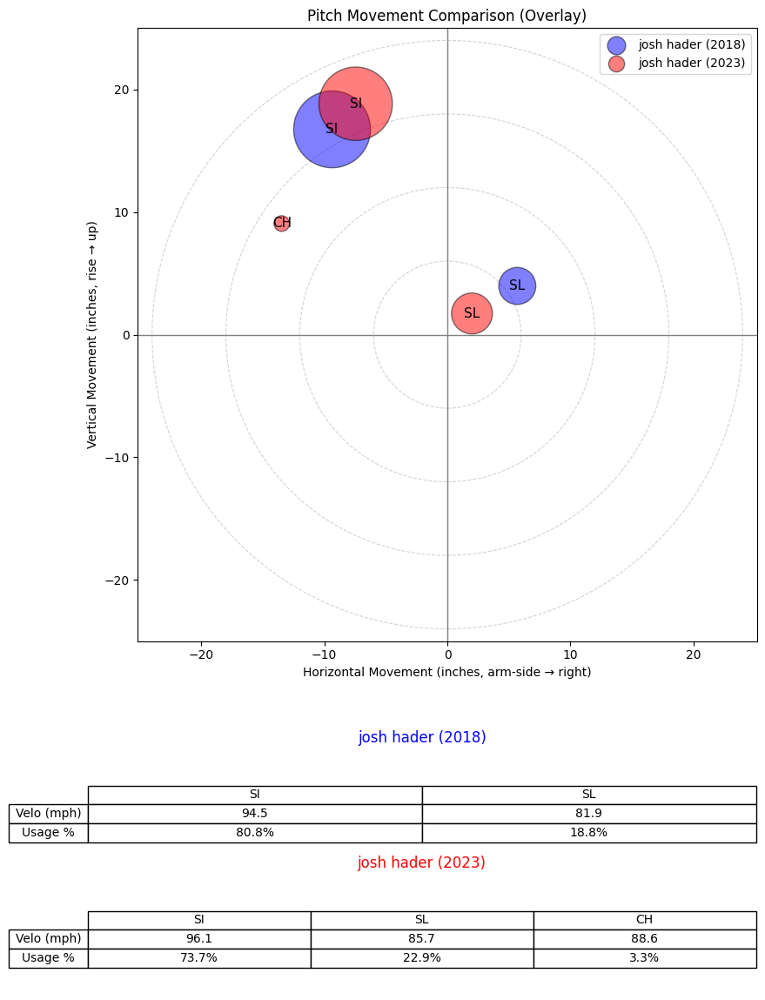

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


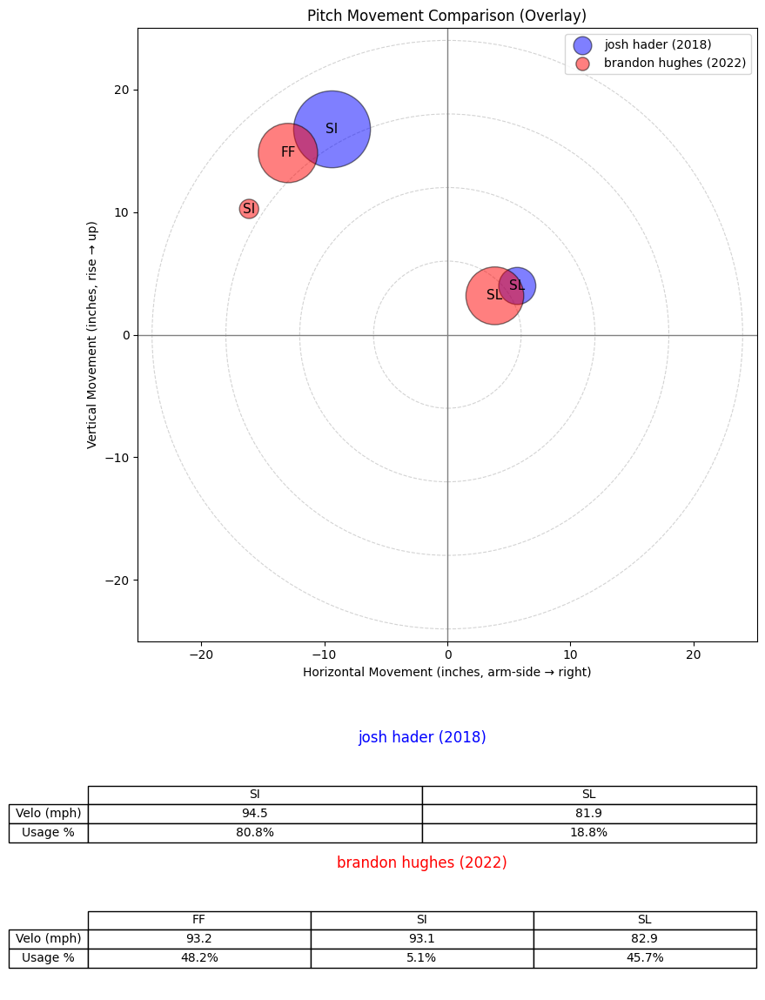

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


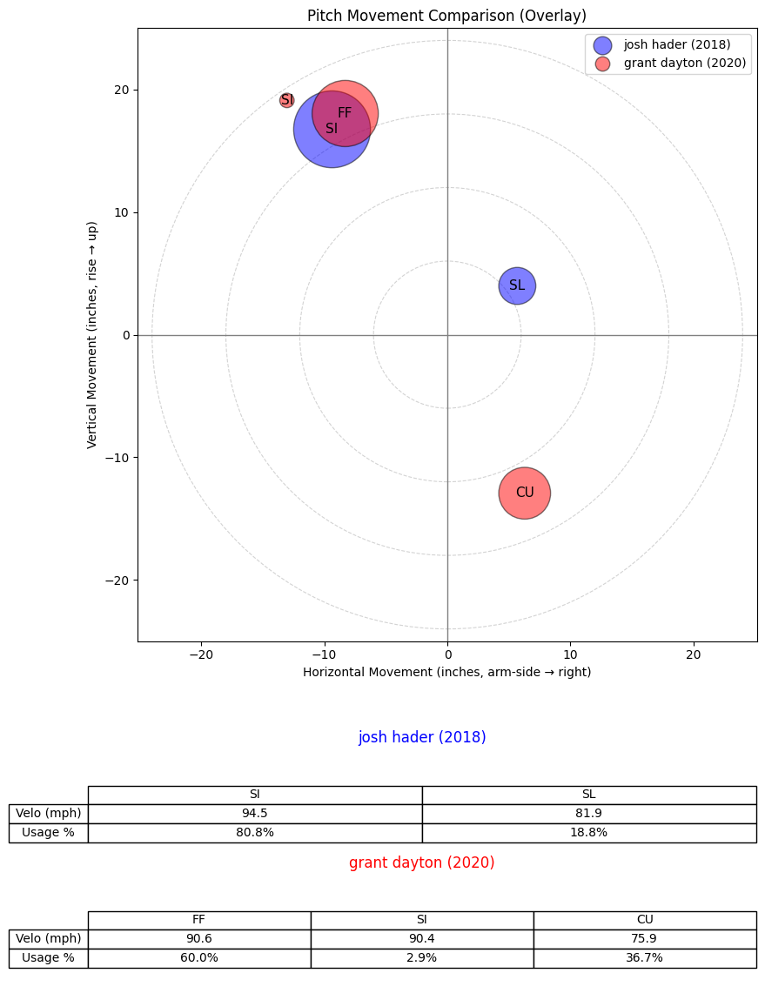

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


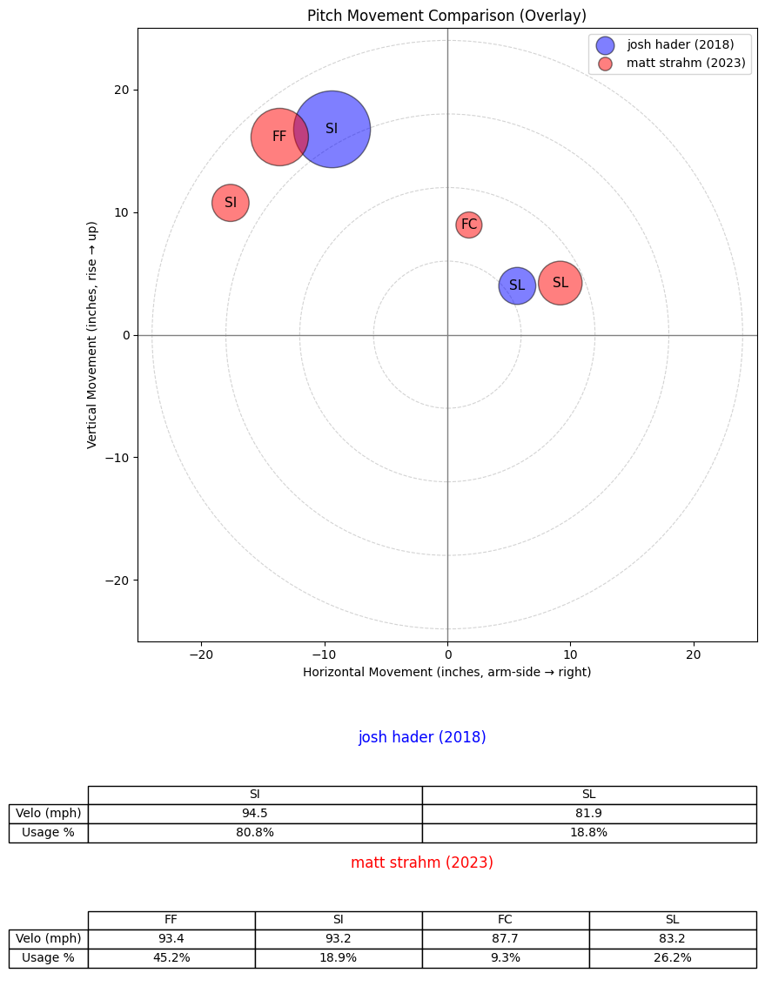

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


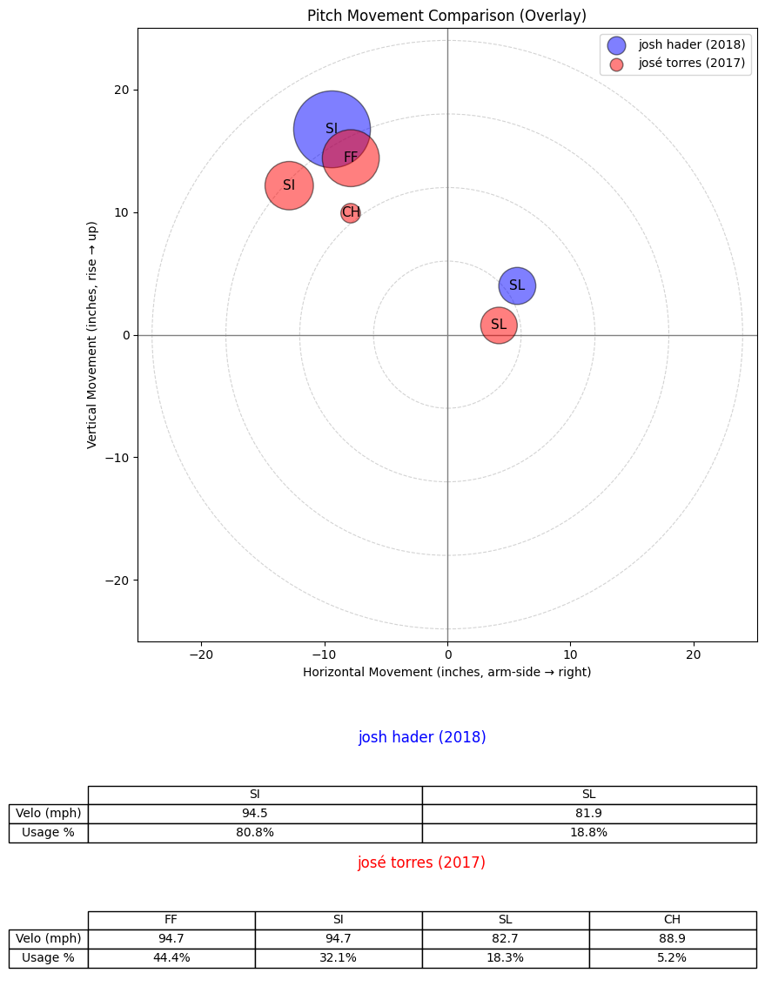

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


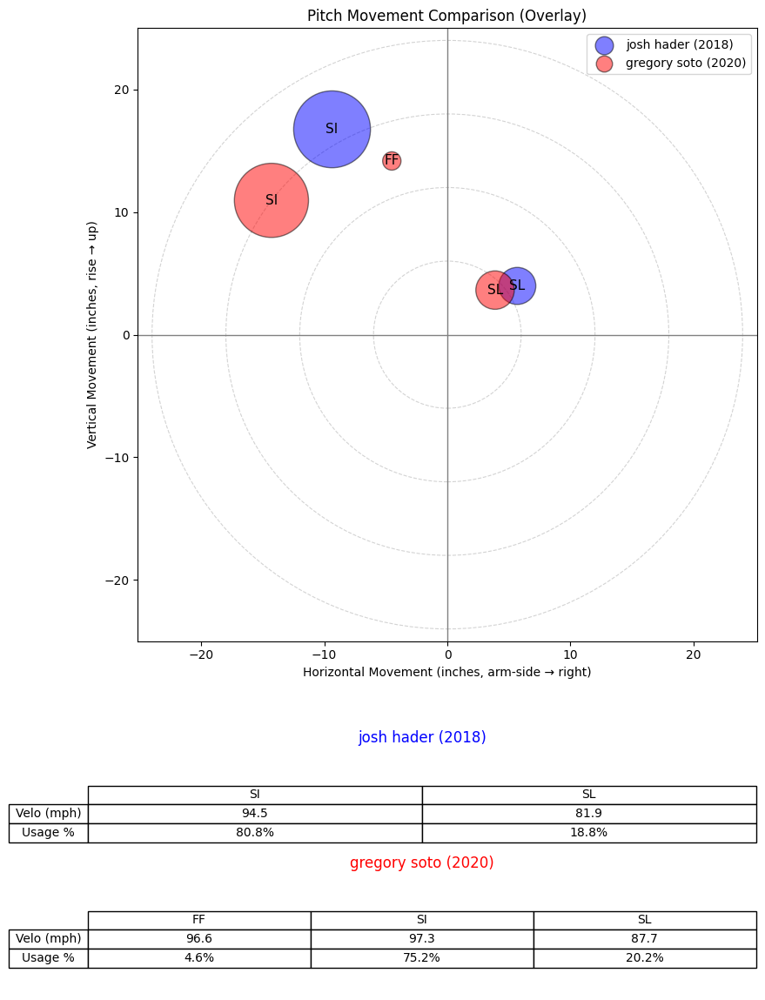

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
1406,623352.0,2019,josh hader,josh,hader,L,reliever,0.983304
1409,623352.0,2024,josh hader,josh,hader,L,reliever,0.899472
1407,623352.0,2021,josh hader,josh,hader,L,reliever,0.869098
1352,621381.0,2024,matt strahm,matt,strahm,L,reliever,0.831440
1408,623352.0,2023,josh hader,josh,hader,L,reliever,0.828232
2049,676714.0,2022,brandon hughes,brandon,hughes,L,reliever,0.823913
953,594795.0,2020,grant dayton,grant,dayton,L,reliever,0.813484
1351,621381.0,2023,matt strahm,matt,strahm,L,reliever,0.803775
1015,600526.0,2017,josé torres,josé,torres,L,reliever,0.799140
1565,642397.0,2020,gregory soto,gregory,soto,L,reliever,0.765987


In [262]:
neighbors_same_ae = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="josh hader",
    year=2018,
    X_df=X_ae_df,               # <- autoencoder space
    meta_df=pitcher_season_df,
    n_neighbors=10,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same_ae)

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


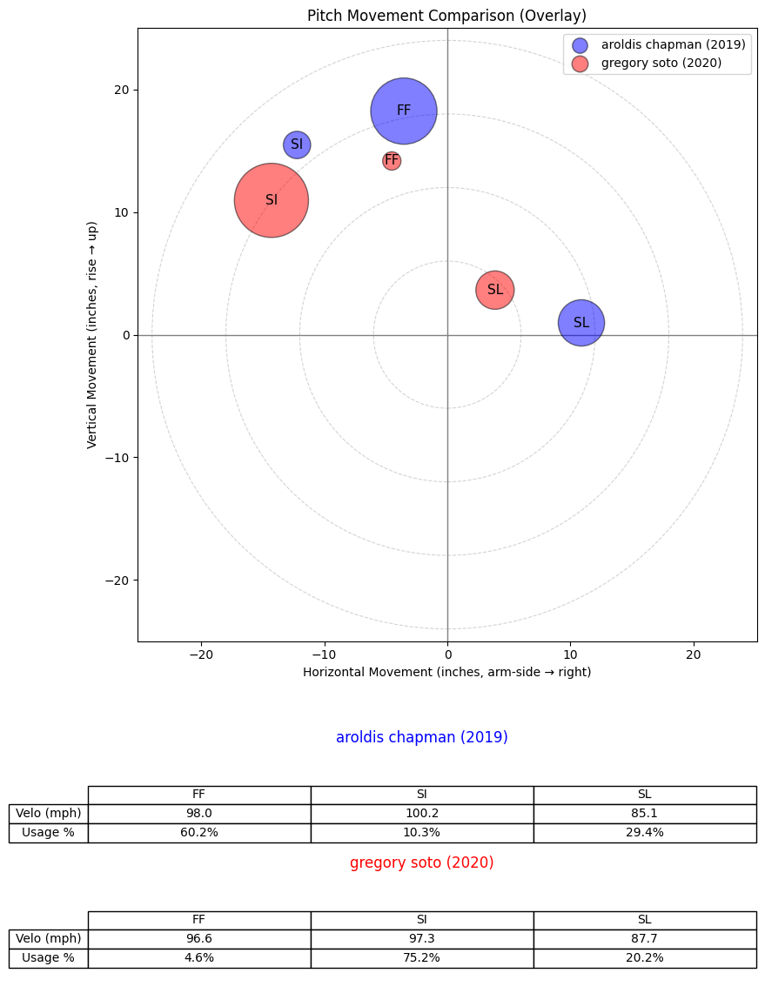

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


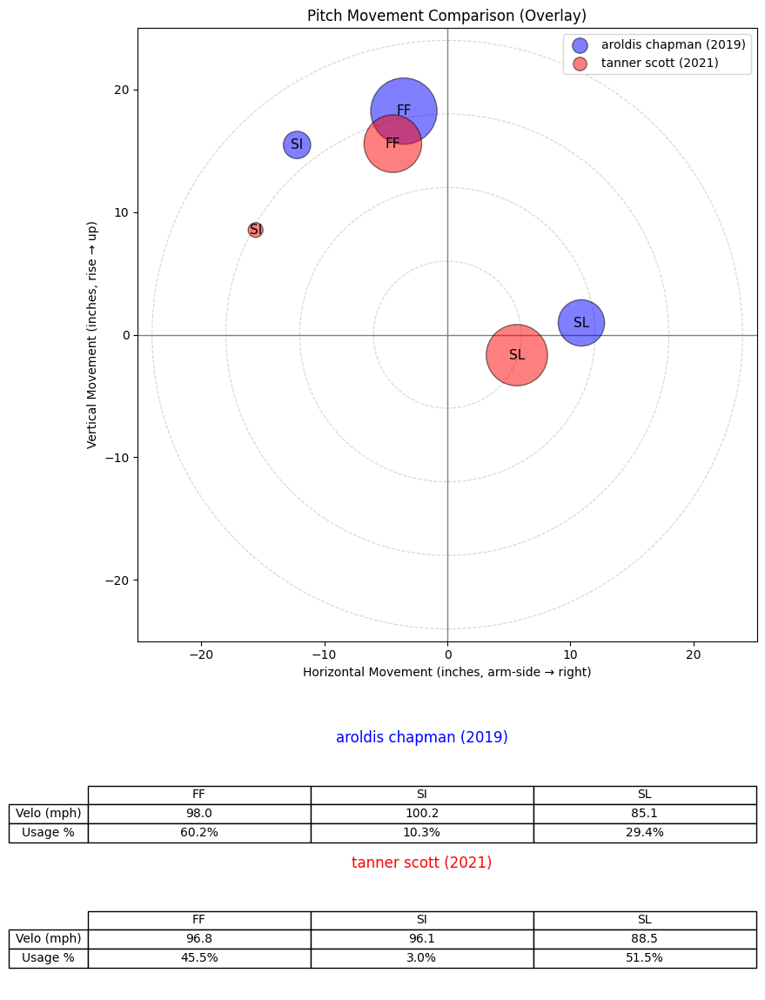

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


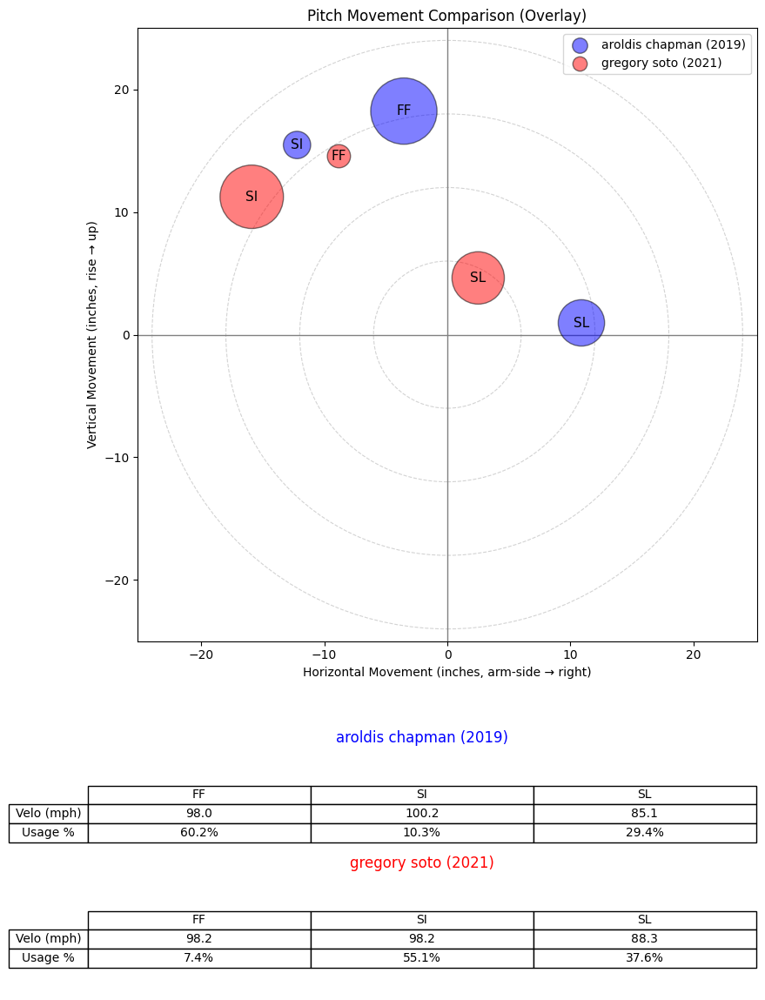

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


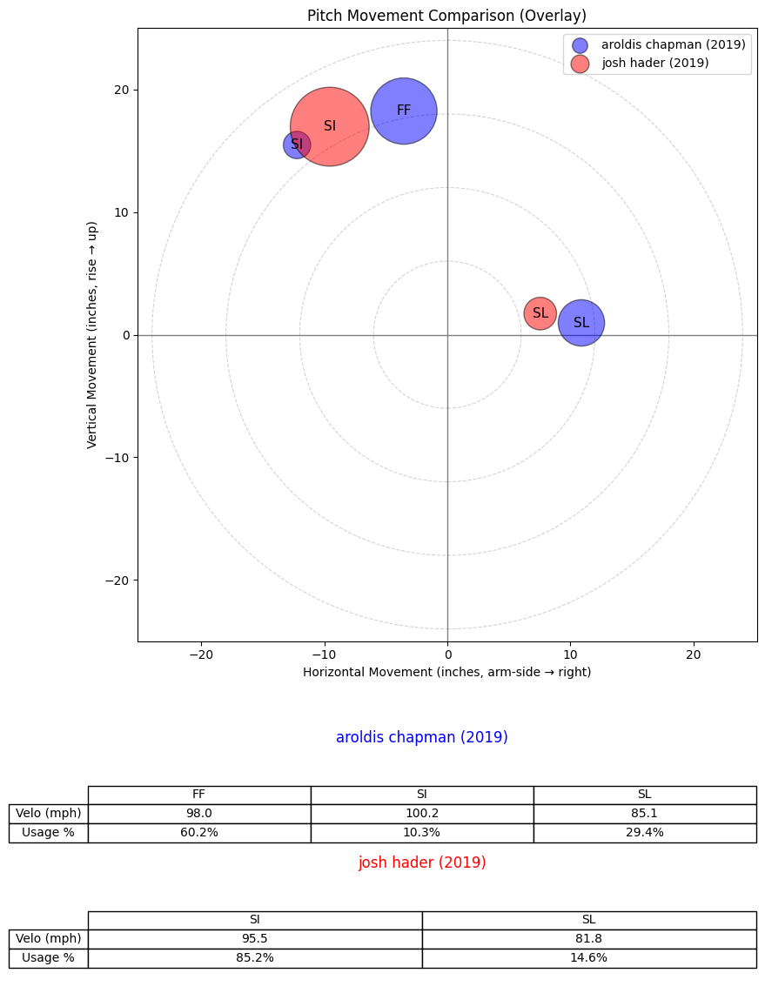

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


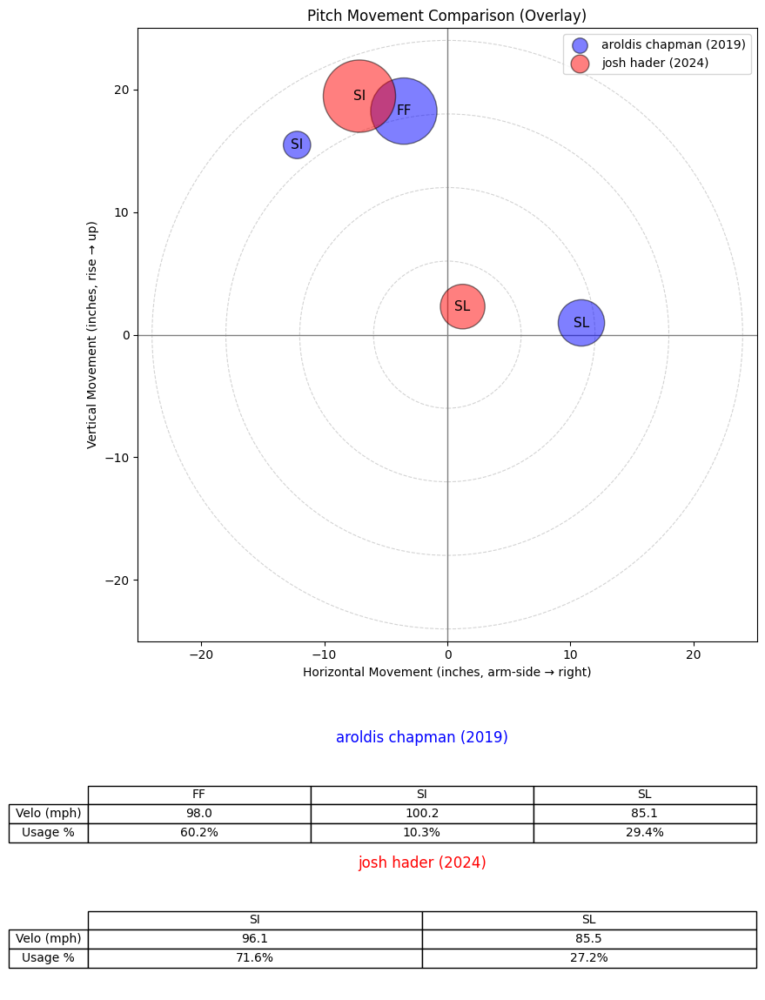

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


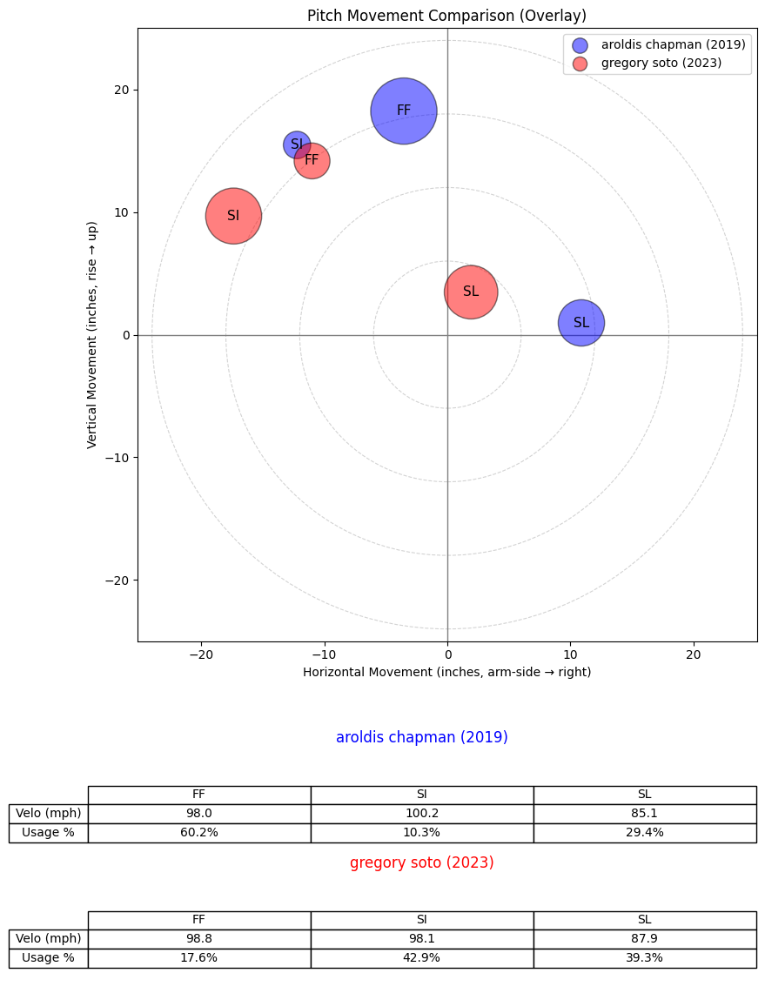

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


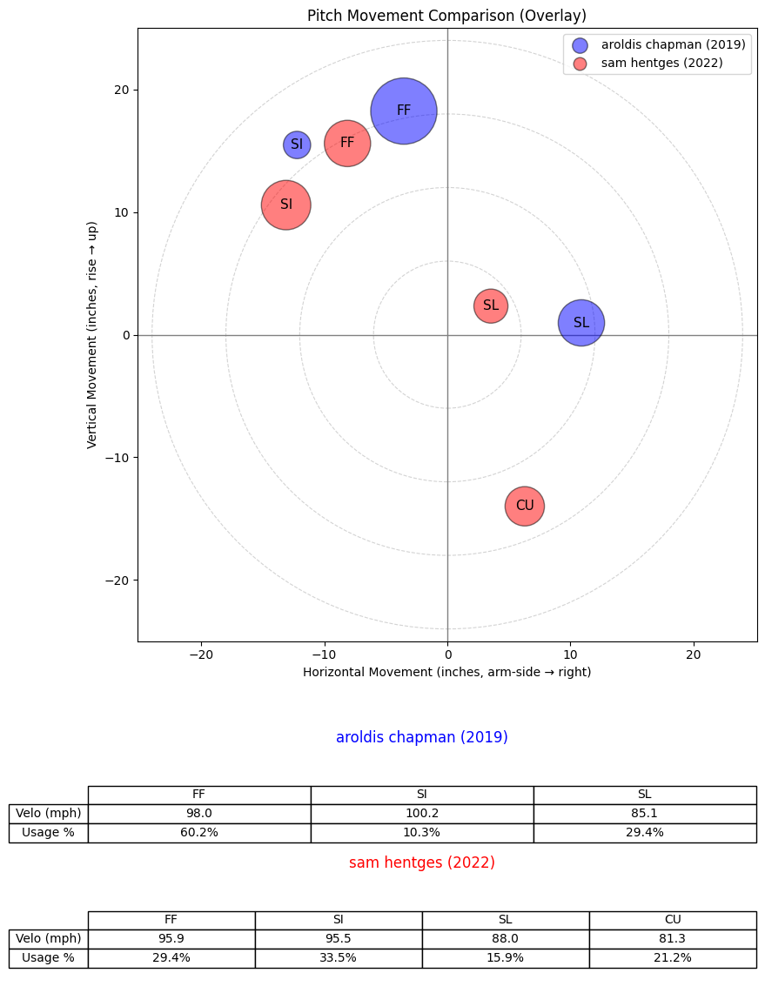

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


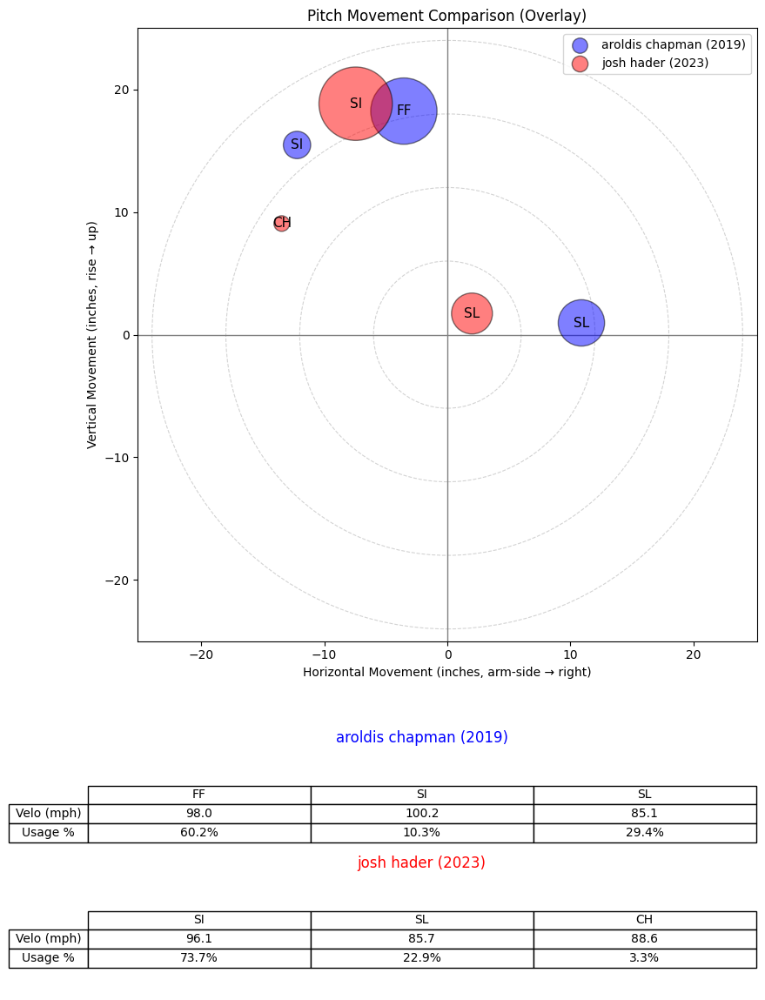

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


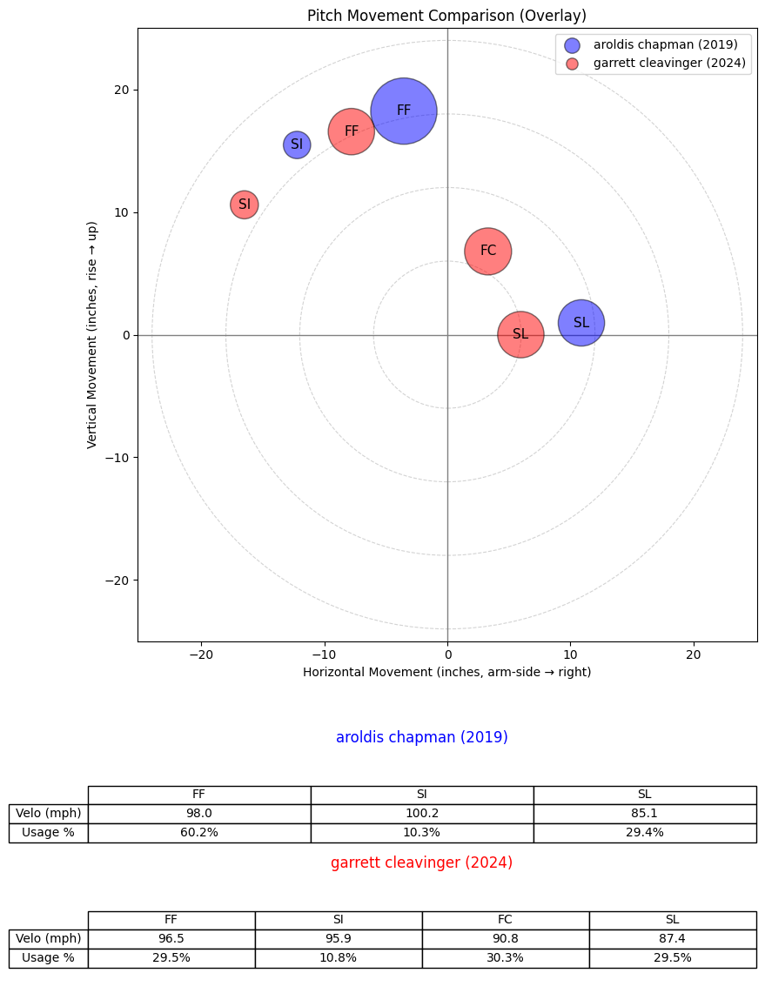

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


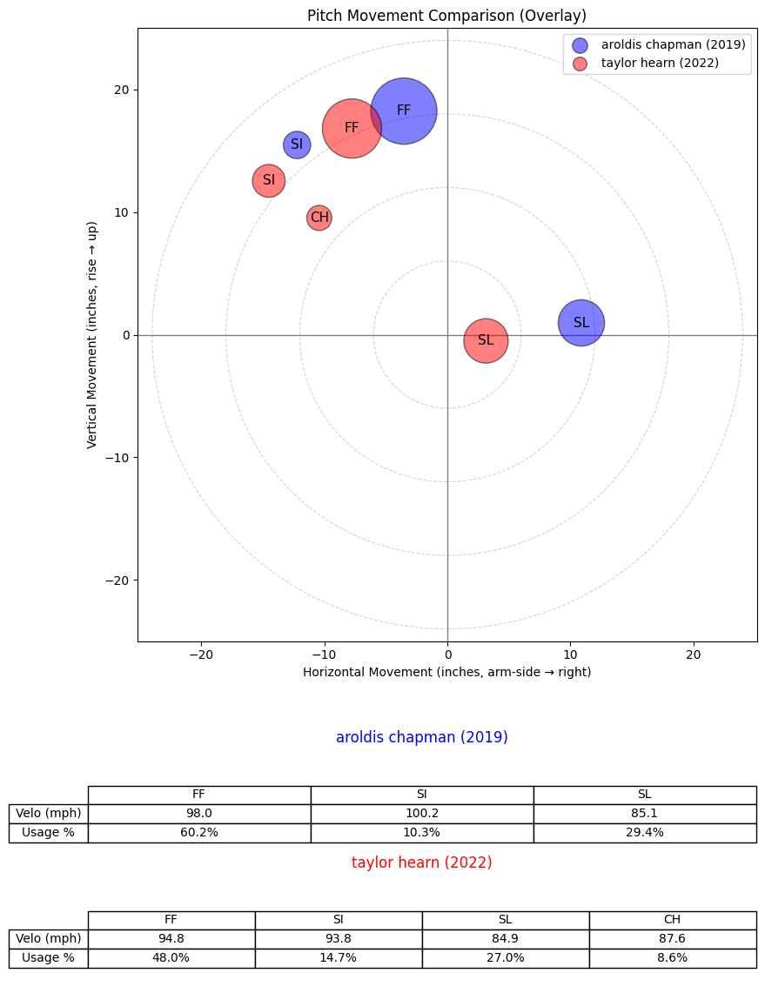

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
1565,642397.0,2020,gregory soto,gregory,soto,L,reliever,0.812510
1719,656945.0,2021,tanner scott,tanner,scott,L,reliever,0.808964
1566,642397.0,2021,gregory soto,gregory,soto,L,reliever,0.802240
1406,623352.0,2019,josh hader,josh,hader,L,reliever,0.779419
1409,623352.0,2024,josh hader,josh,hader,L,reliever,0.777588
1568,642397.0,2023,gregory soto,gregory,soto,L,reliever,0.776523
1682,656529.0,2022,sam hentges,sam,hentges,L,reliever,0.767184
1408,623352.0,2023,josh hader,josh,hader,L,reliever,0.762994
1842,664076.0,2024,garrett cleavinger,garrett,cleavinger,L,reliever,0.750733
1347,621368.0,2022,taylor hearn,taylor,hearn,L,reliever,0.748938


In [263]:
neighbors_same_ae = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="aroldis chapman",
    year=2019,
    X_df=X_ae_df,               # <- autoencoder space
    meta_df=pitcher_season_df,
    n_neighbors=10,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same_ae)

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


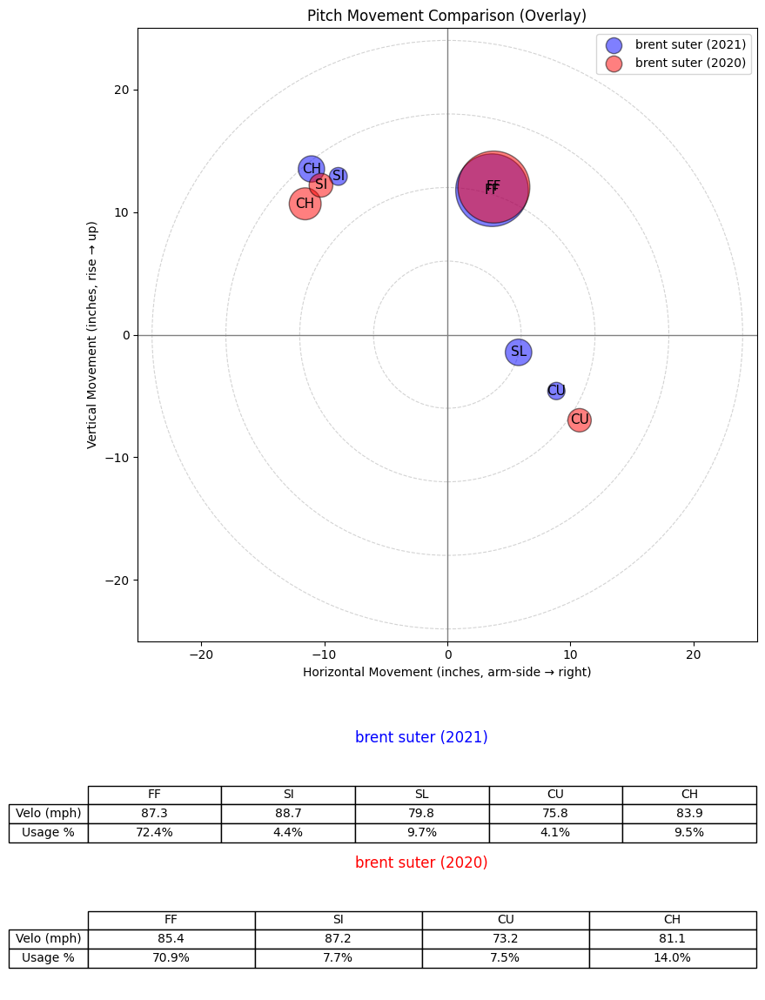

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


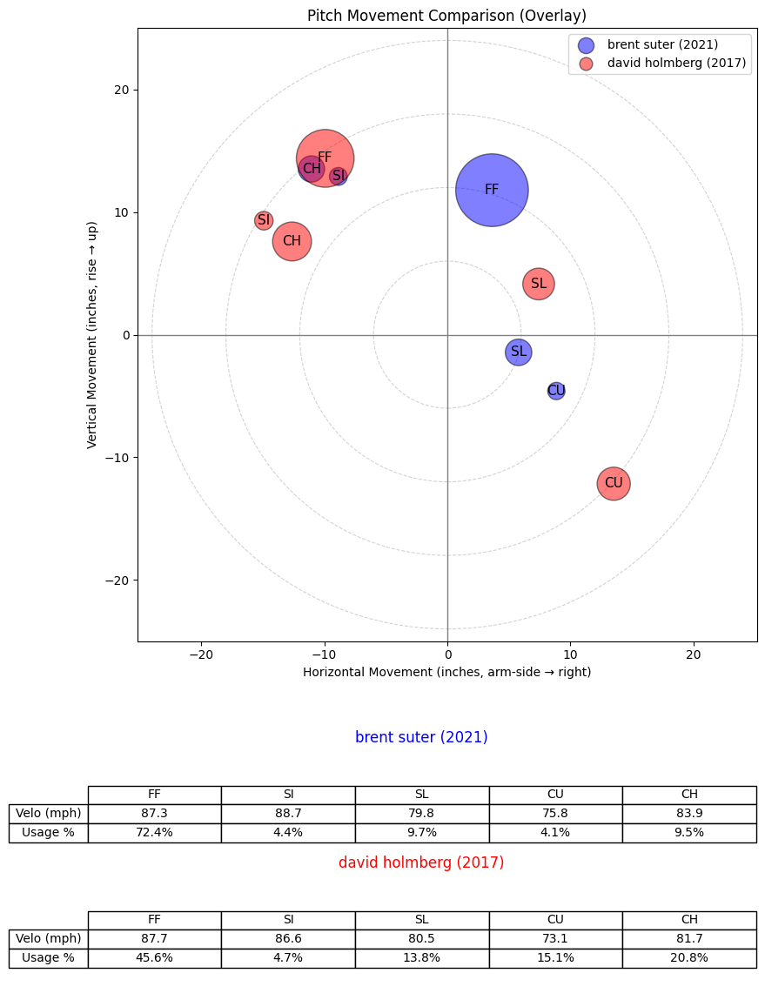

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


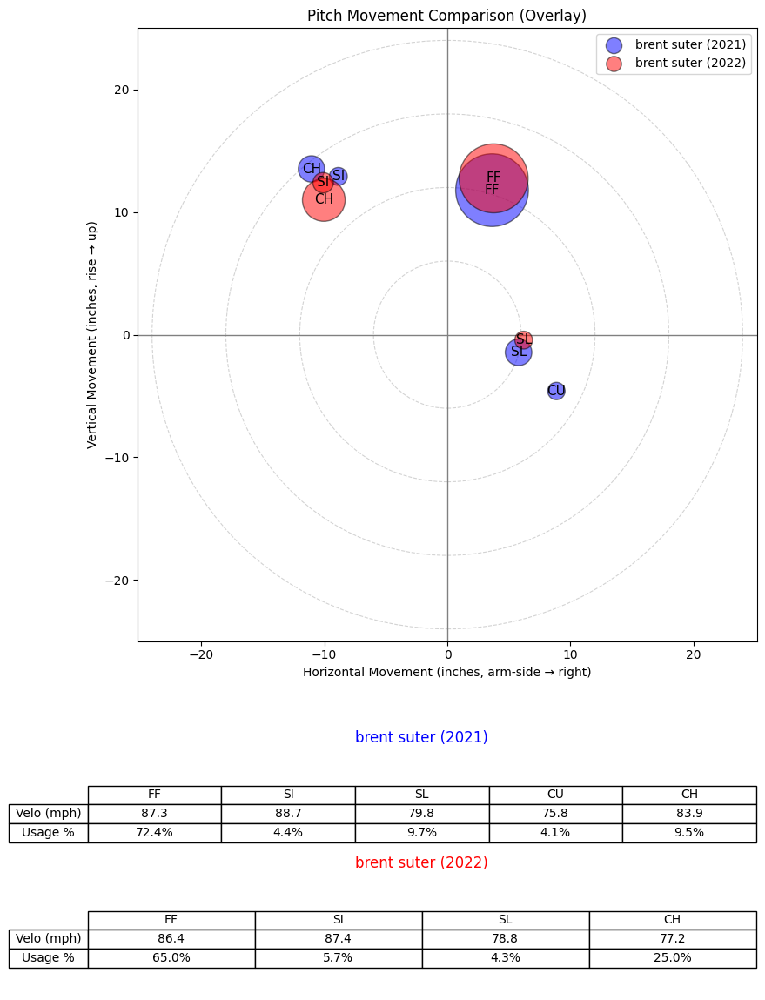

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


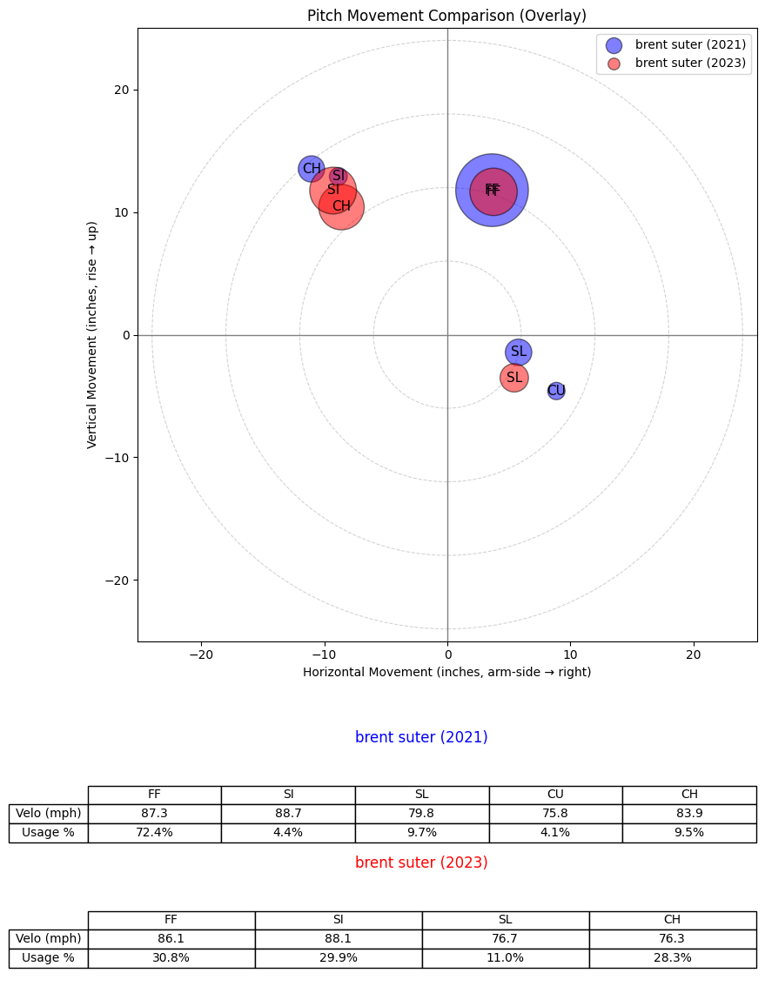

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


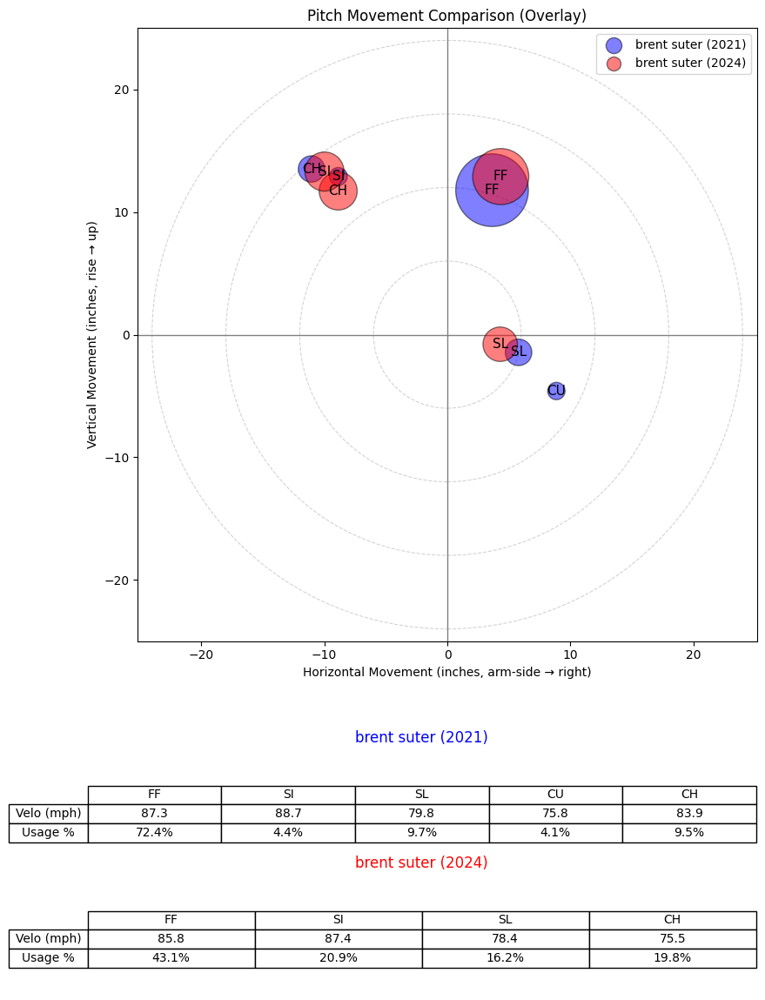

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


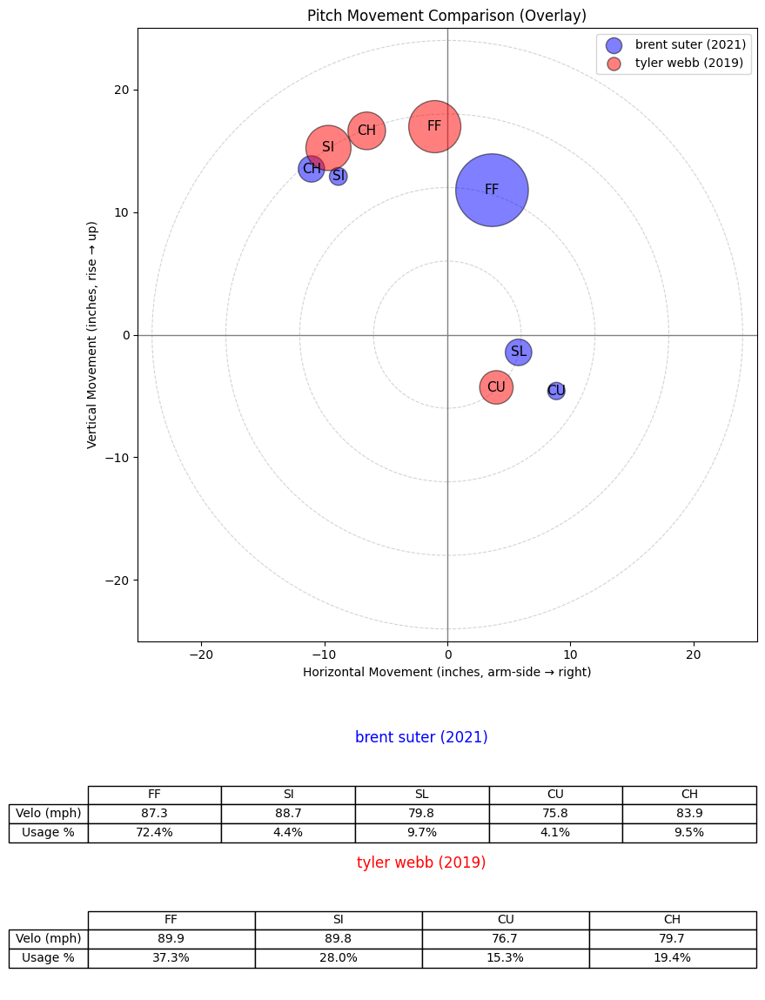

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


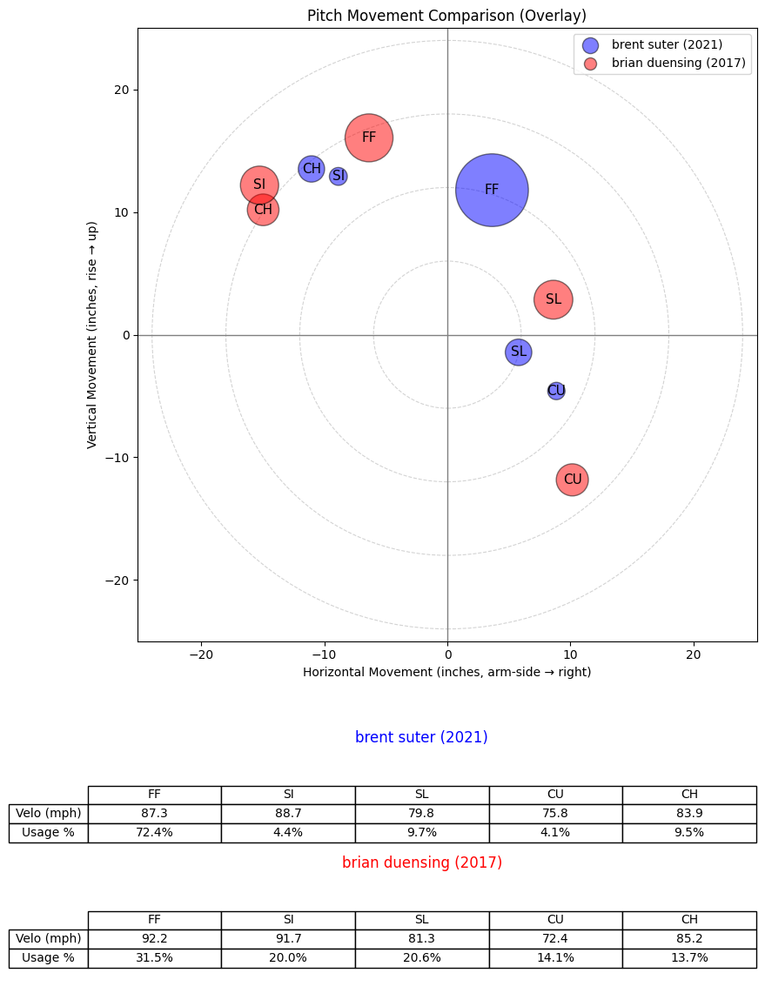

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


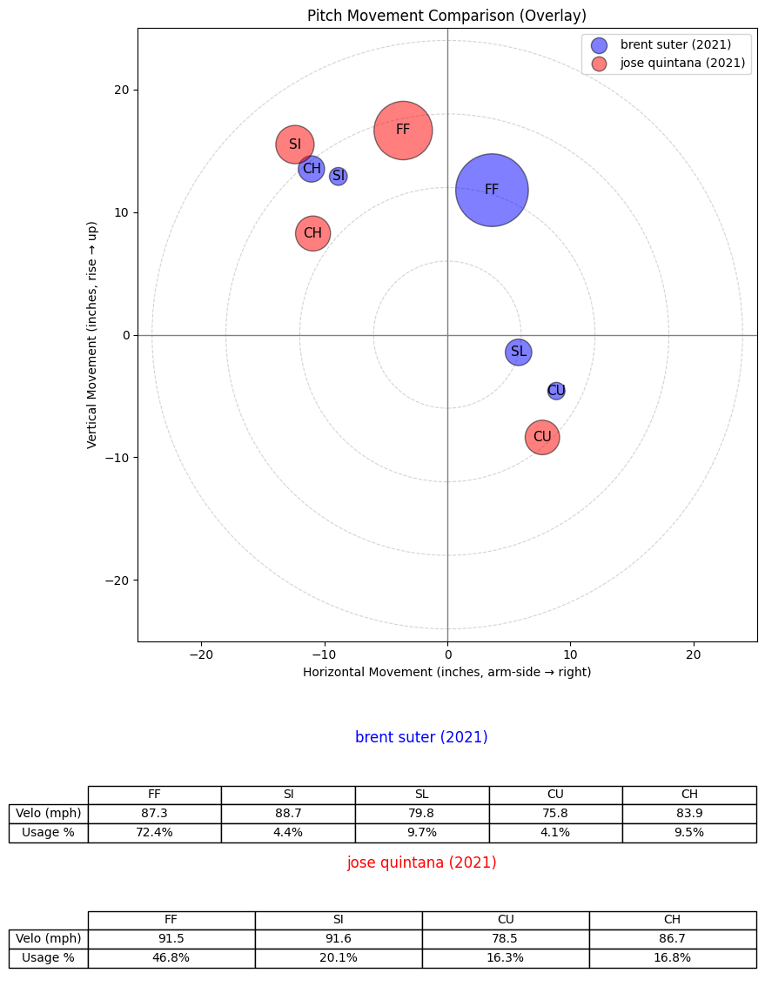

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


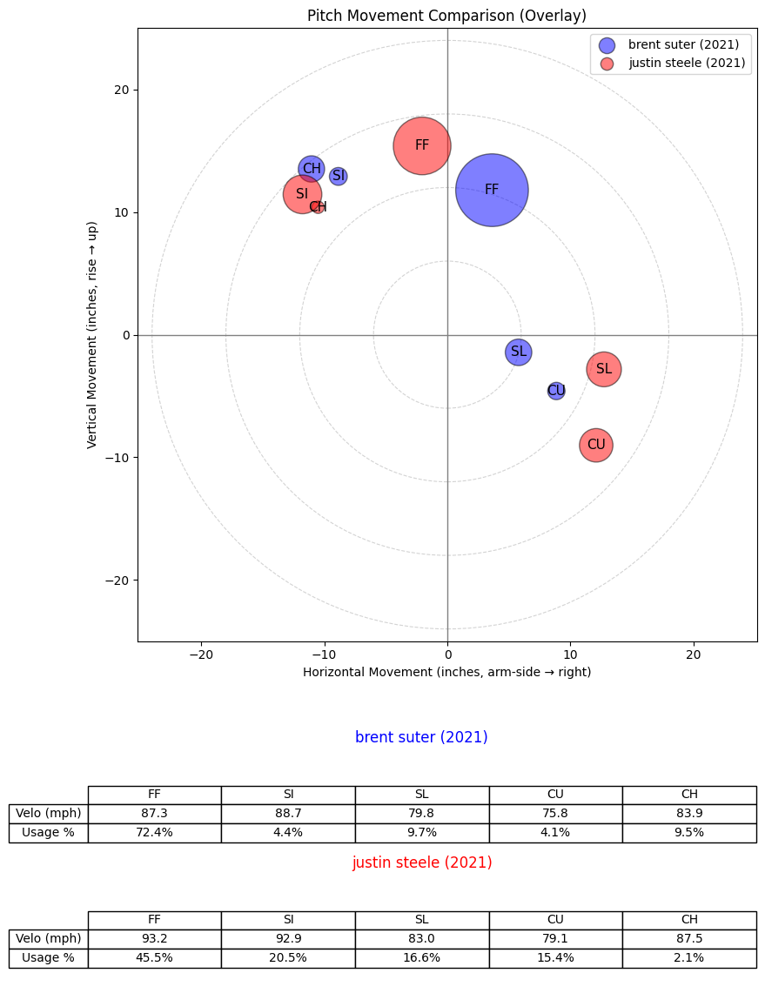

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


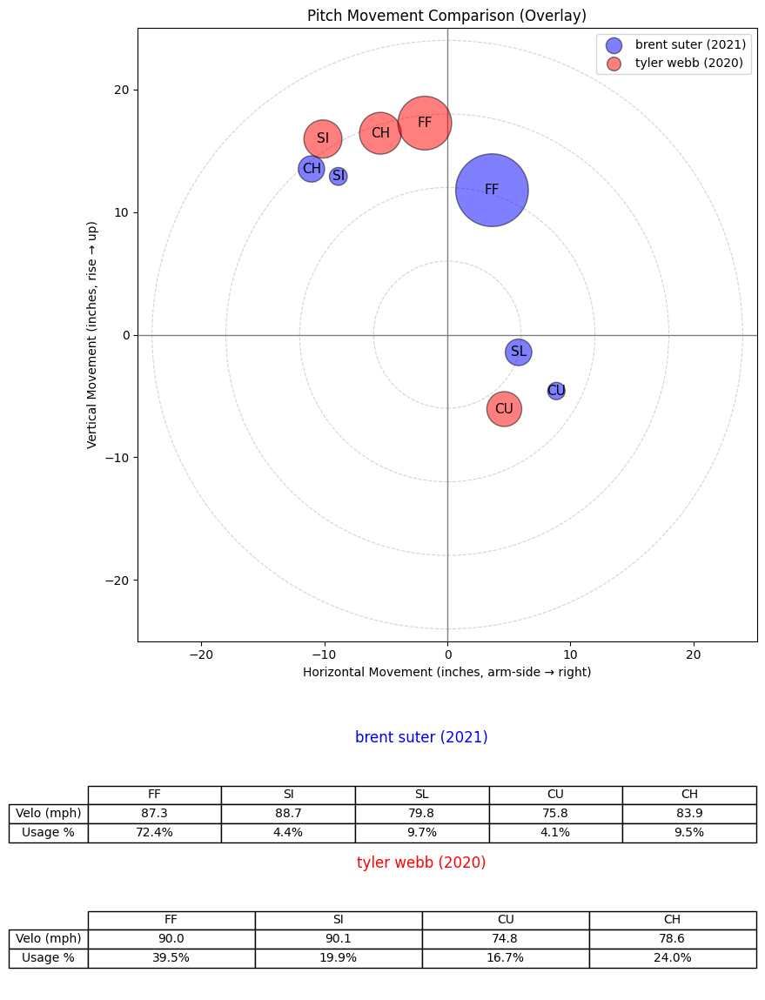

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
1271,608718.0,2020,brent suter,brent,suter,L,reliever,0.904379
740,571787.0,2017,david holmberg,david,holmberg,L,reliever,0.895553
1273,608718.0,2022,brent suter,brent,suter,L,reliever,0.864894
1274,608718.0,2023,brent suter,brent,suter,L,reliever,0.843596
1275,608718.0,2024,brent suter,brent,suter,L,reliever,0.835155
1621,643778.0,2019,tyler webb,tyler,webb,L,reliever,0.829886
254,488846.0,2017,brian duensing,brian,duensing,L,reliever,0.827991
292,500779.0,2021,jose quintana,jose,quintana,L,reliever,0.824689
1724,657006.0,2021,justin steele,justin,steele,L,reliever,0.813677
1622,643778.0,2020,tyler webb,tyler,webb,L,reliever,0.806674


In [264]:
neighbors_same_ae = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="brent suter",
    year=2021,
    X_df=X_ae_df,               # <- autoencoder space
    meta_df=pitcher_season_df,
    n_neighbors=10,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same_ae)

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


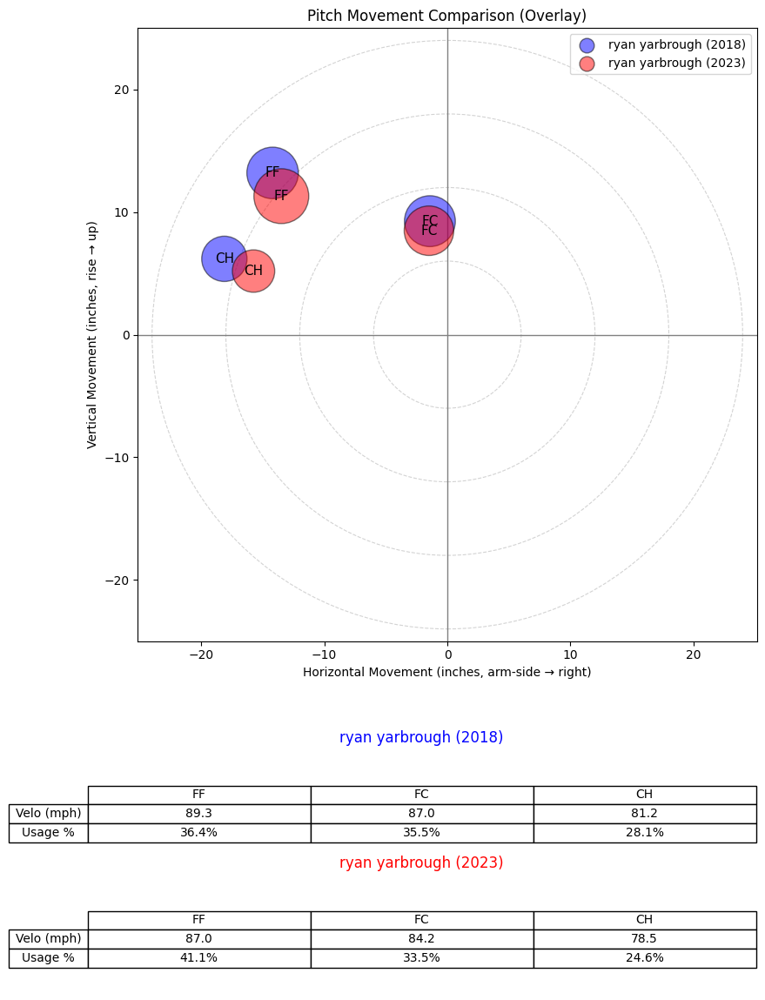

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


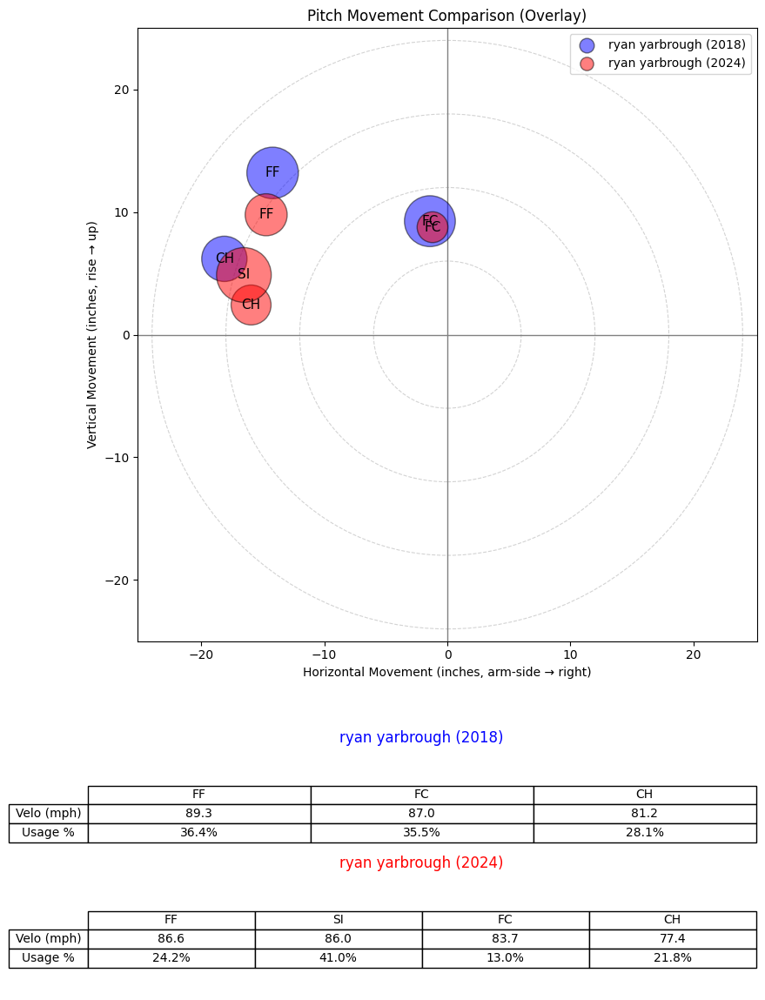

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


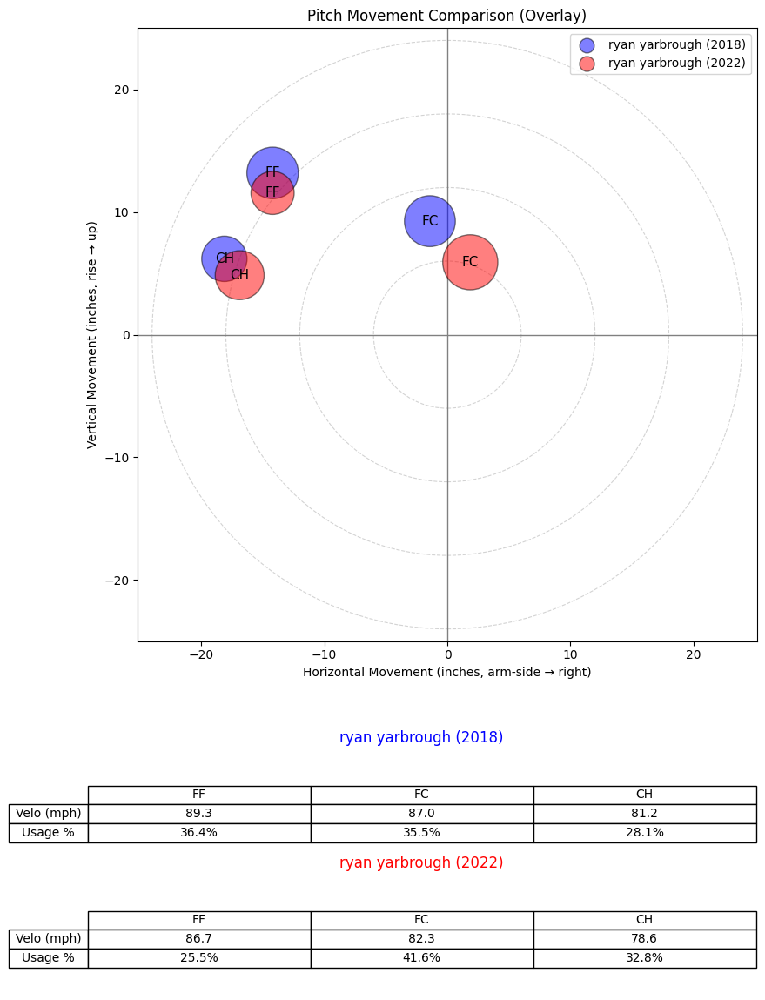

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


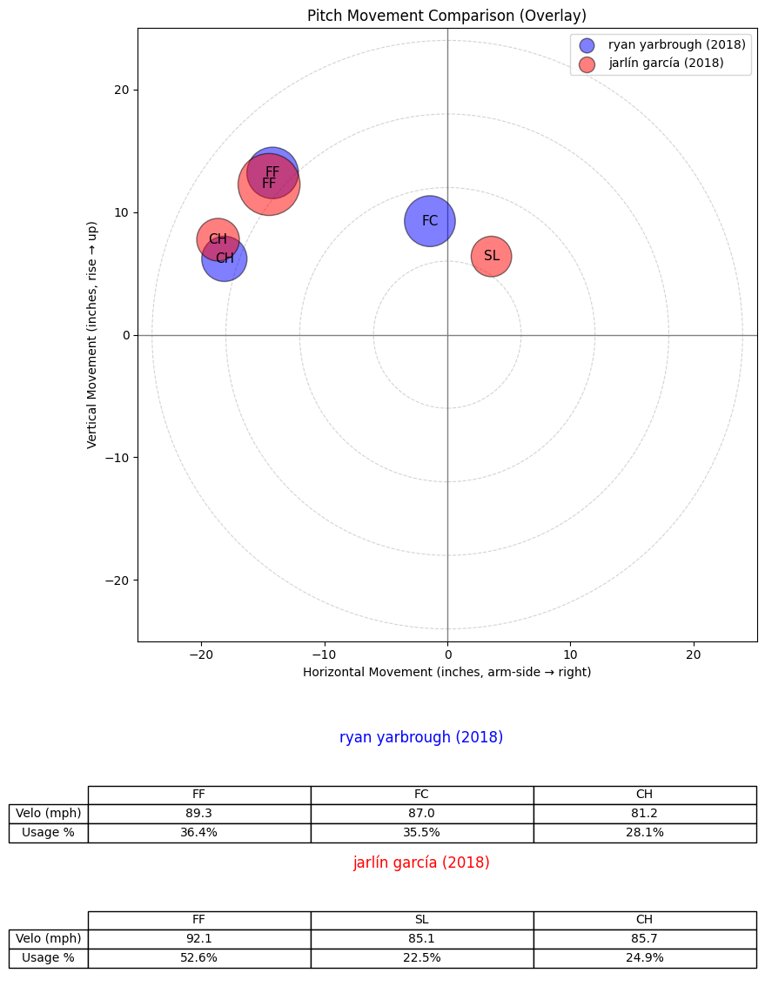

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


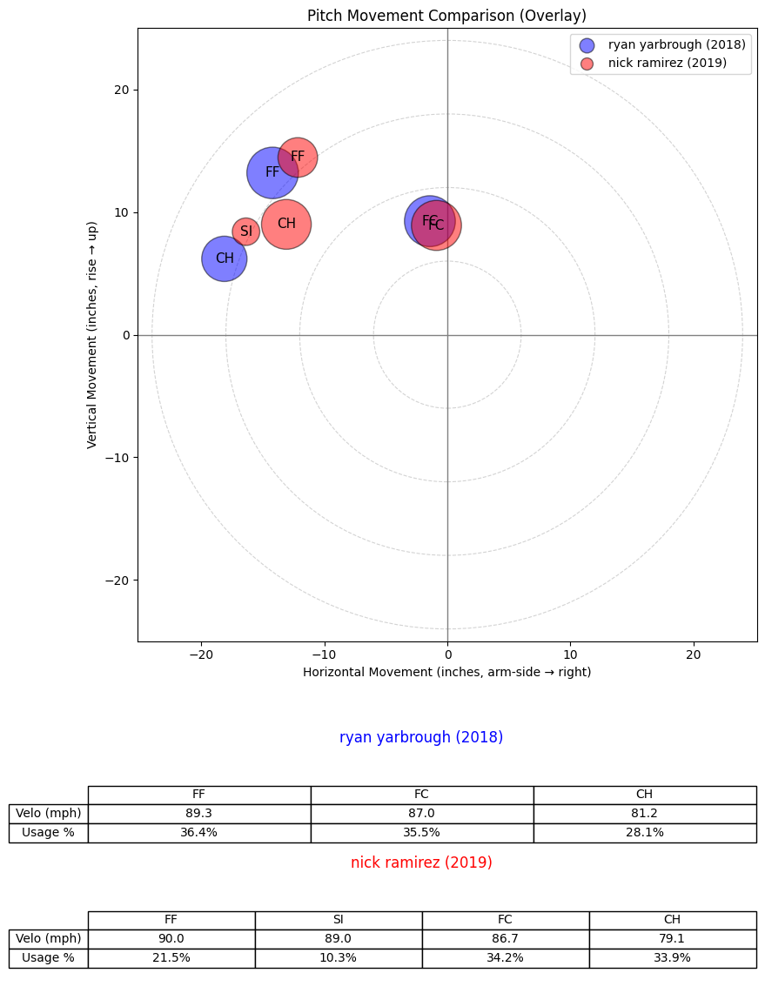

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
1561,642232.0,2023,ryan yarbrough,ryan,yarbrough,L,reliever,0.961179
1562,642232.0,2024,ryan yarbrough,ryan,yarbrough,L,reliever,0.899732
1560,642232.0,2022,ryan yarbrough,ryan,yarbrough,L,reliever,0.888801
1148,606424.0,2018,jarlín garcía,jarlín,garcía,L,reliever,0.860634
1010,598286.0,2019,nick ramirez,nick,ramirez,L,reliever,0.851892


In [265]:
neighbors_same_ae = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="ryan yarbrough",
    year=2018,
    X_df=X_ae_df,               # <- autoencoder space
    meta_df=pitcher_season_df,
    n_neighbors=5,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same_ae)

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


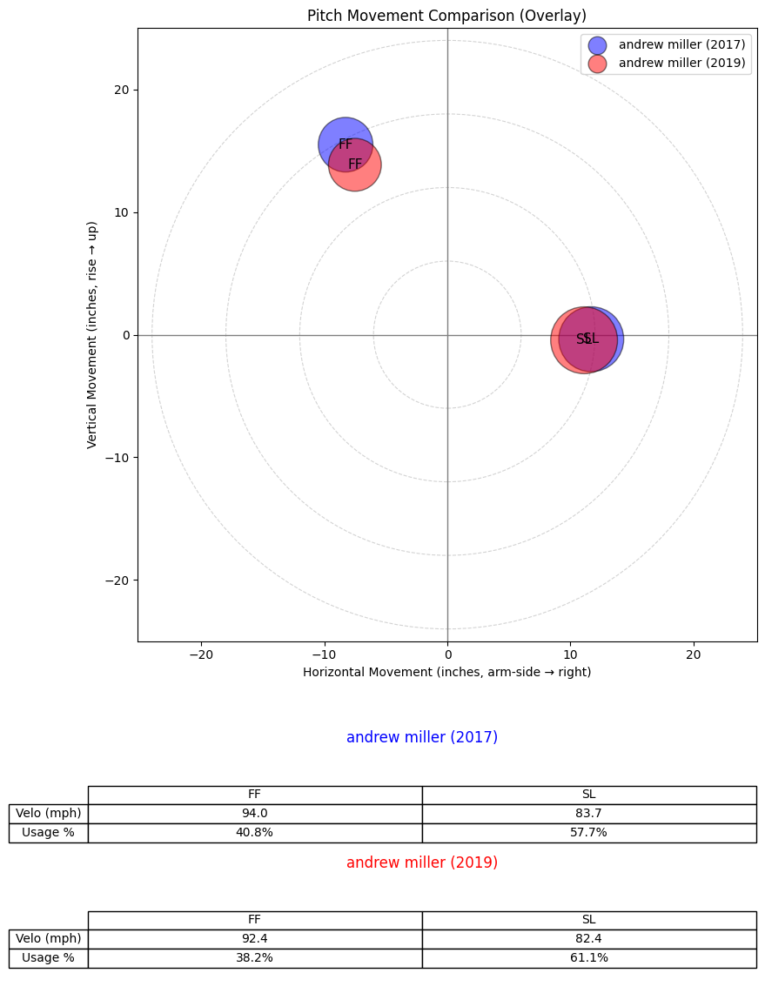

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


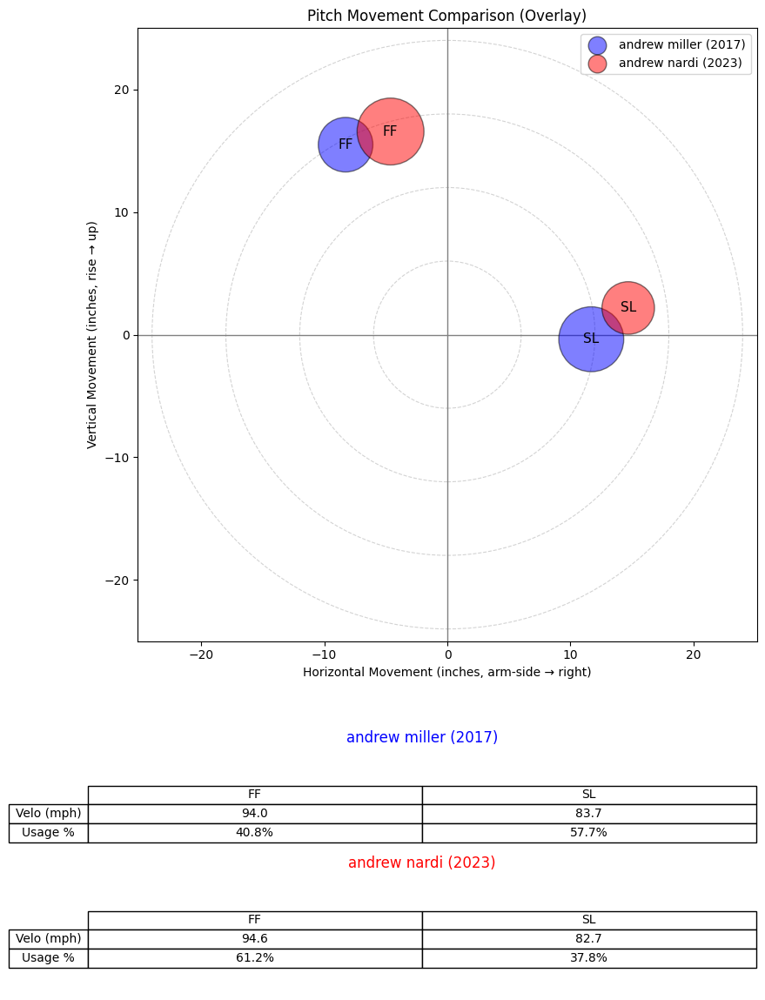

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


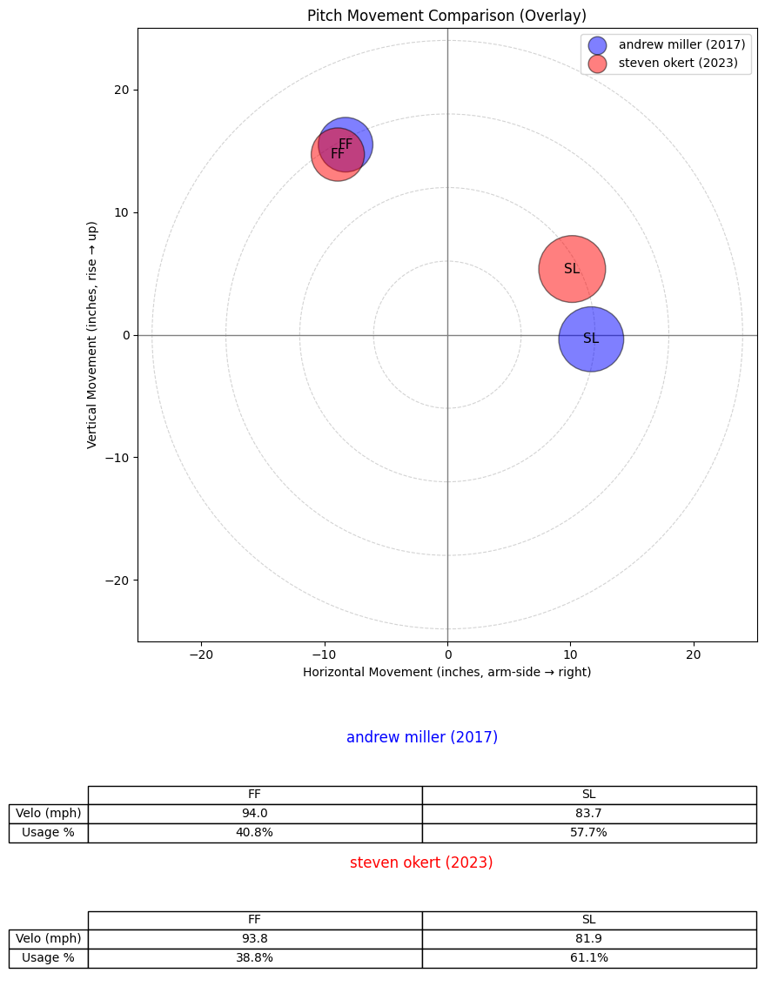

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


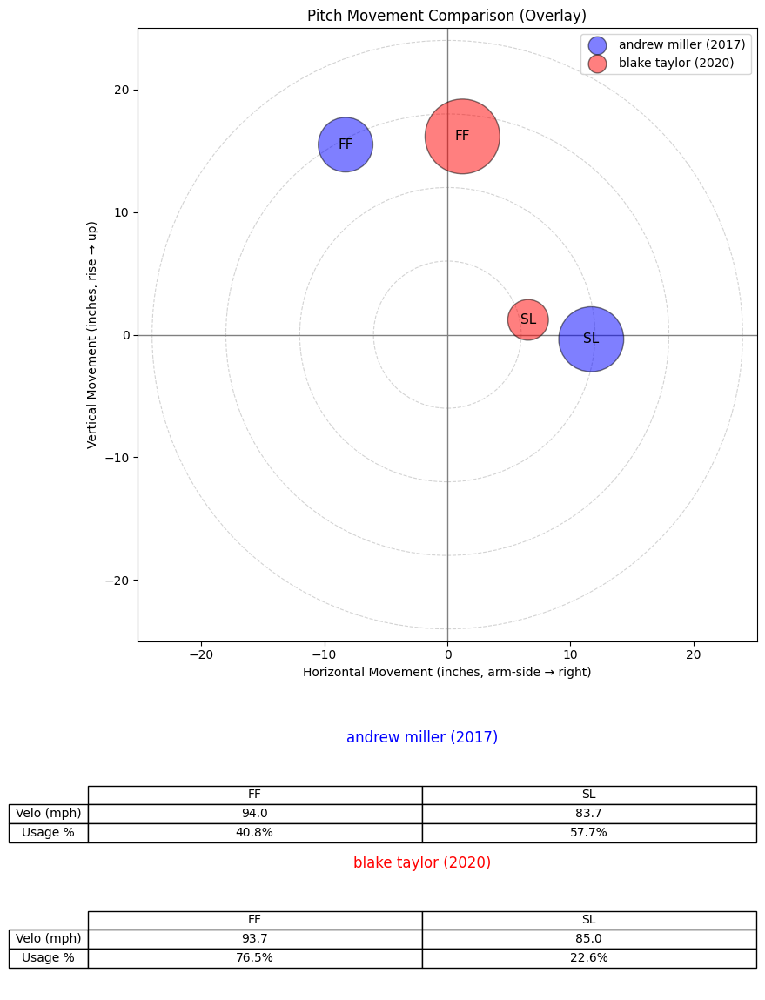

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


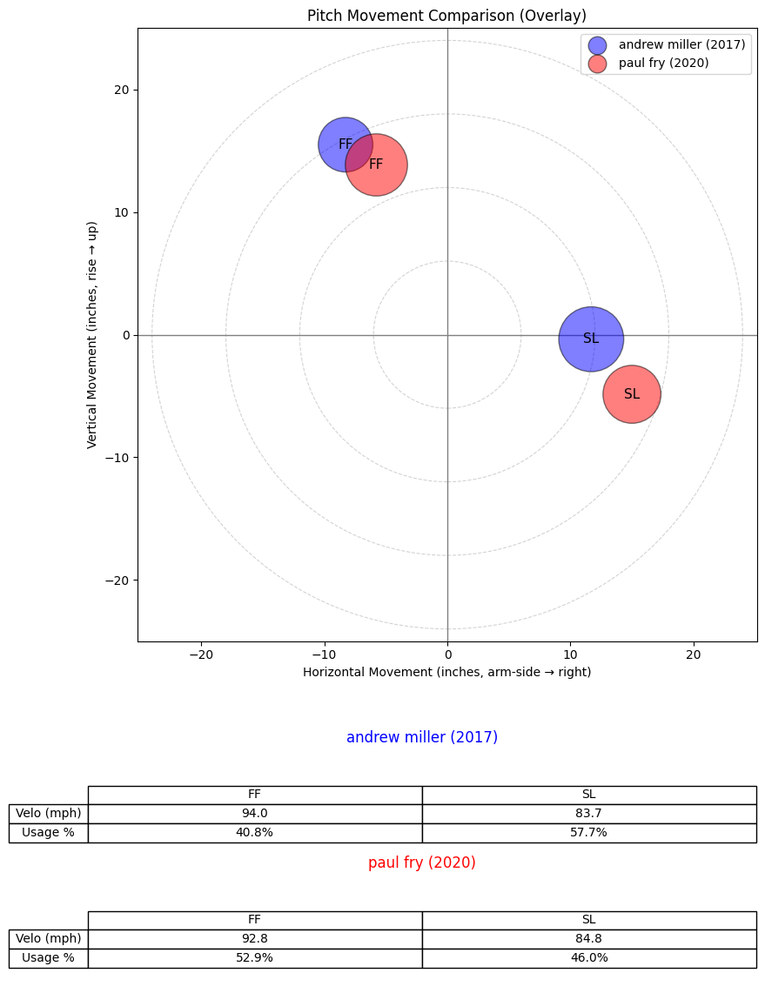

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
122,453192.0,2019,andrew miller,andrew,miller,L,reliever,0.968892
2053,677053.0,2023,andrew nardi,andrew,nardi,L,reliever,0.938146
974,595345.0,2023,steven okert,steven,okert,L,reliever,0.923928
1546,642130.0,2020,blake taylor,blake,taylor,L,reliever,0.916178
1597,643316.0,2020,paul fry,paul,fry,L,reliever,0.905790


In [266]:
neighbors_same_ae = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="andrew miller",
    year=2017,
    X_df=X_ae_df,               # <- autoencoder space
    meta_df=pitcher_season_df,
    n_neighbors=5,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same_ae)

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


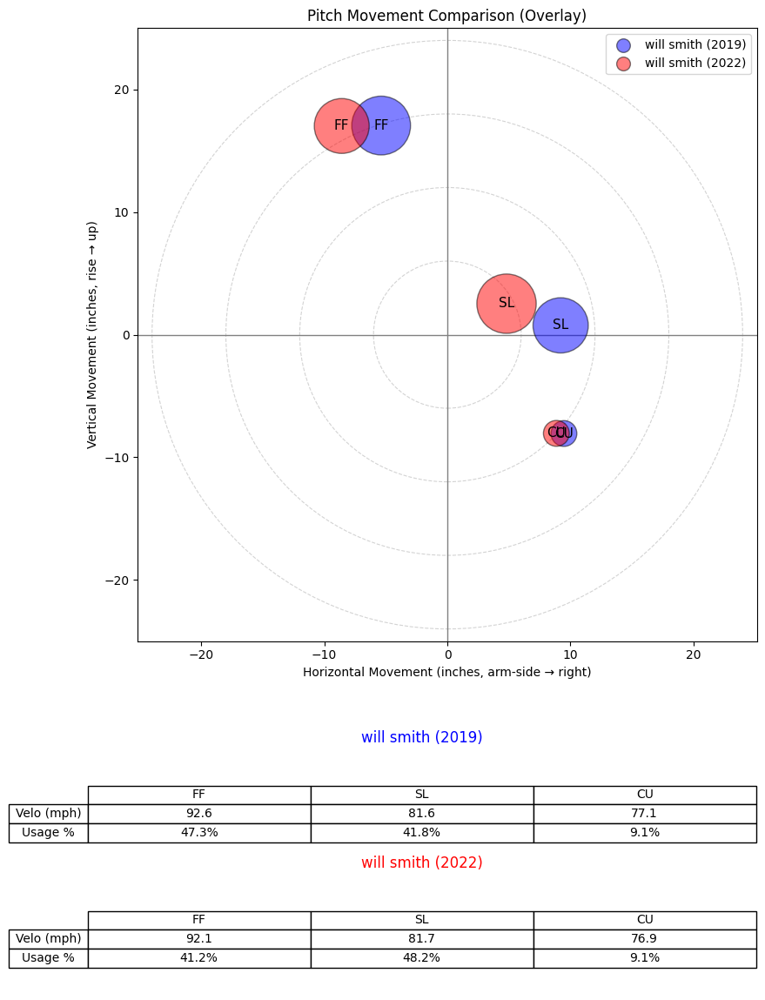

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


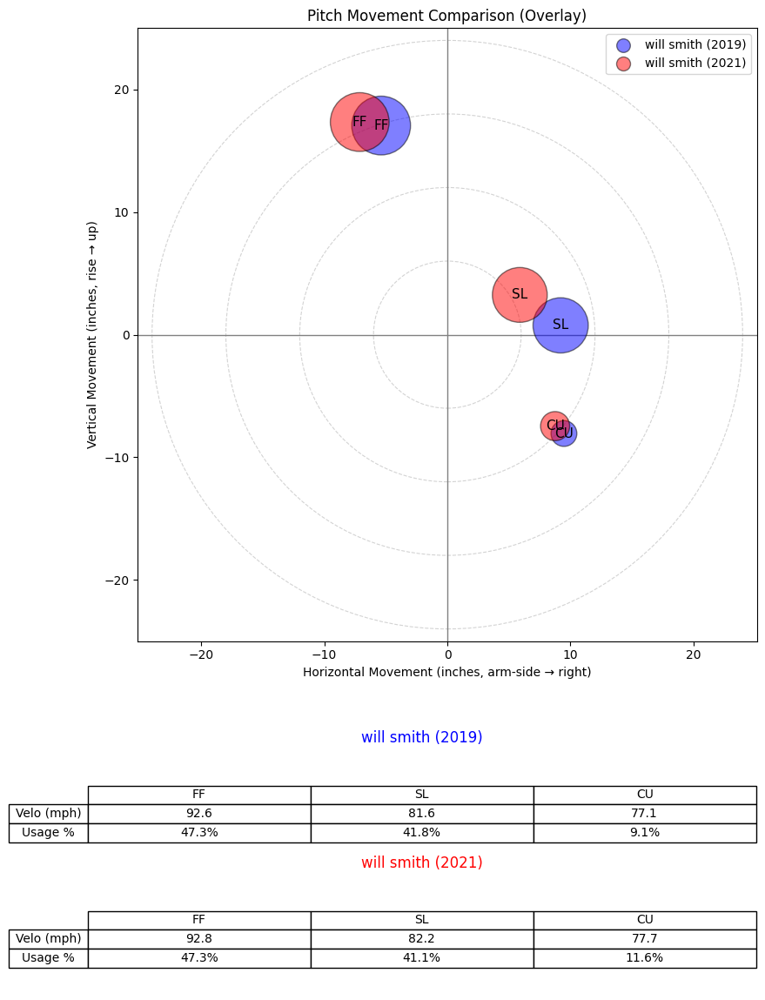

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


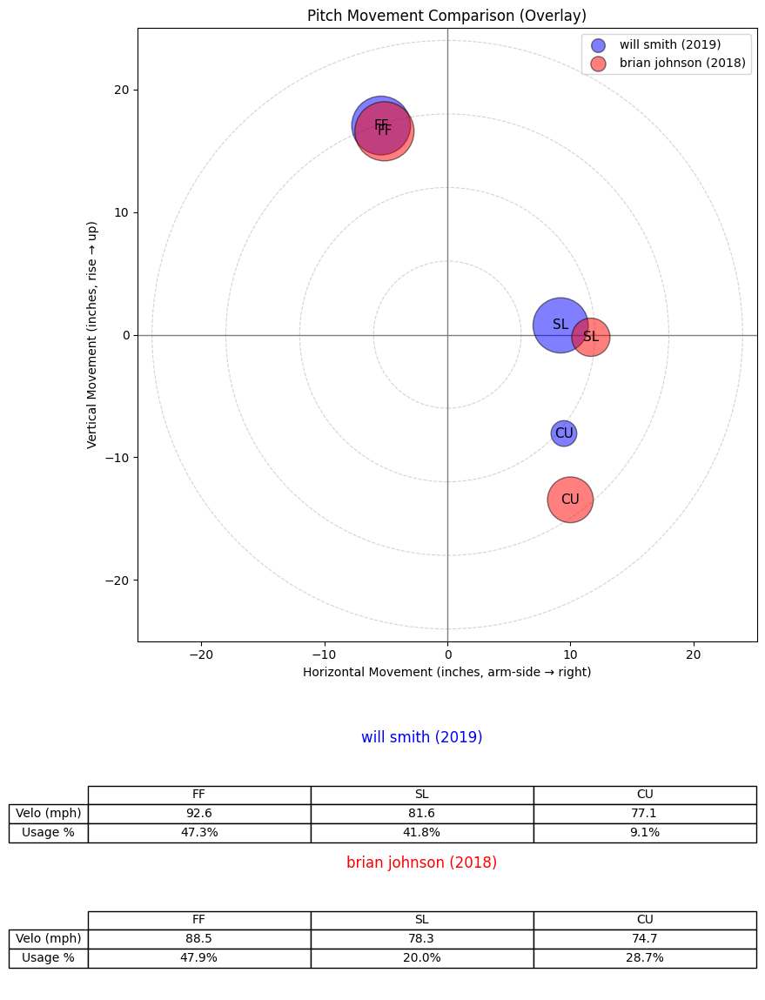

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


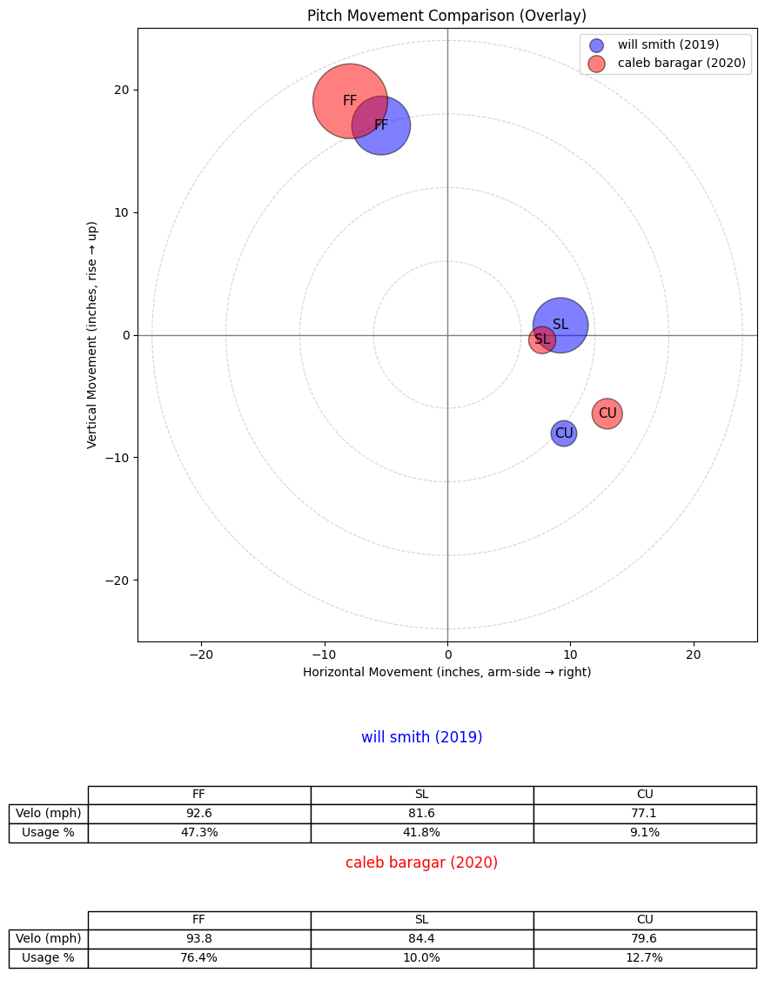

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


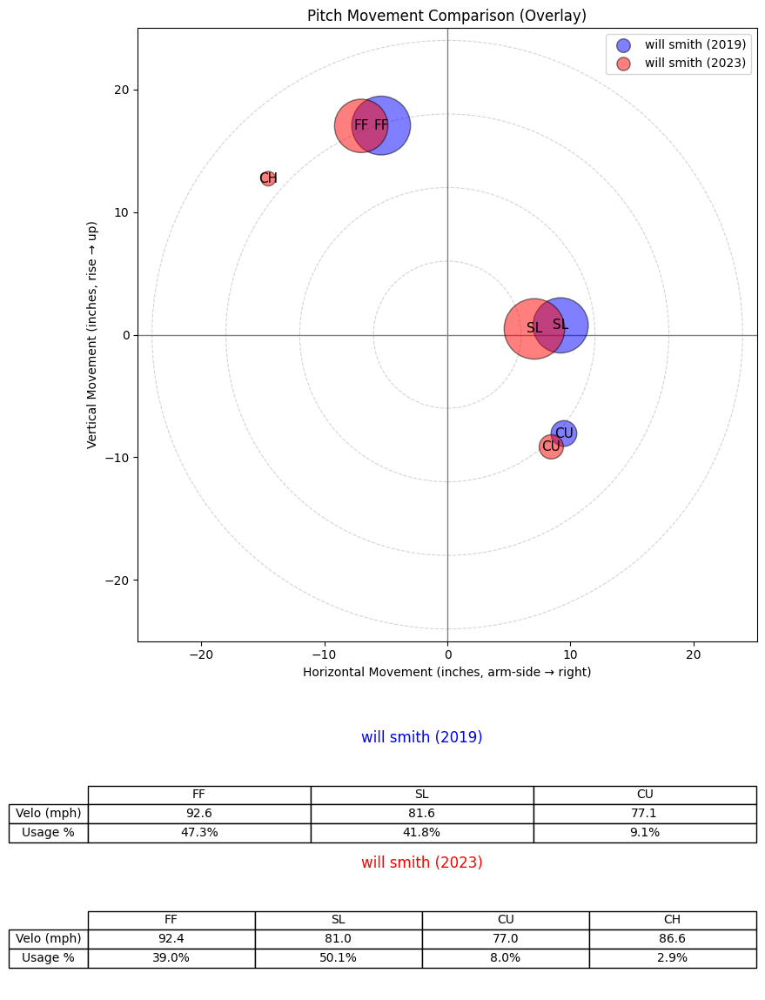

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
464,519293.0,2022,will smith,will,smith,L,reliever,0.972592
463,519293.0,2021,will smith,will,smith,L,reliever,0.970002
1009,598271.0,2018,brian johnson,brian,johnson,L,reliever,0.940489
1984,670056.0,2020,caleb baragar,caleb,baragar,L,reliever,0.897132
465,519293.0,2023,will smith,will,smith,L,reliever,0.870978


In [267]:
neighbors_same_ae = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="will smith",
    year=2019,
    X_df=X_ae_df,               # <- autoencoder space
    meta_df=pitcher_season_df,
    n_neighbors=5,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same_ae)

In [268]:
# save model if want to use again
torch.save(model.state_dict(), "autoencoder_pitchers_2017-14.pt")

Will start evaluating with 2025 data and creating supervised models. First must download and clean/process 2025 data. ChatGPT helped change code to make it suitable for 2025

In [190]:
# Download 2025 data
# Silence FutureWarning spam from pybaseball postprocessing
warnings.filterwarnings(
    "ignore",
    category=FutureWarning,
    module="pybaseball.datahelpers.postprocessing",
)

cache.enable()

year = 2025
start_date = "2025-03-18"
end_date   = "2025-09-28"

dates = pd.date_range(start_date, end_date, freq="D")

all_frames = []
bad_days = []

for d in dates:
    ds = d.strftime("%Y-%m-%d")
    try:
        print(f"Fetching {ds}...")
        df = statcast(start_dt=ds, end_dt=ds)

        # pybaseball usually returns an empty DataFrame when no games are played
        if df is not None and len(df) > 0:
            all_frames.append(df)
            print(f"  -> {len(df)} rows")
        else:
            print("  -> no rows (no games / no data)")

    except ParserError as e:
        print(f"  !! ParserError on {ds}: {e}")
        bad_days.append((ds, str(e)))
    except Exception as e:
        print(f"  !! Other error on {ds}: {e}")
        bad_days.append((ds, str(e)))

# Combine all successful days
if all_frames:
    data_2025 = pd.concat(all_frames, ignore_index=True)
else:
    data_2025 = pd.DataFrame()

filename = f"statcast_{year}.pkl"
with open(filename, "wb") as f:
    pickle.dump(data_2025, f)

print(f"\nSaved {year} to {filename} with {len(data_2025)} rows.")
print(f"Number of bad days: {len(bad_days)}")
if bad_days:
    print("Bad days:")
    for ds, msg in bad_days:
        print(f"  {ds}: {msg}")

Fetching 2025-03-18...
This is a large query, it may take a moment to complete


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]

  -> 3496 rows
Fetching 2025-03-19...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.79s/it]

  -> 3738 rows
Fetching 2025-03-20...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.29s/it]

  -> 3336 rows
Fetching 2025-03-21...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:03<00:00,  3.74s/it]

  -> 5289 rows
Fetching 2025-03-22...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.42s/it]

  -> 4722 rows
Fetching 2025-03-23...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.39s/it]

  -> 4535 rows
Fetching 2025-03-24...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.29s/it]

  -> 3245 rows
Fetching 2025-03-25...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.19it/s]

  -> 1822 rows
Fetching 2025-03-26...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  4.34it/s]

  -> no rows (no games / no data)
Fetching 2025-03-27...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.78s/it]

  -> 4343 rows
Fetching 2025-03-28...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.02it/s]

  -> 2514 rows
Fetching 2025-03-29...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.09s/it]

  -> 4402 rows
Fetching 2025-03-30...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.49s/it]

  -> 3597 rows
Fetching 2025-03-31...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.78s/it]

  -> 4299 rows
Fetching 2025-04-01...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.57s/it]

  -> 3704 rows
Fetching 2025-04-02...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.98s/it]

  -> 4295 rows
Fetching 2025-04-03...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.55it/s]

  -> 1451 rows
Fetching 2025-04-04...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.87s/it]

  -> 4385 rows
Fetching 2025-04-05...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.73s/it]

  -> 4012 rows
Fetching 2025-04-06...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.02s/it]

  -> 4667 rows
Fetching 2025-04-07...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.37s/it]

  -> 2963 rows
Fetching 2025-04-08...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.96s/it]

  -> 4354 rows
Fetching 2025-04-09...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.48s/it]

  -> 4553 rows
Fetching 2025-04-10...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.03s/it]

  -> 1759 rows
Fetching 2025-04-11...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.91s/it]

  -> 4059 rows
Fetching 2025-04-12...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.75s/it]

  -> 4317 rows
Fetching 2025-04-13...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.96s/it]

  -> 4208 rows
Fetching 2025-04-14...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.50s/it]

  -> 2994 rows
Fetching 2025-04-15...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.89s/it]

  -> 4440 rows
Fetching 2025-04-16...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.37s/it]

  -> 4284 rows
Fetching 2025-04-17...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.11it/s]

  -> 2922 rows
Fetching 2025-04-18...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.45s/it]

  -> 4090 rows
Fetching 2025-04-19...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.21s/it]

  -> 4544 rows
Fetching 2025-04-20...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.55s/it]

  -> 4857 rows
Fetching 2025-04-21...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.08s/it]

  -> 2211 rows
Fetching 2025-04-22...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:03<00:00,  3.79s/it]

  -> 4464 rows
Fetching 2025-04-23...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.83s/it]

  -> 4196 rows
Fetching 2025-04-24...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.18s/it]

  -> 2620 rows
Fetching 2025-04-25...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.13s/it]

  -> 3787 rows
Fetching 2025-04-26...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.30s/it]

  -> 4822 rows
Fetching 2025-04-27...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.83s/it]

  -> 4690 rows
Fetching 2025-04-28...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.15it/s]

  -> 2411 rows
Fetching 2025-04-29...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.76s/it]

  -> 4127 rows
Fetching 2025-04-30...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.49s/it]

  -> 4581 rows
Fetching 2025-05-01...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.12s/it]

  -> 3094 rows
Fetching 2025-05-02...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.31s/it]

  -> 4182 rows
Fetching 2025-05-03...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.45s/it]

  -> 4055 rows
Fetching 2025-05-04...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.40s/it]

  -> 4796 rows
Fetching 2025-05-05...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.12s/it]

  -> 2703 rows
Fetching 2025-05-06...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.43s/it]

  -> 4528 rows
Fetching 2025-05-07...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.63s/it]

  -> 4348 rows
Fetching 2025-05-08...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.48s/it]

  -> 2669 rows
Fetching 2025-05-09...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.49s/it]

  -> 4415 rows
Fetching 2025-05-10...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.90s/it]

  -> 4443 rows
Fetching 2025-05-11...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.39s/it]

  -> 4231 rows
Fetching 2025-05-12...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.38s/it]

  -> 3116 rows
Fetching 2025-05-13...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.33s/it]

  -> 3864 rows
Fetching 2025-05-14...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.74s/it]

  -> 5066 rows
Fetching 2025-05-15...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.81it/s]

  -> 1590 rows
Fetching 2025-05-16...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.61s/it]

  -> 4522 rows
Fetching 2025-05-17...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.94s/it]

  -> 4476 rows
Fetching 2025-05-18...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.81s/it]

  -> 4229 rows
Fetching 2025-05-19...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.30s/it]

  -> 3469 rows
Fetching 2025-05-20...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.16s/it]

  -> 3947 rows
Fetching 2025-05-21...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.37s/it]

  -> 4181 rows
Fetching 2025-05-22...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.16it/s]

  -> 2507 rows
Fetching 2025-05-23...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.06s/it]

  -> 4599 rows
Fetching 2025-05-24...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.58s/it]

  -> 4671 rows
Fetching 2025-05-25...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.17it/s]

  -> 4277 rows
Fetching 2025-05-26...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.61it/s]

  -> 3335 rows
Fetching 2025-05-27...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.27it/s]

  -> 4400 rows
Fetching 2025-05-28...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.38it/s]

  -> 4117 rows
Fetching 2025-05-29...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.57it/s]

  -> 1601 rows
Fetching 2025-05-30...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.15s/it]

  -> 4376 rows
Fetching 2025-05-31...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.16it/s]

  -> 4411 rows
Fetching 2025-06-01...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.18it/s]

  -> 4215 rows
Fetching 2025-06-02...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.98it/s]

  -> 2158 rows
Fetching 2025-06-03...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.27it/s]

  -> 4358 rows
Fetching 2025-06-04...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.28it/s]

  -> 3986 rows
Fetching 2025-06-05...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.34it/s]

  -> 3825 rows
Fetching 2025-06-06...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.29it/s]

  -> 4225 rows
Fetching 2025-06-07...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.28it/s]

  -> 4354 rows
Fetching 2025-06-08...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.12it/s]

  -> 4322 rows
Fetching 2025-06-09...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.65it/s]

  -> 2847 rows
Fetching 2025-06-10...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.34s/it]

  -> 4473 rows
Fetching 2025-06-11...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.18s/it]

  -> 4178 rows
Fetching 2025-06-12...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.97it/s]

  -> 2300 rows
Fetching 2025-06-13...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.16it/s]

  -> 4461 rows
Fetching 2025-06-14...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.10it/s]

  -> 4435 rows
Fetching 2025-06-15...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.29it/s]

  -> 4294 rows
Fetching 2025-06-16...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.93it/s]

  -> 1960 rows
Fetching 2025-06-17...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.26s/it]

  -> 4375 rows
Fetching 2025-06-18...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.10s/it]

  -> 3341 rows
Fetching 2025-06-19...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.74s/it]

  -> 4809 rows
Fetching 2025-06-20...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:03<00:00,  3.34s/it]

  -> 4658 rows
Fetching 2025-06-21...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.07s/it]

  -> 4346 rows
Fetching 2025-06-22...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.04s/it]

  -> 4296 rows
Fetching 2025-06-23...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.85s/it]

  -> 2619 rows
Fetching 2025-06-24...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.06s/it]

  -> 4468 rows
Fetching 2025-06-25...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.86s/it]

  -> 4142 rows
Fetching 2025-06-26...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.05it/s]

  -> 2512 rows
Fetching 2025-06-27...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.67s/it]

  -> 4614 rows
Fetching 2025-06-28...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.61s/it]

  -> 4427 rows
Fetching 2025-06-29...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.14s/it]

  -> 4558 rows
Fetching 2025-06-30...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.10it/s]

  -> 2260 rows
Fetching 2025-07-01...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.38s/it]

  -> 3434 rows
Fetching 2025-07-02...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.13s/it]

  -> 5384 rows
Fetching 2025-07-03...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.31s/it]

  -> 2884 rows
Fetching 2025-07-04...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.81s/it]

  -> 4424 rows
Fetching 2025-07-05...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.71s/it]

  -> 4471 rows
Fetching 2025-07-06...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.64s/it]

  -> 4376 rows
Fetching 2025-07-07...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.24s/it]

  -> 2903 rows
Fetching 2025-07-08...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.03s/it]

  -> 4186 rows
Fetching 2025-07-09...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.54s/it]

  -> 3906 rows
Fetching 2025-07-10...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.14s/it]

  -> 2960 rows
Fetching 2025-07-11...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.65s/it]

  -> 4828 rows
Fetching 2025-07-12...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.52s/it]

  -> 4311 rows
Fetching 2025-07-13...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.41s/it]

  -> 4362 rows
Fetching 2025-07-14...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  3.64it/s]

  -> no rows (no games / no data)
Fetching 2025-07-15...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  3.69it/s]

  -> no rows (no games / no data)
Fetching 2025-07-16...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.91it/s]

  -> no rows (no games / no data)
Fetching 2025-07-17...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  4.06it/s]

  -> no rows (no games / no data)
Fetching 2025-07-18...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.24s/it]

  -> 4287 rows
Fetching 2025-07-19...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.60s/it]

  -> 4316 rows
Fetching 2025-07-20...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.40s/it]

  -> 4356 rows
Fetching 2025-07-21...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.26s/it]

  -> 4336 rows
Fetching 2025-07-22...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.20s/it]

  -> 4212 rows
Fetching 2025-07-23...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.33s/it]

  -> 4276 rows
Fetching 2025-07-24...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.50it/s]

  -> 1433 rows
Fetching 2025-07-25...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.25s/it]

  -> 4154 rows
Fetching 2025-07-26...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.47s/it]

  -> 4757 rows
Fetching 2025-07-27...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.43s/it]

  -> 4322 rows
Fetching 2025-07-28...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.70s/it]

  -> 4448 rows
Fetching 2025-07-29...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.54s/it]

  -> 4783 rows
Fetching 2025-07-30...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.25s/it]

  -> 4294 rows
Fetching 2025-07-31...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  2.15it/s]

  -> 902 rows
Fetching 2025-08-01...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.48s/it]

  -> 4492 rows
Fetching 2025-08-02...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.46s/it]

  -> 4329 rows
Fetching 2025-08-03...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.22s/it]

  -> 4149 rows
Fetching 2025-08-04...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.35s/it]

  -> 3767 rows
Fetching 2025-08-05...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.42s/it]

  -> 4504 rows
Fetching 2025-08-06...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.41s/it]

  -> 4478 rows
Fetching 2025-08-07...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.77it/s]

  -> 1249 rows
Fetching 2025-08-08...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.30s/it]

  -> 4265 rows
Fetching 2025-08-09...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.35s/it]

  -> 4830 rows
Fetching 2025-08-10...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.54s/it]

  -> 4581 rows
Fetching 2025-08-11...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.06it/s]

  -> 3065 rows
Fetching 2025-08-12...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.86s/it]

  -> 4432 rows
Fetching 2025-08-13...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.26s/it]

  -> 4446 rows
Fetching 2025-08-14...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.43it/s]

  -> 1902 rows
Fetching 2025-08-15...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.24s/it]

  -> 4393 rows
Fetching 2025-08-16...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.30s/it]

  -> 4554 rows
Fetching 2025-08-17...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.82s/it]

  -> 4601 rows
Fetching 2025-08-18...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.04s/it]

  -> 3604 rows
Fetching 2025-08-19...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.24s/it]

  -> 4719 rows
Fetching 2025-08-20...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.13s/it]

  -> 3977 rows
Fetching 2025-08-21...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.24s/it]

  -> 2861 rows
Fetching 2025-08-22...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.21s/it]

  -> 4374 rows
Fetching 2025-08-23...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.17s/it]

  -> 4099 rows
Fetching 2025-08-24...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.40s/it]

  -> 4282 rows
Fetching 2025-08-25...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.75s/it]

  -> 3659 rows
Fetching 2025-08-26...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.34s/it]

  -> 4560 rows
Fetching 2025-08-27...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.39s/it]

  -> 4342 rows
Fetching 2025-08-28...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.10s/it]

  -> 2310 rows
Fetching 2025-08-29...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.45s/it]

  -> 4678 rows
Fetching 2025-08-30...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.31s/it]

  -> 4402 rows
Fetching 2025-08-31...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.43s/it]

  -> 4394 rows
Fetching 2025-09-01...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.31s/it]

  -> 3993 rows
Fetching 2025-09-02...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.88s/it]

  -> 4056 rows
Fetching 2025-09-03...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.25s/it]

  -> 4489 rows
Fetching 2025-09-04...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.40it/s]

  -> 1843 rows
Fetching 2025-09-05...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.83s/it]

  -> 4500 rows
Fetching 2025-09-06...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.48s/it]

  -> 4396 rows
Fetching 2025-09-07...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.66s/it]

  -> 4510 rows
Fetching 2025-09-08...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.83s/it]

  -> 3087 rows
Fetching 2025-09-09...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.76s/it]

  -> 4375 rows
Fetching 2025-09-10...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.32s/it]

  -> 4561 rows
Fetching 2025-09-11...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.13it/s]

  -> 2593 rows
Fetching 2025-09-12...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.24s/it]

  -> 4202 rows
Fetching 2025-09-13...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.52s/it]

  -> 4647 rows
Fetching 2025-09-14...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.20s/it]

  -> 4481 rows
Fetching 2025-09-15...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.06it/s]

  -> 2739 rows
Fetching 2025-09-16...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.54s/it]

  -> 4772 rows
Fetching 2025-09-17...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.51s/it]

  -> 4628 rows
Fetching 2025-09-18...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.14it/s]

  -> 2760 rows
Fetching 2025-09-19...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.52s/it]

  -> 4508 rows
Fetching 2025-09-20...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.62s/it]

  -> 4578 rows
Fetching 2025-09-21...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:03<00:00,  3.04s/it]

  -> 4346 rows
Fetching 2025-09-22...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:00<00:00,  1.77it/s]

  -> 1003 rows
Fetching 2025-09-23...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.53s/it]

  -> 4374 rows
Fetching 2025-09-24...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.42s/it]

  -> 4316 rows
Fetching 2025-09-25...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.02s/it]

  -> 3413 rows
Fetching 2025-09-26...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:01<00:00,  1.35s/it]

  -> 4408 rows
Fetching 2025-09-27...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.15s/it]

  -> 4300 rows
Fetching 2025-09-28...
This is a large query, it may take a moment to complete



100%|██████████| 1/1 [00:02<00:00,  2.83s/it]


  -> 4460 rows

Saved 2025 to statcast_2025.pkl with 742080 rows.
Number of bad days: 0


In [269]:
# open data and put in df
with open(f"datasets/statcast_2025.pkl", "rb") as f:
        data_2025 = pickle.load(f)
print(data_2025.columns)

Index(['pitch_type', 'game_date', 'release_speed', 'release_pos_x',
       'release_pos_z', 'player_name', 'batter', 'pitcher', 'events',
       'description',
       ...
       'batter_days_until_next_game', 'api_break_z_with_gravity',
       'api_break_x_arm', 'api_break_x_batter_in', 'arm_angle', 'attack_angle',
       'attack_direction', 'swing_path_tilt',
       'intercept_ball_minus_batter_pos_x_inches',
       'intercept_ball_minus_batter_pos_y_inches'],
      dtype='object', length=118)


In [192]:
print(list(data_2025.columns))
df_2025 = data_2025[['pitch_type', 'release_speed', 'release_pos_x', 'release_pos_z', 'pitcher', 'p_throws', 'game_year', 'game_type', 'pfx_x', 'pfx_z', 'vx0', 'vy0', 'vz0', 'ax', 'ay', 'az', 'effective_speed', 'release_spin_rate', 'release_extension', 'release_pos_y', 'game_pk', 'spin_axis', 'pitcher_days_since_prev_game', 'arm_angle']]

# only regular season
df_2025 = df_2025[df_2025['game_type']=='R']

def fetch_position(id):
    """Fetch primary positions for a list of MLBAM IDs in batches."""
    player_data = statsapi.get("person", {"personId": id})
    player_info = player_data["people"][0]
    pos = player_info["primaryPosition"]["abbreviation"]
    return pos

# Example: get all unique pitcher IDs from dataset
unique_pitchers = df_2025["pitcher"].unique().tolist()

# Fetch positions in bulk
positions = {}
for id in unique_pitchers:
    pos = fetch_position(int(id))
    positions[id] = pos
# Filter only pitchers
pitcher_ids = [pid for pid, pos in positions.items() if pos == "P" or pos == "TWP"]

df_2025 = df_2025[df_2025["pitcher"].isin(pitcher_ids)]


num_pitcher_seasons = df_2025.groupby(["pitcher", "game_year"]).ngroups
print("Number of pitcher-seasons:", num_pitcher_seasons)
print(list(df_2025.columns))
pitcher_seasons_2025 = df_2025.groupby(["pitcher", "game_year"])
pitcher_seasons_pitches_2025 = df_2025.groupby(["pitcher", "game_year", "pitch_type"])
print(pitcher_seasons_pitches_2025.head())

['pitch_type', 'game_date', 'release_speed', 'release_pos_x', 'release_pos_z', 'player_name', 'batter', 'pitcher', 'events', 'description', 'spin_dir', 'spin_rate_deprecated', 'break_angle_deprecated', 'break_length_deprecated', 'zone', 'des', 'game_type', 'stand', 'p_throws', 'home_team', 'away_team', 'type', 'hit_location', 'bb_type', 'balls', 'strikes', 'game_year', 'pfx_x', 'pfx_z', 'plate_x', 'plate_z', 'on_3b', 'on_2b', 'on_1b', 'outs_when_up', 'inning', 'inning_topbot', 'hc_x', 'hc_y', 'tfs_deprecated', 'tfs_zulu_deprecated', 'umpire', 'sv_id', 'vx0', 'vy0', 'vz0', 'ax', 'ay', 'az', 'sz_top', 'sz_bot', 'hit_distance_sc', 'launch_speed', 'launch_angle', 'effective_speed', 'release_spin_rate', 'release_extension', 'game_pk', 'fielder_2', 'fielder_3', 'fielder_4', 'fielder_5', 'fielder_6', 'fielder_7', 'fielder_8', 'fielder_9', 'release_pos_y', 'estimated_ba_using_speedangle', 'estimated_woba_using_speedangle', 'woba_value', 'woba_denom', 'babip_value', 'iso_value', 'launch_speed_a

In [193]:
# drop features not using
df_2025 = df_2025.drop(['release_spin_rate', 'spin_axis', 'vx0', 'vy0', 'vz0', 'ax', 'ay', 'az', 'pitcher_days_since_prev_game', 'arm_angle', 'game_pk', 'game_type', 'effective_speed'], axis=1)
print(df_2025.columns)

Index(['pitch_type', 'release_speed', 'release_pos_x', 'release_pos_z',
       'pitcher', 'p_throws', 'game_year', 'pfx_x', 'pfx_z',
       'release_extension', 'release_pos_y'],
      dtype='object')


In [ ]:
# Loop over seasons
qualified_all = get_qualified_pitchers(2025)

# Get unique FanGraphs IDs
fg_ids = qualified_all['IDfg'].unique().tolist()

# Map to MLBAM IDs
id_map = playerid_reverse_lookup(fg_ids, key_type='fangraphs')

# Merge the IDs onto your qualified pitcher list
qualified_all = qualified_all.merge(id_map[['key_fangraphs', 'key_mlbam']], 
                                    left_on='IDfg', right_on='key_fangraphs', 
                                    how='left')

# Clean up
qualified_all.rename(columns={'key_mlbam': 'mlbam_id'}, inplace=True)
qualified_all.drop(columns=['key_fangraphs'], inplace=True)

# Merge season by season
statcast_qualified_2025 = df_2025.merge(
    qualified_all[['mlbam_id', 'year', 'role']],
    left_on=['pitcher', 'game_year'], 
    right_on=['mlbam_id', 'year'], 
    how='inner'
)

In [195]:
num_pitcher_seasons = statcast_qualified_2025.groupby(["pitcher", "game_year"]).ngroups
print("Number of pitcher-seasons:", num_pitcher_seasons)
# Total number of rows with at least one NaN in any column
num_rows_with_nans = statcast_qualified_2025.isna().any(axis=1).sum()
print(f"Number of pitch rows with at least one NaN: {num_rows_with_nans}")

# Percentage of rows
total_rows = len(statcast_qualified_2025)
print(f"Percentage: {num_rows_with_nans / total_rows * 100:.2f}%")

# Optional: see how many NaNs per column
print(statcast_qualified_2025.isna().sum())

# Drop all pitch rows with any NaN
statcast_clean_2025 = statcast_qualified_2025.dropna(axis=0, how='any').copy()

print(f"Rows after dropping NaNs: {len(statcast_clean_2025)}")


Number of pitcher-seasons: 227
Number of pitch rows with at least one NaN: 1558
Percentage: 0.39%
pitch_type           1391
release_speed        1359
release_pos_x        1360
release_pos_z        1360
pitcher                 0
p_throws                0
game_year               0
pfx_x                1493
pfx_z                1360
release_extension    1396
release_pos_y        1360
mlbam_id                0
year                    0
role                    0
dtype: int64
Rows after dropping NaNs: 396136


In [197]:
statcast_clean_norm = add_normalized_features(statcast_clean_2025)

# Build list of numerical columns for outlier detection
numerical_cols = statcast_clean_norm.select_dtypes(include='number').columns.tolist()

# Replace raw x-direction features with normalized versions
cols_for_outlier_check = [
    c if c not in ['release_pos_x', 'pfx_x']
    else c + '_norm'
    for c in numerical_cols
]

# Compute z-scores per pitch type
def zscore_per_group(group):
    return group[cols_for_outlier_check].apply(zscore)

z_scores_by_pitch = statcast_clean_norm.groupby('pitch_type', group_keys=False).apply(zscore_per_group)

# Identify outliers (abs z-score > 4)
outliers_bool = z_scores_by_pitch.abs() > 4

# Create long-form table of outliers
outlier_long = outliers_bool.stack()
outlier_long = outlier_long[outlier_long]  # keep only True
outlier_long = outlier_long.reset_index()
outlier_long.columns = ['row_index', 'feature', 'is_outlier']

# Merge with pitcher info and get actual values
cols_to_use = ['pitcher', 'pitch_type'] + cols_for_outlier_check
statcast_subset = statcast_clean_norm[cols_to_use].reset_index()

outlier_details = outlier_long.merge(
    statcast_subset,
    left_on='row_index',
    right_on='index'
)

outlier_details['value'] = outlier_details.apply(
    lambda x: statcast_clean_norm.loc[x['row_index'], x['feature']],
    axis=1
)

print(outlier_details.head(20))

/opt/miniconda3/envs/iw/lib/python3.13/site-packages/pandas/core/apply.py:1081: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  results[i] = self.func(v, *self.args, **self.kwargs)
/opt/miniconda3/envs/iw/lib/python3.13/site-packages/pandas/core/apply.py:1081: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  results[i] = self.func(v, *self.args, **self.kwargs)
/opt/miniconda3/envs/iw/lib/python3.13/site-packages/pandas/core/apply.py:1081: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  results[i] = self.func(v, *self.args, **self.kwargs)
/opt/miniconda3/envs/iw/lib/python3.13/site-packages/pandas/core/apply.py:1081: Ru

    row_index        feature  is_outlier  index  pitcher pitch_type  \
0         376  release_speed        True    376   643511         SL   
1         376  release_pos_z        True    376   643511         SL   
2         377  release_speed        True    377   643511         SI   
3         377  release_pos_z        True    377   643511         SI   
4         378  release_speed        True    378   643511         SI   
5         378  release_pos_z        True    378   643511         SI   
6         379  release_pos_z        True    379   643511         SI   
7         380  release_speed        True    380   643511         SI   
8         380  release_pos_z        True    380   643511         SI   
9         381  release_pos_z        True    381   643511         SI   
10        382  release_speed        True    382   643511         SI   
11        382  release_pos_z        True    382   643511         SI   
12        383  release_speed        True    383   643511         SL   
13    

In [198]:
# Count original pitch types
pitch_counts = statcast_clean_2025['pitch_type'].value_counts()
print(pitch_counts)

# Define mapping
pitch_map = {
    # Fastballs
    'FF': 'FF',   # Four-seam
    'FA': 'FF',   # Map FA to FF
    'FC': 'FC',   # Cutter
    'SI': 'SI',   # Sinker
    'FS': 'FS',   # Splitter
    'FO': 'FS',   # Occasionally FO is logged, treat as Splitter
    'SV': 'SL',   # Slurve -> Sliders
    'ST': 'SL',   # Sweeper -> Sliders

    # Offspeed / Breaking
    'SL': 'SL',   # Slider
    'CU': 'CU',   # Curveball
    'KC': 'CU',   # Knuckle curve -> Curveball
    'CS': 'CU',   # Slow curve
    'CH': 'CH',   # Changeup
    'SC': 'CH',   # Screwball -> Changeup
    'KN': 'KN',   # Knuckleball
    'EP': 'DROP',   # Eephus, dropping

    # Rare / to drop
    'PO': 'DROP',   # Pitch out, dropping
    'UN': 'DROP', # unknown, dropping
}

# Apply mapping
statcast_clean_2025['pitch_grouped'] = statcast_clean_2025['pitch_type'].map(pitch_map)

# Drop unwanted pitches
statcast_clean_2025 = statcast_clean_2025[statcast_clean_2025['pitch_grouped'] != 'DROP']

# See new grouped counts
grouped_counts_2025 = statcast_clean_2025['pitch_grouped'].value_counts()
print(grouped_counts_2025)

pitch_type
FF    122887
SI     65270
SL     58227
CH     43550
FC     28982
CU     28264
ST     25329
FS     12923
KC      7579
SV      2273
FO       542
CS       268
PO        30
KN         5
FA         3
UN         2
EP         2
Name: count, dtype: int64
pitch_grouped
FF    122890
SL     85829
SI     65270
CH     43550
CU     36111
FC     28982
FS     13465
KN         5
Name: count, dtype: int64


In [199]:
statcast_clean_2025 = flag_release_outliers(statcast_clean_2025)

# Filter out extreme outliers (e.g. |z| > 4)
statcast_clean_2025 = statcast_clean_2025[statcast_clean_2025['release_pos_x_z'].abs() <= 4]

In [200]:
fastball_types = ['FF', 'SI', 'FC']

# Filter out any fastball slower than 70 mph
statcast_clean_2025 = statcast_clean_2025[~((statcast_clean_2025['pitch_type'].isin(fastball_types)) &
                                  (statcast_clean_2025['release_speed'] < 70))]
print(list(statcast_clean_2025.columns))
print(statcast_clean_2025['pitch_type'].unique())
print(statcast_clean_2025['pitch_grouped'].unique())

['pitch_type', 'release_speed', 'release_pos_x', 'release_pos_z', 'pitcher', 'p_throws', 'game_year', 'pfx_x', 'pfx_z', 'release_extension', 'release_pos_y', 'mlbam_id', 'year', 'role', 'pitch_grouped', 'release_pos_x_z']
['FF' 'SL' 'CU' 'FS' 'FC' 'SI' 'ST' 'SV' 'CH' 'KC' 'CS' 'KN' 'FO' 'FA']
['FF' 'SL' 'CU' 'FS' 'FC' 'SI' 'CH' 'KN']


In [ ]:
# create pitcher-season df and cut pitches thrown <2% by a pitcher
pitcher_season_df_2025 = create_pitcher_season_df(statcast_clean_2025)

# Define cutoff (<2%)
cutoff = 0.02

# Find all pitch fraction columns
frac_cols = [col for col in pitcher_season_df_2025.columns if col.endswith('_frac')]

# Apply threshold: set any pitch fraction < 2% to 0
for col in frac_cols:
    pitcher_season_df_2025.loc[pitcher_season_df_2025[col] < cutoff, col] = 0

for pitch in ['FF', 'SL', 'CH', 'CU', 'SI', 'FC', 'FS', 'KN']:
    frac_col = f'{pitch}_frac'
    bin_col = f'throws_{pitch}'
    pitcher_season_df_2025[bin_col] = (pitcher_season_df_2025[frac_col] > 0).astype(int)

In [202]:
# Get unique MLBAM IDs
mlbam_ids = pitcher_season_df_2025["pitcher"].unique()

# Look up player info
id_lookup = playerid_reverse_lookup(mlbam_ids)

# Merge with your pitcher-season DataFrame
pitcher_season_df_2025 = pitcher_season_df_2025.merge(
    id_lookup[['key_mlbam', 'name_first', 'name_last']],
    how='left',
    left_on='pitcher',
    right_on='key_mlbam'
)

# Create a full name column
pitcher_season_df_2025['name'] = pitcher_season_df_2025['name_first'] + ' ' + pitcher_season_df_2025['name_last']
pitcher_season_df_2025 = pitcher_season_df_2025.drop('key_mlbam', axis=1)

In [270]:
league_avg = {}

for pitch in pitch_types:
    # columns for this pitch's metrics
    metric_cols = [
        col for col in pitcher_season_df.columns
        if col.endswith(f'_{pitch}')
        and not col.endswith('_frac')
        and not col.startswith('throws_')
    ]
    throws_col = f'throws_{pitch}'

    if not metric_cols or throws_col not in pitcher_season_df.columns:
        continue

    mask_has_pitch = pitcher_season_df[throws_col] == 1

    # League avg only among pitchers who actually throw this pitch (after your 2% cutoff)
    league_avg[pitch] = pitcher_season_df.loc[mask_has_pitch, metric_cols].mean()


In [271]:
for pitch in pitch_types:
    metric_cols = [
        col for col in pitcher_season_df_2025.columns
        if col.endswith(f'_{pitch}')
        and not col.endswith('_frac')
        and not col.startswith('throws_')
    ]
    throws_col = f'throws_{pitch}'

    # Skip if we don't have this pitch, or no league average
    if pitch not in league_avg or not metric_cols or throws_col not in pitcher_season_df_2025.columns:
        continue

    mask_no_pitch = pitcher_season_df_2025[throws_col] == 0

    # For each metric column, fill non-throwers with the league-average value
    for col in metric_cols:
        fill_value = league_avg[pitch][col]  # scalar
        pitcher_season_df_2025.loc[mask_no_pitch, col] = fill_value


Code to evaluate with 2025 data

In [272]:
# This was created with help of ChatGPT
def cross_year_self_season_score(
    Z_query_df,        # e.g. 2025 embeddings
    Z_gallery_df,      # e.g. 2017-2024 embeddings
    meta_query_df,
    meta_gallery_df,
    k=5,
    max_year_diff=3,
    name_col="name",
    year_col="game_year",
    hand_col="p_throws",   # adjust if your col name is different
    role_col="role",       # adjust if needed
):
    """
    Evaluate how often a 2025 pitcher-season retrieves one of its own
    past seasons (2017-24) among its neighbors, *restricted* to
    same-handedness + same-role neighbors.

    - hit@k: fraction of eligible queries where the first matching past season
             is within the top-k allowed neighbors.
    - mrr_full: mean reciprocal rank of the first matching past season over
                ALL allowed neighbors (not truncated by k).

    Eligibility: a 2025 row is eligible if it has at least one matching
    past season (same name, same hand, same role, year <= query_year, and
    within max_year_diff if provided).

    Returns:
        hit_rate (float): hit@k over eligible queries
        mrr_full (float): full MRR over eligible queries
        num_eligible (int): number of 2025 pitcher-seasons that could possibly have a hit
    """
    Zq = Z_query_df.values
    Zg = Z_gallery_df.values

    # Cosine similarity between queries (2025) and gallery (2017-24)
    sims = cosine_similarity(Zq, Zg)  # shape: (n_query, n_gallery)

    q_names = meta_query_df[name_col].values
    q_years = meta_query_df[year_col].values
    g_names = meta_gallery_df[name_col].values
    g_years = meta_gallery_df[year_col].values

    q_hand = meta_query_df[hand_col].values if hand_col is not None else None
    g_hand = meta_gallery_df[hand_col].values if hand_col is not None else None

    q_role = meta_query_df[role_col].values if role_col is not None else None
    g_role = meta_gallery_df[role_col].values if role_col is not None else None

    n_q = Zq.shape[0]

    # ---- 1. Decide which 2025 rows are *eligible* ----
    eligible = []
    for i in range(n_q):
        # candidate past seasons for same pitcher
        mask = (g_names == q_names[i]) & (g_years <= q_years[i])

        # year window
        if max_year_diff is not None:
            mask &= (np.abs(g_years - q_years[i]) <= max_year_diff)

        # same hand + same role
        if hand_col is not None:
            mask &= (g_hand == q_hand[i])
        if role_col is not None:
            mask &= (g_role == q_role[i])

        if mask.any():
            eligible.append(i)

    if not eligible:
        return float("nan"), float("nan"), 0

    # ---- 2. Compute hit@k and full MRR over eligible queries ----
    hits = 0
    rr_sum_full = 0.0

    for i in eligible:
        sim_row = sims[i].copy()

        # Allowed neighbors: same hand + same role as query
        allowed_mask = np.ones_like(g_names, dtype=bool)
        if hand_col is not None:
            allowed_mask &= (g_hand == q_hand[i])
        if role_col is not None:
            allowed_mask &= (g_role == q_role[i])

        allowed_idx = np.where(allowed_mask)[0]
        sims_allowed = sim_row[allowed_idx]

        # Sort *all* allowed neighbors (full ranking, not truncated)
        order = np.argsort(-sims_allowed)  # indices into allowed_idx

        full_rank = None
        for pos, idx_pos in enumerate(order, start=1):
            j = allowed_idx[idx_pos]

            # must be same pitcher
            if g_names[j] != q_names[i]:
                continue
            # must be past (or same) year
            if g_years[j] > q_years[i]:
                continue
            # must satisfy year window if given
            if max_year_diff is not None:
                if abs(g_years[j] - q_years[i]) > max_year_diff:
                    continue

            full_rank = pos
            break

        # By construction (eligibility), we expect to find at least one
        if full_rank is None:
            # safety fallback: treat as no hit
            continue

        # full MRR: use full rank, even if > k
        rr_sum_full += 1.0 / full_rank

        # hit@k: only count as hit if within top-k
        if full_rank <= k:
            hits += 1

    num_elig = len(eligible)
    hit_rate = hits / num_elig
    mrr_full = rr_sum_full / num_elig

    return hit_rate, mrr_full, num_elig


In [282]:
# Created with help from ChatGPT
def show_2025_neighbors_in_gallery_ae(
    name,
    year,
    Z_query_df,
    Z_gallery_df,
    meta_query_df,
    meta_gallery_df,
    k=10,
    name_col="name",
    year_col="game_year",
    hand_col="p_throws",
    role_col="role",
):
    # 1) locate the query row (2025 pitcher-season)
    q_mask = (meta_query_df[name_col] == name) & (meta_query_df[year_col] == year)
    if q_mask.sum() == 0:
        raise ValueError(f"No 2025 row found for {name=} and {year=}")
    if q_mask.sum() > 1:
        # If this happens, you can refine by team, etc.
        print(f"Warning: multiple rows found for {name=} {year=}, using first.")
    q_idx = meta_query_df.index[q_mask][0]

    # query embedding and metadata
    z_q = Z_query_df.loc[q_idx].values.reshape(1, -1)
    q_hand = meta_query_df.loc[q_idx, hand_col]
    q_role = meta_query_df.loc[q_idx, role_col]
    q_year = meta_query_df.loc[q_idx, year_col]

    # 2) filter gallery to same hand + same role
    g_mask = np.ones(len(meta_gallery_df), dtype=bool)
    g_mask &= (meta_gallery_df[hand_col].values == q_hand)
    g_mask &= (meta_gallery_df[role_col].values == q_role)

    meta_allowed = meta_gallery_df[g_mask]
    Z_allowed    = Z_gallery_df.loc[meta_allowed.index]

    if len(meta_allowed) == 0:
        raise ValueError(f"No gallery rows with same hand/role as {name=} {year=}")

    # 3) compute cosine similarity to all allowed gallery rows
    sims = cosine_similarity(z_q, Z_allowed.values).ravel()
    order = np.argsort(-sims)[:k]

    neighbors = meta_allowed.iloc[order].copy()
    neighbors["cosine_sim"] = sims[order]
    neighbors["same_pitcher"] = (neighbors[name_col].values == name)
    neighbors["query_year"] = q_year  # just for context

    return meta_query_df.loc[[q_idx]], neighbors


In [273]:
# Standardizing 2025 data and fitting to PCA
# Build 2025 feature matrix with same columns, in same order
X_2025 = pitcher_season_df_2025[feature_cols].values

# Standardize using the existing scaler
X_2025_scaled = scaler.transform(X_2025)

X_2025_scaled_df = pd.DataFrame(X_2025_scaled, columns=feature_cols, index=pitcher_season_df_2025.index)

# Project into existing PCA
X_2025_pca = pca.transform(X_2025_scaled)

X_2025_pca_df = pd.DataFrame(
    X_2025_pca,
    index=pitcher_season_df_2025.index,
    columns=[f"PC{i+1}" for i in range(X_pca_df.shape[1])]
)

/opt/miniconda3/envs/iw/lib/python3.13/site-packages/sklearn/utils/validation.py:2749: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/opt/miniconda3/envs/iw/lib/python3.13/site-packages/sklearn/utils/validation.py:2749: UserWarning: X does not have valid feature names, but PCA was fitted with feature names
  warnings.warn(


In [ ]:
# evaluating PCA+KNN
hit_10, mrr, n_eval = cross_year_self_season_score(
    Z_query_df=X_2025_pca_df,
    Z_gallery_df=X_pca_df,
    meta_query_df=pitcher_season_df_2025,
    meta_gallery_df=pitcher_season_df,
    k=10,
    max_year_diff=None,     # all past years allowed
    name_col="name",
    year_col="game_year",
)

print("hit@10:", hit_10, "MRR:", mrr, "num eval:", n_eval)


hit@10: 0.8054054054054054 MRR: 0.6458840120876093 num eval: 185


In [275]:
model.eval()
with torch.no_grad():
    X_all_t_2025 = torch.tensor(
        X_2025_scaled_df.values.astype("float32"),
        device=device
    )
    _, Z = model(X_all_t_2025)
    Z_np = Z.cpu().numpy()

latent_dim = Z_np.shape[1]
X_ae_df_2025 = pd.DataFrame(
    Z_np,
    index=X_2025_scaled_df.index,
    columns=[f"AE{i+1}" for i in range(latent_dim)],
)

In [ ]:
# evaluating autoencoder
hit_10, mrr, n_eval = cross_year_self_season_score(
    Z_query_df=X_ae_df_2025,
    Z_gallery_df=X_ae_df,
    meta_query_df=pitcher_season_df_2025,
    meta_gallery_df=pitcher_season_df,
    k=10,
    max_year_diff=None,      # all past years allowed
    name_col="name",
    year_col="game_year",
)

print("hit@10:", hit_10, "MRR:", mrr, "num eval:", n_eval)


hit@10: 0.827027027027027 MRR: 0.6897192116730803 num eval: 185


In [ ]:
# evaluating KNN
hit_10, mrr, n_eval = cross_year_self_season_score(
    Z_query_df=X_2025_scaled_df,
    Z_gallery_df=X_scaled_df,
    meta_query_df=pitcher_season_df_2025,
    meta_gallery_df=pitcher_season_df,
    k=5,
    max_year_diff=None,      # all past years allowed
    name_col="name",
    year_col="game_year",
)

print("hit@10:", hit_10, "MRR:", mrr, "num eval:", n_eval)


hit@10: 0.8 MRR: 0.7232132478149385 num eval: 185


In [279]:
# Made with help from ChatGPT
def evaluate_with_finder(
    X_df: pd.DataFrame,
    meta_df: pd.DataFrame,
    n_neighbors: int = 10,
) -> tuple[float, float, int]:
    """
    Use find_similar_pitchers_by_name_same_hand_role for every pitcher-season
    where that pitcher has >1 season with the same hand+role.

    Returns (hit@k, MRR, num_evaluated).
    """

    hits = []
    recip_ranks = []
    n_eval = 0

    # group by pitcher + hand + role to ensure multiple seasons in that "bucket"
    grouped = meta_df.groupby(["name", "p_throws", "role"])

    for (name, hand, role), df_group in grouped:
        if len(df_group) < 2:
            continue  # only one season in this hand/role, skip

        for _, row in df_group.iterrows():
            year = int(row["game_year"])

            try:
                neighbors = find_similar_pitchers_by_name_same_hand_role(
                    pitcher_name=name,
                    year=year,
                    X_df=X_df,
                    meta_df=meta_df,
                    n_neighbors=n_neighbors,
                    overlay_df=None,
                    plot_overlays=False,
                )
            except ValueError:
                # in case something weird happens (missing row etc.)
                continue

            # neighbors are already same-hand + same-role, sorted by cosine_similarity
            # We want other seasons of the *same pitcher* (different year) within top-k
            same_pitcher_other_year = (
                (neighbors["name"] == name) &
                (neighbors["game_year"] != year)
            )

            n_eval += 1

            if same_pitcher_other_year.any():
                hits.append(1.0)
                # rank = first time we see a same-pitcher-different-year neighbor
                first_idx = np.where(same_pitcher_other_year.values)[0][0]
                rank = first_idx + 1  # 1-based
                recip_ranks.append(1.0 / rank)
            else:
                hits.append(0.0)
                recip_ranks.append(0.0)

    hit_at_k = float(np.mean(hits)) if hits else float("nan")
    mrr = float(np.mean(recip_ranks)) if recip_ranks else float("nan")

    return hit_at_k, mrr, n_eval


In [280]:
meta_17_24 = pitcher_season_df  # 2017–2024
X_std_17_24 = X_scaled_df
X_pca_17_24 = X_pca_df
X_ae_17_24  = X_ae_df

for name, X in [
    ("standardized", X_std_17_24),
    ("pca",          X_pca_17_24),
    ("ae",           X_ae_17_24),
]:
    hit_10, mrr, n_eval = evaluate_with_finder(X, meta_17_24, n_neighbors=10)
    print(f"{name}: hit@10={hit_10:.3f}, MRR={mrr:.3f}, n_eval={n_eval}")


/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/3412045872.py:19: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = meta_df.groupby(["name", "p_throws", "role"])


standardized: hit@10=0.907, MRR=0.809, n_eval=1654


/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/3412045872.py:19: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = meta_df.groupby(["name", "p_throws", "role"])


pca: hit@10=0.882, MRR=0.750, n_eval=1654


/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/3412045872.py:19: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = meta_df.groupby(["name", "p_throws", "role"])


ae: hit@10=0.892, MRR=0.787, n_eval=1654


Now building supervised models (first metric learning autoencoder). ChatGPT helped with coding here.

In [ ]:
# ---- 1A. Align meta + features and keep original index ----
meta_train = pitcher_season_df.copy()

# keep original index so we can map back later if needed
meta_train = meta_train.reset_index().rename(columns={"index": "orig_idx"})

# reorder X_scaled_df to match meta_train's orig_idx (in your case it's already aligned,
# but this is safe even if you later filter/reorder)
X_scaled_train = X_scaled_df.loc[meta_train["orig_idx"]].reset_index(drop=True)

# give meta_train a clean 0..N-1 index
meta_train = meta_train.reset_index(drop=True)

# simple sanity check: same number of rows
assert len(meta_train) == len(X_scaled_train)

X_train_np = X_scaled_train.values.astype("float32")


# ---- 1B. Build positive pairs based on standardized cosine ----
def build_positive_pairs(meta_df, X_np, pos_cos_thresh=0.9):
    """
    Return list of (i, j) integer positions (0..N-1) where:
      - same pitcher name
      - cosine similarity in standardized space >= pos_cos_thresh
    """
    positive_pairs = []
    grouped = meta_df.groupby("name")
    
    for name, df_p in grouped:
        if len(df_p) < 2:
            continue
        
        # positions of this pitcher's seasons
        idx_positions = df_p.index.to_list()  # these are already 0..N-1 positions
        X_g = X_np[idx_positions, :]          # [n_seasons, dim]
        
        cos_mat = cosine_similarity(X_g)      # [n_seasons, n_seasons]
        
        n = len(idx_positions)
        for a in range(n):
            for b in range(a + 1, n):
                if cos_mat[a, b] >= pos_cos_thresh:
                    i = idx_positions[a]
                    j = idx_positions[b]
                    positive_pairs.append((i, j))
    
    return positive_pairs

pos_cos_thresh = 0.0  # you can tweak later
positive_pairs = build_positive_pairs(meta_train, X_train_np, pos_cos_thresh=pos_cos_thresh)
print(f"Total positive pairs: {len(positive_pairs)}")
# number of seasons per pitcher
season_counts = meta_train.groupby("name").size()   # Series: index=name, value=count

# total number of same-pitcher season pairs (unordered)
total_same_pitcher_pairs = ((season_counts * (season_counts - 1)) // 2).sum()

print("Total same-pitcher season pairs (all years):", total_same_pitcher_pairs)
pos_indices = set([i for pair in positive_pairs for i in pair])
print("Unique seasons in positives:", len(pos_indices))
print("Total seasons:", len(meta_train))
print("Coverage:", len(pos_indices) / len(meta_train))

# Map each index to its pitcher name
idx_to_name = meta_train["name"].to_dict()

names_with_pos = set()
for i, j in positive_pairs:
    names_with_pos.add(idx_to_name[i])
    names_with_pos.add(idx_to_name[j])

print("Pitchers with ≥1 positive pair:", len(names_with_pos))

season_counts = meta_train.groupby("name").size()
n_multi_season_pitchers = (season_counts >= 2).sum()
print("Pitchers with ≥2 seasons total:", n_multi_season_pitchers)

print("Fraction of multi-season pitchers with at least one positive pair:",
      len(names_with_pos) / n_multi_season_pitchers)




Total positive pairs: 2786
Total same-pitcher season pairs (all years): 2804
Unique seasons in positives: 1766
Total seasons: 2111
Coverage: 0.8365703458076741
Pitchers with ≥1 positive pair: 505
Pitchers with ≥2 seasons total: 506
Fraction of multi-season pitchers with at least one positive pair: 0.9980237154150198


In [286]:
def build_buckets(meta_df):
    """
    Map (p_throws, role) -> list of integer positions.
    """
    buckets = defaultdict(list)
    for i, row in meta_df.iterrows():
        buckets[(row["p_throws"], row["role"])].append(i)
    return buckets

buckets = build_buckets(meta_train)

In [289]:
class TripletDataset(Dataset):
    def __init__(self, X_np, meta_df, positive_pairs, buckets):
        """
        X_np:        numpy array [N, D] of standardized features
        meta_df:     meta dataframe with RangeIndex 0..N-1
        positive_pairs: list of (i, j) ints in [0, N)
        buckets:     dict[(hand, role)] -> list[int] positions
        """
        self.X = torch.from_numpy(X_np.astype("float32"))
        self.meta_df = meta_df.reset_index(drop=True)
        self.positive_pairs = positive_pairs
        self.buckets = buckets

    def __len__(self):
        return len(self.positive_pairs)

    def __getitem__(self, idx):
        i, j = self.positive_pairs[idx]
        
        # anchor & positive
        anchor_idx = i
        pos_idx = j
        
        anchor_row = self.meta_df.iloc[anchor_idx]
        hand = anchor_row["p_throws"]
        role = anchor_row["role"]
        name = anchor_row["name"]
        
        # sample negative from same (hand, role), different name
        candidates = self.buckets[(hand, role)]
        neg_idx = anchor_idx
        tries = 0
        while neg_idx == anchor_idx or self.meta_df.iloc[neg_idx]["name"] == name:
            neg_idx = random.choice(candidates)
            tries += 1
            if tries > 20:
                # fallback: choose any other index
                neg_idx = random.randrange(len(self.meta_df))
                if self.meta_df.iloc[neg_idx]["name"] != name:
                    break
        
        x_anchor = self.X[anchor_idx]
        x_pos    = self.X[pos_idx]
        x_neg    = self.X[neg_idx]
        
        return x_anchor, x_pos, x_neg

triplet_ds = TripletDataset(X_train_np, meta_train, positive_pairs, buckets)
len(triplet_ds)


2786

In [290]:
batch_size = 64
triplet_loader = DataLoader(triplet_ds, batch_size=batch_size, shuffle=True, drop_last=True)

In [292]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

input_dim = X_train_np.shape[1]
latent_dim = 15
hidden_dims = (256, 128)
dropout = 0.1

model = Autoencoder(input_dim, latent_dim=latent_dim, hidden_dims=hidden_dims, dropout=dropout).to(device)

recon_criterion = nn.MSELoss()

# Triplet loss with cosine distance: d(a,b) = 1 - cos(a, b)
def cosine_distance(a, b):
    return 1.0 - F.cosine_similarity(a, b)

margin = 0.2
def triplet_loss_fn(z_anchor, z_pos, z_neg, margin=margin):
    d_ap = cosine_distance(z_anchor, z_pos)
    d_an = cosine_distance(z_anchor, z_neg)
    # max(0, margin + d_ap - d_an)
    loss = F.relu(margin + d_ap - d_an)
    return loss.mean()

optimizer = AdamW(model.parameters(), lr=1e-3, weight_decay=1e-5)

lambda_triplet = 1.0   # weight for triplet loss
n_epochs = 40


In [293]:
for epoch in range(1, n_epochs + 1):
    model.train()
    running_recon = 0.0
    running_triplet = 0.0
    n_samples = 0
    
    for x_anchor, x_pos, x_neg in triplet_loader:
        x_anchor = x_anchor.to(device)
        x_pos    = x_pos.to(device)
        x_neg    = x_neg.to(device)
        
        # concatenate to pass once through the AE
        x_all = torch.cat([x_anchor, x_pos, x_neg], dim=0)  # [3B, D]
        
        optimizer.zero_grad()
        x_hat_all, z_all = model(x_all)  # z_all is already L2-normalized
        
        B = x_anchor.size(0)
        x_hat_anchor, x_hat_pos, x_hat_neg = torch.split(x_hat_all, B, dim=0)
        z_anchor, z_pos, z_neg             = torch.split(z_all,       B, dim=0)
        
        # reconstruction on all three parts
        recon_loss = recon_criterion(x_hat_all, x_all)
        
        triplet_loss = triplet_loss_fn(z_anchor, z_pos, z_neg, margin=margin)
        
        loss = recon_loss + lambda_triplet * triplet_loss
        loss.backward()
        optimizer.step()
        
        n_batch = x_all.size(0)
        running_recon   += recon_loss.item()   * n_batch
        running_triplet += triplet_loss.item() * B  # triplet defined per (anchor,pos,neg)
        n_samples       += n_batch
    
    avg_recon   = running_recon / n_samples
    avg_triplet = running_triplet / (n_samples / 3)  # per triplet
    
    print(f"Epoch {epoch:02d} | recon={avg_recon:.6f} | triplet={avg_triplet:.6f}")


Epoch 01 | recon=0.533246 | triplet=0.045259
Epoch 02 | recon=0.340274 | triplet=0.021134
Epoch 03 | recon=0.250395 | triplet=0.018165
Epoch 04 | recon=0.239137 | triplet=0.019211
Epoch 05 | recon=0.199276 | triplet=0.016931
Epoch 06 | recon=0.177564 | triplet=0.013441
Epoch 07 | recon=0.203448 | triplet=0.012269
Epoch 08 | recon=0.206573 | triplet=0.013535
Epoch 09 | recon=0.213897 | triplet=0.012084
Epoch 10 | recon=0.177253 | triplet=0.014144
Epoch 11 | recon=0.160338 | triplet=0.012582
Epoch 12 | recon=0.168157 | triplet=0.009766
Epoch 13 | recon=0.170285 | triplet=0.011134
Epoch 14 | recon=0.159948 | triplet=0.009942
Epoch 15 | recon=0.155093 | triplet=0.009000
Epoch 16 | recon=0.151750 | triplet=0.007990
Epoch 17 | recon=0.152358 | triplet=0.009157
Epoch 18 | recon=0.151212 | triplet=0.007795
Epoch 19 | recon=0.147145 | triplet=0.007314
Epoch 20 | recon=0.147196 | triplet=0.007788
Epoch 21 | recon=0.137407 | triplet=0.009273
Epoch 22 | recon=0.141869 | triplet=0.008280
Epoch 23 |

In [294]:
model.eval()
with torch.no_grad():
    X_train_t = torch.tensor(X_train_np, dtype=torch.float32, device=device)
    _, Z_train = model(X_train_t)      # Z_train is [N, latent_dim], already normalized

Z_train_np = Z_train.cpu().numpy()

# map back to original pitcher_season_df index
X_ae_metric_df = pd.DataFrame(
    Z_train_np,
    index=meta_train["orig_idx"].values,  # original indices
    columns=[f"AE_METRIC{i+1}" for i in range(Z_train_np.shape[1])]
)


In [295]:
X_2025_np = X_2025_scaled_df.values.astype("float32")

model.eval()
with torch.no_grad():
    X_2025_t = torch.tensor(X_2025_np, dtype=torch.float32, device=device)
    _, Z_2025 = model(X_2025_t)

Z_2025_np = Z_2025.cpu().numpy()

X_ae_metric_2025_df = pd.DataFrame(
    Z_2025_np,
    index=X_2025_scaled_df.index,
    columns=[f"AE_METRIC{i+1}" for i in range(Z_2025_np.shape[1])]
)

In [296]:
hit_10, mrr, n_eval = evaluate_with_finder(
    X_df=X_ae_metric_df.loc[pitcher_season_df.index],  # align just in case
    meta_df=pitcher_season_df,
    n_neighbors=10,
)
print("Metric-AE 2017–24 | hit@10:", hit_10, "MRR:", mrr, "n_eval:", n_eval)


/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/3412045872.py:19: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = meta_df.groupby(["name", "p_throws", "role"])


Metric-AE 2017–24 | hit@10: 0.9401451027811366 MRR: 0.8431308900021112 n_eval: 1654


In [297]:
hit_10, mrr, n_eval = cross_year_self_season_score(
    Z_query_df=X_ae_metric_2025_df,
    Z_gallery_df=X_ae_metric_df,
    meta_query_df=pitcher_season_df_2025,
    meta_gallery_df=pitcher_season_df,
    k=10,
    max_year_diff=None,
    name_col="name",
    year_col="game_year",
)
print("Metric-AE 2025→17–24 | hit@10:", hit_10, "MRR:", mrr, "n_eval:", n_eval)

Metric-AE 2025→17–24 | hit@10: 0.8378378378378378 MRR: 0.7094685521407967 n_eval: 185


/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


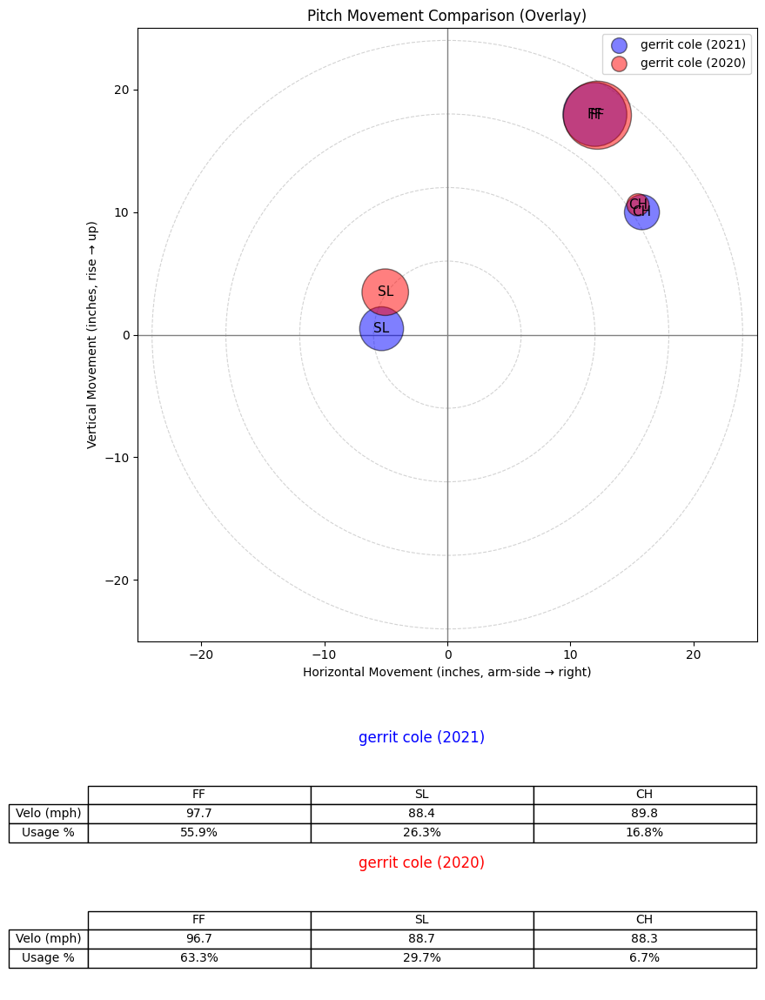

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


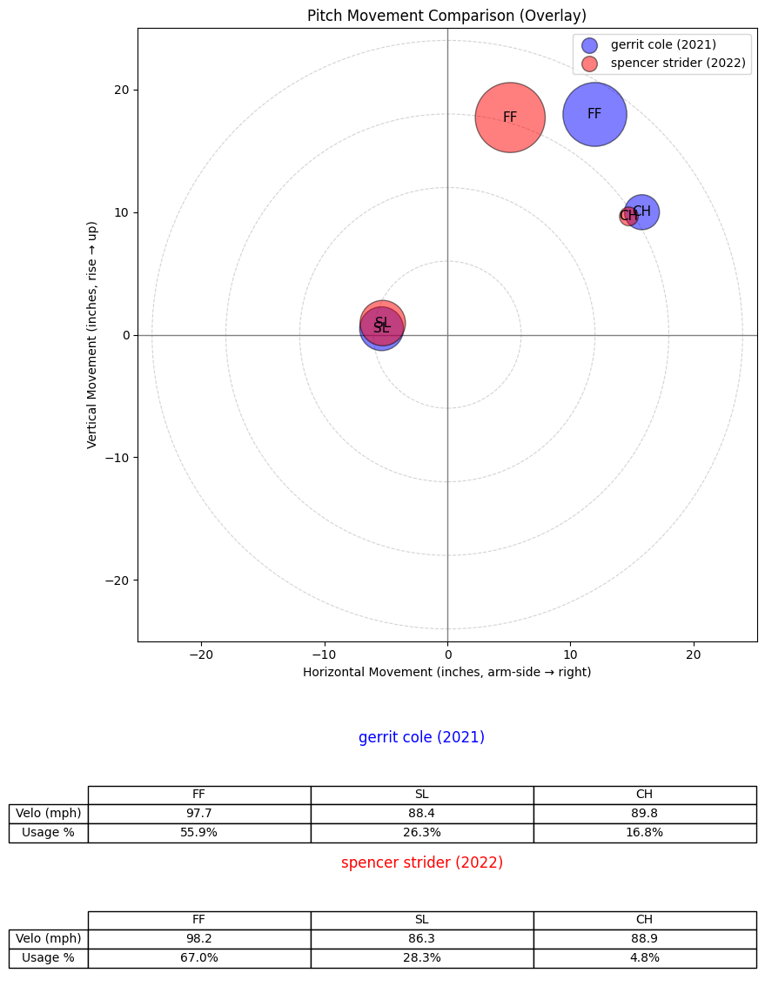

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


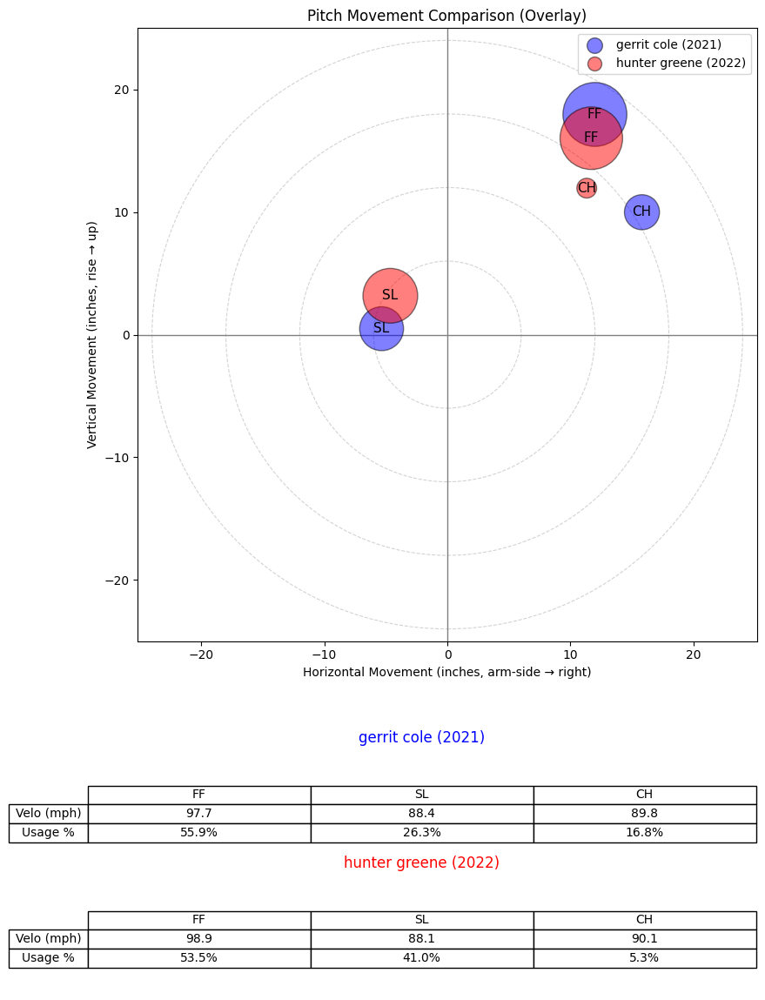

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


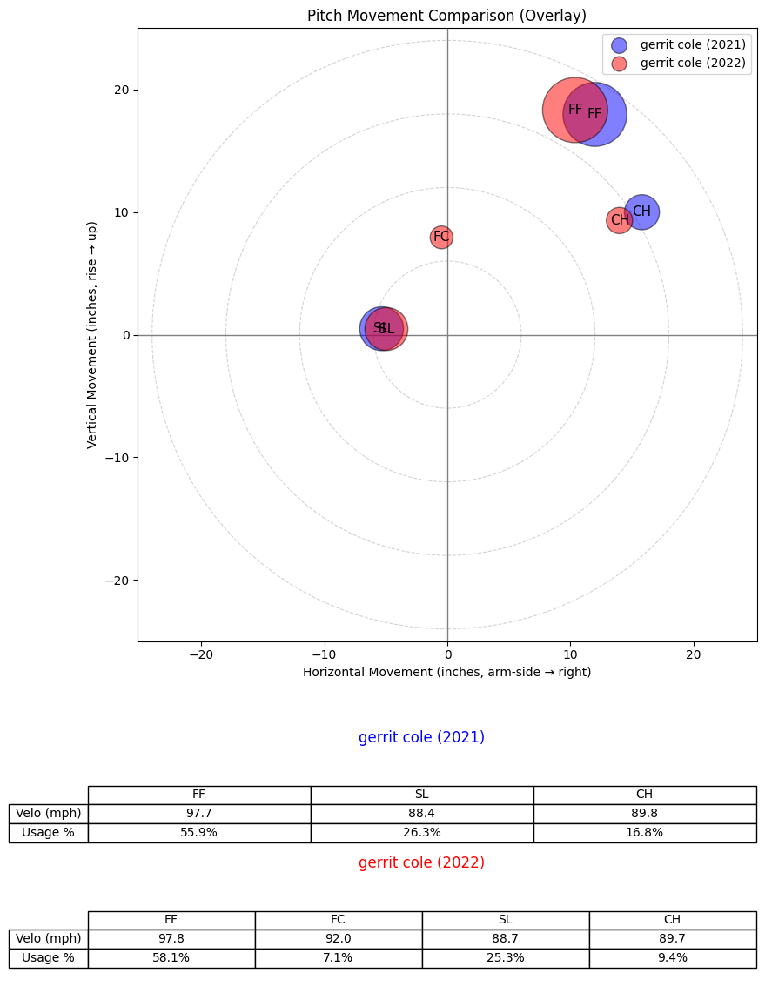

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


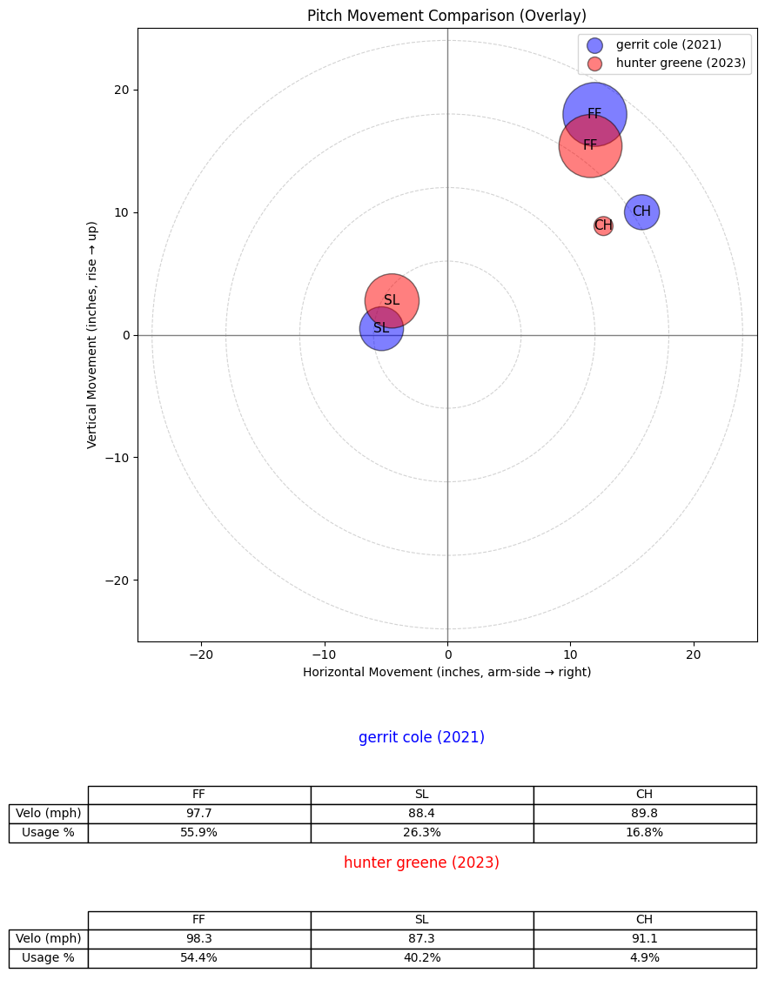

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


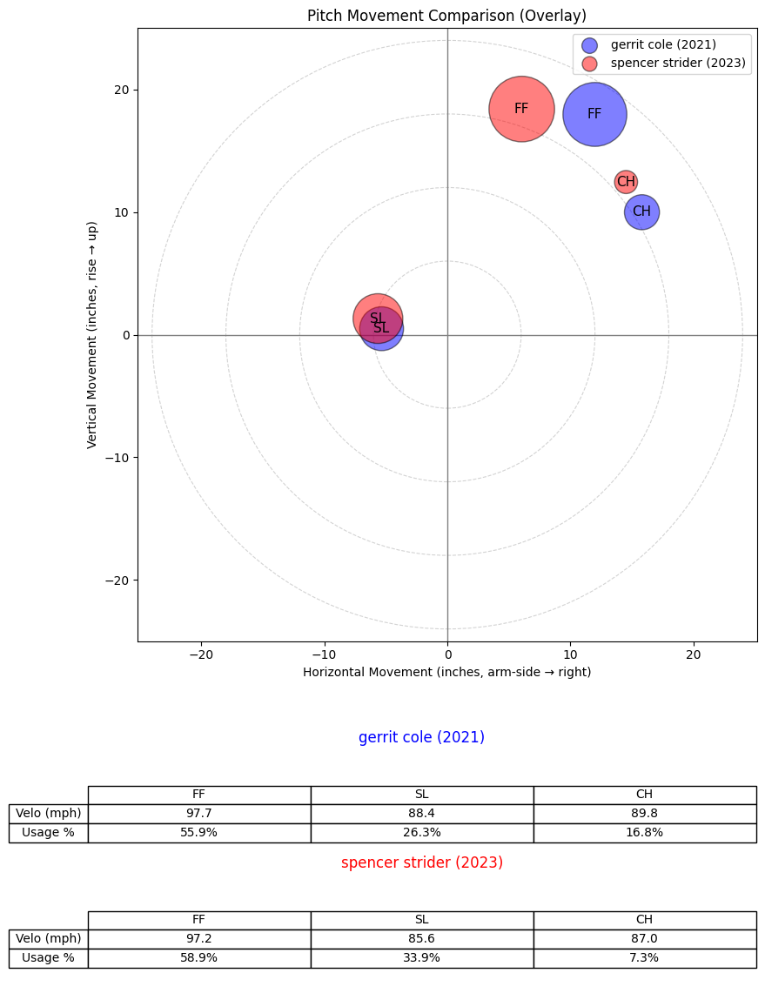

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


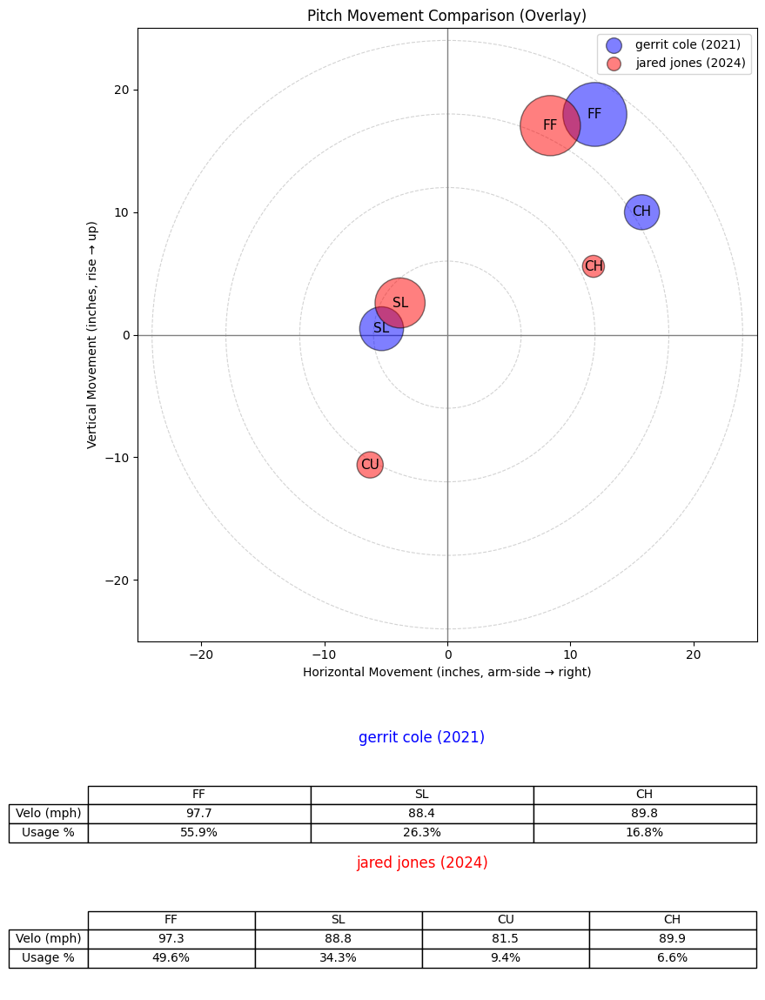

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


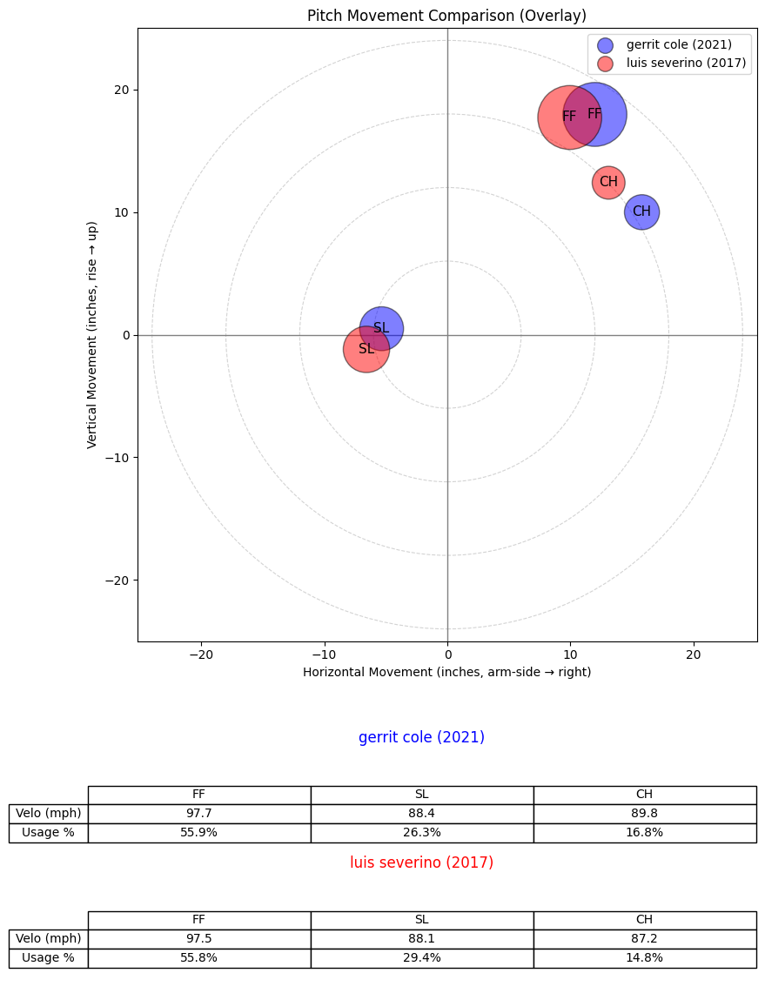

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


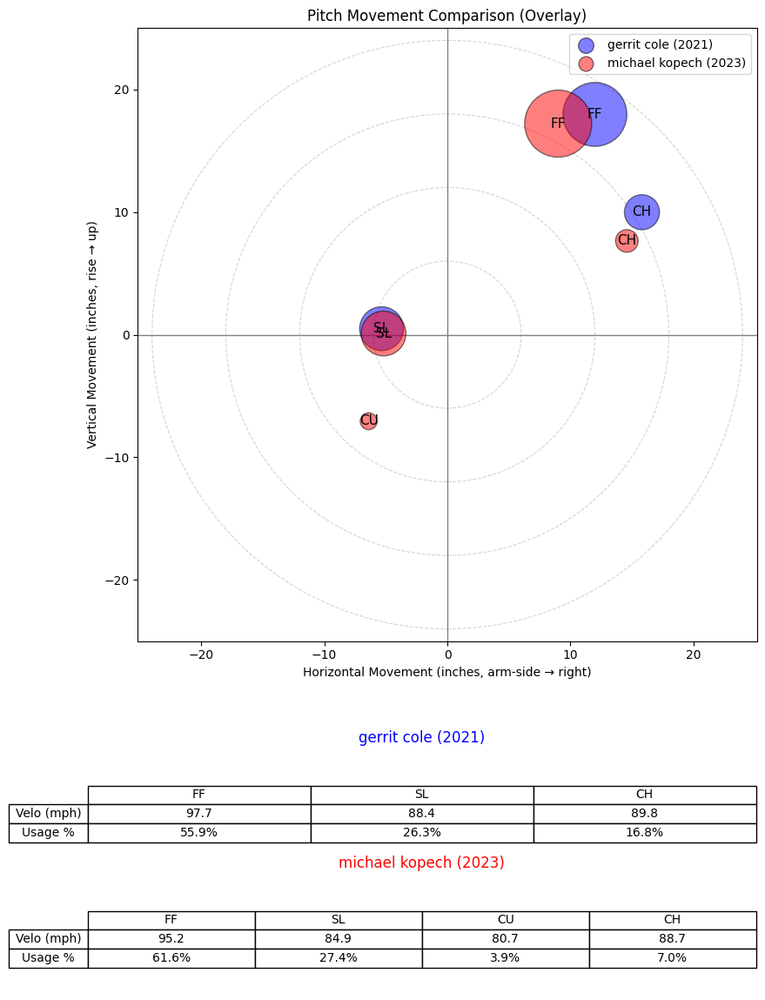

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


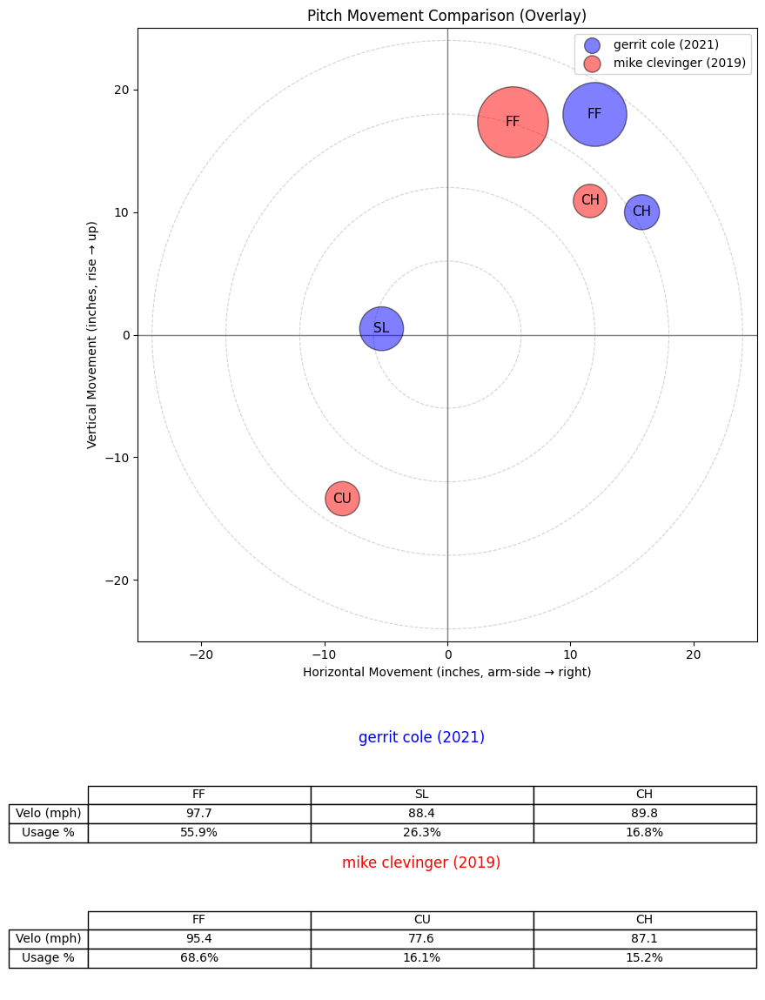

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
535,543037.0,2020,gerrit cole,gerrit,cole,R,starter,0.933899
2024,675911.0,2022,spencer strider,spencer,strider,R,starter,0.923176
1925,668881.0,2022,hunter greene,hunter,greene,R,starter,0.896749
537,543037.0,2022,gerrit cole,gerrit,cole,R,starter,0.859649
1926,668881.0,2023,hunter greene,hunter,greene,R,starter,0.814498
2025,675911.0,2023,spencer strider,spencer,strider,R,starter,0.790764
2083,683003.0,2024,jared jones,jared,jones,R,starter,0.770329
1388,622663.0,2017,luis severino,luis,severino,R,starter,0.759305
1696,656629.0,2023,michael kopech,michael,kopech,R,starter,0.737152
1061,605182.0,2019,mike clevinger,mike,clevinger,R,starter,0.734397


In [ ]:
neighbors_same = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="gerrit cole",
    year=2021,
    X_df=X_ae_metric_df,
    meta_df=pitcher_season_df,
    n_neighbors=10,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same)

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


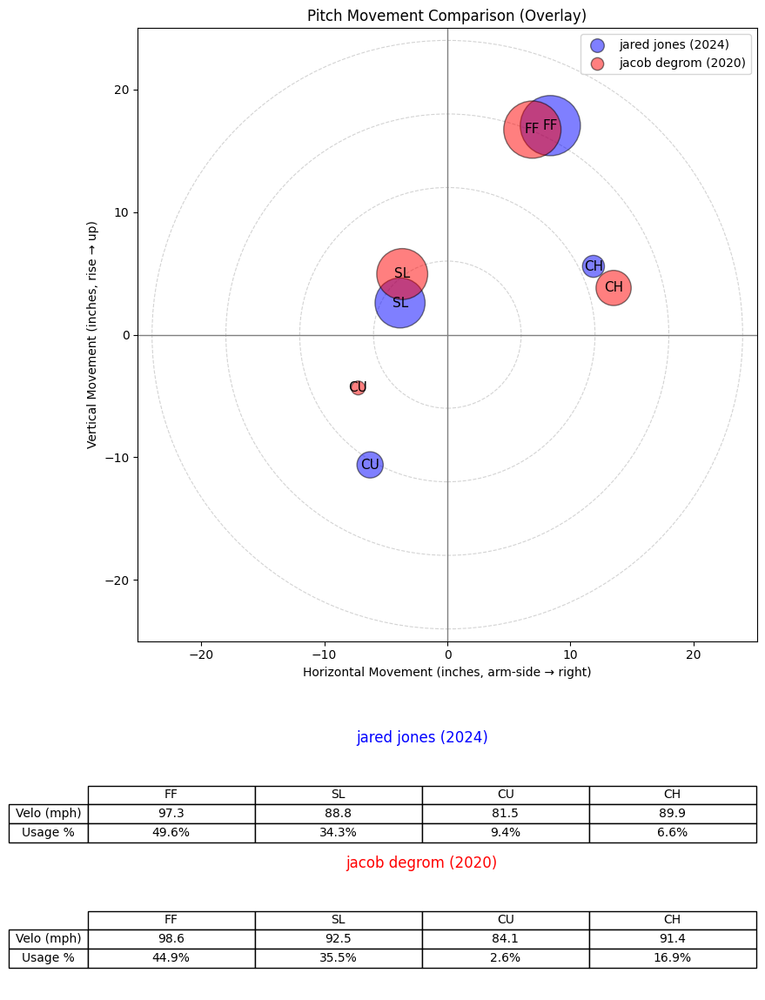

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


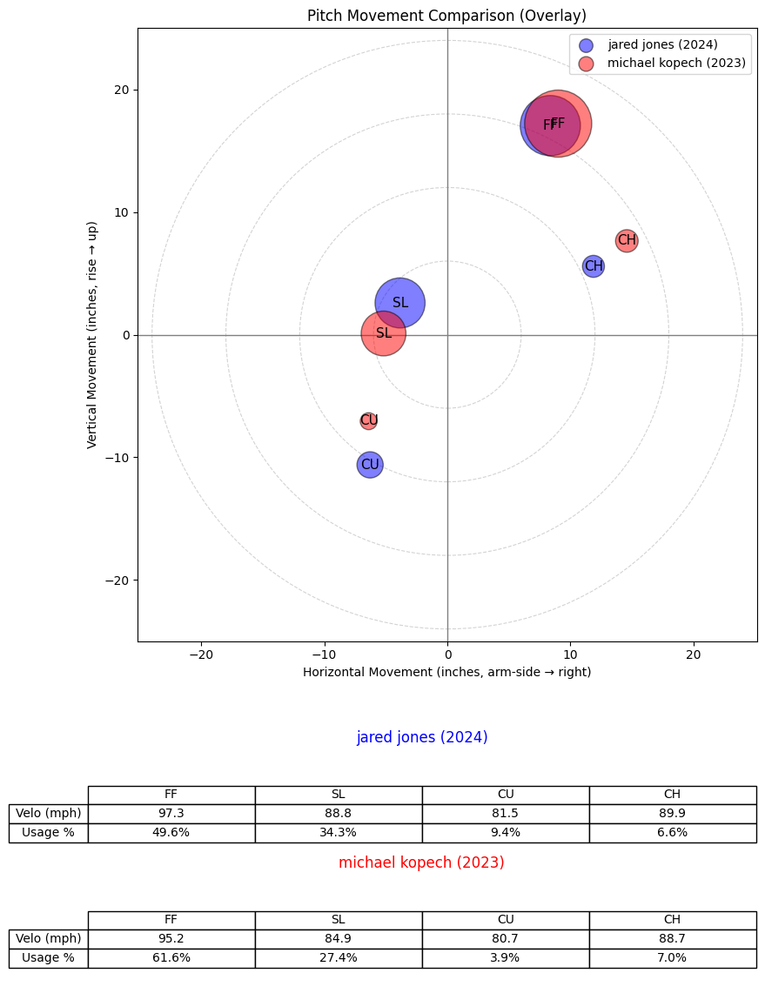

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


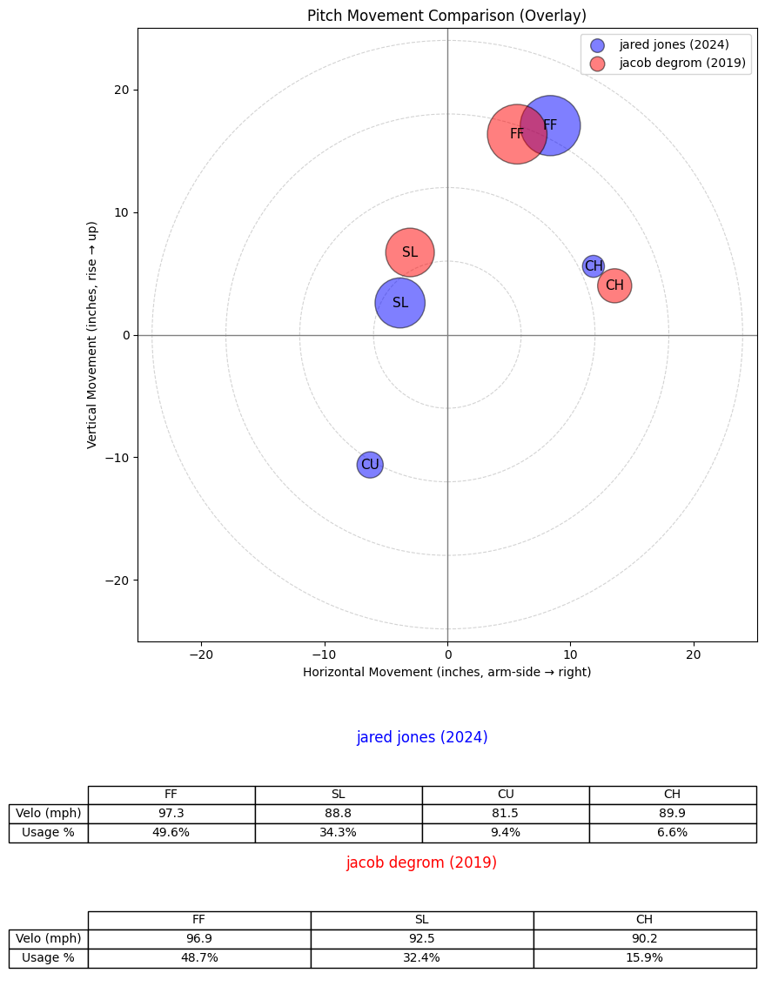

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


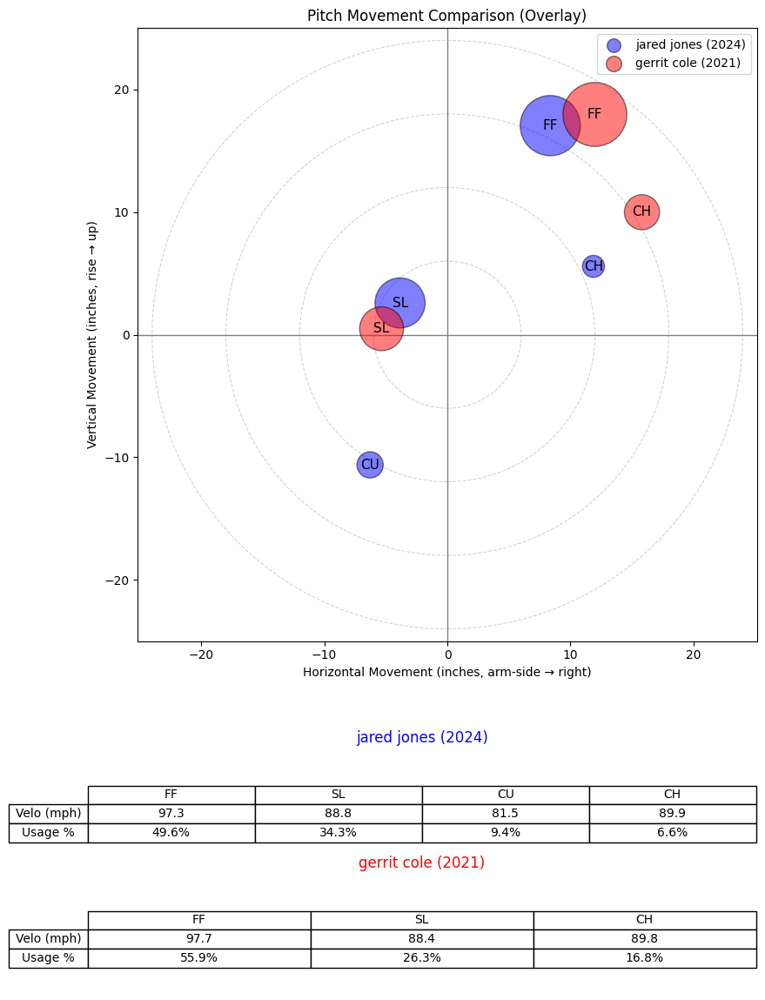

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


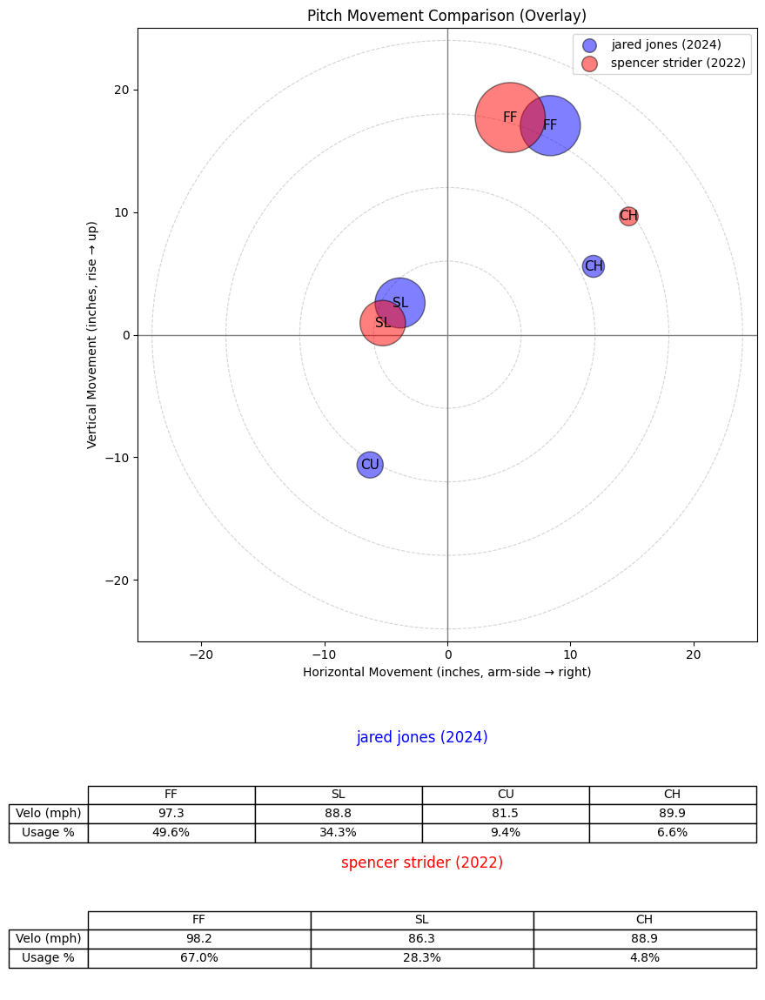

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


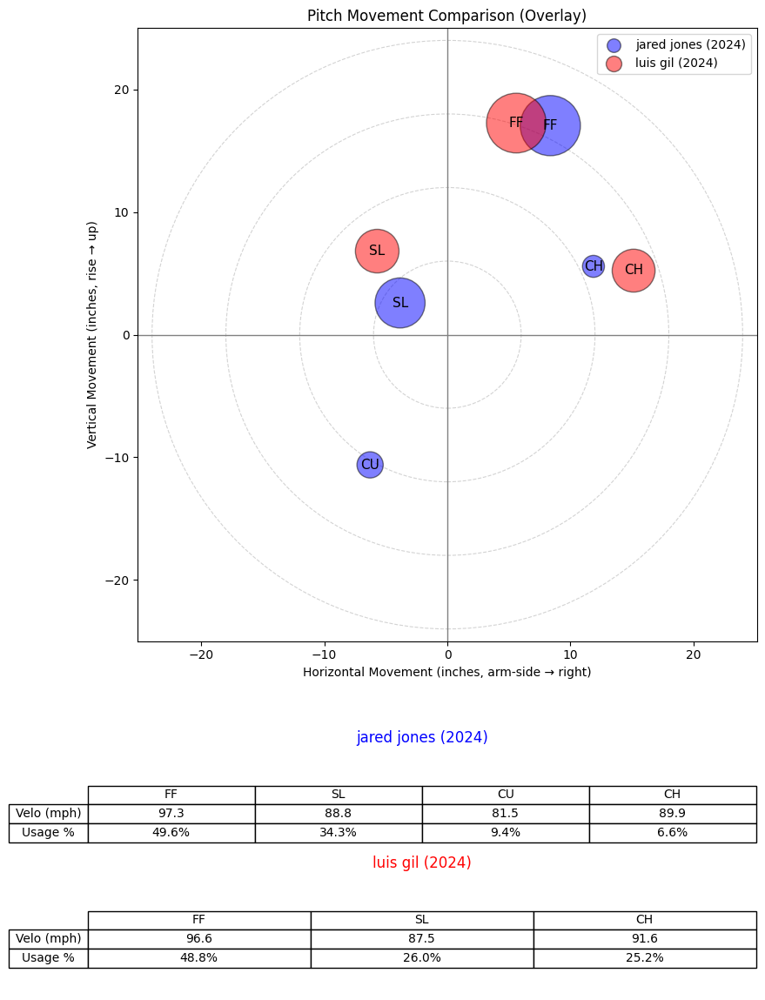

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


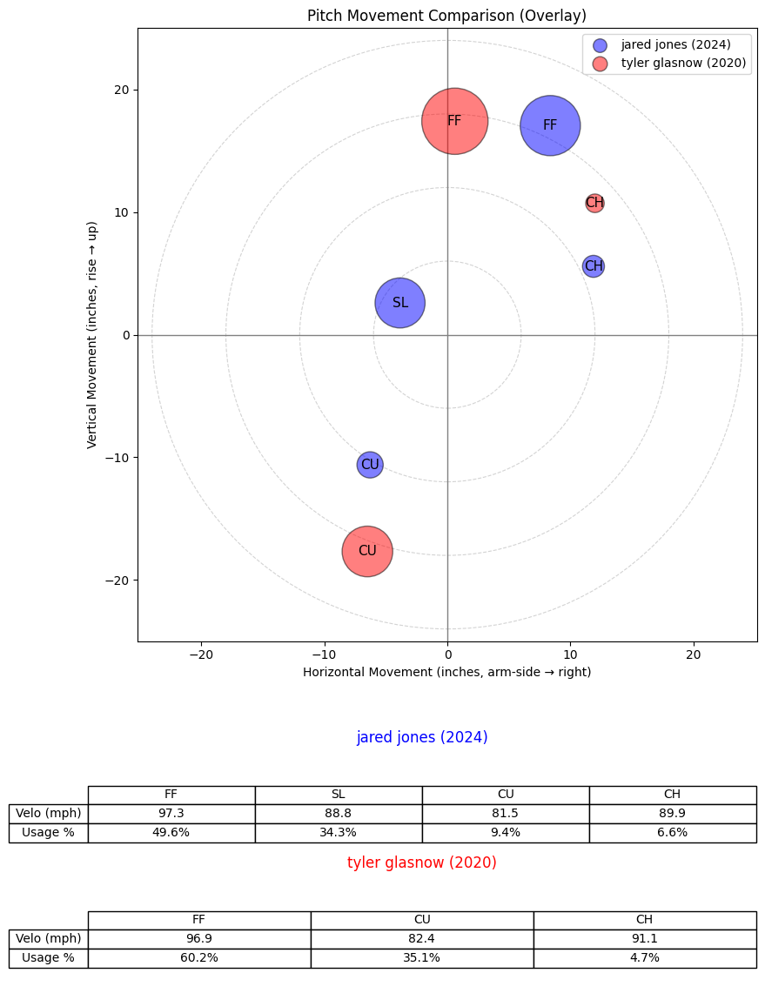

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


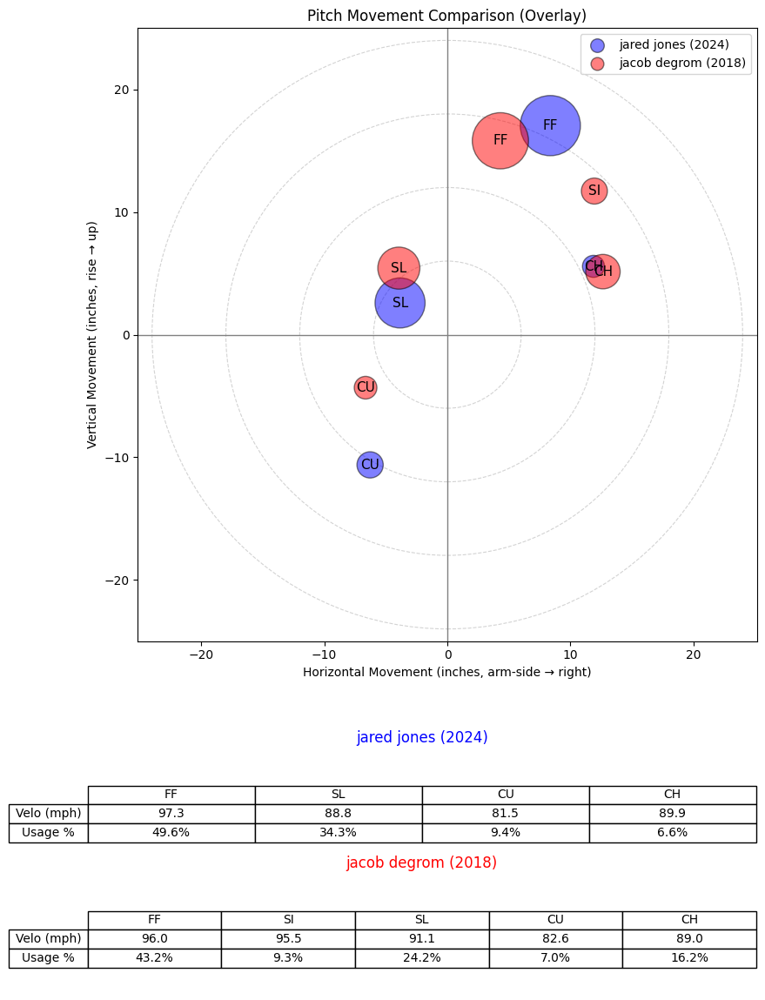

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


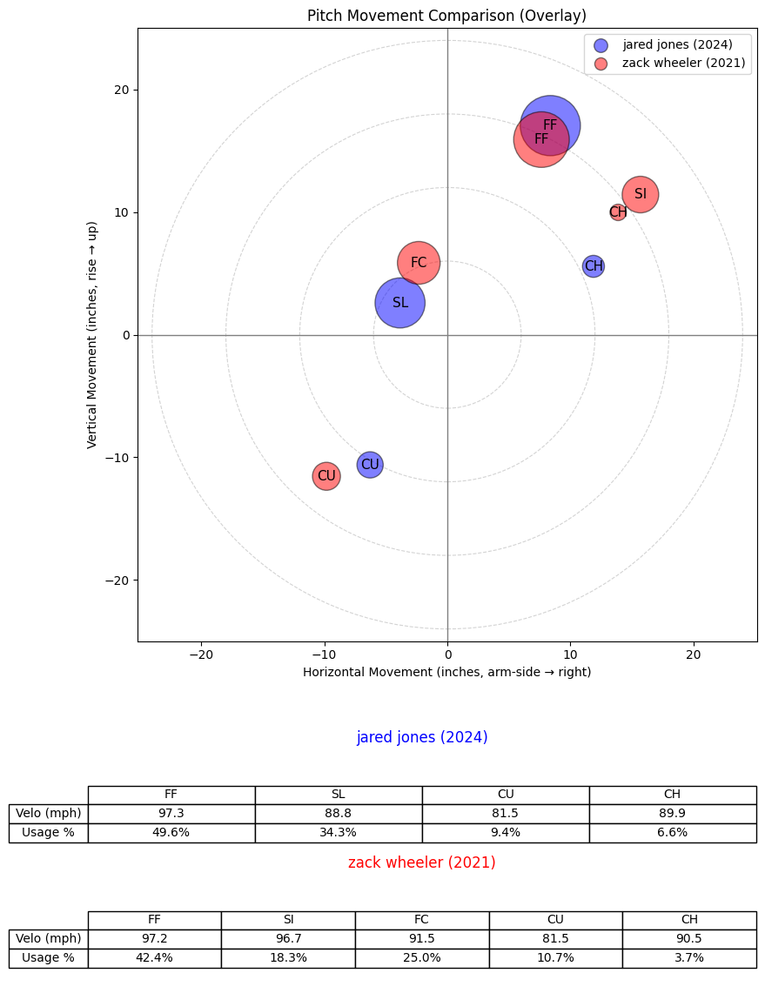

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


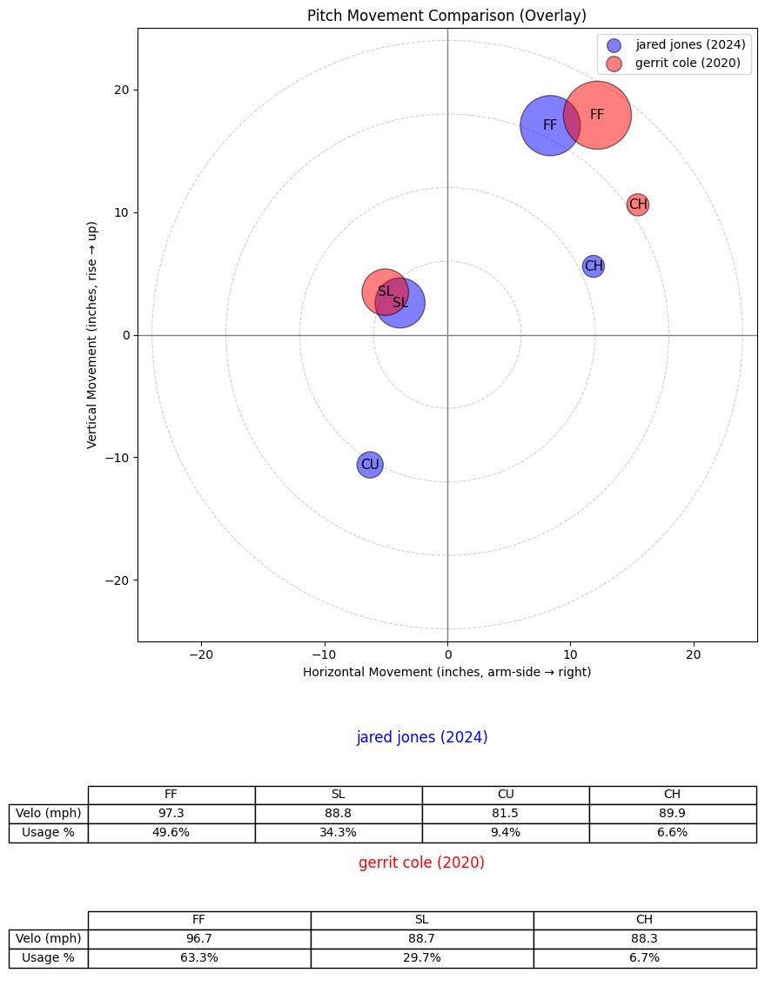

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
957,594798.0,2020,jacob degrom,jacob,degrom,R,starter,0.893194
1696,656629.0,2023,michael kopech,michael,kopech,R,starter,0.785713
956,594798.0,2019,jacob degrom,jacob,degrom,R,starter,0.782746
536,543037.0,2021,gerrit cole,gerrit,cole,R,starter,0.770329
2024,675911.0,2022,spencer strider,spencer,strider,R,starter,0.757460
1783,661563.0,2024,luis gil,luis,gil,R,starter,0.738703
1165,607192.0,2020,tyler glasnow,tyler,glasnow,R,starter,0.736896
955,594798.0,2018,jacob degrom,jacob,degrom,R,starter,0.727966
681,554430.0,2021,zack wheeler,zack,wheeler,R,starter,0.675910
535,543037.0,2020,gerrit cole,gerrit,cole,R,starter,0.665207


In [299]:
neighbors_same = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="jared jones",
    year=2024,
    X_df=X_ae_metric_df,
    meta_df=pitcher_season_df,
    n_neighbors=10,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same)

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


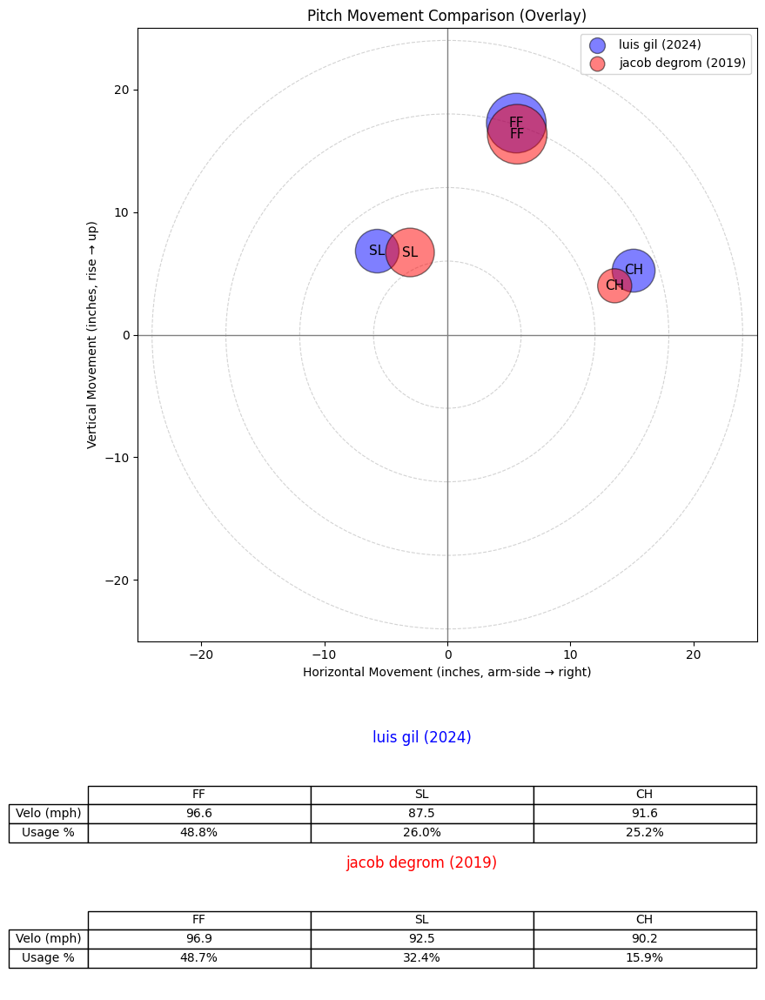

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


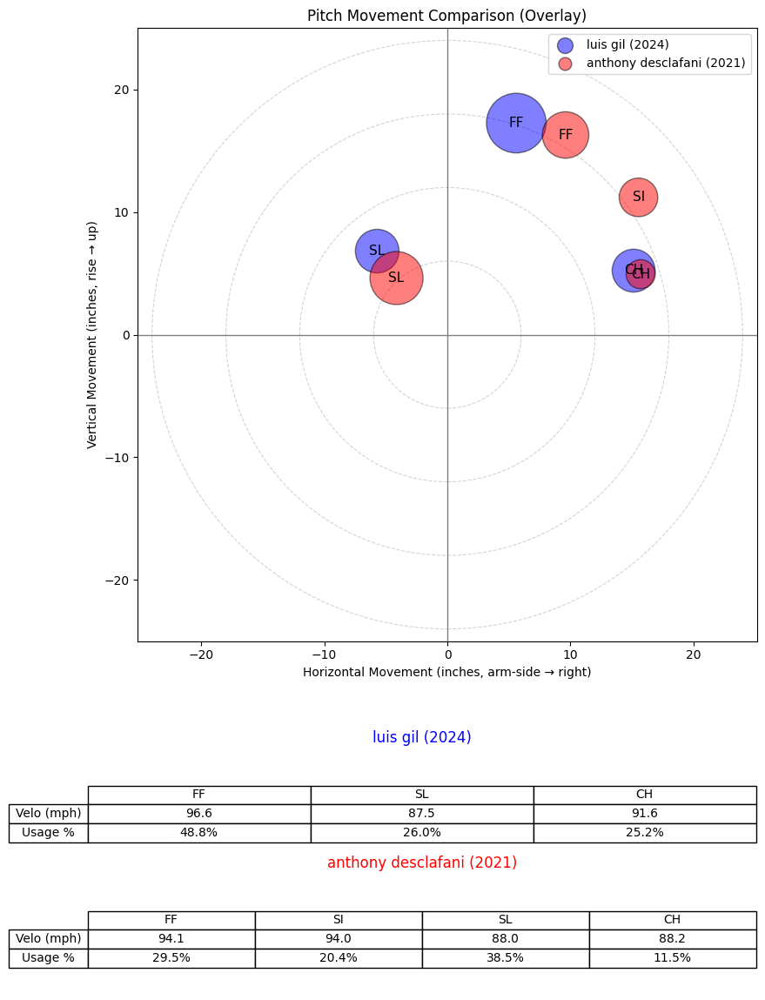

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


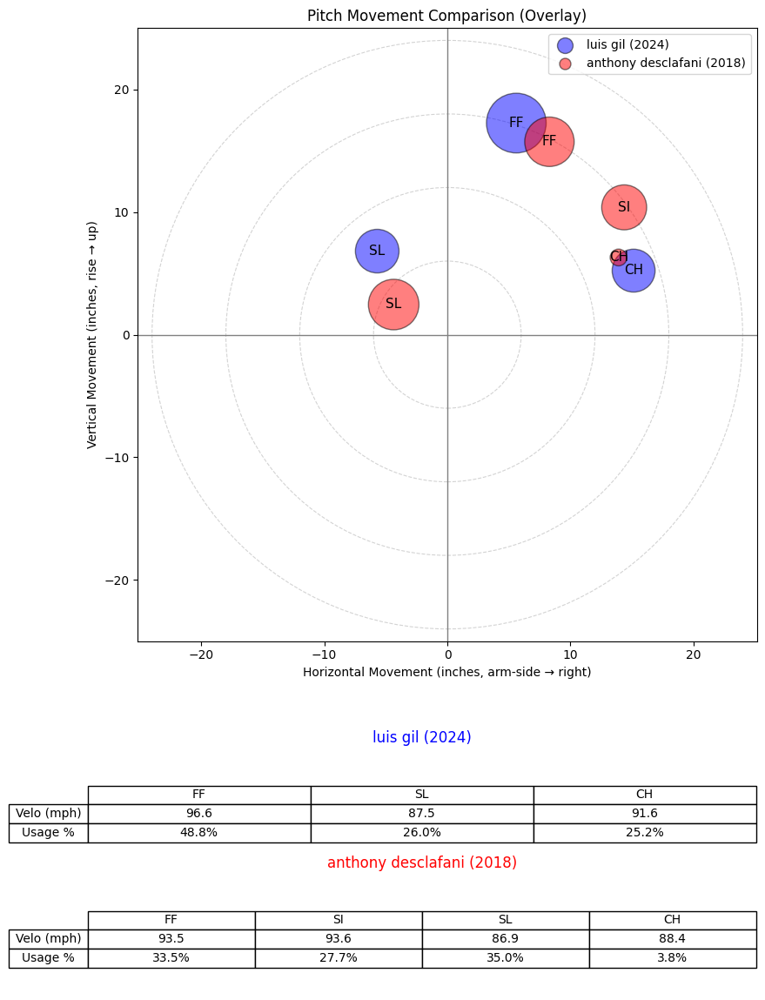

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


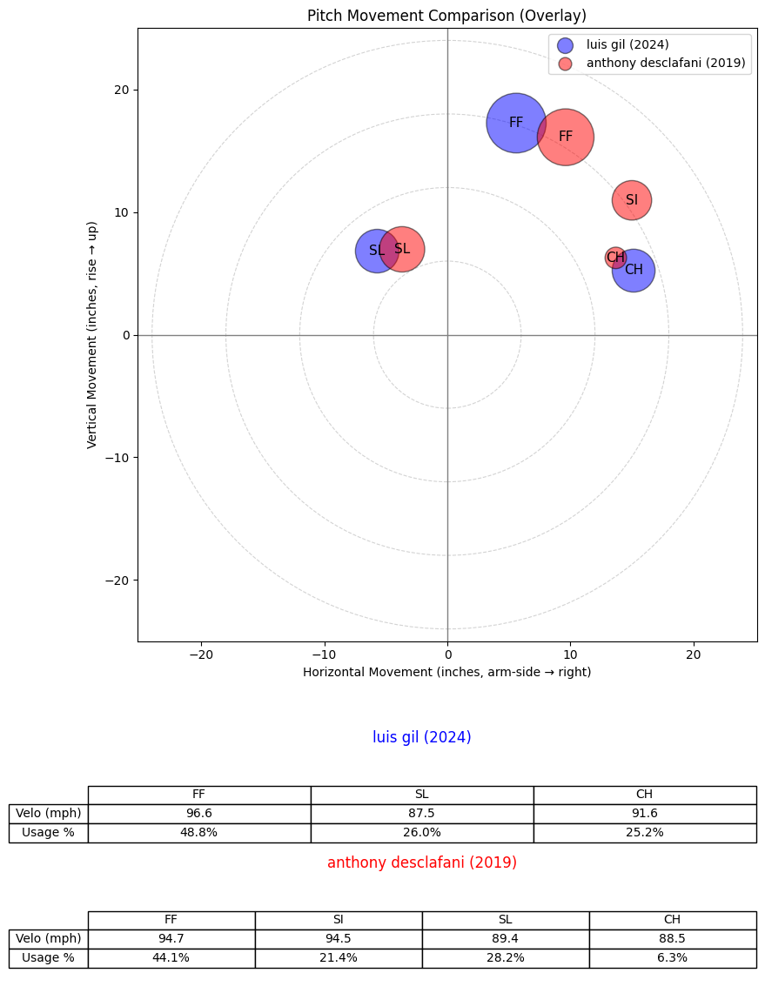

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


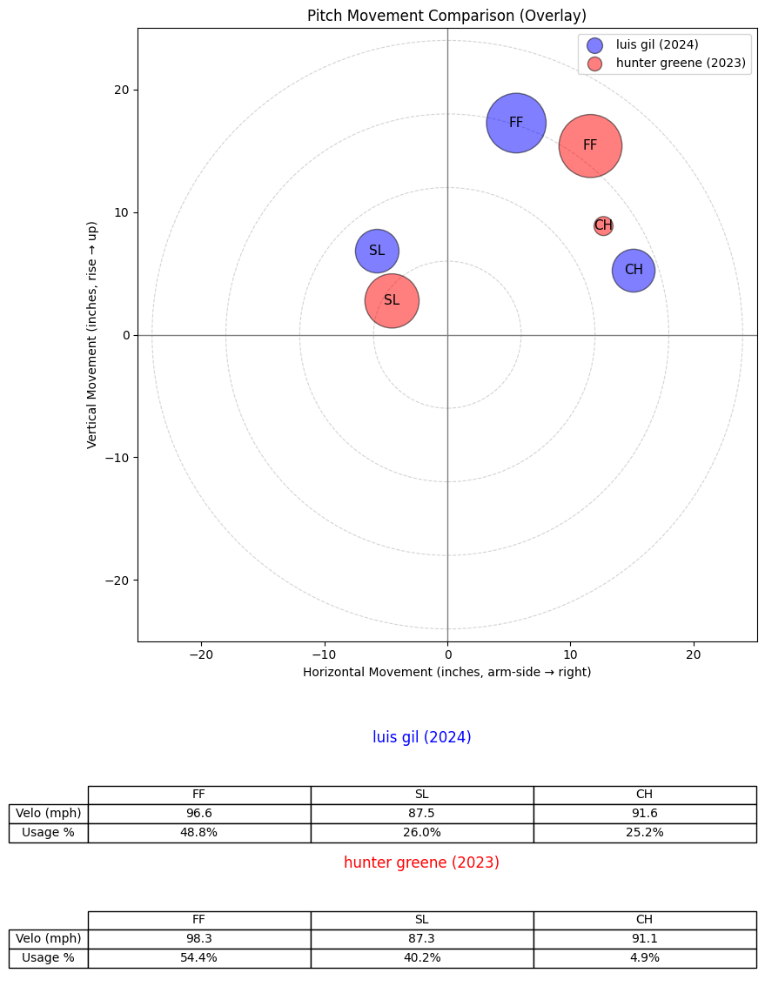

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


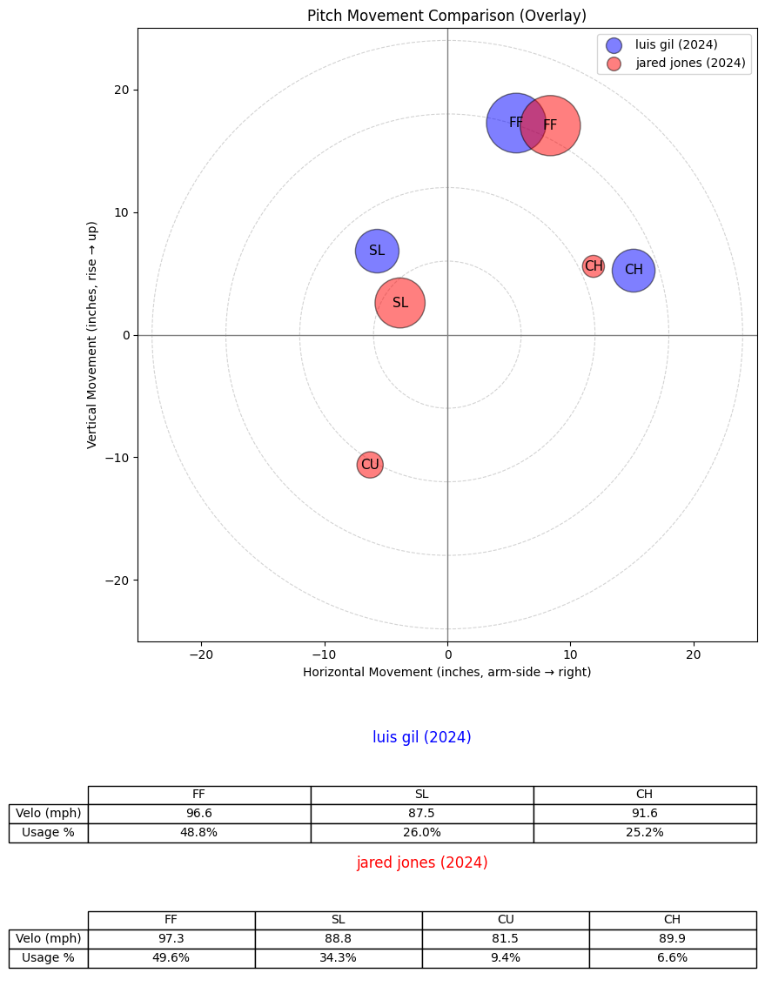

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


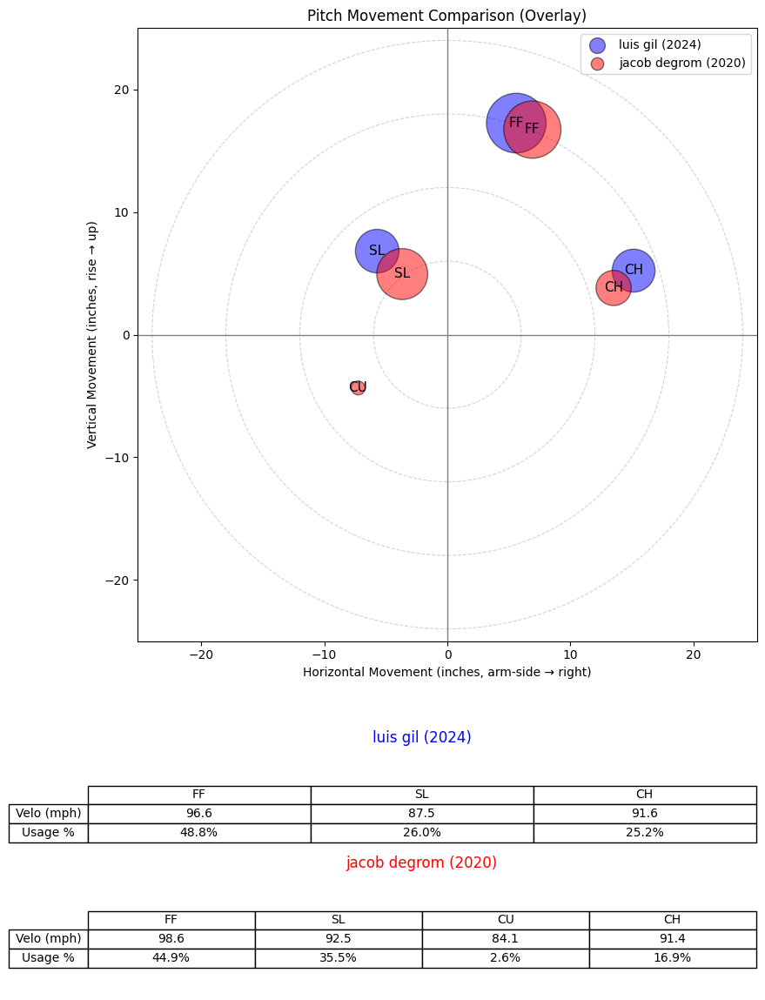

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


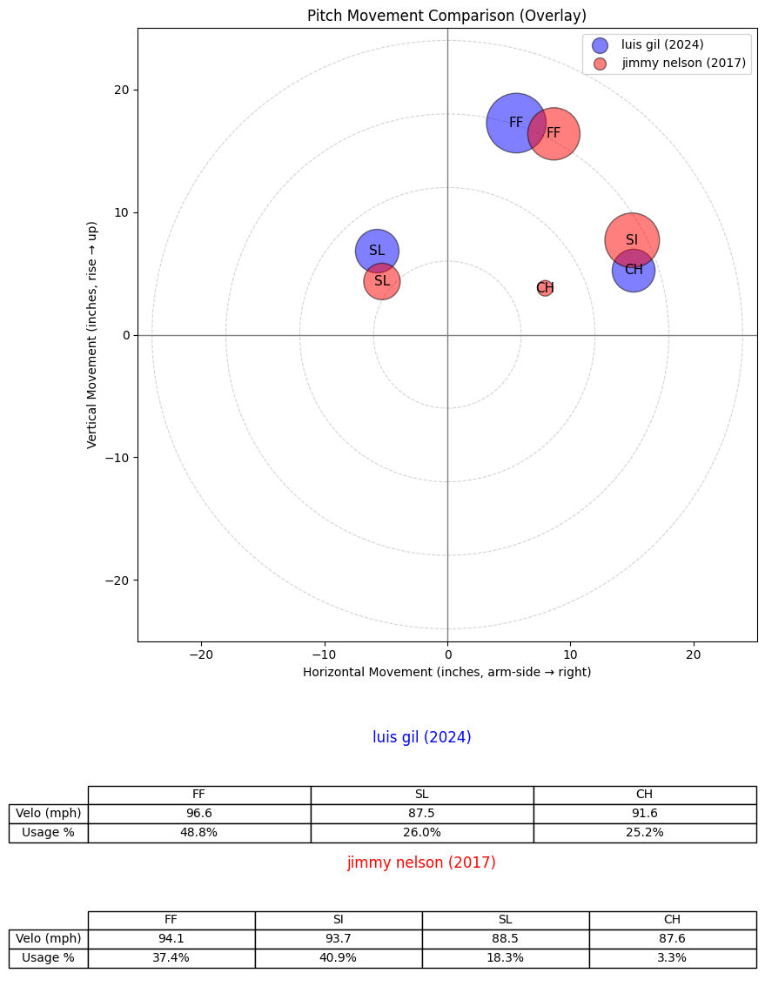

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


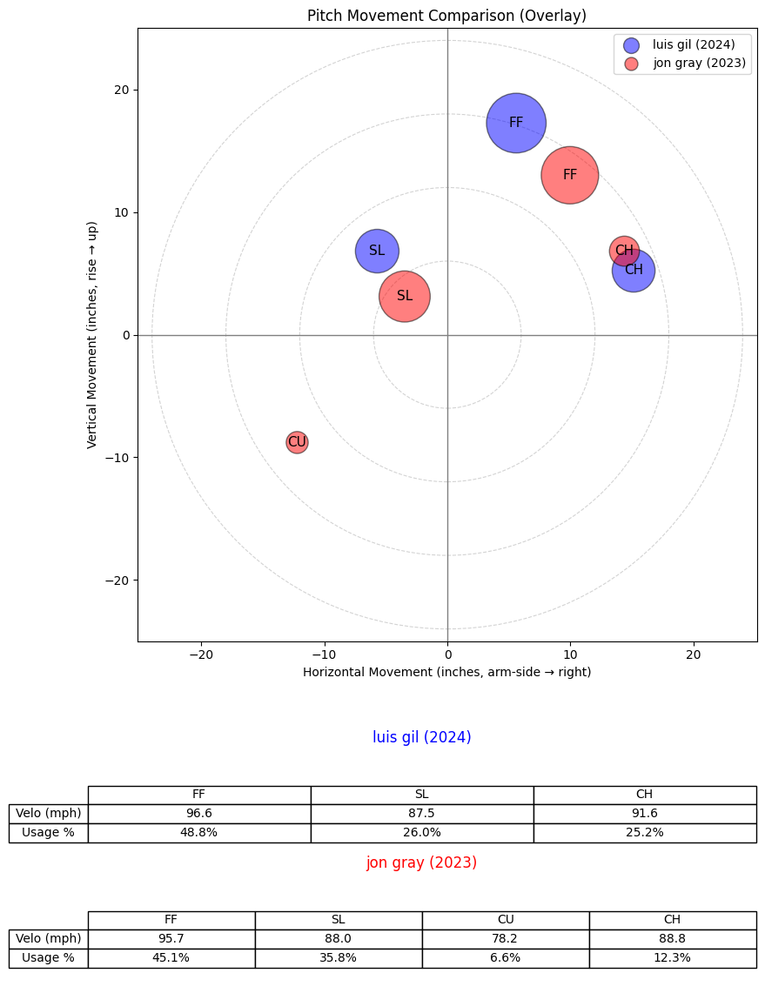

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


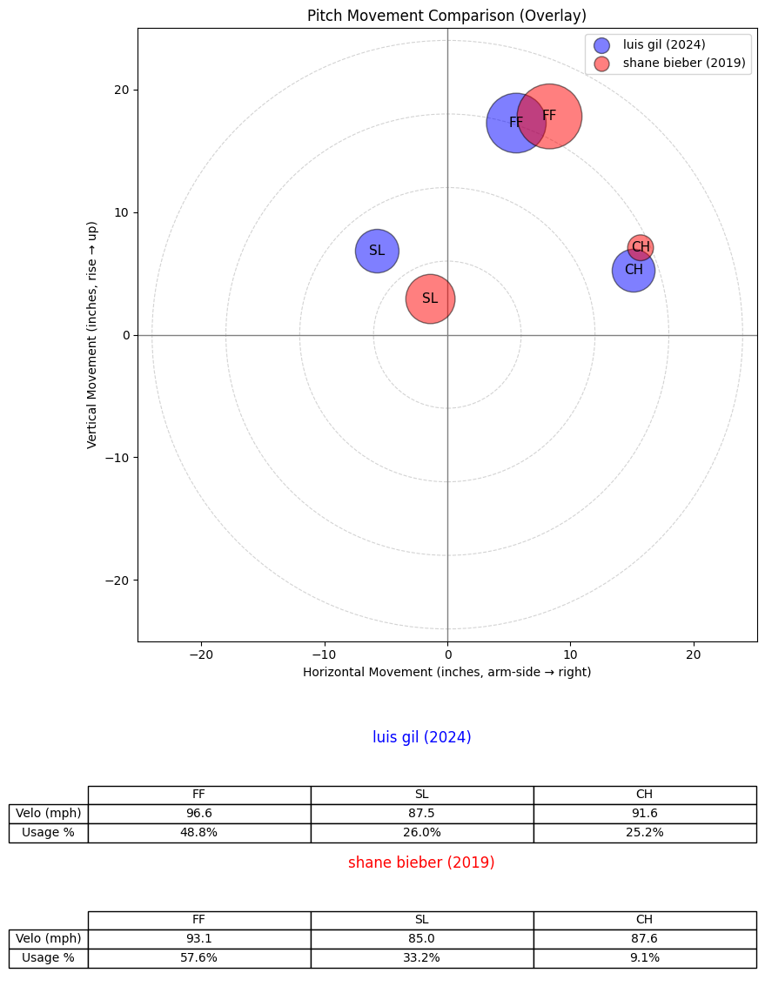

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
956,594798.0,2019,jacob degrom,jacob,degrom,R,starter,0.876006
542,543101.0,2021,anthony desclafani,anthony,desclafani,R,starter,0.845006
540,543101.0,2018,anthony desclafani,anthony,desclafani,R,starter,0.831514
541,543101.0,2019,anthony desclafani,anthony,desclafani,R,starter,0.790383
1926,668881.0,2023,hunter greene,hunter,greene,R,starter,0.762608
2083,683003.0,2024,jared jones,jared,jones,R,starter,0.738703
957,594798.0,2020,jacob degrom,jacob,degrom,R,starter,0.727320
441,519076.0,2017,jimmy nelson,jimmy,nelson,R,starter,0.711248
852,592351.0,2023,jon gray,jon,gray,R,starter,0.684916
1965,669456.0,2019,shane bieber,shane,bieber,R,starter,0.673221


In [300]:
neighbors_same = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="luis gil",
    year=2024,
    X_df=X_ae_metric_df,
    meta_df=pitcher_season_df,
    n_neighbors=10,
    overlay_df=movement_long,
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same)

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


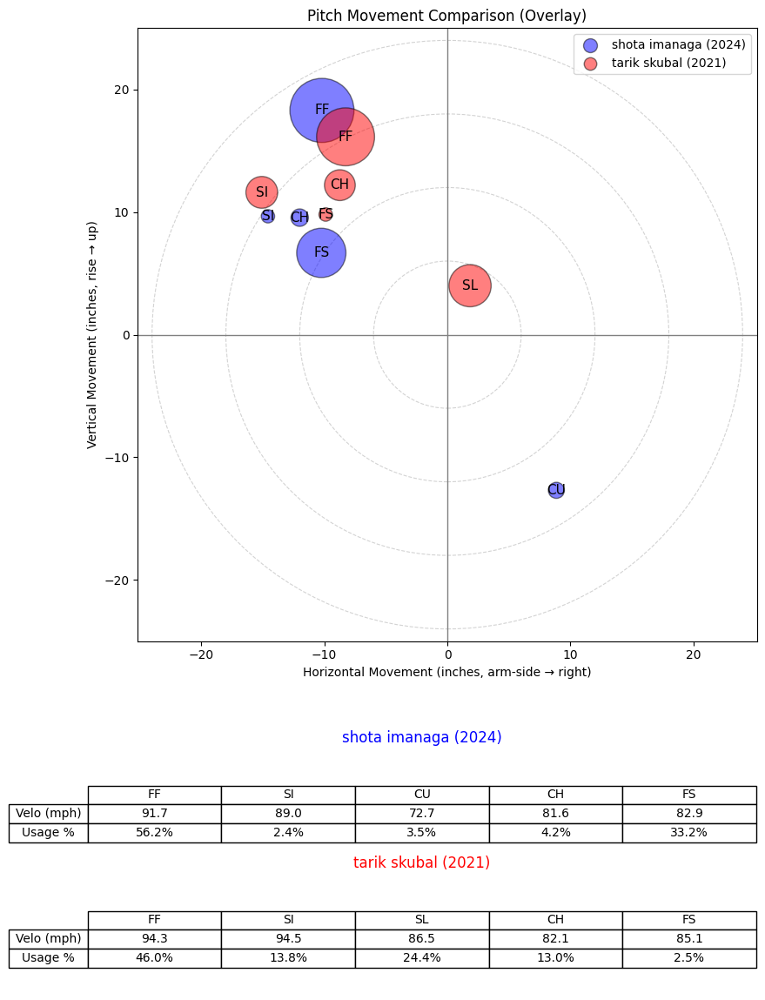

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


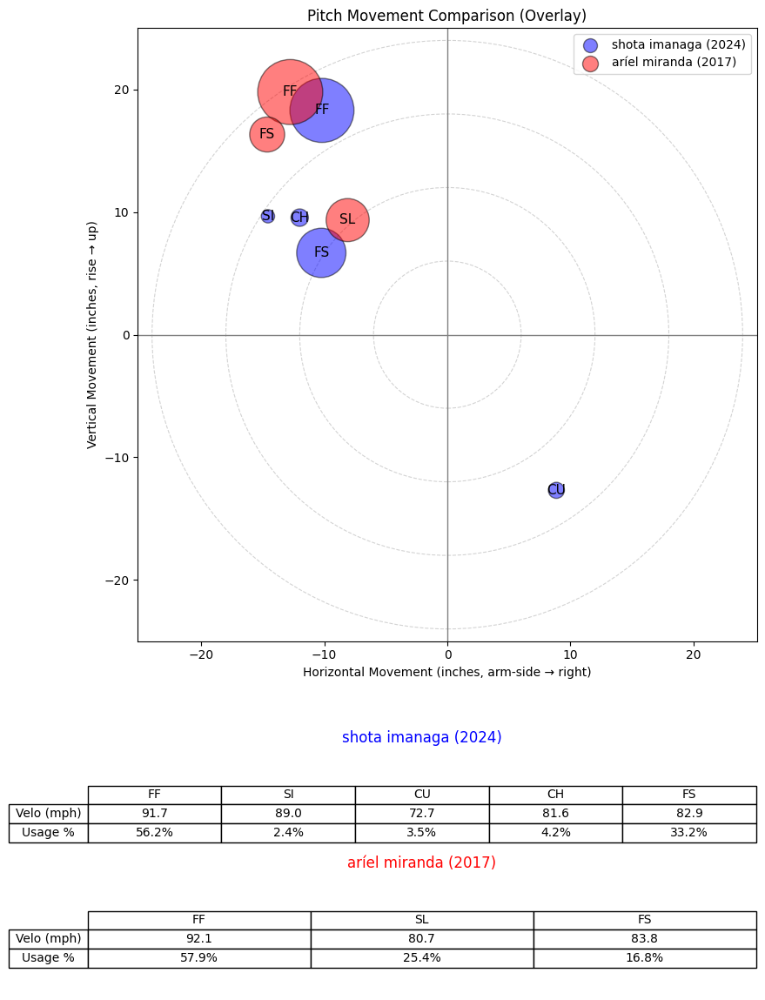

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


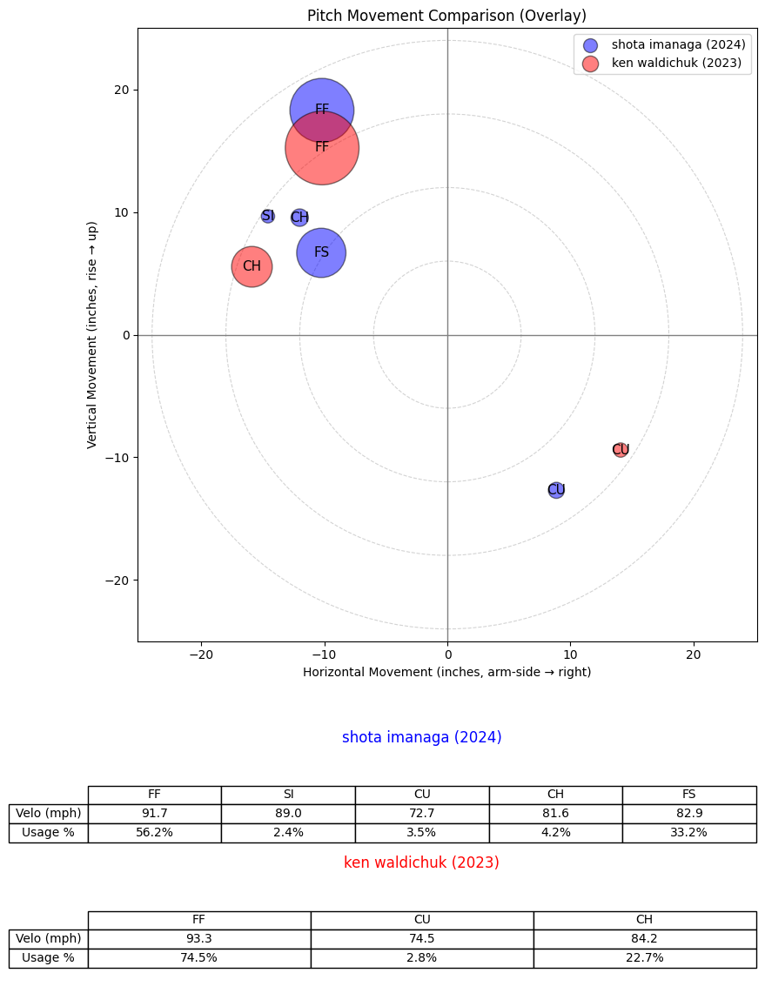

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


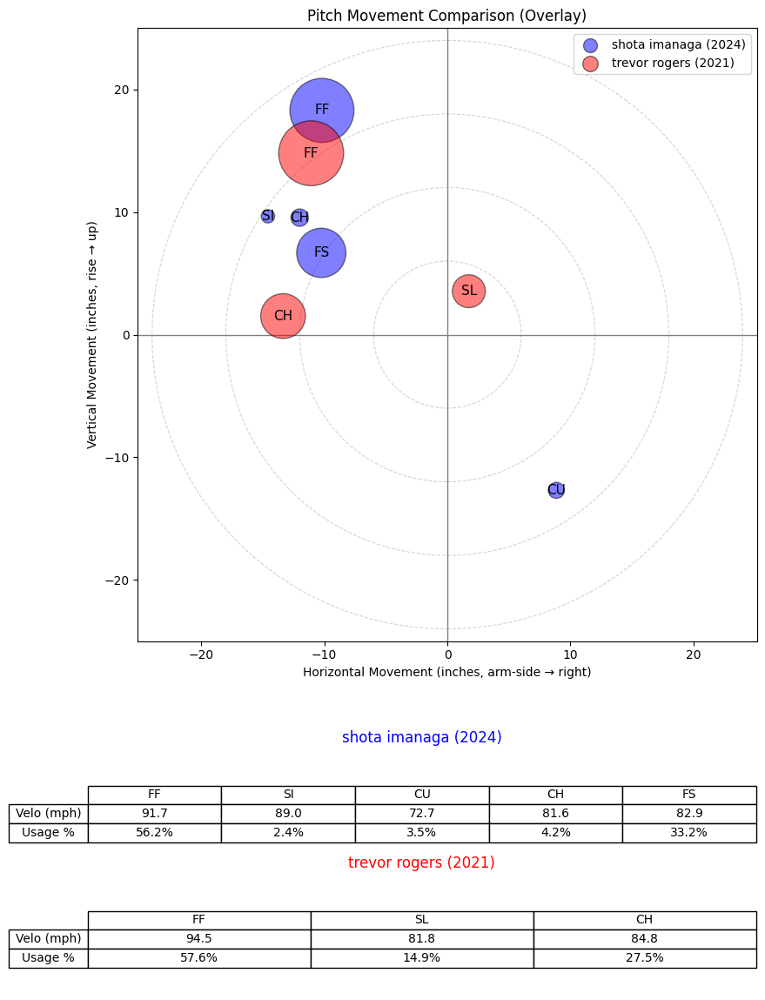

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


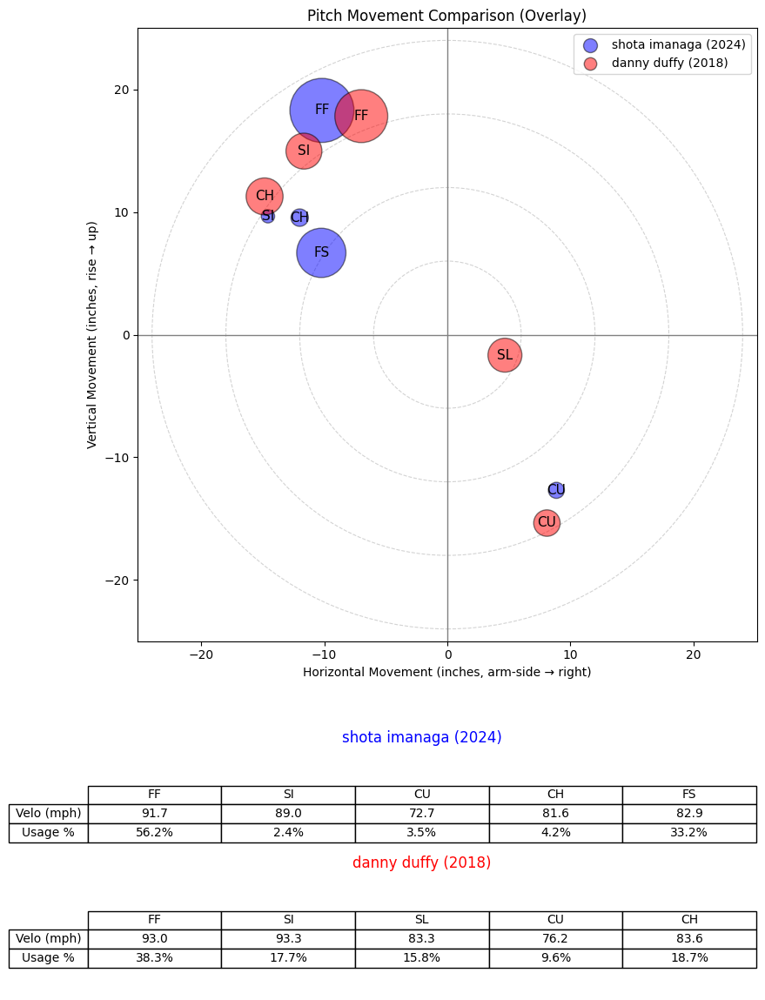

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


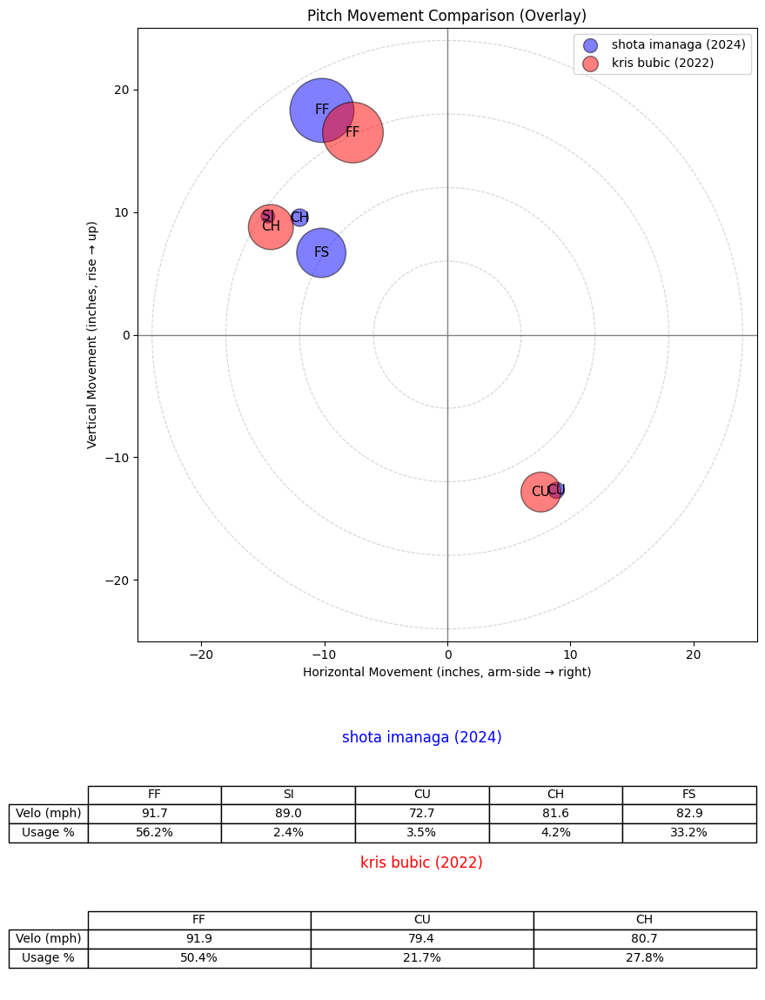

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


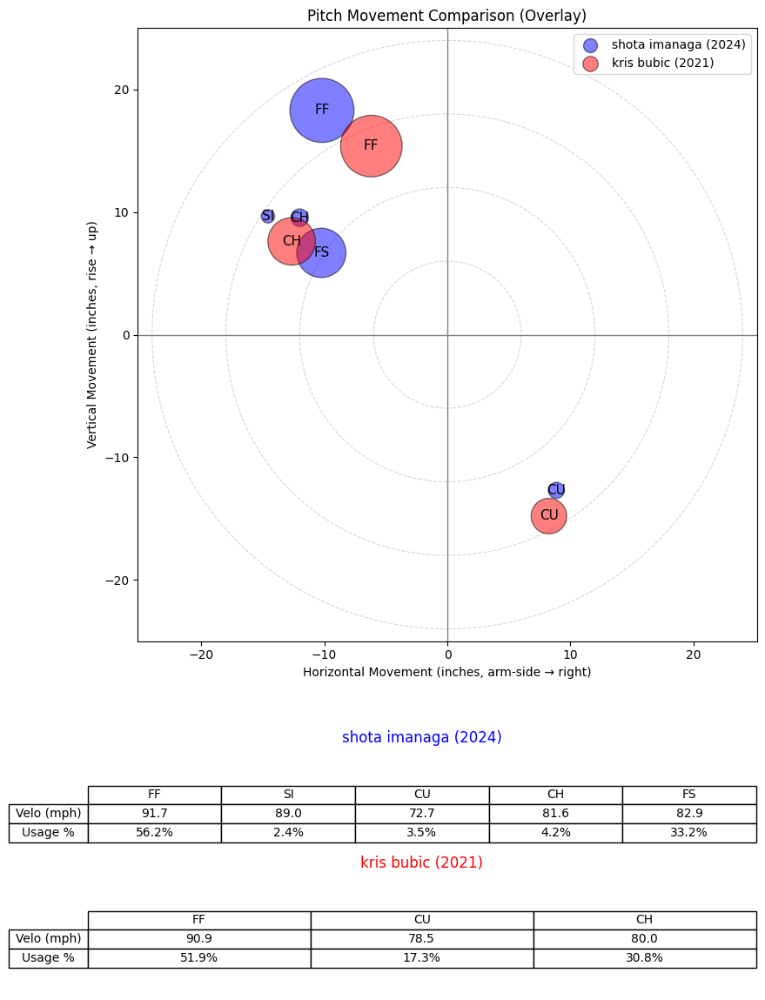

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


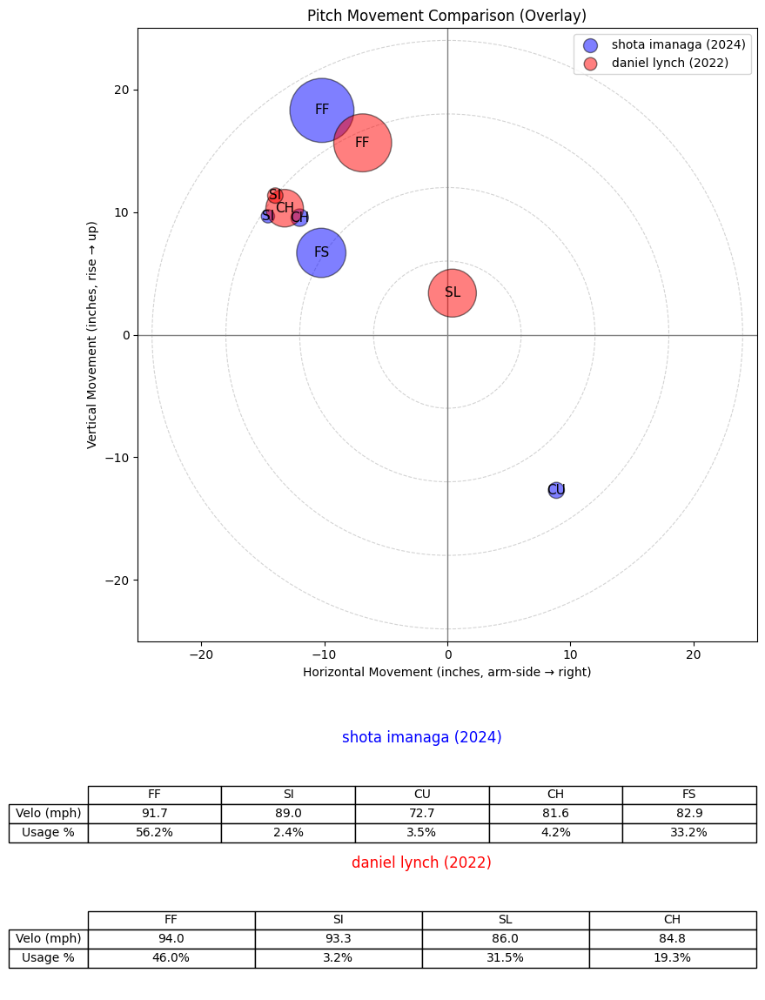

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


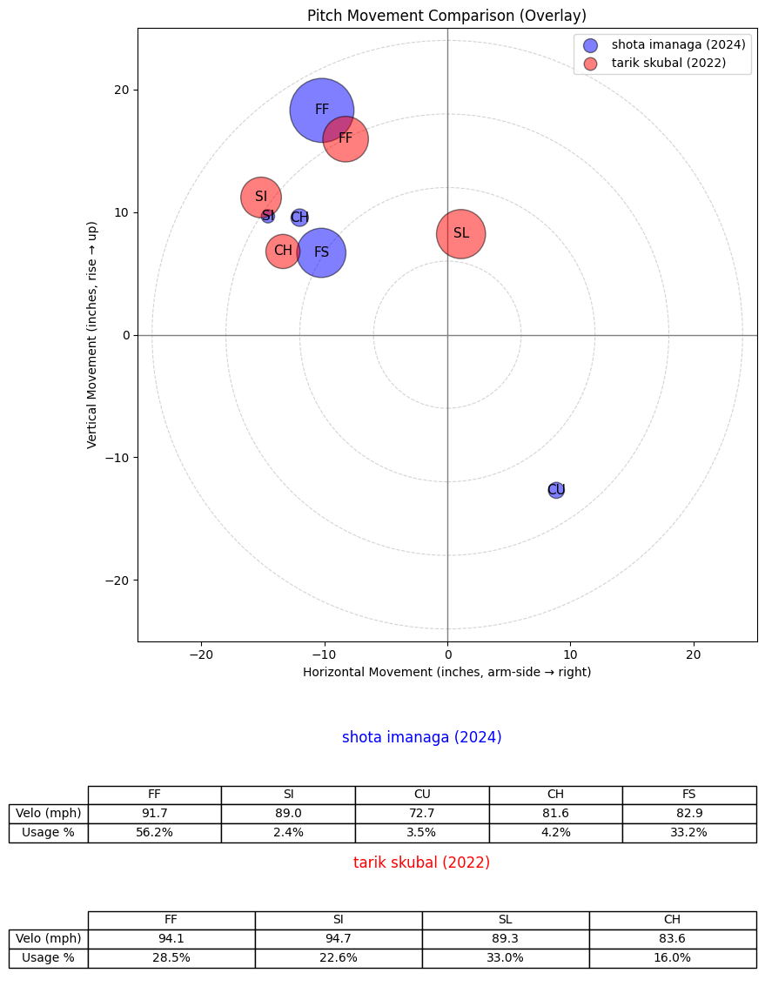

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


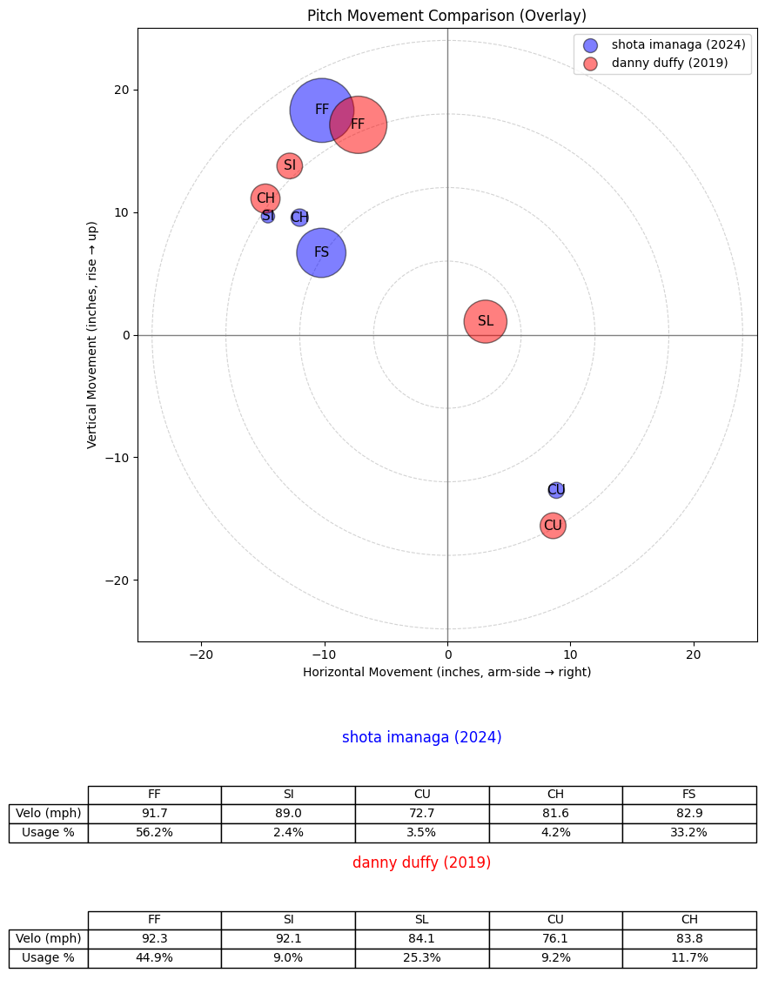

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
1957,669373.0,2021,tarik skubal,tarik,skubal,L,starter,0.889920
1871,664641.0,2017,aríel miranda,aríel,miranda,L,starter,0.783680
2092,686610.0,2023,ken waldichuk,ken,waldichuk,L,starter,0.556939
1961,669432.0,2021,trevor rogers,trevor,rogers,L,starter,0.520941
411,518633.0,2018,danny duffy,danny,duffy,L,starter,0.516847
1794,663460.0,2022,kris bubic,kris,bubic,L,starter,0.516834
1793,663460.0,2021,kris bubic,kris,bubic,L,starter,0.500389
1813,663738.0,2022,daniel lynch,daniel,lynch,L,starter,0.490471
1958,669373.0,2022,tarik skubal,tarik,skubal,L,starter,0.490036
412,518633.0,2019,danny duffy,danny,duffy,L,starter,0.487868


In [301]:
neighbors_same = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="shota imanaga",
    year=2024,
    X_df=X_ae_metric_df,
    meta_df=pitcher_season_df,
    n_neighbors=10,
    overlay_df=movement_long,  # or whatever df your compare_pitchers_overlay expects
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same)

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


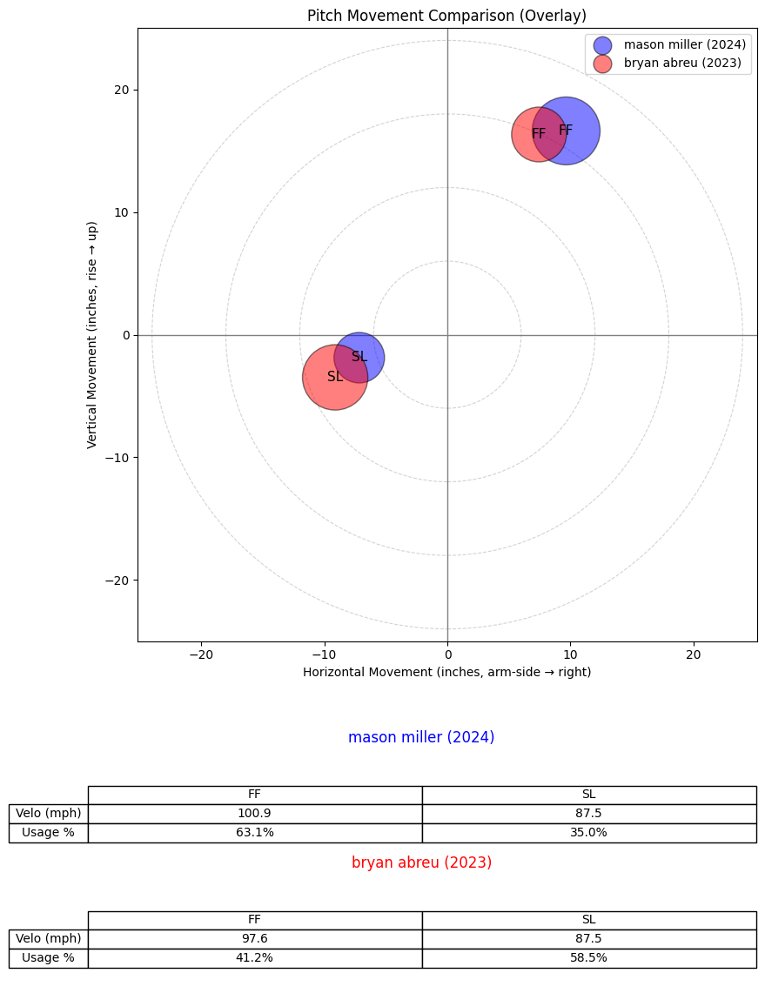

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


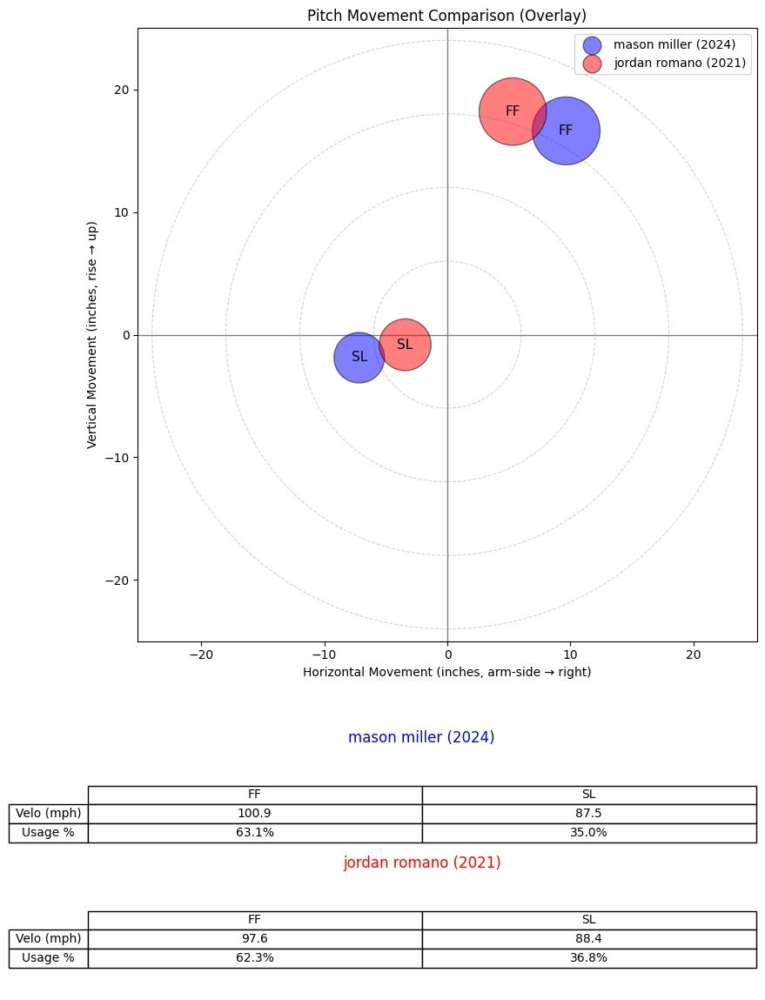

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


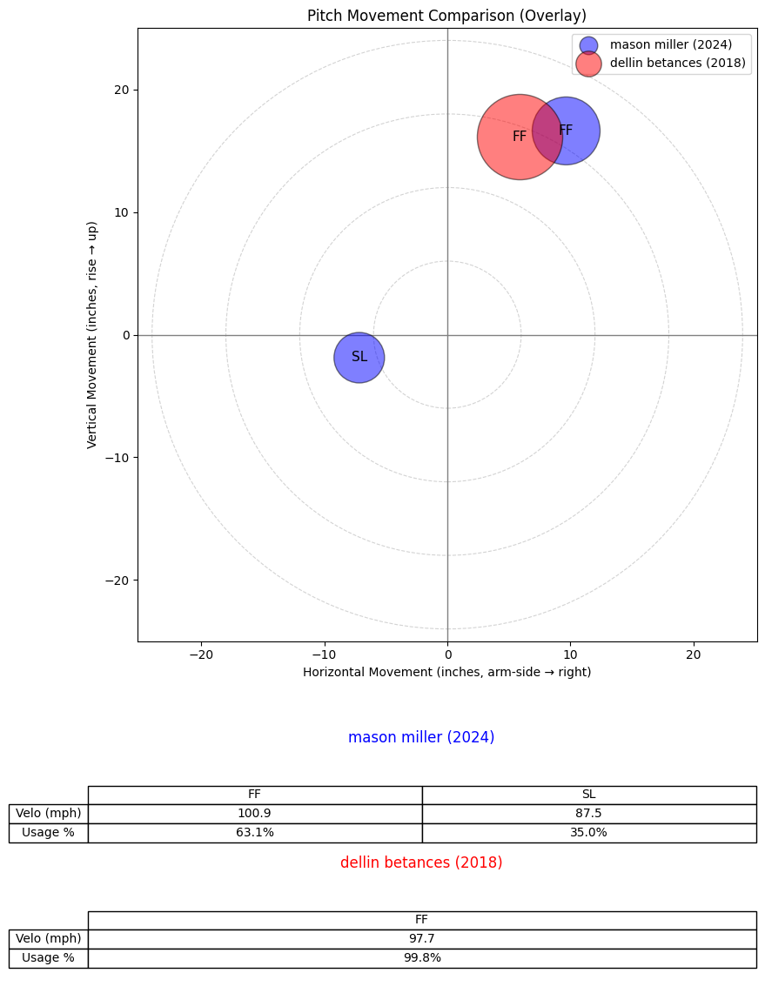

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


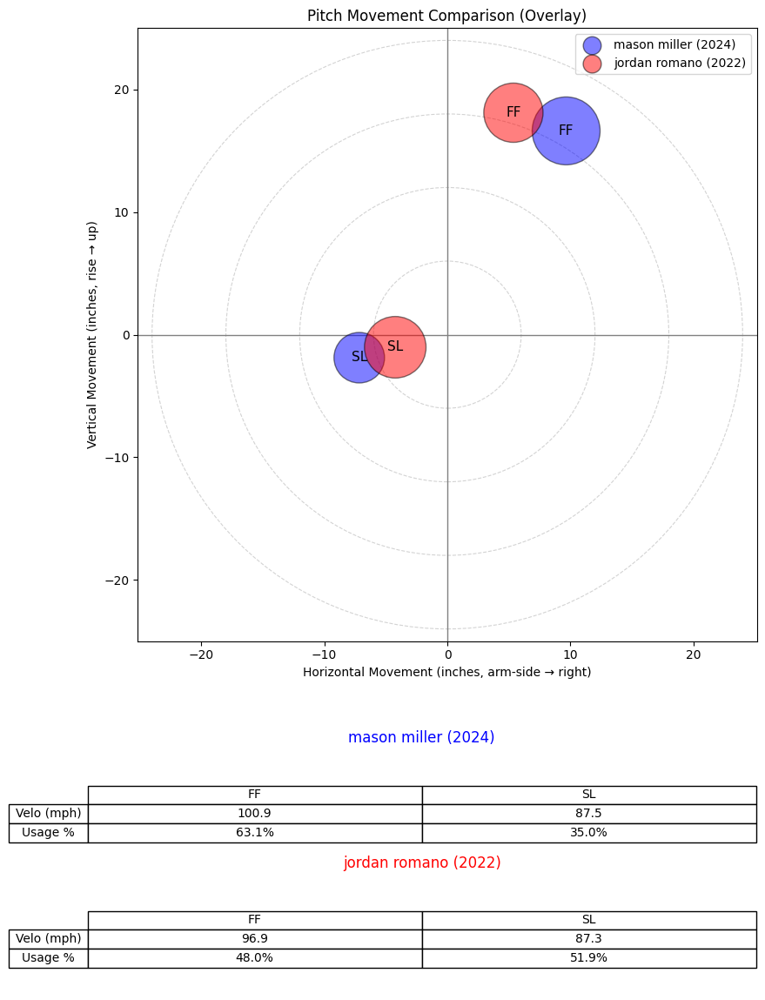

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


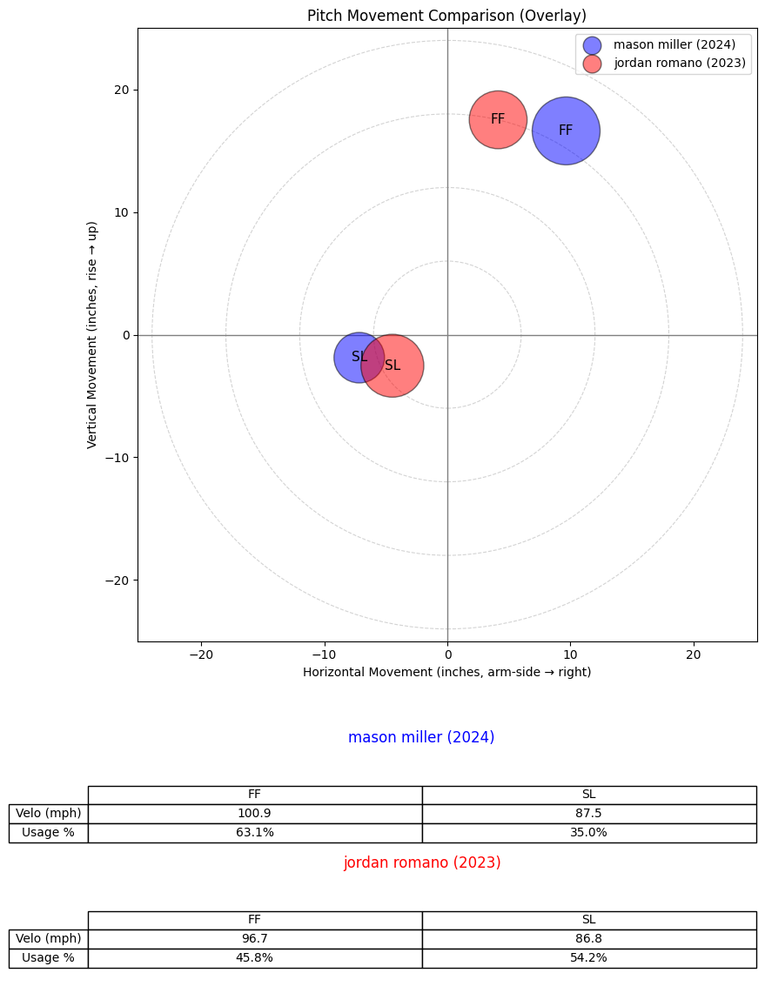

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


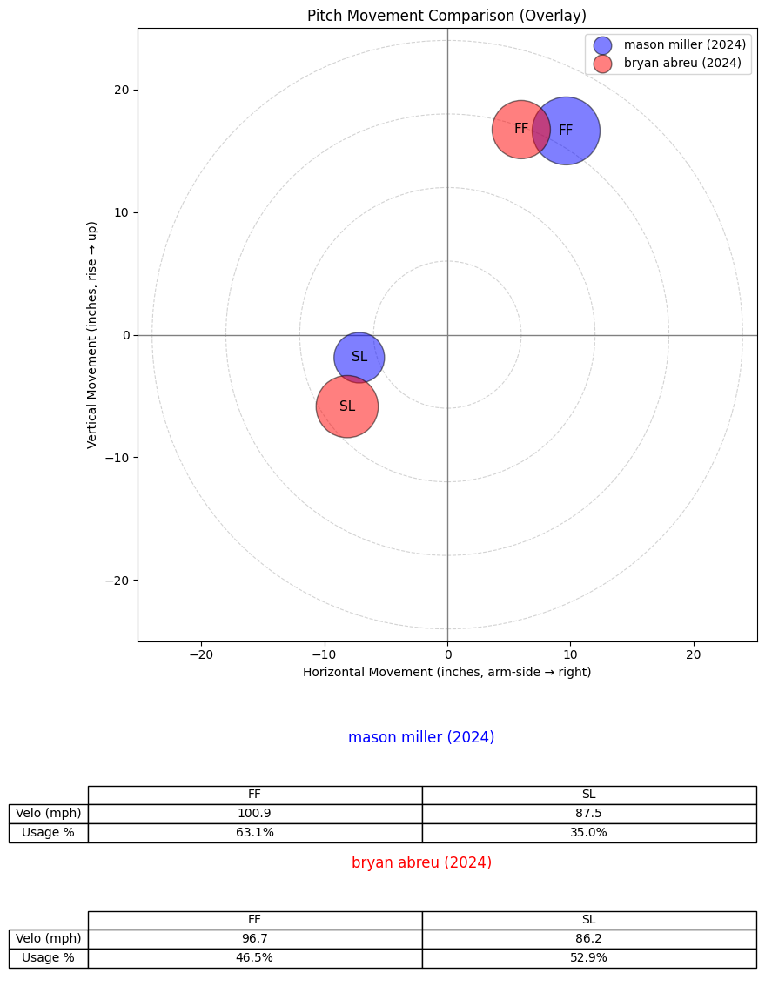

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


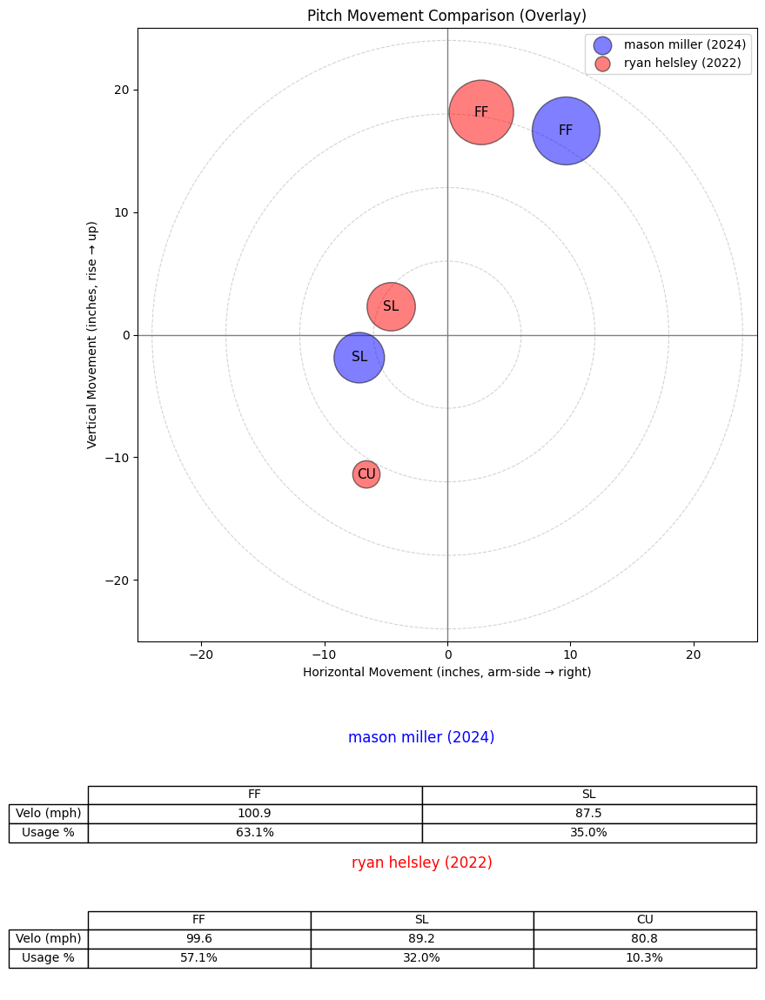

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


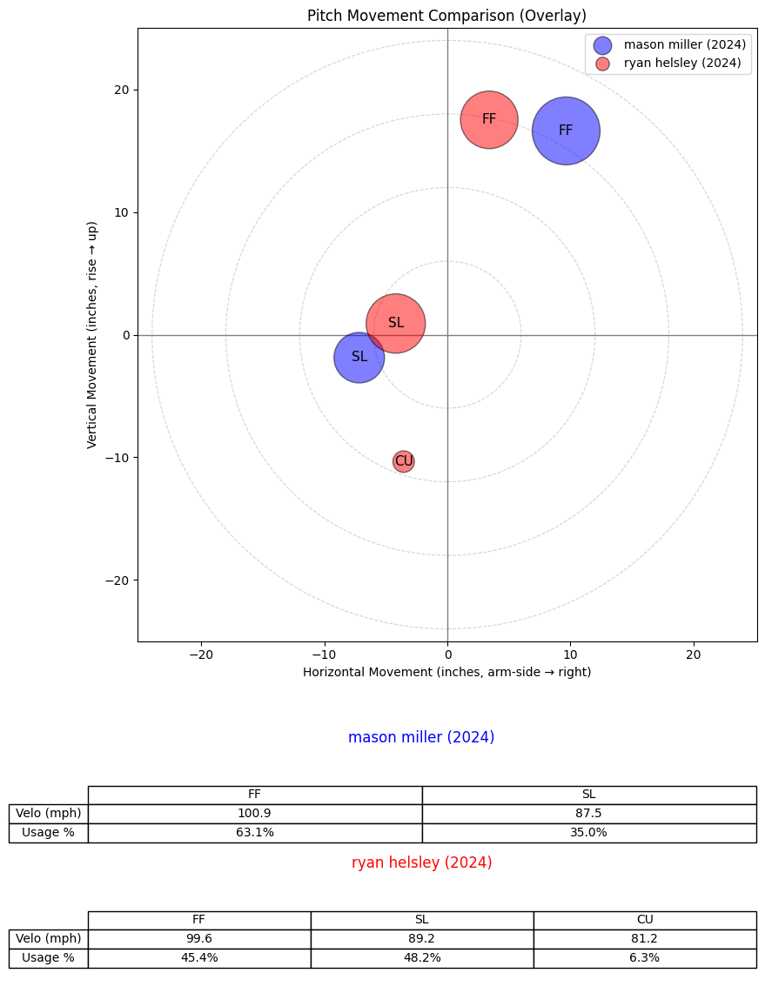

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


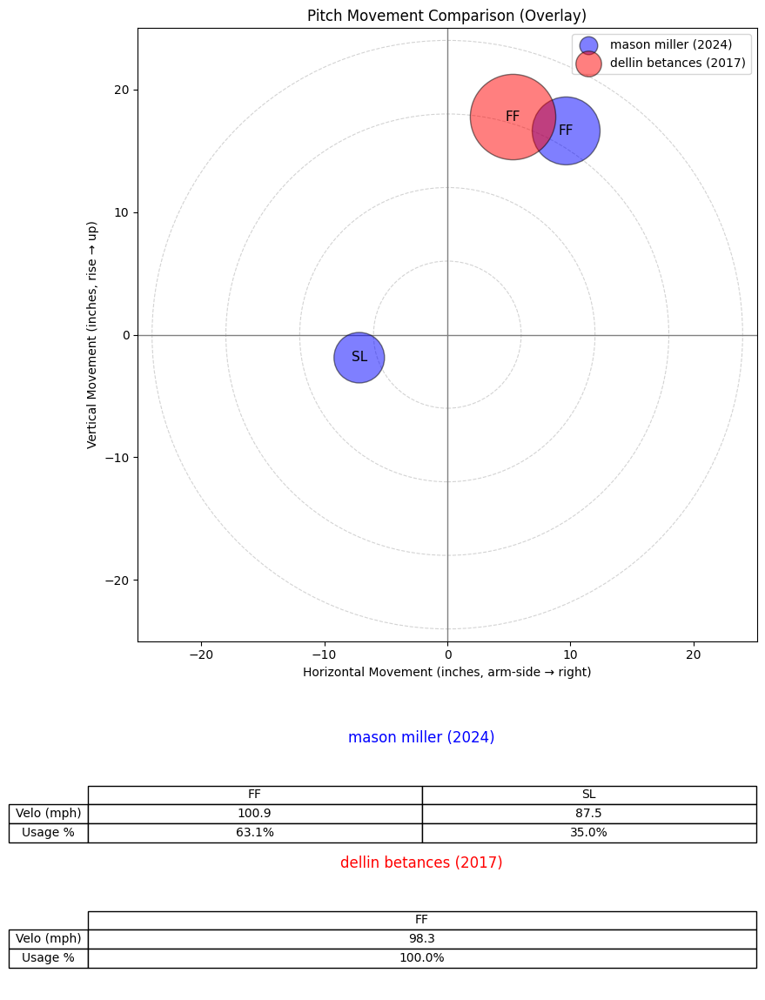

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


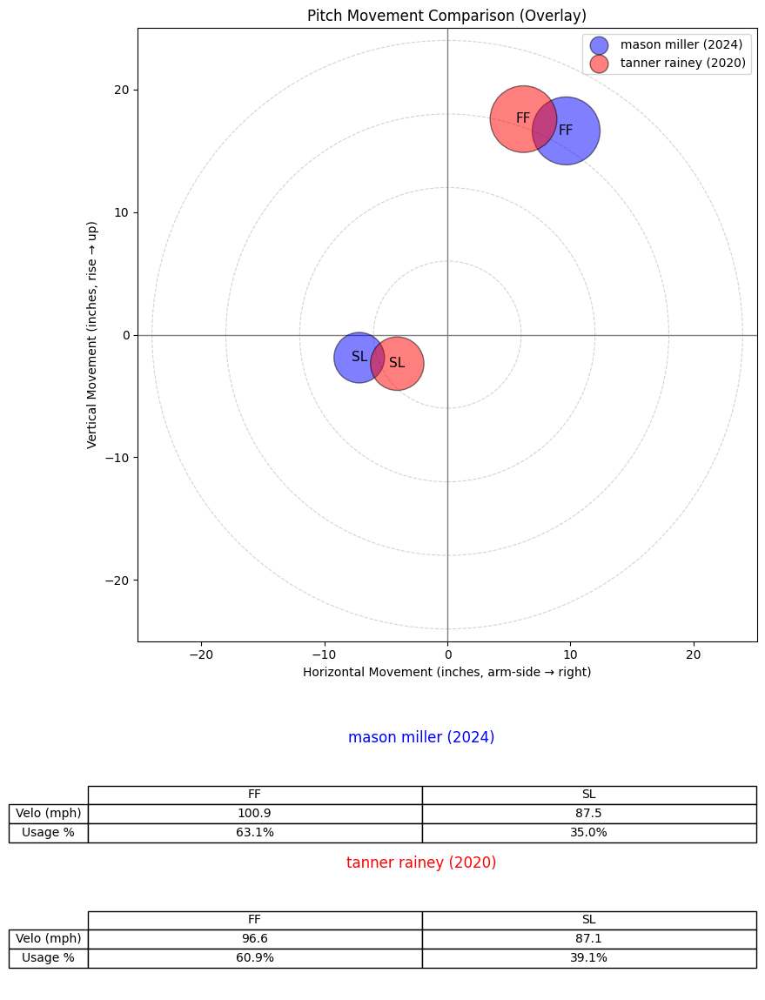

,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
1634,650556.0,2023,bryan abreu,bryan,abreu,R,reliever,0.905913
1109,605447.0,2021,jordan romano,jordan,romano,R,reliever,0.885068
238,476454.0,2018,dellin betances,dellin,betances,R,reliever,0.873750
1110,605447.0,2022,jordan romano,jordan,romano,R,reliever,0.862821
1111,605447.0,2023,jordan romano,jordan,romano,R,reliever,0.840051
1635,650556.0,2024,bryan abreu,bryan,abreu,R,reliever,0.836256
1875,664854.0,2022,ryan helsley,ryan,helsley,R,reliever,0.828741
1876,664854.0,2024,ryan helsley,ryan,helsley,R,reliever,0.818408
237,476454.0,2017,dellin betances,dellin,betances,R,reliever,0.780035
1791,663432.0,2020,tanner rainey,tanner,rainey,R,reliever,0.768412


In [302]:
neighbors_same = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="mason miller",
    year=2024,
    X_df=X_ae_metric_df,
    meta_df=pitcher_season_df,
    n_neighbors=10,
    overlay_df=movement_long,  # or whatever df your compare_pitchers_overlay expects
    plot_overlays=True,
    overlay_kwargs={"lim_inches": 25, "size_scale": 5000},
)
display(neighbors_same)

Building MLP model

In [303]:
# ---- Year splits ----
train_years = [2017, 2018, 2019, 2020, 2021]
val_years   = [2022, 2023]
test_years  = [2024]        # in-distribution test

meta_all = pitcher_season_df      # 2017–24
X_all    = X_scaled_df            # standardized features (same index as meta_all)

meta_train = meta_all[meta_all["game_year"].isin(train_years)].copy()
meta_val   = meta_all[meta_all["game_year"].isin(val_years)].copy()
meta_test  = meta_all[meta_all["game_year"].isin(test_years)].copy()

# make sure X subsets use the same indices
X_train_df = X_all.loc[meta_train.index].copy()
X_val_df   = X_all.loc[meta_val.index].copy()
X_test_df  = X_all.loc[meta_test.index].copy()

In [304]:
def make_pair_indices(meta_df, X_df, neg_per_pos=3):
    idx = meta_df.index.to_list()
    name_by_idx = meta_df["name"].to_dict()
    hand_by_idx = meta_df["p_throws"].to_dict()
    role_by_idx = meta_df["role"].to_dict()
    
    # Positives: same pitcher, different year
    pos_pairs = []
    grouped = meta_df.groupby("name")
    for name, df_p in grouped:
        if len(df_p) < 2:
            continue
        idxs = df_p.index.to_list()
        n = len(idxs)
        for a in range(n):
            for b in range(a+1, n):
                pos_pairs.append((idxs[a], idxs[b]))
    
    # Bucket indices by (hand, role) for negative sampling
    buckets = {}
    for i in idx:
        key = (hand_by_idx[i], role_by_idx[i])
        buckets.setdefault(key, []).append(i)
    
    pair_indices = []
    labels = []
    
    for i, j in pos_pairs:
        # positive
        pair_indices.append((i, j))
        labels.append(1)
        
        # negatives for i
        key = (hand_by_idx[i], role_by_idx[i])
        candidates = buckets[key]
        for _ in range(neg_per_pos):
            k = i
            while k == i or name_by_idx[k] == name_by_idx[i]:
                k = random.choice(candidates)
            pair_indices.append((i, k))
            labels.append(0)
    
    return pair_indices, np.array(labels, dtype=np.float32)


In [305]:
class PairDataset(Dataset):
    def __init__(self, pair_indices, labels, X_df):
        self.pair_indices = pair_indices
        self.labels = labels
        self.X = X_df.values.astype("float32")
        self.idx_to_row = {i: pos for pos, i in enumerate(X_df.index)}
    
    def __len__(self):
        return len(self.pair_indices)
    
    def __getitem__(self, idx):
        i_global, j_global = self.pair_indices[idx]
        i = self.idx_to_row[i_global]
        j = self.idx_to_row[j_global]
        xi = self.X[i]
        xj = self.X[j]
        # pair features
        diff = np.abs(xi - xj)
        prod = xi * xj
        pair_feat = np.concatenate([diff, prod], axis=0)
        y = self.labels[idx]
        return pair_feat, y


In [ ]:
class PairwiseMLP(nn.Module):
    def __init__(self, input_dim, hidden_dims=(256, 128), dropout=0.1):
        super().__init__()
        layers = []
        prev = input_dim
        for h in hidden_dims:
            layers.append(nn.Linear(prev, h))
            layers.append(nn.ReLU())
            layers.append(nn.Dropout(dropout))
            prev = h
        layers.append(nn.Linear(prev, 1))  # logit
        self.net = nn.Sequential(*layers)
    
    def forward(self, x_pair):
        logit = self.net(x_pair)
        return logit.squeeze(-1)


In [307]:
# Build train pairs
train_pairs, train_labels = make_pair_indices(meta_train, X_train_df, neg_per_pos=3)
train_ds = PairDataset(train_pairs, train_labels, X_train_df)

# build val pairs to monitor classification performance
val_pairs, val_labels = make_pair_indices(meta_val, X_val_df, neg_per_pos=3)
val_ds = PairDataset(val_pairs, val_labels, X_val_df)

batch_size = 512

train_loader = DataLoader(train_ds, batch_size=batch_size, shuffle=True, drop_last=True)
val_loader   = DataLoader(val_ds,   batch_size=batch_size, shuffle=False, drop_last=False)

print("Train pairs:", len(train_ds), "Val pairs:", len(val_ds))


Train pairs: 4812 Val pairs: 552


In [308]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

input_dim = 2 * X_train_df.shape[1]  # [diff, prod]
model = PairwiseMLP(input_dim=input_dim, hidden_dims=(256, 128), dropout=0.1).to(device)

criterion = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=1e-3, weight_decay=1e-5)

n_epochs = 30

for epoch in range(1, n_epochs + 1):
    model.train()
    running_loss = 0.0
    n_train = 0
    
    for feats, y in train_loader:
        feats = feats.to(device)
        y = y.to(device)
        
        optimizer.zero_grad()
        logits = model(feats)
        loss = criterion(logits, y)
        loss.backward()
        optimizer.step()
        
        running_loss += loss.item() * feats.size(0)
        n_train += feats.size(0)
    
    avg_train_loss = running_loss / n_train
    
    # simple val loss
    model.eval()
    val_loss = 0.0
    n_val = 0
    with torch.no_grad():
        for feats, y in val_loader:
            feats = feats.to(device)
            y = y.to(device)
            logits = model(feats)
            loss = criterion(logits, y)
            val_loss += loss.item() * feats.size(0)
            n_val += feats.size(0)
    avg_val_loss = val_loss / n_val if n_val > 0 else float("nan")
    
    print(f"Epoch {epoch:02d} | train_loss={avg_train_loss:.4f} | val_loss={avg_val_loss:.4f}")


Epoch 01 | train_loss=0.5377 | val_loss=0.3673
Epoch 02 | train_loss=0.2991 | val_loss=0.1835
Epoch 03 | train_loss=0.2139 | val_loss=0.1348
Epoch 04 | train_loss=0.1852 | val_loss=0.1268
Epoch 05 | train_loss=0.1622 | val_loss=0.1326
Epoch 06 | train_loss=0.1587 | val_loss=0.1217
Epoch 07 | train_loss=0.1460 | val_loss=0.1220
Epoch 08 | train_loss=0.1311 | val_loss=0.1164
Epoch 09 | train_loss=0.1281 | val_loss=0.1106
Epoch 10 | train_loss=0.1175 | val_loss=0.1065
Epoch 11 | train_loss=0.1068 | val_loss=0.1104
Epoch 12 | train_loss=0.1033 | val_loss=0.0969
Epoch 13 | train_loss=0.0926 | val_loss=0.0954
Epoch 14 | train_loss=0.0905 | val_loss=0.0960
Epoch 15 | train_loss=0.0826 | val_loss=0.0932
Epoch 16 | train_loss=0.0768 | val_loss=0.0915
Epoch 17 | train_loss=0.0741 | val_loss=0.1018
Epoch 18 | train_loss=0.0689 | val_loss=0.0933
Epoch 19 | train_loss=0.0666 | val_loss=0.0895
Epoch 20 | train_loss=0.0631 | val_loss=0.0910
Epoch 21 | train_loss=0.0580 | val_loss=0.0884
Epoch 22 | tr

In [309]:
def score_gallery_for_query(model, x_q, X_gallery_df, device):
    """
    x_q: 1D numpy array shape [D] (standardized features for the query)
    X_gallery_df: DataFrame of standardized features for gallery (index = season ids)
    Returns: pandas Series of scores (probability same pitcher), index = gallery indices
    """
    Xg = X_gallery_df.values.astype("float32")  # [G, D]
    # build pair features [G, 2D]
    diff = np.abs(Xg - x_q[None, :])
    prod = Xg * x_q[None, :]
    pair_feats = np.concatenate([diff, prod], axis=1)
    
    with torch.no_grad():
        feats_t = torch.tensor(pair_feats, dtype=torch.float32, device=device)
        logits = model(feats_t)
        probs = torch.sigmoid(logits).cpu().numpy()
    
    return pd.Series(probs, index=X_gallery_df.index)


In [ ]:
# ChatGPT helped make evaluation function
def eval_pair_model_hit_mrr(
    model,
    X_query_df,
    X_gallery_df,
    meta_query_df,
    meta_gallery_df,
    k=10,
    name_col="name",
    year_col="game_year",
):
    model.eval()
    hits = []
    rr = []
    n_eval = 0
    
    for q_idx, q_row in meta_query_df.iterrows():
        q_name = q_row[name_col]
        q_year = q_row[year_col]
        q_hand = q_row["p_throws"]
        q_role = q_row["role"]
        
        # gallery mask: same hand/role
        mask = (
            (meta_gallery_df["p_throws"] == q_hand) &
            (meta_gallery_df["role"] == q_role)
        )
        # if query index is also in gallery, drop that exact season
        if q_idx in meta_gallery_df.index:
            mask &= (meta_gallery_df.index != q_idx)
        
        meta_g = meta_gallery_df[mask]
        if meta_g.empty:
            continue
        
        # need at least one same-pitcher season in gallery to be eligible
        same_pitcher_mask = (meta_g[name_col] == q_name) & (meta_g[year_col] != q_year)
        if not same_pitcher_mask.any():
            continue
        
        X_g = X_gallery_df.loc[meta_g.index]
        x_q = X_query_df.loc[q_idx].values.astype("float32")
        
        scores = score_gallery_for_query(model, x_q, X_g, device=device)
        # sort descending by score
        top_idx = scores.sort_values(ascending=False).index[:k]
        meta_top = meta_g.loc[top_idx]
        
        same_pitcher_in_top = (meta_top[name_col] == q_name) & (meta_top[year_col] != q_year)
        if same_pitcher_in_top.any():
            hits.append(1.0)
            first_pos = np.where(same_pitcher_in_top.values)[0][0]
            rr.append(1.0 / (first_pos + 1))
        else:
            hits.append(0.0)
            rr.append(0.0)
        
        n_eval += 1
    
    hit_at_k = float(np.mean(hits)) if hits else float("nan")
    mrr = float(np.mean(rr)) if rr else float("nan")
    return hit_at_k, mrr, n_eval


In [ ]:
# 2024 test
meta_gallery_1723 = meta_all[meta_all["game_year"].isin(train_years + val_years)].copy()
X_gallery_1723    = X_all.loc[meta_gallery_1723.index]

hit10_2024, mrr_2024, n_eval_2024 = eval_pair_model_hit_mrr(
    model,
    X_query_df=X_test_df,                # 2024
    X_gallery_df=X_gallery_1723,         # 2017–23
    meta_query_df=meta_test,
    meta_gallery_df=meta_gallery_1723,
    k=10,
    name_col="name",
    year_col="game_year",
)
print("PairwiseMLP 2024→17–23 | hit@10:", hit10_2024, "MRR:", mrr_2024, "n_eval:", n_eval_2024)

# 2025 test
meta_gallery_1724 = meta_all.copy()
X_gallery_1724    = X_all

hit10_2025, mrr_2025, n_eval_2025 = eval_pair_model_hit_mrr(
    model,
    X_query_df=X_2025_scaled_df,
    X_gallery_df=X_gallery_1724,
    meta_query_df=pitcher_season_df_2025,
    meta_gallery_df=meta_gallery_1724,
    k=10,
    name_col="name",
    year_col="game_year",
)
print("PairwiseMLP 2025→17–24 | hit@10:", hit10_2025, "MRR:", mrr_2025, "n_eval:", n_eval_2025)


PairwiseMLP 2024→17–23 | hit@10: 0.9540229885057471 MRR: 0.8540366721401204 n_eval: 174
PairwiseMLP 2025→17–24 | hit@10: 0.9513513513513514 MRR: 0.8197061347061346 n_eval: 185


In [314]:
# Helped by ChatGPT
# 1) Fix column name in 2025 meta if needed
pitcher_season_df_2025_fixed = pitcher_season_df_2025.copy()
if "names" in pitcher_season_df_2025_fixed.columns and "name" not in pitcher_season_df_2025_fixed.columns:
    pitcher_season_df_2025_fixed = pitcher_season_df_2025_fixed.rename(columns={"names": "name"})

# 2) Combine meta with NEW sequential index
meta_all_17_25 = pd.concat(
    [pitcher_season_df, pitcher_season_df_2025_fixed],
    axis=0,
    ignore_index=True,          # <- IMPORTANT: new RangeIndex 0..N-1
)

# 3) Combine standardized features with the same new index
X_scaled_all_17_25 = pd.concat(
    [X_scaled_df, X_2025_scaled_df],
    axis=0,
    ignore_index=True,
)

# Sanity check: indexes now match and are unique
assert (X_scaled_all_17_25.index == meta_all_17_25.index).all()
assert meta_all_17_25.index.is_unique


In [312]:
def score_gallery_for_query_mlp(model, x_q, X_gallery_df, device):
    """
    x_q: 1D numpy array [D] (standardized features for query season)
    X_gallery_df: DataFrame of standardized features for all gallery seasons
    Returns: Series of probabilities (same pitcher) indexed by gallery indices.
    """
    Xg = X_gallery_df.values.astype("float32")  # [G, D]
    diff = np.abs(Xg - x_q[None, :])
    prod = Xg * x_q[None, :]
    pair_feats = np.concatenate([diff, prod], axis=1)

    with torch.no_grad():
        feats_t = torch.tensor(pair_feats, dtype=torch.float32, device=device)
        logits = model(feats_t)
        probs = torch.sigmoid(logits).cpu().numpy()

    return pd.Series(probs, index=X_gallery_df.index)


In [ ]:
# Had help from ChatGPT for this function
def find_similar_pitchers_mlp(
    pitcher_name: str,
    year: int,
    model,
    X_all_df: pd.DataFrame,
    meta_all_df: pd.DataFrame,
    n_neighbors: int = 10,
    restrict_same_group: bool = True,
    device=None,
):
    if device is None:
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.eval()

    # 1. Locate query season
    name_lower = meta_all_df["name"].str.lower()
    mask = (name_lower == pitcher_name.lower()) & (meta_all_df["game_year"] == year)
    idx = meta_all_df.index[mask]

    if len(idx) == 0:
        raise ValueError(f"No row found for name='{pitcher_name}', year={year}")
    if len(idx) > 1:
        raise ValueError(f"Multiple rows found for name='{pitcher_name}', year={year}")

    target_idx = idx[0]

    base = meta_all_df.loc[target_idx]
    base_name = base["name"]
    base_year = base["game_year"]
    base_hand = base["p_throws"]
    base_role = base["role"]

    # 2. Query features
    x_q = X_all_df.loc[target_idx].values.astype("float32")

    # 3. Build gallery mask (optionally same hand/role, always drop self)
    if restrict_same_group:
        same_group_mask = (
            (meta_all_df["p_throws"] == base_hand) &
            (meta_all_df["role"] == base_role)
        )
    else:
        same_group_mask = pd.Series(True, index=meta_all_df.index)

    same_group_mask &= (meta_all_df.index != target_idx)

    meta_gallery = meta_all_df.loc[same_group_mask]
    X_gallery = X_all_df.loc[meta_gallery.index]

    # 4. Score gallery with MLP
    scores = score_gallery_for_query_mlp(model, x_q, X_gallery, device=device)

    # 5. Take top-k
    top_idx = scores.sort_values(ascending=False).head(n_neighbors).index
    top_scores = scores.loc[top_idx]

    result = meta_gallery.loc[top_idx, [
        "pitcher", "game_year", "name",
        "name_first", "name_last", "p_throws", "role"
    ]].copy()
    result["mlp_similarity"] = top_scores.values
    result = result.sort_values("mlp_similarity", ascending=False)

    return base_name, base_year, result


In [315]:
base_name, base_year, neighbors_woo = find_similar_pitchers_mlp(
    pitcher_name="bryan woo",
    year=2025,
    model=model,    # trained MLP
    X_all_df=X_scaled_all_17_25,
    meta_all_df=meta_all_17_25,
    n_neighbors=10,
    restrict_same_group=True,
)

print(base_name, base_year)
display(neighbors_woo)


bryan woo 2025


,pitcher,game_year,name,name_first,name_last,p_throws,role,mlp_similarity
2105,693433.0,2024,bryan woo,bryan,woo,R,starter,0.998282
2059,678394.0,2024,brayan bello,brayan,bello,R,starter,0.975424
2314,678394.0,2025,brayan bello,brayan,bello,R,starter,0.896276
1733,657140.0,2022,kyle wright,kyle,wright,R,starter,0.831525
542,543101.0,2021,anthony desclafani,anthony,desclafani,R,starter,0.758026
956,594798.0,2019,jacob degrom,jacob,degrom,R,starter,0.676672
1739,657277.0,2023,logan webb,logan,webb,R,starter,0.631427
2146,594798.0,2025,jacob degrom,jacob,degrom,R,starter,0.451552
1142,606160.0,2017,rafael montero,rafael,montero,R,starter,0.377657
1102,605400.0,2019,aaron nola,aaron,nola,R,starter,0.373747


In [316]:
# Make sure AE features are aligned with their meta before concat
Z_ae_17_24 = X_ae_df.loc[pitcher_season_df.index]
Z_ae_2025  = X_ae_df_2025.loc[pitcher_season_df_2025_fixed.index]

# Combine with a fresh RangeIndex to match meta_all_17_25
X_ae_all_17_25 = pd.concat(
    [Z_ae_17_24, Z_ae_2025],
    axis=0,
    ignore_index=True,       # <- IMPORTANT: same as meta_all_17_25
)

# Sanity check alignment with meta_all_17_25
assert (X_ae_all_17_25.index == meta_all_17_25.index).all()


In [ ]:
# when experiment was first done, luis castillo was most similar
neighbors_woo_ae = find_similar_pitchers_by_name_same_hand_role(
    pitcher_name="bryan woo",
    year=2025,
    X_df=X_ae_all_17_25,      # AE latent space for 2017–25
    meta_df=meta_all_17_25,   # combined meta for 2017–25
    n_neighbors=10,
    overlay_df=None,
    plot_overlays=False,
)

display(neighbors_woo_ae)


,pitcher,game_year,name,name_first,name_last,p_throws,role,cosine_similarity
2105,693433.0,2024,bryan woo,bryan,woo,R,starter,0.937220
2059,678394.0,2024,brayan bello,brayan,bello,R,starter,0.886692
540,543101.0,2018,anthony desclafani,anthony,desclafani,R,starter,0.824591
532,543037.0,2017,gerrit cole,gerrit,cole,R,starter,0.809949
1090,605347.0,2021,jorge lópez,jorge,lópez,R,starter,0.805588
1675,656427.0,2019,jack flaherty,jack,flaherty,R,starter,0.797098
542,543101.0,2021,anthony desclafani,anthony,desclafani,R,starter,0.795427
2199,642547.0,2025,freddy peralta,freddy,peralta,R,starter,0.771603
1578,642547.0,2023,freddy peralta,freddy,peralta,R,starter,0.766564
1783,661563.0,2024,luis gil,luis,gil,R,starter,0.766430


In [318]:
movement_long_all = reshape_pitcher_season_df(meta_all_17_25)

/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


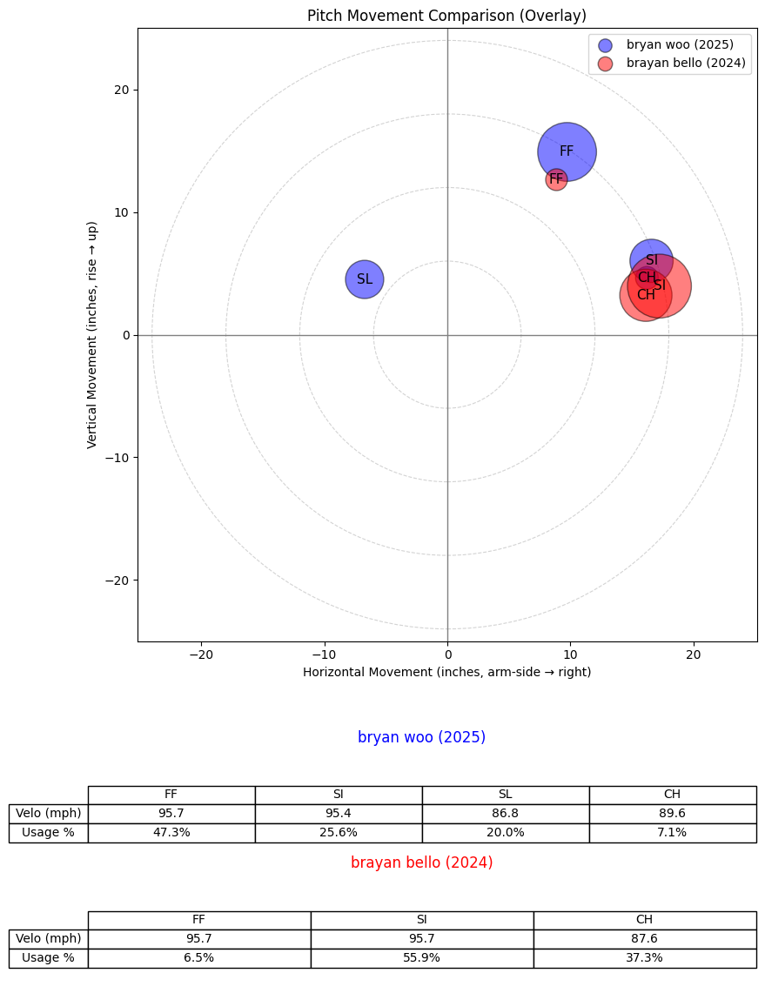

In [320]:
compare_pitchers_overlay(
    df=movement_long_all,
    nameA="bryan woo",
    yearA=2025,
    nameB="brayan bello",
    yearB=2024,
    lim_inches=25,
    size_scale=5000
)


/var/folders/jj/pg09j1dn24d5qgc0lzyrqlr40000gn/T/ipykernel_70348/1489908689.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


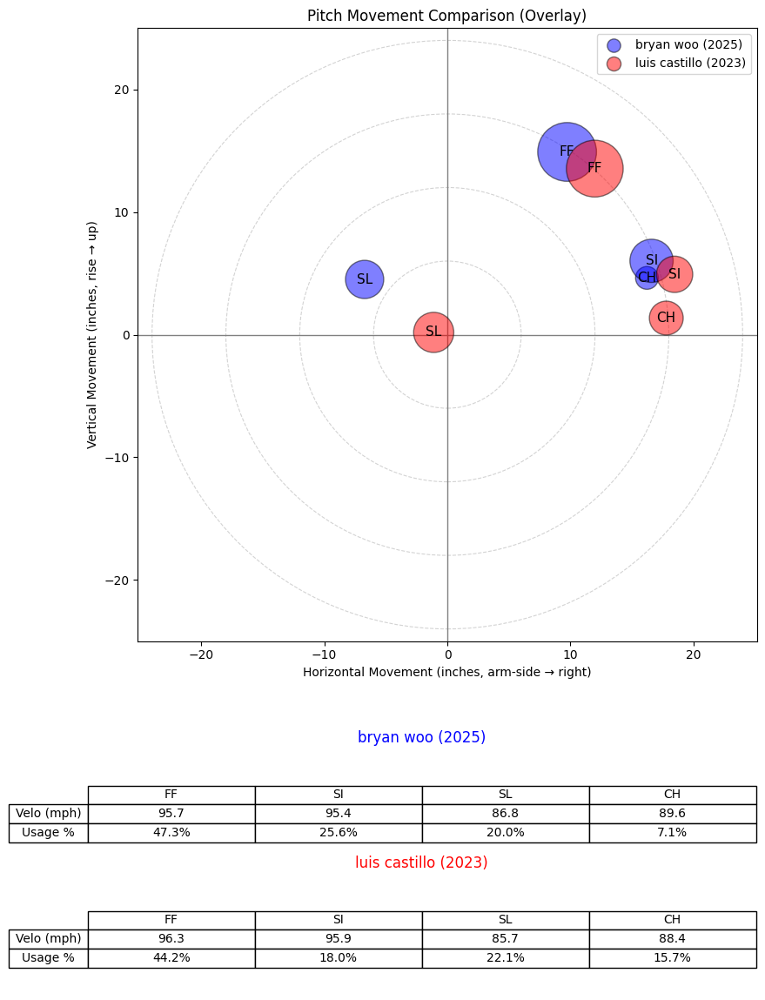

In [321]:
compare_pitchers_overlay(
    df=movement_long_all,
    nameA="bryan woo",
    yearA=2025,
    nameB="luis castillo",
    yearB=2023,
    lim_inches=25,        # whatever you used before
    size_scale=5000,      # whatever you used before
)


In [322]:
base_name, base_year, neighbors_imanaga = find_similar_pitchers_mlp(
    pitcher_name="shota imanaga",
    year=2024,
    model=model,                       # your trained PairwiseMLP
    X_all_df=X_scaled_all_17_25,
    meta_all_df=meta_all_17_25,
    n_neighbors=10,
    restrict_same_group=True,
)

print(base_name, base_year)
display(neighbors_imanaga)


shota imanaga 2024


,pitcher,game_year,name,name_first,name_last,p_throws,role,mlp_similarity
2326,684007.0,2025,shota imanaga,shota,imanaga,L,starter,1.000000
2236,663559.0,2025,bailey falter,bailey,falter,L,starter,1.000000
1871,664641.0,2017,aríel miranda,aríel,miranda,L,starter,1.000000
1957,669373.0,2021,tarik skubal,tarik,skubal,L,starter,1.000000
2115,477132.0,2025,clayton kershaw,clayton,kershaw,L,starter,1.000000
705,571510.0,2019,matt boyd,matt,boyd,L,starter,0.994938
197,461829.0,2017,gio gonzalez,gio,gonzalez,L,starter,0.994908
655,547943.0,2019,hyun jin ryu,hyun jin,ryu,L,starter,0.972888
656,547943.0,2020,hyun jin ryu,hyun jin,ryu,L,starter,0.957418
2128,571510.0,2025,matt boyd,matt,boyd,L,starter,0.920608
